# CARGA DE DATOS

Los datos provienen del Sistema de Vigilancia de Factores de Riesgo del Comportamiento (BRFSS, por sus siglas en inglés) de los Centros para el Control y la Prevención de Enfermedades (CDC) de Estados Unidos. El BRFSS es una encuesta telefónica que recopila datos sobre comportamientos de riesgo para la salud, prácticas preventivas y acceso a la atención médica en la población adulta de EE. UU. Se lleva a cabo anualmente, y los datos utilizados en este proyecto corresponden al año 2022.

Los datos se encuentran en un archivo con formato .xpt, comúnmente utilizado por el software estadístico SAS. Para cargar estos datos en Python, se utilizan las librerías pandas y pyreadstat. En las siguientes fuentes hay más detalles sobre este conjunto de datos. 

* https://www.cdc.gov/brfss/annual_data/annual_2022.html
* https://www.cdc.gov/brfss/annual_data/2022/pdf/Overview_2022-508.pdf

Y en el siguiente enlace se pueden descargar los datos: https://www.cdc.gov/brfss/annual_data/2022/files/LLCP2022XPT.zip

In [1]:
import pandas as pd
import pyreadstat

# Ruta al archivo .xpt
ruta_archivo = 'LLCP2022.xpt'

# Leer el archivo .xpt
datos, metadatos = pyreadstat.read_xport(ruta_archivo, encoding='latin1')

# Convertir los datos a un DataFrame de pandas
datos = pd.DataFrame(datos)

# Imprimir los primeros registros
datos.head()

,_STATE,FMONTH,IDATE,IMONTH,IDAY,IYEAR,DISPCODE,SEQNO,_PSU,CTELENM1,...,_SMOKGRP,_LCSREC,DRNKANY6,DROCDY4_,_RFBING6,_DRNKWK2,_RFDRHV8,_FLSHOT7,_PNEUMO3,_AIDTST4
0,1.0,1.0,02032022,02,03,2022,1100.0,2022000001,2.022000e+09,1.0,...,4.0,NaN,2.0,0.0,1.0,0.0,1.0,1.0,2.0,2.0
1,1.0,1.0,02042022,02,04,2022,1100.0,2022000002,2.022000e+09,1.0,...,4.0,NaN,2.0,0.0,1.0,0.0,1.0,2.0,2.0,2.0
2,1.0,1.0,02022022,02,02,2022,1100.0,2022000003,2.022000e+09,1.0,...,4.0,NaN,2.0,0.0,1.0,0.0,1.0,NaN,NaN,2.0
3,1.0,1.0,02032022,02,03,2022,1100.0,2022000004,2.022000e+09,1.0,...,3.0,2.0,2.0,0.0,1.0,0.0,1.0,9.0,9.0,2.0
4,1.0,1.0,02022022,02,02,2022,1100.0,2022000005,2.022000e+09,1.0,...,4.0,NaN,1.0,10.0,1.0,140.0,1.0,NaN,NaN,2.0


El conjunto de datos original contiene 328 variables, muchas de las cuales no son relevantes para el objetivo de este trabajo, que es crear un modelo predictivo para el desarrollo de enfermedades cardiovasculares a partir de factores de riesgo. Algunas de estas variables pueden ser derivadas de otras, calculadas a partir de otras, preguntas de control, variables con todos los valores nulos o con el mismo valor, o variables con un elevado número de valores nulos.

Por lo tanto, se realizará un proceso de filtrado para seleccionar únicamente aquellas variables que puedan resultar significativas para este trabajo. A partir de estas variables seleccionadas, se creará inicialmente un modelo con un número reducido de variables y, posteriormente, se desarrollará otro modelo con un mayor número de variables para comparar el rendimiento y tratar de identificar nuevas variables importantes en la predicción de enfermedades cardiovasculares.

Para obtener más detalles sobre cada una de las 328 variables del conjunto de datos original, se puede consultar el diccionario de datos proporcionado por los CDC en la siguiente fuente https://www.cdc.gov/brfss/annual_data/2022/zip/codebook22_llcp-v2-508.zip. Este diccionario de datos contiene información detallada sobre el nombre, descripción, tipo de datos y valores posibles de cada variable.

In [2]:
# Identificar la lista de variables
print(list(datos.columns))

['_STATE', 'FMONTH', 'IDATE', 'IMONTH', 'IDAY', 'IYEAR', 'DISPCODE', 'SEQNO', '_PSU', 'CTELENM1', 'PVTRESD1', 'COLGHOUS', 'STATERE1', 'CELPHON1', 'LADULT1', 'COLGSEX1', 'NUMADULT', 'LANDSEX1', 'NUMMEN', 'NUMWOMEN', 'RESPSLCT', 'SAFETIME', 'CTELNUM1', 'CELLFON5', 'CADULT1', 'CELLSEX1', 'PVTRESD3', 'CCLGHOUS', 'CSTATE1', 'LANDLINE', 'HHADULT', 'SEXVAR', 'GENHLTH', 'PHYSHLTH', 'MENTHLTH', 'POORHLTH', 'PRIMINSR', 'PERSDOC3', 'MEDCOST1', 'CHECKUP1', 'EXERANY2', 'SLEPTIM1', 'LASTDEN4', 'RMVTETH4', 'CVDINFR4', 'CVDCRHD4', 'CVDSTRK3', 'ASTHMA3', 'ASTHNOW', 'CHCSCNC1', 'CHCOCNC1', 'CHCCOPD3', 'ADDEPEV3', 'CHCKDNY2', 'HAVARTH4', 'DIABETE4', 'DIABAGE4', 'MARITAL', 'EDUCA', 'RENTHOM1', 'NUMHHOL4', 'NUMPHON4', 'CPDEMO1C', 'VETERAN3', 'EMPLOY1', 'CHILDREN', 'INCOME3', 'PREGNANT', 'WEIGHT2', 'HEIGHT3', 'DEAF', 'BLIND', 'DECIDE', 'DIFFWALK', 'DIFFDRES', 'DIFFALON', 'HADMAM', 'HOWLONG', 'CERVSCRN', 'CRVCLCNC', 'CRVCLPAP', 'CRVCLHPV', 'HADHYST2', 'HADSIGM4', 'COLNSIGM', 'COLNTES1', 'SIGMTES1', 'LASTSIG4

Se realiza la selección de las variables que se consideran relevantes para el objetivo de predecir el desarrollo de enfermedades cardiovasculares a partir de factores de riesgo. Esta selección se basa en diversos criterios, como la validación médica de ciertas variables como factores de riesgo conocidos, la identificación de nuevos factores de riesgo en trabajos anteriores del estado del arte, y la exploración de posibles nuevos factores dadas las características específicas de este conjunto de datos.

Las variables seleccionadas se pueden agrupar en diferentes categorías según el tipo de factor de riesgo al que corresponden. En primer lugar, se incluyen factores de riesgo no modificables, como la edad (_AGEG5YR), el sexo (SEXVAR) y la raza (_IMPRACE). Estos factores son inherentes a cada individuo y no pueden ser modificados, pero son importantes predictores del riesgo cardiovascular.

Por otro lado, se consideran factores de riesgo modificables, que son aquellos que pueden ser influenciados por cambios en el estilo de vida o intervenciones médicas. Estos incluyen variables como el tabaquismo (_RFSMOK3), el consumo excesivo de alcohol (_RFDRHV8), la actividad física (EXERANY2), el índice de masa corporal (_BMI5CAT) y la duración del sueño (SLEPTIM1). Estos factores han sido ampliamente estudiados y se ha demostrado su relación con el riesgo de enfermedades cardiovasculares.

Además, se incluyen variables que representan la presencia de diversas enfermedades crónicas o comorbilidades, como asma (ASTHMA3), cáncer (CHCOCNC1), enfisema (CHCCOPD3), depresión (ADDEPEV3), fallo renal (CHCKDNY2), artritis (HAVARTH4) y diabetes (DIABETE4). Estas condiciones médicas pueden aumentar el riesgo de enfermedades cardiovasculares y su presencia puede influir en el manejo y pronóstico de los pacientes.

También se consideran variables relacionadas con discapacidades, como sordera (DEAF), ceguera (BLIND), deterioro cognitivo (DECIDE), dificultad para caminar (DIFFWALK), dificultad para vestirse (DIFFDRES) o dificultad para hacer recados (DIFFALON). Estas discapacidades pueden afectar la calidad de vida y el manejo de los factores de riesgo, lo que a su vez puede influir en el riesgo cardiovascular.

Otro grupo de variables se refiere a factores socioeconómicos y de estilo de vida, como el nivel educativo (_EDUCAG), el nivel de ingresos (_INCOMG1), la zona metropolitana de residencia (_METSTAT) y la accesibilidad a la atención médica (MEDCOST1). Estos factores pueden estar relacionados con disparidades en la salud cardiovascular y pueden influir en la adopción de comportamientos saludables y el acceso a recursos preventivos y de tratamiento.

Además, se incluyen variables que reflejan la salud general y mental de los participantes, como la percepción de salud general (_RFHLTH), la presencia de problemas de salud mental como estrés y ansiedad (_MENT14D), y la salud física general (_PHYS14D). Estas variables pueden proporcionar información adicional sobre el estado de salud general de los individuos y su relación con el riesgo cardiovascular.

Por último, se considera la variable COVIDPOS, que indica si el participante ha dado positivo en la prueba de COVID-19. La inclusión de esta variable permite explorar la posible relación entre la infección por COVID-19 y el riesgo de complicaciones cardiovasculares, dado que estudios recientes han sugerido una asociación entre ambas condiciones. [1, 2]

1. https://www.ncbi.nlm.nih.gov/pmc/articles/PMC10695704/
2. https://www.nature.com/articles/s41591-022-01689-3

In [3]:
# Lista de columnas deseadas
columnas_deseadas = ['SEXVAR',  # Sexo 
                     'MEDCOST1',  # Costo médico
                     'EXERANY2',  # Actividad física
                     'SLEPTIM1',  # Numérica
                     'CVDINFR4', 'CVDCRHD4', 'CVDSTRK3',  # Construyen variable objetivo CARDIO                      
                     # Enfermedades crónicas
                     'ASTHMA3', 'CHCOCNC1', 'CHCCOPD3', 'ADDEPEV3', 'CHCKDNY2', 'HAVARTH4', 'DIABETE4',                                         
                     'DEAF', 'BLIND', 'DECIDE', 'DIFFWALK', 'DIFFDRES', 'DIFFALON',  # Discapacidades
                     'COVIDPOS',  # COVID
                     '_METSTAT',  # Zona metropolitana
                     '_IMPRACE',  # Raza
                     '_RFHLTH',  # Percepción salud general                     
                     '_PHYS14D',  # Salud mental (Estrés, Ansiedad)
                     '_MENT14D',  # Salud física                      
                     '_AGEG5YR',  # Edad
                     '_BMI5CAT',  # Peso
                     '_EDUCAG',  # Nivel educación
                     '_INCOMG1',  # Nivel ingresos
                     '_RFSMOK3',  # Fuma
                     '_RFDRHV8'  # Bebe alcohol
                     ]

# Crear un nuevo DataFrame con las columnas deseadas
datos = datos[columnas_deseadas]

# Mostrar las dimensiones
print("Dimensiones del DataFrame:")
print(datos.shape)

# Mostrar los primeros registros
datos.head()

Dimensiones del DataFrame:
(445132, 32)


,SEXVAR,MEDCOST1,EXERANY2,SLEPTIM1,CVDINFR4,CVDCRHD4,CVDSTRK3,ASTHMA3,CHCOCNC1,CHCCOPD3,...,_IMPRACE,_RFHLTH,_PHYS14D,_MENT14D,_AGEG5YR,_BMI5CAT,_EDUCAG,_INCOMG1,_RFSMOK3,_RFDRHV8
0,2.0,2.0,2.0,8.0,2.0,2.0,2.0,2.0,2.0,2.0,...,1.0,1.0,1.0,1.0,13.0,NaN,4.0,9.0,1.0,1.0
1,2.0,2.0,2.0,6.0,2.0,2.0,2.0,2.0,1.0,2.0,...,1.0,1.0,1.0,1.0,13.0,3.0,2.0,3.0,1.0,1.0
2,2.0,2.0,1.0,5.0,2.0,2.0,2.0,2.0,2.0,2.0,...,1.0,1.0,2.0,2.0,8.0,3.0,4.0,6.0,1.0,1.0
3,2.0,2.0,1.0,7.0,2.0,2.0,2.0,1.0,2.0,2.0,...,1.0,1.0,1.0,1.0,14.0,2.0,2.0,9.0,2.0,1.0
4,2.0,2.0,1.0,9.0,2.0,2.0,2.0,2.0,2.0,2.0,...,1.0,2.0,2.0,1.0,5.0,2.0,3.0,3.0,1.0,1.0


# PREPROCESADO DE DATOS

El objetivo principal del preprocesamiento es mejorar la calidad de los datos, haciéndolos más adecuados y compatibles con las técnicas de análisis posteriores, lo que a su vez conduce a la obtención de patrones y modelos más precisos y confiables.

El método datos.info() genera un resumen del conjunto de datos que incluye información sobre el número de filas, el número de columnas, los nombres de las columnas, los tipos de datos de cada columna y la cantidad de valores no nulos en cada columna. Proporciona una visión general de la estructura y calidad de los datos.

In [4]:
# Resumen del conjunto de datos
datos.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 445132 entries, 0 to 445131
Data columns (total 32 columns):
 #   Column    Non-Null Count   Dtype  
---  ------    --------------   -----  
 0   SEXVAR    445132 non-null  float64
 1   MEDCOST1  445128 non-null  float64
 2   EXERANY2  445130 non-null  float64
 3   SLEPTIM1  445129 non-null  float64
 4   CVDINFR4  445128 non-null  float64
 5   CVDCRHD4  445130 non-null  float64
 6   CVDSTRK3  445130 non-null  float64
 7   ASTHMA3   445130 non-null  float64
 8   CHCOCNC1  445129 non-null  float64
 9   CHCCOPD3  445130 non-null  float64
 10  ADDEPEV3  445125 non-null  float64
 11  CHCKDNY2  445130 non-null  float64
 12  HAVARTH4  445129 non-null  float64
 13  DIABETE4  445129 non-null  float64
 14  DEAF      426488 non-null  float64
 15  BLIND     425277 non-null  float64
 16  DECIDE    424146 non-null  float64
 17  DIFFWALK  422977 non-null  float64
 18  DIFFDRES  422253 non-null  float64
 19  DIFFALON  421190 non-null  float64
 20  COVI

Dado que se observan valores nulos se van a cuantificar por columna para observar las variables que pueden presentar más problemas.

In [5]:
# Identificar valores nulos por columna
datos.isnull().sum()

SEXVAR          0
MEDCOST1        4
EXERANY2        2
SLEPTIM1        3
CVDINFR4        4
CVDCRHD4        2
CVDSTRK3        2
ASTHMA3         2
CHCOCNC1        3
CHCCOPD3        2
ADDEPEV3        7
CHCKDNY2        2
HAVARTH4        3
DIABETE4        3
DEAF        18644
BLIND       19855
DECIDE      20986
DIFFWALK    22155
DIFFDRES    22879
DIFFALON    23942
COVIDPOS    49235
_METSTAT     9408
_IMPRACE        0
_RFHLTH         0
_PHYS14D        0
_MENT14D        0
_AGEG5YR        0
_BMI5CAT    48806
_EDUCAG         0
_INCOMG1        0
_RFSMOK3        0
_RFDRHV8        0
dtype: int64

La mayoría de las columnas tienen una cantidad relativamente pequeña de valores nulos, que van desde 0 hasta 7. Estas columnas incluyen variables como SEXVAR, MEDCOST1, EXERANY2, SLEPTIM1, CVDINFR4, CVDCRHD4, CVDSTRK3, ASTHMA3, CHCOCNC1, CHCCOPD3, ADDEPEV3, CHCKDNY2, HAVARTH4 y DIABETE4. Para estas columnas, la cantidad de valores faltantes es manejable y se pueden aplicar técnicas simples de imputación.

Algunas columnas, como DEAF, BLIND, DECIDE, DIFFWALK, DIFFDRES y DIFFALON, tienen una cantidad significativa de valores nulos, que oscilan entre 18,644 y 23,942. En este caso, se podría considerar la posibilidad de excluir estas columnas del análisis si no son esenciales para el objetivo del proyecto, o aplicar técnicas de imputación más avanzadas, como la imputación múltiple, que tiene en cuenta la incertidumbre asociada a los valores faltantes.

Las columnas que presentan más problemas son las que se refieren al Índice de Masa Corporal y sin padecido COVID, ya que tienen alrededor de un 11% de valores nulos.

Para tratar los valores nulos, se van a imputar utilizando cadenas de ecuaciones, puesto que es una técnica empleada en la revisión bibliográfica y ha demostrado ofrecer buenos resultados. Con el fin de evaluar el impacto de esta imputación en los resultados y verificar si introduce factores de riesgo contraintuitivos u omite factores cuya influencia ha sido validada, se realizará una comparación con modelos sin imputación. En el anexo I, al final del notebook, se llevará a cabo la predicción eliminando todos los valores nulos y se contrastará con los resultados obtenidos utilizando la imputación. De esta manera, se podrá determinar si la imputación afecta negativamente el rendimiento de los modelos o si revela factores de riesgo que no se observan en los modelos sin imputación, pero que sí están presentes en aquellos con imputación.

El método de imputación por ecuaciones encadenadas es una técnica avanzada y flexible que se basa en un enfoque multivariado para estimar los valores faltantes. A diferencia de los métodos de imputación simples, como la sustitución por la media o la mediana, que consideran cada variable de forma independiente, el método de ecuaciones encadenadas tiene en cuenta las relaciones entre las variables y utiliza un modelo de regresión para predecir los valores faltantes.

En cada iteración, el algoritmo selecciona una variable con valores faltantes y construye un modelo de regresión utilizando las demás variables como predictores. Luego, utiliza este modelo para estimar los valores faltantes de la variable seleccionada. Este proceso se repite para todas las variables con valores faltantes, y las imputaciones se actualizan en cada iteración hasta que se alcanza un criterio de convergencia o se alcanza el número máximo de iteraciones especificado. En este caso se han seleccionado 100 iteraciones.

Una de las principales ventajas de este método es que puede manejar diferentes tipos de variables (numéricas, categóricas y binarias) y patrones de valores faltantes (faltantes completamente al azar, faltantes al azar y faltantes no al azar). Además, preserva la variabilidad y las relaciones entre las variables. También tiene en cuenta las relaciones entre las variables y utiliza toda la información disponible en el conjunto de datos para estimar los valores faltantes. Esto es relevante cuando hay variables con un alto porcentaje de valores nulos, ya que permite aprovechar las relaciones existentes con otras variables para obtener estimaciones más precisas.

Fuentes:
* Raghunathan, T. E., Lepkowski, J. M., Van Hoewyk, J., & Solenberger, P. (2001). A multivariate technique for multiply imputing missing values using a sequence of regression models. Survey methodology, 27(1), 85-96. [https://www150.statcan.gc.ca/n1/pub/12-001-x/2001001/article/5857-eng.pdf]
* Azur, M. J., Stuart, E. A., Frangakis, C., & Leaf, P. J. (2011). Multiple imputation by chained equations: what is it and how does it work?. International journal of methods in psychiatric research, 20(1), 40-49. [https://onlinelibrary.wiley.com/doi/abs/10.1002/mpr.329]
* Sterne, J. A., White, I. R., Carlin, J. B., Spratt, M., Royston, P., Kenward, M. G., ... & Carpenter, J. R. (2009). Multiple imputation for missing data in epidemiological and clinical research: potential and pitfalls. BMJ, 338, b2393. https://doi.org/10.1136/bmj.b2393

In [6]:
# Librería para imputar valores nulos usando ecuaciones encadenadas 
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

# Medir el tiempo de ejecución de código
import time

# Registrar el tiempo de inicio
start_time = time.time()

# Crear una instancia de IterativeImputer
imputer = IterativeImputer(max_iter=100, random_state=42)

# Ajustar el IterativeImputer y realizar la imputación
df_imputed = imputer.fit_transform(datos)

# Registrar el tiempo de finalización
end_time = time.time()

# Calcular el tiempo transcurrido en minutos
elapsed_time_minutes = (end_time - start_time) / 60

# Convertir el resultado imputado de nuevo a un DataFrame de pandas
df_imputed = pd.DataFrame(df_imputed, columns=datos.columns)

# Imprimir el tiempo transcurrido en minutos
print(f"Tiempo de imputación: {elapsed_time_minutes:.2f} minutos")

# Verificar los resultados
df_imputed.head(15)

Tiempo de imputación: 3.47 minutos


,SEXVAR,MEDCOST1,EXERANY2,SLEPTIM1,CVDINFR4,CVDCRHD4,CVDSTRK3,ASTHMA3,CHCOCNC1,CHCCOPD3,...,_IMPRACE,_RFHLTH,_PHYS14D,_MENT14D,_AGEG5YR,_BMI5CAT,_EDUCAG,_INCOMG1,_RFSMOK3,_RFDRHV8
0,2.0,2.0,2.0,8.0,2.0,2.0,2.0,2.0,2.0,2.0,...,1.0,1.0,1.0,1.0,13.0,3.094732,4.0,9.0,1.0,1.0
1,2.0,2.0,2.0,6.0,2.0,2.0,2.0,2.0,1.0,2.0,...,1.0,1.0,1.0,1.0,13.0,3.000000,2.0,3.0,1.0,1.0
2,2.0,2.0,1.0,5.0,2.0,2.0,2.0,2.0,2.0,2.0,...,1.0,1.0,2.0,2.0,8.0,3.000000,4.0,6.0,1.0,1.0
3,2.0,2.0,1.0,7.0,2.0,2.0,2.0,1.0,2.0,2.0,...,1.0,1.0,1.0,1.0,14.0,2.000000,2.0,9.0,2.0,1.0
4,2.0,2.0,1.0,9.0,2.0,2.0,2.0,2.0,2.0,2.0,...,1.0,2.0,2.0,1.0,5.0,2.000000,3.0,3.0,1.0,1.0
5,1.0,2.0,2.0,7.0,1.0,2.0,1.0,2.0,2.0,2.0,...,1.0,2.0,2.0,1.0,13.0,3.000000,2.0,9.0,1.0,1.0
6,2.0,2.0,1.0,7.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,1.0,1.0,1.0,13.0,2.000000,4.0,5.0,1.0,1.0
7,2.0,2.0,2.0,8.0,2.0,2.0,2.0,2.0,1.0,2.0,...,1.0,1.0,1.0,1.0,13.0,3.000000,2.0,5.0,1.0,1.0
8,2.0,2.0,1.0,6.0,2.0,2.0,2.0,2.0,2.0,2.0,...,1.0,1.0,1.0,1.0,12.0,2.916925,4.0,5.0,1.0,1.0
9,2.0,2.0,1.0,7.0,2.0,2.0,2.0,2.0,1.0,2.0,...,1.0,1.0,2.0,1.0,11.0,3.000000,4.0,5.0,1.0,1.0


Dado que la columna "_BMI5CAT" es una variable categórica que representa las categorías de índice de masa corporal (IMC), los valores imputados por el método MICE pueden tener decimales. Sin embargo, para mantener la coherencia con la naturaleza categórica de la variable, es necesario redondear estos valores a enteros.

En cuanto al resto de las columnas, se sabe que todas ellas tienen un formato de enteros en el conjunto de datos original. Aunque la imputación por MICE puede haber introducido valores decimales en algunas columnas, es importante convertir todas las columnas a enteros para mantener la consistencia y compatibilidad con el formato original de los datos.

Cabe señalar que la única columna numérica en el conjunto de datos se refiere al número de días, por lo que sus valores también deben ser enteros. Las demás columnas son variables categóricas, que generalmente se representan con valores enteros para facilitar su análisis y modelados.

In [7]:
# Redondear la columna "_BMI5CAT" a entero
df_imputed['_BMI5CAT'] = df_imputed['_BMI5CAT'].round().astype(int)

# Cambiar el tipo de dato a entero para todas las columnas
df_imputed = df_imputed.astype(int)
df_imputed.head(15)

,SEXVAR,MEDCOST1,EXERANY2,SLEPTIM1,CVDINFR4,CVDCRHD4,CVDSTRK3,ASTHMA3,CHCOCNC1,CHCCOPD3,...,_IMPRACE,_RFHLTH,_PHYS14D,_MENT14D,_AGEG5YR,_BMI5CAT,_EDUCAG,_INCOMG1,_RFSMOK3,_RFDRHV8
0,2,2,2,8,2,2,2,2,2,2,...,1,1,1,1,13,3,4,9,1,1
1,2,2,2,6,2,2,2,2,1,2,...,1,1,1,1,13,3,2,3,1,1
2,2,2,1,5,2,2,2,2,2,2,...,1,1,2,2,8,3,4,6,1,1
3,2,2,1,7,2,2,2,1,2,2,...,1,1,1,1,14,2,2,9,2,1
4,2,2,1,9,2,2,2,2,2,2,...,1,2,2,1,5,2,3,3,1,1
5,1,2,2,7,1,2,1,2,2,2,...,1,2,2,1,13,3,2,9,1,1
6,2,2,1,7,2,2,2,2,2,2,...,2,1,1,1,13,2,4,5,1,1
7,2,2,2,8,2,2,2,2,1,2,...,1,1,1,1,13,3,2,5,1,1
8,2,2,1,6,2,2,2,2,2,2,...,1,1,1,1,12,3,4,5,1,1
9,2,2,1,7,2,2,2,2,1,2,...,1,1,2,1,11,3,4,5,1,1


In [8]:
# Renombrar el dataset
df = df_imputed

# Comprobar la imputación de valores nulos
df.isnull().sum()

SEXVAR      0
MEDCOST1    0
EXERANY2    0
SLEPTIM1    0
CVDINFR4    0
CVDCRHD4    0
CVDSTRK3    0
ASTHMA3     0
CHCOCNC1    0
CHCCOPD3    0
ADDEPEV3    0
CHCKDNY2    0
HAVARTH4    0
DIABETE4    0
DEAF        0
BLIND       0
DECIDE      0
DIFFWALK    0
DIFFDRES    0
DIFFALON    0
COVIDPOS    0
_METSTAT    0
_IMPRACE    0
_RFHLTH     0
_PHYS14D    0
_MENT14D    0
_AGEG5YR    0
_BMI5CAT    0
_EDUCAG     0
_INCOMG1    0
_RFSMOK3    0
_RFDRHV8    0
dtype: int64

Una vez comprobado que ya no existen valores nulos en el conjunto de datos, se crea la variable objetivo "CARDIO" a partir de las variables "CVDINFR4", "CVDCRHD4" y "CVDSTRK3" en el DataFrame "df". Esta variable indica si una persona tiene o no una enfermedad cardiovascular basándose en la información proporcionada por las tres variables mencionadas.

Se asigna el valor 1 a la variable "CARDIO" si la persona ha sufrido un infarto (CVDINFR4 == 1), ha tenido angina de pecho (CVDCRHD4 == 1) o ha tenido un ictus (CVDSTRK3 == 1). Si la persona no ha sufrido ninguna de estas condiciones (CVDINFR4 == 2, CVDCRHD4 == 2 y CVDSTRK3 == 2), se asigna el valor 0 a la variable "CARDIO". En caso de que falte información en alguna de las tres variables, también se asigna el valor 0 a "CARDIO".

Esta variable binaria servirá como la variable de respuesta o etiqueta en el modelo, indicando si una persona tiene o no una enfermedad cardiovascular.

La razón por la cual se utiliza la información de las variables "CVDINFR4", "CVDCRHD4" y "CVDSTRK3" para crear "CARDIO" es que estas variables representan condiciones específicas relacionadas con enfermedades cardiovasculares. El infarto (CVDINFR4), la angina de pecho (CVDCRHD4) y el ictus (CVDSTRK3) son eventos cardiovasculares importantes que indican la presencia de una enfermedad cardiovascular.

Al combinar la información de estas tres variables en una sola variable objetivo, se simplifica el problema de clasificación y se facilita el entrenamiento del modelo predictivo. El modelo podrá aprender a partir de los patrones y relaciones entre las variables predictoras y la variable objetivo "CARDIO" para identificar los factores de riesgo y predecir la probabilidad de que una persona desarrolle una enfermedad cardiovascular.

In [9]:
import numpy as np

# Asignar 1 a los valores de 'CARDIO' que cumplen las condiciones, 0 a los que no cumplen, y 0 para los faltantes
df['CARDIO'] = np.where((df['CVDINFR4'] == 1) | (df['CVDCRHD4'] == 1) | (df['CVDSTRK3'] == 1), 1,
               np.where((df['CVDINFR4'] == 2) & (df['CVDCRHD4'] == 2) & (df['CVDSTRK3'] == 2), 0, 0))

# Mostrar el resultado
df[['CVDINFR4', 'CVDCRHD4', 'CVDSTRK3', 'CARDIO']].tail(5)

,CVDINFR4,CVDCRHD4,CVDSTRK3,CARDIO
445127,2,2,2,0
445128,2,2,2,0
445129,2,2,2,0
445130,1,2,2,1
445131,2,2,2,0


Se eliminan las variables "CVDINFR4", "CVDSTRK3" y "CVDCRHD4" del DataFrame "df" después de haber creado la variable objetivo "CARDIO". La razón principal por la cual se eliminan estas tres variables es para evitar la multicolinealidad y la redundancia en el conjunto de datos. La multicolinealidad se refiere a la presencia de una alta correlación entre las variables predictoras en un modelo, lo que puede afectar negativamente la interpretación de los coeficientes del modelo y su capacidad predictiva. Si se mantienen estas variables en el conjunto de datos junto con la variable objetivo, se introduciría una redundancia y una fuerte correlación entre ellas. Al eliminar las variables "CVDINFR4", "CVDSTRK3" y "CVDCRHD4" después de crear la variable objetivo "CARDIO", se evitan estos problemas y se obtiene un conjunto de datos más limpio y coherente. La variable objetivo captura la información relevante sobre la presencia o ausencia de enfermedades cardiovasculares, mientras que las demás variables predictoras se utilizarán para identificar los factores de riesgo asociados.

In [10]:
# Una vez creada la variable objetivo, se eliminan las 3 variables utilizadas para ello.
df.drop(['CVDINFR4', 'CVDSTRK3', 'CVDCRHD4'], axis=1, inplace=True)

Ahora se va a analizar la distribución de la única variable numérica en el conjunto de datos, SLEPTIM1.

In [11]:
# Especificar la columna 'SLEPTIM1'
col = 'SLEPTIM1'

# Obtener el recuento de valores por categoría
recuento = df[col].value_counts(dropna=False)

# Calcular las frecuencias relativas y redondear a dos decimales
frecuencias = (df[col].value_counts(normalize=True, dropna=False) * 100).round(2)

# Mostrar el recuento y porcentaje para cada categoría en una misma fila
print(f"Recuento y porcentaje de valores por categoría de la columna '{col}':")
for valor in recuento.index:
    print(f"{valor}: {recuento[valor]} ({frecuencias[valor]}%)")

Recuento y porcentaje de valores por categoría de la columna 'SLEPTIM1':
7: 132927 (29.86%)
8: 125442 (28.18%)
6: 95880 (21.54%)
5: 30122 (6.77%)
9: 21211 (4.77%)
4: 12433 (2.79%)
10: 10459 (2.35%)
77: 4792 (1.08%)
3: 3260 (0.73%)
12: 3004 (0.67%)
2: 1549 (0.35%)
1: 1154 (0.26%)
11: 686 (0.15%)
99: 658 (0.15%)
16: 329 (0.07%)
15: 317 (0.07%)
14: 295 (0.07%)
18: 168 (0.04%)
13: 165 (0.04%)
20: 143 (0.03%)
24: 52 (0.01%)
17: 27 (0.01%)
22: 19 (0.0%)
19: 18 (0.0%)
23: 18 (0.0%)
21: 4 (0.0%)


En el análisis de la variable "SLEPTIM1", que representa la cantidad de horas de sueño que una persona obtiene en un período de 24 horas, se identificaron valores especiales codificados como 77 ("Don’t know/Not Sure") y 99 ("Refused"). Estos valores representan respuestas en las que los encuestados no estaban seguros o se negaron a proporcionar la cantidad de horas de sueño.

Se decide eliminar las filas del conjunto de datos que contienen los valores 77 y 99 en la columna "SLEPTIM1". No aportan información útil sobre las horas de sueño. Mantener estas respuestas podría introducir ruido y sesgos en el análisis, ya que no representan datos reales sobre el comportamiento de sueño. Estos valores representan un porcentaje muy bajo del total de respuestas (1.08% para "Don’t know/Not Sure" y 0.15% para "Refused"). Eliminar estas respuestas tiene un impacto mínimo en el tamaño del conjunto de datos.


In [12]:
# Eliminar filas con valores 77 o 99 en la columna SLEPTIM1
df = df[(df['SLEPTIM1'] != 77) & (df['SLEPTIM1'] != 99)].copy()

Se llevan a cabo varias operaciones para analizar la distribución de la variable "SLEPTIM1". Este análisis incluye la generación de estadísticas descriptivas, un histograma y un boxplot para visualizar la distribución de los datos. El objetivo es entender la distribución de la variable "SLEPTIM1" e identificar cualquier patrón o anomalía en los datos, como valores atípicos o una distribución sesgada. Las estadísticas descriptivas proporcionan una comprensión rápida de la centralidad y la dispersión de los datos.

Estadísticas de la variable numérica 'SLEPTIM1':
count    439682.000000
mean          7.023042
std           1.502640
min           1.000000
25%           6.000000
50%           7.000000
75%           8.000000
max          24.000000
Name: SLEPTIM1, dtype: float64


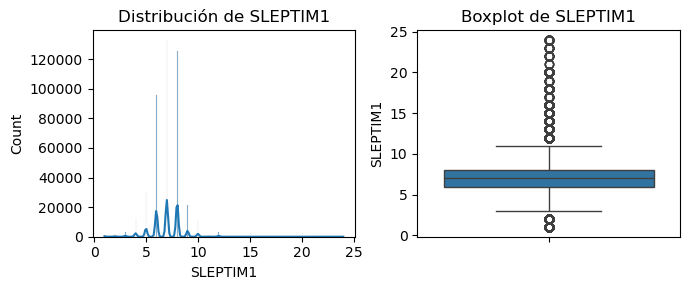

In [13]:
# Librerías para graficar
import matplotlib.pyplot as plt
import seaborn as sns

# Estadísticas de la variable SLEPTIM1
print("Estadísticas de la variable numérica 'SLEPTIM1':")
print(df['SLEPTIM1'].describe())

# Crear subplots para histograma y boxplot
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(7, 3))

# Analizar la distribución de la variable 'SLEPTIM1' y mostrar boxplot
col = 'SLEPTIM1'

# Histograma
sns.histplot(data=df, x=col, kde=True, ax=axes[0])
axes[0].set_title(f"Distribución de {col}")

# Boxplot
sns.boxplot(data=df, y=col, ax=axes[1])
axes[1].set_title(f"Boxplot de {col}")

plt.tight_layout()
plt.show()

La variable "SLEPTIM1", que representa la cantidad de horas de sueño que una persona obtiene en un período de 24 horas, muestra una distribución con valores atípicos que podrían ser tanto reales como errores de entrada, como ya lo indicaban datos numéricos obtenidos antes. El problema es determinar en que punto las horas que refiere una persona que ha dormido son reales, aun cuando sean valores atípicos, aunque resulta difícil definir el límite a partir de que una persona señala que duerme más 20 horas al día, o que duerme 1 hora al día. 

Por tanto, dado que aún esos valores atípicos pueden ser válidos, se va a categorizar la variable para capturar esos valores dentro de una categoría.

Propuesta de categorización:

1. Sueño muy corto: Menos de 5 horas. Esta categoría captura aquellos valores extremadamente bajos que podrían indicar condiciones de salud subyacentes o errores de reporte.
2. Sueño corto: 5 a 6 horas. Aunque menos extremo, dormir menos de 6 horas regularmente puede tener implicaciones negativas para la salud.
3. Sueño normal: 7 a 8 horas. Esta es la cantidad de sueño recomendada para la mayoría de los adultos.
4. Sueño largo: 9 a 10 horas. Esta categoría puede incluir a personas con necesidades de sueño ligeramente superiores.
5. Sueño muy largo: Más de 10 horas. Esta categoría captura los valores altos que podrían ser reales para ciertas condiciones médicas o errores de reporte.

Para lo anterior se va a crear una función categorizar_horas_sueño() que toma como entrada el número de horas de sueño y devuelve una categoría basada en rangos predefinidos. Y crear una nueva variable "SLEPTIM1_cat" categorizada.

In [14]:
# Función para categorizar las horas de sueño de la variable SLEPTIM1 en el dataset 
def categorizar_horas_sueño(horas):
    """
    Función para categorizar las horas de sueño con base en los siguientes rangos:
    - 1: Menos de 5 horas (sueño muy corto)
    - 2: 5-6 horas (sueño corto)
    - 3: 7-8 horas (sueño normal)
    - 4: 9-10 horas (sueño largo)
    - 5: Más de 10 horas (sueño muy largo)
    
    Parámetros:
    - horas: Número de horas de sueño (float o int)
    
    Retorna:
    - Categoría de horas de sueño (int)
    """
    
    # Comprobar en qué rango de horas se encuentra el valor
    if horas < 5:
        return 1
    elif horas < 7:
        return 2
    elif horas < 9:
        return 3
    elif horas < 11:
        return 4
    else:
        return 5

# Obtener la posición de la última columna 'CARDIO'
last_column_pos = df.columns.get_loc('CARDIO')

# Aplicar la función de categorización a la columna 'SLEPTIM1'
# e insertar la nueva columna 'SLEPTIM1_cat' antes de 'CARDIO'
df.insert(last_column_pos, 'SLEPTIM1_cat', df['SLEPTIM1'].apply(categorizar_horas_sueño))

Se elimina la variable original "SLEPTIM1" del conjunto de datos, una vez creada la variable categórica.

In [15]:
# Eliminar columna después de crear la variable categorizada
df.drop(['SLEPTIM1'], axis=1, inplace=True)

Se comprueban las categorías de la nueva variable creada.

In [16]:
# Especificar la columna 'SLEPTIM1_cat'
col = 'SLEPTIM1_cat'

# Obtener el recuento de valores por categoría
recuento = df[col].value_counts(dropna=False)

# Calcular las frecuencias relativas y redondear a dos decimales
frecuencias = (df[col].value_counts(normalize=True, dropna=False) * 100).round(2)

# Mostrar el recuento y porcentaje para cada categoría en una misma fila
print(f"Recuento y porcentaje de valores por categoría de la columna '{col}':")
for valor in recuento.index:
    print(f"{valor}: {recuento[valor]} ({frecuencias[valor]}%)")

Recuento y porcentaje de valores por categoría de la columna 'SLEPTIM1_cat':
3: 258369 (58.76%)
2: 126002 (28.66%)
4: 31670 (7.2%)
1: 18396 (4.18%)
5: 5245 (1.19%)


Una vez creada la variable objetivo y categorizada la variable numérica, se va a mostrar el recuento de valores y las frecuencias relativas para cada categoría en todas las columnas. Para las variables categóricas, este análisis muestra de manera clara todas las categorías presentes en los datos y su prevalencia relativa. Los resultados de este análisis ayudan a decidir sobre cómo manejar ciertas variables, como combinar categorías raras, eliminar variables con una gran cantidad de datos faltantes o aplicar técnicas de sobremuestreo o submuestreo para equilibrar las clases en la variable objetivo en la fase de modelado en el conjunto de entrenamiento.

In [17]:
# Iterar sobre todas las columnas del DataFrame
for col in df.columns:
    # Obtener el recuento de valores por categoría
    recuento = df[col].value_counts(dropna=False)
    
    # Calcular las frecuencias relativas y redondear a dos decimales
    frecuencias = (df[col].value_counts(normalize=True, dropna=False) * 100).round(2)
    
    # Mostrar el recuento y porcentaje para cada categoría en una misma fila
    print(f"Recuento y porcentaje de valores por categoría de la columna '{col}':")
    for valor in recuento.index:
        print(f"{valor}: {recuento[valor]} ({frecuencias[valor]}%)")
    print()

Recuento y porcentaje de valores por categoría de la columna 'SEXVAR':
2: 232680 (52.92%)
1: 207002 (47.08%)

Recuento y porcentaje de valores por categoría de la columna 'MEDCOST1':
2: 401733 (91.37%)
1: 36554 (8.31%)
7: 1047 (0.24%)
9: 348 (0.08%)

Recuento y porcentaje de valores por categoría de la columna 'EXERANY2':
1: 334516 (76.08%)
2: 104222 (23.7%)
7: 670 (0.15%)
9: 274 (0.06%)

Recuento y porcentaje de valores por categoría de la columna 'ASTHMA3':
2: 372301 (84.68%)
1: 65774 (14.96%)
7: 1408 (0.32%)
9: 199 (0.05%)

Recuento y porcentaje de valores por categoría de la columna 'CHCOCNC1':
2: 387816 (88.2%)
1: 49631 (11.29%)
7: 1919 (0.44%)
9: 316 (0.07%)

Recuento y porcentaje de valores por categoría de la columna 'CHCCOPD3':
2: 402791 (91.61%)
1: 34878 (7.93%)
7: 1768 (0.4%)
9: 245 (0.06%)

Recuento y porcentaje de valores por categoría de la columna 'ADDEPEV3':
2: 347049 (78.93%)
1: 90056 (20.48%)
7: 2021 (0.46%)
9: 556 (0.13%)

Recuento y porcentaje de valores por categor

En la mayoría de las variables, se observa que las categorías 7 y 9 representan un porcentaje muy pequeño de las observaciones, generalmente menor al 1%. Dado el gran tamaño del conjunto de datos, eliminar estas filas no debería tener un impacto significativo en los análisis posteriores.

Sin embargo, hay dos variables que presentan un porcentaje más elevado de respuestas codificadas como 7 y 9: "_RFSMOK3" (si la persona fuma) y "_RFDRHV8" (si la persona bebe alcohol). En "_RFSMOK3", aproximadamente el 7.88% de las personas se niegan a responder, mientras que en "_RFDRHV8", alrededor del 11.03% se niegan a responder. Aunque estos porcentajes son más altos en comparación con otras variables, dado el gran tamaño del conjunto de datos, aún se dispondrá de suficientes observaciones para entrenar los modelos después de eliminar estas filas.

Las respuestas "No sabe/No está seguro" y "Se niega a responder" no proporcionan información útil para el análisis y pueden introducir ruido en los modelos, al eliminarlas los datos utilizados serán más precisos y confiables. Al tener un conjunto de datos más limpio y consistente, sin categorías especiales que requieran un tratamiento diferenciado, se simplifica el proceso de análisis y modelado. Dado que el conjunto de datos es grande, eliminar un pequeño porcentaje de filas no debería afectar significativamente la capacidad de los modelos.

Después de eliminar las filas con valores iguales a 7 y 9, es importante volver a comprobar el porcentaje de categorías en la variable objetivo ("CARDIO") para asegurarse de que esta eliminación no haya afectado de manera significativa la proporción de las categorías.

In [18]:
# Eliminar las filas que contienen los valores 7 y/o 9

df = df[(df['MEDCOST1'] != 7) & (df['MEDCOST1'] != 9)]
df = df[(df['EXERANY2'] != 7) & (df['EXERANY2'] != 9)]
df = df[(df['ASTHMA3'] != 7) & (df['ASTHMA3'] != 9)]
df = df[(df['CHCOCNC1'] != 7) & (df['CHCOCNC1'] != 9)]
df = df[(df['CHCCOPD3'] != 7) & (df['CHCCOPD3'] != 9)]
df = df[(df['ADDEPEV3'] != 7) & (df['ADDEPEV3'] != 9)]
df = df[(df['CHCKDNY2'] != 7) & (df['CHCKDNY2'] != 9)]
df = df[(df['HAVARTH4'] != 7) & (df['HAVARTH4'] != 9)]
df = df[(df['DIABETE4'] != 7) & (df['DIABETE4'] != 9)]
df = df[(df['DEAF'] != 7) & (df['DEAF'] != 9)]
df = df[(df['BLIND'] != 7) & (df['BLIND'] != 9)]
df = df[(df['DECIDE'] != 7) & (df['DECIDE'] != 9)]
df = df[(df['DIFFWALK'] != 7) & (df['DIFFWALK'] != 9)]
df = df[(df['DIFFDRES'] != 7) & (df['DIFFDRES'] != 9)]
df = df[(df['DIFFALON'] != 7) & (df['DIFFALON'] != 9)]
df = df[(df['COVIDPOS'] != 7) & (df['COVIDPOS'] != 9)]
df = df[(df['_RFHLTH'] != 9)]
df = df[(df['_PHYS14D'] != 9)]
df = df[(df['_MENT14D'] != 9)]
df = df[(df['_EDUCAG'] != 9)]
df = df[(df['_RFSMOK3'] != 9)]
df = df[(df['_RFDRHV8'] != 9)]
df = df[(df['_AGEG5YR'] != 14)]


Se comprueba si se han realizado los cambios correctamente.

In [19]:
# Iterar sobre todas las columnas del DataFrame
for col in df.columns:
    # Obtener el recuento de valores por categoría
    recuento = df[col].value_counts(dropna=False)
    
    # Calcular las frecuencias relativas y redondear a dos decimales
    frecuencias = (df[col].value_counts(normalize=True, dropna=False) * 100).round(2)
    
    # Mostrar el recuento y porcentaje para cada categoría en una misma fila
    print(f"Recuento y porcentaje de valores por categoría de la columna '{col}':")
    for valor in recuento.index:
        print(f"{valor}: {recuento[valor]} ({frecuencias[valor]}%)")
    print()

Recuento y porcentaje de valores por categoría de la columna 'SEXVAR':
2: 187176 (52.88%)
1: 166792 (47.12%)

Recuento y porcentaje de valores por categoría de la columna 'MEDCOST1':
2: 326349 (92.2%)
1: 27619 (7.8%)

Recuento y porcentaje de valores por categoría de la columna 'EXERANY2':
1: 273320 (77.22%)
2: 80648 (22.78%)

Recuento y porcentaje de valores por categoría de la columna 'ASTHMA3':
2: 300927 (85.02%)
1: 53041 (14.98%)

Recuento y porcentaje de valores por categoría de la columna 'CHCOCNC1':
2: 313451 (88.55%)
1: 40517 (11.45%)

Recuento y porcentaje de valores por categoría de la columna 'CHCCOPD3':
2: 326987 (92.38%)
1: 26981 (7.62%)

Recuento y porcentaje de valores por categoría de la columna 'ADDEPEV3':
2: 280583 (79.27%)
1: 73385 (20.73%)

Recuento y porcentaje de valores por categoría de la columna 'CHCKDNY2':
2: 338046 (95.5%)
1: 15922 (4.5%)

Recuento y porcentaje de valores por categoría de la columna 'HAVARTH4':
2: 233776 (66.04%)
1: 120192 (33.96%)

Recuento 

Una de las principales preocupaciones al eliminar filas es que pueda afectar significativamente la proporción de categorías en la variable objetivo, lo que podría introducir un sesgo en el análisis y modelado posteriores. Sin embargo, al comparar los porcentajes de la categoría minoritaria en "CARDIO" antes y después de la eliminación de filas, se observa que la diferencia es mínima. Antes de la eliminación, la categoría minoritaria representaba el 11.64% de los datos, mientras que después de la eliminación, representa el 11.32%. Esta diferencia de 0.32 puntos porcentuales indica que la eliminación de filas no ha afectado de manera importante la proporción de categorías en la variable objetivo, lo cual es una buena noticia para la integridad y representatividad de los datos.

En cuanto a la variable "_INCOMG1", que representa las categorías de ingresos, se ha decidido mantener todas sus categorías a pesar de que contiene valores 7 y 9. Ya que la categoría 7 corresponde a ingresos de "$200,000 o más", mientras que la categoría 9 se refiere a "No sabe/No está seguro/Faltante". Dado que la categoría 9 representa una proporción significativa (15.76%) de las observaciones en "_INCOMG1", se ha optado por no eliminar estas filas. La variable "_INCOMG1" es ordinal, con categorías que van desde ingresos bajos hasta ingresos altos. Eliminar las filas con valores 9 podría alterar la distribución de los datos y la representatividad de las categorías de ingresos en el análisis. La categoría 9, aunque no proporciona información directa sobre el nivel de ingresos, puede ser relevante para el análisis, ya que indica una falta de datos o motivaciones para negarse a responder.


Se realiza una recodificación de los valores en varias columnas. Específicamente, para las variables que tienen dos categorías, donde la respuesta hace referencia a "Sí" o "No", se recodifican los valores de manera que el valor 2 (correspondiente a "No") se reemplaza por 0, mientras que el valor 1 (correspondiente a "Sí") se mantiene sin cambios.

Con la recodificación, las variables se convierten en variables binarias o indicadoras, donde 1 indica la presencia de una condición o característica, y 0 indica su ausencia. Esto hace que los resultados sean más intuitivos y fáciles de interpretar.


In [20]:
columnas_a_reemplazar = [
    'MEDCOST1', 'ASTHMA3', 'CHCOCNC1', 'CHCCOPD3', 'ADDEPEV3', 'CHCKDNY2',     
    'HAVARTH4', 'DEAF', 'BLIND', 'DECIDE', 'DIFFWALK', 'DIFFDRES', 'DIFFALON'
]

# Reemplazar los valores 2 por 0 en las columnas especificadas
df[columnas_a_reemplazar] = df[columnas_a_reemplazar].replace(2, 0)

Se realiza una recodificación de los valores en la columna 'DIABETE4' con el objetivo de reducir la variable a dos categorías principales: una que indica la presencia de diabetes o prediabetes (categoría 1) y otra que indica la ausencia de diabetes (categoría 0). 

La variable original 'DIABETE4' tiene cuatro categorías: diabetes (1), diabetes gestacional (2), ausencia de diabetes (3) y prediabetes (4). Sin embargo, para el análisis y modelado posterior, se considera relevante agrupar estas categorías en dos grupos principales. Por un lado, se agrupan las categorías de diabetes (1) y prediabetes (4) en una sola categoría (1), ya que ambas condiciones representan un riesgo elevado de desarrollar diabetes o indican la presencia de la enfermedad. Por otro lado, las categorías de ausencia de diabetes (3) y diabetes gestacional (2) se agrupan en una sola categoría (0), que representan la ausencia de diabetes.


In [21]:
# Este código reemplaza los valores 4 por 1, y los valores 2 y 3 por 0 en la columna 'DIABETE4'.
df['DIABETE4'] = df['DIABETE4'].replace({4: 1, 2: 0, 3: 0})

Se realiza una recodificación de los valores en la columna 'COVIDPOS'. El objetivo es simplificar la variable y agrupar las categorías relacionadas con la presencia de COVID-19 en una sola categoría, mientras que la ausencia de COVID-19 se codifica en otra categoría.

La variable original 'COVIDPOS' tiene tres categorías principales: 1 indica que la persona ha tenido COVID-19, 2 indica que no ha tenido COVID-19 y 3 indica que ha dado positivo en una prueba casera de COVID-19. Para el análisis y modelado posterior, se considera apropiado tratar los casos de prueba casera positiva (categoría 3) como casos confirmados de COVID-19, similar a la categoría 1.

Esta recodificación trata los casos de prueba casera positiva como casos confirmados de COVID-19, se está considerando que un resultado positivo en una prueba casera es una indicación confiable de la presencia de la enfermedad.

Por tanto, se agrupan las categorías relacionadas con la presencia de COVID-19 (valores 1 y 3) en una sola categoría codificada como 1, mientras que la ausencia de COVID-19 (valor 2) se codifica como 0. 

In [22]:
# Recodificar la variable COVIDPOS
df['COVIDPOS'] = df['COVIDPOS'].replace({3: 1, 2: 0})

Se realiza una recodificación de los valores en las columnas 'EXERANY2', '_RFHLTH', '_RFSMOK3' y '_RFDRHV8'. El objetivo es cambiar la codificación de estas variables para que sean consistentes y reflejen de manera más intuitiva la presencia o ausencia de ciertos factores de riesgo.

Para la variable 'EXERANY2', que indica si una persona hace ejercicio o no, la categoría original 1 indica que hace ejercicio y la categoría 2 indica que no lo hace. Se realiza una recodificación para que el valor 0 represente que la persona hace ejercicio y el valor 1 represente que no lo hace. 

En cuanto a la variable '_RFHLTH', que indica el estado de salud de una persona, la categoría original 2 indica una mala salud y la categoría 1 indica una buena salud. Se realiza una recodificación para que el valor 0 represente una buena salud y el valor 1 represente una mala salud. 

Para la variable '_RFSMOK3', que indica si una persona fuma o no, la categoría original 2 indica que la persona fuma y la categoría 1 indica que no fuma. Se realiza una recodificación para que el valor 0 represente que la persona no fuma y el valor 1 represente que sí fuma.

Por último, para la variable '_RFDRHV8', que indica si una persona bebe mucho alcohol o no, la categoría original 2 indica que la persona bebe mucho alcohol y la categoría 1 indica que no bebe mucho alcohol. Se realiza una recodificación para que el valor 0 represente que la persona no bebe mucho alcohol y el valor 1 represente que sí bebe mucho alcohol. 

La razón principal detrás de estas recodificaciones es hacer que las variables sean más intuitivas y consistentes en su interpretación. Al asignar el valor 0 a las categorías que representan la ausencia de un factor de riesgo (hacer ejercicio, tener buena salud, no fumar, no beber mucho alcohol) y el valor 1 a las categorías que representan la presencia de un factor de riesgo (no hacer ejercicio, tener mala salud, fumar, beber mucho alcohol), se facilita la comprensión y el análisis posterior de estas variables.

Además, la recodificación de estas variables en un formato binario (0 y 1) las hace consistentes con otras variables del conjunto de datos que también han sido recodificadas de manera similar. Esto permite un análisis más coherente y una comparación más directa entre las diferentes variables de riesgo.

In [23]:
# Cambiar los valores de las variables 'EXERANY2', '_RFHLTH', '_RFSMOK3' y '_RFDRHV8'
variables = ['EXERANY2','_RFHLTH', '_RFSMOK3',  '_RFDRHV8']
df[variables] = df[variables].replace({1: 0, 2: 1})

Se comprueba si ser han realizado todas las transformaciones de manera correcta.

In [24]:
# Iterar sobre todas las columnas del DataFrame
for col in df.columns:
    # Obtener el recuento de valores por categoría
    recuento = df[col].value_counts(dropna=False)
    
    # Calcular las frecuencias relativas y redondear a dos decimales
    frecuencias = (df[col].value_counts(normalize=True, dropna=False) * 100).round(2)
    
    # Mostrar el recuento y porcentaje para cada categoría en una misma fila
    print(f"Recuento y porcentaje de valores por categoría de la columna '{col}':")
    for valor in recuento.index:
        print(f"{valor}: {recuento[valor]} ({frecuencias[valor]}%)")
    print()

Recuento y porcentaje de valores por categoría de la columna 'SEXVAR':
2: 187176 (52.88%)
1: 166792 (47.12%)

Recuento y porcentaje de valores por categoría de la columna 'MEDCOST1':
0: 326349 (92.2%)
1: 27619 (7.8%)

Recuento y porcentaje de valores por categoría de la columna 'EXERANY2':
0: 273320 (77.22%)
1: 80648 (22.78%)

Recuento y porcentaje de valores por categoría de la columna 'ASTHMA3':
0: 300927 (85.02%)
1: 53041 (14.98%)

Recuento y porcentaje de valores por categoría de la columna 'CHCOCNC1':
0: 313451 (88.55%)
1: 40517 (11.45%)

Recuento y porcentaje de valores por categoría de la columna 'CHCCOPD3':
0: 326987 (92.38%)
1: 26981 (7.62%)

Recuento y porcentaje de valores por categoría de la columna 'ADDEPEV3':
0: 280583 (79.27%)
1: 73385 (20.73%)

Recuento y porcentaje de valores por categoría de la columna 'CHCKDNY2':
0: 338046 (95.5%)
1: 15922 (4.5%)

Recuento y porcentaje de valores por categoría de la columna 'HAVARTH4':
0: 233776 (66.04%)
1: 120192 (33.96%)

Recuento 

# ANÁLISIS EXPLORATORIO

En los capítulos anteriores, se ha llevado a cabo un proceso de carga y preprocesamiento de los datos. Este proceso ha incluido la imputación de valores nulos, la eliminación de categorías no relevantes (como 7, 9, 77 y 99), la recodificación de algunas categorías de las variables y el tratamiento de valores atípicos. Estos pasos han sido necesarios para garantizar la calidad y la integridad de los datos antes de proceder con el análisis exploratorio.

Ahora, en este capítulo, nos centraremos en realizar un análisis exploratorio de los datos preprocesados. El objetivo principal de este análisis es obtener una comprensión más profunda del conjunto de datos y descubrir patrones, relaciones y tendencias interesantes entre las distintas variables. A través de técnicas de visualización y pruebas estadísticas, podremos obtener información sobre la distribución de las variables, las asociaciones entre ellas y su relación con la variable objetivo.

Para llevar a cabo lo anterior, se van a crear cuatro funciones específicas para realizar comparaciones entre variables y determinar la significancia estadística de las relaciones observadas.

La primera función se utilizará para realizar la prueba de chi cuadrado al comparar dos variables categóricas. Esta prueba permitirá determinar si existe una relación estadísticamente significativa entre las variables, es decir, si la distribución observada de las categorías difiere significativamente de lo que se esperaría por azar.

La segunda función se utilizará para realizar la prueba de chi cuadrado al comparar más de dos variables categóricas. Esta función permitirá evaluar la relación entre múltiples variables simultáneamente y determinar si hay una asociación significativa entre ellas.

La tercera función se encargará de crear visualizaciones al comparar dos variables. Estas visualizaciones ayudarán a comprender de manera gráfica la distribución de las categorías y la relación entre las variables. 

Por último, la cuarta función se utilizará para crear visualizaciones al comparar tres variables. Esta función permitirá explorar la interacción entre tres variables y descubrir patrones más complejos en los datos.


In [25]:
# Librería para calcular la prueba de chi cuadrado
from scipy.stats import chi2_contingency

# Función para realizar la prueba de chi-cuadrado entre 2 variables
def prueba_chi2(df, columna1, columna2):
    """
    Realiza una prueba de Chi-cuadrado para evaluar la independencia entre dos variables categóricas.

    Esta función calcula la prueba de Chi-cuadrado utilizando la función `chi2_contingency` de la librería
    `scipy.stats`. Crea una tabla de contingencia a partir de las dos columnas especificadas del DataFrame
    y realiza la prueba de independencia.

    Parámetros:
    - df (DataFrame): El DataFrame de pandas que contiene los datos.
    - columna1 (str): El nombre de la primera columna categórica.
    - columna2 (str): El nombre de la segunda columna categórica.

    La función imprime los resultados de la prueba, incluyendo el valor de Chi-cuadrado, el p-valor y los
    grados de libertad. Además, interpreta el resultado comparando el p-valor con un nivel de significancia
    definido (por defecto, alpha = 0.05).
    Si el p-valor es menor que alpha, se rechaza la hipótesis nula y se concluye que existe una diferencia
    estadísticamente significativa entre las dos variables categóricas a un nivel de significancia del 95%.
    Si el p-valor es mayor o igual que alpha, no se rechaza la hipótesis nula y se concluye que no hay
    suficiente evidencia para afirmar una diferencia significativa.

    Ejemplo de uso:
    prueba_chi2(df, '_IMPRACE', 'CARDIO')
    """
    # Crear una tabla de contingencia
    tabla_contingencia = pd.crosstab(df[columna1], df[columna2])
    
    # Realizar la prueba de Chi-cuadrado para la independencia
    chi2, p, dof, expected = chi2_contingency(tabla_contingencia)
    
    # Definir el nivel de significancia
    alpha = 0.05
    
    # Imprimir los resultados de la prueba
    print(f"Chi-cuadrado: {chi2}")
    print(f"p-valor: {p}")
    print(f"Grados de libertad: {dof}")
    
    # Interpretar el resultado
    if p < alpha:
        print(
            f"Rechazamos la hipótesis nula. Existe una diferencia estadísticamente significativa entre {columna1} y "
            f"{columna2} a un nivel de significancia del 95%.")
    else:
        print(
            f"No rechazamos la hipótesis nula. No hay suficiente evidencia para afirmar que existe una diferencia "
            f"estadísticamente significativa entre {columna1} y {columna2} a un nivel de significancia del 95%.")


In [26]:

# Función para realizar la prueba de chi-cuadrado multivariable
def prueba_chi2_multivariable(df, *variables):
    """
    Realiza la prueba de chi-cuadrado para evaluar la independencia entre múltiples variables categóricas.

    Parámetros:
    - df: DataFrame de pandas que contiene las variables categóricas.
    - *variables: Una o más variables categóricas para evaluar su independencia.

    La función crea una tabla de contingencia multidimensional a partir de las variables especificadas,
    aplica la prueba de chi-cuadrado utilizando la función chi2_contingency de scipy.stats y muestra
    los resultados de la prueba, incluyendo el valor de chi-cuadrado, el p-valor y los grados de libertad.

    Además, interpreta el resultado de la prueba comparando el p-valor con un nivel de significancia
    predefinido (por defecto, alpha = 0.05). Si el p-valor es menor que alpha, se rechaza la hipótesis
    nula y se concluye que existe una diferencia estadísticamente significativa entre las variables.
    Si el p-valor es mayor o igual que alpha, no se rechaza la hipótesis nula y se concluye que no hay
    suficiente evidencia para afirmar una diferencia significativa.

    Ejemplo de uso:
    prueba_chi2_multivariable(df, 'variable1', 'variable2', 'variable3')

    Esto evaluará la independencia entre las variables 'variable1', 'variable2' y 'variable3' en el
    DataFrame 'df' utilizando la prueba de chi-cuadrado.
    """
    # Crear una tabla de contingencia multidimensional
    tabla_contingencia = df.groupby(list(variables)).size().unstack(fill_value=0)
    
    # Aplicar la prueba de chi-cuadrado
    chi2, p, dof, expected = chi2_contingency(tabla_contingencia)

    # Definir el nivel de significancia
    alpha = 0.05
    
    # Imprimir los resultados de la prueba
    print(f"Chi-cuadrado: {chi2}")
    print(f"p-valor: {p}")
    print(f"Grados de libertad: {dof}")
    
    # Interpretar el resultado
    if p < alpha:
        print(
            f"Rechazamos la hipótesis nula. Existe una diferencia estadísticamente significativa entre "
            f"{', '.join(variables)} a un nivel de significancia del {(1 - alpha) * 100}%.")
    else:
        print(
            f"No rechazamos la hipótesis nula. No hay suficiente evidencia para afirmar que existe una diferencia "
            f"estadísticamente significativa entre {', '.join(variables)} a un nivel de significancia del "
            f"{(1 - alpha) * 100}%.")

In [27]:

# Función para graficar la comparación entre dos variables categóricas
def graficar_comparacion(df, var_grupo, var_objetivo, etiquetas_x=None, 
                         etiquetas_y=None, titulo=None, etiqueta_x=None, 
                         etiqueta_y=None, tamaño_figura=(6, 4), 
                         posicion_leyenda='best'):

    """
    Crea un gráfico de barras apiladas para comparar las proporciones de una variable objetivo
    dentro de cada categoría de una variable de grupo.

    Parámetros:
    - df (DataFrame): El DataFrame que contiene los datos.
    - var_grupo (str): El nombre de la columna que representa la variable de grupo.
    - var_objetivo (str): El nombre de la columna que representa la variable objetivo.
    - etiquetas_x (list, opcional): Una lista de etiquetas personalizadas para el eje x.
      Por defecto es None, lo que utiliza las etiquetas originales de var_grupo.
    - etiquetas_y (list, opcional): Una lista de etiquetas personalizadas para las categorías
      de var_objetivo. Por defecto es None, lo que utiliza las etiquetas ['No', 'Si'].
    - titulo (str, opcional): El título del gráfico. Por defecto es None, lo que genera
      un título automático basado en var_grupo y var_objetivo.
    - etiqueta_x (str, opcional): La etiqueta del eje x. Por defecto es None, lo que utiliza
      el nombre de var_grupo.
    - etiqueta_y (str, opcional): La etiqueta del eje y. Por defecto es None, lo que utiliza
      'Porcentaje'.
    - tamaño_figura (tuple, opcional): El tamaño de la figura en pulgadas (ancho, alto).
      Por defecto es (6, 4).
    - posicion_leyenda (str, opcional): La posición de la leyenda en el gráfico. Por defecto
      es 'best', lo que busca la mejor posición automáticamente.

    Retorna:
    - None. La función muestra el gráfico directamente.

    Ejemplo de uso:
     graficar_comparacion(df, '_IMPRACE', 'CARDIO', etiqueta_x='Raza', 
                          titulo='Enfermedad cardiovascular por raza',
                          etiquetas_x=['Blanco', 'Negro', 'Asiático', 'Indígena', 
                          'Hispano', 'Otra raza'])
    Este ejemplo grafica la comparación de las proporciones de 'CARDIO' dentro de cada categoría
    de '_IMPRACE', utilizando etiquetas personalizadas para los ejes x, y un título personalizado.                      
    """
    
    # Calcular las proporciones para cada categoría de var_objetivo dentro de cada categoría de var_grupo
    proporciones = df.groupby(var_grupo)[var_objetivo].value_counts(normalize=True).unstack()

    # Convertir las proporciones a porcentajes
    proporciones = proporciones.apply(lambda x: x * 100)

    # Renombrar las categorías de var_objetivo en el DataFrame de proporciones
    if etiquetas_y is not None:
        proporciones.columns = etiquetas_y
    else:
        proporciones.columns = ['No', 'Sí']

    # Crear un gráfico de barras apiladas para mostrar las proporciones
    fig, ax = plt.subplots(figsize=tamaño_figura)

    # Crear un gráfico de barras apiladas para mostrar las proporciones
    ax = proporciones.plot(kind='bar', stacked=True, ax=ax)

    # Establecer el título del gráfico
    if titulo is not None:
        plt.title(titulo)
    else:
        plt.title(f'Comparación entre {var_grupo} y {var_objetivo}')

    # Establecer la etiqueta del eje x
    if etiqueta_x is not None:
        plt.xlabel(etiqueta_x)
    else:
        plt.xlabel(var_grupo)

    # Establecer la etiqueta del eje y
    if etiqueta_y is not None:
        plt.ylabel(etiqueta_y)
    else:
        plt.ylabel('Porcentaje')

    # Personalizar las etiquetas en el eje x si se proporcionan
    if etiquetas_x is not None:
        ax.set_xticklabels(etiquetas_x)

    # Añadir una leyenda con los nombres de las categorías
    plt.legend(title=var_objetivo, loc=posicion_leyenda)

    # Ajustar la orientación de las etiquetas en el eje x a horizontal
    plt.xticks(rotation=0)

    # Añadir porcentajes al centro de cada barra
    for p in ax.patches:
        width = p.get_width()
        height = p.get_height()
        x, y = p.get_xy()
        if p.get_height() > 0:  # Solo añadir porcentajes a las barras donde var_objetivo=1
            ax.annotate(f'{height:.1f}%', (x + width / 2, y + height / 2), ha='center', va='center')

    plt.tight_layout()
    plt.show()


In [28]:

# Función para graficar un heatmap de la prevalencia de una variable por otras dos variables
def graficar_heatmap(df, var_fila, var_columna, var_valor, etiquetas_fila=None, 
                     etiquetas_columna=None, titulo=None, etiqueta_fila=None, 
                     etiqueta_columna=None, tamaño_figura=(6, 4), 
                     posicion_leyenda='best'):

    """
    Crea un heatmap para visualizar la prevalencia de una variable valor por las combinaciones
    de dos variables categóricas (fila y columna).

    Parámetros:
    - df (DataFrame): El DataFrame que contiene los datos.
    - var_fila (str): El nombre de la columna que representa la variable de las filas.
    - var_columna (str): El nombre de la columna que representa la variable de las columnas.
    - var_valor (str): El nombre de la columna que representa la variable de valor (prevalencia).
    - etiquetas_fila (list, opcional): Una lista de etiquetas personalizadas para las filas.
      Por defecto es None, lo que utiliza las etiquetas originales de var_fila.
    - etiquetas_columna (list, opcional): Una lista de etiquetas personalizadas para las columnas.
      Por defecto es None, lo que utiliza las etiquetas originales de var_columna.
    - titulo (str, opcional): El título del gráfico. Por defecto es None, lo que genera
      un título automático basado en var_valor, var_fila y var_columna.
    - etiqueta_fila (str, opcional): La etiqueta del eje y (filas). Por defecto es None,
      lo que utiliza el nombre de var_fila.
    - etiqueta_columna (str, opcional): La etiqueta del eje x (columnas). Por defecto es None,
      lo que utiliza el nombre de var_columna.
    - tamaño_figura (tuple, opcional): El tamaño de la figura en pulgadas (ancho, alto).
      Por defecto es (6, 4).
    - posicion_leyenda (str, opcional): La posición de la leyenda en el gráfico. Por defecto
      es 'best', lo que busca la mejor posición automáticamente.

    Retorna:
    - None. La función muestra el gráfico directamente.

    Ejemplo de uso:
    graficar_heatmap(df, '_EDUCAG', '_INCOMG1', 'CARDIO',
                 titulo='Enfermedad Cardiovascular por nivel educativo y rango de ingreso',
                 etiquetas_fila=['Sin secundaria', 'Con secundaria', 'Sin universidad', 'Graduado de universidad'],
                 etiqueta_columna='Rango de Ingreso',
                 etiqueta_fila='Nivel educativo',
                 tamaño_figura=(6, 4))
    Este ejemplo grafica un heatmap de la prevalencia de 'CARDIO' por las combinaciones de '_EDUCAG'
    y '_INCOMG1', utilizando etiquetas personalizadas para las filas y columnas, tamaño de la figura
    y un título personalizado.
    """
    
    # Calcular la prevalencia de la variable valor por las variables fila y columna
    tabla_prevalencia = df.pivot_table(values=var_valor, index=var_fila, columns=var_columna, aggfunc='mean')

    # Convertir la prevalencia a porcentaje
    tabla_prevalencia *= 100

    # Crear el heatmap
    plt.figure(figsize=tamaño_figura)
    sns.heatmap(tabla_prevalencia, annot=True, cmap='coolwarm', fmt=".1f", 
                cbar_kws={'label': 'Prevalencia (%)'})

    # Establecer el título del gráfico
    if titulo is not None:
        plt.title(titulo)
    else:
        plt.title(f'Prevalencia de {var_valor} por {var_fila} y {var_columna}')

    # Establecer la etiqueta del eje x
    if etiqueta_columna is not None:
        plt.xlabel(etiqueta_columna)
    else:
        plt.xlabel(var_columna)

    # Establecer la etiqueta del eje y
    if etiqueta_fila is not None:
        plt.ylabel(etiqueta_fila)
    else:
        plt.ylabel(var_fila)

    # Cambiar las etiquetas del eje vertical (var_fila)
    if etiquetas_fila is not None:
        posiciones_fila = np.arange(len(etiquetas_fila)) + 0.5
        plt.yticks(posiciones_fila, etiquetas_fila, rotation=0)

    # Cambiar las etiquetas del eje horizontal (var_columna)
    if etiquetas_columna is not None:
        posiciones_columna = np.arange(len(etiquetas_columna)) + 0.5
        plt.xticks(posiciones_columna, etiquetas_columna, ha='center')

    plt.tight_layout()
    plt.show()

**¿Cuál es la distribución de la raza en pacientes con enfermedades cardiovasculares?**

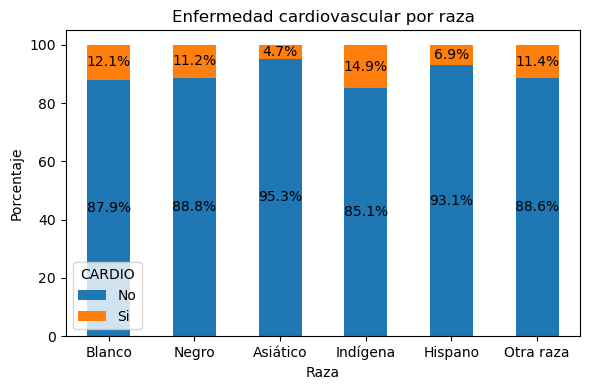

Chi-cuadrado: 1295.7502168564713
p-valor: 5.321343641771617e-278
Grados de libertad: 5
Rechazamos la hipótesis nula. Existe una diferencia estadísticamente significativa entre _IMPRACE y CARDIO a un nivel de significancia del 95%.


In [29]:
# Gráfica de comparación entre raza y enfermedad cardiovascular
graficar_comparacion(df, '_IMPRACE', 'CARDIO', etiqueta_x='Raza', 
                     titulo='Enfermedad cardiovascular por raza',
                     etiquetas_x=['Blanco', 'Negro', 'Asiático', 'Indígena', 
                                  'Hispano', 'Otra raza'])

# Comprobar si las diferencias son estadísticamente significativas
prueba_chi2(df, '_IMPRACE', 'CARDIO')

**¿Cuál es la relación entre la edad y la enfermedad cardiovascular?**

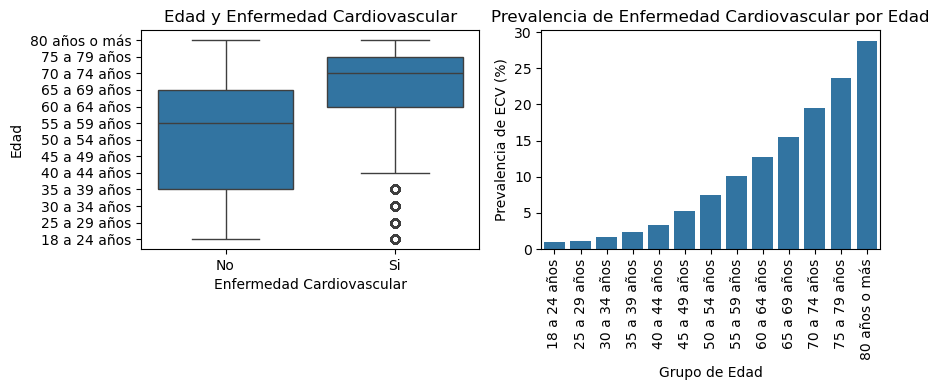

Chi-cuadrado: 26201.09917021746
p-valor: 0.0
Grados de libertad: 12
Rechazamos la hipótesis nula. Existe una diferencia estadísticamente significativa entre _AGEG5YR y CARDIO a un nivel de significancia del 95%.


In [30]:
# Mapeo de las edades 
edad_etiquetas = {
    1: '18 a 24 años',
    2: '25 a 29 años',
    3: '30 a 34 años',
    4: '35 a 39 años',
    5: '40 a 44 años',
    6: '45 a 49 años',
    7: '50 a 54 años',
    8: '55 a 59 años',
    9: '60 a 64 años',
    10: '65 a 69 años',
    11: '70 a 74 años',
    12: '75 a 79 años',
    13: '80 años o más'    
}

# Crear una figura con 1 fila y 2 columnas
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(9, 4))

# Gráfico de caja (boxplot)
sns.boxplot(x='CARDIO', y='_AGEG5YR', data=df, ax=ax1)
ax1.set_title('Edad y Enfermedad Cardiovascular')
ax1.set_xlabel('Enfermedad Cardiovascular')
ax1.set_ylabel('Edad')
ax1.set_yticks(list(edad_etiquetas.keys()))
ax1.set_yticklabels(list(edad_etiquetas.values()))

# Establecer los valores de los ticks en el eje x
ax1.set_xticks([0, 1])

# Cambiar las etiquetas del eje x en la primera figura
ax1.set_xticklabels(['No', 'Sí'])

# Calcular la prevalencia de enfermedad cardiovascular por grupo de edad
age_prevalence = df.groupby('_AGEG5YR')['CARDIO'].mean() * 100

# Gráfico de barras
sns.barplot(x=age_prevalence.index, y=age_prevalence.values, ax=ax2)
ax2.set_title('Prevalencia de Enfermedad Cardiovascular por Edad')
ax2.set_xlabel('Grupo de Edad')
ax2.set_ylabel('Prevalencia de ECV (%)')
ax2.set_xticks(range(len(edad_etiquetas)))
ax2.set_xticklabels(list(edad_etiquetas.values()), rotation=90)

# Ajustar el espaciado entre los subplots
plt.tight_layout()

plt.show()

# Comprobar si las diferencias son estadísticamente significativas
prueba_chi2(df, '_AGEG5YR', 'CARDIO')


**¿Hay relación entre el nivel de ingresos y la prevalencia de enfermedad cardiovascular?**

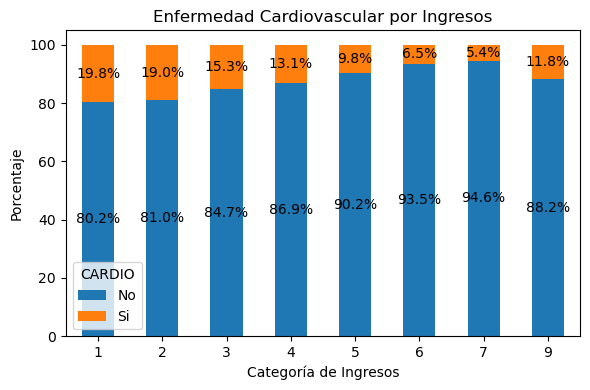

Chi-cuadrado: 5953.959966762007
p-valor: 0.0
Grados de libertad: 7
Rechazamos la hipótesis nula. Existe una diferencia estadísticamente significativa entre _INCOMG1 y CARDIO a un nivel de significancia del 95%.


In [31]:
# Gráfica de comparación entre ingresos y enfermedad cardiovascular
graficar_comparacion(df, '_INCOMG1', 'CARDIO',
                     titulo='Enfermedad Cardiovascular por Ingresos',
                     etiqueta_x='Categoría de Ingresos')

# Comprobar si las diferencias son estadísticamente significativas
prueba_chi2(df, '_INCOMG1', 'CARDIO')

**¿Cómo se distribuye el tiempo de sueño entre los pacientes con y sin enfermedades cardiovasculares?**

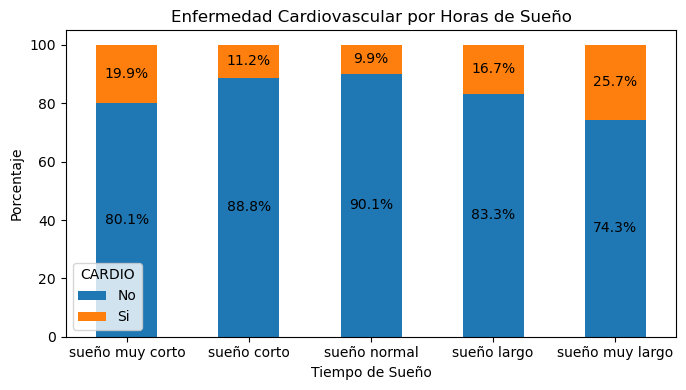

Chi-cuadrado: 2897.2559626443235
p-valor: 0.0
Grados de libertad: 4
Rechazamos la hipótesis nula. Existe una diferencia estadísticamente significativa entre SLEPTIM1_cat y CARDIO a un nivel de significancia del 95%.


In [32]:
# Gráfica de comparación entre tiempo de sueño y enfermedad cardiovascular
graficar_comparacion(df, 'SLEPTIM1_cat', 'CARDIO', 
                     etiquetas_x=['sueño muy corto', 'sueño corto', 
                                  'sueño normal', 'sueño largo', 'sueño muy largo'],                     
                     titulo='Enfermedad Cardiovascular por Horas de Sueño',
                     etiqueta_x='Tiempo de Sueño',
                     etiqueta_y='Porcentaje',
                     tamaño_figura=(7, 4),
                     posicion_leyenda='lower left')

# Comprobar si las diferencias son estadísticamente significativas
prueba_chi2(df, 'SLEPTIM1_cat', 'CARDIO')

**¿Las personas con obesidad tienen mayor prevalencia de enfermedad cardiovascular que las personas con peso normal?**

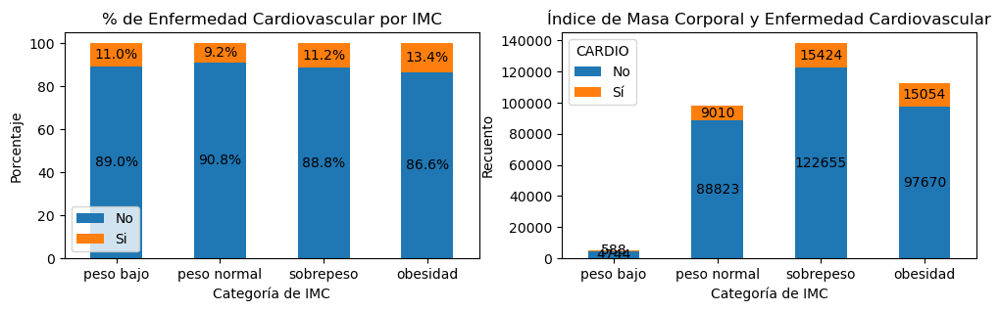

Chi-cuadrado: 902.3647002102784
p-valor: 2.717106209199584e-195
Grados de libertad: 3
Rechazamos la hipótesis nula. Existe una diferencia estadísticamente significativa entre _BMI5CAT y CARDIO a un nivel de significancia del 95%.


In [33]:

# Calcular las proporciones para cada categoría de CARDIO dentro de cada categoría de peso
proporciones = df.groupby('_BMI5CAT')['CARDIO'].value_counts(normalize=True).unstack()

# Convertir las proporciones a porcentajes
proporciones = proporciones.apply(lambda x: x * 100)

# Renombrar las categorías de CARDIO en el DataFrame de proporciones
proporciones.columns = ['No', 'Sí']

# Renombrar las categorías de peso en el DataFrame de proporciones
proporciones.index = ['peso bajo', 'peso normal', 'sobrepeso', 'obesidad']

# Calcular la tabla de cruce para obtener los recuentos
recuentos = pd.crosstab(df['_BMI5CAT'], df['CARDIO'])

# Renombrar la leyenda
recuentos.columns = ['No', 'Sí']

# Crear una figura con dos subgráficos
fig, axs = plt.subplots(1, 2, figsize=(12, 3))

# Crear el primer gráfico de barras apiladas para mostrar las proporciones
axs[0] = proporciones.plot(kind='bar', stacked=True, ax=axs[0])

axs[0].set_title('% de Enfermedad Cardiovascular por IMC')
axs[0].set_xlabel('Categoría de IMC')
axs[0].set_ylabel('Porcentaje')

# Ajustar la orientación de las etiquetas en el eje x a horizontal
plt.sca(axs[0])
plt.xticks(rotation=0)

# Añadir porcentajes al centro de cada barra en el primer gráfico
for p in axs[0].patches:
    width = p.get_width()
    height = p.get_height()
    x, y = p.get_xy()
    if p.get_height() > 0: 
        axs[0].annotate(f'{height:.1f}%', (x + width / 2, y + height / 2), ha='center', va='center')

# Crear el segundo gráfico de barras apiladas para mostrar los recuentos
axs[1] = recuentos.plot(kind='bar', stacked=True, ax=axs[1])

axs[1].set_title('Índice de Masa Corporal y Enfermedad Cardiovascular')
axs[1].set_xlabel('Categoría de IMC')
axs[1].set_ylabel('Recuento')

# Personalizar las etiquetas en el eje horizontal
nuevas_etiquetas = ['peso bajo', 'peso normal', 'sobrepeso', 'obesidad']
axs[1].set_xticklabels(nuevas_etiquetas)

# Añadir una leyenda con los nuevos nombres de las categorías
axs[1].legend(title='CARDIO', loc='upper left')

# Ajustar la orientación de las etiquetas en el eje x a horizontal
plt.sca(axs[1])
plt.xticks(rotation=0)

# Añadir recuentos al centro de cada barra en el segundo gráfico
for p in axs[1].patches:
    width = p.get_width()
    height = p.get_height()
    x, y = p.get_xy()
    axs[1].annotate(f'{height:.0f}', (x + width / 2, y + height / 2), ha='center', va='center')

plt.show()

# Comprobar si las diferencias son estadísticamente significativas
prueba_chi2(df, '_BMI5CAT', 'CARDIO')

**¿Cómo varía la prevalencia de diabetes entre los pacientes con y sin enfermedades cardiovasculares?**

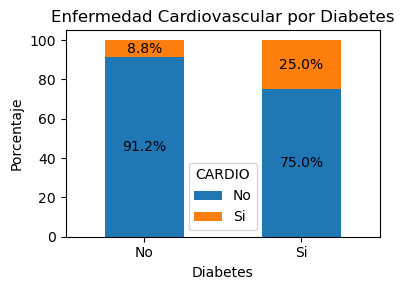

Chi-cuadrado: 12348.901995400929
p-valor: 0.0
Grados de libertad: 1
Rechazamos la hipótesis nula. Existe una diferencia estadísticamente significativa entre DIABETE4 y CARDIO a un nivel de significancia del 95%.


In [34]:
# Gráfica de comparación entre diabetes y enfermedad cardiovascular
graficar_comparacion(df, 'DIABETE4', 'CARDIO', 
                     etiquetas_x=['No', 'Si'],
                     titulo='Enfermedad Cardiovascular por Diabetes',
                     etiqueta_x='Diabetes',
                     tamaño_figura=(4, 3)
                     )

# Comprobar si las diferencias son estadísticamente significativas
prueba_chi2(df, 'DIABETE4', 'CARDIO')

**¿Las personas con menor nivel educativo tienen mayor prevalencia de enfermedad cardiovascular?**

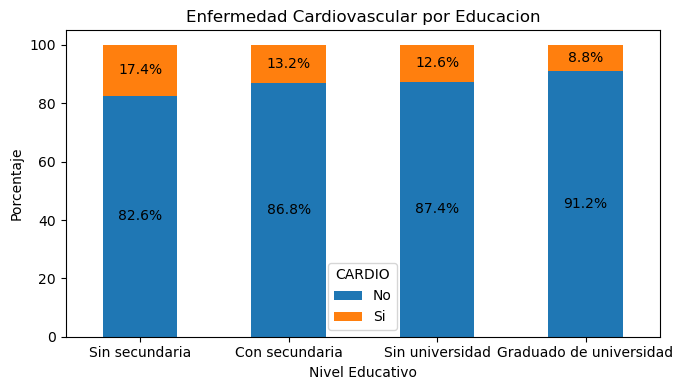

Chi-cuadrado: 2092.056169582211
p-valor: 0.0
Grados de libertad: 3
Rechazamos la hipótesis nula. Existe una diferencia estadísticamente significativa entre _EDUCAG y CARDIO a un nivel de significancia del 95%.


In [35]:
# Gráfica de comparación entre educación y enfermedad cardiovascular
graficar_comparacion(df, '_EDUCAG', 'CARDIO', 
                     etiquetas_x=['Sin secundaria', 'Con secundaria', 
                                  'Sin universidad', 'Graduado de universidad'],
                     titulo='Enfermedad Cardiovascular por Educación',
                     etiqueta_x='Nivel Educativo',
                     tamaño_figura=(7, 4)
                     )

# Comprobar si las diferencias son estadísticamente significativas
prueba_chi2(df, '_EDUCAG', 'CARDIO')

**¿Las personas con artritis o enfermedades inflamatorias tienen mayor prevalencia de enfermedad cardiovascular?**

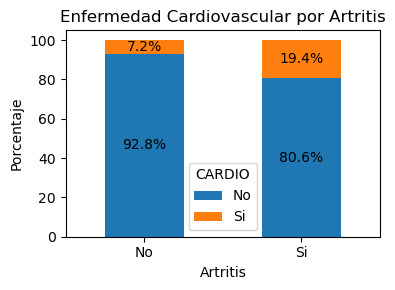

Chi-cuadrado: 11882.475528112707
p-valor: 0.0
Grados de libertad: 1
Rechazamos la hipótesis nula. Existe una diferencia estadísticamente significativa entre HAVARTH4 y CARDIO a un nivel de significancia del 95%.


In [36]:
# Gráfica de comparación entre artritis y enfermedad cardiovascular
graficar_comparacion(df, 'HAVARTH4', 'CARDIO', 
                     etiquetas_x=['No', 'Sí'],
                     titulo='Enfermedad Cardiovascular por Artritis',
                     etiqueta_x='Artritis',
                     tamaño_figura=(4, 3)
                     )

# Comprobar si las diferencias son estadísticamente significativas
prueba_chi2(df, 'HAVARTH4', 'CARDIO')

**¿Hay diferencia en el porcentaje de enfermedad cardiovascular entre hombres y mujeres?**

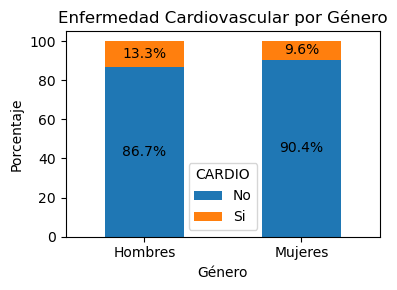

Chi-cuadrado: 1210.8034697698529
p-valor: 2.7378679167752655e-265
Grados de libertad: 1
Rechazamos la hipótesis nula. Existe una diferencia estadísticamente significativa entre SEXVAR y CARDIO a un nivel de significancia del 95%.


In [37]:
# Gráfica de comparación entre género y enfermedad cardiovascular
graficar_comparacion(df, 'SEXVAR', 'CARDIO', 
                     etiquetas_x=['Hombres', 'Mujeres'],
                     titulo='Enfermedad Cardiovascular por Género',
                     etiqueta_x='Género',
                     tamaño_figura=(4, 3)
                     )

# Comprobar si las diferencias son estadísticamente significativas
prueba_chi2(df, 'SEXVAR', 'CARDIO')

**¿Cuál es la prevalencia de enfermedad cardiovascular por asma?**

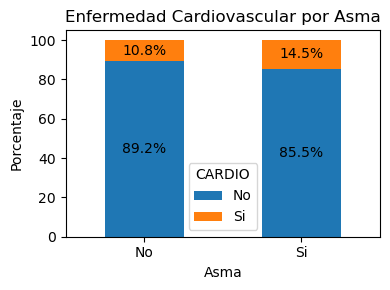

Chi-cuadrado: 643.7865490220237
p-valor: 5.0167705254941194e-142
Grados de libertad: 1
Rechazamos la hipótesis nula. Existe una diferencia estadísticamente significativa entre ASTHMA3 y CARDIO a un nivel de significancia del 95%.


In [38]:
# Gráfica de comparación entre asma y enfermedad cardiovascular
graficar_comparacion(df, 'ASTHMA3', 'CARDIO', 
                     etiquetas_x=['No', 'Sí'],
                     titulo='Enfermedad Cardiovascular por Asma',
                     etiqueta_x='Asma',
                     tamaño_figura=(4, 3)
                     )

# Comprobar si las diferencias son estadísticamente significativas
prueba_chi2(df, 'ASTHMA3', 'CARDIO')

**¿Hay relación entre haber sido diagnosticado con cáncer y tener enfermedad cardiovascular?**

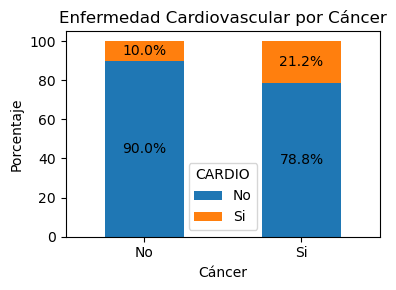

Chi-cuadrado: 4439.821809507166
p-valor: 0.0
Grados de libertad: 1
Rechazamos la hipótesis nula. Existe una diferencia estadísticamente significativa entre CHCOCNC1 y CARDIO a un nivel de significancia del 95%.


In [39]:
# Gráfica de comparación entre cáncer y enfermedad cardiovascular
graficar_comparacion(df, 'CHCOCNC1', 'CARDIO', 
                     etiquetas_x=['No', 'Sí'],
                     titulo='Enfermedad Cardiovascular por Cáncer',
                     etiqueta_x='Cáncer',
                     tamaño_figura=(4, 3)
                     )

# Comprobar si las diferencias son estadísticamente significativas
prueba_chi2(df, 'CHCOCNC1', 'CARDIO')

**¿Cómo se relaciona el nivel de salud mental (Estrés, Ansiedad) con la prevalencia de enfermedad cardiovascular?**

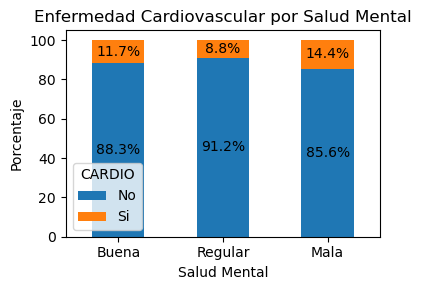

Chi-cuadrado: 1053.9774408294415
p-valor: 1.354274492319934e-229
Grados de libertad: 2
Rechazamos la hipótesis nula. Existe una diferencia estadísticamente significativa entre _MENT14D y CARDIO a un nivel de significancia del 95%.


In [40]:
# Gráfica de comparación entre salud mental y enfermedad cardiovascular
graficar_comparacion(df, '_MENT14D', 'CARDIO', 
                     etiquetas_x=['Buena', 'Regular', 'Mala'],
                     titulo='Enfermedad Cardiovascular por Salud Mental',
                     etiqueta_x='Salud Mental',
                     tamaño_figura=(4, 3)
                     )

# Comprobar si las diferencias son estadísticamente significativas
prueba_chi2(df, '_MENT14D', 'CARDIO')

**¿Las personas que han tenido un episodio depresivo tienen mayor prevalencia de enfermedad cardiovascular?**

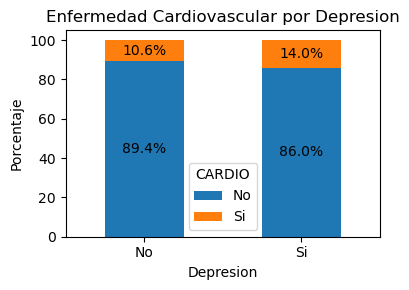

Chi-cuadrado: 643.0179031187329
p-valor: 7.372116505667736e-142
Grados de libertad: 1
Rechazamos la hipótesis nula. Existe una diferencia estadísticamente significativa entre ADDEPEV3 y CARDIO a un nivel de significancia del 95%.


In [41]:
# Gráfica de comparación entre depresión y enfermedad cardiovascular
graficar_comparacion(df, 'ADDEPEV3', 'CARDIO', 
                     etiquetas_x=['No', 'Sí'],
                     titulo='Enfermedad Cardiovascular por Depresión',
                     etiqueta_x='Depresión',
                     tamaño_figura=(4, 3)
                     )

# Comprobar si las diferencias son estadísticamente significativas
prueba_chi2(df, 'ADDEPEV3', 'CARDIO')

**¿Hay relación entre problemas renales y enfermedad cardiovascular?**

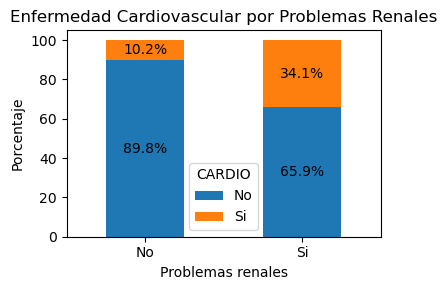

Chi-cuadrado: 8625.523712901999
p-valor: 0.0
Grados de libertad: 1
Rechazamos la hipótesis nula. Existe una diferencia estadísticamente significativa entre CHCKDNY2 y CARDIO a un nivel de significancia del 95%.


In [42]:
# Gráfica de comparación entre fallos renales y enfermedad cardiovascular
graficar_comparacion(df, 'CHCKDNY2', 'CARDIO', 
                     etiquetas_x=['No', 'Sí'],
                     titulo='Enfermedad Cardiovascular por Problemas Renales',
                     etiqueta_x='Problemas renales',
                     tamaño_figura=(4, 3)
                     )

# Comprobar si las diferencias son estadísticamente significativas
prueba_chi2(df, 'CHCKDNY2', 'CARDIO')

**¿Fumar se relaciona con mayor prevalencia de enfermedad cardiovascular?**

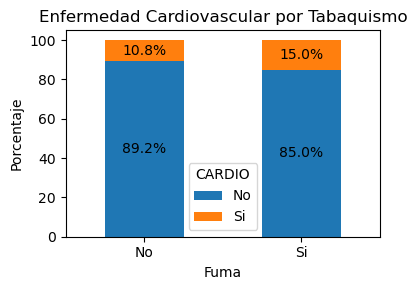

Chi-cuadrado: 617.6772578901328
p-valor: 2.3930216105384404e-136
Grados de libertad: 1
Rechazamos la hipótesis nula. Existe una diferencia estadísticamente significativa entre _RFSMOK3 y CARDIO a un nivel de significancia del 95%.


In [43]:
# Gráfica de comparación entre fumar y enfermedad cardiovascular
graficar_comparacion(df, '_RFSMOK3', 'CARDIO', 
                     etiquetas_x=['No', 'Sí'],
                     titulo='Enfermedad Cardiovascular por Tabaquismo',
                     etiqueta_x='Fuma',
                     tamaño_figura=(4, 3)
                     )

# Comprobar si las diferencias son estadísticamente significativas
prueba_chi2(df, '_RFSMOK3', 'CARDIO')

**¿Consumir alcohol se relaciona con mayor prevalencia de enfermedad cardiovascular?**

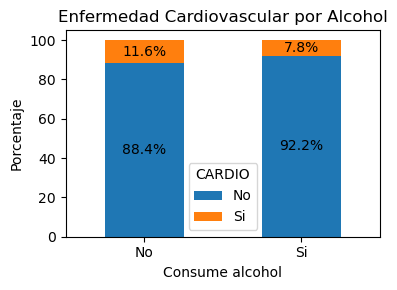

Chi-cuadrado: 310.9569092805922
p-valor: 1.3513550422824238e-69
Grados de libertad: 1
Rechazamos la hipótesis nula. Existe una diferencia estadísticamente significativa entre _RFDRHV8 y CARDIO a un nivel de significancia del 95%.


In [44]:
# Gráfica de comparación entre consumo de alcohol y enfermedad cardiovascular
graficar_comparacion(df, '_RFDRHV8', 'CARDIO', 
                     etiquetas_x=['No', 'Sí'],
                     titulo='Enfermedad Cardiovascular por Alcohol',
                     etiqueta_x='Consume alcohol',
                     tamaño_figura=(4, 3)
                     )

# Comprobar si las diferencias son estadísticamente significativas
prueba_chi2(df, '_RFDRHV8', 'CARDIO')

**¿Hay una mayor prevalencia de enfermedad cardiovascular en las personas que han tenido COVID?**

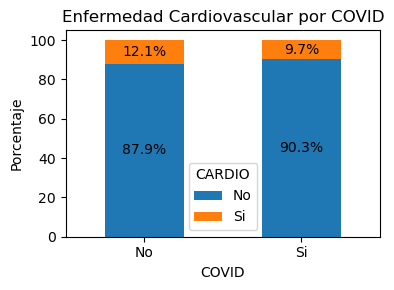

Chi-cuadrado: 451.7569220018993
p-valor: 2.990627878450894e-100
Grados de libertad: 1
Rechazamos la hipótesis nula. Existe una diferencia estadísticamente significativa entre COVIDPOS y CARDIO a un nivel de significancia del 95%.


In [45]:
# Gráfica de comparación entre COVID y enfermedad cardiovascular
graficar_comparacion(df, 'COVIDPOS', 'CARDIO', 
                     etiquetas_x=['No', 'Sí'],
                     titulo='Enfermedad Cardiovascular por COVID',
                     etiqueta_x='COVID',
                     tamaño_figura=(4, 3)
                     )

# Comprobar si las diferencias son estadísticamente significativas
prueba_chi2(df, 'COVIDPOS', 'CARDIO')

**¿Hay una mayor prevalencia de enfermedad cardiovascular en las personas que tienen enfisema?**

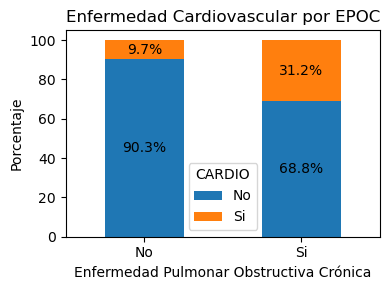

Chi-cuadrado: 11462.420480015728
p-valor: 0.0
Grados de libertad: 1
Rechazamos la hipótesis nula. Existe una diferencia estadísticamente significativa entre CHCCOPD3 y CARDIO a un nivel de significancia del 95%.


In [46]:
# Gráfica de comparación entre EPOC y enfermedad cardiovascular
graficar_comparacion(df, 'CHCCOPD3', 'CARDIO', 
                     etiquetas_x=['No', 'Sí'],
                     titulo='Enfermedad Cardiovascular por EPOC',
                     etiqueta_x='Enfermedad Pulmonar Obstructiva Crónica',
                     tamaño_figura=(4, 3)
                     )

# Comprobar si las diferencias son estadísticamente significativas
prueba_chi2(df, 'CHCCOPD3', 'CARDIO')

**¿Cómo varía la prevalencia de enfermedad cardiovascular según el nivel educativo y el ingreso?**

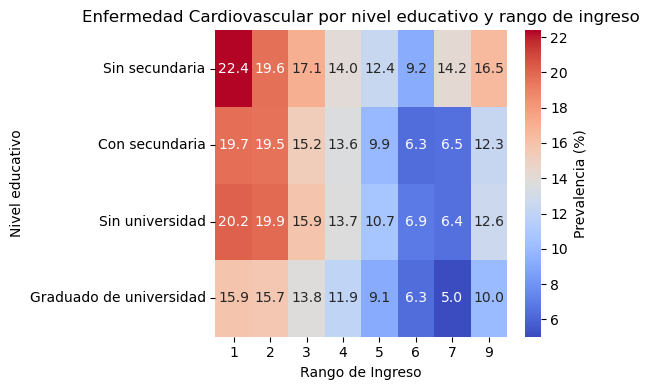

Chi-cuadrado: 6390.5311441923295
p-valor: 0.0
Grados de libertad: 31
Rechazamos la hipótesis nula. Existe una diferencia estadísticamente significativa entre _EDUCAG, _INCOMG1, CARDIO a un nivel de significancia del 95.0%.


In [48]:
# Gráfico de prevalencia de enfermedad cardiovascular por nivel educativo y rango de ingreso
graficar_heatmap(df, '_EDUCAG', '_INCOMG1', 'CARDIO',
                 titulo='Enfermedad Cardiovascular por nivel educativo y rango de ingreso',
                 etiquetas_fila=['Sin secundaria', 'Con secundaria', 
                                  'Sin universidad', 'Graduado de universidad'],
                 etiqueta_columna='Rango de Ingreso',
                 etiqueta_fila='Nivel educativo',
                 tamaño_figura=(6, 4))

# Comprobar si las diferencias son estadísticamente significativas
prueba_chi2_multivariable(df, '_EDUCAG', '_INCOMG1', 'CARDIO')

**¿Cómo se relaciona la raza/etnia con la prevalencia de enfermedad cardiovascular según el nivel de ingresos?**

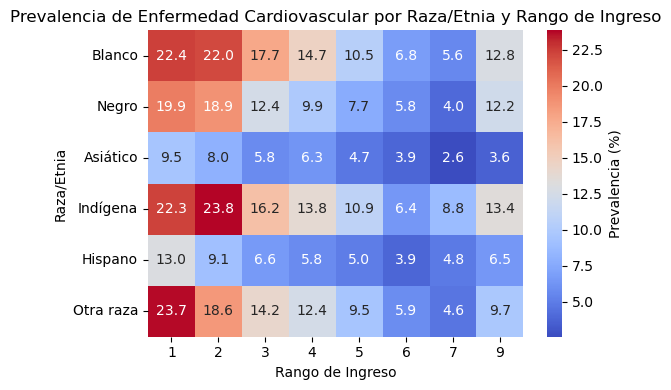

Chi-cuadrado: 8572.473480844581
p-valor: 0.0
Grados de libertad: 47
Rechazamos la hipótesis nula. Existe una diferencia estadísticamente significativa entre _IMPRACE, _INCOMG1, CARDIO a un nivel de significancia del 95.0%.


In [49]:
# Gráfico de prevalencia de enfermedad cardiovascular por raza y rango de ingreso
graficar_heatmap(df, '_IMPRACE', '_INCOMG1', 'CARDIO', 
                 etiquetas_fila=['Blanco', 'Negro', 'Asiático', 'Indígena', 'Hispano', 'Otra raza'],
                 titulo='Prevalencia de Enfermedad Cardiovascular por Raza/Etnia y Rango de Ingreso',
                 etiqueta_columna='Rango de Ingreso',
                 etiqueta_fila='Raza/Etnia',
                 tamaño_figura=(6, 4))

# Comprobar si las diferencias son estadísticamente significativas
prueba_chi2_multivariable(df, '_IMPRACE', '_INCOMG1', 'CARDIO')

**¿Cómo se relacionan las horas de sueño con la prevalencia de enfermedad cardiovascular según su actividad física?**

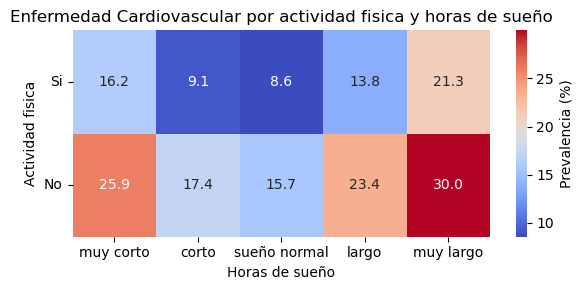

Chi-cuadrado: 6696.112325018072
p-valor: 0.0
Grados de libertad: 9
Rechazamos la hipótesis nula. Existe una diferencia estadísticamente significativa entre EXERANY2, SLEPTIM1_cat, CARDIO a un nivel de significancia del 95.0%.


In [50]:
# Gráfico de prevalencia de enfermedad cardiovascular por actividad física y horas de sueño
graficar_heatmap(df, 'EXERANY2', 'SLEPTIM1_cat', 'CARDIO',
                 etiquetas_fila=['Sí', 'No'],
                 etiquetas_columna=['muy corto', 'corto', 'sueño normal', 'largo', 'muy largo'],
                 titulo='Enfermedad Cardiovascular por actividad física y horas de sueño',
                 etiqueta_columna='Horas de sueño',
                 etiqueta_fila='Actividad física',
                 tamaño_figura=(6, 3))

# Comprobar si las diferencias son estadísticamente significativas
prueba_chi2_multivariable(df, 'EXERANY2', 'SLEPTIM1_cat', 'CARDIO')

**¿Cómo se relacionan las horas de sueño con la prevalencia de enfermedad cardiovascular según su salud mental?**

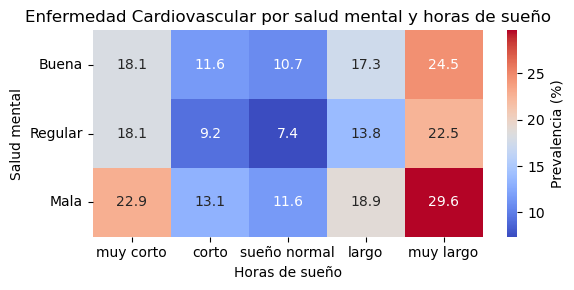

Chi-cuadrado: 3746.8399494604223
p-valor: 0.0
Grados de libertad: 14
Rechazamos la hipótesis nula. Existe una diferencia estadísticamente significativa entre _MENT14D, SLEPTIM1_cat, CARDIO a un nivel de significancia del 95.0%.


In [51]:
# Gráfico de prevalencia de enfermedad cardiovascular por salud mental y horas de sueño
graficar_heatmap(df, '_MENT14D', 'SLEPTIM1_cat', 'CARDIO',
                 etiquetas_fila=['Buena', 'Regular', 'Mala'],
                 etiquetas_columna=['muy corto', 'corto', 'sueño normal', 'largo', 'muy largo'],
                 titulo='Enfermedad Cardiovascular por salud mental y horas de sueño',
                 etiqueta_columna='Horas de sueño',
                 etiqueta_fila='Salud mental',
                 tamaño_figura=(6, 3))

# Comprobar si las diferencias son estadísticamente significativas
prueba_chi2_multivariable(df, '_MENT14D', 'SLEPTIM1_cat', 'CARDIO')

**¿Cómo se relaciona el deterioro cognitivo con la prevalencia de enfermedad cardiovascular según las horas de sueño?**

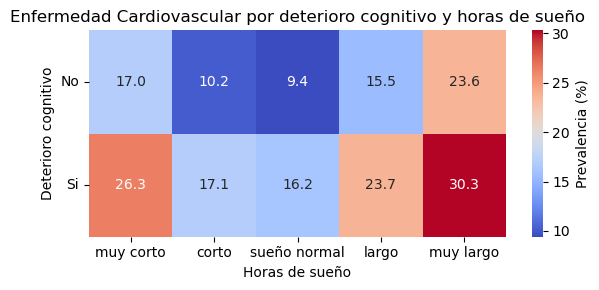

Chi-cuadrado: 4649.624870243326
p-valor: 0.0
Grados de libertad: 9
Rechazamos la hipótesis nula. Existe una diferencia estadísticamente significativa entre DECIDE, SLEPTIM1_cat, CARDIO a un nivel de significancia del 95.0%.


In [52]:
# Gráfico de prevalencia de enfermedad cardiovascular por deterioro cognitivo y horas de sueño
graficar_heatmap(df, 'DECIDE', 'SLEPTIM1_cat', 'CARDIO',
                 etiquetas_fila=['No', 'Sí'],
                 etiquetas_columna=['muy corto', 'corto', 'sueño normal', 'largo', 'muy largo'],
                 titulo='Enfermedad Cardiovascular por deterioro cognitivo y horas de sueño',
                 etiqueta_columna='Horas de sueño',
                 etiqueta_fila='Deterioro cognitivo',
                 tamaño_figura=(6, 3))

# Comprobar si las diferencias son estadísticamente significativas
prueba_chi2_multivariable(df, 'DECIDE', 'SLEPTIM1_cat', 'CARDIO')

**¿Cómo varía la prevalencia de enfermedad cardiovascular según el nivel educativo, el ingreso y la raza/etnia?**

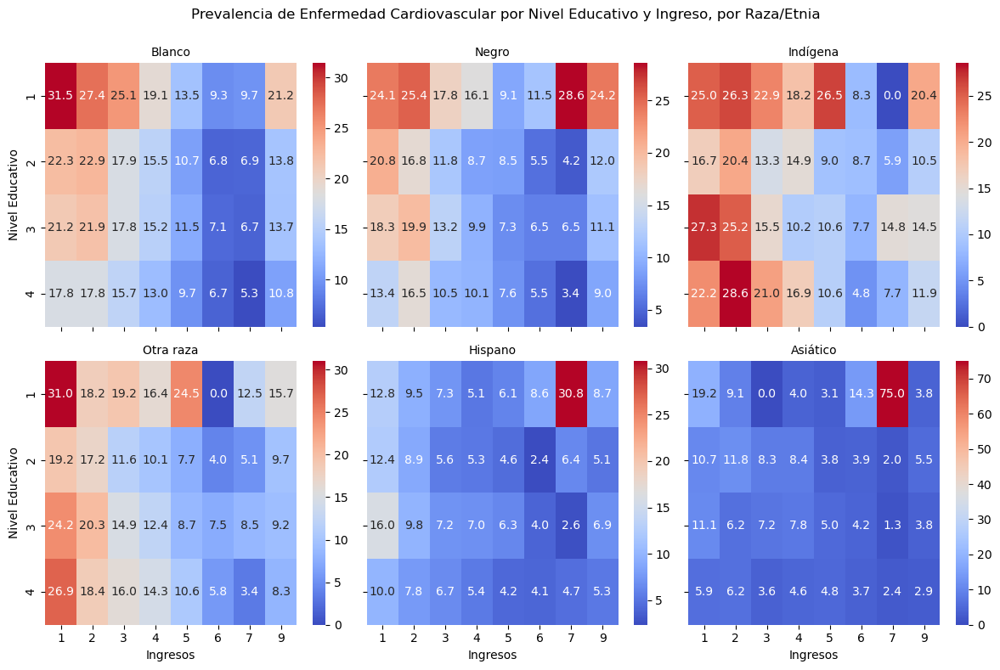

Chi-cuadrado: 9590.382891643603
p-valor: 0.0
Grados de libertad: 191
Rechazamos la hipótesis nula. Existe una diferencia estadísticamente significativa entre _IMPRACE, _EDUCAG, _INCOMG1, CARDIO a un nivel de significancia del 95.0%.


In [53]:
# Definir el diccionario de mapeo para las etiquetas de raza
etiquetas_raza = {1: 'Blanco', 2: 'Negro', 3: 'Asiático', 4: 'Indígena', 5: 'Hispano', 6: 'Otra raza'}

# Crear una copia del DataFrame solo para la visualización
df_vis = df.copy()

# Aplicar el mapeo a la columna '_IMPRACE' en el DataFrame de visualización
df_vis['_IMPRACE'] = df_vis['_IMPRACE'].map(etiquetas_raza)

# Calcular la prevalencia de enfermedad cardiovascular por nivel educativo e ingreso, separada por raza/etnia
g = sns.FacetGrid(df_vis, col='_IMPRACE', col_wrap=3, height=4)
g.map_dataframe(lambda data, color: sns.heatmap(data.pivot_table(index='_EDUCAG', columns='_INCOMG1', 
                                                                 values='CARDIO', aggfunc='mean') * 100, 
                                                                 annot=True, fmt=".1f", cmap='coolwarm'))
g.set_titles(col_template="{col_name}")
g.set_axis_labels('Ingresos', 'Nivel Educativo')

g.fig.subplots_adjust(top=0.9)
g.fig.suptitle('Prevalencia de Enfermedad Cardiovascular por Nivel Educativo e Ingreso, por Raza/Etnia')
plt.show()

# Comprobar si las diferencias son estadísticamente significativas
prueba_chi2_multivariable(df, '_IMPRACE', '_EDUCAG', '_INCOMG1', 'CARDIO')


**¿Existe una brecha relevante en la prevalencia de enfermedad cardiovascular entre las personas de diferentes razas/etnias y niveles educativos?**

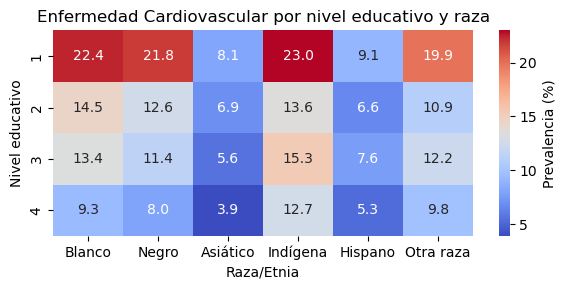

Chi-cuadrado: 4103.029884137574
p-valor: 0.0
Grados de libertad: 23
Rechazamos la hipótesis nula. Existe una diferencia estadísticamente significativa entre _IMPRACE, _EDUCAG, CARDIO a un nivel de significancia del 95.0%.


In [54]:
# Gráfico de prevalencia de enfermedad cardiovascular por nivel educativo y raza
graficar_heatmap(df, '_EDUCAG', '_IMPRACE', 'CARDIO',
                 etiquetas_columna=['Blanco', 'Negro', 'Asiático', 'Indígena', 'Hispano', 'Otra raza'],
                 titulo='Enfermedad Cardiovascular por nivel educativo y raza',
                 etiqueta_columna='Raza/Etnia',
                 etiqueta_fila='Nivel educativo',
                 tamaño_figura=(6, 3))

# Comprobar si las diferencias son estadísticamente significativas
prueba_chi2_multivariable(df, '_IMPRACE', '_EDUCAG', 'CARDIO')

**¿Hay una combinación preocupante de factores de riesgo de estilo de vida, como fumar, no hacer ejercicio y dormir poco, que se asocie con una prevalencia excepcionalmente alta de enfermedad cardiovascular?**

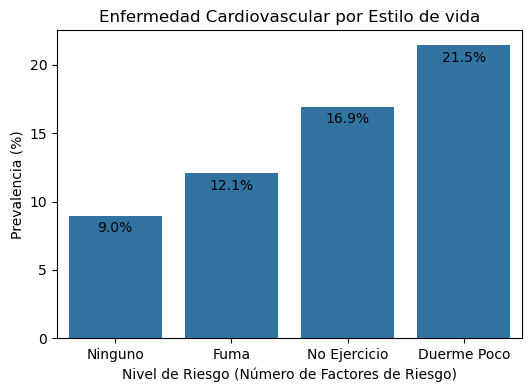

Chi-cuadrado: 3072.7476414623534
p-valor: 0.0
Grados de libertad: 3
Rechazamos la hipótesis nula. Existe una diferencia estadísticamente significativa entre Estilo de vida, CARDIO a un nivel de significancia del 95.0%.


In [55]:
# Crear nuevas variables en df_vis para cada factor de riesgo
df_vis['Fuma'] = df_vis['_RFSMOK3'].apply(lambda x: 'Sí' if x == 1 else 'No')
df_vis['No_Ejercicio'] = df_vis['EXERANY2'].apply(lambda x: 'Sí' if x == 1 else 'No')
df_vis['Duerme_Poco'] = df_vis['SLEPTIM1_cat'].apply(lambda x: 'Sí' if x in [1, 2] else 'No')

# Crear una nueva variable en df_vis que combine los factores de riesgo
def calcular_riesgo(row):
    riesgo = 0
    if row['Fuma'] == 'Sí':
        riesgo += 1
    if row['No_Ejercicio'] == 'Sí':
        riesgo += 1
    if row['Duerme_Poco'] == 'Sí':
        riesgo += 1
    return riesgo

df_vis['Estilo de vida'] = df_vis.apply(calcular_riesgo, axis=1)

# Calcular la prevalencia de enfermedad cardiovascular por nivel de riesgo en df_vis
prevalencia_riesgo = df_vis.groupby('Estilo de vida')['CARDIO'].mean() * 100

# Crear un gráfico de barras para visualizar la prevalencia de enfermedad cardiovascular por nivel de riesgo
plt.figure(figsize=(6, 4))
barplot = sns.barplot(x=prevalencia_riesgo.index, y=prevalencia_riesgo.values)
plt.title('Enfermedad Cardiovascular por Estilo de vida')
plt.xlabel('Nivel de Riesgo (Número de Factores de Riesgo)')
plt.ylabel('Prevalencia (%)')
plt.xticks(range(4), ['Ninguno', 'Fuma', 'No Ejercicio', 'Duerme Poco'])

# Añadir etiquetas de porcentaje dentro de cada barra
for p in barplot.patches:
    barplot.annotate(format(p.get_height(), '.1f') + '%', 
                     (p.get_x() + p.get_width() / 2., p.get_height()), 
                     ha='center', va='center', 
                     xytext=(0, -9), 
                     textcoords='offset points')

plt.show()

# Comprobar si las diferencias son estadísticamente significativas
prueba_chi2_multivariable(df_vis, 'Estilo de vida', 'CARDIO')

In [56]:
# Identificar la lista de columnas del dataset final
df.columns

Index(['SEXVAR', 'MEDCOST1', 'EXERANY2', 'ASTHMA3', 'CHCOCNC1', 'CHCCOPD3',
       'ADDEPEV3', 'CHCKDNY2', 'HAVARTH4', 'DIABETE4', 'DEAF', 'BLIND',
       'DECIDE', 'DIFFWALK', 'DIFFDRES', 'DIFFALON', 'COVIDPOS', '_METSTAT',
       '_IMPRACE', '_RFHLTH', '_PHYS14D', '_MENT14D', '_AGEG5YR', '_BMI5CAT',
       '_EDUCAG', '_INCOMG1', '_RFSMOK3', '_RFDRHV8', 'SLEPTIM1_cat',
       'CARDIO'],
      dtype='object')

Una vez preprocesado y explorado el conjunto de datos se va a guardar el conjunto de datos final.

# CONJUNTO DE DATOS FINAL

En este capítulo, después de haber realizado la carga de datos, el preprocesamiento y el análisis exploratorio, se procede a guardar el conjunto de datos final y limpio que se utilizará para entrenar los modelos de aprendizaje automático.

Al guardar el DataFrame en un archivo CSV, se preserva el estado final del conjunto de datos después de todas las transformaciones y limpiezas realizadas. Esto garantiza que se pueda acceder y utilizar el conjunto de datos final en el futuro sin tener que repetir todo el proceso de preprocesamiento. Además, evita la necesidad de volver a ejecutar todo el código de preprocesamiento cada vez que se quiera entrenar un modelo o realizar análisis adicionales. Cargar el archivo CSV suele ser mucho más rápido que volver a ejecutar todas las transformaciones y limpiezas en el conjunto de datos original.


## Guardar dataset final

In [138]:
# Guardar el conjunto de datos en formato CSV con codificación UTF-8
# df.to_csv('datos/CDV_final_30vars.csv', index=False)

El conjunto de datos final contiene 30 variables, incluida la variable objetivo.

## Cargar dataset final

Cargar el conjunto de datos final desde un archivo permite continuar con el análisis o el entrenamiento de modelos exactamente donde se dejó en la sesión anterior. No es necesario volver a ejecutar todo el código de preprocesamiento, lo que ahorra tiempo y recursos computacionales.

In [139]:
import pandas as pd

# Cargar el archivo CSV en un DataFrame
df = pd.read_csv("datos/CDV_final_30vars.csv")

## Cargar librerías para entrenar, graficar rendimiento e importancia de variables

Se importan diversas librerías y módulos que serán utilizados a lo largo del notebook para llevar a cabo diferentes tareas relacionadas con el aprendizaje automático y el análisis de datos. Estas librerías abarcan una amplia gama de funcionalidades, desde la separación de conjuntos de datos hasta la evaluación y visualización de resultados.

Una de las primeras tareas es la separación de los datos en conjuntos de entrenamiento, validación y prueba. Para ello, se importa la función train_test_split. Esta función permite dividir de manera aleatoria el conjunto de datos en subconjuntos de entrenamiento, validación y prueba para evaluar el rendimiento de los modelos y evitar el sobreajuste.

Para abordar el desequilibrio de clases en el conjunto de datos se importan librerías de submuestreo y sobremuestreo, como RandomUnderSampler, NearMiss, RandomOverSampler, SMOTE, entre otras, de las librerías imblearn.under_sampling e imblearn.over_sampling. Estas técnicas permiten equilibrar la distribución de las clases, ya sea reduciendo la clase mayoritaria o aumentando la clase minoritaria, lo cual puede mejorar el rendimiento de los modelos en conjuntos de datos desequilibrados.

Una vez que los datos están preparados se importan varios algoritmos, como regresión logística, Naive Bayes, árboles de decisión, ensambles (Random Forest, Gradient Boosting), XGBoost, LightGBM, máquinas de vectores de soporte (SVM), redes neuronales (MLP), entre otros. Estos modelos se utilizarán para entrenar y predecir la variable objetivo.

Después de entrenar los modelos, es necesario evaluar su rendimiento utilizando diversas métricas. Para ello, se importan librerías de métricas de evaluación, como precision_score, recall_score, f1_score, roc_auc_score, entre otras, de la librería sklearn.metrics. Estas métricas permiten medir la calidad de las predicciones de los modelos y comparar diferentes enfoques.

Además de las métricas numéricas, también es útil visualizar el rendimiento de los modelos mediante gráficos. Las librerías roc_curve, auc y average_precision_score de sklearn.metrics permiten trazar curvas ROC y calcular el área bajo la curva (AUC) y la precisión promedio, lo cual proporciona una representación visual del rendimiento de los modelos.

Para optimizar el rendimiento de los modelos se realiza una búsqueda de hiperparámetros. La librería RandomizedSearchCV de sklearn.model_selection permite realizar una búsqueda aleatoria de hiperparámetros, lo cual ayuda a encontrar la mejor combinación de valores para los parámetros de los modelos. La elección de utilizar RandomizedSearchCV en lugar de GridSearchCV para la búsqueda de hiperparámetros se basa en consideraciones de eficiencia computacional y tiempo de ejecución, especialmente cuando se trabaja con conjuntos de datos grandes y modelos complejos.

Otro aspecto importante es comprender la importancia de las variables en los modelos. Las librerías shap y permutation_importance de sklearn.inspection permiten calcular la importancia de las variables utilizando diferentes enfoques, como SHAP (SHapley Additive exPlanations) y la importancia por permutación. Esto proporciona información sobre qué variables tienen mayor influencia en las predicciones de los modelos.

Por último, se importan algunas librerías de utilidades, como time para medir el tiempo de ejecución, numpy para realizar operaciones numéricas y matplotlib.pyplot para crear visualizaciones. La línea from scipy.stats import uniform, randint, loguniform es específica para la búsqueda aleatoria de hiperparámetros utilizando RandomizedSearchCV. Estas distribuciones de probabilidad se utilizarán para especificar cómo se deben muestrear los valores de los hiperparámetros durante la búsqueda. Uniform se utiliza para muestrear valores de manera uniforme dentro de un rango específico, randint se utiliza para muestrear valores enteros de manera uniforme dentro de un rango y loguniform se utiliza para muestrear valores de manera logarítmica uniforme dentro de un rango. Estas distribuciones permiten una exploración más eficiente del espacio de hiperparámetros en comparación con la especificación de valores discretos.

In [140]:
# Separar conjuntos de datos
from sklearn.model_selection import train_test_split

# Métodos de submuestreo
from imblearn.under_sampling import (RandomUnderSampler, NearMiss,
                                     InstanceHardnessThreshold,
                                     NeighbourhoodCleaningRule)
# Métodos de sobremuestro
from imblearn.over_sampling import RandomOverSampler, SMOTEN, BorderlineSMOTE

# Combinación de sub y sobremuestreo
from imblearn.combine import SMOTEENN, SMOTETomek

# Modelos a entrenar
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import (RandomForestClassifier, GradientBoostingClassifier, VotingClassifier)
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from imblearn.ensemble import EasyEnsembleClassifier
from sklearn.svm import LinearSVC
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import StackingClassifier

# Librerías para obtener el hash del conjunto de entrenamiento y guardar y cargar modelos
import hashlib
import joblib
import os

# Métricas de modelos
from sklearn.metrics import (precision_score, recall_score, f1_score, roc_auc_score,
                             matthews_corrcoef, accuracy_score, precision_recall_curve,
                             classification_report, confusion_matrix, make_scorer)

# Métricas para graficar resultados de rendimiento
from sklearn.metrics import roc_curve, auc, average_precision_score

# Búsqueda de hiperparámetros de manera aleatoria
from sklearn.model_selection import RandomizedSearchCV

# Importancia de variables SHAP
import shap

# Librería para calcular la importancia de variables por permutación
from sklearn.inspection import permutation_importance

# Utilidades
import time
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import uniform, randint, loguniform
import warnings
warnings.filterwarnings("ignore", message="X does not have valid feature names")

## Funciones para guardar, cargar y entrenar los modelos base

Las funciones hash_de_datos, guardar_modelo_base y cargar_modelo_base ayudan en el manejo del almacenamiento y la carga de modelos entrenados, junto con metadatos relevantes, dado que el proyecto implica el entrenamiento de múltiples modelos, la búsqueda de parámetros para diferentes conjuntos de datos y la aplicación de diversas técnicas de muestreo.

La función hash_de_datos tiene como objetivo calcular un hash único para un conjunto de datos de pandas. Calcular un hash único para el conjunto de datos permite verificar si ha habido cambios desde el último entrenamiento de un modelo, evitando así entrenamientos innecesarios y asegurando la consistencia de los resultados.

Por otro lado, la función guardar_modelo_base se encarga de guardar un modelo entrenado junto con metadatos significativos en un archivo. Guardar el modelo junto con los metadatos permite una fácil reutilización en el futuro sin tener que volver a entrenarlo, y almacenar el hash y los parámetros permite verificar la compatibilidad con un conjunto de datos y parámetros actuales.

La función cargar_modelo_base se utiliza para cargar un modelo previamente guardado junto con sus metadatos desde un archivo. Cargar un modelo previamente guardado evita tener que volver a entrenarlo si los datos y los parámetros no han cambiado, ahorrando tiempo y recursos computacionales.


In [141]:

# Función para obtener el hash del conjunto de datos
def hash_de_datos(datos):
    """
    Calcula el hash SHA-256 de un conjunto de datos de pandas.

    Parámetros:
    - datos (DataFrame): El conjunto de datos de pandas.

    Retorna:
    - str: El hash SHA-256 del conjunto de datos.
    """
    return hashlib.sha256(pd.util.hash_pandas_object(datos).values).hexdigest()


# Función para guardar un modelo base junto con metadatos adicionales
def guardar_modelo_base(modelo, nombre_archivo, hash_datos, tiempo_ejecucion, parametros):
    """
    Guarda un modelo base junto con metadatos adicionales en un archivo utilizando joblib.

    Parámetros:
    - modelo: El modelo a guardar.
    - nombre_archivo (str): El nombre del archivo donde se guardará el modelo.
    - hash_datos (str): El hash del conjunto de datos utilizado para entrenar el modelo.
    - tiempo_ejecucion (float): El tiempo de ejecución del entrenamiento del modelo.
    - parametros (dict): Los parámetros utilizados para entrenar el modelo.

    Retorna:
    - None
    """
    joblib.dump((modelo, hash_datos, tiempo_ejecucion, parametros), nombre_archivo)


# Función para cargar un modelo base junto con metadatos adicionales
def cargar_modelo_base(nombre_archivo, hash_actual, parametros_actuales):
    """
    Carga un modelo base junto con metadatos adicionales desde un archivo utilizando joblib.

    Parámetros:
    - nombre_archivo (str): El nombre del archivo donde se encuentra el modelo guardado.
    - hash_actual (str): El hash del conjunto de datos actual.
    - parametros_actuales (dict): Los parámetros actuales del modelo.

    Retorna:
    - tuple: Una tupla que contiene el modelo cargado y el tiempo de ejecución del entrenamiento,
             si el archivo existe y los hashes y parámetros coinciden. Si no, retorna (None, None).
    """
    if os.path.exists(nombre_archivo):
        modelo, hash_guardado, tiempo_ejecucion, parametros_guardados = joblib.load(nombre_archivo)
        if hash_guardado == hash_actual and parametros_guardados == parametros_actuales:
            return modelo, tiempo_ejecucion
    return None, None


La función entrenar_evaluar_modelos_base realiza el proceso de entrenamiento y evaluación de múltiples modelos base utilizando un conjunto de datos específico. Su objetivo es automatizar el flujo de trabajo necesario para obtener métricas de rendimiento para cada modelo, lo que permite una comparación efectiva y la selección de los mejores modelos para una posterior optimización de hiperparámetros.

La función comienza dividiendo el conjunto de datos en características (X) y objetivo (y), y luego realiza una división en conjuntos de entrenamiento, validación y prueba.

A continuación, se aplica una técnica de muestreo especificada al conjunto de entrenamiento. La función es flexible y permite aplicar diferentes técnicas de muestreo, incluyendo submuestreo, sobremuestreo, una combinación de ambos o ningún muestreo en absoluto.

El núcleo de la función es un bucle que itera sobre cada modelo especificado en la lista modelos. Para cada modelo, la función primero verifica si un modelo entrenado previamente existe en la carpeta especificada, utilizando el hash del conjunto de datos actual y los parámetros del modelo. Si se encuentra un modelo guardado compatible, se carga para evitar un entrenamiento redundante. De lo contrario, se entrena un nuevo modelo utilizando el conjunto de entrenamiento muestreado.

Después del entrenamiento (o carga), la función realiza predicciones en los conjuntos de entrenamiento y prueba, y calcula una variedad de métricas de rendimiento, incluyendo accuracy, F1-score, precision, recall, AUC-ROC y el coeficiente de correlación de Matthews. Estas métricas se imprimen para cada modelo, junto con la matriz de confusión y el reporte de clasificación, proporcionando una visión completa del rendimiento del modelo.

La decisión de aplicar esta función solo al conjunto de datos con 11 variables para los modelos base es una elección estratégica para limitar el costo computacional en las etapas iniciales del flujo de trabajo. Al centrarse en un conjunto de datos más pequeño, la función puede evaluar rápidamente múltiples modelos y técnicas de muestreo, identificando las combinaciones más prometedoras para una investigación más profunda y una optimización de hiperparámetros en el conjunto de datos completo.


In [142]:
# Función para entrenar y evaluar modelos base con un conjunto de datos
def entrenar_evaluar_modelos_base(df, modelos, carpeta_modelos, tecnica_muestreo=None):
    """
    Entrena y evalúa múltiples modelos base utilizando un conjunto de datos.

    Esta función realiza las siguientes tareas:
    1. Divide el conjunto de datos en características (X) y objetivo (y).
    2. Divide los datos en conjuntos de entrenamiento, validación y prueba.
    3. Aplica la técnica de muestreo especificada al conjunto de entrenamiento.
    4. Entrena y evalúa cada modelo especificado.
    5. Guarda los modelos entrenados en archivos pickle.
    6. Calcula métricas de rendimiento para cada modelo en los conjuntos de entrenamiento y prueba.
    7. Imprime las métricas de rendimiento, la matriz de confusión y el reporte de clasificación para cada modelo.
    8. Devuelve un diccionario con las métricas de rendimiento de cada modelo y los conjuntos de datos utilizados.

    Parámetros:
    - df (DataFrame): El DataFrame que contiene los datos.
    - modelos (list): Una lista de tuplas con el nombre y el objeto del modelo para cada modelo a evaluar.
    - carpeta_modelos (str): La ruta de la carpeta donde se guardarán los modelos entrenados.
    - tecnica_muestreo (objeto, opcional): El objeto de la técnica de muestreo a aplicar. Debe tener los métodos
      `fit_resample` para aplicar la técnica de muestreo. Si se especifica None, no se aplicará ninguna técnica
      de muestreo. Por defecto es None.

    Retorna:
    - tuple: Una tupla que contiene:
        - resultados (dict): Un diccionario con las métricas de rendimiento para cada modelo.
        - X (DataFrame): Las características del conjunto de datos completo.
        - X_train (DataFrame): Las características del conjunto de entrenamiento.
        - y_train (Series): El objetivo del conjunto de entrenamiento.
        - X_val (DataFrame): Las características del conjunto de validación.
        - y_val (Series): El objetivo del conjunto de validación.
        - X_test (DataFrame): Las características del conjunto de prueba.
        - y_test (Series): El objetivo del conjunto de prueba.
    """    
    # Dividir los datos en características (X) y objetivo (y)
    X = df.drop('CARDIO', axis=1)
    y = df['CARDIO']

    # Dividir los datos en entrenamiento y validación/prueba
    X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)

    # Dividir el conjunto temporal en validación y prueba
    X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42, stratify=y_temp)

    # Registrar el tiempo de inicio
    start_time = time.time()

    # Aplicar la técnica de muestreo especificada al conjunto de entrenamiento
    if tecnica_muestreo is not None:
        X_train, y_train = tecnica_muestreo.fit_resample(X_train, y_train)
    else:
        print("No se aplicará ninguna técnica de muestreo.")

    # Imprimir las dimensiones de cada conjunto
    print("Dimensiones del conjunto de entrenamiento:")
    print(f"X_train: {X_train.shape}, y_train: {y_train.shape}")

    print("\nDimensiones del conjunto de validación:")
    print(f"X_val: {X_val.shape}, y_val: {y_val.shape}")

    print("\nDimensiones del conjunto de prueba:")
    print(f"X_test: {X_test.shape}, y_test: {y_test.shape}")

    # Registrar el tiempo de finalización
    end_time = time.time()

    # Calcular el tiempo transcurrido en minutos
    elapsed_time_minutes = (end_time - start_time) / 60

    # Imprimir el tiempo transcurrido en minutos
    print(f"\nTiempo de muestreo: {elapsed_time_minutes:.2f} minutos\n")

    # Diccionario para guardar cada modelo junto con sus métricas
    resultados = {}

    # Entrenar y evaluar cada modelo
    for nombre, modelo in modelos:
        nombre_archivo = f"{carpeta_modelos}/{nombre}_base.pkl"
        
        # Hash del conjunto de datos actual
        hash_actual = hash_de_datos(X_train)
        
        # Parámetros actuales del modelo
        parametros_actuales = modelo.get_params()
        
        # Cargar o entrenar modelo
        modelo_cargado, tiempo_ejecucion_train = cargar_modelo_base(nombre_archivo, hash_actual, parametros_actuales)
        
        if modelo_cargado is not None:
            print(f"Modelo {nombre} cargado desde archivo.")
            modelo = modelo_cargado
        else:
            print(f"Entrenando nuevo modelo {nombre}.")
            inicio = time.time()  # Tiempo de inicio
            modelo.fit(X_train, y_train)
            fin = time.time()  # Tiempo de fin
            tiempo_ejecucion_train = (fin - inicio) / 60  # Tiempo de ejecución en minutos
            
            # Guardar el modelo entrenado
            guardar_modelo_base(modelo, nombre_archivo, hash_actual, tiempo_ejecucion_train, parametros_actuales)

        # Predicción en el conjunto de entrenamiento
        y_pred_train = modelo.predict(X_train)

        # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
        if hasattr(modelo, "predict_proba"):
            y_scores = modelo.predict_proba(X_train)[:, 1]  # Probabilidades de la clase positiva
        else:
            y_scores = modelo.decision_function(X_train)  # Puntuaciones de decisión

        # Imprimir métricas del conjunto de entrenamiento
        print(f"Entrenamiento {nombre}:")
        print(f"Tiempo de ejecución: {tiempo_ejecucion_train:.2f} minutos")
        print(f"Accuracy: {accuracy_score(y_train, y_pred_train)}")
        print(f"F1-score: {f1_score(y_train, y_pred_train)}")
        print(f"Precision: {precision_score(y_train, y_pred_train)}")
        print(f"Recall: {recall_score(y_train, y_pred_train)}")
        print(f"AUC-ROC: {roc_auc_score(y_train, y_scores)}") # Usar y_scores en lugar de y_pred
        print(f"Matthews Corr Coef: {matthews_corrcoef(y_train, y_pred_train)}")
        print("\nMATRIZ DE CONFUSIÓN:")
        print(confusion_matrix(y_train, y_pred_train))
        print("\nREPORTE DE CLASIFICACIÓN:")
        print(classification_report(y_train, y_pred_train))
        print("\n")

        # Predicción en el conjunto de prueba
        inicio = time.time()  # Tiempo de inicio
        y_pred = modelo.predict(X_test)
        fin = time.time()  # Tiempo de fin
        tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos

        # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
        if hasattr(modelo, "predict_proba"):
            y_scores = modelo.predict_proba(X_test)[:, 1]  # Probabilidades de la clase positiva
        else:
            y_scores = modelo.decision_function(X_test)  # Puntuaciones de decisión

        # Imprimir métricas del conjunto de prueba
        print(f"Test {nombre}:")
        print(f"Tiempo de ejecución: {tiempo_ejecucion:.2f} minutos")
        print(f"Accuracy: {accuracy_score(y_test, y_pred)}")
        print(f"F1-score: {f1_score(y_test, y_pred)}")
        print(f"Precision: {precision_score(y_test, y_pred)}")
        print(f"Recall: {recall_score(y_test, y_pred)}")
        print(f"AUC-ROC: {roc_auc_score(y_test, y_scores)}")  # Usar y_scores en lugar de y_pred
        print(f"Matthews Corr Coef: {matthews_corrcoef(y_test, y_pred)}")
        print("\nMATRIZ DE CONFUSIÓN:")
        print(confusion_matrix(y_test, y_pred))
        print("\nREPORTE DE CLASIFICACIÓN:")
        print(classification_report(y_test, y_pred))
        print("\n")

        # Agregar métricas de predicciones del conjunto de prueba al diccionario de resultados
        resultados[f"{nombre}"] = {        
            "Accuracy": accuracy_score(y_test, y_pred),
            "F1-score": f1_score(y_test, y_pred),
            "Precision": precision_score(y_test, y_pred),
            "Recall": recall_score(y_test, y_pred),
            "AUC-ROC": roc_auc_score(y_test, y_scores), # Usar y_scores en lugar de y_pred
            "Matthews Corr Coef": matthews_corrcoef(y_test, y_pred),
            "Tiempo de ejecución (min)": tiempo_ejecucion_train,
        }

    return resultados, X, X_train, y_train, X_val, y_val, X_test, y_test

## Funciones para guardar, cargar y entrenar los modelos seleccionados (8)

Las funciones guardar_modelo y cargar_modelo son para los modelos seleccionados para la búsqueda de hiperparámetros y entrenamiento de los mejores hiperparámetros. Estas funciones permiten guardar y cargar modelos junto con metadatos relevantes, lo que evita la necesidad de volver a entrenar los modelos desde cero cada vez que se necesiten.

La función guardar_modelo tiene como objetivo guardar un modelo entrenado junto con metadatos adicionales en un archivo. Toma como argumentos el modelo a guardar, el nombre del archivo donde se guardará, el hash del conjunto de datos utilizado para entrenar el modelo, el tiempo de ejecución del entrenamiento y un diccionario con los mejores parámetros encontrados durante el entrenamiento.

Por otro lado, la función cargar_modelo se utiliza para cargar un modelo previamente guardado junto con sus metadatos desde un archivo. Toma como argumentos el nombre del archivo donde se encuentra el modelo guardado y el hash del conjunto de datos actual.

La razón principal para verificar el hash del conjunto de datos antes de cargar un modelo es asegurar que el modelo sea compatible con los datos actuales. Si el conjunto de datos ha cambiado desde que se entrenó y guardó el modelo, cargar y utilizar ese modelo podría llevar a resultados incorrectos o inconsistentes. Al comparar los hashes, se garantiza que solo se carguen y utilicen modelos que fueron entrenados con el mismo conjunto de datos que se está utilizando actualmente.

Estas funciones son ligeramente diferentes de las funciones guardar_modelo_base y cargar_modelo_base presentadas anteriormente, ya que están diseñadas específicamente para manejar los modelos seleccionados para la búsqueda de hiperparámetros. La principal diferencia radica en los metadatos adicionales que se guardan y cargan junto con el modelo, como los mejores parámetros encontrados durante el entrenamiento.

In [143]:
# Función para guardar un modelo junto con metadatos adicionales 
def guardar_modelo(modelo, nombre_archivo, hash_datos, tiempo_ejecucion, mejores_parametros):
    """
    Guarda un modelo junto con metadatos adicionales en un archivo utilizando joblib.

    Parámetros:
    - modelo: El modelo a guardar.
    - nombre_archivo (str): El nombre del archivo donde se guardará el modelo.
    - hash_datos (str): El hash del conjunto de datos utilizado para entrenar el modelo.
    - tiempo_ejecucion (float): El tiempo de ejecución del entrenamiento del modelo.
    - mejores_parametros (dict): Un diccionario con los mejores parámetros encontrados 
                                 durante el entrenamiento del modelo.

    Retorna:
    - None
    """
    joblib.dump((modelo, hash_datos, tiempo_ejecucion, mejores_parametros), nombre_archivo)


# Función para cargar un modelo junto con metadatos adicionales
def cargar_modelo(nombre_archivo, hash_actual):
    """
    Carga un modelo junto con metadatos adicionales desde un archivo utilizando joblib.

    Parámetros:
    - nombre_archivo (str): El nombre del archivo donde se encuentra el modelo guardado.
    - hash_actual (str): El hash del conjunto de datos actual.

    Retorna:
    - tuple: Una tupla que contiene el modelo cargado, el tiempo de ejecución del 
             entrenamiento y los mejores parámetros, si el archivo existe y los 
             hashes coinciden. Si no, retorna (None, None, None).
    """
    if os.path.exists(nombre_archivo):
        modelo, hash_guardado, tiempo_ejecucion, mejores_parametros = joblib.load(nombre_archivo)
        if hash_guardado == hash_actual:
            return modelo, tiempo_ejecucion, mejores_parametros
    return None, None, None

La función entrenar_evaluar_modelos realiza el proceso de entrenamiento y evaluación de modelos con hiperparámetros optimizados. Su objetivo principal es automatizar el flujo de trabajo necesario para obtener métricas de rendimiento para cada modelo optimizado, generar datos para graficar curvas ROC y Precision-Recall, y actualizar los modelos con los mejores hiperparámetros encontrados. A diferencia de la función entrenar_evaluar_modelos_base, que se enfoca en evaluar múltiples modelos base con diferentes técnicas de muestreo, esta función se centra en entrenar y evaluar modelos que ya han sido seleccionados y optimizados mediante una búsqueda de hiperparámetros.

La función comienza aplicando una técnica de muestreo especificada al conjunto combinado de entrenamiento y validación. Al igual que en la función entrenar_evaluar_modelos_base, esto permite abordar el desequilibrio de clases en los datos. 

A continuación, la función itera sobre cada modelo optimizado y sus correspondientes mejores hiperparámetros. Para cada modelo, primero actualiza los hiperparámetros del modelo con los mejores valores encontrados durante la búsqueda de hiperparámetros. Luego, verifica si un modelo entrenado previamente existe en la carpeta especificada, utilizando el hash del conjunto de datos actual. Si se encuentra un modelo guardado compatible, se carga para evitar un entrenamiento redundante. De lo contrario, se entrena un nuevo modelo utilizando el conjunto de entrenamiento y validación combinado y se guarda junto con los mejores hiperparámetros y el tiempo de entrenamiento.

Además de las métricas de rendimiento, la función también calcula los datos necesarios para graficar las curvas ROC (Receiver Operating Characteristic) y Precision-Recall de cada modelo. Estos datos incluyen las tasas de falsos positivos, las tasas de verdaderos positivos, las puntuaciones de precisión y sensibilidad, y las áreas bajo las curvas ROC y Precision-Recall. Estos datos se almacenan en diccionarios separados para su posterior visualización.

In [144]:
# Función para entrenar y evaluar modelos con hiperparámetros optimizados
def entrenar_evaluar_modelos(X_train_val, y_train_val, X_test, y_test, modelos_optimizados, best_params,
                             carpeta_modelos, tecnica_muestreo=None):
    """
    Entrena y evalúa modelos con hiperparámetros optimizados utilizando un conjunto de datos de 
    entrenamiento/validación y un conjunto de prueba.

    Esta función realiza las siguientes tareas:
    1. Aplica la técnica de muestreo especificada al conjunto combinado de entrenamiento y validación.
    2. Entrena y evalúa cada modelo con los mejores hiperparámetros especificados.
    3. Guarda los modelos entrenados en archivos pickle.
    4. Calcula métricas de rendimiento para cada modelo en el conjunto de prueba.
    5. Imprime las métricas de rendimiento, la matriz de confusión y el reporte de clasificación para cada modelo.
    6. Calcula los datos necesarios para graficar las curvas ROC y Precision-Recall de cada modelo.
    7. Devuelve un diccionario con las métricas de rendimiento de cada modelo, los datos para graficar las curvas ROC 
    y Precision-Recall, y los modelos actualizados con los mejores hiperparámetros.

    Parámetros:
    - X_train_val (DataFrame): Características del conjunto de entrenamiento/validación.
    - y_train_val (Series): Etiquetas del conjunto de entrenamiento/validación.
    - X_test (DataFrame): Características del conjunto de prueba.
    - y_test (Series): Etiquetas del conjunto de prueba.
    - modelos_optimizados (list): Lista de tuplas con el nombre y el objeto del modelo para cada modelo optimizado.
    - best_params (dict): Diccionario con los mejores hiperparámetros para cada modelo.
    - carpeta_modelos (str): Ruta de la carpeta donde se guardarán los modelos entrenados.
    - tecnica_muestreo (objeto, opcional): El objeto de la técnica de muestreo a aplicar. Debe tener los métodos
                                           `fit_resample` para aplicar la técnica de muestreo. Si se especifica 
                                           None, no se aplicará ninguna técnica de muestreo. Por defecto es None.

    Retorna:
    - tuple: Una tupla que contiene:
        - resultados_optimizados (dict): Diccionario con las métricas de rendimiento para cada modelo optimizado.
        - roc_data (dict): Diccionario con los datos necesarios para graficar las curvas ROC de cada modelo.
        - pr_data (dict): Diccionario con los datos necesarios para graficar las curvas Precision-Recall de cada modelo.
        - modelos_actualizados (list): Lista de tuplas con el nombre y el objeto del modelo para cada modelo 
                                       actualizado con los mejores hiperparámetros.
    """
    # Registrar el tiempo de inicio
    inicio = time.time()

    # Aplicar la técnica de muestreo especificada al conjunto combinado de entrenamiento y validación
    if tecnica_muestreo is not None:
        X_train_val, y_train_val = tecnica_muestreo.fit_resample(X_train_val, y_train_val)
    else:
        print("No se aplicará ninguna técnica de muestreo.")

    # Registrar el tiempo de finalización
    fin = time.time()

    # Calcular el tiempo transcurrido en minutos
    tiempo_ejecucion = (fin - inicio) / 60

    # Imprimir el tiempo transcurrido en minutos
    print(f"\nTiempo de muestreo: {tiempo_ejecucion:.2f} minutos\n")

    # Diccionario para guardar cada modelo junto con sus métricas
    resultados_optimizados = {}

    # Guardar métricas para gráficas de rendimiento
    roc_data = {}
    pr_data = {}

    # Lista para almacenar los modelos actualizados
    modelos_actualizados = []

    # Entrenar y evaluar cada modelo con los mejores hiperparámetros
    for nombre, modelo in modelos_optimizados:
        # Actualizar el modelo con los mejores parámetros
        if nombre in best_params:
            modelo.set_params(**best_params[nombre])
            mejores_parametros = best_params[nombre]
        else:
            # Obtener los parámetros del modelo Voting
            mejores_parametros = modelo.get_params(deep=False)

        nombre_archivo = f"{carpeta_modelos}/{nombre}_optimizado_train_val.pkl"

        # Hash del conjunto de datos actual
        hash_actual = hash_de_datos(X_train_val)

        # Cargar o entrenar modelo
        modelo_cargado, tiempo_ejecucion_entrenamiento, _ = cargar_modelo(nombre_archivo, hash_actual)

        if modelo_cargado is not None:
            print(f"Modelo {nombre} cargado desde archivo.")
            modelo = modelo_cargado
        else:
            print(f"Entrenando nuevo modelo {nombre}.")
            inicio = time.time()  # Tiempo de inicio
            modelo.fit(X_train_val, y_train_val)
            fin = time.time()  # Tiempo de fin
            tiempo_ejecucion_entrenamiento = (fin - inicio) / 60  # Tiempo de ejecución en minutos

            # Guardar el modelo entrenado junto con el tiempo de ejecución y los mejores parámetros
            guardar_modelo(modelo, nombre_archivo, hash_actual, tiempo_ejecucion_entrenamiento, mejores_parametros)

        # Agregar el modelo actualizado a la lista
        modelos_actualizados.append((nombre, modelo))

        # Predicciones del modelo
        inicio = time.time()  # Tiempo de inicio
        y_pred = modelo.predict(X_test)
        fin = time.time()  # Tiempo de fin
        tiempo_ejecucion_prediccion = (fin - inicio) / 60  # Tiempo de ejecución en minutos

        # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
        if hasattr(modelo, "predict_proba"):
            y_scores = modelo.predict_proba(X_test)[:, 1]  # Probabilidades de la clase positiva
        else:
            y_scores = modelo.decision_function(X_test)  # Puntuaciones de decisión

        # Métricas de rendimiento en conjunto de prueba
        print(f"Test {nombre}:")
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros}")
        print(f"Tiempo de ejecución de entrenamiento: {tiempo_ejecucion_entrenamiento:.2f} minutos")
        print(f"Tiempo de ejecución de predicción: {tiempo_ejecucion_prediccion:.2f} minutos")
        print(f"Accuracy: {accuracy_score(y_test, y_pred)}")
        print(f"F1-score: {f1_score(y_test, y_pred)}")
        print(f"Precision: {precision_score(y_test, y_pred)}")
        print(f"Recall: {recall_score(y_test, y_pred)}")
        print(f"AUC-ROC: {roc_auc_score(y_test, y_scores)}")  # Usar y_scores en lugar de y_pred
        print(f"Matthews Corr Coef: {matthews_corrcoef(y_test, y_pred)}")
        print("\nMATRIZ DE CONFUSIÓN:")
        print(confusion_matrix(y_test, y_pred))
        print("\nREPORTE DE CLASIFICACIÓN:")
        print(classification_report(y_test, y_pred))
        print("\n")

        # Calcular ROC AUC
        fpr, tpr, _ = roc_curve(y_test, y_scores)
        roc_auc = auc(fpr, tpr)
        roc_data[nombre] = (fpr, tpr, roc_auc)

        # Calcular Precision-Recall
        precision, recall, _ = precision_recall_curve(y_test, y_scores)
        pr_auc = average_precision_score(y_test, y_scores)
        pr_data[nombre] = (precision, recall, pr_auc)

        # Agregar métricas al diccionario de resultados
        resultados_optimizados[f"{nombre}"] = {
            "Accuracy": accuracy_score(y_test, y_pred),
            "F1-score": f1_score(y_test, y_pred),
            "Precision": precision_score(y_test, y_pred),
            "Recall": recall_score(y_test, y_pred),
            "AUC-ROC": roc_auc_score(y_test, y_scores),
            "Matthews Corr Coef": matthews_corrcoef(y_test, y_pred),
            "Tiempo de ejecución (min)": tiempo_ejecucion_entrenamiento,
        }

    return resultados_optimizados, roc_data, pr_data, modelos_actualizados


## Función para graficar las curvas de rendimiento

La función graficar_curvas_rendimiento realiza la visualización y comparación del rendimiento de varios modelos de aprendizaje automático. Su objetivo es crear una figura que muestre las curvas ROC (Receiver Operating Characteristic) y las curvas Precision-Recall para cada modelo, lo que permite una evaluación visual de su capacidad para clasificar correctamente las instancias y distinguir entre las clases positivas y negativas.

La visualización de las curvas ROC y Precision-Recall en una sola figura permite una comparación completa y detallada del rendimiento de los modelos. Al mostrar ambas curvas, se puede evaluar tanto la capacidad de discriminación general de los modelos (curvas ROC) como su rendimiento en la identificación de las instancias positivas (curvas Precision-Recall). Esto proporciona una visión integral del rendimiento de los modelos y ayuda a identificar cuál modelo es el más adecuado.

In [145]:
# Función para graficar las curvas ROC y Precision-Recall de varios modelos
def graficar_curvas_rendimiento(roc_data, pr_data, titulo):
    """
    Grafica las curvas ROC y Precision-Recall para varios modelos.

    Esta función crea una figura con dos subgráficos: uno para las curvas ROC y otro para las curvas Precision-Recall.
    Utiliza los datos proporcionados en los diccionarios `roc_data` y `pr_data` para graficar las curvas de cada modelo.
    Además, muestra el área bajo la curva (AUC) para cada modelo en la leyenda.

    Parámetros:
    - roc_data (dict): Un diccionario que contiene los datos necesarios para graficar las curvas ROC de cada modelo.
                       Cada entrada del diccionario debe tener la siguiente estructura:
                       - clave: El nombre del modelo.
                       - valor: Una tupla que contiene (fpr, tpr, roc_auc), donde:
                                - fpr: Los valores de la tasa de falsos positivos.
                                - tpr: Los valores de la tasa de verdaderos positivos.
                                - roc_auc: El valor del área bajo la curva ROC.
    - pr_data (dict): Un diccionario que contiene los datos necesarios para graficar las curvas Precision-Recall 
                      de cada modelo.
                      Cada entrada del diccionario debe tener la siguiente estructura:
                      - clave: El nombre del modelo.
                      - valor: Una tupla que contiene (precision, recall, pr_auc), donde:
                               - precision: Los valores de precisión.
                               - recall: Los valores de recall.
                               - pr_auc: El valor del área bajo la curva Precision-Recall.
    - titulo (str): El título principal de la figura.

    Retorna:
    - None. La función muestra la figura con las curvas ROC y Precision-Recall.
    """
    # Crear una figura con 1 fila y 2 columnas
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    fig.suptitle(titulo)

    # Graficar curvas ROC
    for nombre, (fpr, tpr, roc_auc) in roc_data.items():
        ax1.plot(fpr, tpr, label=f'{nombre} (AUC-ROC = {roc_auc:.2f})')
    ax1.plot([0, 1], [0, 1], 'k--')  # Diagonal punteada
    ax1.set_xlabel('Tasa de Falsos Positivos')
    ax1.set_ylabel('Tasa de Verdaderos Positivos')
    ax1.set_title('Curvas ROC para Varios Modelos')
    ax1.legend(loc="lower right")

    # Graficar curvas Precision-Recall
    for nombre, (precision, recall, pr_auc) in pr_data.items():
        ax2.plot(recall, precision, label=f'{nombre} (AUC-PR = {pr_auc:.2f})')
    ax2.set_xlabel('Recall')
    ax2.set_ylabel('Precisión')
    ax2.set_title('Curvas Precision-Recall para Varios Modelos')
    ax2.legend(loc="upper right")

    plt.show()

## Funciones para graficar la importancia de variables

Las funciones graficar_importancia_permutacion y graficar_permutacion_importancia ayudan en la interpretación y explicación de los modelos de aprendizaje automático, especialmente en el contexto de un trabajo que busca la explicabilidad de los resultados. Estas funciones se encargan de visualizar la importancia de las variables utilizando dos enfoques diferentes: la importancia de variables integrada y la importancia de variables por permutación.

La función graficar_importancia_permutacion se enfoca en los modelos de árboles, como Light GBoost y Random Forest, que tienen una medida integrada de importancia de variables llamada "feature importances". Esta medida se basa en la contribución de cada variable a la reducción de la impureza (por ejemplo, el índice Gini o la entropía) durante el proceso de construcción de los árboles. La función accede a esta información a través del atributo feature_importances_ del modelo y crea un gráfico de barras horizontales que muestra la importancia relativa de cada variable. Esto permite identificar rápidamente las variables más influyentes en las predicciones del modelo. Es verdad que tiene algunas limitaciones, ya que tiende a favorecer a las variables con alta dimensionalidad o variables categóricas con muchos niveles. Esto se debe a que estas variables tienen más oportunidades de ser seleccionadas durante la construcción de los árboles y, por lo tanto, pueden aparecer como más importantes de lo que realmente son. Además, la importancia integrada no tiene en cuenta las interacciones entre las variables y puede no capturar completamente la importancia de las variables en presencia de correlaciones o interacciones complejas.

Para abordar estas limitaciones, además de la importancia integrada, la función graficar_importancia_permutacion también calcula y grafica la importancia de variables por permutación utilizando la función permutation_importance del módulo sklearn.inspection. La importancia por permutación mide la disminución en el rendimiento del modelo cuando se permutan aleatoriamente los valores de una variable específica. Si el rendimiento del modelo disminuye significativamente al permutar una variable, se considera que esa variable es importante para las predicciones del modelo. La función realiza múltiples permutaciones (controladas por el parámetro n_repeats) y calcula la importancia promedio y la variabilidad de cada variable. Luego, crea un diagrama de caja que muestra la distribución de la importancia por permutación para cada variable. 

Por otro lado, la función graficar_permutacion_importancia se enfoca en los modelos que no son de árboles y solo calcula y grafica la importancia de variables por permutación. Esto se debe a que los modelos que no son de árboles, como los modelos lineales o las redes neuronales, no tienen una medida integrada de importancia de variables. La importancia por permutación es una técnica general que se puede aplicar a cualquier modelo de aprendizaje automático, independientemente de su arquitectura interna. Al igual que en la función anterior, se realizan múltiples permutaciones y se calcula la importancia promedio y la variabilidad de cada variable, y se crea un diagrama de caja para visualizar los resultados.

La importancia por permutación tiene varias ventajas sobre la importancia integrada. En primer lugar, es una medida de importancia más robusta y confiable, ya que considera el modelo como una caja negra y evalúa la importancia de las variables en función de su impacto en el rendimiento del modelo. Esto significa que la importancia por permutación no está sesgada por la alta dimensionalidad o las variables categóricas con muchos niveles. Además, la importancia por permutación tiene en cuenta las interacciones entre las variables y puede capturar la importancia de las variables incluso en presencia de correlaciones o interacciones complejas.

La utilidad de estas funciones radica en su capacidad para proporcionar información sobre las variables que más influyen en las predicciones de los modelos. Además, la importancia por permutación es especialmente útil porque proporciona una medida de importancia que es independiente de la escala de las variables y es aplicable a cualquier modelo de aprendizaje automático. Esto permite comparar la importancia de las variables entre diferentes modelos y obtener una comprensión más completa de los factores que influyen en las predicciones.

El uso combinado de ambos enfoques, la importancia integrada y la importancia por permutación, proporciona un equilibrio y una comprensión más completa de la importancia de las variables. Mientras que la importancia integrada ofrece una visión rápida de las variables más influyentes según la estructura interna del modelo, la importancia por permutación proporciona una medida más confiable que tiene en cuenta las interacciones y evita los sesgos relacionados con la alta dimensionalidad. Al considerar ambos enfoques, se pueden identificar las variables consistentemente importantes y obtener una imagen más completa de los factores que influyen en las predicciones del modelo.


In [146]:
# Función para graficar la importancia de variables por permutación y la importancia de variables integrada para 
# modelos de árboles
def graficar_importancia_permutacion(modelos_optimizados, X_test, y_test, X):
    """
    Grafica la importancia de variables por permutación y la importancia de variables integrada para modelos de árboles.

    Parámetros:
    - modelos_optimizados (list): Lista de tuplas con el nombre y el objeto del modelo para cada modelo optimizado.
    - X_test (DataFrame): Conjunto de datos de prueba con las características.
    - y_test (Series): Etiquetas verdaderas del conjunto de prueba.
    - X (DataFrame): Conjunto de datos completo con las características.    

    Retorna:
    - None
    """
    # Iterar sobre los modelos entrenados
    for nombre, modelo in modelos_optimizados:
        if nombre in ['Light GBoost', 'Random Forest']:
            # Importancia de las características
            feature_importance = modelo.feature_importances_
            sorted_idx = np.argsort(feature_importance)
            pos = np.arange(sorted_idx.shape[0]) + 0.5
            fig = plt.figure(figsize=(12, 6))
            plt.subplot(1, 2, 1)
            plt.barh(pos, feature_importance[sorted_idx], align="center")
            plt.yticks(pos, np.array(X.columns)[sorted_idx])
            plt.title(f"Importancia de las Características ({nombre})")

            # Importancia por Permutación
            result = permutation_importance(modelo, X_test, y_test, n_repeats=13,
                                            random_state=42, scoring='f1_weighted', n_jobs=-1)
            sorted_idx = result.importances_mean.argsort()
            plt.subplot(1, 2, 2)
            plt.boxplot(result.importances[sorted_idx].T, vert=False, labels=np.array(X.columns)[sorted_idx])
            plt.title(f"Importancia por Permutación ({nombre})")
            fig.tight_layout()
            plt.show()


# Función para graficar la importancia de variables por permutación para modelos que no son de árboles
def graficar_permutacion_importancia(modelos_optimizados, X_test, y_test, X):
    """
    Grafica la importancia de variables por permutación para modelos que no son de árboles.

    Parámetros:
    - modelos_optimizados (list): Lista de tuplas con el nombre y el objeto del modelo para cada modelo optimizado.
    - X_test (DataFrame): Conjunto de datos de prueba con las características.
    - y_test (Series): Etiquetas verdaderas del conjunto de prueba.
    - X (DataFrame): Conjunto de datos completo con las características.    

    Retorna:
    - None
    """
    # Iterar sobre los otros modelos
    for nombre, modelo in modelos_optimizados:
        if nombre not in ['Light GBoost', 'Random Forest']:
            # Importancia por Permutación
            result = permutation_importance(modelo, X_test, y_test, n_repeats=13,
                                            random_state=42, scoring='f1_weighted', n_jobs=-1)
            sorted_idx = result.importances_mean.argsort()
            fig, ax = plt.subplots(figsize=(6, 6))
            ax.boxplot(result.importances[sorted_idx].T, vert=False, labels=np.array(X.columns)[sorted_idx])
            ax.set_title(f"Importancia por Permutación ({nombre})")
            fig.tight_layout()
            plt.show()


A partir del capítulo 5, se analizarán diferentes técnicas de muestreo aplicadas a dos conjuntos de datos: uno con 11 variables y otro con todas las variables disponibles. Cada capítulo, del 5 al 13, se enfocará en una técnica de muestreo específica.

En el capítulo 5, se aplicará la primera técnica de muestreo y se realizará un análisis detallado de las tareas realizadas. Este análisis servirá como base para los capítulos posteriores, ya que el código y el proceso serán similares, y solo será necesario enfocarse en la técnica de muestreo utilizada en cada caso.

# ENTRENAMIENTO CON SUBMUESTREO RandomUnderSampler()

En este capítulo, se aplicará la técnica de submuestreo utilizando RandomUnderSampler como primer método de muestreo para abordar el desequilibrio de clases en el conjunto de datos de enfermedades cardiovasculares. El submuestreo es una técnica utilizada para equilibrar la distribución de clases en un conjunto de datos, reduciendo el número de muestras en la clase mayoritaria.

RandomUnderSampler es una técnica de submuestreo no informada que reduce aleatoriamente el número de muestras en la clase mayoritaria para igualar el número de muestras en la clase minoritaria. Esta técnica se aplica antes del entrenamiento del modelo y tiene como objetivo crear un conjunto de datos equilibrado en términos de distribución de clases.

## MODELO CON 11 VARIABLES

La selección de un subconjunto de 11 variables para crear un modelo inicial de predicción de enfermedades cardiovasculares se basa en una combinación de conocimiento previo, información obtenida del estado del arte y consideraciones prácticas para obtener una comprensión inicial de los datos.

En primer lugar, se seleccionan 11 variables específicas que se han identificado como factores de riesgo relevantes para las enfermedades cardiovasculares. Estas variables incluyen características demográficas, de estilo de vida y de salud, como el sexo, el ejercicio, la presencia de enfisema, problemas renales, artritis, diabetes, raza, edad, índice de masa corporal (IMC), tabaquismo y consumo de alcohol. La selección de estas variables se basa en su relevancia clínica y en estudios previos que han identificado su importancia en la predicción de enfermedades cardiovasculares.

También, al revisar el estado del arte, se ha encontrado que estas variables son importantes en otros trabajos relacionados. Esto proporciona una base para incluir estas variables en el modelo inicial, ya que han demostrado ser predictores significativos en estudios anteriores.


A continuación, se crea un nuevo dataset llamado **df_11vars** que contiene solo las 11 variables seleccionadas. Esto permite enfocar el análisis en las características más relevantes y reducir la dimensionalidad del conjunto de datos.

Los modelos base incluyen:

1. **Regresión Logística**: Es un modelo lineal que estima la probabilidad de pertenencia a una clase. Se utiliza el parámetro class_weight='balanced' para abordar el desequilibrio de clases, asignando pesos a las clases inversamente proporcionales a su frecuencia.
2. **SVM**: Es un clasificador lineal que busca el hiperplano óptimo que separa las clases en el espacio de características. Se utiliza el parámetro class_weight='balanced' para abordar el desequilibrio de clases.
3. **Gaussian Naive Bayes**: Es un clasificador probabilístico basado en el teorema de Bayes. Asume que las características son independientes entre sí dado la clase, lo cual simplifica el cálculo de las probabilidades.
4. **Gradient Boosting**: Es un algoritmo de ensamble que combina múltiples árboles de decisión débiles para crear un modelo robusto. Se especifican varios hiperparámetros, como la tasa de aprendizaje, el número de estimadores, la profundidad máxima y el número mínimo de muestras para dividir un nodo.
5. **XGBoost**: Es una implementación optimizada de Gradient Boosting que utiliza una estructura de árbol más avanzada y técnicas de regularización para mejorar el rendimiento y prevenir el sobreajuste.
6. **LightGBM**: Es otra implementación de Gradient Boosting que se centra en la eficiencia y la escalabilidad. Utiliza un enfoque de crecimiento de árbol basado en hojas para reducir el costo computacional.
7. **Árbol de Decisión**: Es un modelo de árbol que divide recursivamente el espacio de características en regiones basadas en las variables predictoras. Se especifican varios hiperparámetros, como la profundidad máxima y el número mínimo de muestras para dividir un nodo.
8. **Random Forest**: Es un ensamble de árboles de decisión entrenados en submuestras aleatorias del conjunto de datos. Combina las predicciones de múltiples árboles para obtener una predicción final robusta.
9. **Red Neuronal (MLP)**: Es un modelo de aprendizaje profundo que utiliza capas de neuronas interconectadas para aprender representaciones complejas de los datos. Se utiliza la detención temprana para evitar el sobreajuste.
10. **Easy Ensemble**: Es un algoritmo de ensamble diseñado específicamente para conjuntos de datos desbalanceados. Combina múltiples clasificadores entrenados en submuestras balanceadas del conjunto de datos.

Además de los modelos base, se definen dos modelos de ensamble:

11. **Voting**: Combina las predicciones de múltiples modelos base utilizando un esquema de votación. Se utiliza la votación suave, donde las probabilidades predichas por cada modelo se promedian para obtener la predicción final.
12. **Stacking**: Entrena un meta-modelo en las predicciones de los modelos base para combinarlas de manera óptima. Se utiliza la regresión logística como estimador final.

La elección de estos modelos se basa en su capacidad para manejar conjuntos de datos desbalanceados y variables categóricas codificadas numéricamente. Los modelos de ensamble, como Gradient Boosting, XGBoost, LightGBM y Random Forest, son conocidos por su robustez y capacidad para capturar relaciones complejas en los datos. Los modelos lineales, como la regresión logística y SVM, pueden ser efectivos cuando las relaciones entre las variables y la variable objetivo son lineales.

In [147]:
# Seleccionar las columnas deseadas para crear el nuevo dataset
columnas_seleccionadas = ['SEXVAR', 'EXERANY2', 'CHCCOPD3', 'CHCKDNY2', 
                          'HAVARTH4', 'DIABETE4', '_IMPRACE', '_AGEG5YR',
                          '_BMI5CAT', '_RFSMOK3', '_RFDRHV8', 'CARDIO']

# Dataset base con 11 variables
df_11vars = df.loc[:, columnas_seleccionadas]

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/RandomUnderSampler/modelos_iniciales_11vars"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los modelos base
modelos_base = [
    ('Logistic Regression', LogisticRegression(class_weight='balanced', random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),
    ('Gradient Boosting', GradientBoostingClassifier(learning_rate=0.1, n_estimators=500, max_depth=3, random_state=42,
                                                     min_samples_split=5, min_samples_leaf=3, max_features='sqrt')),
    ('Xtra GBoost', XGBClassifier(learning_rate=0.1, n_estimators=500, max_depth=3, random_state=42, scale_pos_weight=1,                       
                                  subsample=0.8, colsample_bytree=0.8)),
    ('Light GBoost', LGBMClassifier(class_weight='balanced', verbose=-1)),
    ('Decision Tree',
     DecisionTreeClassifier(class_weight='balanced', criterion='gini', max_depth=5, min_samples_split=20,
                            min_samples_leaf=10, random_state=42)),
    ('Random Forest', RandomForestClassifier(class_weight='balanced', n_estimators=500, min_samples_split=2,
                                             max_depth=5, min_samples_leaf=1, random_state=42)),
    ('Neural Network', MLPClassifier(early_stopping=True, random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble = [
    ('Voting', VotingClassifier(estimators=modelos_base, voting='soft', n_jobs=-1)),
    ('Stacking',
     StackingClassifier(estimators=modelos_base, final_estimator=LogisticRegression(random_state=42), n_jobs=-1)),
    ('SVM', LinearSVC(class_weight='balanced', C=100.0, random_state=42, dual=False))
]

# Combinar todos los modelos
modelos = modelos_base + modelos_ensamble

# Crear el objeto de la técnica de muestreo RandomUnderSampler
tecnica_muestreo = RandomUnderSampler(random_state=42)

# Entrenar y evaluar modelos con 11 variables
resultados_11vars, X, X_train, y_train, X_val, y_val, X_test, y_test = entrenar_evaluar_modelos_base(
    df_11vars, modelos, carpeta_modelos, tecnica_muestreo)


Dimensiones del conjunto de entrenamiento:
X_train: (56106, 11), y_train: (56106,)

Dimensiones del conjunto de validación:
X_val: (53095, 11), y_val: (53095,)

Dimensiones del conjunto de prueba:
X_test: (53096, 11), y_test: (53096,)

Tiempo de muestreo: 0.00 minutos

Modelo Logistic Regression cargado desde archivo.
Entrenamiento Logistic Regression:
Tiempo de ejecución: 0.01 minutos
Accuracy: 0.7289772929811429
F1-score: 0.7389975969790594
Precision: 0.7126493859039296
Recall: 0.7673689088511033
AUC-ROC: 0.8015051737452691
Matthews Corr Coef: 0.45931055802211845

MATRIZ DE CONFUSIÓN:
[[19373  8680]
 [ 6526 21527]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.75      0.69      0.72     28053
           1       0.71      0.77      0.74     28053

    accuracy                           0.73     56106
   macro avg       0.73      0.73      0.73     56106
weighted avg       0.73      0.73      0.73     56106



Test Logistic Regre

### Tabla de métricas de rendimiento modelos base

In [148]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_11vars_inicial = pd.DataFrame.from_dict(resultados_11vars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_11vars_inicial

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.703424,0.369489,0.243316,0.767465,0.803439,0.305996,0.005323
Gaussian Naive Bayes,0.772883,0.364346,0.266687,0.574850,0.780497,0.275182,0.000295
Gradient Boosting,0.691427,0.367657,0.239371,0.792249,0.807080,0.308194,0.102425
Xtra GBoost,0.693103,0.367062,0.239447,0.785928,0.806933,0.306337,0.018494
Light GBoost,0.686850,0.364387,0.236561,0.792748,0.806052,0.304353,0.007805
Decision Tree,0.623851,0.333645,0.208681,0.831670,0.785523,0.273168,0.000655
Random Forest,0.685061,0.360340,0.233979,0.783433,0.798510,0.297778,0.086381
Neural Network,0.684534,0.364278,0.235985,0.798237,0.805565,0.305226,0.090862
Easy Ensemble,0.710543,0.368804,0.244860,0.746840,0.800147,0.301721,0.136187
Voting,0.712276,0.373970,0.248110,0.758982,0.805154,0.309867,0.414931


Después de analizar las métricas de rendimiento obtenidas por los diferentes modelos en el conjunto de datos con 11 variables, se ha decidido seleccionar los modelos Logistic Regression (LR), Light GBoost, Random Forest (RF), Artificial Neural Network (ANN), Easy Ensemble, Support Vector Machine (SVM) y Voting para la búsqueda de hiperparámetros. Esta selección se basa en una serie de consideraciones y criterios que buscan encontrar un equilibrio entre el rendimiento, la eficiencia computacional y la diversidad de enfoques.

En primer lugar, al examinar las métricas de rendimiento, se observa que los diferentes modelos obtienen resultados relativamente similares en términos de accuracy, F1-score, precision, recall, AUC-ROC y coeficiente de correlación de Matthews. Esto sugiere que no hay una diferencia significativa en la capacidad predictiva de los modelos y que todos ellos son capaces de capturar patrones relevantes en los datos. Sin embargo, dado que el rendimiento no es el único factor a considerar, se han tenido en cuenta otros aspectos, como el tiempo de ejecución y el costo computacional.

Uno de los criterios clave para la selección de los modelos es el tiempo de ejecución. Dado que el conjunto de datos completo consta de algo más de 350,000 registros y 30 variables, el tiempo de entrenamiento y el costo computacional se convierten en factores importantes al realizar la búsqueda de hiperparámetros. Algunos modelos, como Light GBoost y Random Forest, pueden requerir tiempos de entrenamiento prolongados y recursos computacionales considerables, especialmente al explorar diferentes combinaciones de hiperparámetros. Sin embargo, se ha optado por incluir Random Forest en lugar de Decision Tree debido a sus ventajas en términos de robustez frente al sobreajuste y su capacidad para manejar conjuntos de datos grandes y espacios de características complejos.

Además, se ha considerado la similitud entre algunos modelos en términos de su enfoque y resultados. Por ejemplo, Gradient Boosting, XGBoost y Light GBoost son todos algoritmos de boosting basados en árboles de decisión y sus resultados pueden ser comparables. En este caso, se ha optado por seleccionar Light GBoost como representante de esta categoría de modelos, evitando así la redundancia en la búsqueda de hiperparámetros y optimizando el tiempo y los recursos computacionales.

Otro aspecto importante en la selección de los modelos es la inclusión de modelos simples y consistentes, como Easy Ensemble, que sirven como modelos de control. Estos modelos son fáciles de implementar y proporcionan un punto de referencia para el rendimiento mínimo esperado. Al incluir Easy Ensemble en la selección, se puede evaluar si los modelos más complejos y computacionalmente intensivos ofrecen una mejora significativa en comparación con este modelo básico. Además, Easy Ensemble ha demostrado ser muy consistente al implementar diferentes enfoques de sobremuestreo o submuestreo en el conjunto de entrenamiento, lo cual lo convierte en un modelo eficaz para comparar y validar los resultados de otros modelos. Es un algoritmo de ensamble diseñado para abordar el desequilibrio de clases mediante el submuestreo aleatorio de la clase mayoritaria y el entrenamiento de clasificadores AdaBoost en muestras bootstrap balanceadas.

Asimismo, se ha decidido mantener Logistic Regression (LR) en la selección de modelos, ya que es ampliamente utilizado en enfoques tradicionales y ha sido empleado en otros trabajos revisados en el estado del arte. La inclusión de LR permite comparar el rendimiento de los modelos más avanzados con este modelo clásico y evaluar si ofrecen una mejora sustancial. Además, LR sirve como un modelo base sólido para establecer un punto de referencia y medir el progreso y la eficacia de los modelos más complejos.

Por último, dado el tiempo de entrenamiento considerable debido al tamaño del conjunto de datos, se ha seguido una estrategia para guardar los modelos entrenados durante la búsqueda de hiperparámetros. Esta estrategia tiene como objetivo evitar la necesidad de volver a entrenar los modelos desde cero cada vez que se inicia una nueva sesión, lo que permite ahorrar tiempo y recursos computacionales. Al guardar los modelos entrenados, se puede reanudar la búsqueda de hiperparámetros de manera más eficiente y explorar diferentes combinaciones de hiperparámetros sin tener que repetir el proceso de entrenamiento completo. Esto es especialmente relevante dado que la búsqueda de hiperparámetros puede llevar varias horas para cada modelo y, al considerar todos los modelos seleccionados, el proceso completo puede extenderse durante varios días.

### BÚSQUEDA DE HIPERPARÁMETROS

Se realiza una búsqueda de hiperparámetros para los 8 modelos seleccionados utilizando la técnica de RandomizedSearchCV en lugar de GridSearchCV. La elección de RandomizedSearchCV sobre GridSearchCV se basa en la eficiencia computacional y la capacidad de explorar un espacio de hiperparámetros más amplio en menos tiempo, especialmente cuando se trabaja con conjuntos de datos muy grandes y los recursos computacionales son limitados, como en este caso.

GridSearchCV realiza una búsqueda exhaustiva de todas las combinaciones posibles de hiperparámetros especificados. Esto significa que evalúa el modelo para cada combinación de valores de hiperparámetros definida en la cuadrícula de búsqueda. Si se tiene un conjunto de datos grande, como en este caso donde se espera tener alrededor de medio millón de registros después del sobremuestreo, y se desea explorar un amplio espacio de hiperparámetros, la búsqueda exhaustiva de GridSearchCV puede volverse computacionalmente costosa y consumir mucho tiempo.

Por otro lado, RandomizedSearchCV realiza una búsqueda aleatoria en el espacio de hiperparámetros. En lugar de evaluar todas las combinaciones posibles, RandomizedSearchCV muestrea un número fijo de combinaciones de hiperparámetros de manera aleatoria. Esto permite explorar un espacio de búsqueda más amplio en menos tiempo, ya que no se evalúan todas las combinaciones posibles.

La ventaja de RandomizedSearchCV radica en su eficiencia cuando se tiene un gran número de hiperparámetros y un conjunto de datos grande. Al muestrear aleatoriamente las combinaciones de hiperparámetros, RandomizedSearchCV puede encontrar buenas configuraciones de hiperparámetros en un tiempo mucho menor en comparación con GridSearchCV. Esto es beneficioso cuando se trabaja con modelos computacionalmente costosos, como los ensambles de árboles o las redes neuronales, donde evaluar todas las combinaciones posibles de hiperparámetros puede llevar mucho tiempo.

Además, en muchos casos, no es necesario explorar exhaustivamente todas las combinaciones de hiperparámetros para encontrar una buena configuración. RandomizedSearchCV permite especificar una distribución de probabilidad para cada hiperparámetro, lo que permite un muestreo más inteligente del espacio de búsqueda. Esto significa que RandomizedSearchCV puede concentrarse en regiones prometedoras del espacio de hiperparámetros y evitar combinaciones poco probables o ineficientes.

En el contexto de este proyecto, donde se espera tener un conjunto de datos de entrenamiento de gran tamaño después del sobremuestreo, utilizar RandomizedSearchCV es una mejor elección. Permite explorar un espacio de hiperparámetros más amplio en un tiempo razonable, sin tener que evaluar exhaustivamente todas las combinaciones posibles. Además, dado que se ha seleccionado un número limitado de combinaciones de hiperparámetros para la búsqueda, esto permite muestrear aleatoriamente un subconjunto de combinaciones y encontrar buenas configuraciones de manera eficiente.

En cuanto a la elección del número de validaciones cruzadas (cv), se utilizan diferentes valores para diferentes modelos. Para Logistic Regression y Gaussian Naive Bayes, se utiliza cv=30, mientras que para el resto de los modelos se utiliza cv=5. Esta decisión se basa en el equilibrio entre la estabilidad de las estimaciones de rendimiento y el costo computacional.

Utilizar un mayor número de validaciones cruzadas, como cv=30, proporciona estimaciones más estables y confiables del rendimiento del modelo, ya que se promedian los resultados de un mayor número de iteraciones. Sin embargo, esto también implica un mayor costo computacional y tiempo de búsqueda, puesto que se deben entrenar y evaluar los modelos en cada una de esas validaciones.

Por otro lado, utilizar cv=5 para los modelos más complejos y computacionalmente costosos, como Light GBoost, Random Forest, Neural Network, Easy Ensemble y SVM, es una forma de equilibrar la estabilidad de las estimaciones con el tiempo de búsqueda. Aunque cv=5 proporciona estimaciones menos estables que cv=30, sigue siendo una opción comúnmente utilizada y aceptada en la práctica, y permite obtener resultados en un tiempo más razonable.

Además, limitar la búsqueda a 50 iteraciones (n_iter=50) para la mayoría de los modelos es una forma de acotar el tiempo de búsqueda y el costo computacional. Realizar una búsqueda exhaustiva con un gran número de iteraciones puede llevar mucho tiempo y recursos, especialmente para modelos complejos. Al limitar la búsqueda a 50 iteraciones, se busca encontrar una buena combinación de hiperparámetros en un tiempo razonable, aunque es posible que no se explore exhaustivamente todo el espacio de hiperparámetros.

Por último, otro aspecto importante en la búsqueda de hiperparámetros es la especificación de la métrica de evaluación utilizada para seleccionar los mejores hiperparámetros. En este caso, se establece scoring='f1_weighted' para todos los modelos. La métrica F1-score ponderada (weighted) es relevante en este caso debido al considerable desbalanceo de clases en la variable objetivo. La métrica F1-score ponderada tiene en cuenta tanto la precisión como la sensibilidad de cada clase y las pondera según la proporción de muestras en cada clase. Esto permite evaluar el rendimiento del modelo de manera más justa y equilibrada, considerando la importancia relativa de cada clase en el conjunto de datos desbalanceado. Es decir, que asegura que la clase minoritaria tenga un impacto significativo en la métrica final, reflejando más fielmente el rendimiento del modelo en términos de identificar casos más raros pero importantes.


In [149]:

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/RandomUnderSampler/modelos_entrenados_11vars"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los espacios de búsqueda de hiperparámetros para cada modelo
param_dist_lr = {
    'class_weight': ['balanced', None],
    'solver': ['newton-cg', 'newton-cholesky', 'sag', 'saga'],
    'penalty': ['l2'],
    'C': loguniform(1e-4, 1e1)
}

param_dist_gnb = {
    'var_smoothing': loguniform(1e-9, 1e-1)
}

param_dist_lgbm = {
    'class_weight': ['balanced', None],
    'n_estimators': randint(50, 251),
    'max_depth': randint(3, 31),
    'subsample': uniform(0.7, 0.3),
    'colsample_bytree': uniform(0.7, 0.3),
    'learning_rate': loguniform(1e-5, 1e-1),
    'num_leaves': randint(10, 101),
    'verbose': [-1]
}

param_dist_rf = {
    'class_weight': ['balanced_subsample', 'balanced'],
    'n_estimators': randint(50, 251),
    'criterion': ['gini', 'entropy'],
    'max_depth': randint(3, 16),
    'min_samples_leaf': randint(3, 16),
    'min_samples_split': randint(3, 16),
    'max_features': [None, 'sqrt', 'log2']
}

param_dist_ann = {
    'hidden_layer_sizes': [(100,), (50,50), (100,100), (50, 50, 50),
                           (100, 100, 100), (50, 50, 50, 50), (100, 100, 100, 100),
                           (50, 50, 50, 50, 50), (100, 100, 100, 100, 100)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': loguniform(1e-5, 1e3),
    'batch_size': [64, 128, 256, 512],
    'learning_rate': ['constant', 'adaptive'],
    'learning_rate_init': loguniform(1e-5, 1e-1),
    'early_stopping': [True],
    'max_iter': [100]
}

param_dist_eec = {
    'n_estimators': randint(2, 20),
    'sampling_strategy': ['auto']
}

param_dist_svm = {
    'dual': ['auto'],
    'tol': loguniform(1e-5, 1e-3),
    'class_weight': [None, 'balanced'],
    'penalty': ['l2'],
    'loss': ['hinge', 'squared_hinge'],
    'C': loguniform(1e-4, 1e4),
    'max_iter': randint(1000, 2001)
}

# Definir los modelos con búsqueda de hiperparámetros
modelos = [
    ('Logistic Regression', RandomizedSearchCV(LogisticRegression(), param_dist_lr,
                                               cv=30, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Gaussian Naive Bayes', RandomizedSearchCV(GaussianNB(), param_dist_gnb, cv=30,
                                                n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('Light GBoost', RandomizedSearchCV(LGBMClassifier(), param_dist_lgbm, cv=5, n_jobs=6,
                                        scoring='f1_weighted', n_iter=50)),
    ('Random Forest', RandomizedSearchCV(RandomForestClassifier(), param_dist_rf,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Neural Network', RandomizedSearchCV(MLPClassifier(), param_dist_ann, cv=5, n_jobs=6,
                                          scoring='f1_weighted', error_score=0, n_iter=50)),
    ('Easy Ensemble', RandomizedSearchCV(EasyEnsembleClassifier(), param_dist_eec,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('SVM', RandomizedSearchCV(LinearSVC(), param_dist_svm, cv=5, n_jobs=6,
                               scoring='f1_weighted', n_iter=50))
]

# Crear un diccionario para almacenar los mejores hiperparámetros de cada modelo
best_params_11vars = {}

# Entrenar y evaluar cada modelo con búsqueda de hiperparámetros
for nombre, modelo in modelos:
    nombre_archivo = f"{carpeta_modelos}/{nombre}_optimizado.pkl"
    
    # Hash del conjunto de datos actual
    hash_actual = hash_de_datos(X_train)
    
    # Cargar o entrenar modelo
    modelo_cargado, tiempo_ejecucion, mejores_parametros_cargados = cargar_modelo(nombre_archivo, hash_actual)
    
    if modelo_cargado is not None:
        print(f"Modelo {nombre} cargado desde archivo.")
        modelo_best_11vars = modelo_cargado
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros_cargados}")
        
        # Agregar los mejores hiperparámetros cargados al diccionario
        best_params_11vars[nombre] = mejores_parametros_cargados
    else:
        print(f"Entrenando nuevo modelo {nombre}.")
        inicio = time.time()  # Tiempo de inicio
        modelo.fit(X_train, y_train)

        mejores_parametros = modelo.best_params_
        
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros}")
        
        # Agregar los mejores hiperparámetros al diccionario
        best_params_11vars[nombre] = mejores_parametros
        
        # Entrenar el modelo con los mejores hiperparámetros en el conjunto de entrenamiento completo
        modelo_best_11vars = modelo.best_estimator_
        modelo_best_11vars.fit(X_train, y_train)
        
        fin = time.time()  # Tiempo de fin
        tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos
        
        # Guardar el modelo entrenado junto con el tiempo de ejecución y los mejores parámetros
        guardar_modelo(modelo_best_11vars, nombre_archivo, hash_actual, tiempo_ejecucion, mejores_parametros)

    # Imprimir métricas de la predicción en el conjunto de entrenamiento
    y_pred_train = modelo_best_11vars.predict(X_train)

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_11vars, "predict_proba"):
        y_scores = modelo_best_11vars.predict_proba(X_train)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_11vars.decision_function(X_train)  # Puntuaciones de decisión
        
    print(f"Entrenamiento {nombre}:")
    print(f"Tiempo de búsqueda de hiperparámetros de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_train, y_pred_train)}")
    print(f"F1-score: {f1_score(y_train, y_pred_train)}")
    print(f"Precision: {precision_score(y_train, y_pred_train)}")
    print(f"Recall: {recall_score(y_train, y_pred_train)}")
    print(f"AUC-ROC: {roc_auc_score(y_train, y_scores)}") # Usar y_scores en lugar de y_pred
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_train, y_pred_train)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_train, y_pred_train))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_train, y_pred_train))
    print("\n")

    # Predecir en el conjunto de validación
    inicio = time.time()  # Tiempo de inicio
    y_pred_val = modelo_best_11vars.predict(X_val)
    fin = time.time()  # Tiempo de fin
    tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_11vars, "predict_proba"):
        y_scores = modelo_best_11vars.predict_proba(X_val)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_11vars.decision_function(X_val)  # Puntuaciones de decisión

    # Imprimir métricas de la predicción en el conjunto de validación
    print(f"Validación {nombre}:")
    print(f"Tiempo de ejecución de predicción de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_val, y_pred_val)}")
    print(f"F1-score: {f1_score(y_val, y_pred_val)}")
    print(f"Precision: {precision_score(y_val, y_pred_val)}")
    print(f"Recall: {recall_score(y_val, y_pred_val)}")
    print(f"AUC-ROC: {roc_auc_score(y_val, y_scores)}") # Usar y_scores en lugar de y_pred
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_val, y_pred_val)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_val, y_pred_val))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_val, y_pred_val))
    print("\n")    


Modelo Logistic Regression cargado desde archivo.
Mejores hiperparámetros para Logistic Regression: {'C': 0.03915212096396298, 'class_weight': None, 'penalty': 'l2', 'solver': 'sag'}
Entrenamiento Logistic Regression:
Tiempo de búsqueda de hiperparámetros de Logistic Regression: 1.84 minutos
Accuracy: 0.72913770363241
F1-score: 0.7391655081269416
Precision: 0.7127772260840781
Recall: 0.7675827897194596
AUC-ROC: 0.8014421625135526
Matthews Corr Coef: 0.4596361284762396

MATRIZ DE CONFUSIÓN:
[[19376  8677]
 [ 6520 21533]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.75      0.69      0.72     28053
           1       0.71      0.77      0.74     28053

    accuracy                           0.73     56106
   macro avg       0.73      0.73      0.73     56106
weighted avg       0.73      0.73      0.73     56106



Validación Logistic Regression:
Tiempo de ejecución de predicción de Logistic Regression: 0.00 minutos
Accuracy: 0.700

### Entrenar modelos con los mejores parámetros

Ahora se realiza una serie de pasos para combinar los conjuntos de entrenamiento y validación, definir los modelos optimizados y entrenarlos utilizando los mejores hiperparámetros encontrados en la búsqueda anterior. El objetivo es obtener los modelos finales y evaluar su rendimiento en el conjunto de prueba.

In [150]:
# Combinar los conjuntos de entrenamiento y validación para 11 variables
X_train_val_11vars = pd.concat([X_train, X_val], ignore_index=True)
y_train_val_11vars = pd.concat([y_train, y_val], ignore_index=True)

# Definir los modelos base
modelos_entrenados = [
    ('Logistic Regression', LogisticRegression(random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),    
    ('Light GBoost', LGBMClassifier(verbosity=-1, random_state=42)),
    ('Random Forest', RandomForestClassifier(random_state=42)),   
    ('Neural Network', MLPClassifier(random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble = [   
    ('Voting', VotingClassifier(estimators=modelos_entrenados, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(random_state=42))
]

# Combinar todos los modelos
modelos_optimizados = modelos_entrenados + modelos_ensamble

# Crear el objeto de la técnica de muestreo RandomUnderSampler
tecnica_muestreo = RandomUnderSampler(random_state=42)

# Entrenar y evaluar modelos con 11 variables
resultados_optimizados_11vars, roc_data_11vars, pr_data_11vars, modelos_optimizados = entrenar_evaluar_modelos(
    X_train_val_11vars, y_train_val_11vars, X_test, y_test, modelos_optimizados, best_params_11vars, carpeta_modelos, 
    tecnica_muestreo
)



Tiempo de muestreo: 0.00 minutos

Modelo Logistic Regression cargado desde archivo.
Test Logistic Regression:
Mejores hiperparámetros para Logistic Regression: {'C': 0.03915212096396298, 'class_weight': None, 'penalty': 'l2', 'solver': 'sag'}
Tiempo de ejecución de entrenamiento: 0.01 minutos
Tiempo de ejecución de predicción: 0.00 minutos
Accuracy: 0.7042526744010849
F1-score: 0.36973710616094724
Precision: 0.24366502671533619
Recall: 0.7661343978709249
AUC-ROC: 0.8033562190601946
Matthews Corr Coef: 0.30606270073124975

MATRIZ DE CONFUSIÓN:
[[32787 14297]
 [ 1406  4606]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.96      0.70      0.81     47084
           1       0.24      0.77      0.37      6012

    accuracy                           0.70     53096
   macro avg       0.60      0.73      0.59     53096
weighted avg       0.88      0.70      0.76     53096



Modelo Gaussian Naive Bayes cargado desde archivo.
Test Gaussia

### Tabla de métricas de rendimiento con los mejores parámetros

Ahora se muestran los resultados de las métricas obtenidas en el conjunto de prueba obtenidas con los mejores parámetros encontrados.

In [151]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_11vars_opt = pd.DataFrame.from_dict(resultados_optimizados_11vars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_11vars_opt

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.704253,0.369737,0.243665,0.766134,0.803356,0.306063,0.006265
Gaussian Naive Bayes,0.764276,0.375200,0.268046,0.625083,0.787392,0.292653,0.000333
Light GBoost,0.687189,0.364395,0.236642,0.791916,0.806151,0.304211,0.011296
Random Forest,0.683234,0.362506,0.234745,0.795409,0.805108,0.302564,0.058031
Neural Network,0.669693,0.358053,0.229538,0.813540,0.806023,0.300518,2.867612
Easy Ensemble,0.705420,0.366889,0.242444,0.753826,0.800069,0.300586,0.195636
Voting,0.716269,0.375751,0.250207,0.754158,0.804612,0.311157,2.450232
SVM,0.685683,0.363185,0.235652,0.791583,0.802531,0.302690,0.036055


### Visualizar comparación de rendimiento de curvas ROC-AUC Y PR-AUC

De igual manera, se grafican los resultados obtenidos al evaluar los modelos en el conjunto de prueba.

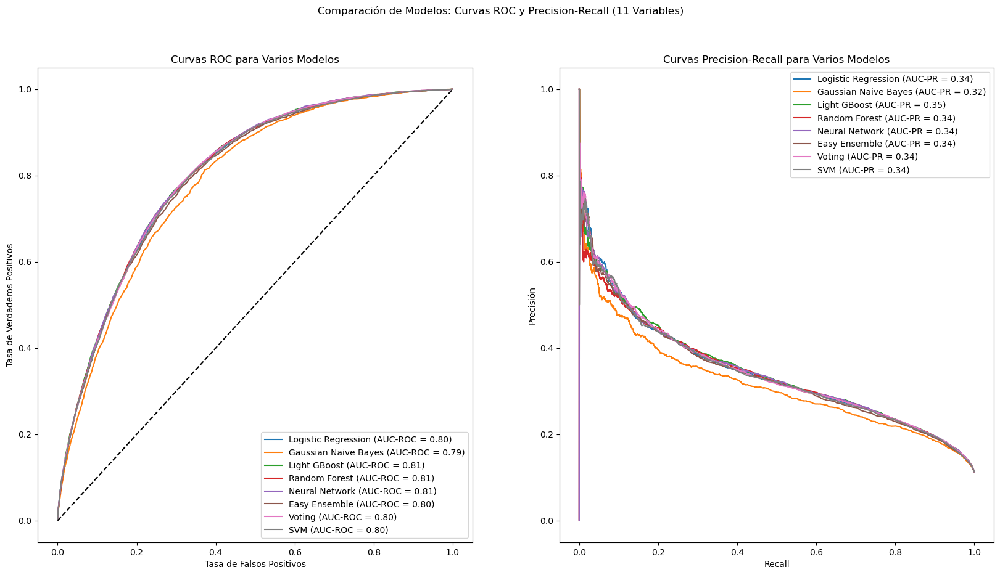

In [152]:
# Graficar curvas de rendimiento para los modelos con 11 variables
graficar_curvas_rendimiento(roc_data_11vars, pr_data_11vars, 
                            'Comparación de Modelos: Curvas ROC y Precision-Recall (11 Variables)')

### EXPLICABILIDAD

#### SHAP values

SHAP (SHapley Additive exPlanations) es una técnica de explicabilidad de modelos de aprendizaje automático que se basa en la teoría de juegos cooperativos de Shapley. Proporciona una forma de interpretar y comprender cómo cada característica contribuye a la predicción de un modelo para una instancia específica.

El funcionamiento de SHAP se basa en el cálculo de los valores de Shapley, que representan la contribución de cada característica a la predicción del modelo. Se calculan considerando todas las posibles permutaciones de las características y evaluando cómo cambia la predicción del modelo cuando se incluye o excluye cada característica. Esto permite asignar un valor de importancia a cada característica para una instancia específica. Además, permite obtener explicaciones tanto a nivel local (para una instancia específica) como a nivel global (para todo el conjunto de datos). Esto brinda una visión completa de cómo el modelo toma decisiones y cuáles son las características más influyentes en general.

Valores SHAP para Logistic Regression:


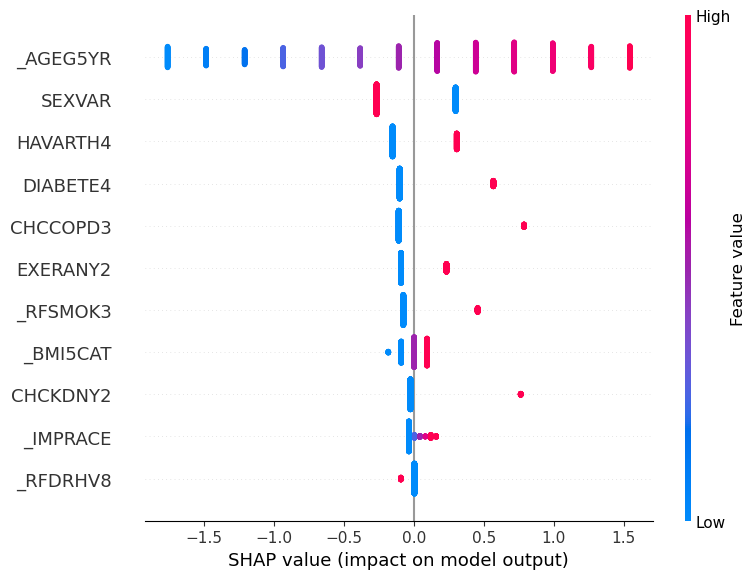

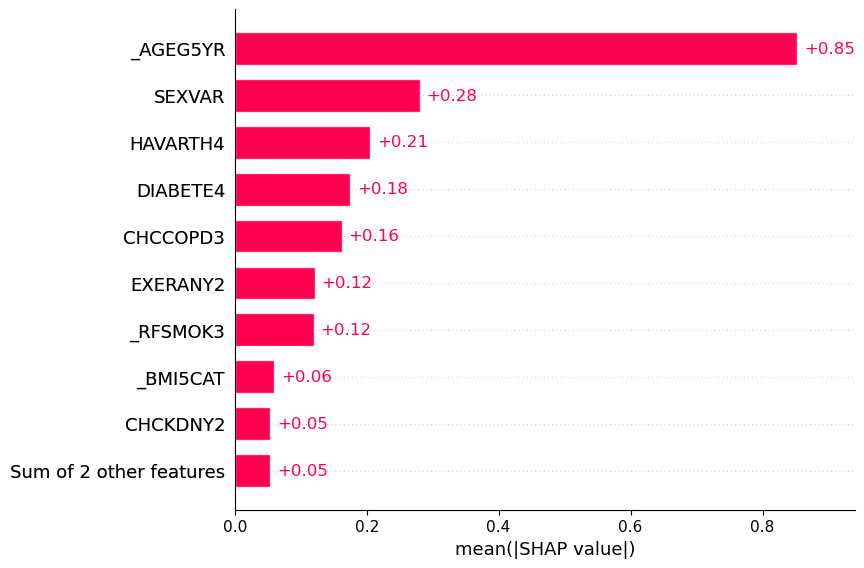

Valores SHAP para Gaussian Naive Bayes:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:10<00:00,  1.31s/it]


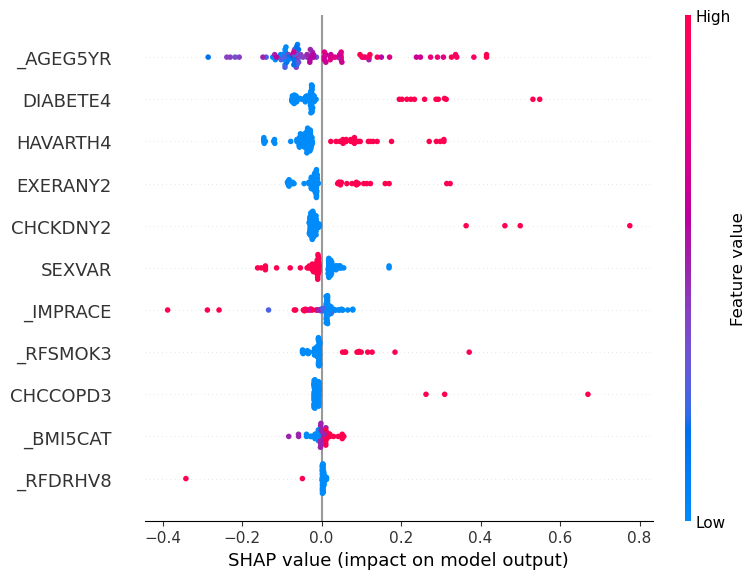

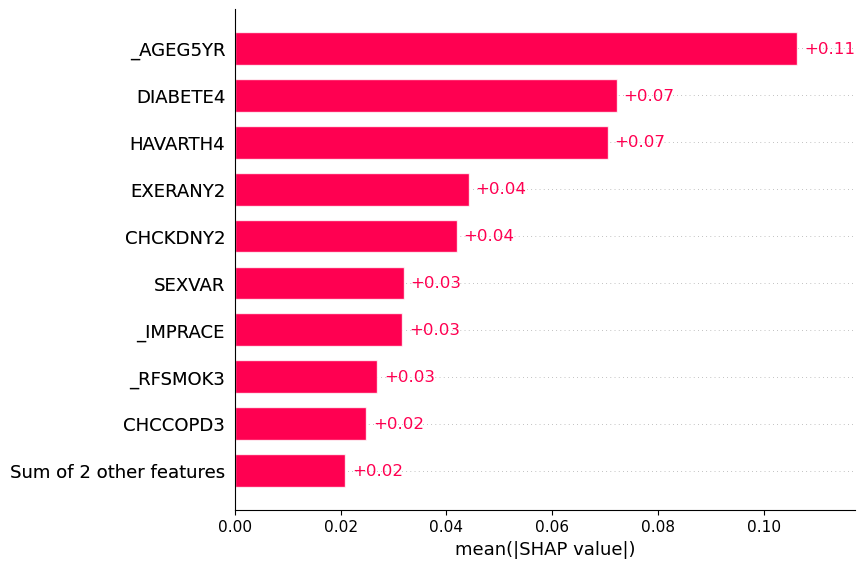

Valores SHAP para Light GBoost:


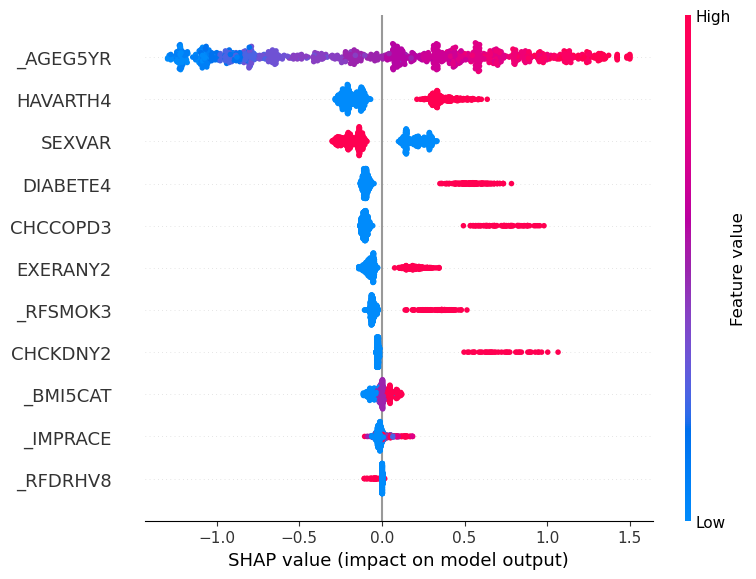

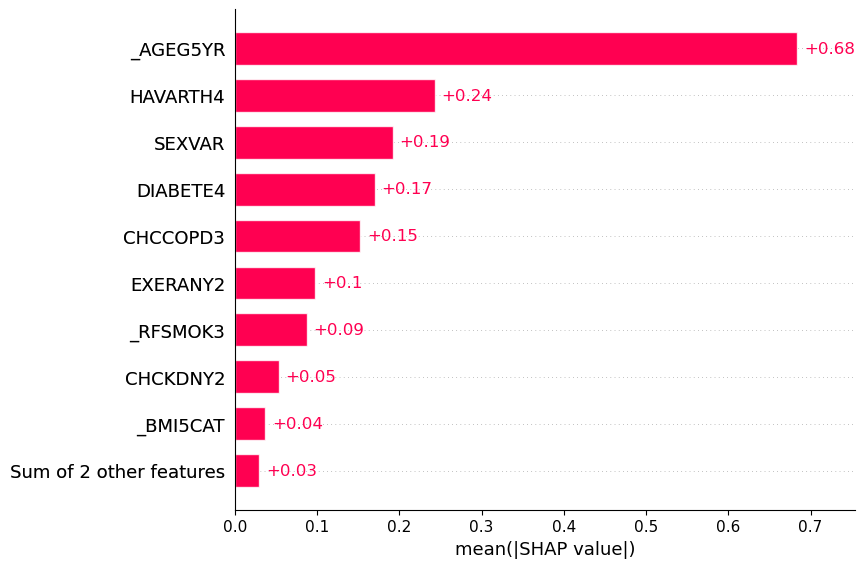

Valores SHAP para Random Forest:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [02:13<00:00,  1.78s/it]


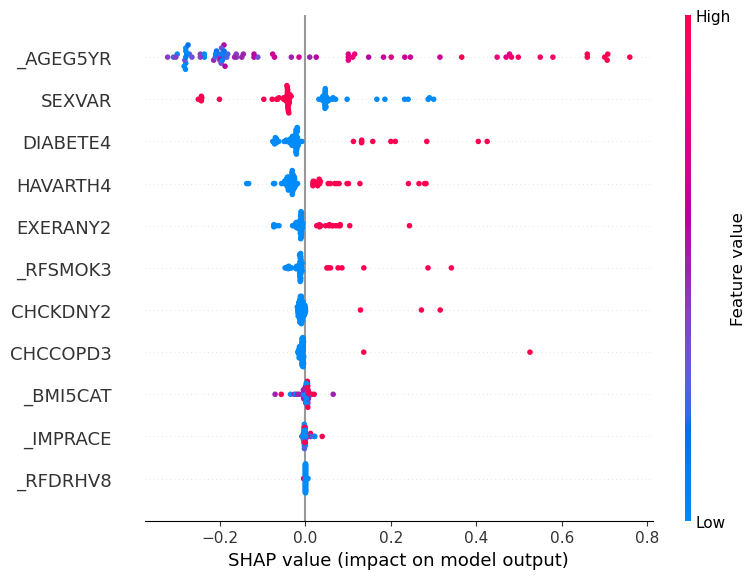

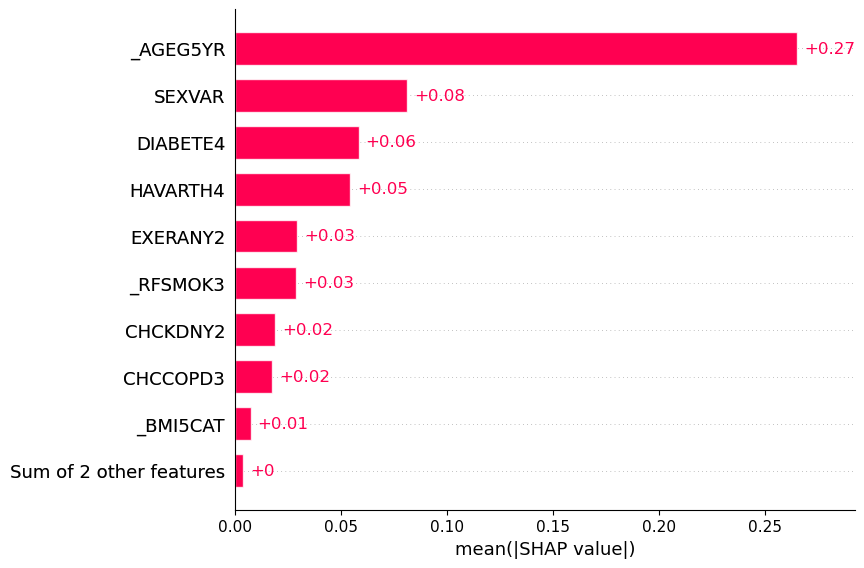

Valores SHAP para Neural Network:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [01:51<00:00,  1.48s/it]


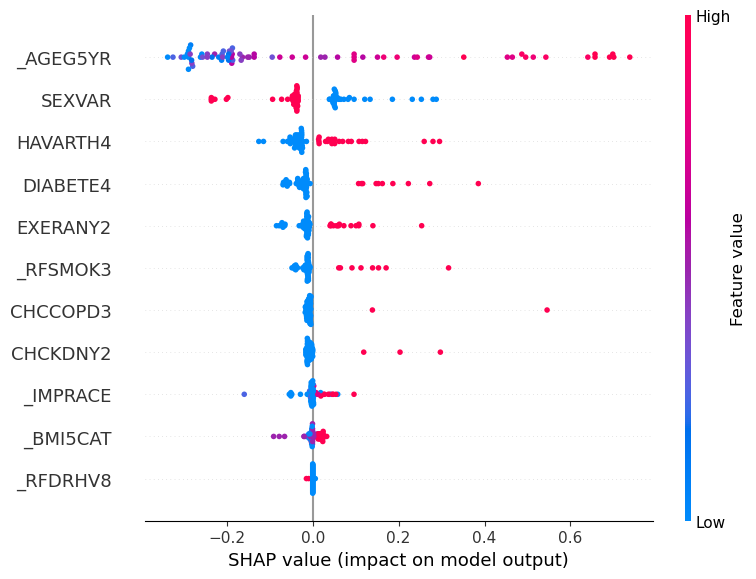

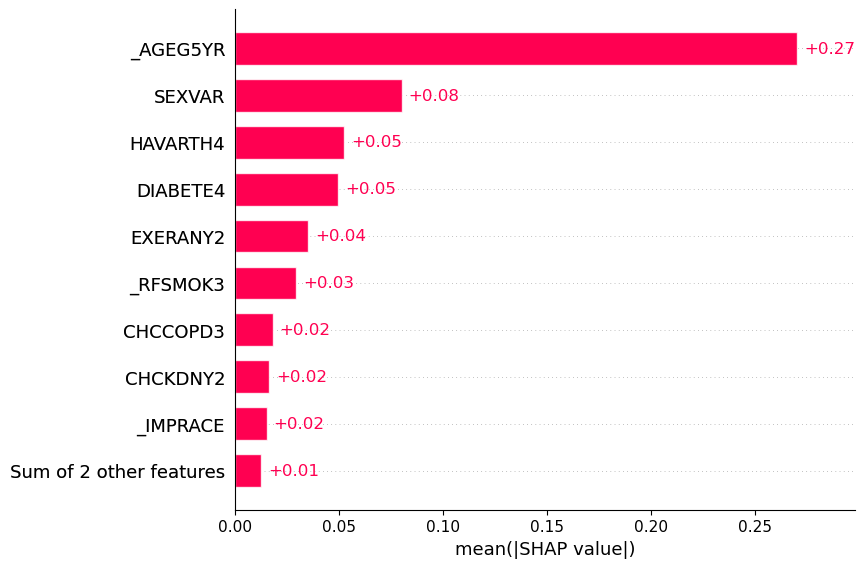

Valores SHAP para Easy Ensemble:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [04:25<00:00,  5.31s/it]


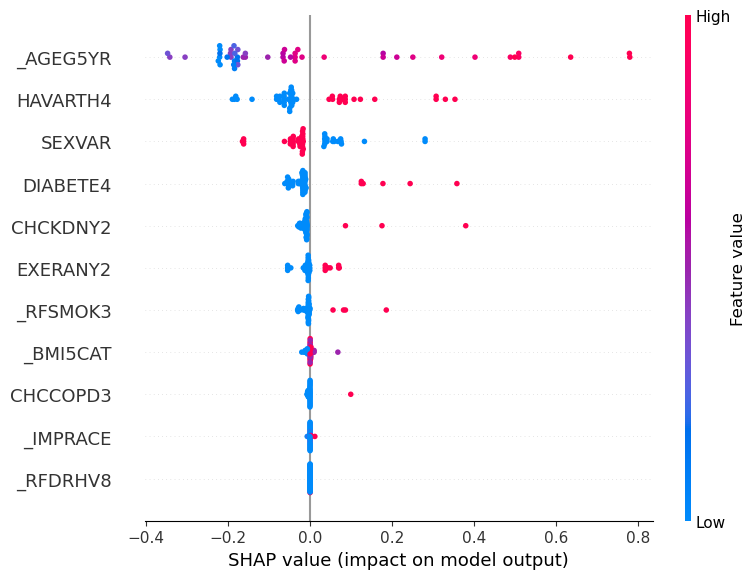

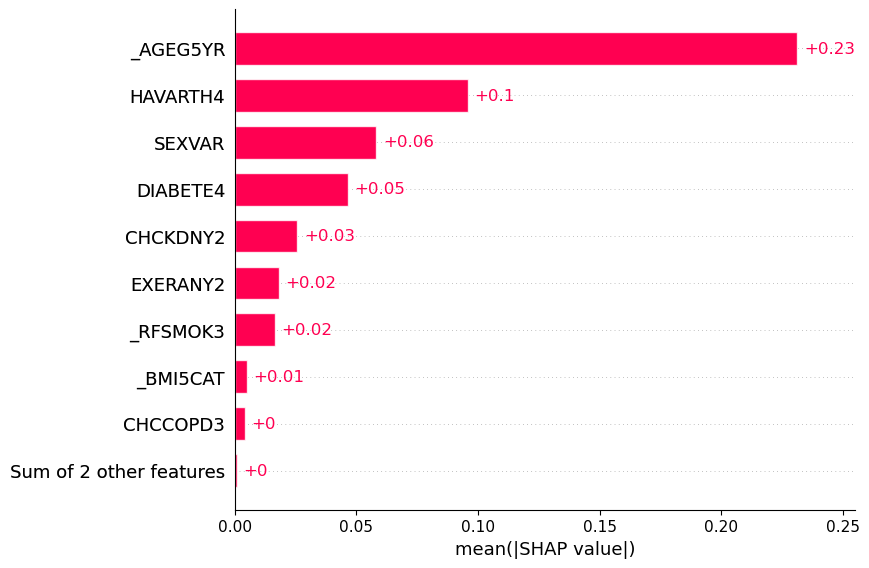

Valores SHAP para Voting:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [05:23<00:00,  6.48s/it]


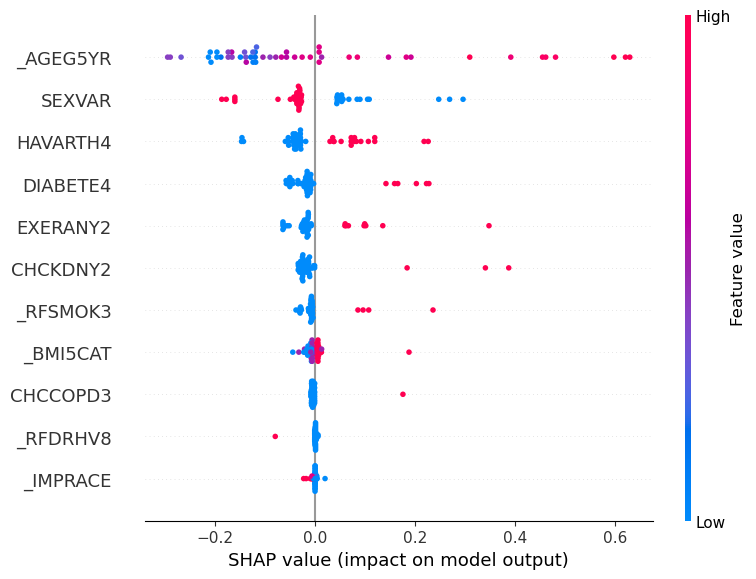

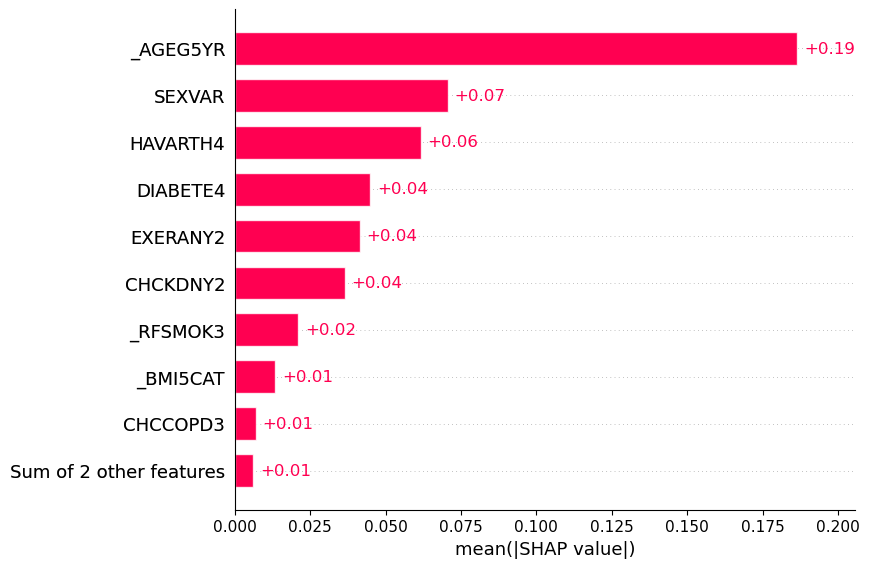

Valores SHAP para SVM:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:07<00:00,  1.28s/it]


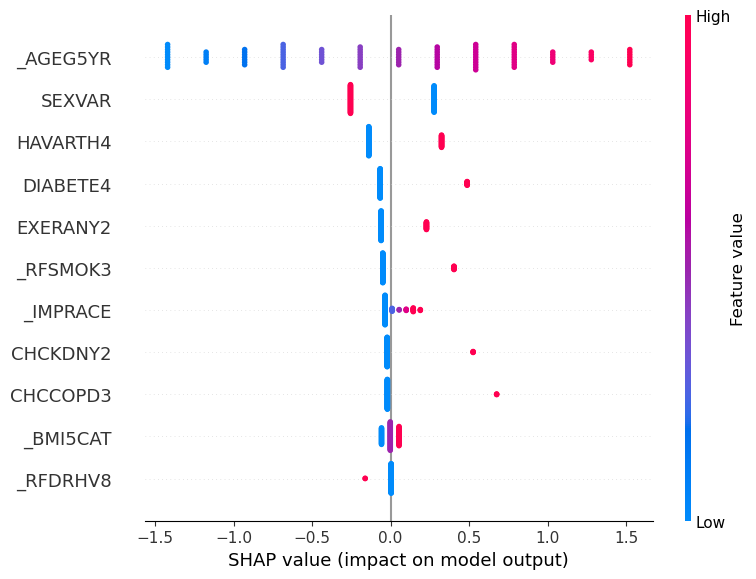

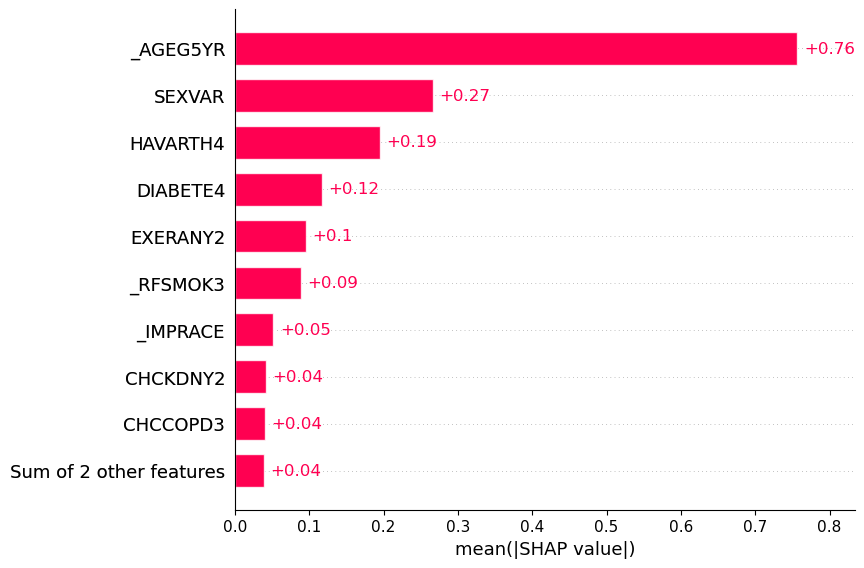

In [153]:


# Diccionario para mapear los tipos de modelo a sus correspondientes objetos explainer de SHAP
explainer_dict = {
    LogisticRegression: shap.LinearExplainer,
    GaussianNB: shap.KernelExplainer,
    LGBMClassifier: shap.TreeExplainer,
    RandomForestClassifier: shap.KernelExplainer,
    MLPClassifier: shap.KernelExplainer,
    EasyEnsembleClassifier: shap.KernelExplainer,
    VotingClassifier: shap.KernelExplainer,
    LinearSVC: shap.KernelExplainer    
    
}

# Diccionario para mapear los nombres de los modelos a sus correspondientes tamaños de muestra
sample_sizes = {
    'Logistic Regression': 1000,
    'Gaussian Naive Bayes': 100,
    'Light GBoost': 1000,
    'Random Forest': 75,
    'Neural Network': 75,
    'Easy Ensemble': 50,
    'SVM': 100,
    'Voting': 50
}

# Iterar sobre los modelos optimizados para graficar la importancia de las variables creadas por SHAP
for nombre, modelo in modelos_optimizados:
    print(f"Valores SHAP para {nombre}:")
    
    # Obtener el tamaño de muestra específico para el modelo actual
    sample_size = sample_sizes.get(nombre, 50)  # Valor predeterminado de 50 si no se encuentra el nombre del modelo
    
    # Tomar una muestra aleatoria de los datos de prueba para el cálculo de SHAP
    X_test_sample = shap.utils.sample(X_test, nsamples=sample_size, random_state=42)
    
    explainer_class = explainer_dict.get(type(modelo))
    if explainer_class is None:
        print(f"No se puede calcular los valores SHAP para {nombre}")
        continue
    
    if explainer_class == shap.KernelExplainer:
        if isinstance(modelo, LinearSVC):
            explainer = explainer_class(modelo.decision_function, X_test_sample)
        else:
            explainer = explainer_class(modelo.predict, X_test_sample)
    else:
        explainer = explainer_class(modelo, X_test_sample)
    
    shap_values = explainer(X_test_sample)
    
    # Graficar el Summary Plot de SHAP
    shap.summary_plot(shap_values, X_test_sample)
    plt.show()
    
    # Graficar el Bar Plot de SHAP
    shap.plots.bar(shap_values)
    plt.show()


#### Importancia y permutación de características

Ahora se hace uso de dos enfoques distintos para evaluar la importancia de las características en los modelos de aprendizaje automático: la importancia de características intrínseca (feature_importance_) y la importancia de características por permutación (permutation_importance). Ambos métodos ofrecen perspectivas distintas sobre cómo las diferentes características influyen en las predicciones del modelo, y pueden complementarse con los valores SHAP para una comprensión más completa.

Modelos basados en árboles, como los árboles de decisión, Random Forest y modelos de boosting como LightGBM, calculan internamente la importancia de las características como parte de su proceso de entrenamiento. La importancia se mide generalmente en términos de la cantidad de veces que una característica se utiliza para dividir los datos en todos los árboles, ponderada por la reducción del error que cada división aporta al modelo. Las características que más contribuyen a mejorar el rendimiento del modelo reciben una mayor importancia. Una limitación es que puede estar sesgado hacia características con más categorías o niveles.

La importancia por permutación es un método modelo-agnóstico que mide el aumento en el error de predicción del modelo cuando los valores de una característica son aleatoriamente permutados. Esto rompe la relación entre la característica y el objetivo, revelando cuánto dependen las predicciones del modelo de la característica. Una limitación es su mayor costo computacional respecto a feature_importance_, especialmente con grandes conjuntos de datos, como este caso.

Tanto la importancia de características intrínseca como la importancia por permutación ofrecen una visión global de la importancia de las características, pero no explican cómo o por qué una característica influye en una predicción específica. Aquí es donde los valores SHAP aportan un valor adicional. Mientras que feature_importance_ y permutation_importance ofrecen una visión global, los valores SHAP proporcionan explicaciones a nivel de instancia, mostrando cómo cada característica contribuye a cada predicción individual.

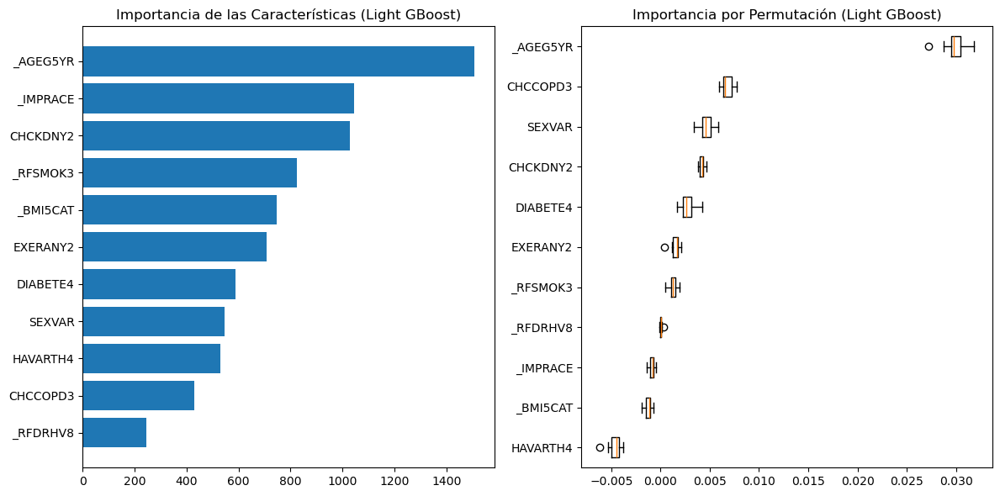

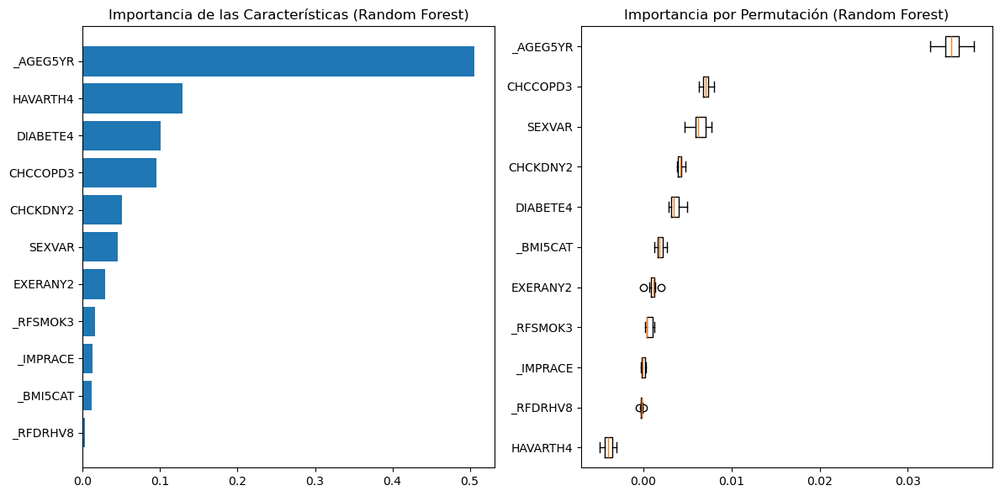

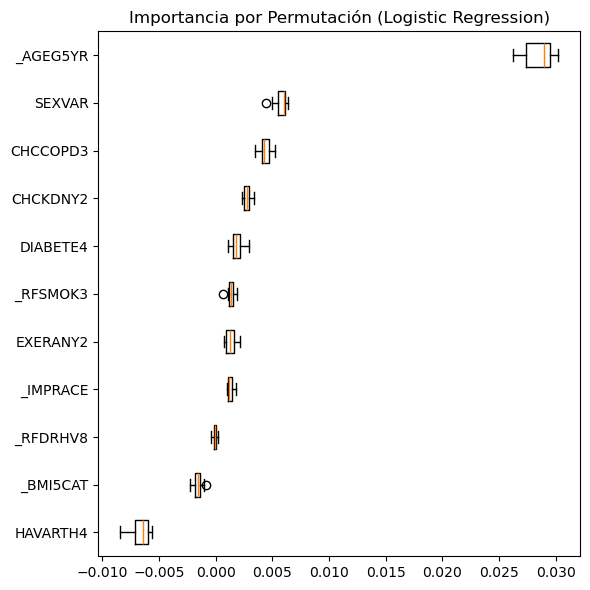

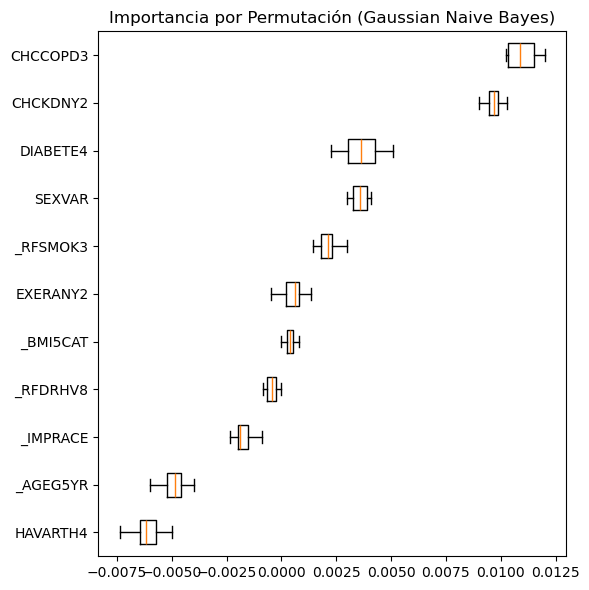

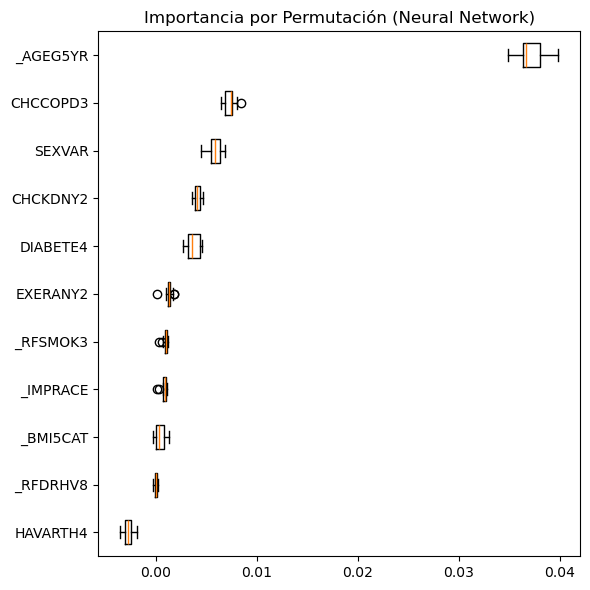

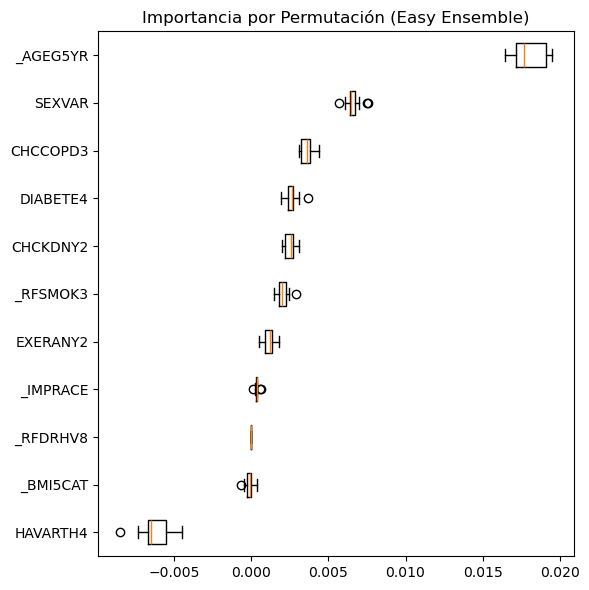

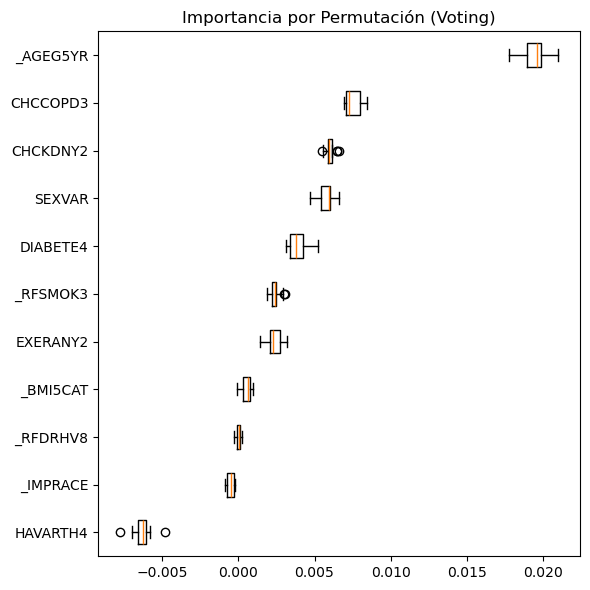

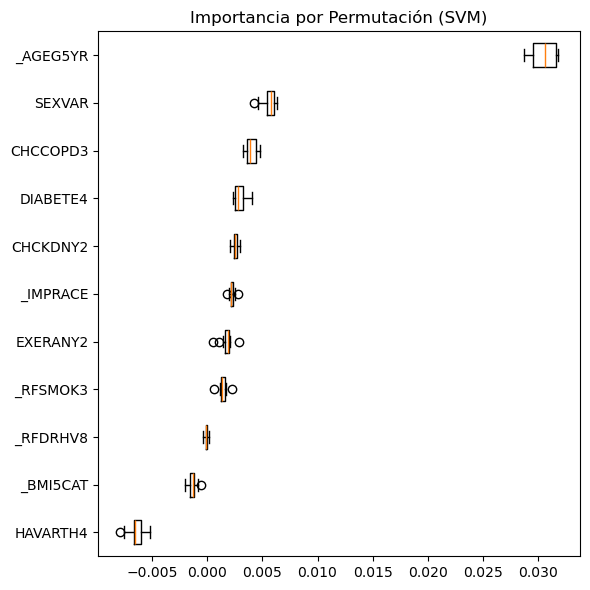

In [154]:
# Graficar importancia y permutación para los modelos con 11 variables
graficar_importancia_permutacion(modelos_optimizados, X_test, y_test, X)
graficar_permutacion_importancia(modelos_optimizados, X_test, y_test, X)

## MODELOS CON TODAS(29) LAS VARIABLES

Ahora se vuelve a repetir todo el proceso, pero introduciendo todas las variables (29 en total) en el proceso de entrenamiento y evaluación de los modelos, se busca determinar si el rendimiento de los modelos mejora en comparación con el uso de solo 11 variables, y si se descubren nuevas variables relevantes como factores de riesgo en el desarrollo de enfermedades cardiovasculares. Se espera determinar si las variables adicionales aportan información valiosa o simplemente introducen ruido en el modelo.

Desde un punto de vista teórico, la inclusión de más variables en el modelo podría mejorar su capacidad para capturar relaciones complejas y patrones subyacentes en los datos. Si las variables adicionales están relacionadas con el desarrollo de enfermedades cardiovasculares, su incorporación podría proporcionar al modelo una visión más completa de los factores de riesgo y mejorar su capacidad predictiva. Sobre todo si las nuevas variables capturan aspectos que no están representados por las 11 variables originales.

Sin embargo, es importante tener en cuenta que la inclusión de más variables también puede introducir ruido y complejidad innecesaria en el modelo. Si las variables adicionales no están fuertemente relacionadas con la variable objetivo o son redundantes con las variables existentes, pueden confundir al modelo y disminuir su rendimiento.

Para evaluar el impacto de incluir todas las variables, es necesario comparar las métricas de rendimiento de los modelos entrenados con 29 variables con las de los modelos entrenados con 11 variables. Si se observa una mejora significativa en métricas como la precisión, el recall, el F1-score y el AUC-ROC, esto sugeriría que las variables adicionales aportan información valiosa y mejoran la capacidad predictiva del modelo. Por otro lado, si las métricas de rendimiento son similares o incluso peores con 29 variables, esto indicaría que las variables adicionales no contribuyen significativamente al modelo y podrían estar introduciendo ruido.

Además de evaluar las métricas de rendimiento, es relevante examinar la importancia de las características (feature importance) de los modelos entrenados con 29 variables. Si se hallan nuevas variables que desempeñan una gran relevancia en el modelo, esto indicaría que estas variables son factores de riesgo considerables en la aparición de patologías cardiovasculares. Estas nuevas variables podrían proporcionar información adicional que no estaba capturada por las 11 variables originales.

Sin embargo, si las nuevas variables tienen una importancia baja en el modelo o si las 11 variables originales siguen siendo las más importantes, esto indicaría que las variables adicionales no aportan información significativa y que el conjunto original de 11 variables captura los factores de riesgo más fundamentales.

Las 29 variables se especifican al inicio del notebook, añadiendo fuentes para detalles más específicos respecto a cada variable.

In [155]:

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/RandomUnderSampler/modelos_iniciales_all"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los modelos base
modelos_base = [
    ('Logistic Regression', LogisticRegression(class_weight='balanced', max_iter=200, random_state=42)),    
    ('Gaussian Naive Bayes', GaussianNB()),    
    ('Light GBoost', LGBMClassifier(class_weight='balanced', verbose=-1)),   
    ('Random Forest', RandomForestClassifier(class_weight='balanced', n_estimators=500, min_samples_split=2,
                                             max_depth=5, min_samples_leaf=1, random_state=42)),    
    ('Neural Network', MLPClassifier(early_stopping=True, random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))    
]

# Definir los modelos de ensamble
modelos_ensamble = [   
    ('Voting', VotingClassifier(estimators=modelos_base, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(class_weight='balanced', C=100.0, random_state=42, dual=False))
]

# Combinar todos los modelos
modelos = modelos_base + modelos_ensamble

# Crear el objeto de la técnica de muestreo RandomUnderSampler
tecnica_muestreo = RandomUnderSampler(random_state=42)

# Entrenar y evaluar modelos con todas las variables
resultados_allvars, X, X_train, y_train, X_val, y_val, X_test, y_test = entrenar_evaluar_modelos_base(
    df, modelos, carpeta_modelos, tecnica_muestreo)


Dimensiones del conjunto de entrenamiento:
X_train: (56106, 29), y_train: (56106,)

Dimensiones del conjunto de validación:
X_val: (53095, 29), y_val: (53095,)

Dimensiones del conjunto de prueba:
X_test: (53096, 29), y_test: (53096,)

Tiempo de muestreo: 0.00 minutos

Modelo Logistic Regression cargado desde archivo.
Entrenamiento Logistic Regression:
Tiempo de ejecución: 0.01 minutos
Accuracy: 0.7479413966420704
F1-score: 0.7522164207870484
Precision: 0.739671272526791
Recall: 0.7651944533561473
AUC-ROC: 0.8238596687262895
Matthews Corr Coef: 0.49617827402066916

MATRIZ DE CONFUSIÓN:
[[20498  7555]
 [ 6587 21466]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.76      0.73      0.74     28053
           1       0.74      0.77      0.75     28053

    accuracy                           0.75     56106
   macro avg       0.75      0.75      0.75     56106
weighted avg       0.75      0.75      0.75     56106



Test Logistic Regres

### Tabla de métricas de rendimiento modelos base

In [156]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_allvars_inicial = pd.DataFrame.from_dict(resultados_allvars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_allvars_inicial

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.736232,0.400240,0.269508,0.777279,0.828626,0.343438,0.009897
Gaussian Naive Bayes,0.777234,0.383702,0.279363,0.612442,0.795600,0.301271,0.000633
Light GBoost,0.719583,0.392162,0.259860,0.798902,0.830389,0.338150,0.005298
Random Forest,0.728944,0.389859,0.261607,0.764804,0.819181,0.329388,0.117278
Neural Network,0.699657,0.383309,0.249710,0.824351,0.828498,0.332772,0.119644
Easy Ensemble,0.735366,0.395474,0.266729,0.764471,0.823687,0.335771,0.299219
Voting,0.762619,0.409759,0.285165,0.727711,0.827442,0.345893,0.351835
SVM,0.733652,0.398520,0.267714,0.779275,0.828575,0.341839,0.003649


### BÚSQUEDA DE HIPERPARÁMETROS

In [157]:

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/RandomUnderSampler/modelos_entrenados_all"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)


In [158]:

# Definir los espacios de búsqueda de hiperparámetros para cada modelo
param_dist_lr = {
    'class_weight': ['balanced', None],
    'solver': ['newton-cg', 'newton-cholesky', 'sag', 'saga'],
    'penalty': ['l2'],
    'C': loguniform(1e-4, 1e1)
}

param_dist_gnb = {
    'var_smoothing': loguniform(1e-9, 1e-1)
}

param_dist_lgbm = {
    'class_weight': ['balanced', None],
    'n_estimators': randint(50, 251),
    'max_depth': randint(3, 31),
    'subsample': uniform(0.7, 0.3),
    'colsample_bytree': uniform(0.7, 0.3),
    'learning_rate': loguniform(1e-5, 1e-1),
    'num_leaves': randint(10, 101),
    'verbose': [-1]
}

param_dist_rf = {
    'class_weight': ['balanced_subsample', 'balanced'],
    'n_estimators': randint(50, 251),
    'criterion': ['gini', 'entropy'],
    'max_depth': randint(3, 16),
    'min_samples_leaf': randint(3, 16),
    'min_samples_split': randint(3, 16),
    'max_features': [None, 'sqrt', 'log2']
}

param_dist_ann = {
    'hidden_layer_sizes': [(100,), (50,50), (100,100), (50, 50, 50),
                           (100, 100, 100), (50, 50, 50, 50), (100, 100, 100, 100),
                           (50, 50, 50, 50, 50), (100, 100, 100, 100, 100)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': loguniform(1e-5, 1e3),
    'batch_size': [64, 128, 256, 512],
    'learning_rate': ['constant', 'adaptive'],
    'learning_rate_init': loguniform(1e-5, 1e-1),
    'early_stopping': [True],
    'max_iter': [100]
}

param_dist_eec = {
    'n_estimators': randint(2, 20),
    'sampling_strategy': ['auto']
}

param_dist_svm = {
    'dual': ['auto'],
    'tol': loguniform(1e-5, 1e-3),
    'class_weight': [None, 'balanced'],
    'penalty': ['l2'],
    'loss': ['hinge', 'squared_hinge'],
    'C': loguniform(1e-4, 1e4),
    'max_iter': randint(1000, 2001)
}

# Definir los modelos con búsqueda de hiperparámetros
modelos = [
    ('Logistic Regression', RandomizedSearchCV(LogisticRegression(), param_dist_lr,
                                               cv=30, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Gaussian Naive Bayes', RandomizedSearchCV(GaussianNB(), param_dist_gnb, cv=30,
                                                n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('Light GBoost', RandomizedSearchCV(LGBMClassifier(), param_dist_lgbm, cv=5, n_jobs=6,
                                        scoring='f1_weighted', n_iter=50)),
    ('Random Forest', RandomizedSearchCV(RandomForestClassifier(), param_dist_rf,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Neural Network', RandomizedSearchCV(MLPClassifier(), param_dist_ann, cv=5, n_jobs=6,
                                          scoring='f1_weighted', error_score=0, n_iter=50)),
    ('Easy Ensemble', RandomizedSearchCV(EasyEnsembleClassifier(), param_dist_eec,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('SVM', RandomizedSearchCV(LinearSVC(), param_dist_svm, cv=5, n_jobs=6,
                               scoring='f1_weighted', n_iter=50))
]

# Crear un diccionario para almacenar los mejores hiperparámetros de cada modelo
best_params_all = {}

# Entrenar y evaluar cada modelo con búsqueda de hiperparámetros
for nombre, modelo in modelos:
    nombre_archivo = f"{carpeta_modelos}/{nombre}_optimizado.pkl"
    
    # Hash del conjunto de datos actual
    hash_actual = hash_de_datos(X_train)
    
    # Cargar o entrenar modelo
    modelo_cargado, tiempo_ejecucion, mejores_parametros_cargados = cargar_modelo(nombre_archivo, hash_actual)
    
    if modelo_cargado is not None:
        print(f"Modelo {nombre} cargado desde archivo.")
        modelo_best_all = modelo_cargado
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros_cargados}")
        # Agregar los mejores hiperparámetros cargados al diccionario
        best_params_all[nombre] = mejores_parametros_cargados
    else:
        print(f"Entrenando nuevo modelo {nombre}.")
        inicio = time.time()  # Tiempo de inicio
        modelo.fit(X_train, y_train)
        
        mejores_parametros = modelo.best_params_
        
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros}")
        
        # Agregar los mejores hiperparámetros al diccionario
        best_params_all[nombre] = modelo.best_params_
        
        # Entrenar el modelo con los mejores hiperparámetros en el conjunto de entrenamiento completo
        modelo_best_all = modelo.best_estimator_
        modelo_best_all.fit(X_train, y_train)
        
        fin = time.time()  # Tiempo de fin
        tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos
        
        # Guardar el modelo entrenado junto con el tiempo de ejecución y los mejores parámetros
        guardar_modelo(modelo_best_all, nombre_archivo, hash_actual, tiempo_ejecucion, mejores_parametros)

    # Métricas de predicción entrenamiento
    y_pred_train = modelo_best_all.predict(X_train)

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_all, "predict_proba"):
        y_scores = modelo_best_all.predict_proba(X_train)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_all.decision_function(X_train)  # Puntuaciones de decisión
    
    print(f"Entrenamiento {nombre}:")
    print(f"Tiempo de búsqueda de hiperparámetros de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_train, y_pred_train)}")
    print(f"F1-score: {f1_score(y_train, y_pred_train)}")
    print(f"Precision: {precision_score(y_train, y_pred_train)}")
    print(f"Recall: {recall_score(y_train, y_pred_train)}")
    print(f"AUC-ROC: {roc_auc_score(y_train, y_scores)}") # Usar y_scores en lugar de y_pred
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_train, y_pred_train)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_train, y_pred_train))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_train, y_pred_train))
    print("\n")

    # Métricas predicción validación
    inicio = time.time()  # Tiempo de inicio
    y_pred_val = modelo_best_all.predict(X_val)
    fin = time.time()  # Tiempo de fin
    tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_all, "predict_proba"):
        y_scores = modelo_best_all.predict_proba(X_val)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_all.decision_function(X_val)  # Puntuaciones de decisión
    
    print(f"Validación {nombre}:")
    print(f"Tiempo de ejecución de predicción de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_val, y_pred_val)}")
    print(f"F1-score: {f1_score(y_val, y_pred_val)}")
    print(f"Precision: {precision_score(y_val, y_pred_val)}")
    print(f"Recall: {recall_score(y_val, y_pred_val)}")
    print(f"AUC-ROC: {roc_auc_score(y_val, y_scores)}") # Usar y_scores en lugar de y_pred
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_val, y_pred_val)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_val, y_pred_val))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_val, y_pred_val))
    print("\n")


Modelo Logistic Regression cargado desde archivo.
Mejores hiperparámetros para Logistic Regression: {'C': 0.2947688166432759, 'class_weight': 'balanced', 'penalty': 'l2', 'solver': 'newton-cg'}
Entrenamiento Logistic Regression:
Tiempo de búsqueda de hiperparámetros de Logistic Regression: 4.01 minutos
Accuracy: 0.7478166328021958
F1-score: 0.7521068030905619
Precision: 0.7395259095920618
Recall: 0.7651231597333619
AUC-ROC: 0.8238531373531544
Matthews Corr Coef: 0.4959304327117419

MATRIZ DE CONFUSIÓN:
[[20493  7560]
 [ 6589 21464]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.76      0.73      0.74     28053
           1       0.74      0.77      0.75     28053

    accuracy                           0.75     56106
   macro avg       0.75      0.75      0.75     56106
weighted avg       0.75      0.75      0.75     56106



Validación Logistic Regression:
Tiempo de ejecución de predicción de Logistic Regression: 0.00 minutos
Ac

### Entrenar modelos con los mejores parámetros

In [159]:

# Combinar los conjuntos de entrenamiento y validación para todas las variables
X_train_val_allvars = pd.concat([X_train, X_val], ignore_index=True)
y_train_val_allvars = pd.concat([y_train, y_val], ignore_index=True)

# Definir los modelos con los mejores hiperparámetros
modelos_entrenados_all = [
    ('Logistic Regression', LogisticRegression(random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),    
    ('Light GBoost', LGBMClassifier(verbosity=-1, random_state=42)),
    ('Random Forest', RandomForestClassifier(random_state=42)),   
    ('Neural Network', MLPClassifier(random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble_all = [   
    ('Voting', VotingClassifier(estimators=modelos_entrenados_all, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(random_state=42))    
]

# Combinar todos los modelos
modelos_optimizados_all = modelos_entrenados_all + modelos_ensamble_all

# Crear el objeto de la técnica de muestreo RandomUnderSampler
tecnica_muestreo = RandomUnderSampler(random_state=42)

# Entrenar y evaluar modelos con todas las variables
resultados_optimizados_allvars, roc_data, pr_data, modelos_optimizados_all = entrenar_evaluar_modelos(
    X_train_val_allvars, y_train_val_allvars, X_test, y_test, modelos_optimizados_all, best_params_all, carpeta_modelos, 
    tecnica_muestreo
)


Tiempo de muestreo: 0.00 minutos

Modelo Logistic Regression cargado desde archivo.
Test Logistic Regression:
Mejores hiperparámetros para Logistic Regression: {'C': 0.2947688166432759, 'class_weight': 'balanced', 'penalty': 'l2', 'solver': 'newton-cg'}
Tiempo de ejecución de entrenamiento: 0.01 minutos
Tiempo de ejecución de predicción: 0.00 minutos
Accuracy: 0.7363266536085581
F1-score: 0.3998628257887517
Precision: 0.2693462693462694
Recall: 0.7757817697937458
AUC-ROC: 0.8285755182354686
Matthews Corr Coef: 0.34274456433488804

MATRIZ DE CONFUSIÓN:
[[34432 12652]
 [ 1348  4664]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.96      0.73      0.83     47084
           1       0.27      0.78      0.40      6012

    accuracy                           0.74     53096
   macro avg       0.62      0.75      0.62     53096
weighted avg       0.88      0.74      0.78     53096



Modelo Gaussian Naive Bayes cargado desde archivo.
Tes

### Tabla de métricas de rendimiento con los mejores parámetros

In [160]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_allvars_opt = pd.DataFrame.from_dict(resultados_optimizados_allvars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_allvars_opt

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.736327,0.399863,0.269346,0.775782,0.828576,0.342745,0.005248
Gaussian Naive Bayes,0.783976,0.388462,0.285860,0.605955,0.799093,0.306165,0.000933
Light GBoost,0.723708,0.395201,0.262717,0.797239,0.831048,0.341324,0.008247
Random Forest,0.718924,0.392889,0.260043,0.803227,0.829441,0.339795,0.077175
Neural Network,0.673667,0.371869,0.237751,0.853127,0.831527,0.325090,0.544572
Easy Ensemble,0.736684,0.395886,0.267410,0.761976,0.824001,0.335813,0.651587
Voting,0.757628,0.409598,0.282800,0.742515,0.828748,0.348074,0.713817
SVM,0.721467,0.392923,0.260832,0.796075,0.828102,0.338499,0.044735


### Visualizar comparación de rendimiento de curvas ROC-AUC Y PR-AUC

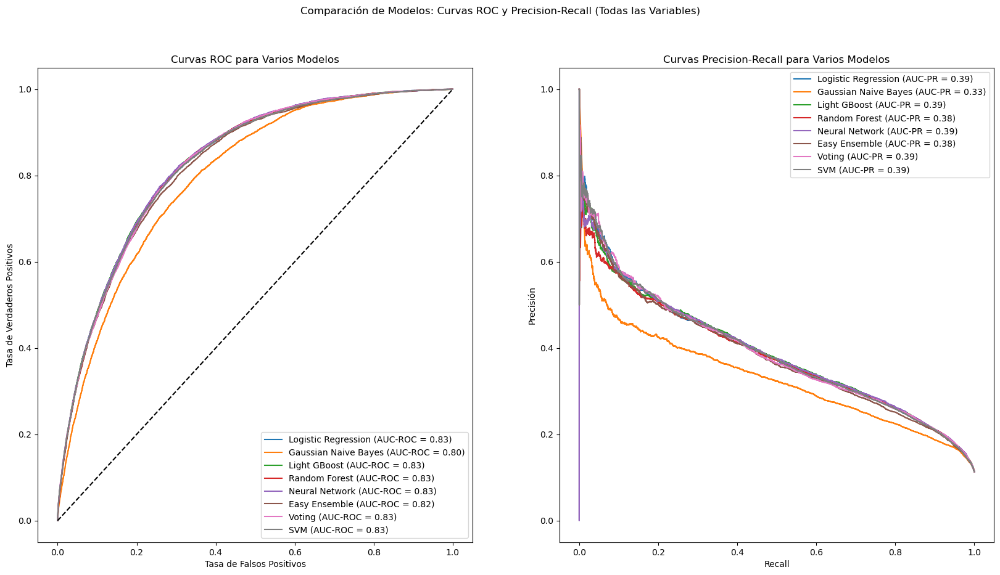

In [161]:
# Graficar curvas de rendimiento para los modelos con todas las variables
graficar_curvas_rendimiento(roc_data, pr_data, 
                            'Comparación de Modelos: Curvas ROC y Precision-Recall (Todas las Variables)')

### EXPLICABILIDAD

#### SHAP values

Valores SHAP para Logistic Regression:


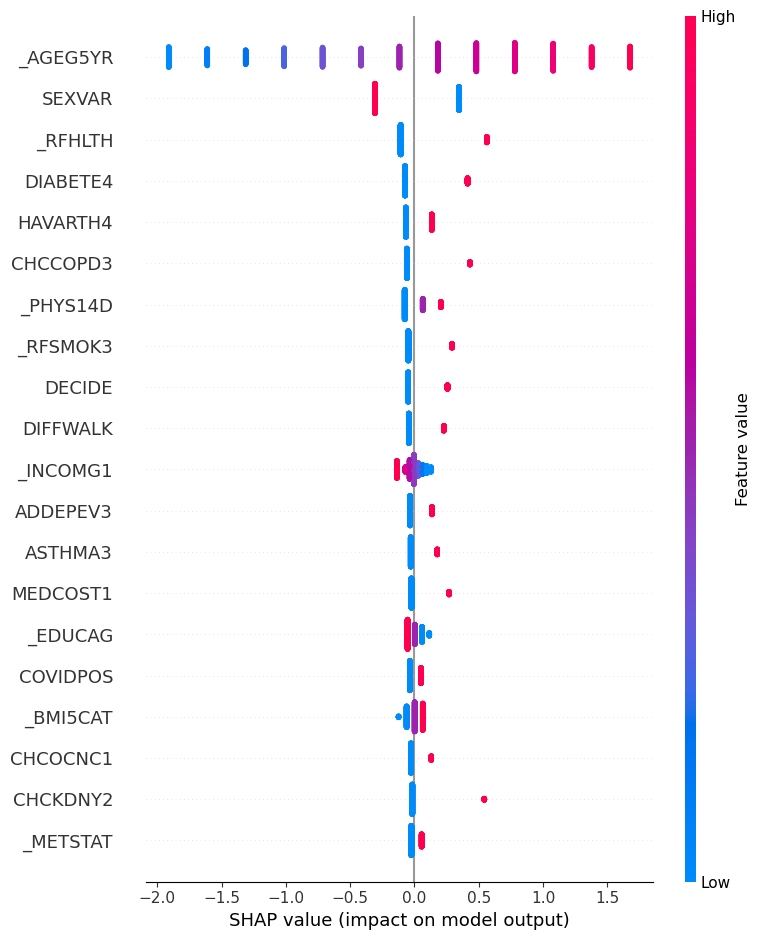

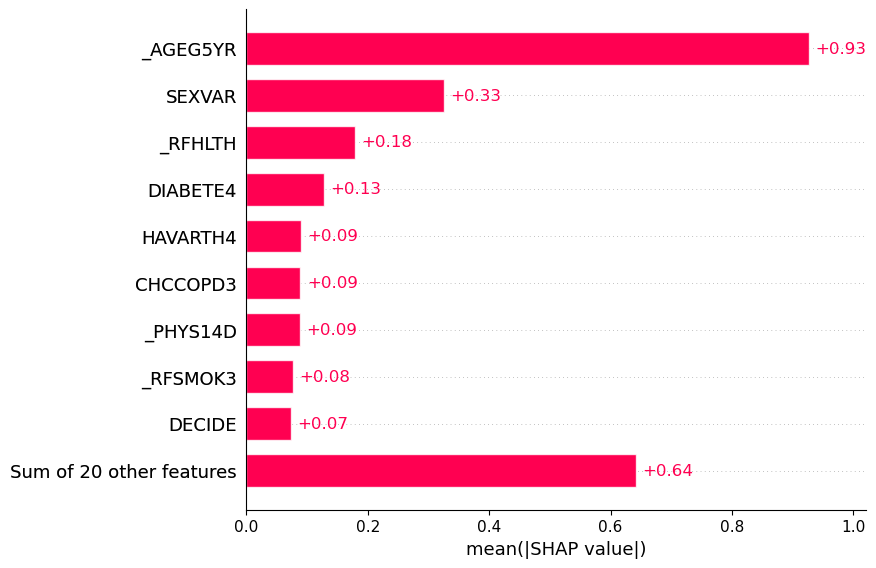

Valores SHAP para Gaussian Naive Bayes:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:34<00:00,  1.55s/it]


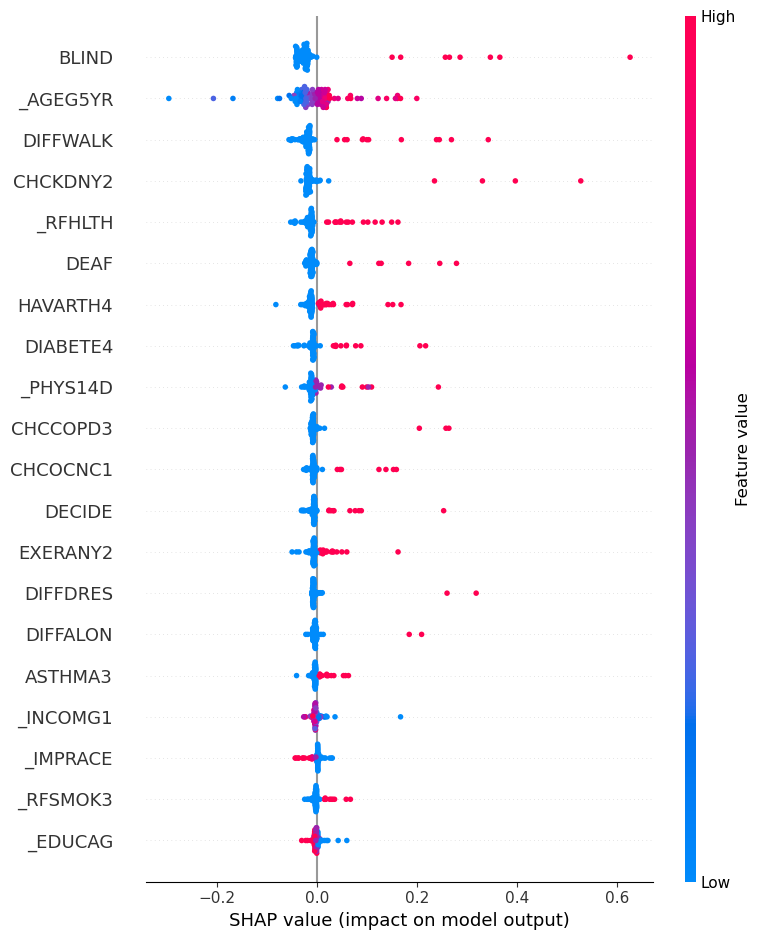

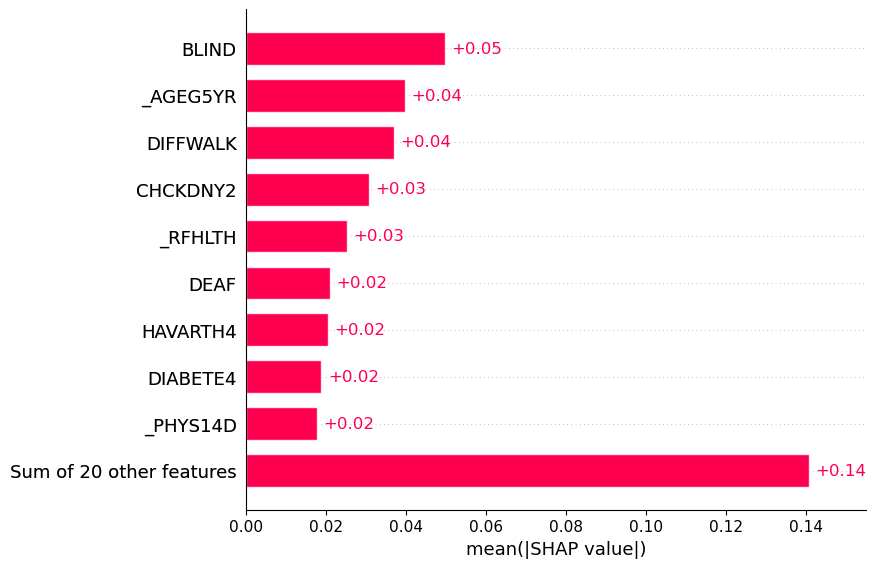

Valores SHAP para Light GBoost:


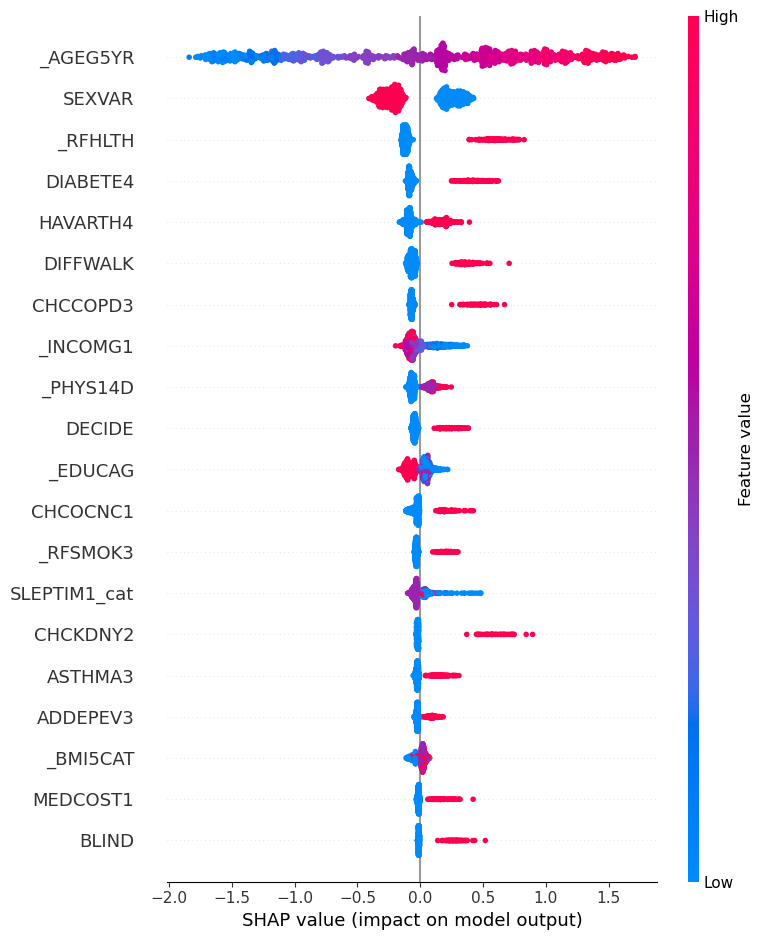

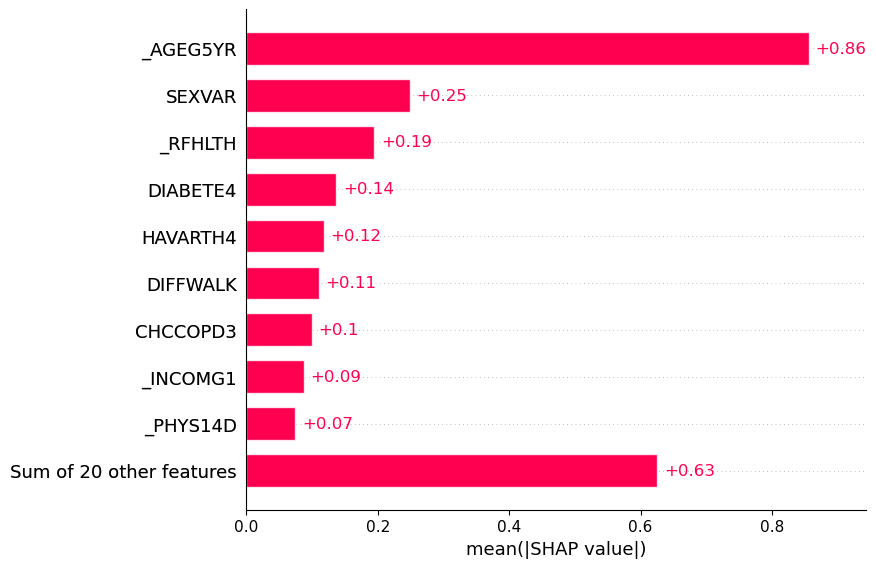

Valores SHAP para Random Forest:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [03:10<00:00,  2.54s/it]


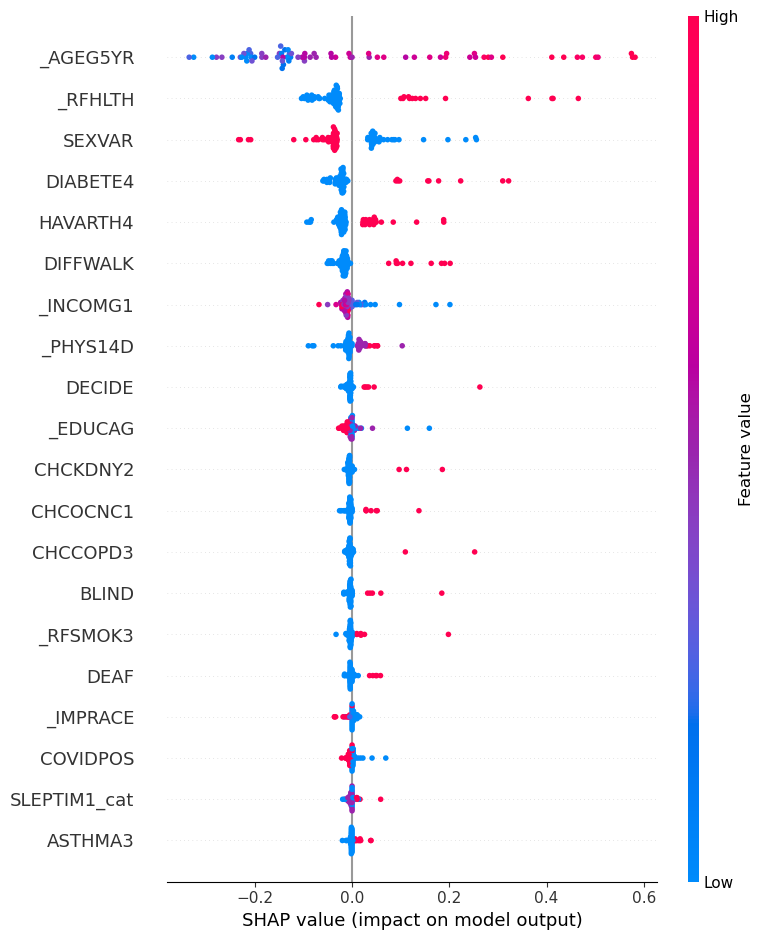

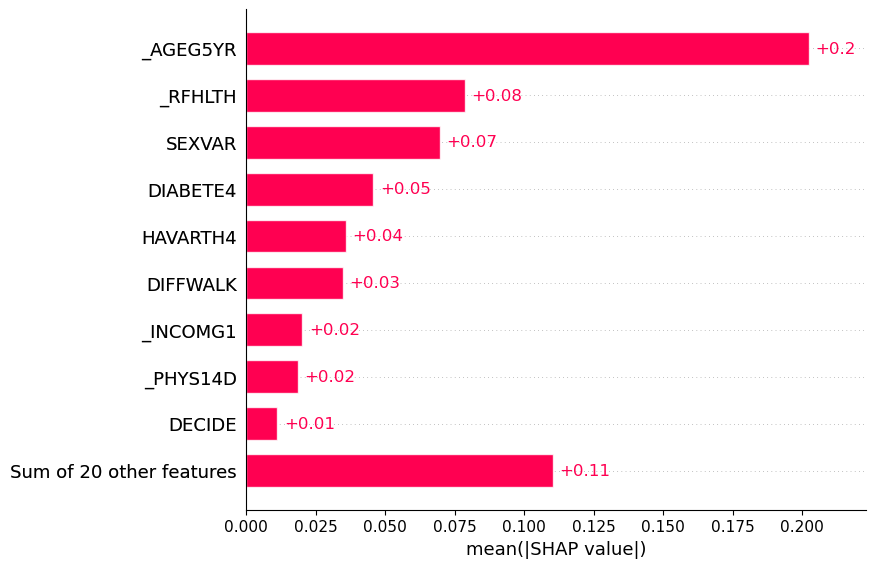

Valores SHAP para Neural Network:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [02:13<00:00,  1.78s/it]


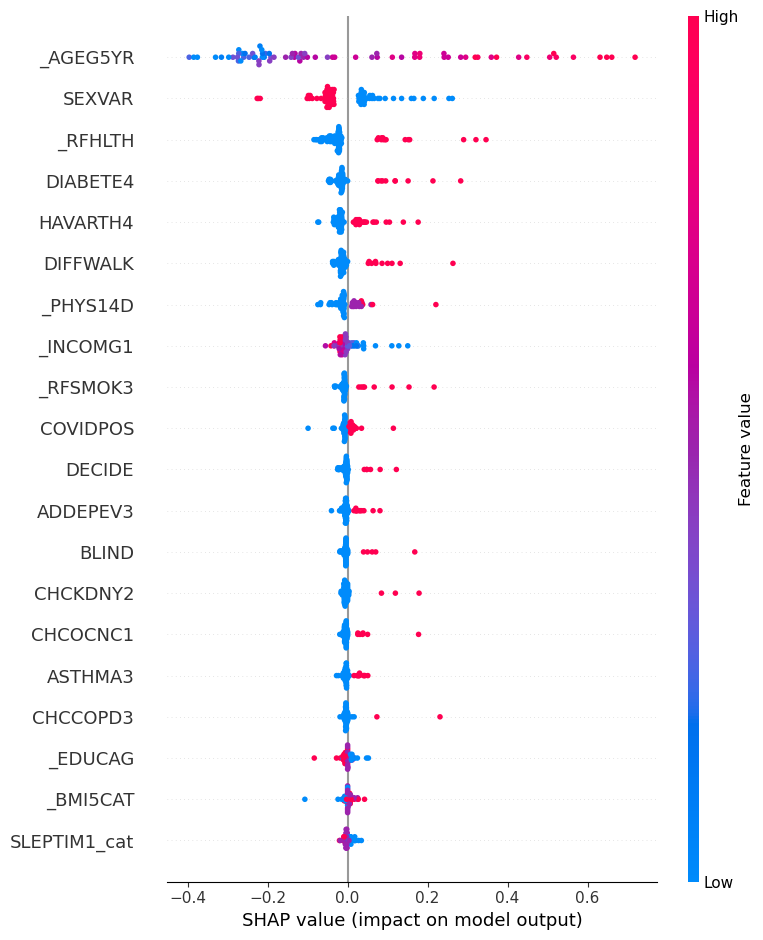

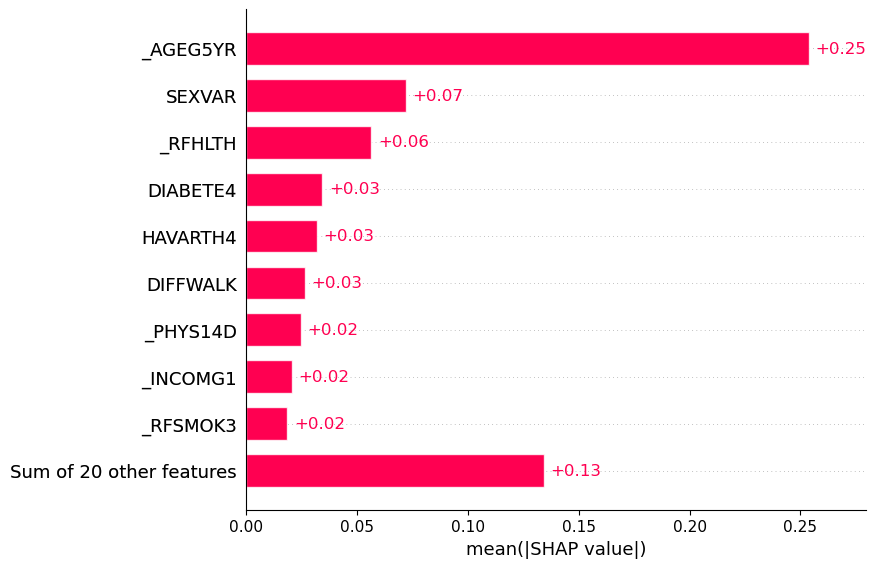

Valores SHAP para Easy Ensemble:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [09:26<00:00, 11.32s/it]


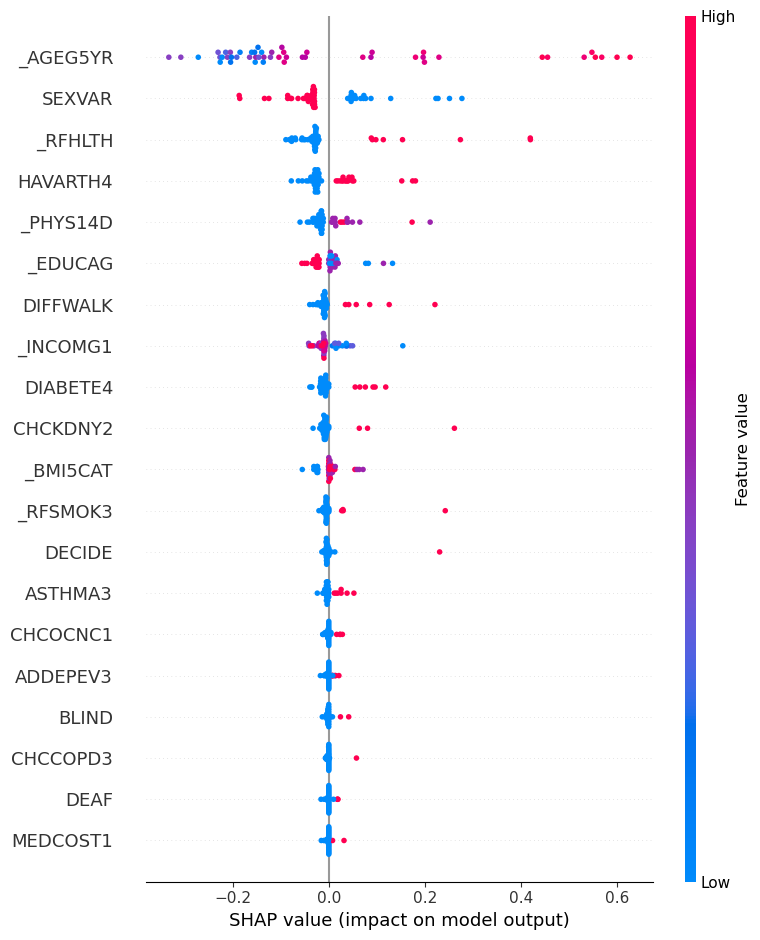

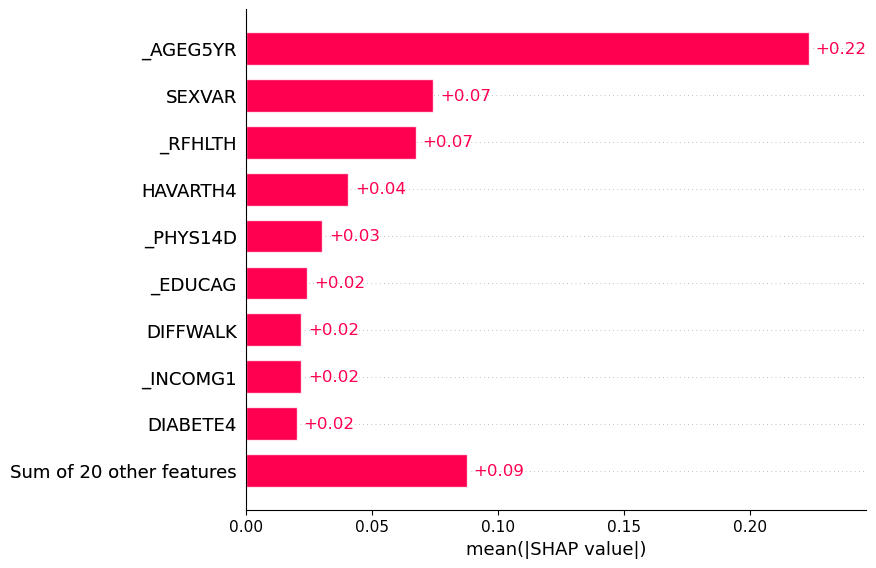

Valores SHAP para Voting:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [10:44<00:00, 12.88s/it]


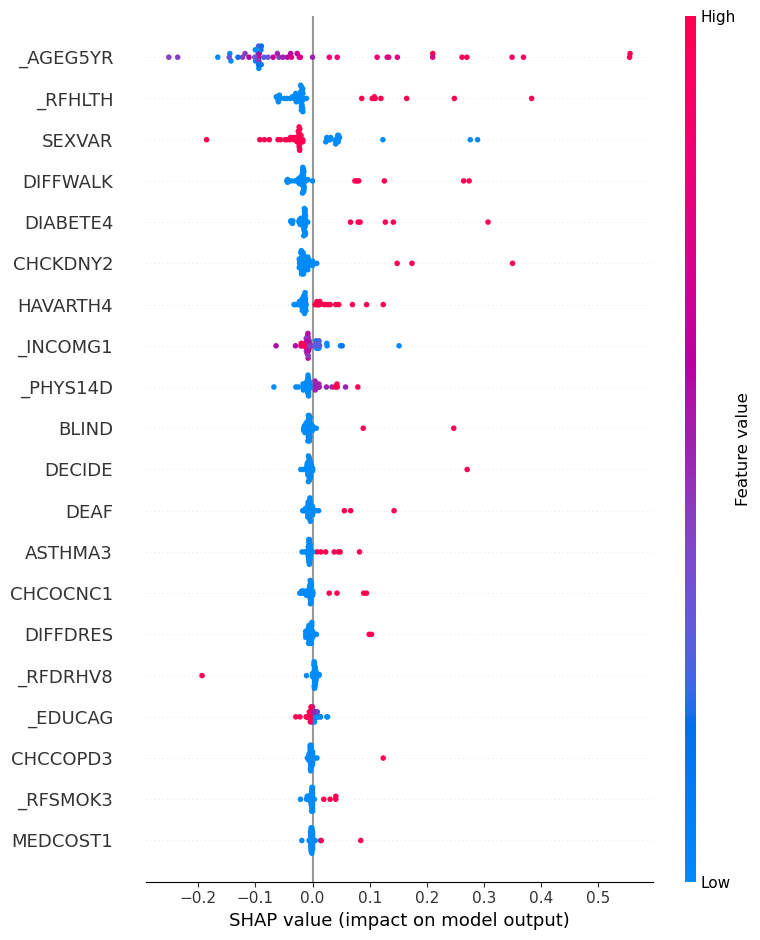

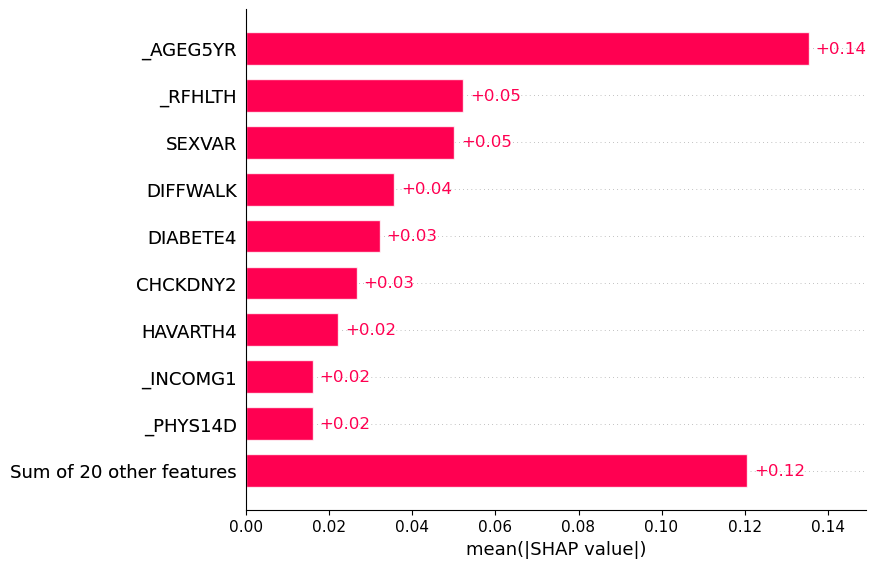

Valores SHAP para SVM:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:27<00:00,  1.47s/it]


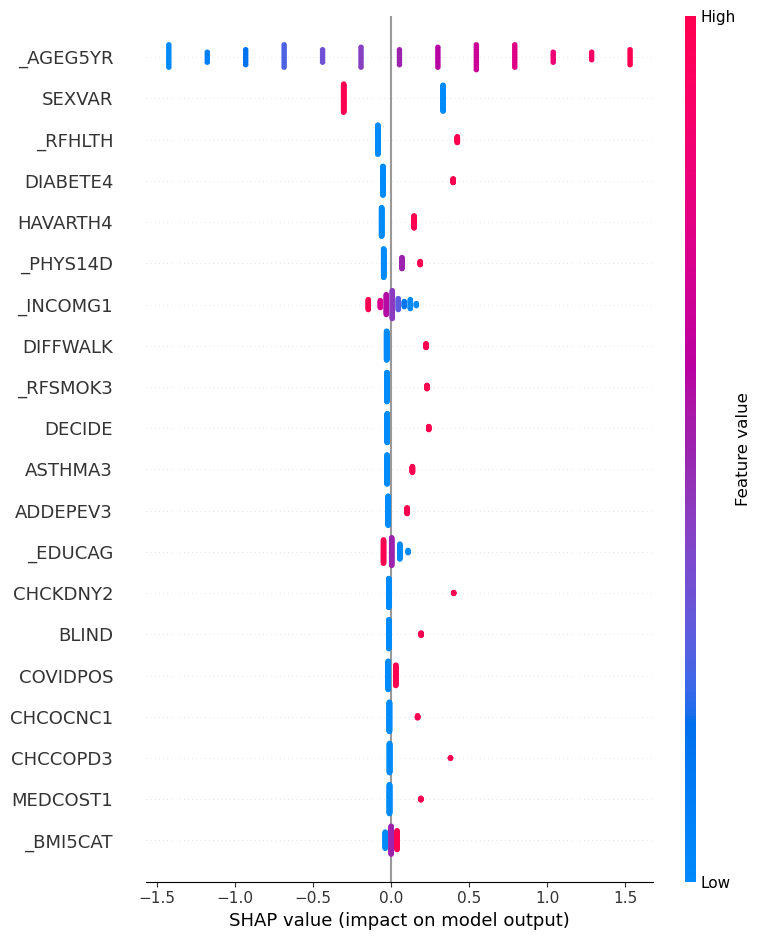

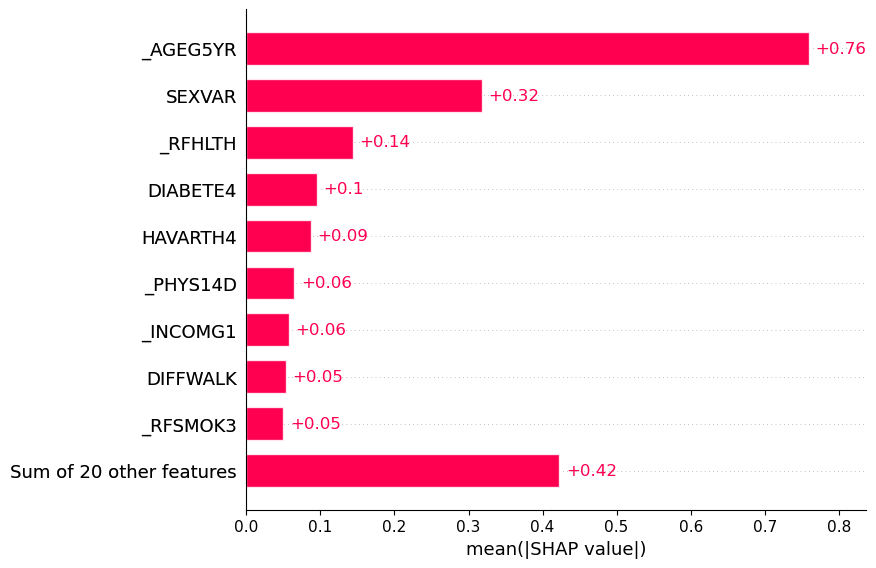

In [162]:

# Iterar sobre los modelos optimizados para graficar la importancia de las variables creadas por SHAP
for nombre, modelo in modelos_optimizados_all:
    print(f"Valores SHAP para {nombre}:")
    
    # Obtener el tamaño de muestra específico para el modelo actual
    sample_size = sample_sizes.get(nombre, 50)  # Valor predeterminado de 50 si no se encuentra el nombre del modelo
    
    # Tomar una muestra aleatoria de los datos de prueba para el cálculo de SHAP
    X_test_sample = shap.utils.sample(X_test, nsamples=sample_size, random_state=42)
    
    explainer_class = explainer_dict.get(type(modelo))
    if explainer_class is None:
        print(f"No se puede calcular los valores SHAP para {nombre}")
        continue
    
    if explainer_class == shap.KernelExplainer:
        if isinstance(modelo, LinearSVC):
            explainer = explainer_class(modelo.decision_function, X_test_sample)
        else:
            explainer = explainer_class(modelo.predict, X_test_sample)
    else:
        explainer = explainer_class(modelo, X_test_sample)
    
    shap_values = explainer(X_test_sample)
    
    # Graficar el Summary Plot de SHAP
    shap.summary_plot(shap_values, X_test_sample)
    plt.show()
    
    # Graficar el Bar Plot de SHAP
    shap.plots.bar(shap_values)
    plt.show()


#### Importancia y permutación de características

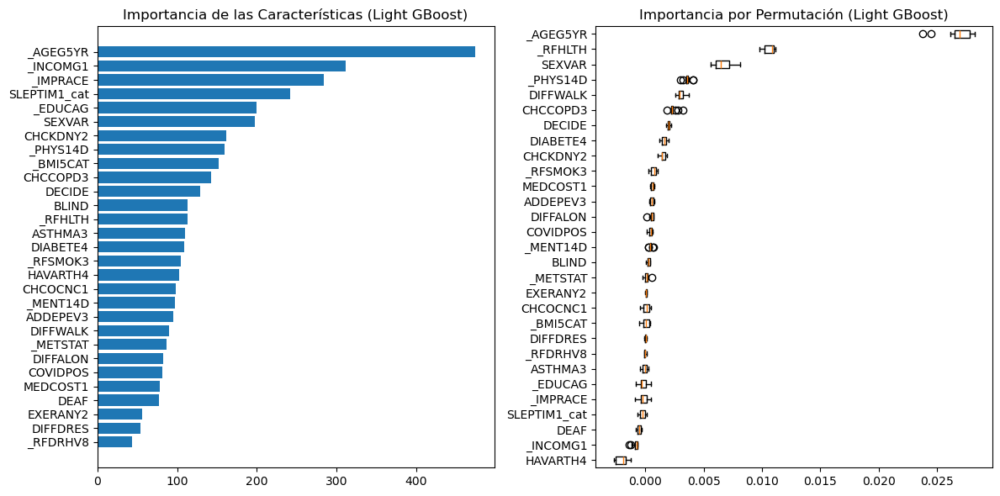

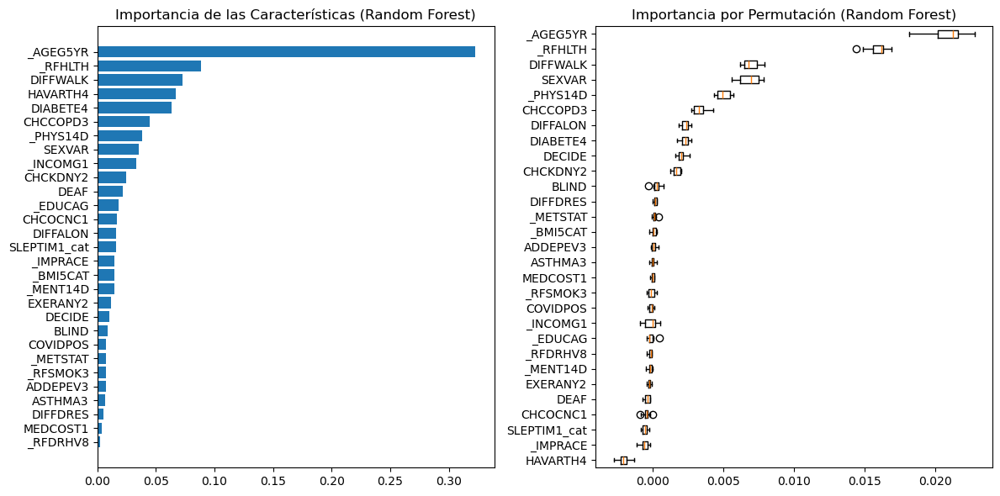

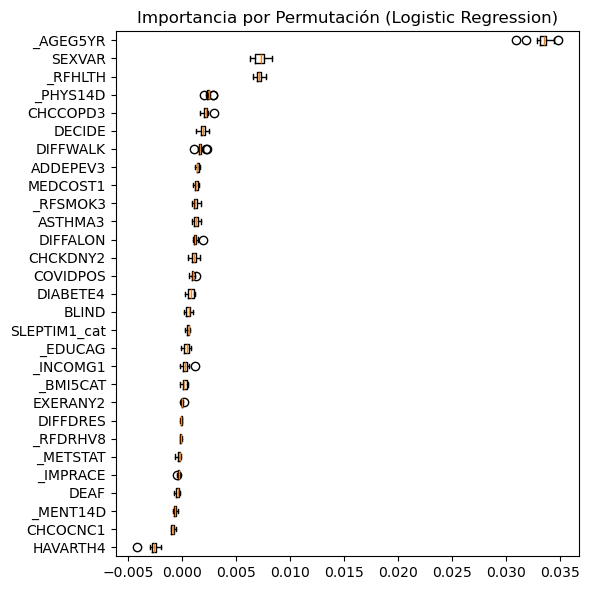

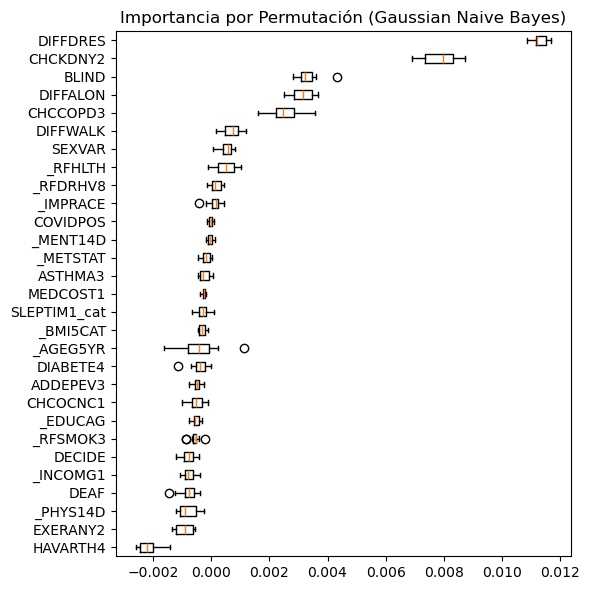

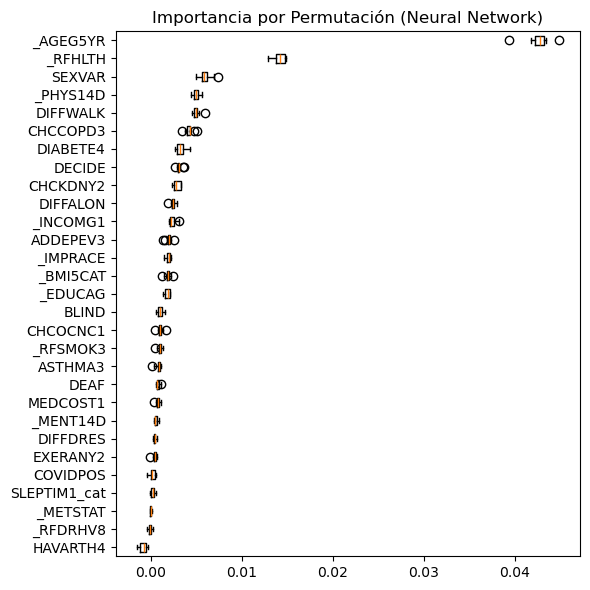

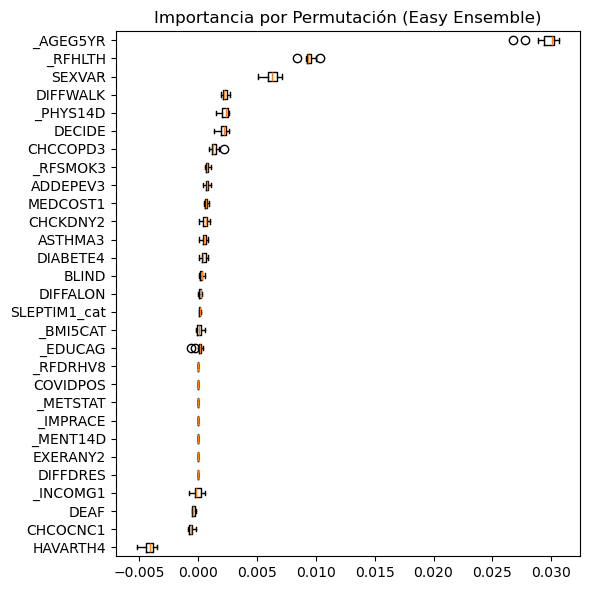

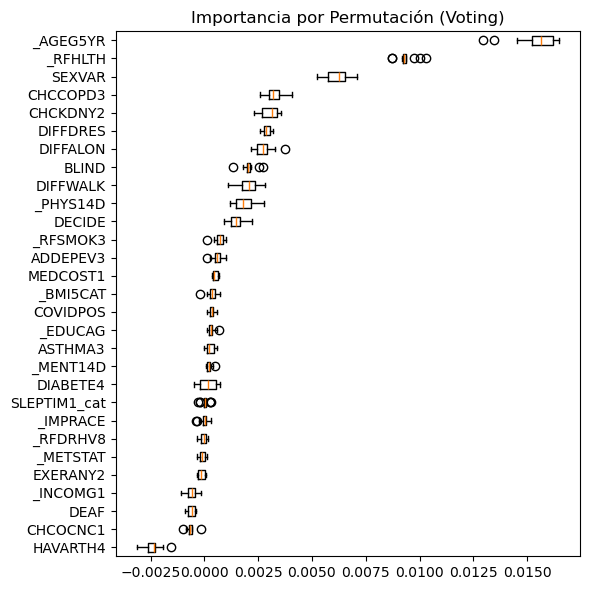

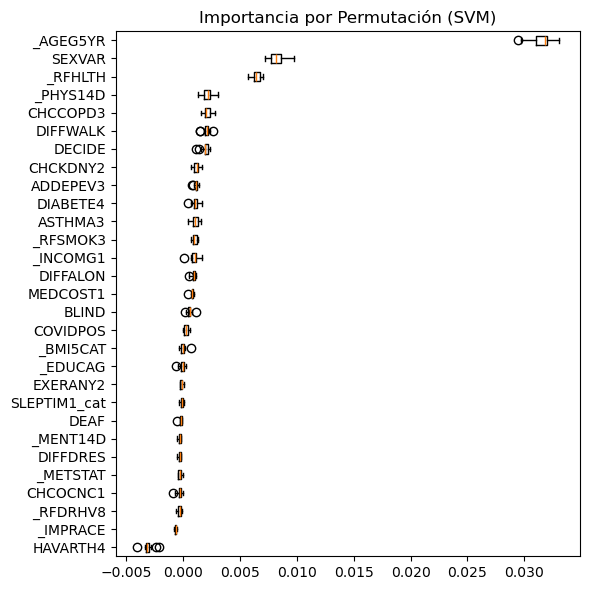

In [163]:
# Graficar importancia y permutación para los modelos con todas las variables
graficar_importancia_permutacion(modelos_optimizados_all, X_test, y_test, X)
graficar_permutacion_importancia(modelos_optimizados_all, X_test, y_test, X)

# ENTRENAMIENTO CON SUBMUESTREO NearMiss()

NearMiss es una técnica de submuestreo (undersampling) utilizada para abordar el problema de los conjuntos de datos desequilibrados, donde una clase (la clase mayoritaria) tiene significativamente más muestras que la otra clase (la clase minoritaria). El objetivo principal de NearMiss es reducir el número de muestras en la clase mayoritaria para equilibrar la distribución de clases y mejorar el rendimiento de los modelos de aprendizaje automático.

Esta técnica selecciona muestras de la clase mayoritaria que están más cerca de las muestras de la clase minoritaria en el espacio de características. Esto se logra utilizando diferentes heurísticas para determinar la cercanía entre las muestras. Una de las variantes más comunes es NearMiss-1, que selecciona las muestras de la clase mayoritaria que tienen una distancia promedio mínima a las tres muestras más cercanas de la clase minoritaria. Al seleccionar las muestras más cercanas a la clase minoritaria, NearMiss reduce la superposición entre las clases y mejora la capacidad de los modelos para distinguir entre ellas.

## MODELO CON 11 VARIABLES

In [164]:
# Seleccionar las columnas deseadas para crear el nuevo dataset
columnas_seleccionadas = ['SEXVAR', 'EXERANY2', 'CHCCOPD3', 'CHCKDNY2', 
                          'HAVARTH4', 'DIABETE4', '_IMPRACE', '_AGEG5YR',
                          '_BMI5CAT', '_RFSMOK3', '_RFDRHV8', 'CARDIO']

# Dataset base con 11 variables
df_11vars = df.loc[:, columnas_seleccionadas]

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/NearMiss/modelos_iniciales_11vars"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los modelos base
modelos_base = [
    ('Logistic Regression', LogisticRegression(class_weight='balanced', random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),
    ('Gradient Boosting', GradientBoostingClassifier(learning_rate=0.1, n_estimators=500, max_depth=3, random_state=42,
                                                     min_samples_split=5, min_samples_leaf=3, max_features='sqrt')),
    ('Xtra GBoost', XGBClassifier(learning_rate=0.1, n_estimators=500, max_depth=3, random_state=42, scale_pos_weight=1,
                                  subsample=0.8, colsample_bytree=0.8)),
    ('Light GBoost', LGBMClassifier(class_weight='balanced', verbose=-1)),
    ('Decision Tree',
     DecisionTreeClassifier(class_weight='balanced', criterion='gini', max_depth=5, min_samples_split=20,
                            min_samples_leaf=10, random_state=42)),
    ('Random Forest', RandomForestClassifier(class_weight='balanced', n_estimators=500, min_samples_split=2,
                                             max_depth=5, min_samples_leaf=1, random_state=42)),
    ('Neural Network', MLPClassifier(early_stopping=True, random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble = [
    ('Voting', VotingClassifier(estimators=modelos_base, voting='soft', n_jobs=-1)),
    ('Stacking',
     StackingClassifier(estimators=modelos_base, final_estimator=LogisticRegression(random_state=42), n_jobs=-1)),
    ('SVM', LinearSVC(class_weight='balanced', C=100.0, random_state=42, dual=False))
]

# Combinar todos los modelos
modelos = modelos_base + modelos_ensamble

# Crear el objeto de la técnica de muestreo NearMiss
tecnica_muestreo = NearMiss()

# Entrenar y evaluar modelos con 11 variables
resultados_11vars, X, X_train, y_train, X_val, y_val, X_test, y_test = entrenar_evaluar_modelos_base(
    df_11vars, modelos, carpeta_modelos, tecnica_muestreo)


Dimensiones del conjunto de entrenamiento:
X_train: (56106, 11), y_train: (56106,)

Dimensiones del conjunto de validación:
X_val: (53095, 11), y_val: (53095,)

Dimensiones del conjunto de prueba:
X_test: (53096, 11), y_test: (53096,)

Tiempo de muestreo: 0.11 minutos

Modelo Logistic Regression cargado desde archivo.
Entrenamiento Logistic Regression:
Tiempo de ejecución: 0.00 minutos
Accuracy: 0.7243253840943927
F1-score: 0.7240253367829422
Precision: 0.7248142326378966
Recall: 0.7232381563469148
AUC-ROC: 0.8030126356313173
Matthews Corr Coef: 0.4486518288605471

MATRIZ DE CONFUSIÓN:
[[20350  7703]
 [ 7764 20289]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.72      0.73      0.72     28053
           1       0.72      0.72      0.72     28053

    accuracy                           0.72     56106
   macro avg       0.72      0.72      0.72     56106
weighted avg       0.72      0.72      0.72     56106



Test Logistic Regres

### Tabla de métricas de rendimiento modelos base

In [165]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_11vars_inicial = pd.DataFrame.from_dict(resultados_11vars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_11vars_inicial

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.698226,0.354510,0.233906,0.731870,0.779089,0.282094,0.003756
Gaussian Naive Bayes,0.701522,0.295582,0.201686,0.553061,0.718604,0.187330,0.000256
Gradient Boosting,0.625904,0.314667,0.198511,0.758483,0.719693,0.235018,0.098965
Xtra GBoost,0.619783,0.311554,0.195951,0.759814,0.713917,0.230958,0.017511
Light GBoost,0.608087,0.309015,0.193047,0.773952,0.708251,0.229670,0.003854
Decision Tree,0.638297,0.331326,0.209520,0.791417,0.755146,0.262699,0.000655
Random Forest,0.685249,0.354649,0.230939,0.763806,0.781200,0.287432,0.083029
Neural Network,0.638071,0.329694,0.208589,0.786094,0.745703,0.259638,0.105422
Easy Ensemble,0.705157,0.358533,0.237862,0.727711,0.777985,0.286347,0.126035
Voting,0.662799,0.326816,0.211135,0.722888,0.753500,0.245849,0.188972


### BÚSQUEDA DE HIPERPARÁMETROS

In [166]:

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/NearMiss/modelos_entrenados_11vars"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los espacios de búsqueda de hiperparámetros para cada modelo
param_dist_lr = {
    'class_weight': ['balanced', None],
    'solver': ['newton-cg', 'newton-cholesky', 'sag', 'saga'],
    'penalty': ['l2'],
    'C': loguniform(1e-4, 1e1)
}

param_dist_gnb = {
    'var_smoothing': loguniform(1e-9, 1e-1)
}

param_dist_lgbm = {
    'class_weight': ['balanced', None],
    'n_estimators': randint(50, 251),
    'max_depth': randint(3, 31),
    'subsample': uniform(0.7, 0.3),
    'colsample_bytree': uniform(0.7, 0.3),
    'learning_rate': loguniform(1e-5, 1e-1),
    'num_leaves': randint(10, 101),
    'verbose': [-1]
}

param_dist_rf = {
    'class_weight': ['balanced_subsample', 'balanced'],
    'n_estimators': randint(50, 251),
    'criterion': ['gini', 'entropy'],
    'max_depth': randint(3, 16),
    'min_samples_leaf': randint(3, 16),
    'min_samples_split': randint(3, 16),
    'max_features': [None, 'sqrt', 'log2']
}

param_dist_ann = {
    'hidden_layer_sizes': [(100,), (50,50), (100,100), (50, 50, 50),
                           (100, 100, 100), (50, 50, 50, 50), (100, 100, 100, 100),
                           (50, 50, 50, 50, 50), (100, 100, 100, 100, 100)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': loguniform(1e-5, 1e3),
    'batch_size': [64, 128, 256, 512],
    'learning_rate': ['constant', 'adaptive'],
    'learning_rate_init': loguniform(1e-5, 1e-1),
    'early_stopping': [True],
    'max_iter': [100]
}

param_dist_eec = {
    'n_estimators': randint(2, 20),
    'sampling_strategy': ['auto']
}

param_dist_svm = {
    'dual': ['auto'],
    'tol': loguniform(1e-5, 1e-3),
    'class_weight': [None, 'balanced'],
    'penalty': ['l2'],
    'loss': ['hinge', 'squared_hinge'],
    'C': loguniform(1e-4, 1e4),
    'max_iter': randint(1000, 2001)
}

# Definir los modelos con búsqueda de hiperparámetros
modelos = [
    ('Logistic Regression', RandomizedSearchCV(LogisticRegression(), param_dist_lr,
                                               cv=30, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Gaussian Naive Bayes', RandomizedSearchCV(GaussianNB(), param_dist_gnb, cv=30,
                                                n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('Light GBoost', RandomizedSearchCV(LGBMClassifier(), param_dist_lgbm, cv=5, n_jobs=6,
                                        scoring='f1_weighted', n_iter=50)),
    ('Random Forest', RandomizedSearchCV(RandomForestClassifier(), param_dist_rf,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Neural Network', RandomizedSearchCV(MLPClassifier(), param_dist_ann, cv=5, n_jobs=6,
                                          scoring='f1_weighted', error_score=0, n_iter=50)),
    ('Easy Ensemble', RandomizedSearchCV(EasyEnsembleClassifier(), param_dist_eec,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('SVM', RandomizedSearchCV(LinearSVC(), param_dist_svm, cv=5, n_jobs=6,
                               scoring='f1_weighted', n_iter=50))
]

# Crear un diccionario para almacenar los mejores hiperparámetros de cada modelo
best_params_11vars = {}

# Entrenar y evaluar cada modelo con búsqueda de hiperparámetros
for nombre, modelo in modelos:
    nombre_archivo = f"{carpeta_modelos}/{nombre}_optimizado.pkl"
    
    # Hash del conjunto de datos actual
    hash_actual = hash_de_datos(X_train)
    
    # Cargar o entrenar modelo
    modelo_cargado, tiempo_ejecucion, mejores_parametros_cargados = cargar_modelo(nombre_archivo, hash_actual)
    
    if modelo_cargado is not None:
        print(f"Modelo {nombre} cargado desde archivo.")
        modelo_best_11vars = modelo_cargado
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros_cargados}")
        
        # Agregar los mejores hiperparámetros cargados al diccionario
        best_params_11vars[nombre] = mejores_parametros_cargados
    else:
        print(f"Entrenando nuevo modelo {nombre}.")
        inicio = time.time()  # Tiempo de inicio
        modelo.fit(X_train, y_train)

        mejores_parametros = modelo.best_params_
        
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros}")
        
        # Agregar los mejores hiperparámetros al diccionario
        best_params_11vars[nombre] = mejores_parametros
        
        # Entrenar el modelo con los mejores hiperparámetros en el conjunto de entrenamiento completo
        modelo_best_11vars = modelo.best_estimator_
        modelo_best_11vars.fit(X_train, y_train)
        
        fin = time.time()  # Tiempo de fin
        tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos
        
        # Guardar el modelo entrenado junto con el tiempo de ejecución y los mejores parámetros
        guardar_modelo(modelo_best_11vars, nombre_archivo, hash_actual, tiempo_ejecucion, mejores_parametros)

    # Imprimir métricas de la predicción en el conjunto de entrenamiento
    y_pred_train = modelo_best_11vars.predict(X_train)

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_11vars, "predict_proba"):
        y_scores = modelo_best_11vars.predict_proba(X_train)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_11vars.decision_function(X_train)  # Puntuaciones de decisión
    
    print(f"Entrenamiento {nombre}:")
    print(f"Tiempo de búsqueda de hiperparámetros de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_train, y_pred_train)}")
    print(f"F1-score: {f1_score(y_train, y_pred_train)}")
    print(f"Precision: {precision_score(y_train, y_pred_train)}")
    print(f"Recall: {recall_score(y_train, y_pred_train)}")
    print(f"AUC-ROC: {roc_auc_score(y_train, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_train, y_pred_train)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_train, y_pred_train))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_train, y_pred_train))
    print("\n")

    # Predecir en el conjunto de validación
    inicio = time.time()  # Tiempo de inicio
    y_pred_val = modelo_best_11vars.predict(X_val)
    fin = time.time()  # Tiempo de fin
    tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_11vars, "predict_proba"):
        y_scores = modelo_best_11vars.predict_proba(X_val)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_11vars.decision_function(X_val)  # Puntuaciones de decisión
    

    # Imprimir métricas de la predicción en el conjunto de validación
    print(f"Validación {nombre}:")
    print(f"Tiempo de ejecución de predicción de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_val, y_pred_val)}")
    print(f"F1-score: {f1_score(y_val, y_pred_val)}")
    print(f"Precision: {precision_score(y_val, y_pred_val)}")
    print(f"Recall: {recall_score(y_val, y_pred_val)}")
    print(f"AUC-ROC: {roc_auc_score(y_val, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_val, y_pred_val)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_val, y_pred_val))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_val, y_pred_val))
    print("\n")
    
 

Modelo Logistic Regression cargado desde archivo.
Mejores hiperparámetros para Logistic Regression: {'solver': 'newton-cg', 'penalty': 'l2', 'class_weight': None, 'C': 0.005}
Entrenamiento Logistic Regression:
Tiempo de búsqueda de hiperparámetros de Logistic Regression: 2.29 minutos
Accuracy: 0.7253056714076925
F1-score: 0.7277897488431241
Precision: 0.7212672851391563
Recall: 0.7344312551242291
AUC-ROC: 0.8020705524034247
Matthews Corr Coef: 0.4506864120414226

MATRIZ DE CONFUSIÓN:
[[20091  7962]
 [ 7450 20603]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.73      0.72      0.72     28053
           1       0.72      0.73      0.73     28053

    accuracy                           0.73     56106
   macro avg       0.73      0.73      0.73     56106
weighted avg       0.73      0.73      0.73     56106



Validación Logistic Regression:
Tiempo de ejecución de predicción de Logistic Regression: 0.00 minutos
Accuracy: 0.696751106

### Entrenar modelos con los mejores parámetros

In [167]:
# Combinar los conjuntos de entrenamiento y validación para 11 variables
X_train_val_11vars = pd.concat([X_train, X_val], ignore_index=True)
y_train_val_11vars = pd.concat([y_train, y_val], ignore_index=True)

# Definir los modelos base
modelos_entrenados = [
    ('Logistic Regression', LogisticRegression(random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),
    ('Light GBoost', LGBMClassifier(verbosity=-1, random_state=42)),
    ('Random Forest', RandomForestClassifier(random_state=42)),
    ('Neural Network', MLPClassifier(random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble = [
    ('Voting', VotingClassifier(estimators=modelos_entrenados, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(random_state=42))
]

# Combinar todos los modelos
modelos_optimizados = modelos_entrenados + modelos_ensamble

# Crear el objeto de la técnica de muestreo BorderlineSMOTE
tecnica_muestreo = NearMiss()

# Entrenar y evaluar modelos con 11 variables
resultados_optimizados_11vars, roc_data_11vars, pr_data_11vars, modelos_optimizados = entrenar_evaluar_modelos(
    X_train_val_11vars, y_train_val_11vars, X_test, y_test, modelos_optimizados, best_params_11vars, carpeta_modelos,
    tecnica_muestreo
)



Tiempo de muestreo: 0.04 minutos

Modelo Logistic Regression cargado desde archivo.
Test Logistic Regression:
Mejores hiperparámetros para Logistic Regression: {'solver': 'newton-cg', 'penalty': 'l2', 'class_weight': None, 'C': 0.005}
Tiempo de ejecución de entrenamiento: 0.00 minutos
Tiempo de ejecución de predicción: 0.00 minutos
Accuracy: 0.7015594395058008
F1-score: 0.35903244074104035
Precision: 0.23719935863174774
Recall: 0.7381902860944777
AUC-ROC: 0.7845558882235529
Matthews Corr Coef: 0.28858916782933064

MATRIZ DE CONFUSIÓN:
[[32812 14272]
 [ 1574  4438]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.95      0.70      0.81     47084
           1       0.24      0.74      0.36      6012

    accuracy                           0.70     53096
   macro avg       0.60      0.72      0.58     53096
weighted avg       0.87      0.70      0.75     53096



Modelo Gaussian Naive Bayes cargado desde archivo.
Test Gaussian Naive 

### Tabla de métricas de rendimiento con los mejores parámetros

In [168]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_11vars_opt = pd.DataFrame.from_dict(resultados_optimizados_11vars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_11vars_opt

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.701559,0.359032,0.237199,0.738190,0.784556,0.288589,0.002616
Gaussian Naive Bayes,0.702275,0.348177,0.231469,0.702262,0.765519,0.269933,0.000350
Light GBoost,0.605168,0.306929,0.191533,0.772122,0.703997,0.226456,0.007364
Random Forest,0.623135,0.315851,0.198786,0.768297,0.734741,0.238182,0.029290
Neural Network,0.597597,0.302038,0.187927,0.768962,0.693308,0.219028,4.128933
Easy Ensemble,0.714235,0.361862,0.242162,0.715569,0.780203,0.288525,0.067011
Voting,0.641611,0.323846,0.205910,0.757984,0.759375,0.247271,3.172079
SVM,0.703895,0.356763,0.236571,0.725216,0.782036,0.283816,0.002349


### Visualizar comparación de rendimiento de curvas ROC-AUC Y PR-AUC

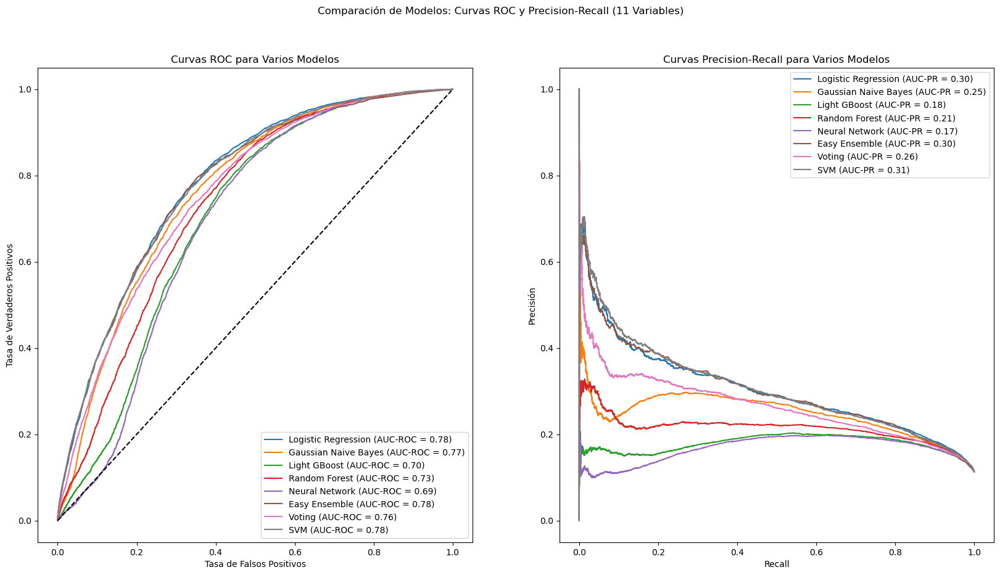

In [169]:
# Graficar curvas de rendimiento para los modelos con 11 variables
graficar_curvas_rendimiento(roc_data_11vars, pr_data_11vars, 
                            'Comparación de Modelos: Curvas ROC y Precision-Recall (11 Variables)')

### EXPLICABILIDAD

#### SHAP values

Valores SHAP para Logistic Regression:


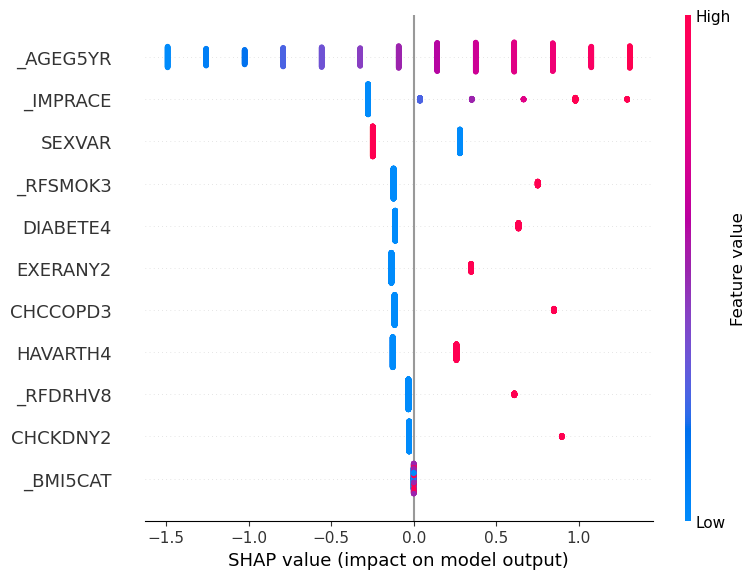

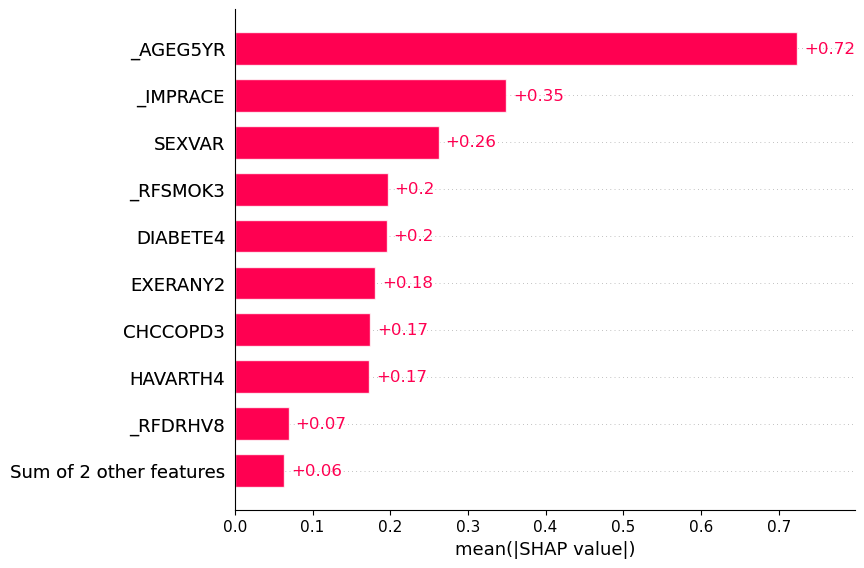

Valores SHAP para Gaussian Naive Bayes:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:09<00:00,  1.30s/it]


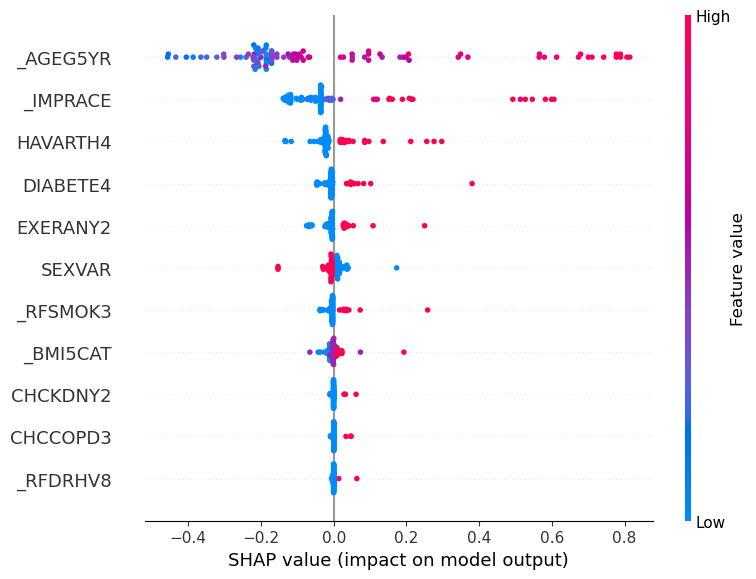

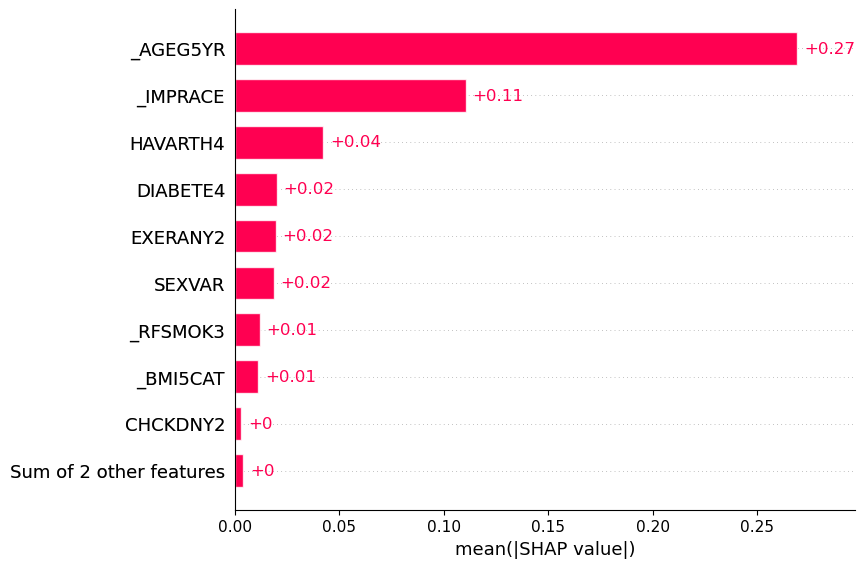

Valores SHAP para Light GBoost:


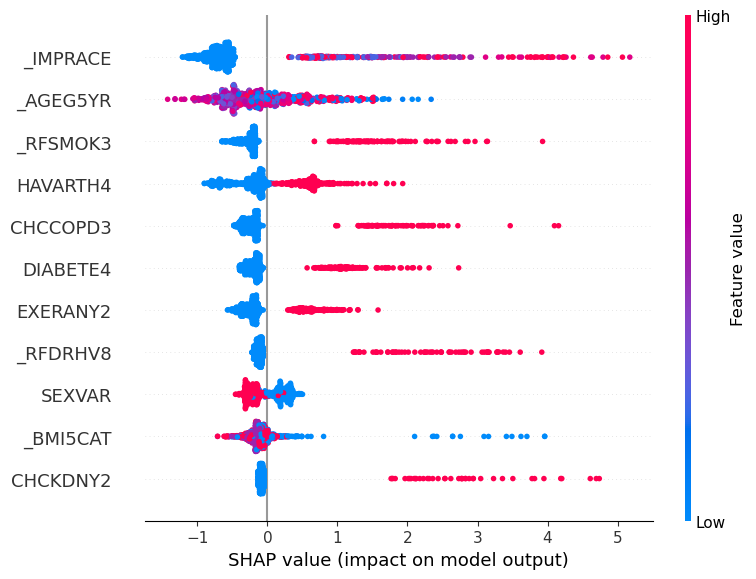

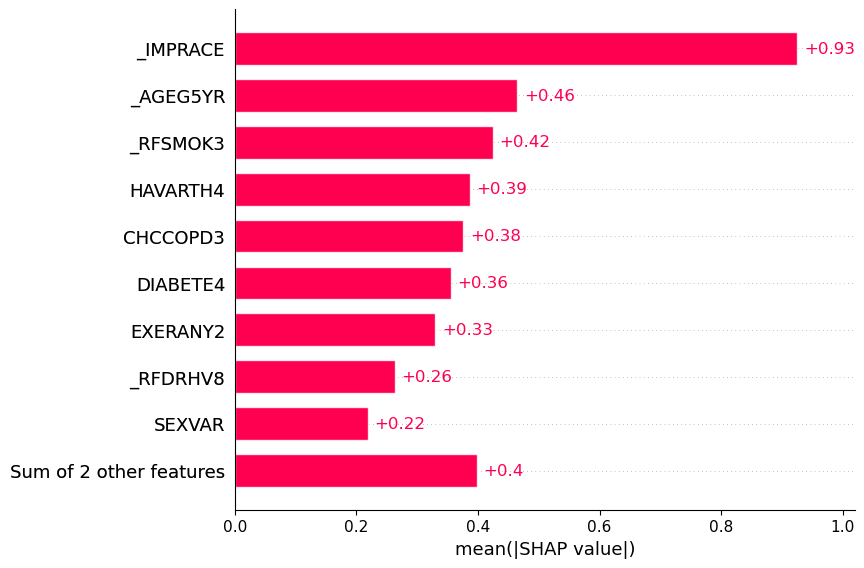

Valores SHAP para Random Forest:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [01:40<00:00,  1.34s/it]


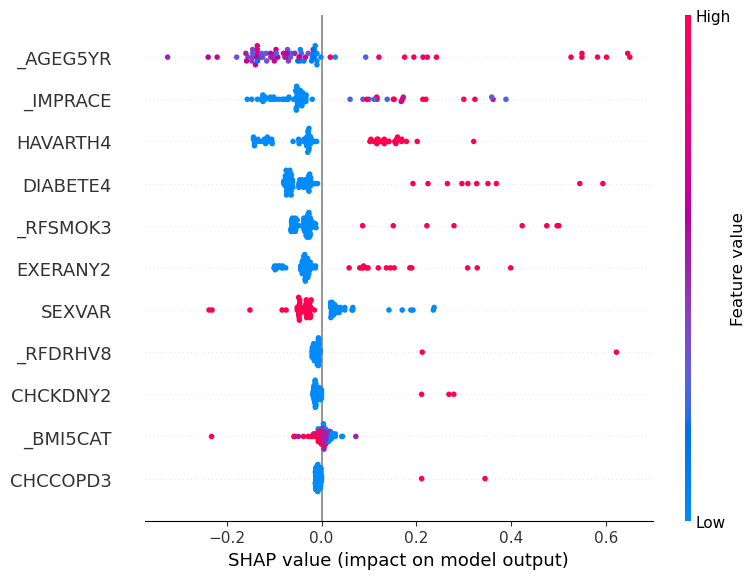

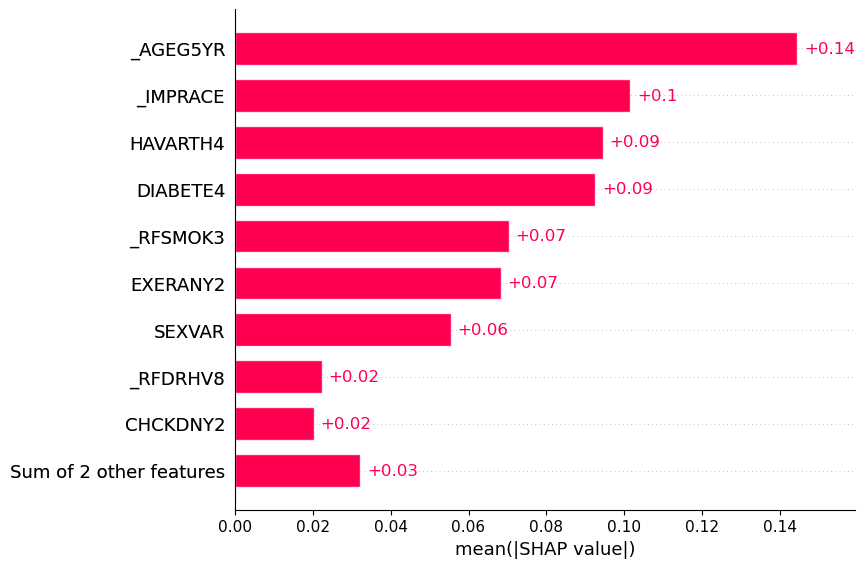

Valores SHAP para Neural Network:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [01:49<00:00,  1.46s/it]


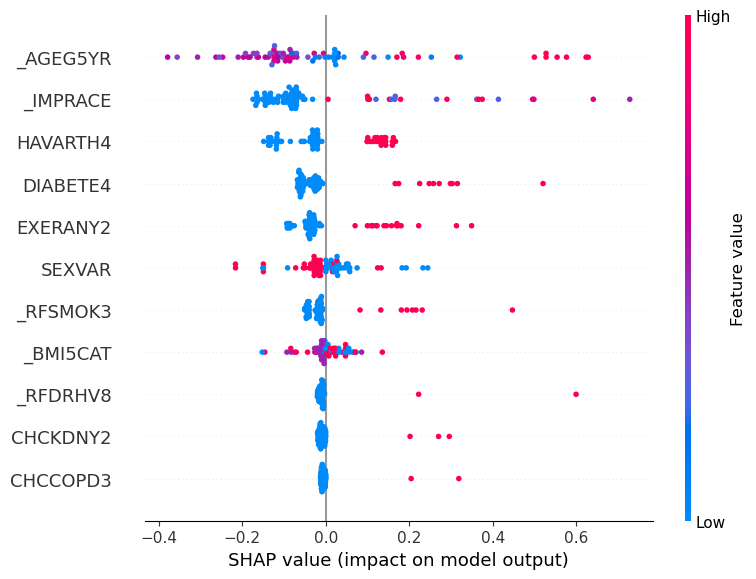

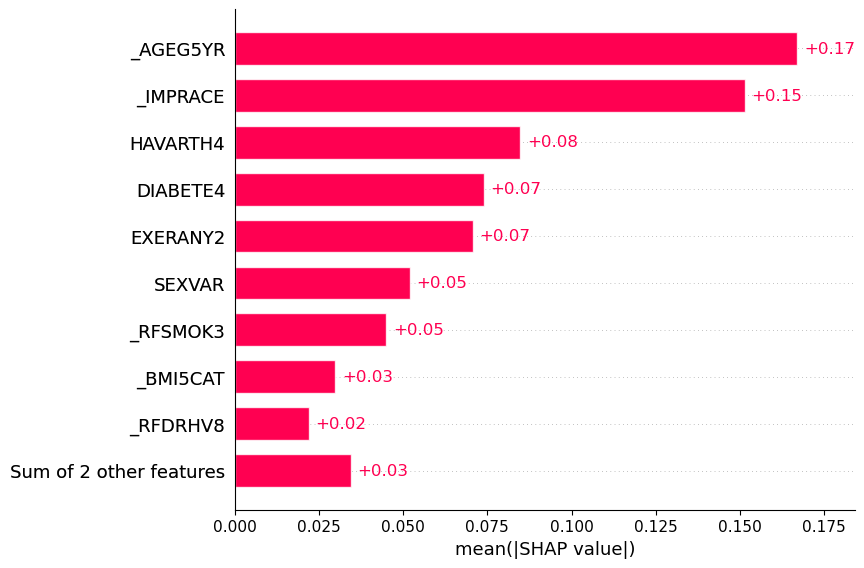

Valores SHAP para Easy Ensemble:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [01:44<00:00,  2.08s/it]


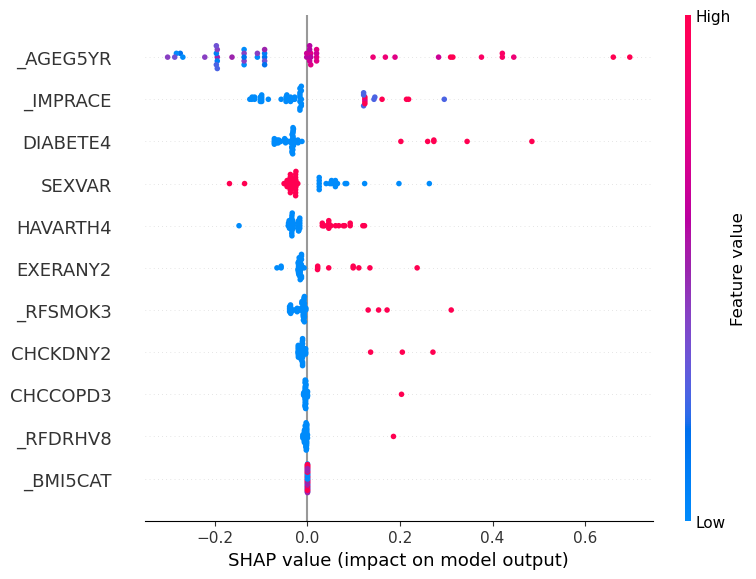

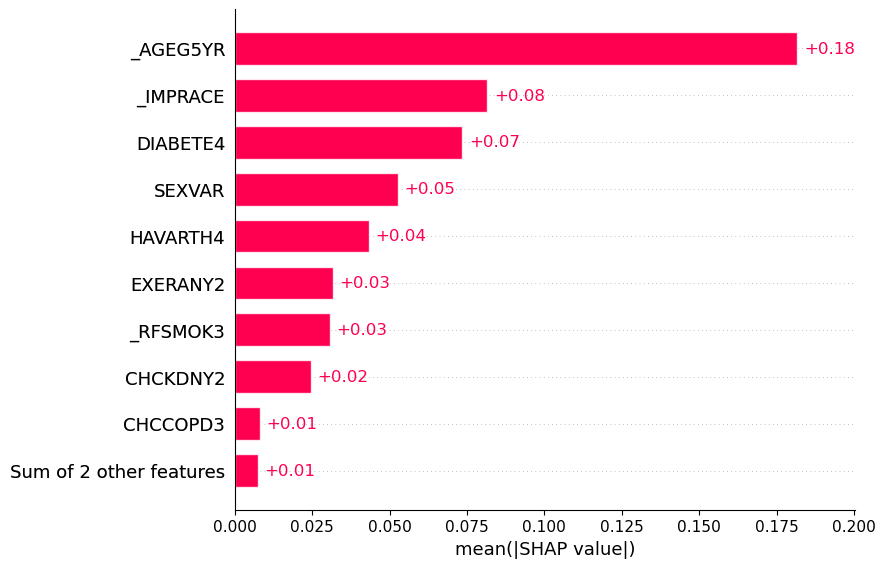

Valores SHAP para Voting:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [02:31<00:00,  3.03s/it]


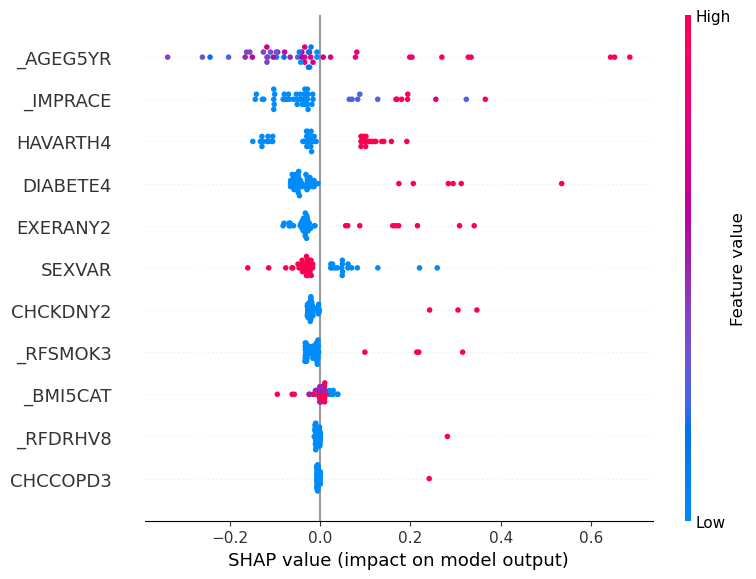

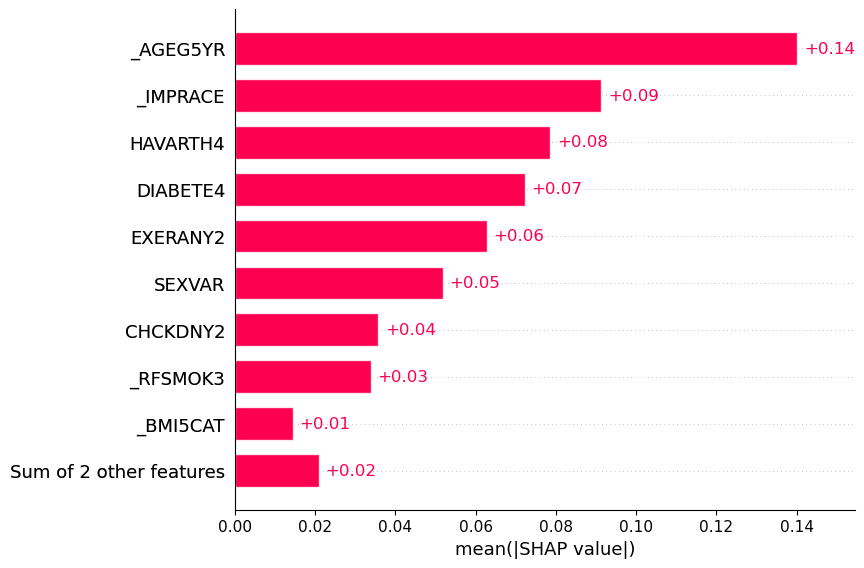

Valores SHAP para SVM:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:07<00:00,  1.27s/it]


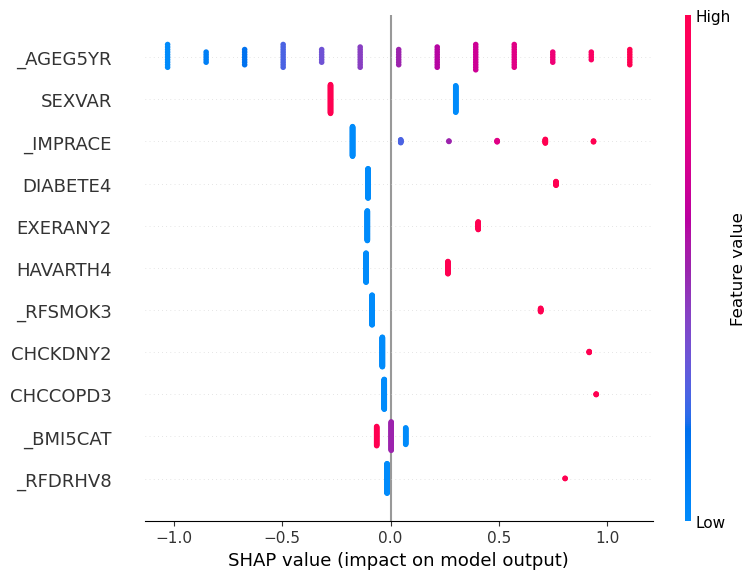

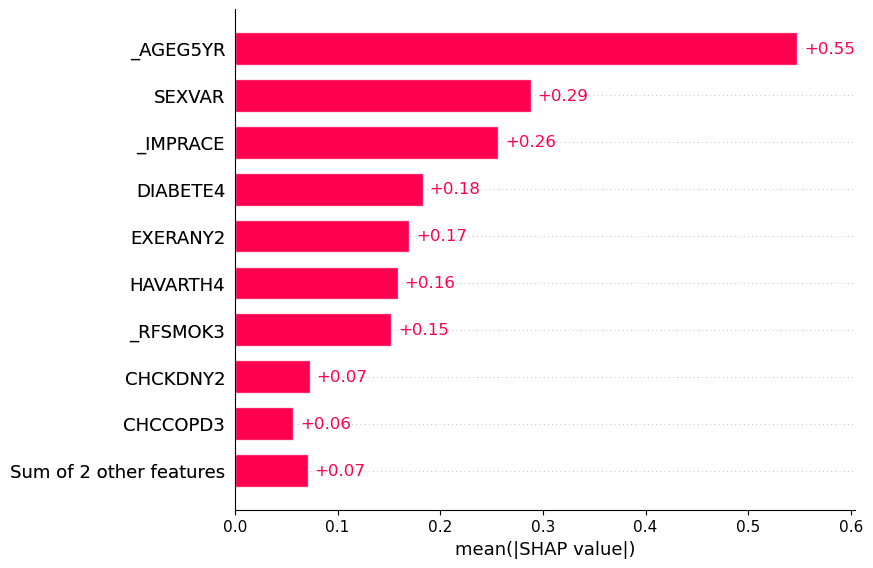

In [170]:

# Diccionario para mapear los tipos de modelo a sus correspondientes objetos explainer de SHAP
explainer_dict = {
    LogisticRegression: shap.LinearExplainer,
    GaussianNB: shap.KernelExplainer,
    LGBMClassifier: shap.TreeExplainer,
    RandomForestClassifier: shap.KernelExplainer,
    MLPClassifier: shap.KernelExplainer,
    EasyEnsembleClassifier: shap.KernelExplainer,
    VotingClassifier: shap.KernelExplainer,
    LinearSVC: shap.KernelExplainer    
    
}

# Diccionario para mapear los nombres de los modelos a sus correspondientes tamaños de muestra
sample_sizes = {
    'Logistic Regression': 1000,
    'Gaussian Naive Bayes': 100,
    'Light GBoost': 1000,
    'Random Forest': 75,
    'Neural Network': 75,
    'Easy Ensemble': 50,
    'SVM': 100,
    'Voting': 50
}

# Iterar sobre los modelos optimizados para graficar la importancia de las variables creadas por SHAP
for nombre, modelo in modelos_optimizados:
    print(f"Valores SHAP para {nombre}:")
    
    # Obtener el tamaño de muestra específico para el modelo actual
    sample_size = sample_sizes.get(nombre, 50)  # Valor predeterminado de 50 si no se encuentra el nombre del modelo
    
    # Tomar una muestra aleatoria de los datos de prueba para el cálculo de SHAP
    X_test_sample = shap.utils.sample(X_test, nsamples=sample_size, random_state=42)
    
    explainer_class = explainer_dict.get(type(modelo))
    if explainer_class is None:
        print(f"No se puede calcular los valores SHAP para {nombre}")
        continue
    
    if explainer_class == shap.KernelExplainer:
        if isinstance(modelo, LinearSVC):
            explainer = explainer_class(modelo.decision_function, X_test_sample)
        else:
            explainer = explainer_class(modelo.predict, X_test_sample)
    else:
        explainer = explainer_class(modelo, X_test_sample)
    
    shap_values = explainer(X_test_sample)
    
    # Graficar el Summary Plot de SHAP
    shap.summary_plot(shap_values, X_test_sample)
    plt.show()
    
    # Graficar el Bar Plot de SHAP
    shap.plots.bar(shap_values)
    plt.show()


#### Importancia y permutación de características

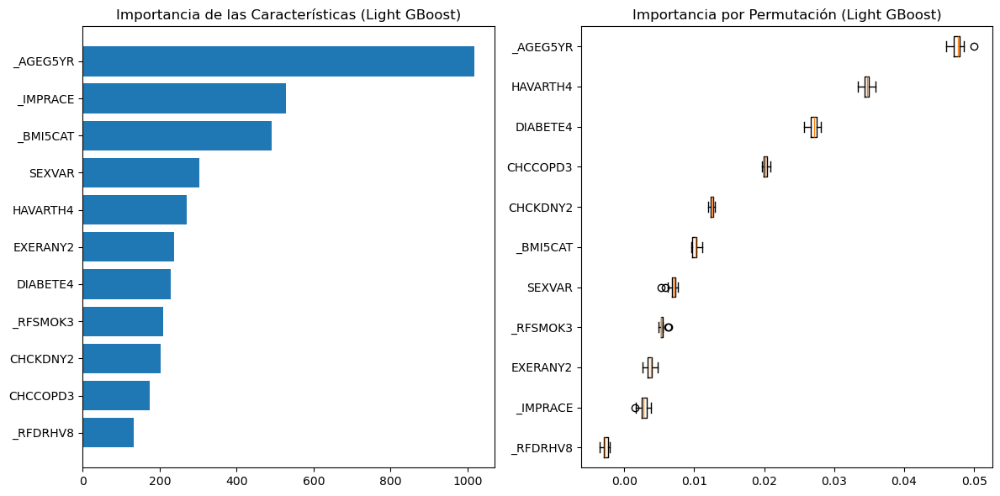

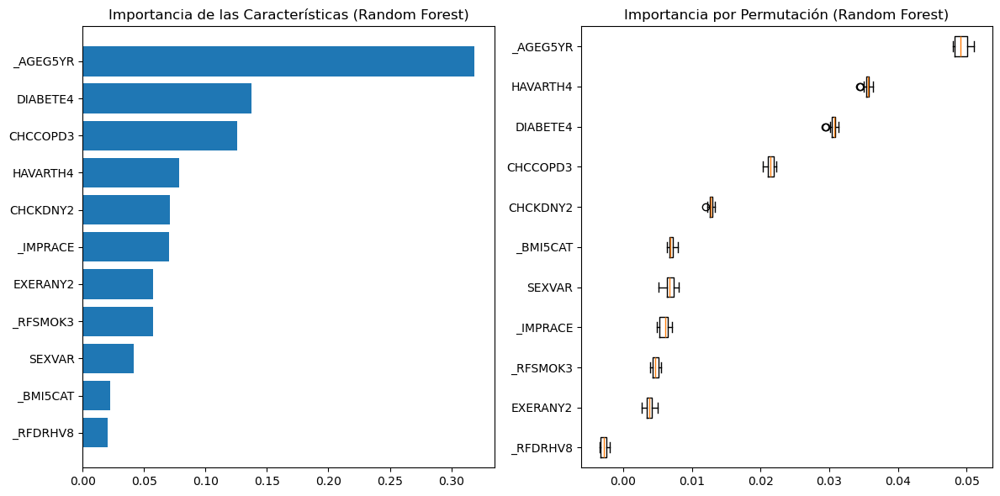

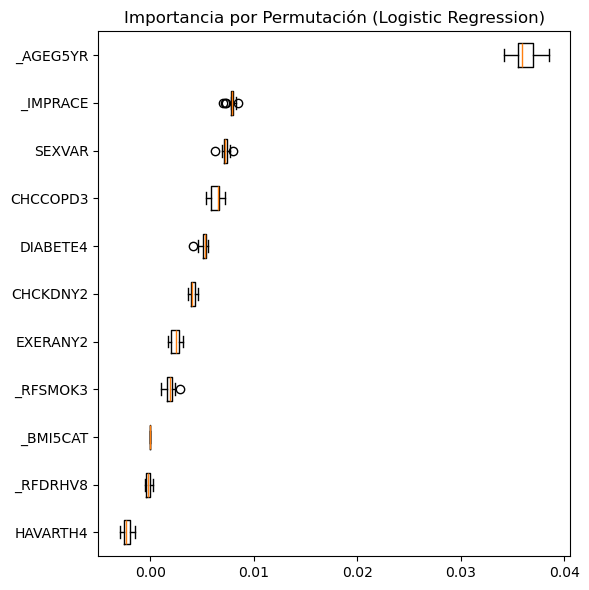

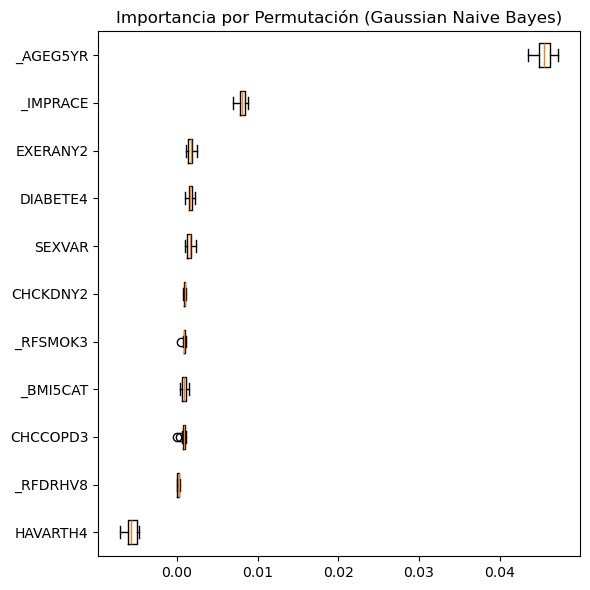

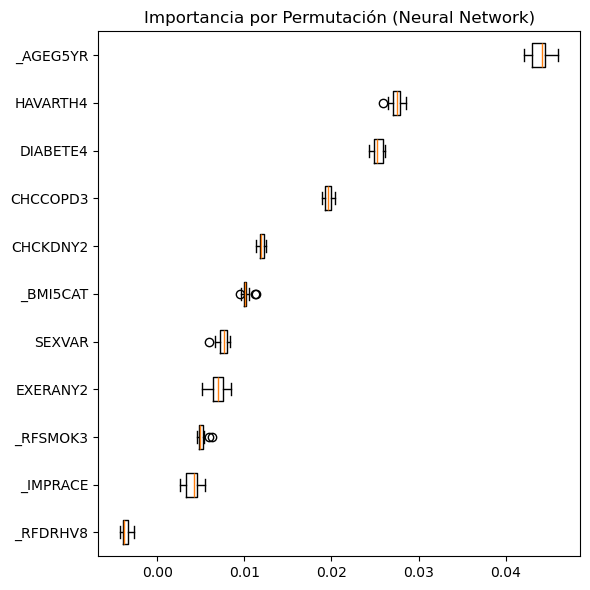

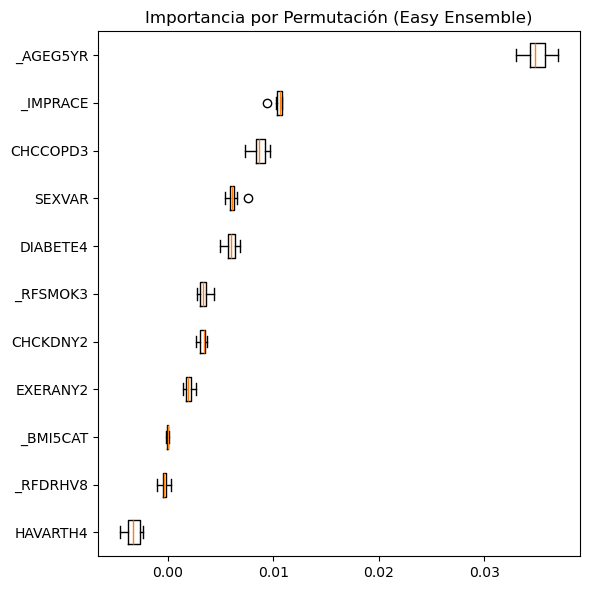

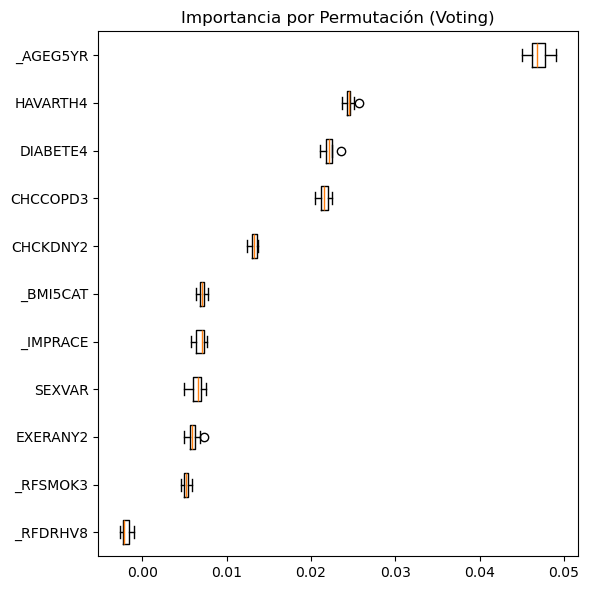

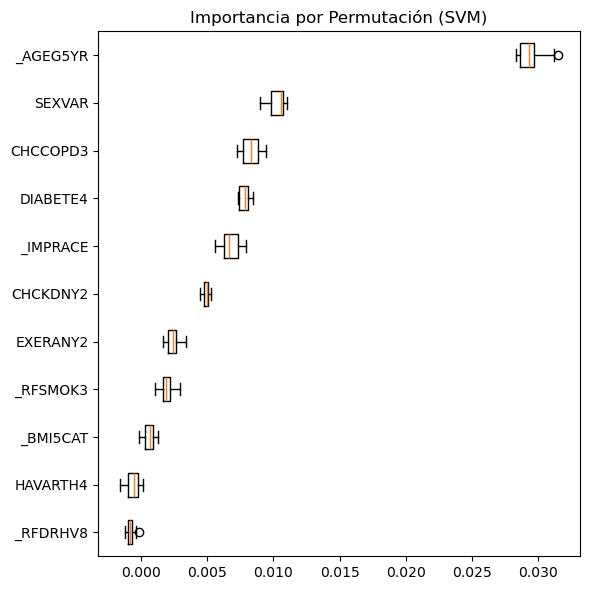

In [171]:
# Graficar importancia y permutación para los modelos con 11 variables
graficar_importancia_permutacion(modelos_optimizados, X_test, y_test, X)
graficar_permutacion_importancia(modelos_optimizados, X_test, y_test, X)

## MODELOS CON TODAS(29) LAS VARIABLES

In [172]:

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/NearMiss/modelos_iniciales_all"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los modelos base
modelos_base = [
    ('Logistic Regression', LogisticRegression(class_weight='balanced', max_iter=200, random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),
    ('Light GBoost', LGBMClassifier(class_weight='balanced', verbose=-1)),
    ('Random Forest', RandomForestClassifier(class_weight='balanced', n_estimators=500, min_samples_split=2,
                                             max_depth=5, min_samples_leaf=1, random_state=42)),
    ('Neural Network', MLPClassifier(early_stopping=True, random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble = [   
    ('Voting', VotingClassifier(estimators=modelos_base, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(class_weight='balanced', C=100.0, random_state=42, dual=False))
]

# Combinar todos los modelos
modelos = modelos_base + modelos_ensamble

# Crear el objeto de la técnica de muestreo NearMiss
tecnica_muestreo = NearMiss()

# Entrenar y evaluar modelos con todas las variables
resultados_allvars, X, X_train, y_train, X_val, y_val, X_test, y_test = entrenar_evaluar_modelos_base(
    df, modelos, carpeta_modelos, tecnica_muestreo)


Dimensiones del conjunto de entrenamiento:
X_train: (56106, 29), y_train: (56106,)

Dimensiones del conjunto de validación:
X_val: (53095, 29), y_val: (53095,)

Dimensiones del conjunto de prueba:
X_test: (53096, 29), y_test: (53096,)

Tiempo de muestreo: 1.54 minutos

Modelo Logistic Regression cargado desde archivo.
Entrenamiento Logistic Regression:
Tiempo de ejecución: 0.01 minutos
Accuracy: 0.8855737354293658
F1-score: 0.8790914912049418
Precision: 0.9318826112996607
Recall: 0.8319609310947136
AUC-ROC: 0.9421115904440112
Matthews Corr Coef: 0.7756191360993762

MATRIZ DE CONFUSIÓN:
[[26347  1706]
 [ 4714 23339]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.85      0.94      0.89     28053
           1       0.93      0.83      0.88     28053

    accuracy                           0.89     56106
   macro avg       0.89      0.89      0.89     56106
weighted avg       0.89      0.89      0.89     56106



Test Logistic Regres

### Tabla de métricas de rendimiento modelos base

In [173]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_allvars_inicial = pd.DataFrame.from_dict(resultados_allvars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_allvars_inicial

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.452275,0.258453,0.152623,0.842981,0.714179,0.160634,0.011979
Gaussian Naive Bayes,0.490206,0.256210,0.153456,0.775449,0.647449,0.146813,0.000633
Light GBoost,0.382195,0.240196,0.139528,0.862442,0.684355,0.126743,0.005865
Random Forest,0.549684,0.276901,0.169217,0.761477,0.717799,0.180091,0.106449
Neural Network,0.391197,0.240252,0.139893,0.850133,0.683432,0.124985,0.172560
Easy Ensemble,0.502222,0.262597,0.157761,0.782768,0.712790,0.159130,0.281908
Voting,0.441747,0.250373,0.147633,0.823353,0.712578,0.142128,0.322811
SVM,0.456626,0.258348,0.152787,0.835828,0.711787,0.159266,0.005065


### BÚSQUEDA DE HIPERPARÁMETROS

In [174]:

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/NearMiss/modelos_entrenados_all"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)


In [175]:

# Definir los espacios de búsqueda de hiperparámetros para cada modelo
param_dist_lr = {
    'class_weight': ['balanced', None],
    'solver': ['newton-cg', 'newton-cholesky', 'sag', 'saga'],
    'penalty': ['l2'],
    'C': loguniform(1e-4, 1e1)
}

param_dist_gnb = {
    'var_smoothing': loguniform(1e-9, 1e-1)
}

param_dist_lgbm = {
    'class_weight': ['balanced', None],
    'n_estimators': randint(50, 251),
    'max_depth': randint(3, 31),
    'subsample': uniform(0.7, 0.3),
    'colsample_bytree': uniform(0.7, 0.3),
    'learning_rate': loguniform(1e-5, 1e-1),
    'num_leaves': randint(10, 101),
    'verbose': [-1]
}

param_dist_rf = {
    'class_weight': ['balanced_subsample', 'balanced'],
    'n_estimators': randint(50, 251),
    'criterion': ['gini', 'entropy'],
    'max_depth': randint(3, 16),
    'min_samples_leaf': randint(3, 16),
    'min_samples_split': randint(3, 16),
    'max_features': [None, 'sqrt', 'log2']
}

param_dist_ann = {
    'hidden_layer_sizes': [(100,), (50,50), (100,100), (50, 50, 50),
                           (100, 100, 100), (50, 50, 50, 50), (100, 100, 100, 100),
                           (50, 50, 50, 50, 50), (100, 100, 100, 100, 100)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': loguniform(1e-5, 1e3),
    'batch_size': [64, 128, 256, 512],
    'learning_rate': ['constant', 'adaptive'],
    'learning_rate_init': loguniform(1e-5, 1e-1),
    'early_stopping': [True],
    'max_iter': [100]
}

param_dist_eec = {
    'n_estimators': randint(2, 20),
    'sampling_strategy': ['auto']
}

param_dist_svm = {
    'dual': ['auto'],
    'tol': loguniform(1e-5, 1e-3),
    'class_weight': [None, 'balanced'],
    'penalty': ['l2'],
    'loss': ['hinge', 'squared_hinge'],
    'C': loguniform(1e-4, 1e4),
    'max_iter': randint(1000, 2001)
}

# Definir los modelos con búsqueda de hiperparámetros
modelos = [
    ('Logistic Regression', RandomizedSearchCV(LogisticRegression(), param_dist_lr,
                                               cv=30, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Gaussian Naive Bayes', RandomizedSearchCV(GaussianNB(), param_dist_gnb, cv=30,
                                                n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('Light GBoost', RandomizedSearchCV(LGBMClassifier(), param_dist_lgbm, cv=5, n_jobs=6,
                                        scoring='f1_weighted', n_iter=50)),
    ('Random Forest', RandomizedSearchCV(RandomForestClassifier(), param_dist_rf,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Neural Network', RandomizedSearchCV(MLPClassifier(), param_dist_ann, cv=5, n_jobs=6,
                                          scoring='f1_weighted', error_score=0, n_iter=50)),
    ('Easy Ensemble', RandomizedSearchCV(EasyEnsembleClassifier(), param_dist_eec,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('SVM', RandomizedSearchCV(LinearSVC(), param_dist_svm, cv=5, n_jobs=6,
                               scoring='f1_weighted', n_iter=50))
]

# Crear un diccionario para almacenar los mejores hiperparámetros de cada modelo
best_params_all = {}

# Entrenar y evaluar cada modelo con búsqueda de hiperparámetros
for nombre, modelo in modelos:
    nombre_archivo = f"{carpeta_modelos}/{nombre}_optimizado.pkl"
    
    # Hash del conjunto de datos actual
    hash_actual = hash_de_datos(X_train)
    
    # Cargar o entrenar modelo
    modelo_cargado, tiempo_ejecucion, mejores_parametros_cargados = cargar_modelo(nombre_archivo, hash_actual)
    
    if modelo_cargado is not None:
        print(f"Modelo {nombre} cargado desde archivo.")
        modelo_best_all = modelo_cargado
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros_cargados}")
        # Agregar los mejores hiperparámetros cargados al diccionario
        best_params_all[nombre] = mejores_parametros_cargados
    else:
        print(f"Entrenando nuevo modelo {nombre}.")
        inicio = time.time()  # Tiempo de inicio
        modelo.fit(X_train, y_train)
        
        mejores_parametros = modelo.best_params_
        
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros}")
        
        # Agregar los mejores hiperparámetros al diccionario
        best_params_all[nombre] = modelo.best_params_
        
        # Entrenar el modelo con los mejores hiperparámetros en el conjunto de entrenamiento completo
        modelo_best_all = modelo.best_estimator_
        modelo_best_all.fit(X_train, y_train)
        
        fin = time.time()  # Tiempo de fin
        tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos
        
        # Guardar el modelo entrenado junto con el tiempo de ejecución y los mejores parámetros
        guardar_modelo(modelo_best_all, nombre_archivo, hash_actual, tiempo_ejecucion, mejores_parametros)

    # Métricas predicción entrenamiento
    y_pred_train = modelo_best_all.predict(X_train)

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_all, "predict_proba"):
        y_scores = modelo_best_all.predict_proba(X_train)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_all.decision_function(X_train)  # Puntuaciones de decisión
    
    print(f"Entrenamiento {nombre}:")
    print(f"Tiempo de búsqueda de hiperparámetros de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_train, y_pred_train)}")
    print(f"F1-score: {f1_score(y_train, y_pred_train)}")
    print(f"Precision: {precision_score(y_train, y_pred_train)}")
    print(f"Recall: {recall_score(y_train, y_pred_train)}")
    print(f"AUC-ROC: {roc_auc_score(y_train, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_train, y_pred_train)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_train, y_pred_train))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_train, y_pred_train))
    print("\n")

    # Métricas predicción validación
    inicio = time.time()  # Tiempo de inicio
    y_pred_val = modelo_best_all.predict(X_val)
    fin = time.time()  # Tiempo de fin
    tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_all, "predict_proba"):
        y_scores = modelo_best_all.predict_proba(X_val)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_all.decision_function(X_val)  # Puntuaciones de decisión

    
    print(f"Validación {nombre}:")
    print(f"Tiempo de ejecución de predicción de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_val, y_pred_val)}")
    print(f"F1-score: {f1_score(y_val, y_pred_val)}")
    print(f"Precision: {precision_score(y_val, y_pred_val)}")
    print(f"Recall: {recall_score(y_val, y_pred_val)}")
    print(f"AUC-ROC: {roc_auc_score(y_val, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_val, y_pred_val)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_val, y_pred_val))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_val, y_pred_val))
    print("\n")

Modelo Logistic Regression cargado desde archivo.
Mejores hiperparámetros para Logistic Regression: {'solver': 'newton-cg', 'penalty': 'l2', 'class_weight': 'balanced', 'C': 1}
Entrenamiento Logistic Regression:
Tiempo de búsqueda de hiperparámetros de Logistic Regression: 6.84 minutos
Accuracy: 0.8855559120236695
F1-score: 0.8790476011076158
Precision: 0.9320524087241352
Recall: 0.8317470502263572
AUC-ROC: 0.9421060959581284
Matthews Corr Coef: 0.775616333506649

MATRIZ DE CONFUSIÓN:
[[26352  1701]
 [ 4720 23333]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.85      0.94      0.89     28053
           1       0.93      0.83      0.88     28053

    accuracy                           0.89     56106
   macro avg       0.89      0.89      0.89     56106
weighted avg       0.89      0.89      0.89     56106



Validación Logistic Regression:
Tiempo de ejecución de predicción de Logistic Regression: 0.00 minutos
Accuracy: 0.44448629

### Entrenar modelos con los mejores parámetros

In [176]:
# Combinar los conjuntos de entrenamiento y validación para todas las variables
X_train_val_allvars = pd.concat([X_train, X_val], ignore_index=True)
y_train_val_allvars = pd.concat([y_train, y_val], ignore_index=True)

# Definir los modelos con los mejores hiperparámetros
modelos_entrenados_all = [
    ('Logistic Regression', LogisticRegression(random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),
    ('Light GBoost', LGBMClassifier(verbosity=-1, random_state=42)),
    ('Random Forest', RandomForestClassifier(random_state=42)),
    ('Neural Network', MLPClassifier(random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble_all = [
    ('Voting', VotingClassifier(estimators=modelos_entrenados_all, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(random_state=42))
]

# Combinar todos los modelos
modelos_optimizados_all = modelos_entrenados_all + modelos_ensamble_all

# Crear el objeto de la técnica de muestreo NearMiss
tecnica_muestreo = NearMiss()

# Entrenar y evaluar modelos con todas las variables
resultados_optimizados_allvars, roc_data, pr_data, modelos_optimizados_all = entrenar_evaluar_modelos(
    X_train_val_allvars, y_train_val_allvars, X_test, y_test, modelos_optimizados_all, best_params_all, carpeta_modelos,
    tecnica_muestreo
)



Tiempo de muestreo: 0.63 minutos

Modelo Logistic Regression cargado desde archivo.
Test Logistic Regression:
Mejores hiperparámetros para Logistic Regression: {'solver': 'newton-cg', 'penalty': 'l2', 'class_weight': 'balanced', 'C': 1}
Tiempo de ejecución de entrenamiento: 0.01 minutos
Tiempo de ejecución de predicción: 0.00 minutos
Accuracy: 0.4516912761789965
F1-score: 0.25824861779917957
Precision: 0.15248066913379668
Recall: 0.8429807052561543
AUC-ROC: 0.7146240308299664
Matthews Corr Coef: 0.16025347234764092

MATRIZ DE CONFUSIÓN:
[[18915 28169]
 [  944  5068]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.95      0.40      0.57     47084
           1       0.15      0.84      0.26      6012

    accuracy                           0.45     53096
   macro avg       0.55      0.62      0.41     53096
weighted avg       0.86      0.45      0.53     53096



Modelo Gaussian Naive Bayes cargado desde archivo.
Test Gaussian Naiv

### Tabla de métricas de rendimiento con los mejores parámetros

In [177]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_allvars_opt = pd.DataFrame.from_dict(resultados_optimizados_allvars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_allvars_opt

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.451691,0.258249,0.152481,0.842981,0.714624,0.160253,0.012129
Gaussian Naive Bayes,0.481562,0.254152,0.151804,0.780106,0.649083,0.143611,0.000716
Light GBoost,0.382326,0.240868,0.139903,0.865436,0.684048,0.128719,0.012962
Random Forest,0.435626,0.249987,0.147133,0.830672,0.704348,0.142433,0.063146
Neural Network,0.386357,0.240761,0.139992,0.859281,0.706598,0.127499,2.298652
Easy Ensemble,0.498964,0.261459,0.156920,0.783267,0.712997,0.157198,0.593356
Voting,0.431012,0.248576,0.146141,0.831171,0.710346,0.139693,1.890495
SVM,0.456889,0.256184,0.151601,0.826015,0.705913,0.153681,0.047901


### Visualizar comparación de rendimiento de curvas ROC-AUC Y PR-AUC

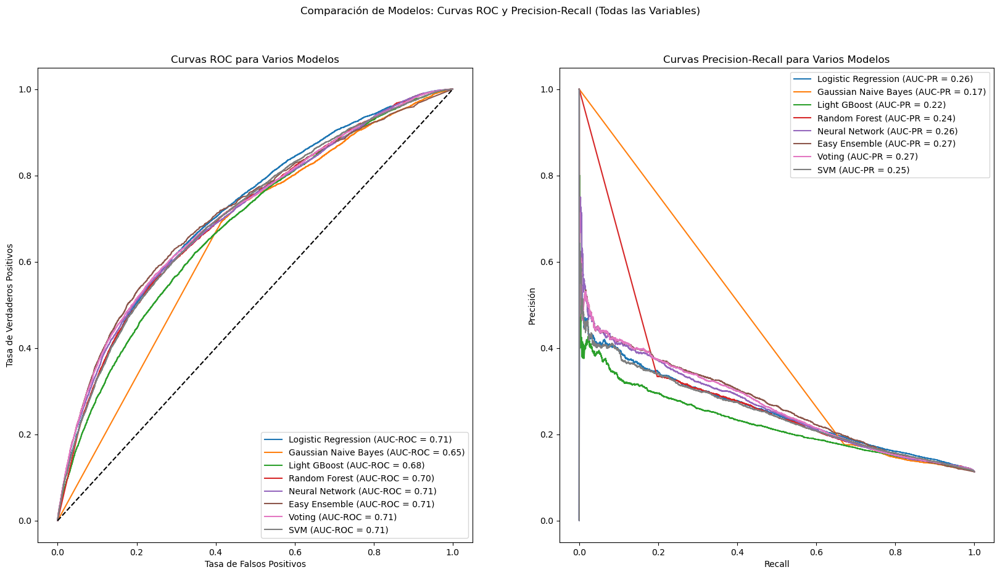

In [178]:
# Graficar curvas de rendimiento para los modelos con todas las variables
graficar_curvas_rendimiento(roc_data, pr_data, 
                            'Comparación de Modelos: Curvas ROC y Precision-Recall (Todas las Variables)')

### EXPLICABILIDAD

#### SHAP values

Valores SHAP para Logistic Regression:


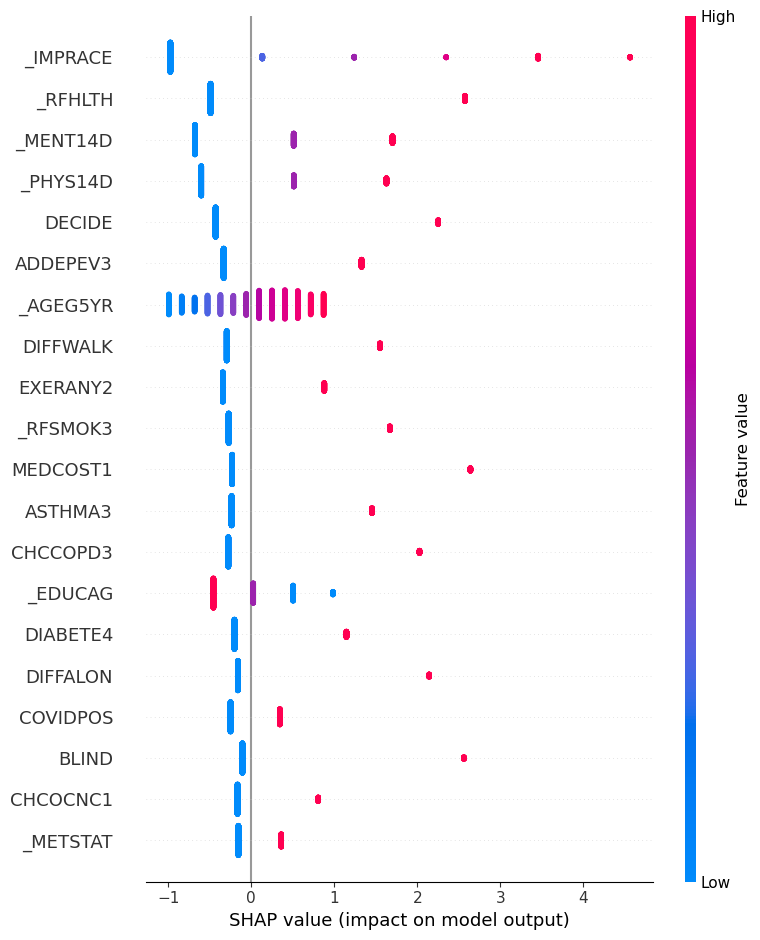

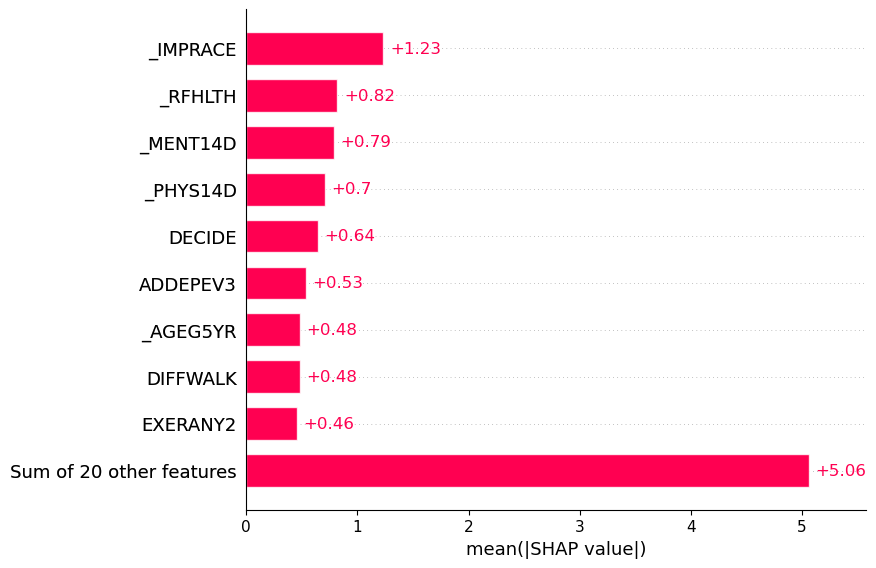

Valores SHAP para Gaussian Naive Bayes:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:35<00:00,  1.56s/it]


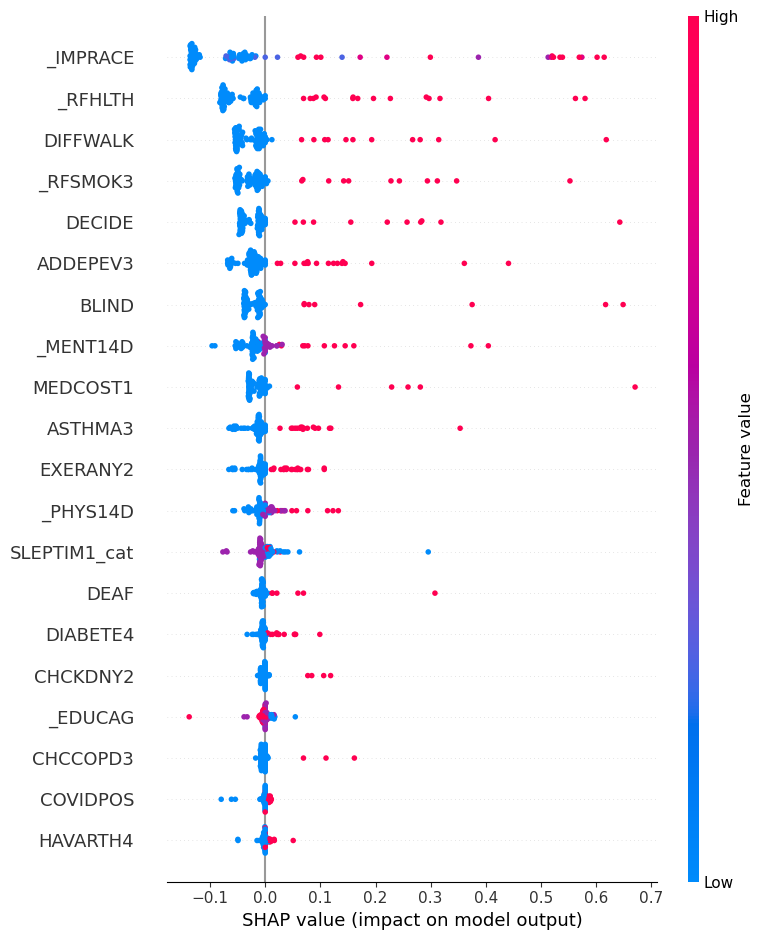

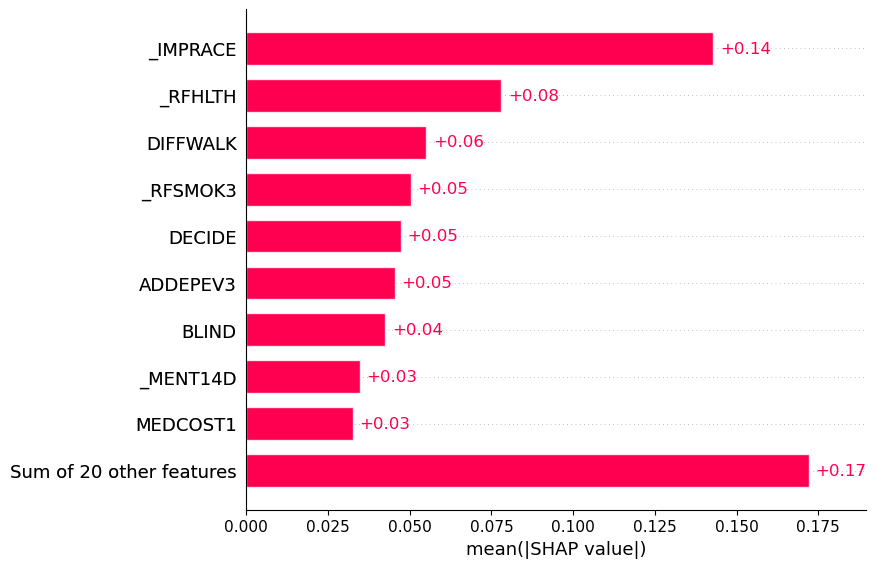

Valores SHAP para Light GBoost:


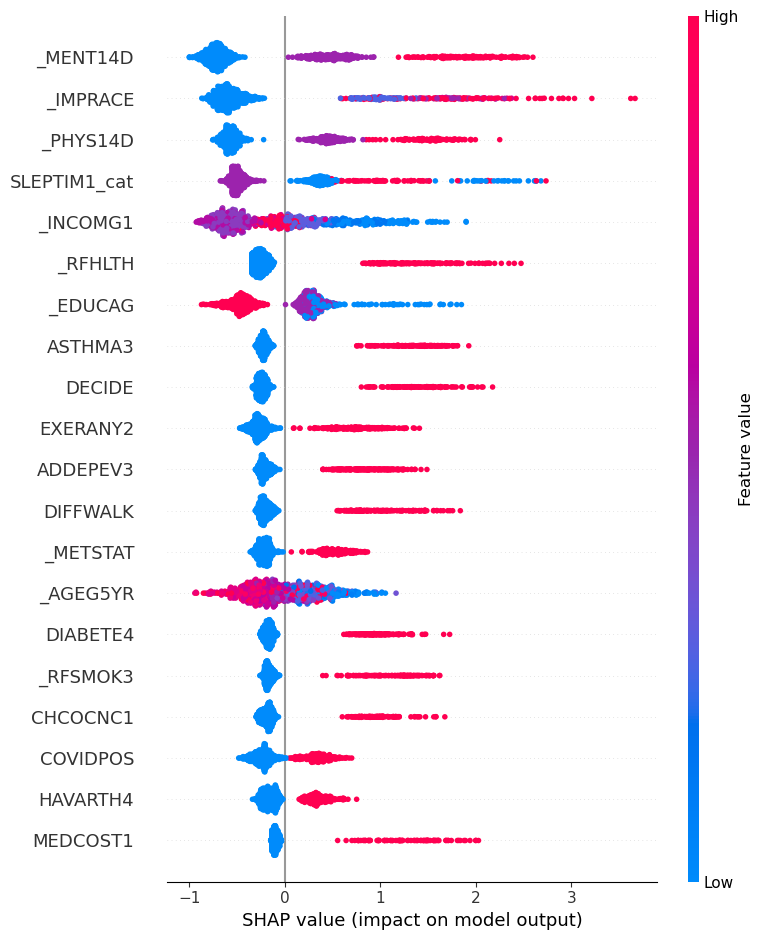

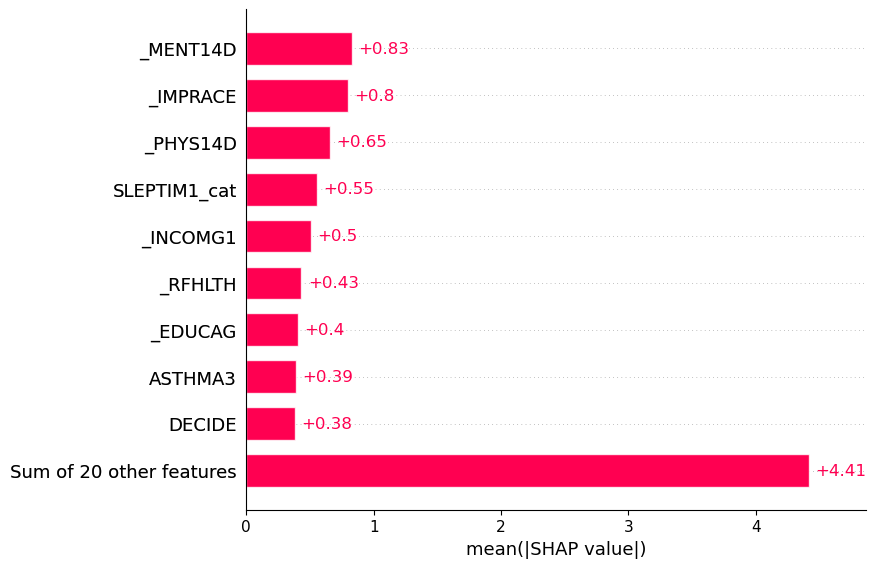

Valores SHAP para Random Forest:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [02:30<00:00,  2.01s/it]


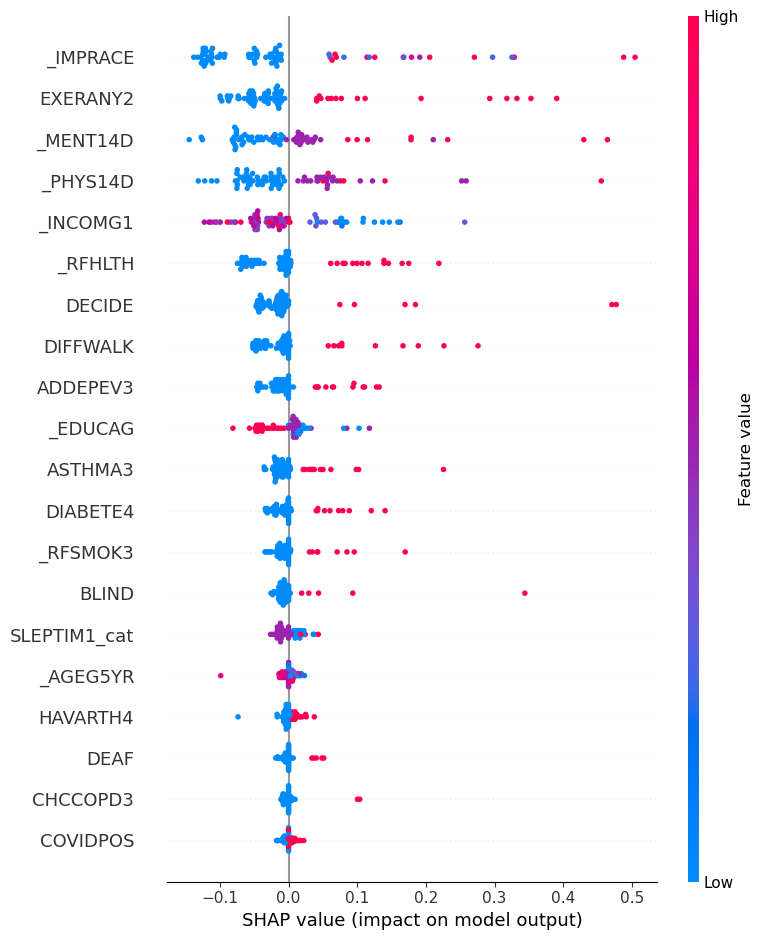

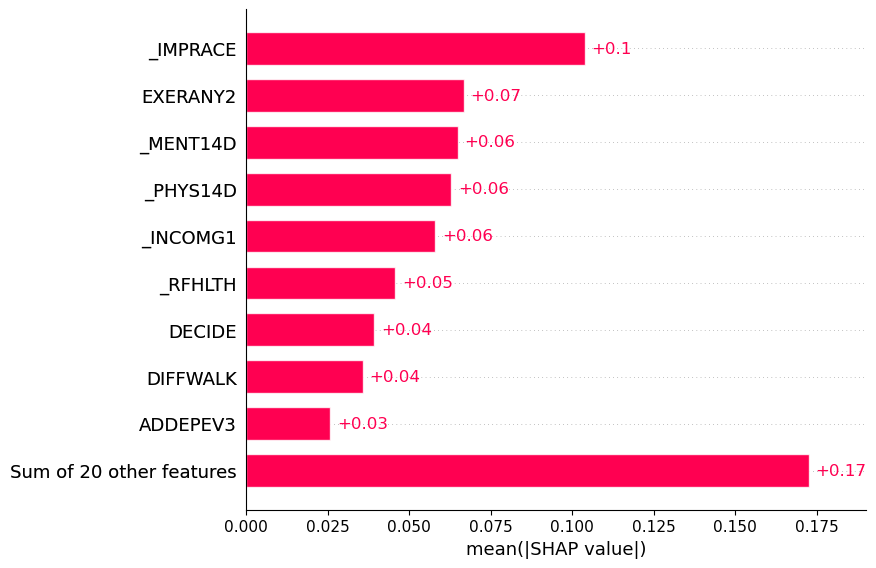

Valores SHAP para Neural Network:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [01:42<00:00,  1.37s/it]


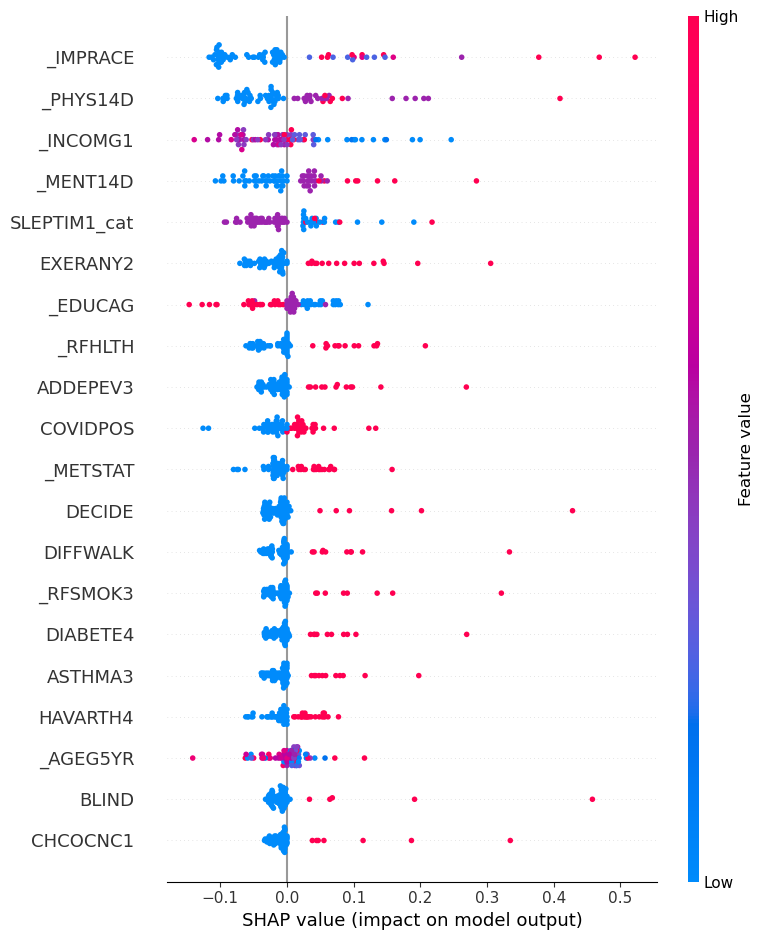

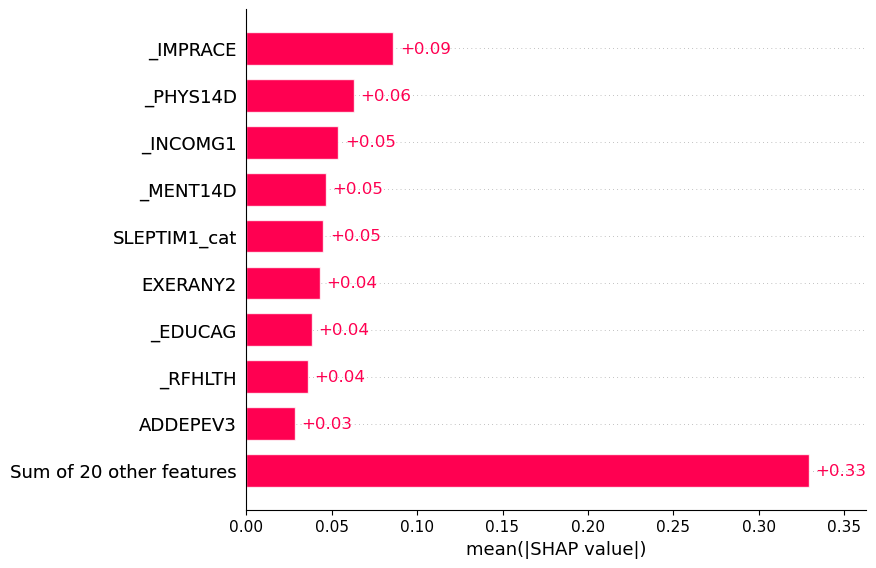

Valores SHAP para Easy Ensemble:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [08:36<00:00, 10.32s/it]


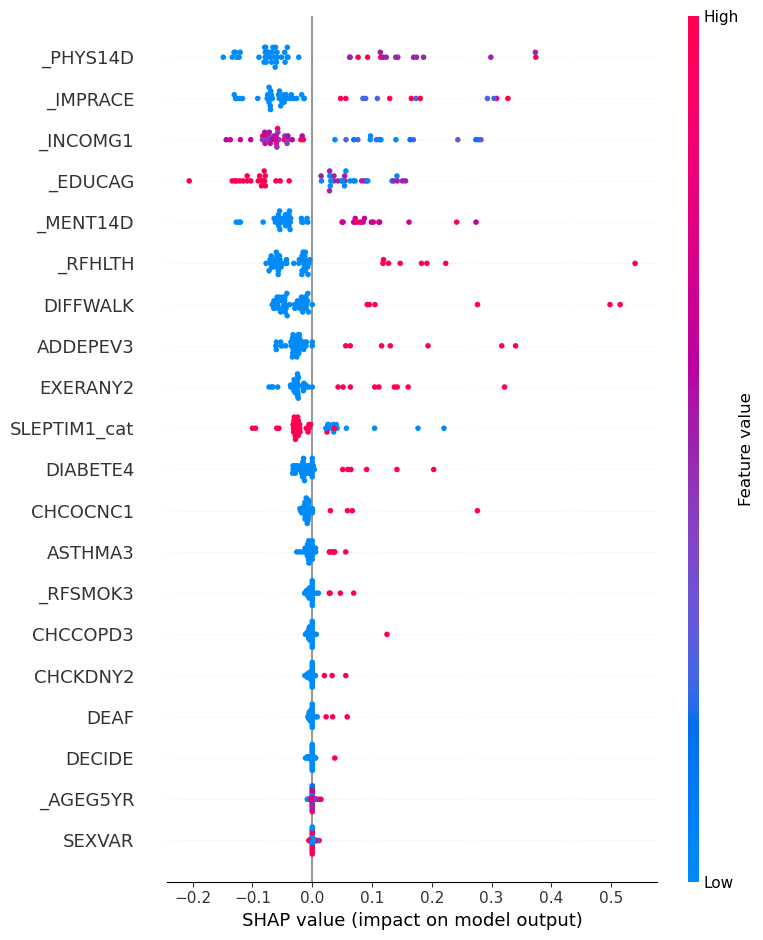

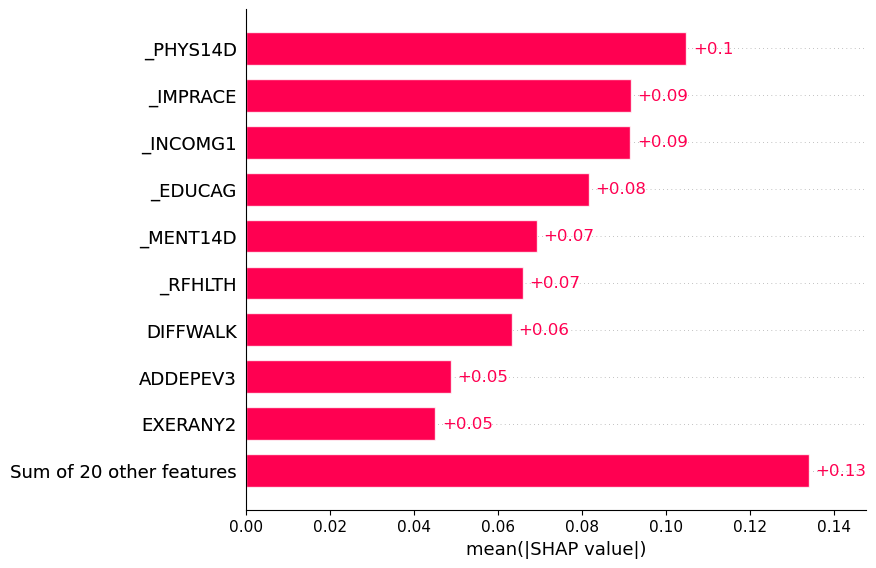

Valores SHAP para Voting:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [09:47<00:00, 11.75s/it]


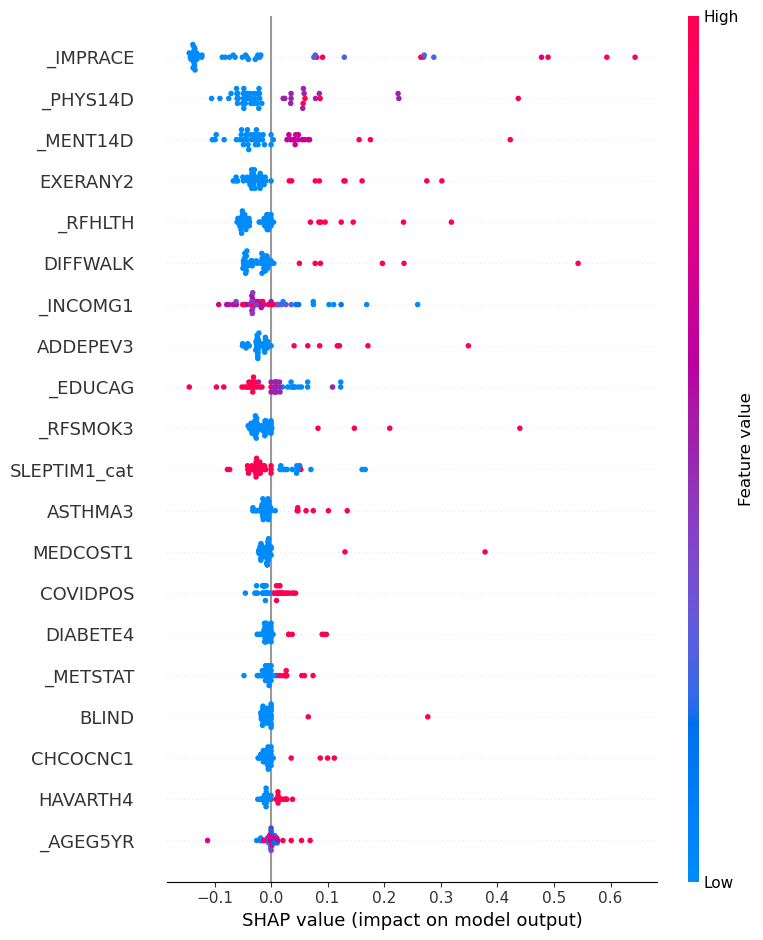

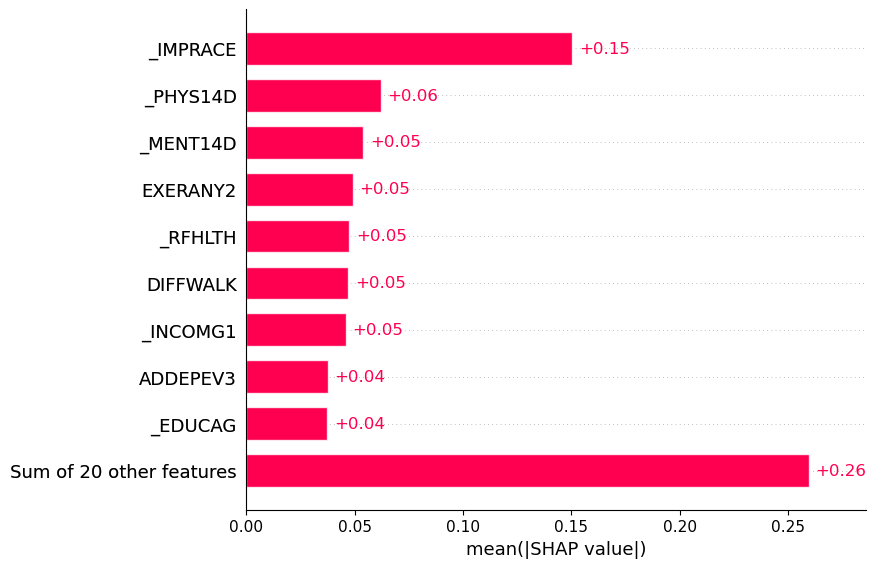

Valores SHAP para SVM:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:25<00:00,  1.46s/it]


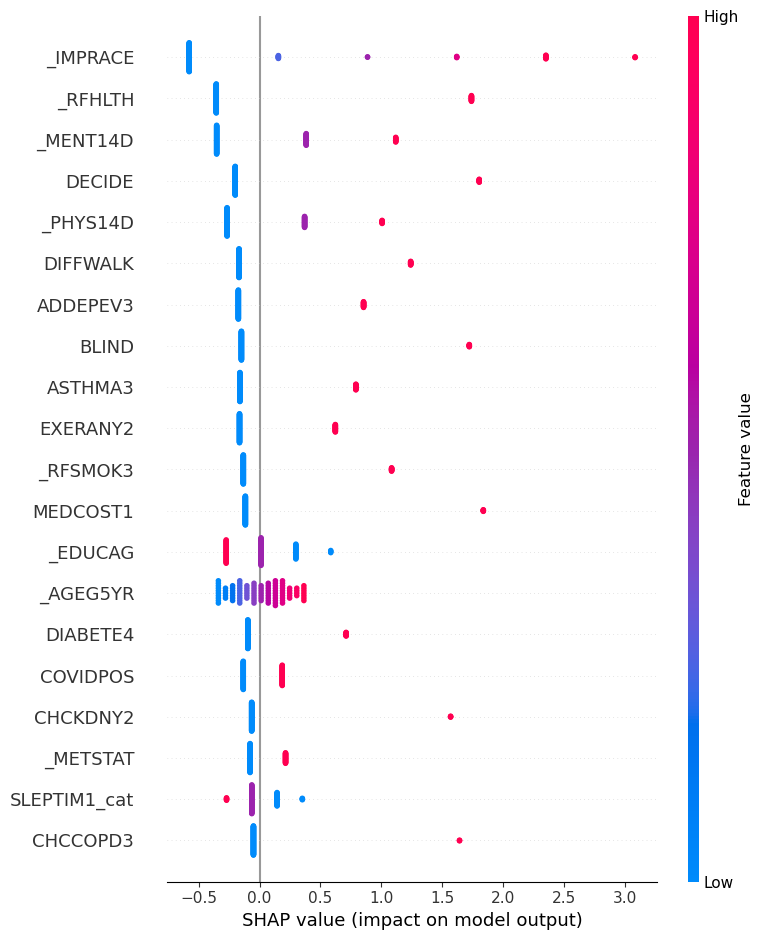

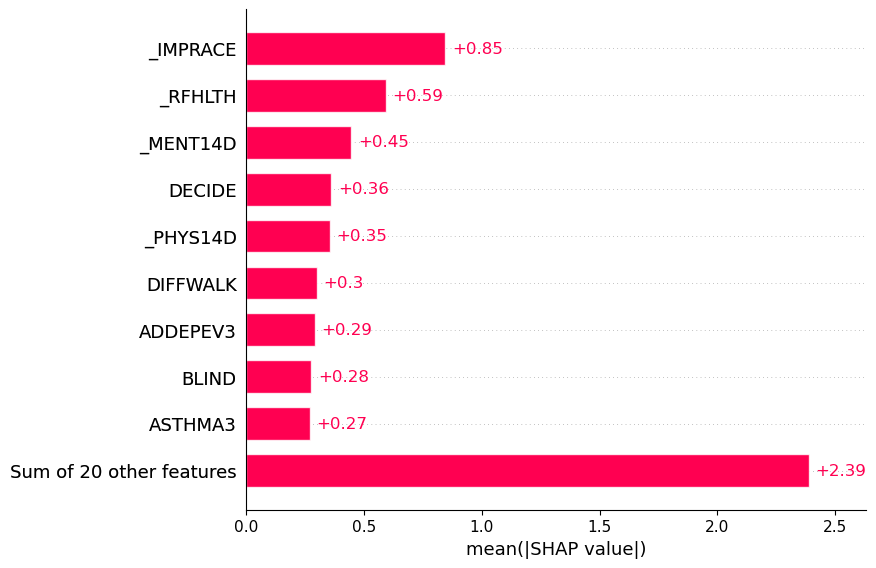

In [179]:
# Iterar sobre los modelos optimizados para graficar la importancia de las variables creadas por SHAP
for nombre, modelo in modelos_optimizados_all:
    print(f"Valores SHAP para {nombre}:")
    
    # Obtener el tamaño de muestra específico para el modelo actual
    sample_size = sample_sizes.get(nombre, 50)  # Valor predeterminado de 50 si no se encuentra el nombre del modelo
    
    # Tomar una muestra aleatoria de los datos de prueba para el cálculo de SHAP
    X_test_sample = shap.utils.sample(X_test, nsamples=sample_size, random_state=42)
    
    explainer_class = explainer_dict.get(type(modelo))
    if explainer_class is None:
        print(f"No se puede calcular los valores SHAP para {nombre}")
        continue
    
    if explainer_class == shap.KernelExplainer:
        if isinstance(modelo, LinearSVC):
            explainer = explainer_class(modelo.decision_function, X_test_sample)
        else:
            explainer = explainer_class(modelo.predict, X_test_sample)
    else:
        explainer = explainer_class(modelo, X_test_sample)
    
    shap_values = explainer(X_test_sample)
    
    # Graficar el Summary Plot de SHAP
    shap.summary_plot(shap_values, X_test_sample)
    plt.show()
    
    # Graficar el Bar Plot de SHAP
    shap.plots.bar(shap_values)
    plt.show()

#### Importancia y permutación de características

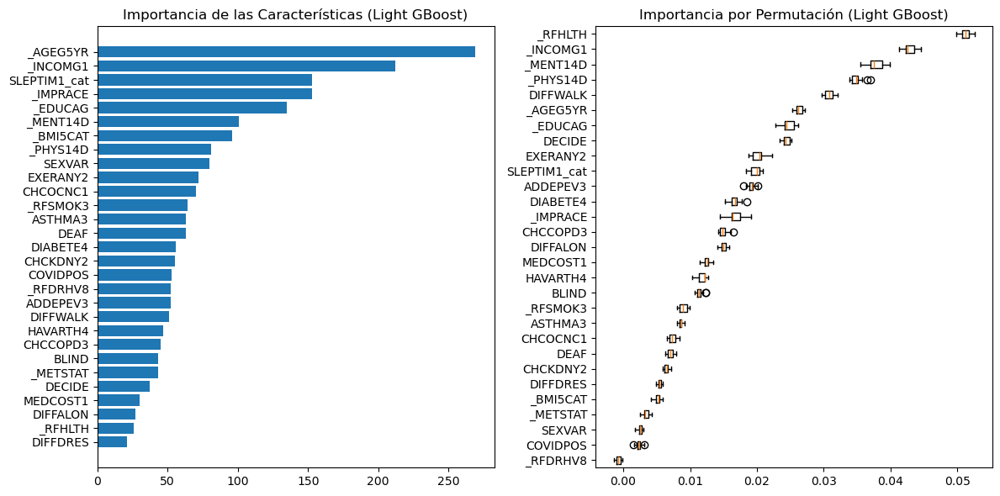

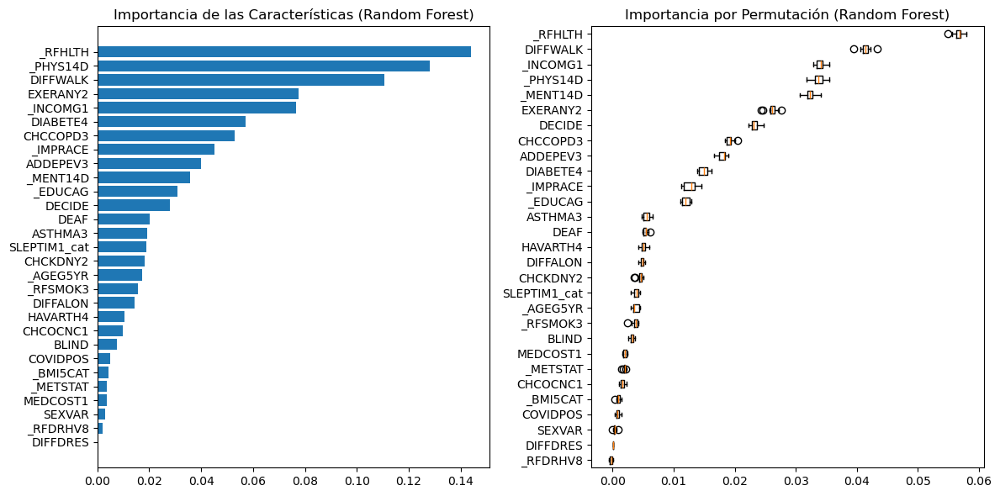

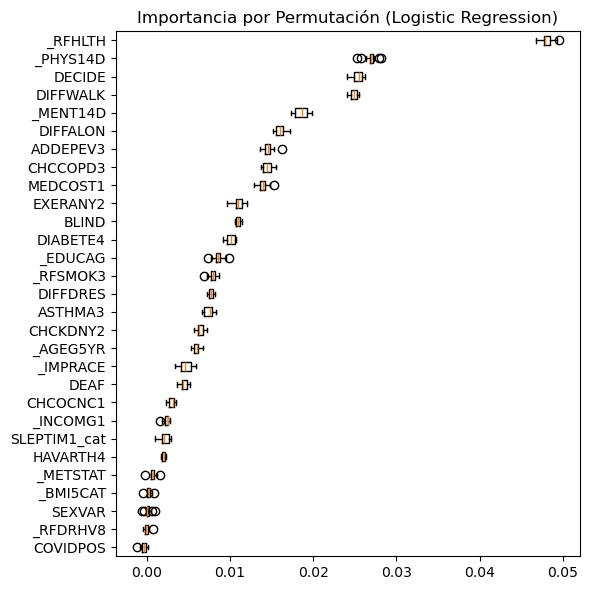

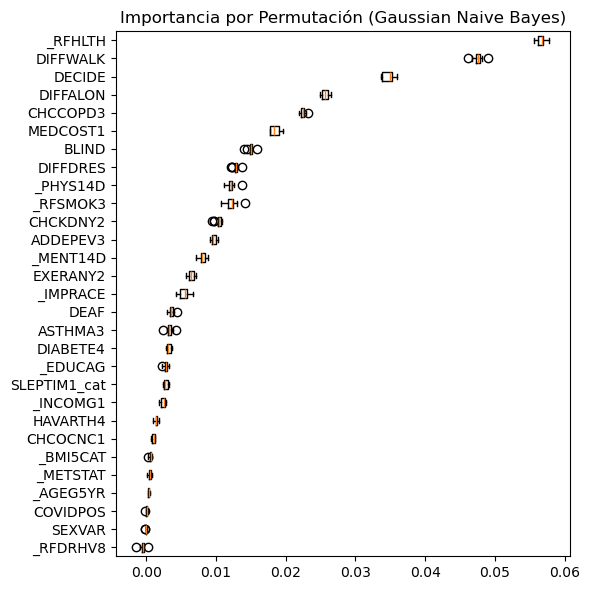

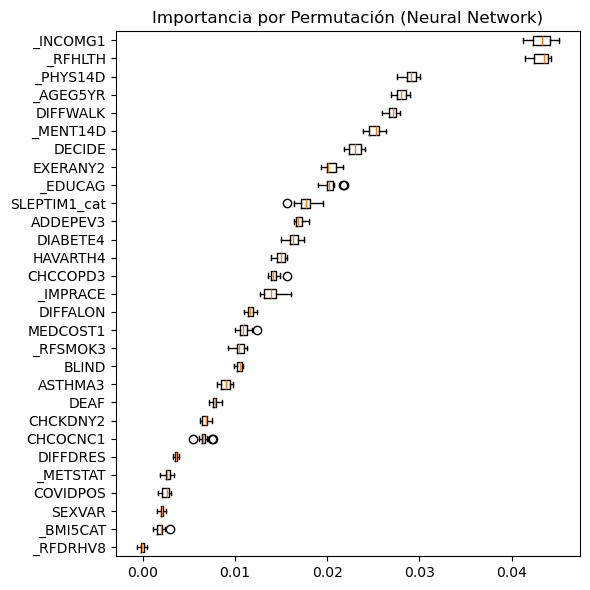

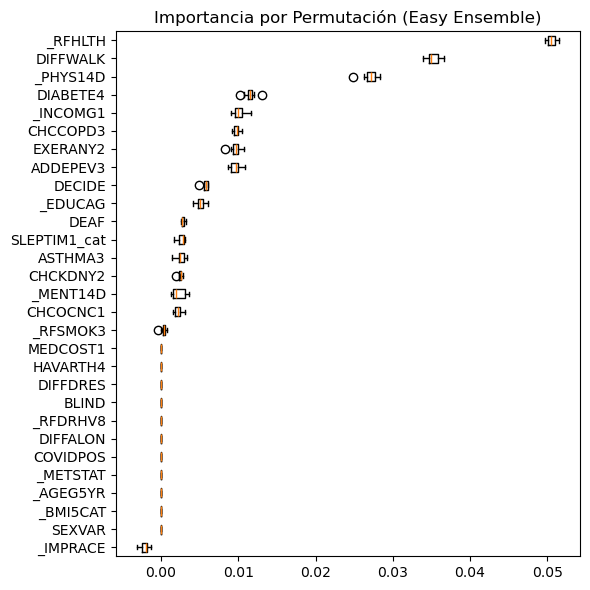

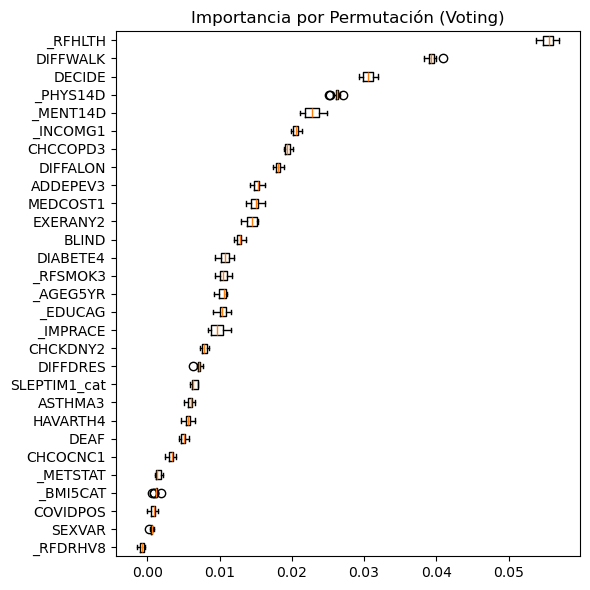

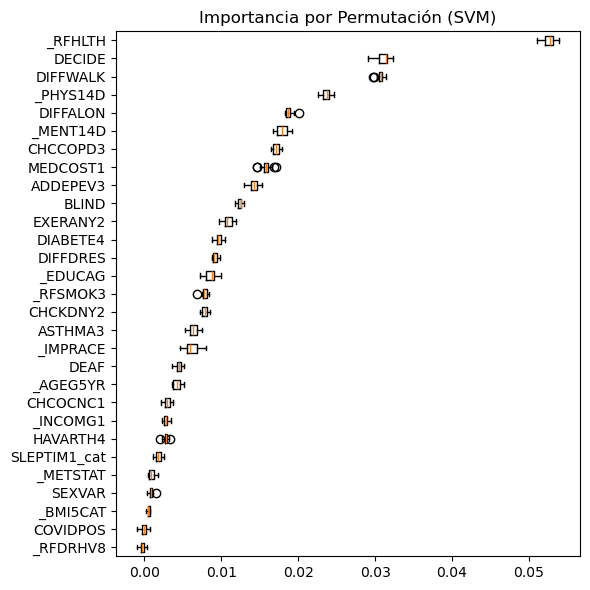

In [180]:
# Graficar importancia y permutación para los modelos con todas las variables
graficar_importancia_permutacion(modelos_optimizados_all, X_test, y_test, X)
graficar_permutacion_importancia(modelos_optimizados_all, X_test, y_test, X)

# ENTRENAMIENTO CON SUBMUESTREO InstanceHardnessThreshold()

La técnica de submuestreo InstanceHardnessThreshold (IHT) es una estrategia diseñada para abordar el desequilibrio de clases en conjuntos de datos, especialmente útil en situaciones donde se trabaja con un conjunto de datos extenso y un desequilibrio significativo en la variable objetivo. IHT se centra en seleccionar muestras de la clase mayoritaria que son particularmente difíciles de clasificar correctamente por el modelo, con el objetivo de que estas muestras sean más informativas y contribuyan a mejorar el rendimiento del modelo.

Esta tecnica funciona seleccionando muestras de la clase mayoritaria basándose en su "dureza" o "hardness", que se define como la diferencia entre la predicción del modelo para esa muestra y la predicción correcta. Las muestras con una alta dureza son aquellas que el modelo tiene dificultades para clasificar correctamente. Al seleccionar estas muestras, IHT intenta equilibrar la distribución de clases al aumentar la representación de la clase minoritaria y al mismo tiempo mejorar la capacidad del modelo para clasificar correctamente las muestras difíciles.

## MODELO CON 11 VARIABLES

In [181]:
# Seleccionar las columnas deseadas para crear el nuevo dataset
columnas_seleccionadas = ['SEXVAR', 'EXERANY2', 'CHCCOPD3', 'CHCKDNY2', 
                          'HAVARTH4', 'DIABETE4', '_IMPRACE', '_AGEG5YR',
                          '_BMI5CAT', '_RFSMOK3', '_RFDRHV8', 'CARDIO']

# Dataset base con 11 variables
df_11vars = df.loc[:, columnas_seleccionadas]

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/InstanceHardnessThreshold/modelos_iniciales_11vars"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los modelos base
modelos_base = [
    ('Logistic Regression', LogisticRegression(class_weight='balanced', random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),
    ('Gradient Boosting', GradientBoostingClassifier(learning_rate=0.1, n_estimators=500, max_depth=3, random_state=42,
                                                     min_samples_split=5, min_samples_leaf=3, max_features='sqrt')),
    ('Xtra GBoost', XGBClassifier(learning_rate=0.1, n_estimators=500, max_depth=3, random_state=42, scale_pos_weight=1,
                                  subsample=0.8, colsample_bytree=0.8)),
    ('Light GBoost', LGBMClassifier(class_weight='balanced', verbose=-1)),
    ('Decision Tree',
     DecisionTreeClassifier(class_weight='balanced', criterion='gini', max_depth=5, min_samples_split=20,
                            min_samples_leaf=10, random_state=42)),
    ('Random Forest', RandomForestClassifier(class_weight='balanced', n_estimators=500, min_samples_split=2,
                                             max_depth=5, min_samples_leaf=1, random_state=42)),
    ('Neural Network', MLPClassifier(early_stopping=True, random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble = [
    ('Voting', VotingClassifier(estimators=modelos_base, voting='soft', n_jobs=-1)),
    ('Stacking',
     StackingClassifier(estimators=modelos_base, final_estimator=LogisticRegression(random_state=42), n_jobs=-1)),
    ('SVM', LinearSVC(class_weight='balanced', C=100.0, random_state=42, dual=False))
]

# Combinar todos los modelos
modelos = modelos_base + modelos_ensamble

# Crear el objeto de la técnica de muestreo InstanceHardnessThreshold
tecnica_muestreo = InstanceHardnessThreshold(random_state=42)

# Entrenar y evaluar modelos con 11 variables
resultados_11vars, X, X_train, y_train, X_val, y_val, X_test, y_test = entrenar_evaluar_modelos_base(
    df_11vars, modelos, carpeta_modelos, tecnica_muestreo)


Dimensiones del conjunto de entrenamiento:
X_train: (56153, 11), y_train: (56153,)

Dimensiones del conjunto de validación:
X_val: (53095, 11), y_val: (53095,)

Dimensiones del conjunto de prueba:
X_test: (53096, 11), y_test: (53096,)

Tiempo de muestreo: 1.20 minutos

Modelo Logistic Regression cargado desde archivo.
Entrenamiento Logistic Regression:
Tiempo de ejecución: 0.00 minutos
Accuracy: 0.8993820454828771
F1-score: 0.8994948057492529
Precision: 0.8977381670986756
Recall: 0.901258332442163
AUC-ROC: 0.9571713709674862
Matthews Corr Coef: 0.7987707403191927

MATRIZ DE CONFUSIÓN:
[[25220  2880]
 [ 2770 25283]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.90      0.90      0.90     28100
           1       0.90      0.90      0.90     28053

    accuracy                           0.90     56153
   macro avg       0.90      0.90      0.90     56153
weighted avg       0.90      0.90      0.90     56153



Test Logistic Regress

### Tabla de métricas de rendimiento modelos base

In [182]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_11vars_inicial = pd.DataFrame.from_dict(resultados_11vars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_11vars_inicial

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.516837,0.297228,0.177916,0.902362,0.779878,0.237099,0.004449
Gaussian Naive Bayes,0.600591,0.322438,0.199549,0.839321,0.775251,0.259767,0.000300
Gradient Boosting,0.455063,0.274182,0.161438,0.909015,0.737427,0.201785,0.106825
Xtra GBoost,0.450448,0.272290,0.160158,0.908017,0.736292,0.198308,0.035438
Light GBoost,0.409899,0.260060,0.151547,0.915835,0.710397,0.178022,0.004015
Decision Tree,0.472747,0.278126,0.164576,0.897039,0.714775,0.205745,0.000666
Random Forest,0.531678,0.301360,0.181305,0.892049,0.760868,0.240950,0.087705
Neural Network,0.422273,0.264124,0.154318,0.915669,0.708588,0.185547,0.144786
Easy Ensemble,0.510415,0.294898,0.176179,0.904192,0.775731,0.233990,0.137988
Voting,0.471052,0.280591,0.165834,0.911011,0.764983,0.212969,0.242187


### BÚSQUEDA DE HIPERPARÁMETROS

In [183]:

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/InstanceHardnessThreshold/modelos_entrenados_11vars"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los espacios de búsqueda de hiperparámetros para cada modelo
param_dist_lr = {
    'class_weight': ['balanced', None],
    'solver': ['newton-cg', 'newton-cholesky', 'sag', 'saga'],
    'penalty': ['l2'],
    'C': loguniform(1e-4, 1e1)
}

param_dist_gnb = {
    'var_smoothing': loguniform(1e-9, 1e-1)
}

param_dist_lgbm = {
    'class_weight': ['balanced', None],
    'n_estimators': randint(50, 251),
    'max_depth': randint(3, 31),
    'subsample': uniform(0.7, 0.3),
    'colsample_bytree': uniform(0.7, 0.3),
    'learning_rate': loguniform(1e-5, 1e-1),
    'num_leaves': randint(10, 101),
    'verbose': [-1]
}

param_dist_rf = {
    'class_weight': ['balanced_subsample', 'balanced'],
    'n_estimators': randint(50, 251),
    'criterion': ['gini', 'entropy'],
    'max_depth': randint(3, 16),
    'min_samples_leaf': randint(3, 16),
    'min_samples_split': randint(3, 16),
    'max_features': [None, 'sqrt', 'log2']
}

param_dist_ann = {
    'hidden_layer_sizes': [(100,), (50,50), (100,100), (50, 50, 50),
                           (100, 100, 100), (50, 50, 50, 50), (100, 100, 100, 100),
                           (50, 50, 50, 50, 50), (100, 100, 100, 100, 100)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': loguniform(1e-5, 1e3),
    'batch_size': [64, 128, 256, 512],
    'learning_rate': ['constant', 'adaptive'],
    'learning_rate_init': loguniform(1e-5, 1e-1),
    'early_stopping': [True],
    'max_iter': [100]
}

param_dist_eec = {
    'n_estimators': randint(2, 20),
    'sampling_strategy': ['auto']
}

param_dist_svm = {
    'dual': ['auto'],
    'tol': loguniform(1e-5, 1e-3),
    'class_weight': [None, 'balanced'],
    'penalty': ['l2'],
    'loss': ['hinge', 'squared_hinge'],
    'C': loguniform(1e-4, 1e4),
    'max_iter': randint(1000, 2001)
}

# Definir los modelos con búsqueda de hiperparámetros
modelos = [
    ('Logistic Regression', RandomizedSearchCV(LogisticRegression(), param_dist_lr,
                                               cv=30, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Gaussian Naive Bayes', RandomizedSearchCV(GaussianNB(), param_dist_gnb, cv=30,
                                                n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('Light GBoost', RandomizedSearchCV(LGBMClassifier(), param_dist_lgbm, cv=5, n_jobs=6,
                                        scoring='f1_weighted', n_iter=50)),
    ('Random Forest', RandomizedSearchCV(RandomForestClassifier(), param_dist_rf,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Neural Network', RandomizedSearchCV(MLPClassifier(), param_dist_ann, cv=5, n_jobs=6,
                                          scoring='f1_weighted', error_score=0, n_iter=50)),
    ('Easy Ensemble', RandomizedSearchCV(EasyEnsembleClassifier(), param_dist_eec,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('SVM', RandomizedSearchCV(LinearSVC(), param_dist_svm, cv=5, n_jobs=6,
                               scoring='f1_weighted', n_iter=50))
]

# Crear un diccionario para almacenar los mejores hiperparámetros de cada modelo
best_params_11vars = {}

# Entrenar y evaluar cada modelo con búsqueda de hiperparámetros
for nombre, modelo in modelos:
    nombre_archivo = f"{carpeta_modelos}/{nombre}_optimizado.pkl"
    
    # Hash del conjunto de datos actual
    hash_actual = hash_de_datos(X_train)
    
    # Cargar o entrenar modelo
    modelo_cargado, tiempo_ejecucion, mejores_parametros_cargados = cargar_modelo(nombre_archivo, hash_actual)
    
    if modelo_cargado is not None:
        print(f"Modelo {nombre} cargado desde archivo.")
        modelo_best_11vars = modelo_cargado
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros_cargados}")
        
        # Agregar los mejores hiperparámetros cargados al diccionario
        best_params_11vars[nombre] = mejores_parametros_cargados
    else:
        print(f"Entrenando nuevo modelo {nombre}.")
        inicio = time.time()  # Tiempo de inicio
        modelo.fit(X_train, y_train)

        mejores_parametros = modelo.best_params_
        
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros}")
        
        # Agregar los mejores hiperparámetros al diccionario
        best_params_11vars[nombre] = mejores_parametros
        
        # Entrenar el modelo con los mejores hiperparámetros en el conjunto de entrenamiento completo
        modelo_best_11vars = modelo.best_estimator_
        modelo_best_11vars.fit(X_train, y_train)
        
        fin = time.time()  # Tiempo de fin
        tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos
        
        # Guardar el modelo entrenado junto con el tiempo de ejecución y los mejores parámetros
        guardar_modelo(modelo_best_11vars, nombre_archivo, hash_actual, tiempo_ejecucion, mejores_parametros)

    # Imprimir métricas de la predicción en el conjunto de entrenamiento
    y_pred_train = modelo_best_11vars.predict(X_train)

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_11vars, "predict_proba"):
        y_scores = modelo_best_11vars.predict_proba(X_train)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_11vars.decision_function(X_train)  # Puntuaciones de decisión
    
    print(f"Entrenamiento {nombre}:")
    print(f"Tiempo de búsqueda de hiperparámetros de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_train, y_pred_train)}")
    print(f"F1-score: {f1_score(y_train, y_pred_train)}")
    print(f"Precision: {precision_score(y_train, y_pred_train)}")
    print(f"Recall: {recall_score(y_train, y_pred_train)}")
    print(f"AUC-ROC: {roc_auc_score(y_train, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_train, y_pred_train)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_train, y_pred_train))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_train, y_pred_train))
    print("\n")

    # Predecir en el conjunto de validación
    inicio = time.time()  # Tiempo de inicio
    y_pred_val = modelo_best_11vars.predict(X_val)
    fin = time.time()  # Tiempo de fin
    tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_11vars, "predict_proba"):
        y_scores = modelo_best_11vars.predict_proba(X_val)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_11vars.decision_function(X_val)  # Puntuaciones de decisión
    

    # Imprimir métricas de la predicción en el conjunto de validación
    print(f"Validación {nombre}:")
    print(f"Tiempo de ejecución de predicción de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_val, y_pred_val)}")
    print(f"F1-score: {f1_score(y_val, y_pred_val)}")
    print(f"Precision: {precision_score(y_val, y_pred_val)}")
    print(f"Recall: {recall_score(y_val, y_pred_val)}")
    print(f"AUC-ROC: {roc_auc_score(y_val, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_val, y_pred_val)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_val, y_pred_val))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_val, y_pred_val))
    print("\n")
    
 

Modelo Logistic Regression cargado desde archivo.
Mejores hiperparámetros para Logistic Regression: {'solver': 'newton-cholesky', 'penalty': 'l2', 'class_weight': None, 'C': 0.01}
Entrenamiento Logistic Regression:
Tiempo de búsqueda de hiperparámetros de Logistic Regression: 1.84 minutos
Accuracy: 0.8995601303581287
F1-score: 0.8995905287520028
Precision: 0.898566703417861
Recall: 0.9006166898370941
AUC-ROC: 0.9570036419370402
Matthews Corr Coef: 0.7991225793916437

MATRIZ DE CONFUSIÓN:
[[25248  2852]
 [ 2788 25265]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.90      0.90      0.90     28100
           1       0.90      0.90      0.90     28053

    accuracy                           0.90     56153
   macro avg       0.90      0.90      0.90     56153
weighted avg       0.90      0.90      0.90     56153



Validación Logistic Regression:
Tiempo de ejecución de predicción de Logistic Regression: 0.00 minutos
Accuracy: 0.51567

### Entrenar modelos con los mejores parámetros

In [184]:
# Combinar los conjuntos de entrenamiento y validación para 11 variables
X_train_val_11vars = pd.concat([X_train, X_val], ignore_index=True)
y_train_val_11vars = pd.concat([y_train, y_val], ignore_index=True)

# Definir los modelos base
modelos_entrenados = [
    ('Logistic Regression', LogisticRegression(random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),    
    ('Light GBoost', LGBMClassifier(verbosity=-1, random_state=42)),
    ('Random Forest', RandomForestClassifier(random_state=42)),   
    ('Neural Network', MLPClassifier(random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble = [   
    ('Voting', VotingClassifier(estimators=modelos_entrenados, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(random_state=42)) 
]

# Combinar todos los modelos
modelos_optimizados = modelos_entrenados + modelos_ensamble

# Crear el objeto de la técnica de muestreo InstanceHardnessThreshold
tecnica_muestreo = InstanceHardnessThreshold(random_state=42)

# Entrenar y evaluar modelos con 11 variables
resultados_optimizados_11vars, roc_data_11vars, pr_data_11vars, modelos_optimizados = entrenar_evaluar_modelos(
    X_train_val_11vars, y_train_val_11vars, X_test, y_test, modelos_optimizados, best_params_11vars, carpeta_modelos,
    tecnica_muestreo
)



Tiempo de muestreo: 0.38 minutos

Modelo Logistic Regression cargado desde archivo.
Test Logistic Regression:
Mejores hiperparámetros para Logistic Regression: {'solver': 'newton-cholesky', 'penalty': 'l2', 'class_weight': None, 'C': 0.01}
Tiempo de ejecución de entrenamiento: 0.00 minutos
Tiempo de ejecución de predicción: 0.00 minutos
Accuracy: 0.49666641554919394
F1-score: 0.29199671497072616
Precision: 0.17365684575389947
Recall: 0.9166666666666666
AUC-ROC: 0.7826852171679635
Matthews Corr Coef: 0.23244069311554824

MATRIZ DE CONFUSIÓN:
[[20860 26224]
 [  501  5511]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.98      0.44      0.61     47084
           1       0.17      0.92      0.29      6012

    accuracy                           0.50     53096
   macro avg       0.58      0.68      0.45     53096
weighted avg       0.89      0.50      0.57     53096



Modelo Gaussian Naive Bayes cargado desde archivo.
Test Gaussian 

### Tabla de métricas de rendimiento con los mejores parámetros

In [185]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_11vars_opt = pd.DataFrame.from_dict(resultados_optimizados_11vars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_11vars_opt

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.496666,0.291997,0.173657,0.916667,0.782685,0.232441,0.001383
Gaussian Naive Bayes,0.529757,0.300538,0.180703,0.892216,0.775376,0.239771,0.000350
Light GBoost,0.394625,0.259668,0.150702,0.937625,0.741910,0.182588,0.013496
Random Forest,0.392553,0.259080,0.150297,0.937957,0.711940,0.181552,0.089921
Neural Network,0.356637,0.249758,0.143877,0.945775,0.655543,0.165020,2.287635
Easy Ensemble,0.485159,0.289199,0.171392,0.924983,0.779318,0.230085,0.170278
Voting,0.412705,0.265228,0.154501,0.936128,0.772605,0.192543,1.899722
SVM,0.502863,0.294074,0.175207,0.914504,0.785148,0.235121,0.001566


### Visualizar comparación de rendimiento de curvas ROC-AUC Y PR-AUC

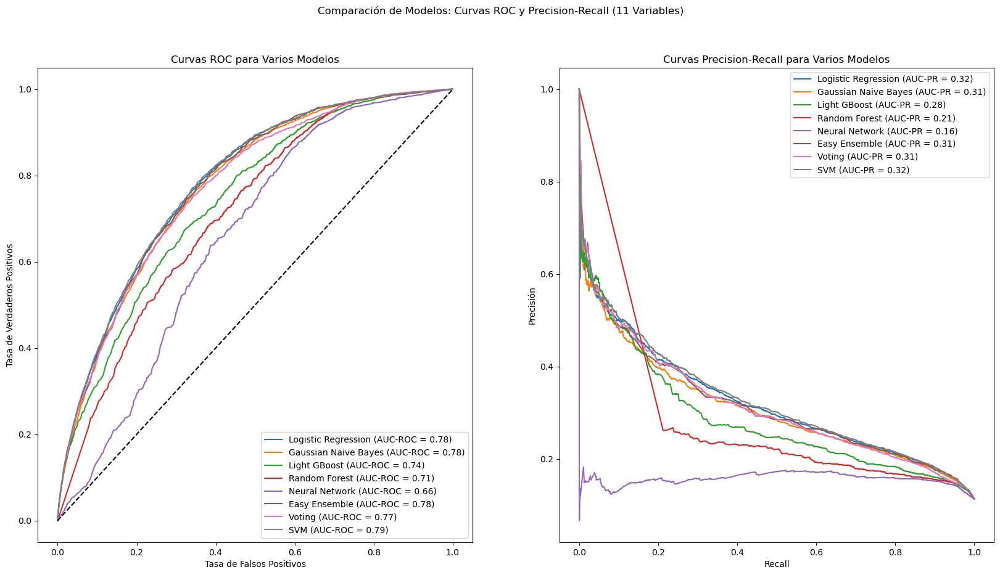

In [186]:
# Graficar curvas de rendimiento para los modelos con 11 variables
graficar_curvas_rendimiento(roc_data_11vars, pr_data_11vars, 
                            'Comparación de Modelos: Curvas ROC y Precision-Recall (11 Variables)')

### EXPLICABILIDAD

#### SHAP values

Valores SHAP para Logistic Regression:


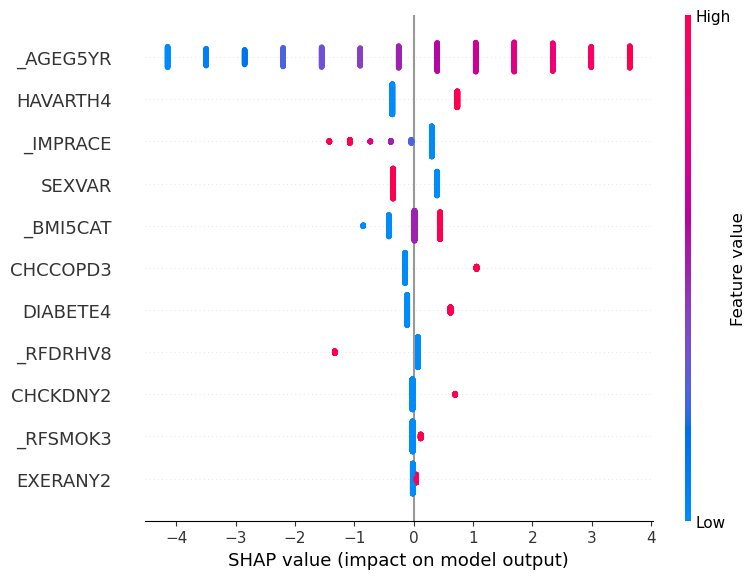

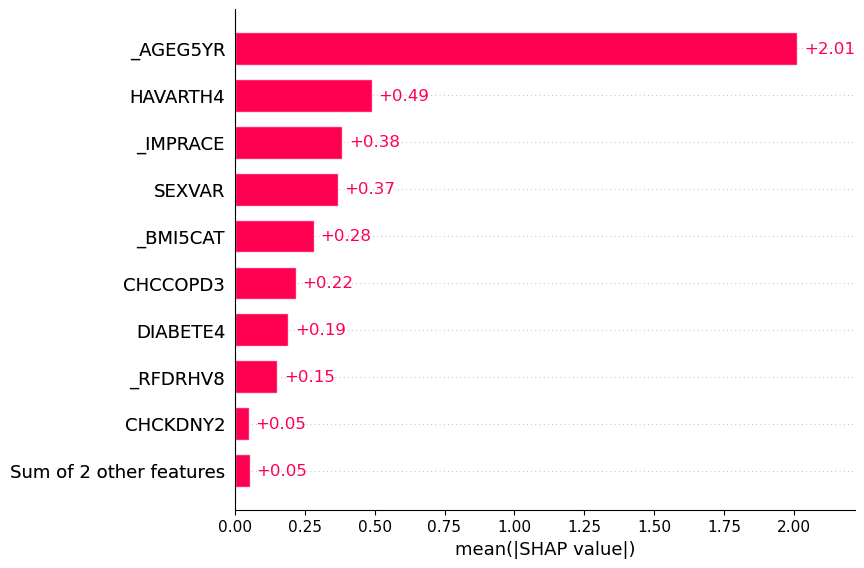

Valores SHAP para Gaussian Naive Bayes:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:12<00:00,  1.33s/it]


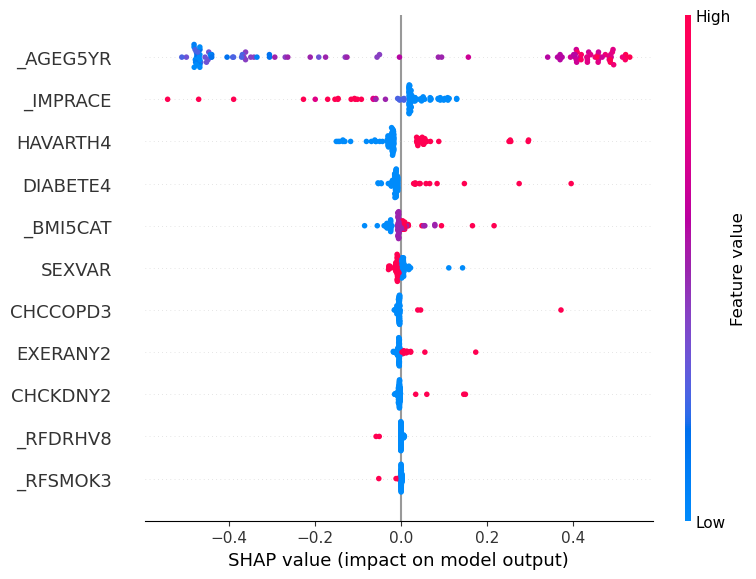

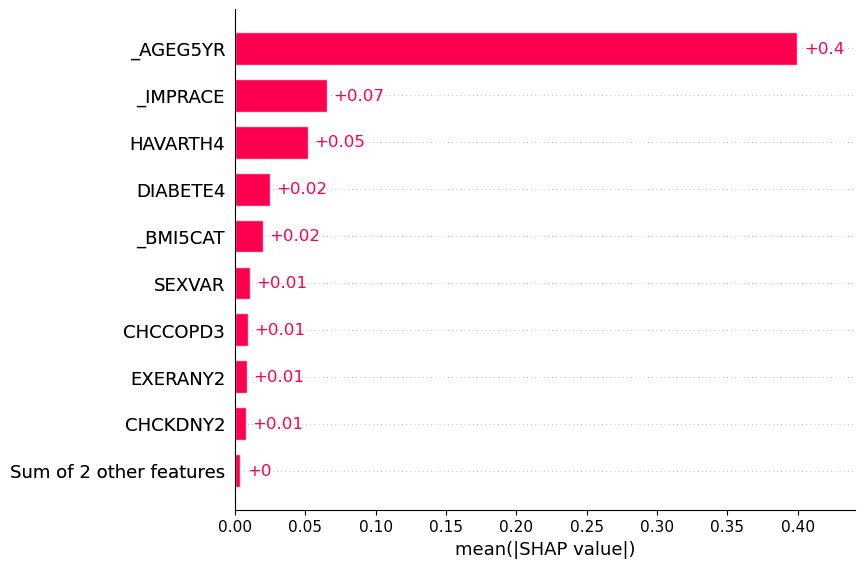

Valores SHAP para Light GBoost:


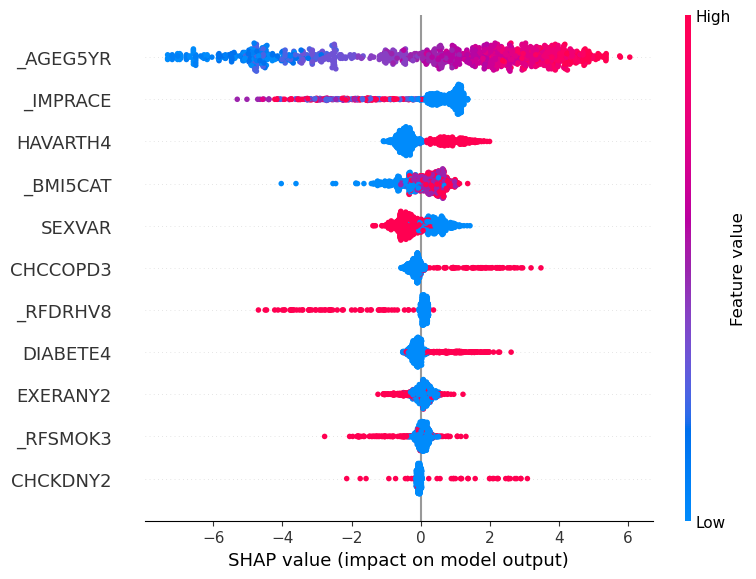

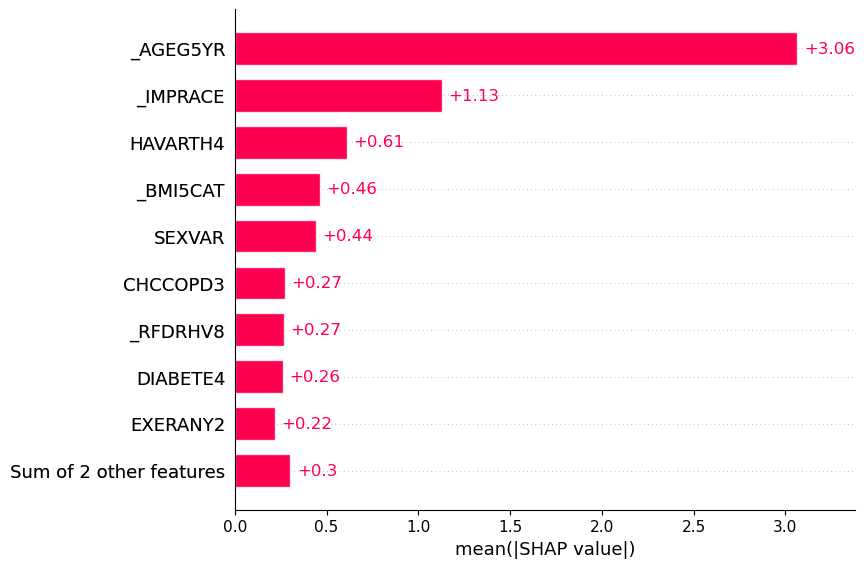

Valores SHAP para Random Forest:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [04:02<00:00,  3.23s/it]


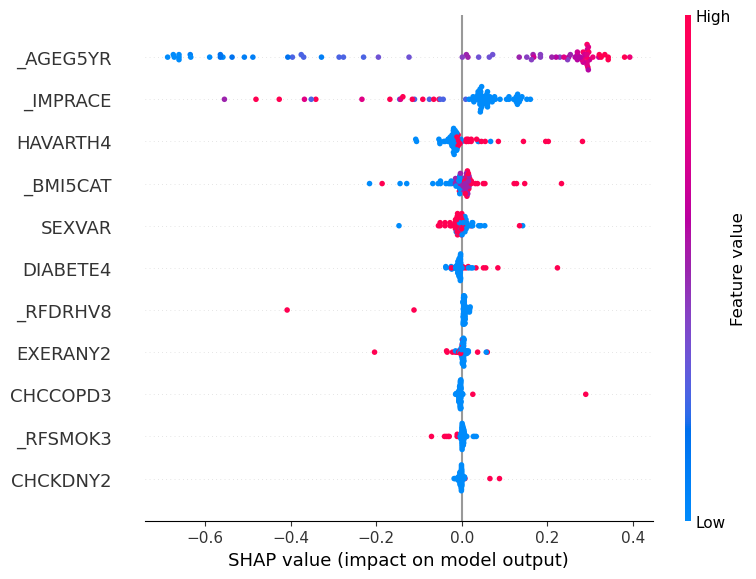

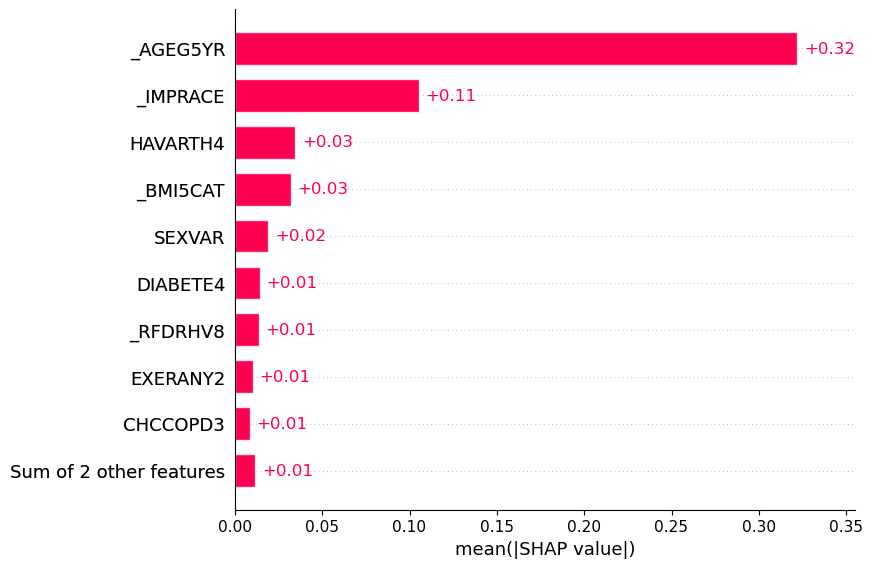

Valores SHAP para Neural Network:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [03:41<00:00,  2.95s/it]


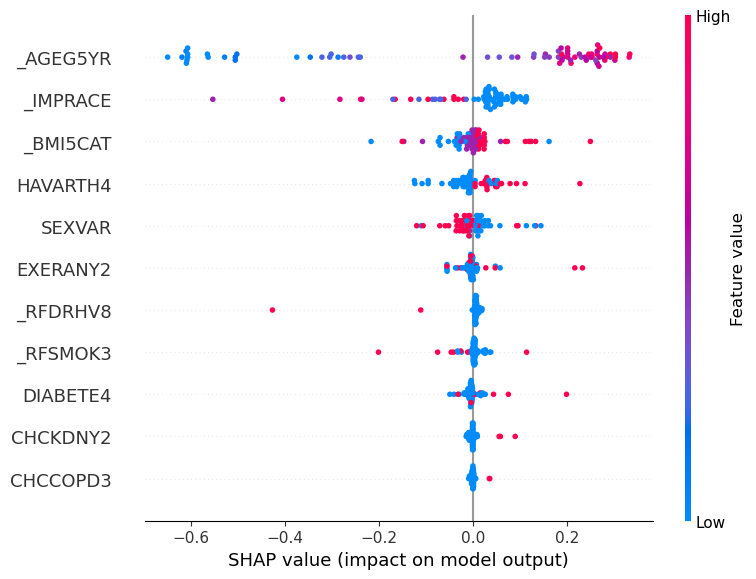

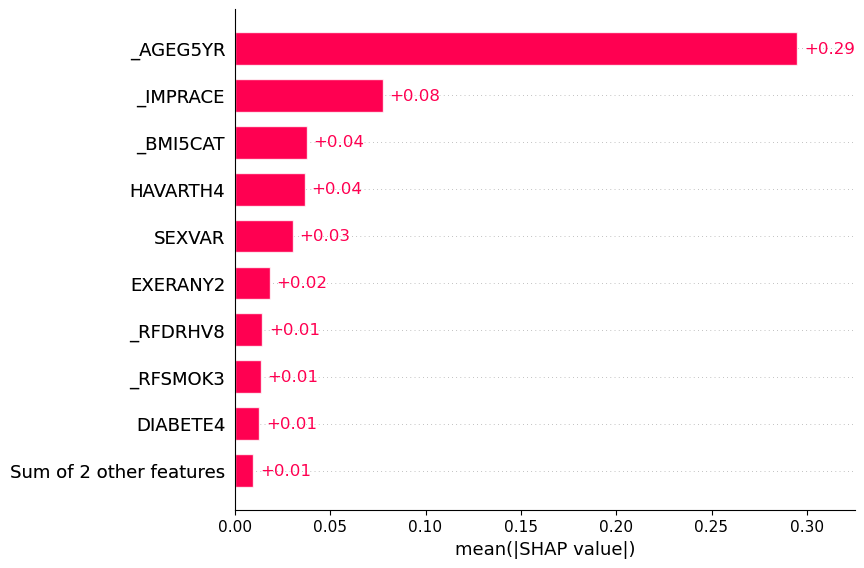

Valores SHAP para Easy Ensemble:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [03:45<00:00,  4.51s/it]


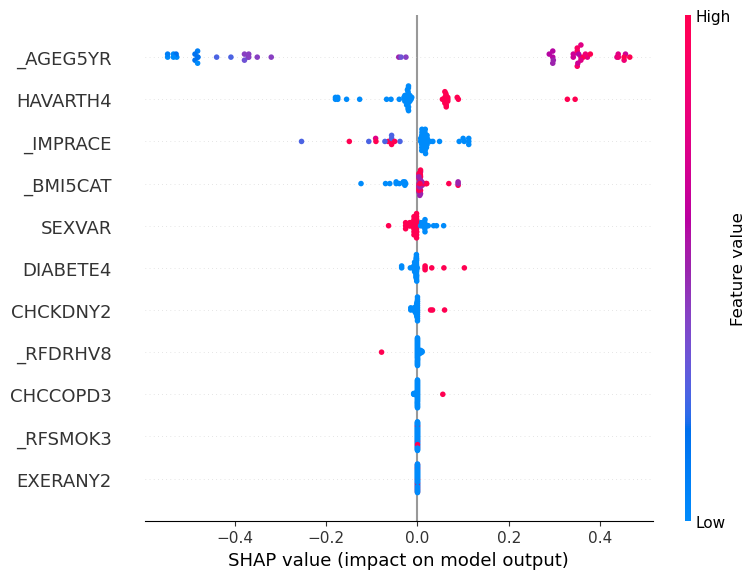

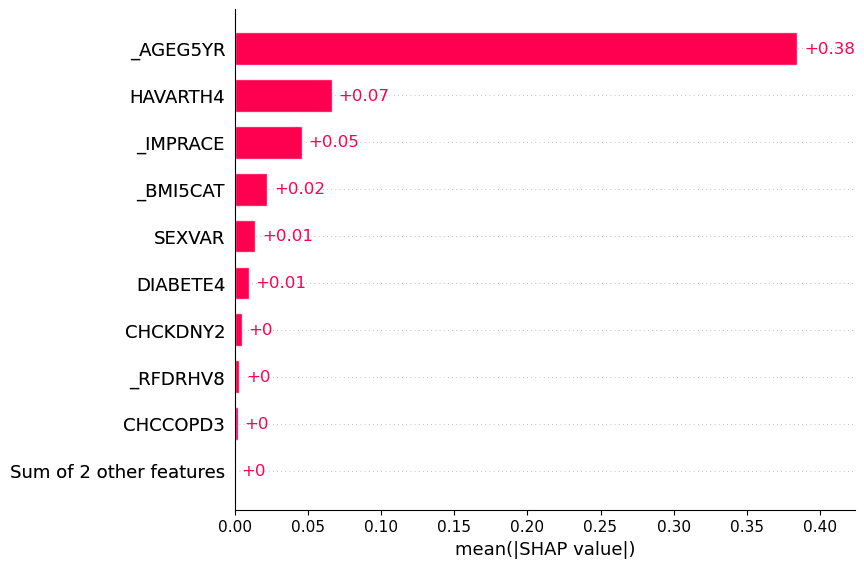

Valores SHAP para Voting:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [06:23<00:00,  7.66s/it]


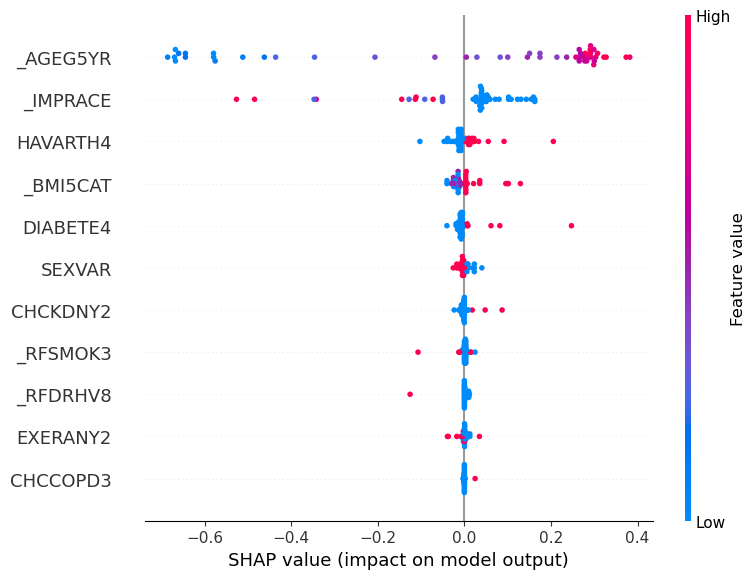

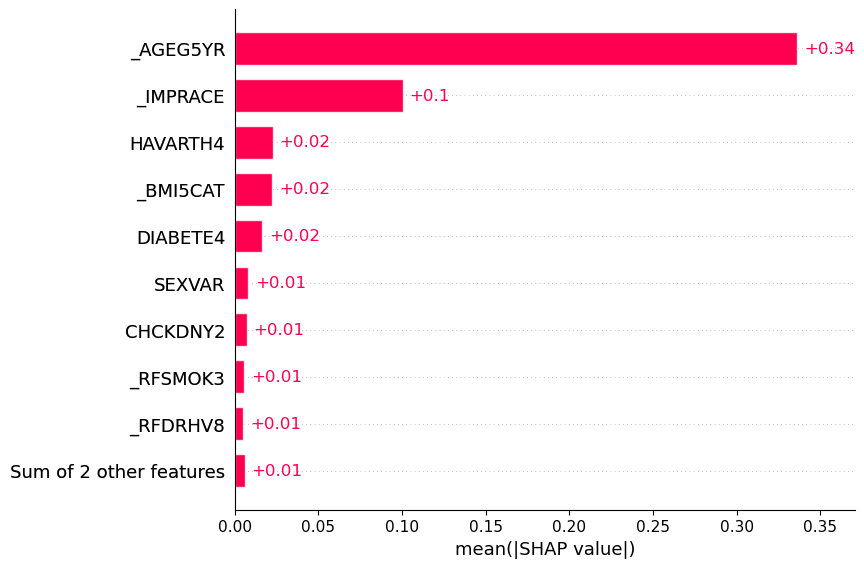

Valores SHAP para SVM:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:07<00:00,  1.28s/it]


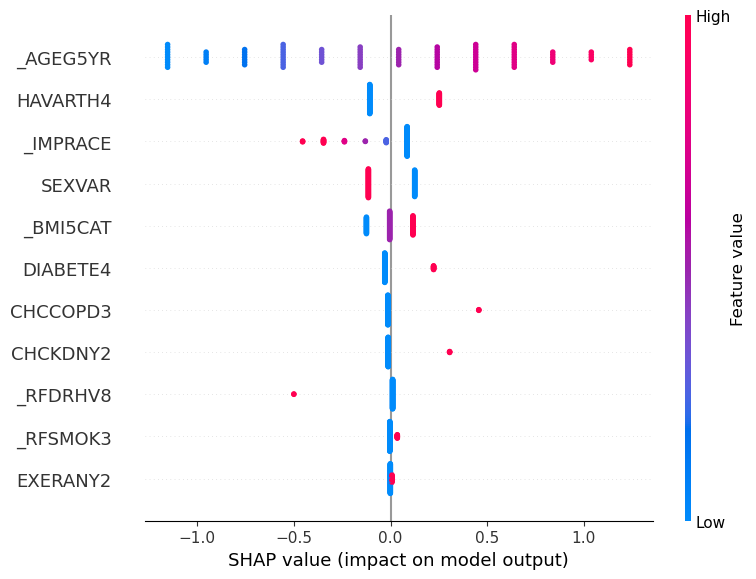

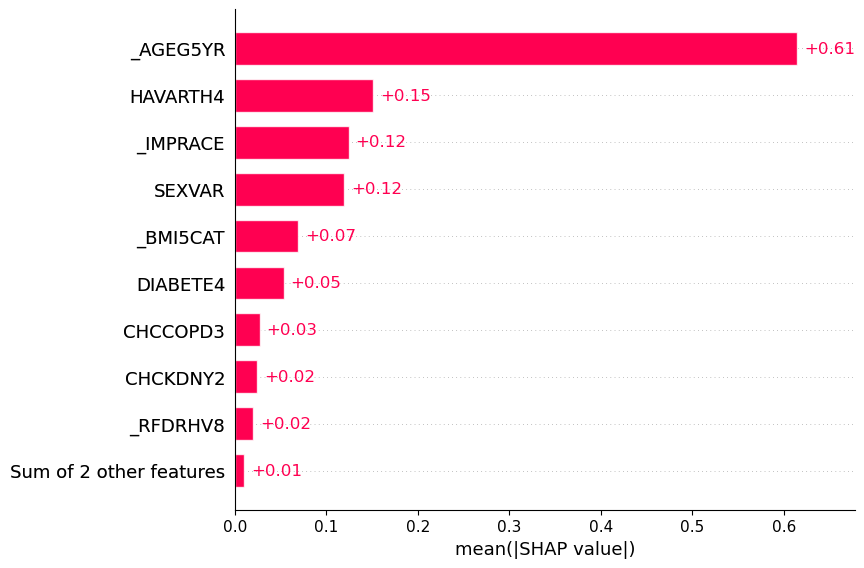

In [187]:
# Diccionario para mapear los tipos de modelo a sus correspondientes objetos explainer de SHAP
explainer_dict = {
    LogisticRegression: shap.LinearExplainer,
    GaussianNB: shap.KernelExplainer,
    LGBMClassifier: shap.TreeExplainer,
    RandomForestClassifier: shap.KernelExplainer,
    MLPClassifier: shap.KernelExplainer,
    EasyEnsembleClassifier: shap.KernelExplainer,
    VotingClassifier: shap.KernelExplainer,
    LinearSVC: shap.KernelExplainer    
    
}

# Diccionario para mapear los nombres de los modelos a sus correspondientes tamaños de muestra
sample_sizes = {
    'Logistic Regression': 1000,
    'Gaussian Naive Bayes': 100,
    'Light GBoost': 1000,
    'Random Forest': 75,
    'Neural Network': 75,
    'Easy Ensemble': 50,
    'SVM': 100,
    'Voting': 50
}

# Iterar sobre los modelos optimizados para graficar la importancia de las variables creadas por SHAP
for nombre, modelo in modelos_optimizados:
    print(f"Valores SHAP para {nombre}:")
    
    # Obtener el tamaño de muestra específico para el modelo actual
    sample_size = sample_sizes.get(nombre, 50)  # Valor predeterminado de 50 si no se encuentra el nombre del modelo
    
    # Tomar una muestra aleatoria de los datos de prueba para el cálculo de SHAP
    X_test_sample = shap.utils.sample(X_test, nsamples=sample_size, random_state=42)
    
    explainer_class = explainer_dict.get(type(modelo))
    if explainer_class is None:
        print(f"No se puede calcular los valores SHAP para {nombre}")
        continue
    
    if explainer_class == shap.KernelExplainer:
        if isinstance(modelo, LinearSVC):
            explainer = explainer_class(modelo.decision_function, X_test_sample)
        else:
            explainer = explainer_class(modelo.predict, X_test_sample)
    else:
        explainer = explainer_class(modelo, X_test_sample)
    
    shap_values = explainer(X_test_sample)
    
    # Graficar el Summary Plot de SHAP
    shap.summary_plot(shap_values, X_test_sample)
    plt.show()
    
    # Graficar el Bar Plot de SHAP
    shap.plots.bar(shap_values)
    plt.show()

#### Importancia y permutación de características

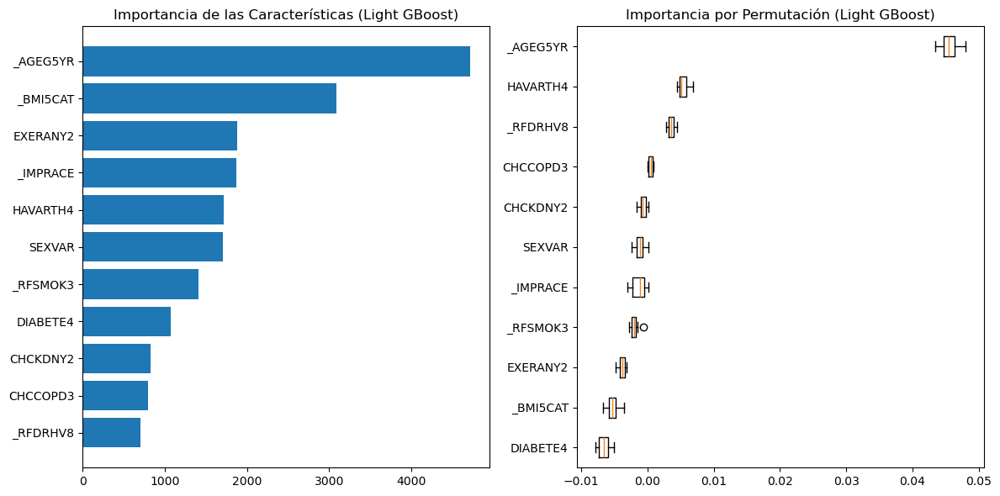

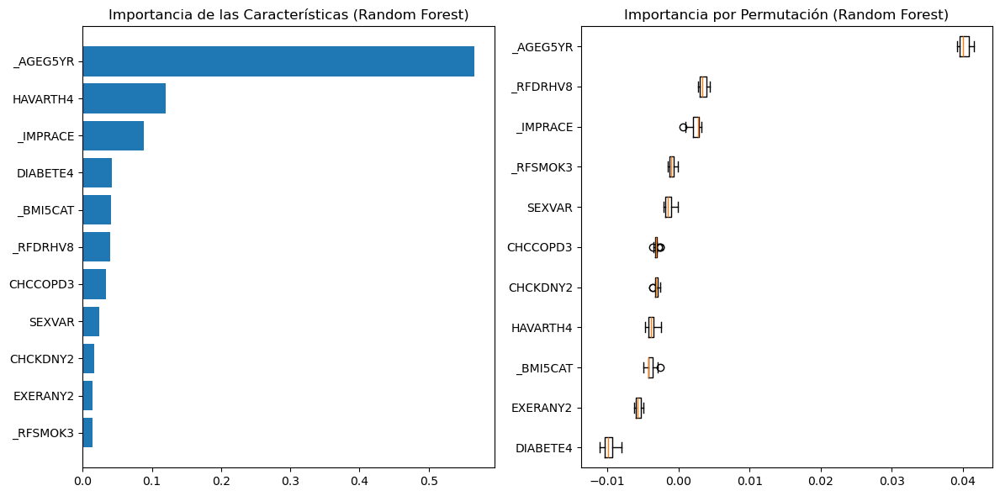

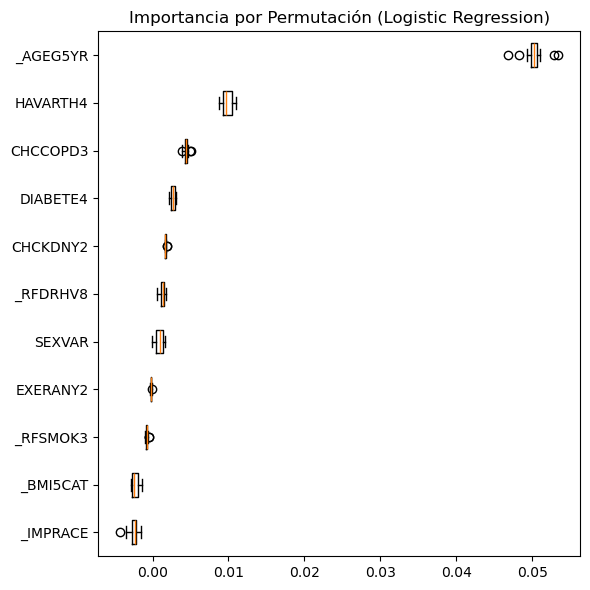

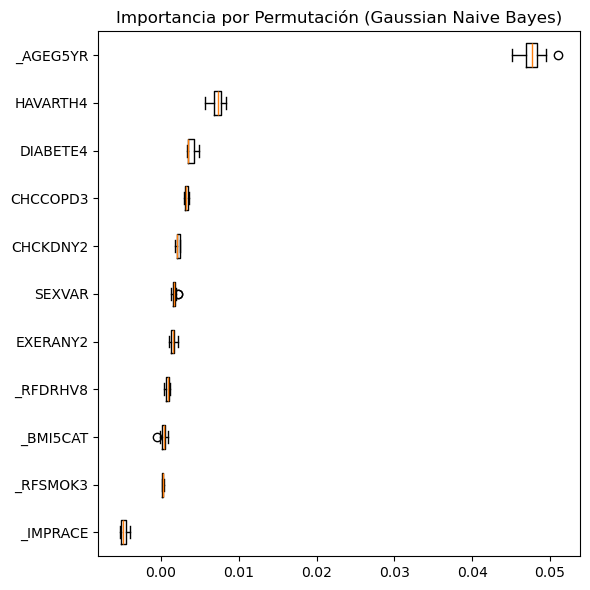

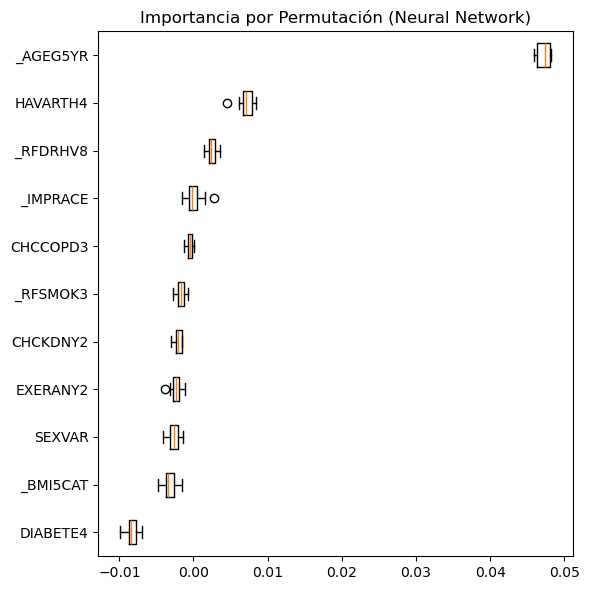

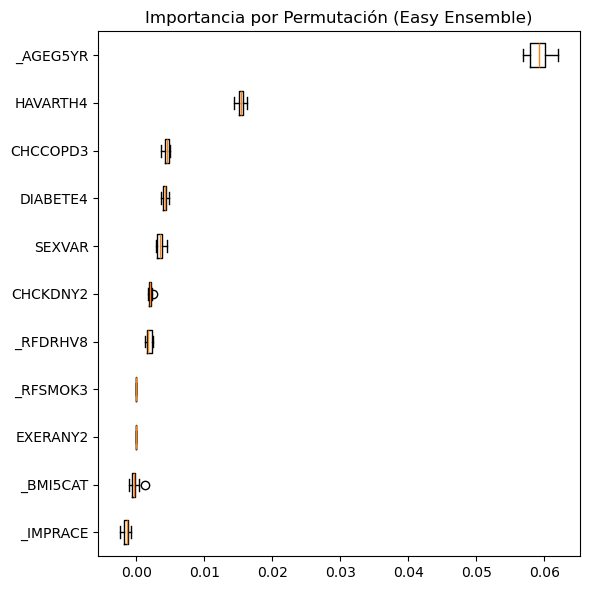

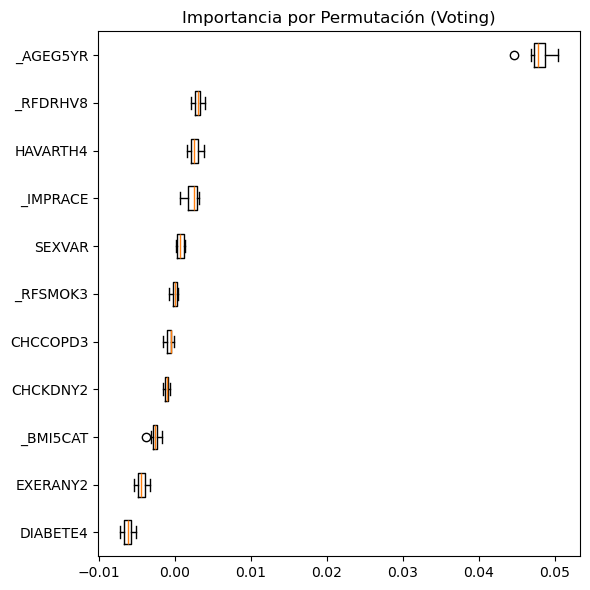

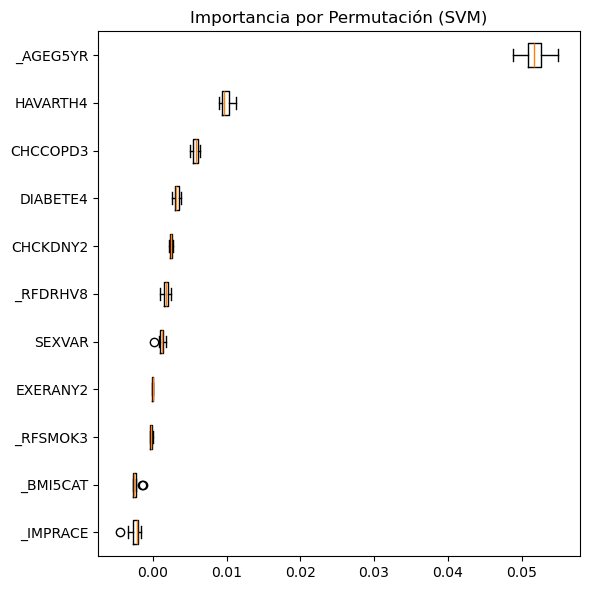

In [188]:
# Graficar importancia y permutación para los modelos con 11 variables
graficar_importancia_permutacion(modelos_optimizados, X_test, y_test, X)
graficar_permutacion_importancia(modelos_optimizados, X_test, y_test, X)

## MODELOS CON TODAS(29) LAS VARIABLES

In [189]:

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/InstanceHardnessThreshold/modelos_iniciales_all"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los modelos base
modelos_base = [
    ('Logistic Regression', LogisticRegression(class_weight='balanced', max_iter=200, random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),
    ('Light GBoost', LGBMClassifier(class_weight='balanced', verbose=-1)),
    ('Random Forest', RandomForestClassifier(class_weight='balanced', n_estimators=500, min_samples_split=2,
                                             max_depth=5, min_samples_leaf=1, random_state=42)),
    ('Neural Network', MLPClassifier(early_stopping=True, random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble = [   
    ('Voting', VotingClassifier(estimators=modelos_base, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(class_weight='balanced', C=100.0, random_state=42, dual=False))
]

# Combinar todos los modelos
modelos = modelos_base + modelos_ensamble

# Crear el objeto de la técnica de muestreo InstanceHardnessThreshold
tecnica_muestreo = InstanceHardnessThreshold(random_state=42)

# Entrenar y evaluar modelos con todas las variables
resultados_allvars, X, X_train, y_train, X_val, y_val, X_test, y_test = entrenar_evaluar_modelos_base(
    df, modelos, carpeta_modelos, tecnica_muestreo)


Dimensiones del conjunto de entrenamiento:
X_train: (91485, 29), y_train: (91485,)

Dimensiones del conjunto de validación:
X_val: (53095, 29), y_val: (53095,)

Dimensiones del conjunto de prueba:
X_test: (53096, 29), y_test: (53096,)

Tiempo de muestreo: 2.46 minutos

Modelo Logistic Regression cargado desde archivo.
Entrenamiento Logistic Regression:
Tiempo de ejecución: 0.02 minutos
Accuracy: 0.9393015248401377
F1-score: 0.9027955257583979
Precision: 0.886943661002958
Recall: 0.9192243253840944
AUC-ROC: 0.9792451371942997
Matthews Corr Coef: 0.8589795865493813

MATRIZ DE CONFUSIÓN:
[[60145  3287]
 [ 2266 25787]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.96      0.95      0.96     63432
           1       0.89      0.92      0.90     28053

    accuracy                           0.94     91485
   macro avg       0.93      0.93      0.93     91485
weighted avg       0.94      0.94      0.94     91485



Test Logistic Regress

### Tabla de métricas de rendimiento modelos base

In [190]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_allvars_inicial = pd.DataFrame.from_dict(resultados_allvars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_allvars_inicial

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.556049,0.319476,0.193286,0.920326,0.819253,0.273261,0.021443
Gaussian Naive Bayes,0.633551,0.330016,0.208085,0.797073,0.749369,0.261985,0.001033
Light GBoost,0.552113,0.318108,0.192184,0.922655,0.821488,0.271933,0.008630
Random Forest,0.582869,0.328930,0.201097,0.902861,0.812329,0.281974,0.175476
Neural Network,0.612419,0.341619,0.211487,0.888057,0.820843,0.295225,0.514582
Easy Ensemble,0.552452,0.317685,0.191983,0.920160,0.815644,0.270749,0.295070
Voting,0.593548,0.333199,0.204607,0.896873,0.816435,0.286264,0.573896
SVM,0.557537,0.319891,0.193649,0.918995,0.818991,0.273515,0.007405


### BÚSQUEDA DE HIPERPARÁMETROS

In [191]:

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/InstanceHardnessThreshold/modelos_entrenados_all"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)


In [192]:

# Definir los espacios de búsqueda de hiperparámetros para cada modelo
param_dist_lr = {
    'class_weight': ['balanced', None],
    'solver': ['newton-cg', 'newton-cholesky', 'sag', 'saga'],
    'penalty': ['l2'],
    'C': loguniform(1e-4, 1e1)
}

param_dist_gnb = {
    'var_smoothing': loguniform(1e-9, 1e-1)
}

param_dist_lgbm = {
    'class_weight': ['balanced', None],
    'n_estimators': randint(50, 251),
    'max_depth': randint(3, 31),
    'subsample': uniform(0.7, 0.3),
    'colsample_bytree': uniform(0.7, 0.3),
    'learning_rate': loguniform(1e-5, 1e-1),
    'num_leaves': randint(10, 101),
    'verbose': [-1]
}

param_dist_rf = {
    'class_weight': ['balanced_subsample', 'balanced'],
    'n_estimators': randint(50, 251),
    'criterion': ['gini', 'entropy'],
    'max_depth': randint(3, 16),
    'min_samples_leaf': randint(3, 16),
    'min_samples_split': randint(3, 16),
    'max_features': [None, 'sqrt', 'log2']
}

param_dist_ann = {
    'hidden_layer_sizes': [(100,), (50,50), (100,100), (50, 50, 50),
                           (100, 100, 100), (50, 50, 50, 50), (100, 100, 100, 100),
                           (50, 50, 50, 50, 50), (100, 100, 100, 100, 100)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': loguniform(1e-5, 1e3),
    'batch_size': [64, 128, 256, 512],
    'learning_rate': ['constant', 'adaptive'],
    'learning_rate_init': loguniform(1e-5, 1e-1),
    'early_stopping': [True],
    'max_iter': [100]
}

param_dist_eec = {
    'n_estimators': randint(2, 20),
    'sampling_strategy': ['auto']
}

param_dist_svm = {
    'dual': ['auto'],
    'tol': loguniform(1e-5, 1e-3),
    'class_weight': [None, 'balanced'],
    'penalty': ['l2'],
    'loss': ['hinge', 'squared_hinge'],
    'C': loguniform(1e-4, 1e4),
    'max_iter': randint(1000, 2001)
}

# Definir los modelos con búsqueda de hiperparámetros
modelos = [
    ('Logistic Regression', RandomizedSearchCV(LogisticRegression(), param_dist_lr,
                                               cv=30, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Gaussian Naive Bayes', RandomizedSearchCV(GaussianNB(), param_dist_gnb, cv=30,
                                                n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('Light GBoost', RandomizedSearchCV(LGBMClassifier(), param_dist_lgbm, cv=5, n_jobs=6,
                                        scoring='f1_weighted', n_iter=50)),
    ('Random Forest', RandomizedSearchCV(RandomForestClassifier(), param_dist_rf,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Neural Network', RandomizedSearchCV(MLPClassifier(), param_dist_ann, cv=5, n_jobs=6,
                                          scoring='f1_weighted', error_score=0, n_iter=50)),
    ('Easy Ensemble', RandomizedSearchCV(EasyEnsembleClassifier(), param_dist_eec,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('SVM', RandomizedSearchCV(LinearSVC(), param_dist_svm, cv=5, n_jobs=6,
                               scoring='f1_weighted', n_iter=50))
]

# Crear un diccionario para almacenar los mejores hiperparámetros de cada modelo
best_params_all = {}

# Entrenar y evaluar cada modelo con búsqueda de hiperparámetros
for nombre, modelo in modelos:
    nombre_archivo = f"{carpeta_modelos}/{nombre}_optimizado.pkl"
    
    # Hash del conjunto de datos actual
    hash_actual = hash_de_datos(X_train)
    
    # Cargar o entrenar modelo
    modelo_cargado, tiempo_ejecucion, mejores_parametros_cargados = cargar_modelo(nombre_archivo, hash_actual)
    
    if modelo_cargado is not None:
        print(f"Modelo {nombre} cargado desde archivo.")
        modelo_best_all = modelo_cargado
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros_cargados}")
        # Agregar los mejores hiperparámetros cargados al diccionario
        best_params_all[nombre] = mejores_parametros_cargados
    else:
        print(f"Entrenando nuevo modelo {nombre}.")
        inicio = time.time()  # Tiempo de inicio
        modelo.fit(X_train, y_train)
        
        mejores_parametros = modelo.best_params_
        
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros}")
        
        # Agregar los mejores hiperparámetros al diccionario
        best_params_all[nombre] = modelo.best_params_
        
        # Entrenar el modelo con los mejores hiperparámetros en el conjunto de entrenamiento completo
        modelo_best_all = modelo.best_estimator_
        modelo_best_all.fit(X_train, y_train)
        
        fin = time.time()  # Tiempo de fin
        tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos
        
        # Guardar el modelo entrenado junto con el tiempo de ejecución y los mejores parámetros
        guardar_modelo(modelo_best_all, nombre_archivo, hash_actual, tiempo_ejecucion, mejores_parametros)

    # Métricas predicción entrenamiento
    y_pred_train = modelo_best_all.predict(X_train)

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_all, "predict_proba"):
        y_scores = modelo_best_all.predict_proba(X_train)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_all.decision_function(X_train)  # Puntuaciones de decisión
    
    print(f"Entrenamiento {nombre}:")
    print(f"Tiempo de búsqueda de hiperparámetros de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_train, y_pred_train)}")
    print(f"F1-score: {f1_score(y_train, y_pred_train)}")
    print(f"Precision: {precision_score(y_train, y_pred_train)}")
    print(f"Recall: {recall_score(y_train, y_pred_train)}")
    print(f"AUC-ROC: {roc_auc_score(y_train, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_train, y_pred_train)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_train, y_pred_train))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_train, y_pred_train))
    print("\n")

    # Métricas predicción validación
    inicio = time.time()  # Tiempo de inicio
    y_pred_val = modelo_best_all.predict(X_val)
    fin = time.time()  # Tiempo de fin
    tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_all, "predict_proba"):
        y_scores = modelo_best_all.predict_proba(X_val)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_all.decision_function(X_val)  # Puntuaciones de decisión

    
    print(f"Validación {nombre}:")
    print(f"Tiempo de ejecución de predicción de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_val, y_pred_val)}")
    print(f"F1-score: {f1_score(y_val, y_pred_val)}")
    print(f"Precision: {precision_score(y_val, y_pred_val)}")
    print(f"Recall: {recall_score(y_val, y_pred_val)}")
    print(f"AUC-ROC: {roc_auc_score(y_val, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_val, y_pred_val)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_val, y_pred_val))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_val, y_pred_val))
    print("\n")

Modelo Logistic Regression cargado desde archivo.
Mejores hiperparámetros para Logistic Regression: {'solver': 'saga', 'penalty': 'l2', 'class_weight': None, 'C': 0.5}
Entrenamiento Logistic Regression:
Tiempo de búsqueda de hiperparámetros de Logistic Regression: 10.40 minutos
Accuracy: 0.9470951522107449
F1-score: 0.910743923579095
Precision: 0.943453176938066
Recall: 0.8802267137204577
AUC-ROC: 0.979210810447858
Matthews Corr Coef: 0.8742749625171242

MATRIZ DE CONFUSIÓN:
[[61952  1480]
 [ 3360 24693]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.95      0.98      0.96     63432
           1       0.94      0.88      0.91     28053

    accuracy                           0.95     91485
   macro avg       0.95      0.93      0.94     91485
weighted avg       0.95      0.95      0.95     91485



Validación Logistic Regression:
Tiempo de ejecución de predicción de Logistic Regression: 0.00 minutos
Accuracy: 0.6103776250117714
F

### Entrenar modelos con los mejores parámetros

In [193]:

# Combinar los conjuntos de entrenamiento y validación para todas las variables
X_train_val_allvars = pd.concat([X_train, X_val], ignore_index=True)
y_train_val_allvars = pd.concat([y_train, y_val], ignore_index=True)

# Definir los modelos con los mejores hiperparámetros
modelos_entrenados_all = [
    ('Logistic Regression', LogisticRegression(random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),    
    ('Light GBoost', LGBMClassifier(verbosity=-1, random_state=42)),
    ('Random Forest', RandomForestClassifier(random_state=42)),   
    ('Neural Network', MLPClassifier(random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble_all = [   
    ('Voting', VotingClassifier(estimators=modelos_entrenados_all, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(random_state=42)) 
]

# Combinar todos los modelos
modelos_optimizados_all = modelos_entrenados_all + modelos_ensamble_all

# Crear el objeto de la técnica de muestreo InstanceHardnessThreshold
tecnica_muestreo = InstanceHardnessThreshold(random_state=42)

# Entrenar y evaluar modelos con todas las variables
resultados_optimizados_allvars, roc_data, pr_data, modelos_optimizados_all = entrenar_evaluar_modelos(
    X_train_val_allvars, y_train_val_allvars, X_test, y_test, modelos_optimizados_all, best_params_all, carpeta_modelos,
    tecnica_muestreo
)



Tiempo de muestreo: 1.15 minutos

Modelo Logistic Regression cargado desde archivo.
Test Logistic Regression:
Mejores hiperparámetros para Logistic Regression: {'solver': 'saga', 'penalty': 'l2', 'class_weight': None, 'C': 0.5}
Tiempo de ejecución de entrenamiento: 0.07 minutos
Tiempo de ejecución de predicción: 0.00 minutos
Accuracy: 0.507759529908091
F1-score: 0.30087738069762465
Precision: 0.17926813719240087
Recall: 0.9354624085163007
AUC-ROC: 0.8122557556707161
Matthews Corr Coef: 0.2504488863082355

MATRIZ DE CONFUSIÓN:
[[21336 25748]
 [  388  5624]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.98      0.45      0.62     47084
           1       0.18      0.94      0.30      6012

    accuracy                           0.51     53096
   macro avg       0.58      0.69      0.46     53096
weighted avg       0.89      0.51      0.58     53096



Modelo Gaussian Naive Bayes cargado desde archivo.
Test Gaussian Naive Bayes:
Me

### Tabla de métricas de rendimiento con los mejores parámetros

In [194]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_allvars_opt = pd.DataFrame.from_dict(resultados_optimizados_allvars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_allvars_opt

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.507760,0.300877,0.179268,0.935462,0.812256,0.250449,0.073793
Gaussian Naive Bayes,0.598915,0.318615,0.197251,0.828177,0.768263,0.252421,0.000866
Light GBoost,0.457831,0.284635,0.167314,0.952595,0.809199,0.229901,0.016944
Random Forest,0.486816,0.293544,0.173874,0.941617,0.779610,0.240970,0.578661
Neural Network,0.482315,0.292393,0.172966,0.944611,0.808412,0.239974,2.015743
Easy Ensemble,0.501902,0.299844,0.178300,0.941949,0.810162,0.250558,0.148218
Voting,0.495819,0.296969,0.176324,0.940452,0.809739,0.245874,2.133632
SVM,0.515161,0.303358,0.181151,0.932302,0.811111,0.253314,0.032404


### Visualizar comparación de rendimiento de curvas ROC-AUC Y PR-AUC

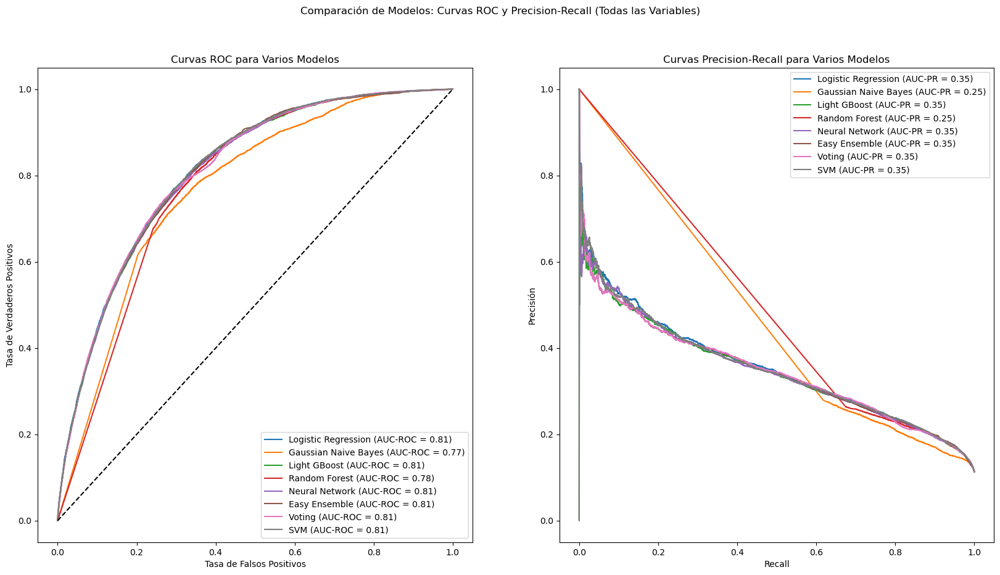

In [195]:
# Graficar curvas de rendimiento para los modelos con todas las variables
graficar_curvas_rendimiento(roc_data, pr_data, 
                            'Comparación de Modelos: Curvas ROC y Precision-Recall (Todas las Variables)')

### EXPLICABILIDAD

#### SHAP values

Valores SHAP para Logistic Regression:


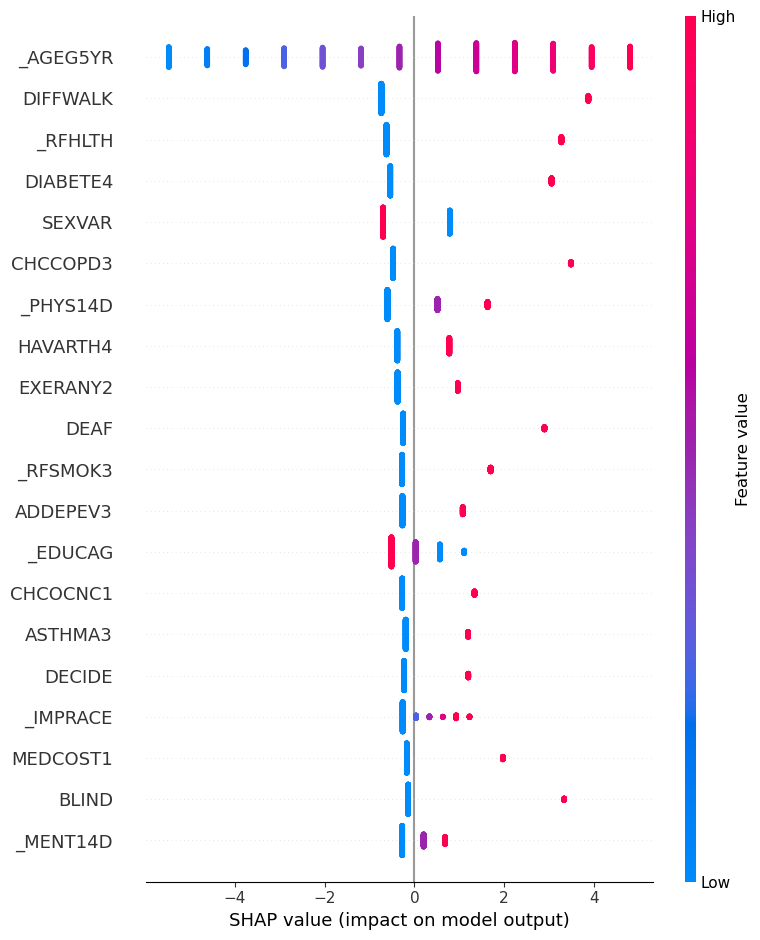

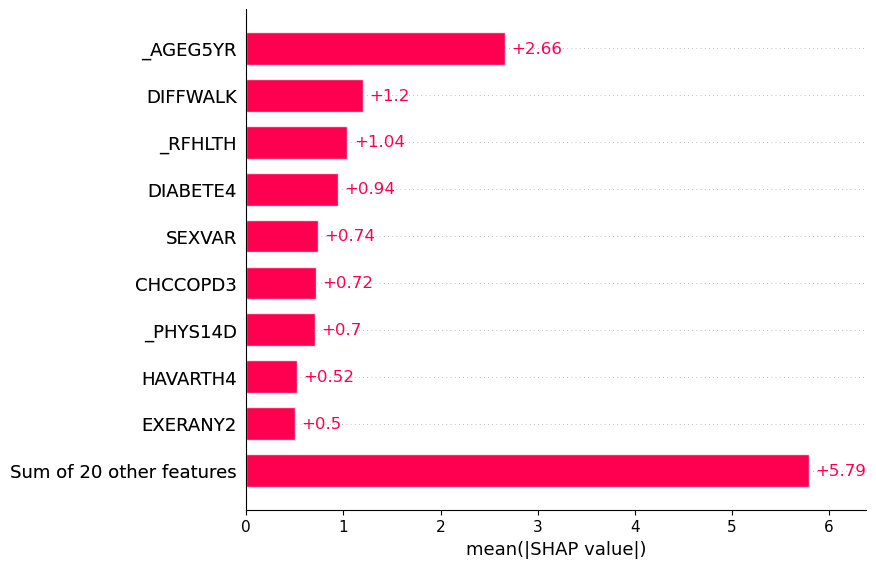

Valores SHAP para Gaussian Naive Bayes:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:34<00:00,  1.55s/it]


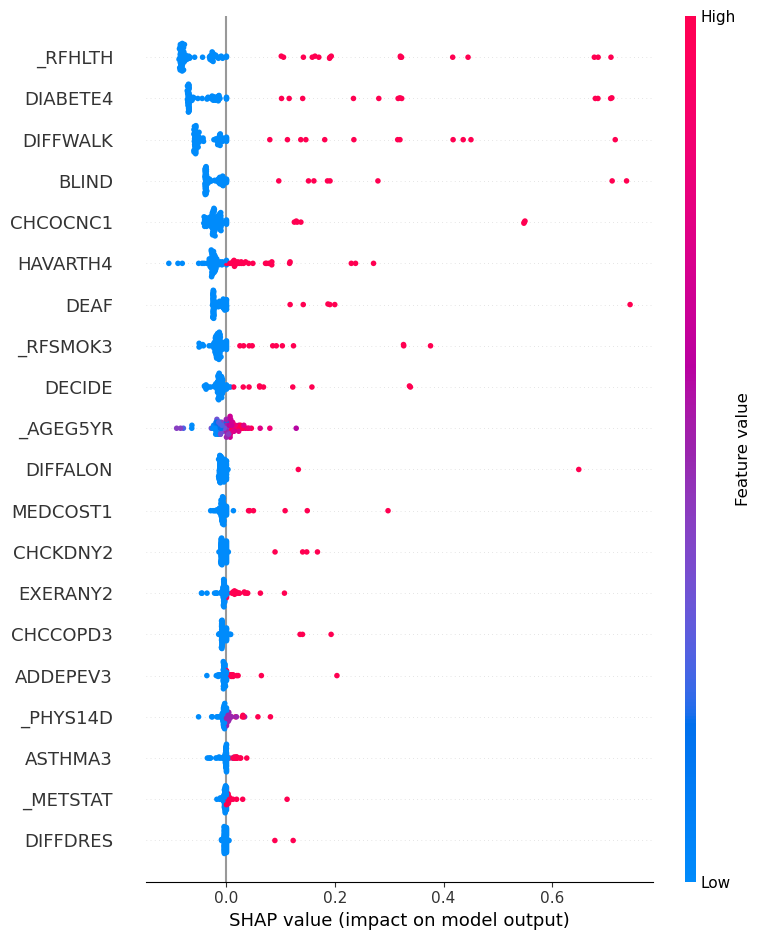

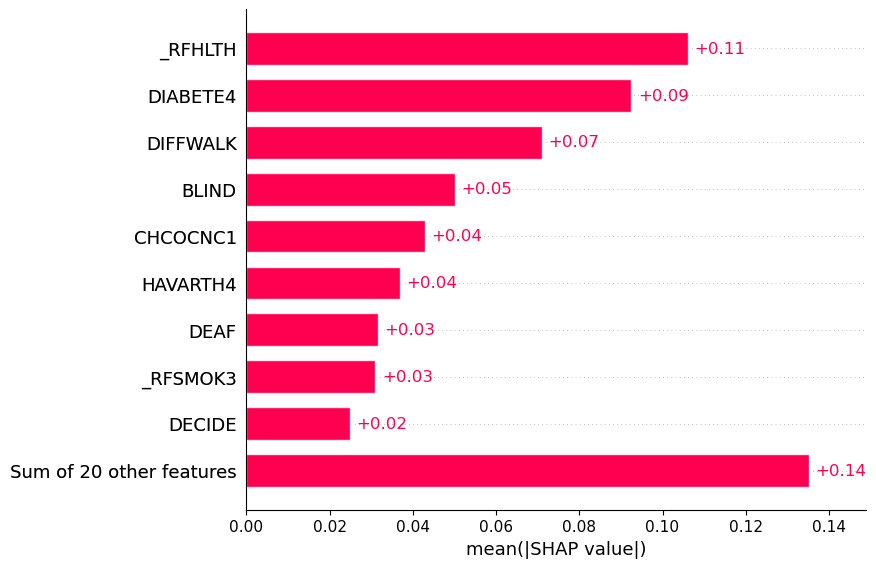

Valores SHAP para Light GBoost:


 92%|==================  | 922/1000 [00:11<00:00]       

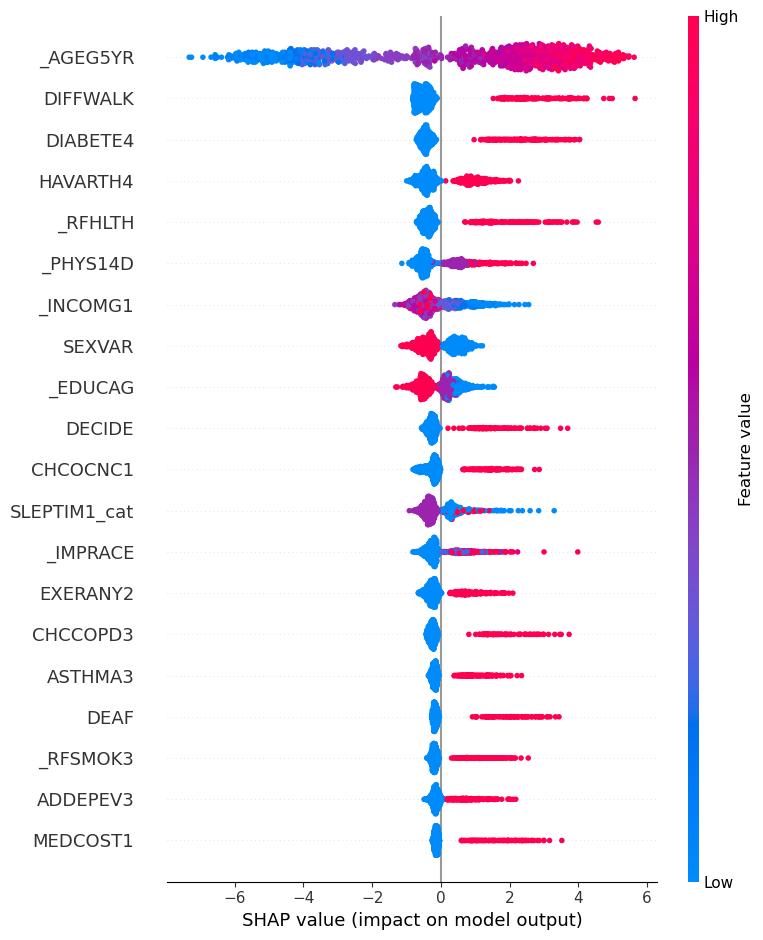

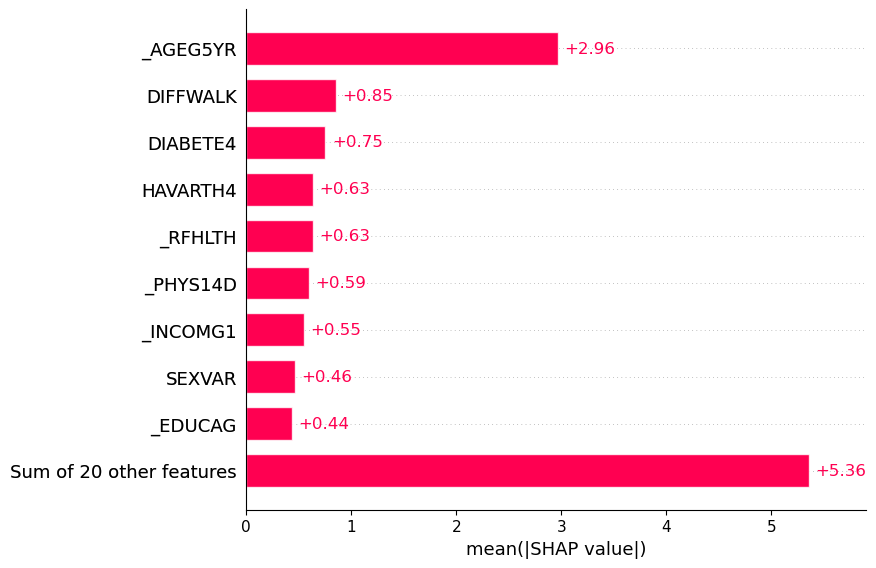

Valores SHAP para Random Forest:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [04:05<00:00,  3.27s/it]


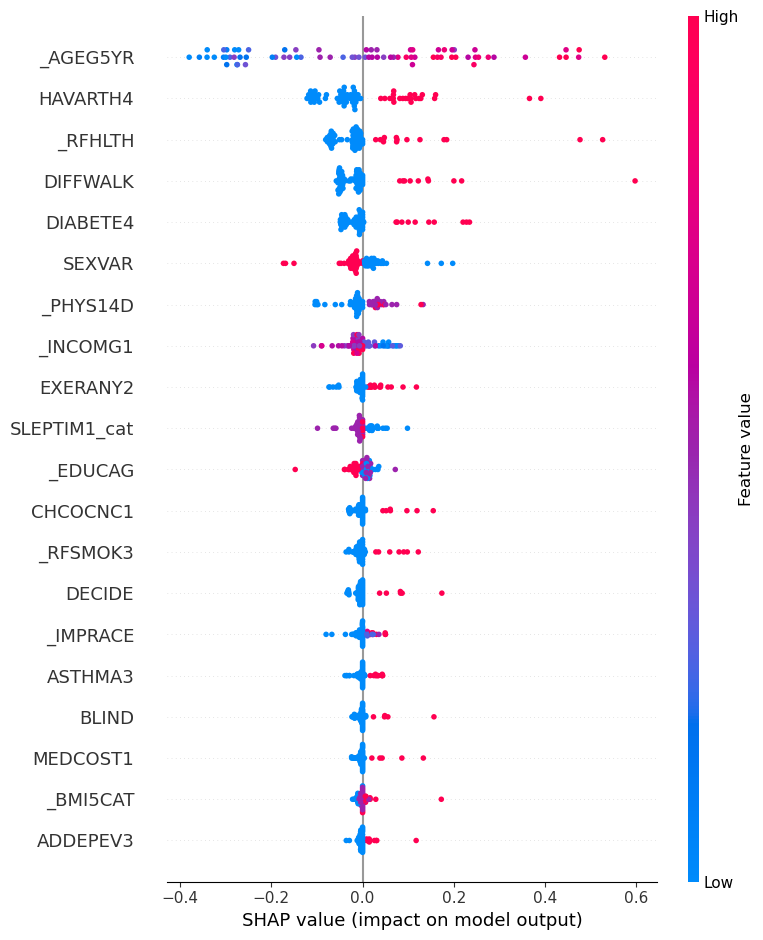

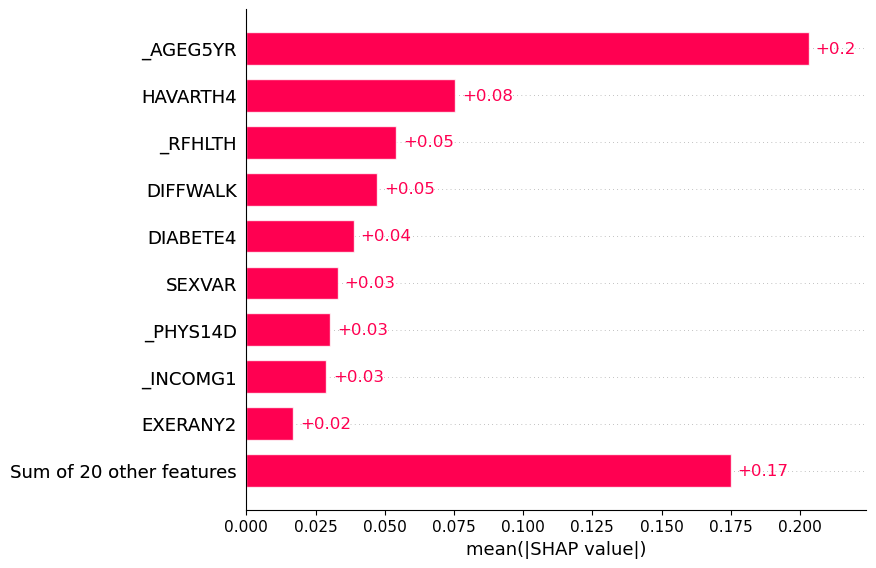

Valores SHAP para Neural Network:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [02:04<00:00,  1.66s/it]


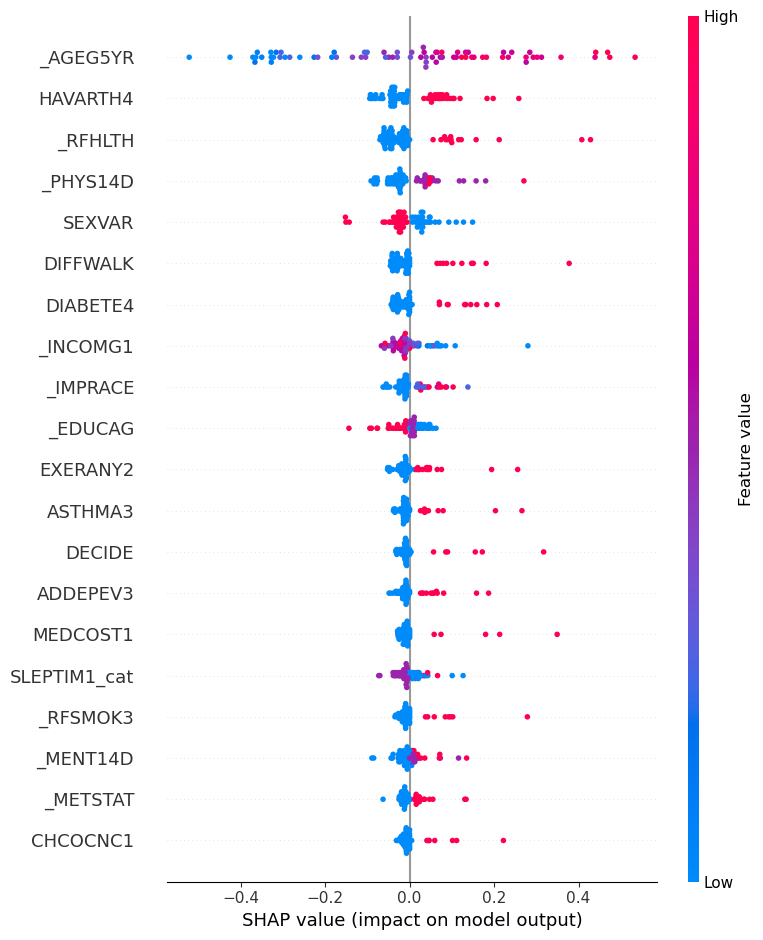

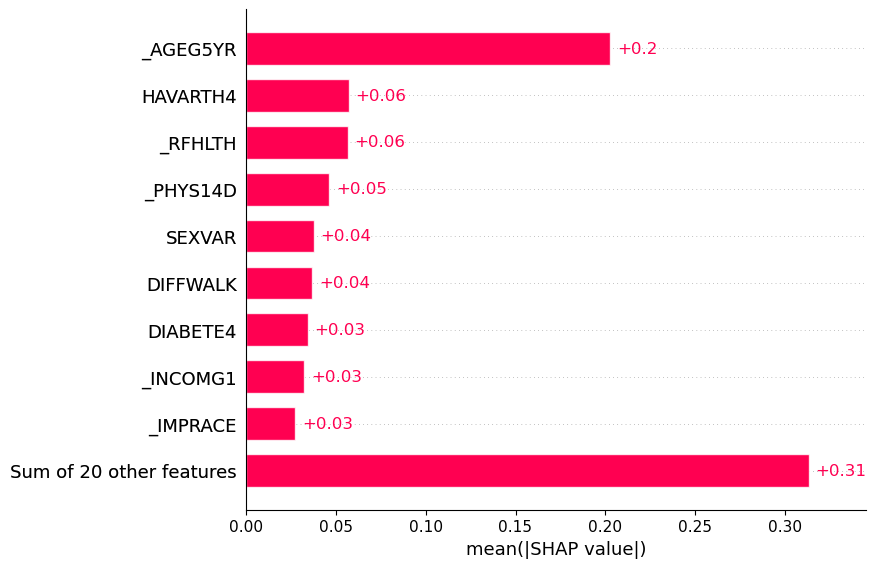

Valores SHAP para Easy Ensemble:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [02:41<00:00,  3.24s/it]


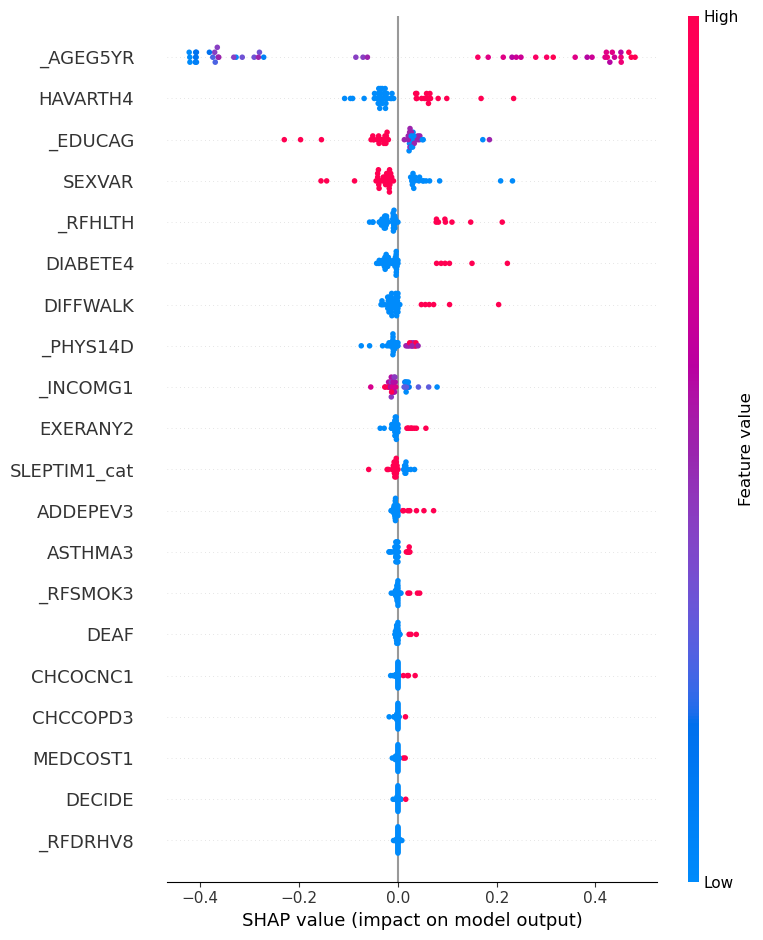

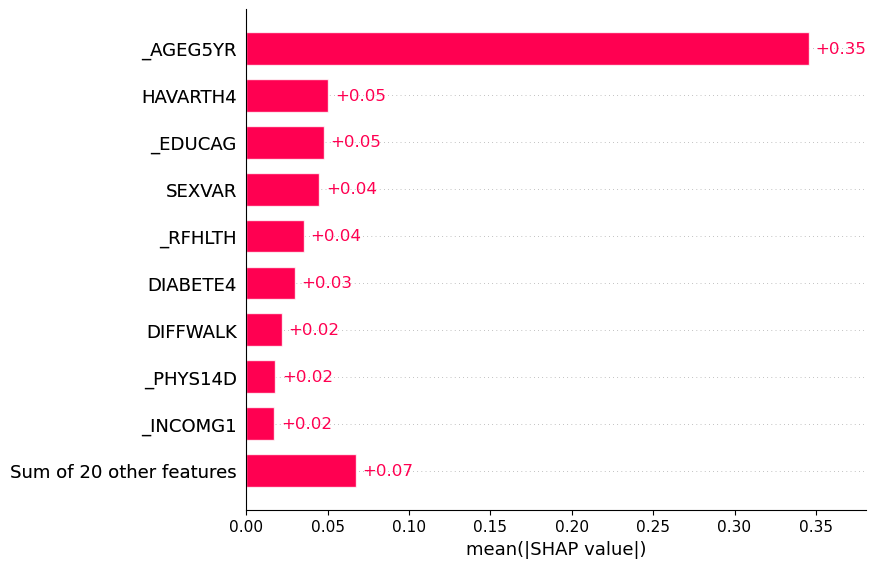

Valores SHAP para Voting:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [04:44<00:00,  5.69s/it]


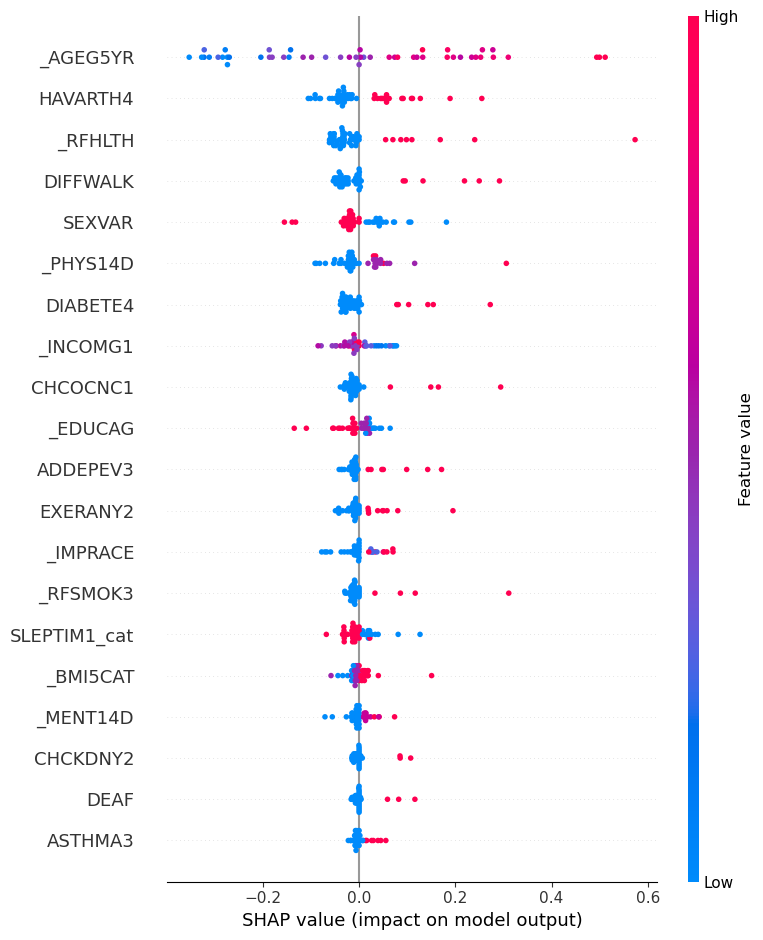

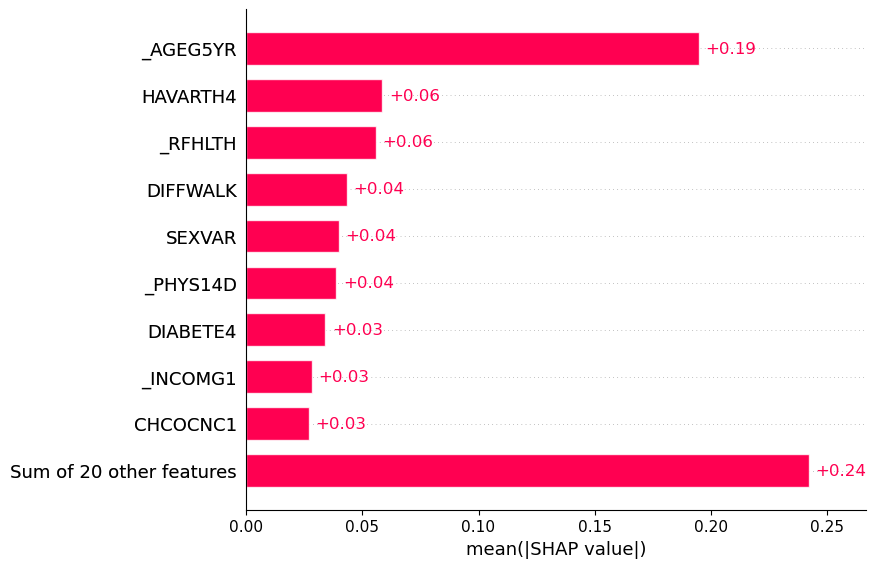

Valores SHAP para SVM:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:27<00:00,  1.48s/it]


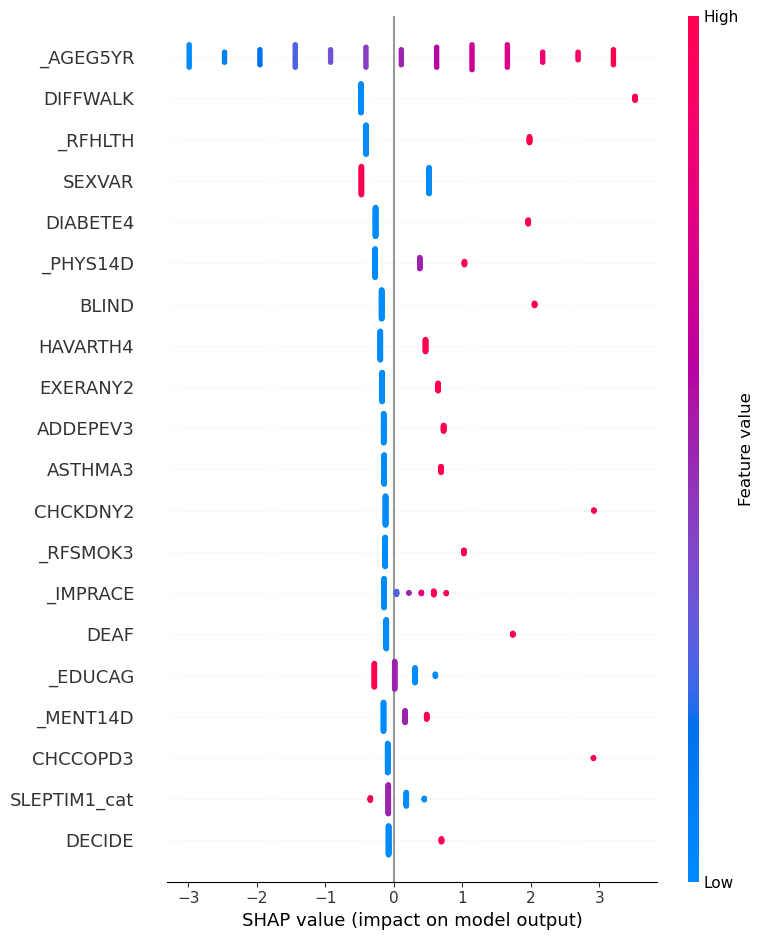

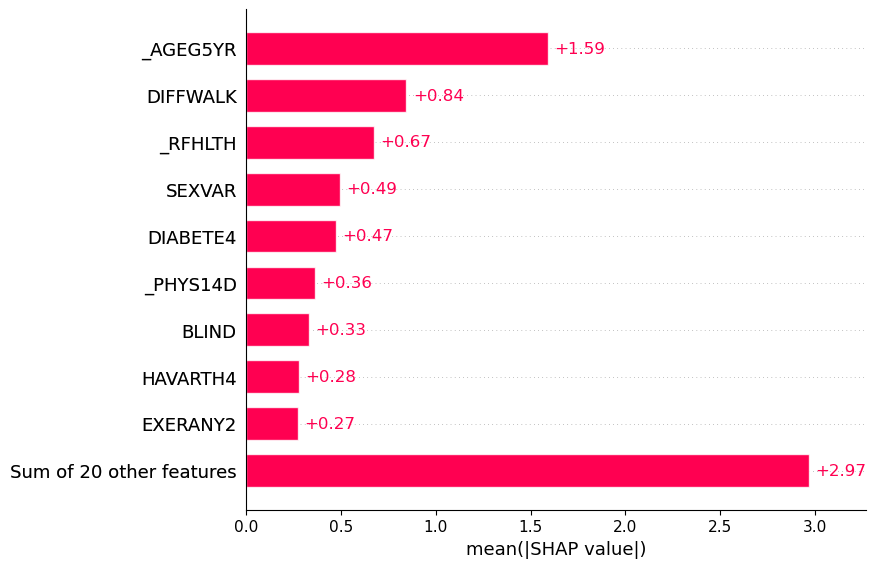

In [196]:
# Iterar sobre los modelos optimizados para graficar la importancia de las variables creadas por SHAP
for nombre, modelo in modelos_optimizados_all:
    print(f"Valores SHAP para {nombre}:")
    
    # Obtener el tamaño de muestra específico para el modelo actual
    sample_size = sample_sizes.get(nombre, 50)  # Valor predeterminado de 50 si no se encuentra el nombre del modelo
    
    # Tomar una muestra aleatoria de los datos de prueba para el cálculo de SHAP
    X_test_sample = shap.utils.sample(X_test, nsamples=sample_size, random_state=42)
    
    explainer_class = explainer_dict.get(type(modelo))
    if explainer_class is None:
        print(f"No se puede calcular los valores SHAP para {nombre}")
        continue
    
    if explainer_class == shap.KernelExplainer:
        if isinstance(modelo, LinearSVC):
            explainer = explainer_class(modelo.decision_function, X_test_sample)
        else:
            explainer = explainer_class(modelo.predict, X_test_sample)
    else:
        explainer = explainer_class(modelo, X_test_sample)
    
    shap_values = explainer(X_test_sample)
    
    # Graficar el Summary Plot de SHAP
    shap.summary_plot(shap_values, X_test_sample)
    plt.show()
    
    # Graficar el Bar Plot de SHAP
    shap.plots.bar(shap_values)
    plt.show()


#### Importancia y permutación de características

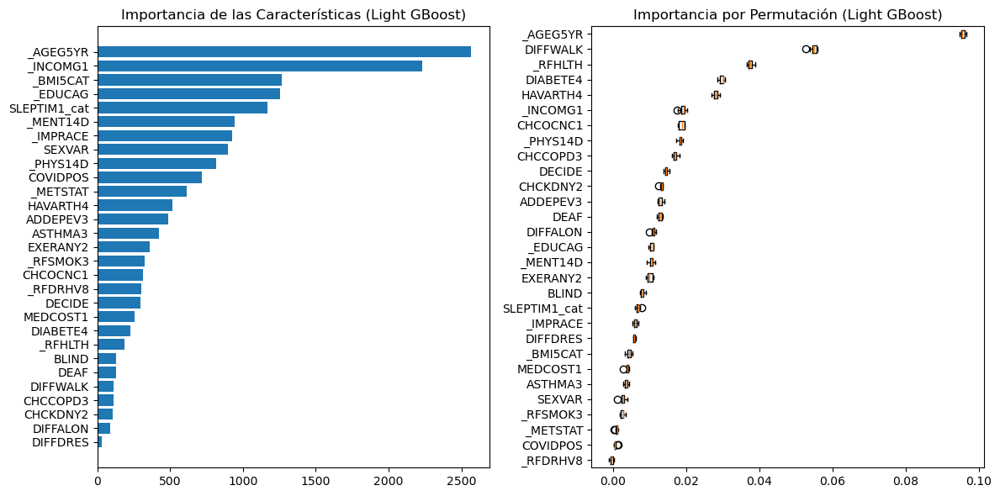

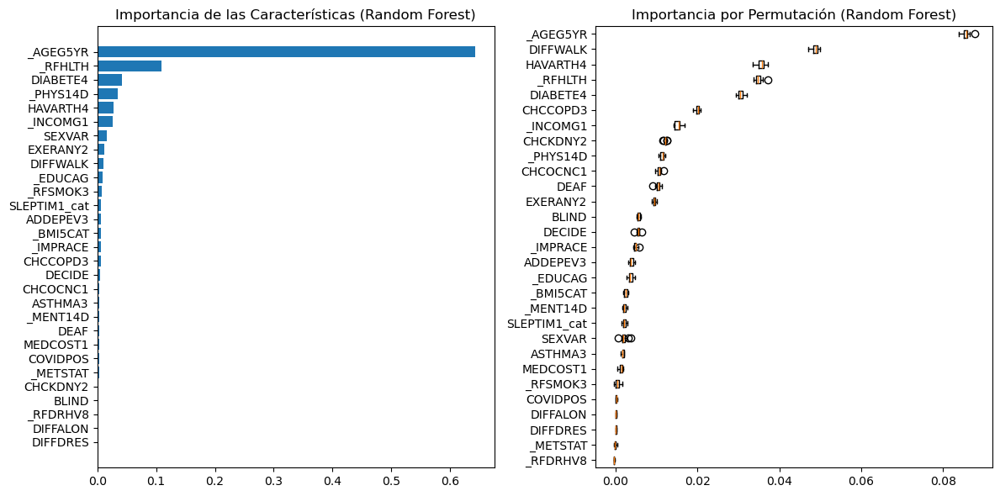

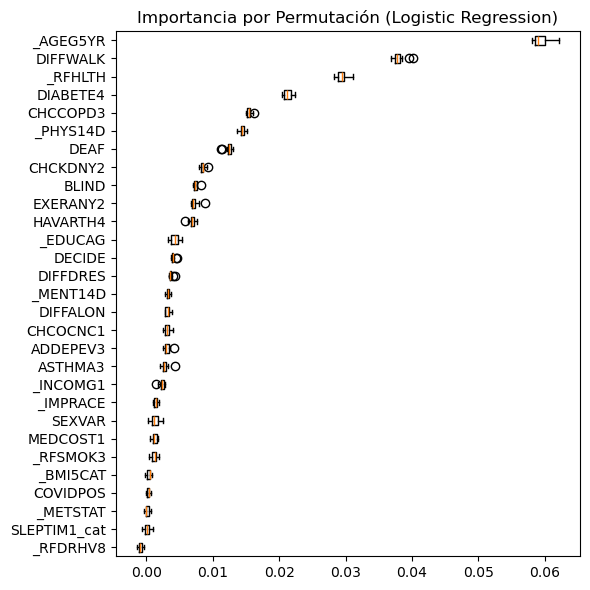

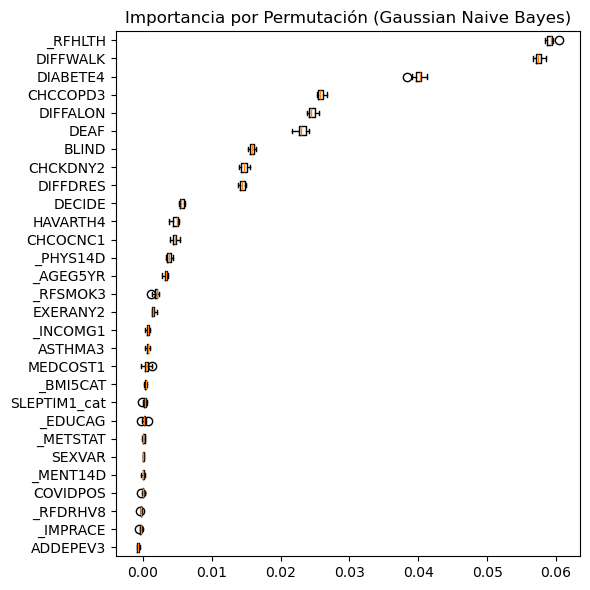

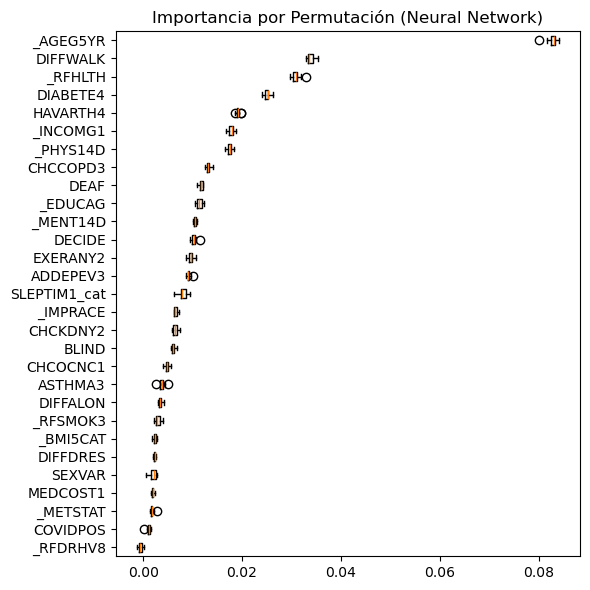

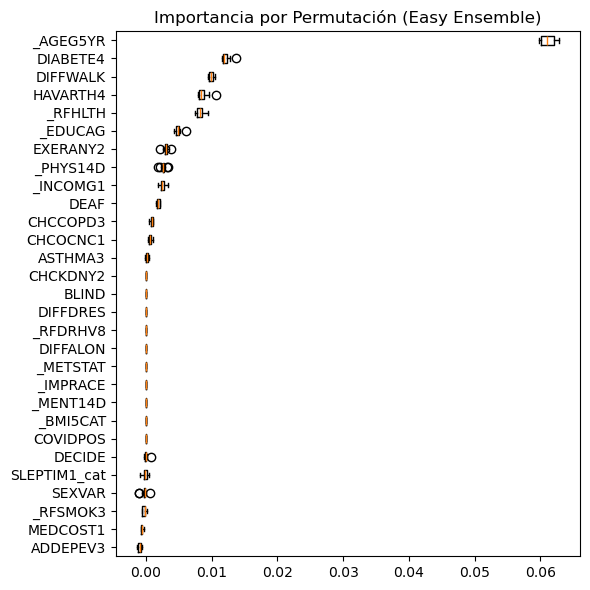

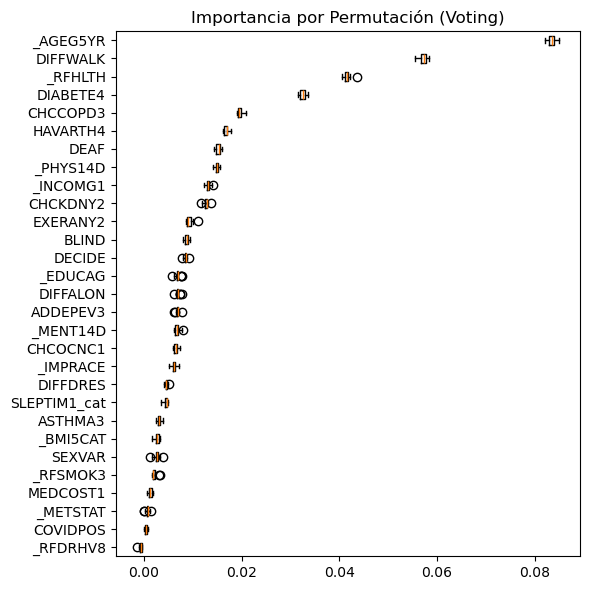

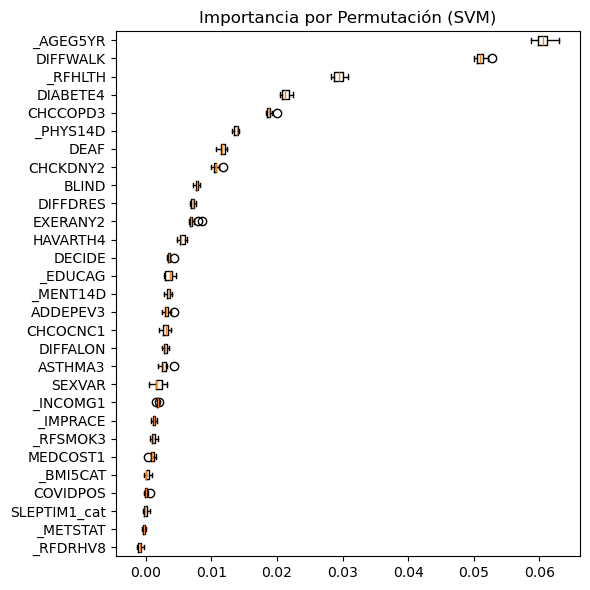

In [197]:
# Graficar importancia y permutación para los modelos con todas las variables
graficar_importancia_permutacion(modelos_optimizados_all, X_test, y_test, X)
graficar_permutacion_importancia(modelos_optimizados_all, X_test, y_test, X)

# ENTRENAMIENTO CON SUBMUESTREO NeighbourhoodCleaningRule()

El capítulo 8 utiliza la técnica de submuestreo NeighbourhoodCleaningRule (NCR), que es otro enfoque para abordar el desequilibrio de clases en conjuntos de datos. NCR se basa en la idea de limpiar el conjunto de datos eliminando instancias de la clase mayoritaria que se consideran ruido o que están demasiado cerca de instancias de la clase minoritaria.


Una de las características clave de NCR es que se enfoca en la eliminación de instancias de la clase mayoritaria que se consideran perjudiciales para el modelo, ya sea porque son ruido o porque están demasiado cerca de instancias de la clase minoritaria. Al eliminar estas instancias, NCR busca mejorar la separabilidad entre las clases y reducir la superposición entre ellas. Además, NCR tiene la ventaja de ser un método de submuestreo que no requiere la generación de nuevas instancias sintéticas, lo que puede ser beneficioso en términos de eficiencia computacional y de preservación de la distribución original de los datos.

## MODELO CON 11 VARIABLES

In [198]:
# Seleccionar las columnas deseadas para crear el nuevo dataset
columnas_seleccionadas = ['SEXVAR', 'EXERANY2', 'CHCCOPD3', 'CHCKDNY2', 
                          'HAVARTH4', 'DIABETE4', '_IMPRACE', '_AGEG5YR',
                          '_BMI5CAT', '_RFSMOK3', '_RFDRHV8', 'CARDIO']

# Dataset base con 11 variables
df_11vars = df.loc[:, columnas_seleccionadas]

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/NeighbourhoodCleaningRule/modelos_iniciales_11vars"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los modelos base
modelos_base = [
    ('Logistic Regression', LogisticRegression(class_weight='balanced', random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),
    ('Gradient Boosting', GradientBoostingClassifier(learning_rate=0.1, n_estimators=500, max_depth=3, random_state=42,
                                                     min_samples_split=5, min_samples_leaf=3, max_features='sqrt')),
    ('Xtra GBoost', XGBClassifier(learning_rate=0.1, n_estimators=500, max_depth=3, random_state=42, scale_pos_weight=1,
                                  subsample=0.8, colsample_bytree=0.8)),
    ('Light GBoost', LGBMClassifier(class_weight='balanced', verbose=-1)),
    ('Decision Tree',
     DecisionTreeClassifier(class_weight='balanced', criterion='gini', max_depth=5, min_samples_split=20,
                            min_samples_leaf=10, random_state=42)),
    ('Random Forest', RandomForestClassifier(class_weight='balanced', n_estimators=500, min_samples_split=2,
                                             max_depth=5, min_samples_leaf=1, random_state=42)),
    ('Neural Network', MLPClassifier(early_stopping=True, random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble = [
    ('Voting', VotingClassifier(estimators=modelos_base, voting='soft', n_jobs=-1)),
    ('Stacking',
     StackingClassifier(estimators=modelos_base, final_estimator=LogisticRegression(random_state=42), n_jobs=-1)),
    ('SVM', LinearSVC(class_weight='balanced', C=100.0, random_state=42, dual=False))
]

# Combinar todos los modelos
modelos = modelos_base + modelos_ensamble

# Crear el objeto de la técnica de muestreo NeighbourhoodCleaningRule
tecnica_muestreo = NeighbourhoodCleaningRule()

# Entrenar y evaluar modelos con 11 variables
resultados_11vars, X, X_train, y_train, X_val, y_val, X_test, y_test = entrenar_evaluar_modelos_base(
    df_11vars, modelos, carpeta_modelos, tecnica_muestreo)


Dimensiones del conjunto de entrenamiento:
X_train: (228403, 11), y_train: (228403,)

Dimensiones del conjunto de validación:
X_val: (53095, 11), y_val: (53095,)

Dimensiones del conjunto de prueba:
X_test: (53096, 11), y_test: (53096,)

Tiempo de muestreo: 1.24 minutos

Modelo Logistic Regression cargado desde archivo.
Entrenamiento Logistic Regression:
Tiempo de ejecución: 0.02 minutos
Accuracy: 0.7386417866665499
F1-score: 0.4205775297257947
Precision: 0.2889745504988529
Recall: 0.7722881688232988
AUC-ROC: 0.8299843798999631
Matthews Corr Coef: 0.3538477877905295

MATRIZ DE CONFUSIÓN:
[[147043  53307]
 [  6388  21665]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.96      0.73      0.83    200350
           1       0.29      0.77      0.42     28053

    accuracy                           0.74    228403
   macro avg       0.62      0.75      0.63    228403
weighted avg       0.88      0.74      0.78    228403



Test Logistic 

### Tabla de métricas de rendimiento modelos base

In [199]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_11vars_inicial = pd.DataFrame.from_dict(resultados_11vars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_11vars_inicial

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.701823,0.371297,0.243871,0.777611,0.803855,0.309915,0.024409
Gaussian Naive Bayes,0.822246,0.355680,0.301644,0.433300,0.779480,0.262062,0.001133
Gradient Boosting,0.881535,0.267753,0.446082,0.191284,0.806068,0.237294,0.489673
Xtra GBoost,0.880989,0.271081,0.442228,0.195442,0.805915,0.238299,0.077175
Light GBoost,0.701013,0.371262,0.243645,0.779607,0.804757,0.310226,0.012413
Decision Tree,0.651688,0.342178,0.217627,0.800067,0.783526,0.278219,0.003965
Random Forest,0.672725,0.355906,0.228979,0.798570,0.798997,0.295091,0.470230
Neural Network,0.881027,0.266063,0.441233,0.190452,0.804197,0.234646,0.780045
Easy Ensemble,0.702953,0.368362,0.242589,0.764970,0.801240,0.304224,0.149768
Voting,0.821738,0.387894,0.317321,0.498836,0.804125,0.299718,0.910172


### BÚSQUEDA DE HIPERPARÁMETROS

In [200]:

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/NeighbourhoodCleaningRule/modelos_entrenados_11vars"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los espacios de búsqueda de hiperparámetros para cada modelo
param_dist_lr = {
    'class_weight': ['balanced', None],
    'solver': ['newton-cg', 'newton-cholesky', 'sag', 'saga'],
    'penalty': ['l2'],
    'C': loguniform(1e-4, 1e1)
}

param_dist_gnb = {
    'var_smoothing': loguniform(1e-9, 1e-1)
}

param_dist_lgbm = {
    'class_weight': ['balanced', None],
    'n_estimators': randint(50, 251),
    'max_depth': randint(3, 31),
    'subsample': uniform(0.7, 0.3),
    'colsample_bytree': uniform(0.7, 0.3),
    'learning_rate': loguniform(1e-5, 1e-1),
    'num_leaves': randint(10, 101),
    'verbose': [-1]
}

param_dist_rf = {
    'class_weight': ['balanced_subsample', 'balanced'],
    'n_estimators': randint(50, 251),
    'criterion': ['gini', 'entropy'],
    'max_depth': randint(3, 16),
    'min_samples_leaf': randint(3, 16),
    'min_samples_split': randint(3, 16),
    'max_features': [None, 'sqrt', 'log2']
}

param_dist_ann = {
    'hidden_layer_sizes': [(100,), (50,50), (100,100), (50, 50, 50),
                           (100, 100, 100), (50, 50, 50, 50), (100, 100, 100, 100),
                           (50, 50, 50, 50, 50), (100, 100, 100, 100, 100)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': loguniform(1e-5, 1e3),
    'batch_size': [64, 128, 256, 512],
    'learning_rate': ['constant', 'adaptive'],
    'learning_rate_init': loguniform(1e-5, 1e-1),
    'early_stopping': [True],
    'max_iter': [100]
}

param_dist_eec = {
    'n_estimators': randint(2, 20),
    'sampling_strategy': ['auto']
}

param_dist_svm = {
    'dual': ['auto'],
    'tol': loguniform(1e-5, 1e-3),
    'class_weight': [None, 'balanced'],
    'penalty': ['l2'],
    'loss': ['hinge', 'squared_hinge'],
    'C': loguniform(1e-4, 1e4),
    'max_iter': randint(1000, 2001)
}

# Definir los modelos con búsqueda de hiperparámetros
modelos = [
    ('Logistic Regression', RandomizedSearchCV(LogisticRegression(), param_dist_lr,
                                               cv=30, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Gaussian Naive Bayes', RandomizedSearchCV(GaussianNB(), param_dist_gnb, cv=30,
                                                n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('Light GBoost', RandomizedSearchCV(LGBMClassifier(), param_dist_lgbm, cv=5, n_jobs=6,
                                        scoring='f1_weighted', n_iter=50)),
    ('Random Forest', RandomizedSearchCV(RandomForestClassifier(), param_dist_rf,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Neural Network', RandomizedSearchCV(MLPClassifier(), param_dist_ann, cv=5, n_jobs=6,
                                          scoring='f1_weighted', error_score=0, n_iter=50)),
    ('Easy Ensemble', RandomizedSearchCV(EasyEnsembleClassifier(), param_dist_eec,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('SVM', RandomizedSearchCV(LinearSVC(), param_dist_svm, cv=5, n_jobs=6,
                               scoring='f1_weighted', n_iter=50))
]

# Crear un diccionario para almacenar los mejores hiperparámetros de cada modelo
best_params_11vars = {}

# Entrenar y evaluar cada modelo con búsqueda de hiperparámetros
for nombre, modelo in modelos:
    nombre_archivo = f"{carpeta_modelos}/{nombre}_optimizado.pkl"
    
    # Hash del conjunto de datos actual
    hash_actual = hash_de_datos(X_train)
    
    # Cargar o entrenar modelo
    modelo_cargado, tiempo_ejecucion, mejores_parametros_cargados = cargar_modelo(nombre_archivo, hash_actual)
    
    if modelo_cargado is not None:
        print(f"Modelo {nombre} cargado desde archivo.")
        modelo_best_11vars = modelo_cargado
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros_cargados}")
        
        # Agregar los mejores hiperparámetros cargados al diccionario
        best_params_11vars[nombre] = mejores_parametros_cargados
    else:
        print(f"Entrenando nuevo modelo {nombre}.")
        inicio = time.time()  # Tiempo de inicio
        modelo.fit(X_train, y_train)

        mejores_parametros = modelo.best_params_
        
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros}")
        
        # Agregar los mejores hiperparámetros al diccionario
        best_params_11vars[nombre] = mejores_parametros
        
        # Entrenar el modelo con los mejores hiperparámetros en el conjunto de entrenamiento completo
        modelo_best_11vars = modelo.best_estimator_
        modelo_best_11vars.fit(X_train, y_train)
        
        fin = time.time()  # Tiempo de fin
        tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos
        
        # Guardar el modelo entrenado junto con el tiempo de ejecución y los mejores parámetros
        guardar_modelo(modelo_best_11vars, nombre_archivo, hash_actual, tiempo_ejecucion, mejores_parametros)

    # Imprimir métricas de la predicción en el conjunto de entrenamiento
    y_pred_train = modelo_best_11vars.predict(X_train)

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_11vars, "predict_proba"):
        y_scores = modelo_best_11vars.predict_proba(X_train)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_11vars.decision_function(X_train)  # Puntuaciones de decisión
    
    print(f"Entrenamiento {nombre}:")
    print(f"Tiempo de búsqueda de hiperparámetros de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_train, y_pred_train)}")
    print(f"F1-score: {f1_score(y_train, y_pred_train)}")
    print(f"Precision: {precision_score(y_train, y_pred_train)}")
    print(f"Recall: {recall_score(y_train, y_pred_train)}")
    print(f"AUC-ROC: {roc_auc_score(y_train, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_train, y_pred_train)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_train, y_pred_train))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_train, y_pred_train))
    print("\n")

    # Predecir en el conjunto de validación
    inicio = time.time()  # Tiempo de inicio
    y_pred_val = modelo_best_11vars.predict(X_val)
    fin = time.time()  # Tiempo de fin
    tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_11vars, "predict_proba"):
        y_scores = modelo_best_11vars.predict_proba(X_val)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_11vars.decision_function(X_val)  # Puntuaciones de decisión
    

    # Imprimir métricas de la predicción en el conjunto de validación
    print(f"Validación {nombre}:")
    print(f"Tiempo de ejecución de predicción de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_val, y_pred_val)}")
    print(f"F1-score: {f1_score(y_val, y_pred_val)}")
    print(f"Precision: {precision_score(y_val, y_pred_val)}")
    print(f"Recall: {recall_score(y_val, y_pred_val)}")
    print(f"AUC-ROC: {roc_auc_score(y_val, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_val, y_pred_val)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_val, y_pred_val))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_val, y_pred_val))
    print("\n")
    
 

Modelo Logistic Regression cargado desde archivo.
Mejores hiperparámetros para Logistic Regression: {'solver': 'newton-cg', 'penalty': 'l2', 'class_weight': None, 'C': 1}
Entrenamiento Logistic Regression:
Tiempo de búsqueda de hiperparámetros de Logistic Regression: 11.15 minutos
Accuracy: 0.8843097507475821
F1-score: 0.27398615232443124
Precision: 0.5976267529665588
Recall: 0.17773500160410652
AUC-ROC: 0.8298880630518166
Matthews Corr Coef: 0.28165842898261056

MATRIZ DE CONFUSIÓN:
[[196993   3357]
 [ 23067   4986]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.90      0.98      0.94    200350
           1       0.60      0.18      0.27     28053

    accuracy                           0.88    228403
   macro avg       0.75      0.58      0.61    228403
weighted avg       0.86      0.88      0.86    228403



Validación Logistic Regression:
Tiempo de ejecución de predicción de Logistic Regression: 0.00 minutos
Accuracy: 0.88064

### Entrenar modelos con los mejores parámetros

In [201]:
# Combinar los conjuntos de entrenamiento y validación para 11 variables
X_train_val_11vars = pd.concat([X_train, X_val], ignore_index=True)
y_train_val_11vars = pd.concat([y_train, y_val], ignore_index=True)

# Definir los modelos base
modelos_entrenados = [
    ('Logistic Regression', LogisticRegression(random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),    
    ('Light GBoost', LGBMClassifier(verbosity=-1, random_state=42)),
    ('Random Forest', RandomForestClassifier(random_state=42)),   
    ('Neural Network', MLPClassifier(random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble = [   
    ('Voting', VotingClassifier(estimators=modelos_entrenados, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(random_state=42)) 
]

# Combinar todos los modelos
modelos_optimizados = modelos_entrenados + modelos_ensamble

# Crear el objeto de la técnica de muestreo NeighbourhoodCleaningRule
tecnica_muestreo = NeighbourhoodCleaningRule()

# Entrenar y evaluar modelos con 11 variables
resultados_optimizados_11vars, roc_data_11vars, pr_data_11vars, modelos_optimizados = entrenar_evaluar_modelos(
    X_train_val_11vars, y_train_val_11vars, X_test, y_test, modelos_optimizados, best_params_11vars, carpeta_modelos, 
    tecnica_muestreo
)



Tiempo de muestreo: 1.69 minutos

Modelo Logistic Regression cargado desde archivo.
Test Logistic Regression:
Mejores hiperparámetros para Logistic Regression: {'solver': 'newton-cg', 'penalty': 'l2', 'class_weight': None, 'C': 1}
Tiempo de ejecución de entrenamiento: 0.02 minutos
Tiempo de ejecución de predicción: 0.00 minutos
Accuracy: 0.8698583697453669
F1-score: 0.32651072124756336
Precision: 0.3943032015065913
Recall: 0.2786094477711244
AUC-ROC: 0.8037192930707553
Matthews Corr Coef: 0.2615806969247943

MATRIZ DE CONFUSIÓN:
[[44511  2573]
 [ 4337  1675]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.91      0.95      0.93     47084
           1       0.39      0.28      0.33      6012

    accuracy                           0.87     53096
   macro avg       0.65      0.61      0.63     53096
weighted avg       0.85      0.87      0.86     53096



Modelo Gaussian Naive Bayes cargado desde archivo.
Test Gaussian Naive Bayes:

### Tabla de métricas de rendimiento con los mejores parámetros

In [202]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_11vars_opt = pd.DataFrame.from_dict(resultados_optimizados_11vars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_11vars_opt

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.869858,0.326511,0.394303,0.278609,0.803719,0.261581,0.016994
Gaussian Naive Bayes,0.862438,0.332480,0.368966,0.302562,0.791939,0.258203,0.001250
Light GBoost,0.850064,0.339829,0.338846,0.340818,0.798186,0.255260,0.037854
Random Forest,0.707793,0.369386,0.244419,0.755822,0.792059,0.303898,0.487824
Neural Network,0.836466,0.320632,0.302704,0.340818,0.787106,0.228566,6.942779
Easy Ensemble,0.699676,0.366669,0.240843,0.767798,0.801665,0.302684,0.226226
Voting,0.835581,0.365276,0.324464,0.417831,0.800215,0.275423,6.559383
SVM,0.819666,0.366188,0.304123,0.460080,0.783227,0.273892,1.187595


### Visualizar comparación de rendimiento de curvas ROC-AUC Y PR-AUC

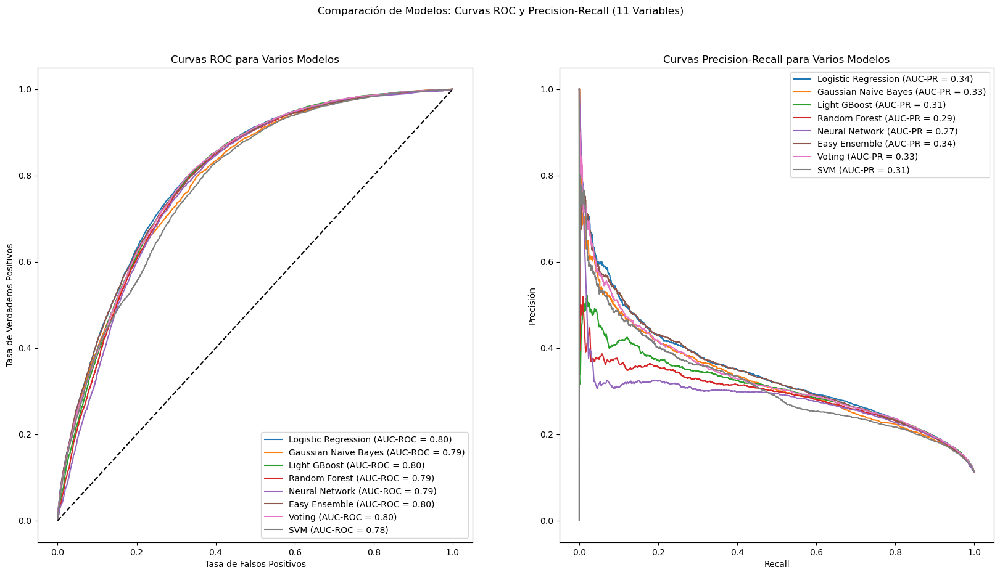

In [203]:
# Graficar curvas de rendimiento para los modelos con 11 variables
graficar_curvas_rendimiento(roc_data_11vars, pr_data_11vars, 
                            'Comparación de Modelos: Curvas ROC y Precision-Recall (11 Variables)')

### EXPLICABILIDAD

#### SHAP values

Valores SHAP para Logistic Regression:


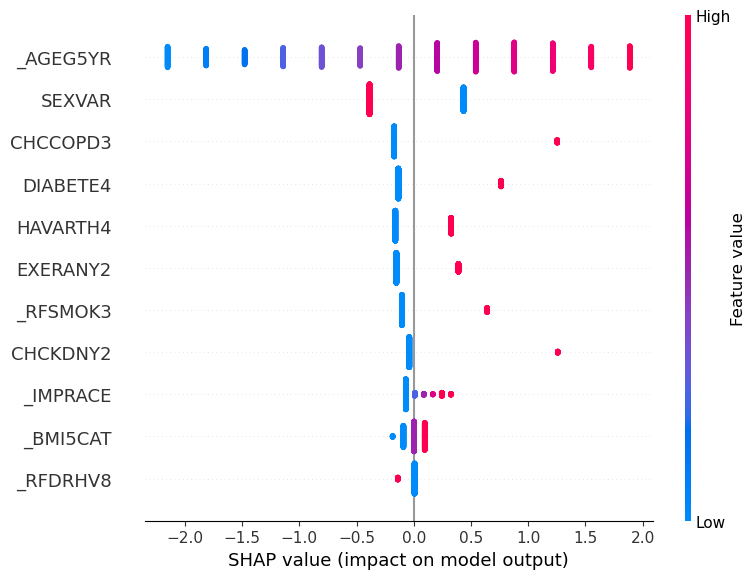

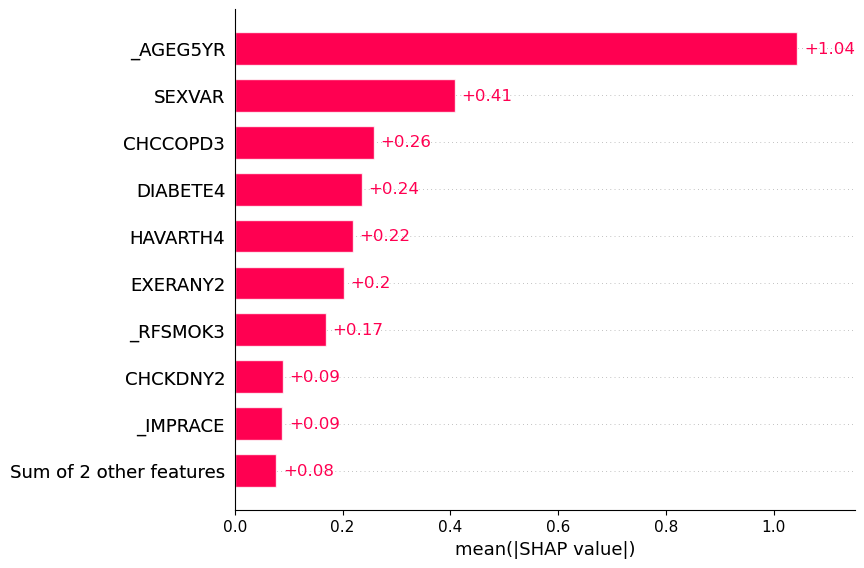

Valores SHAP para Gaussian Naive Bayes:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:11<00:00,  1.31s/it]


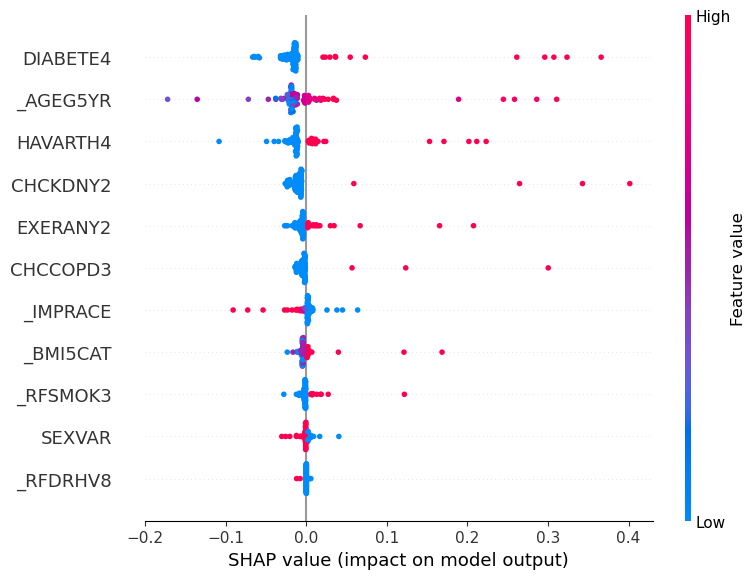

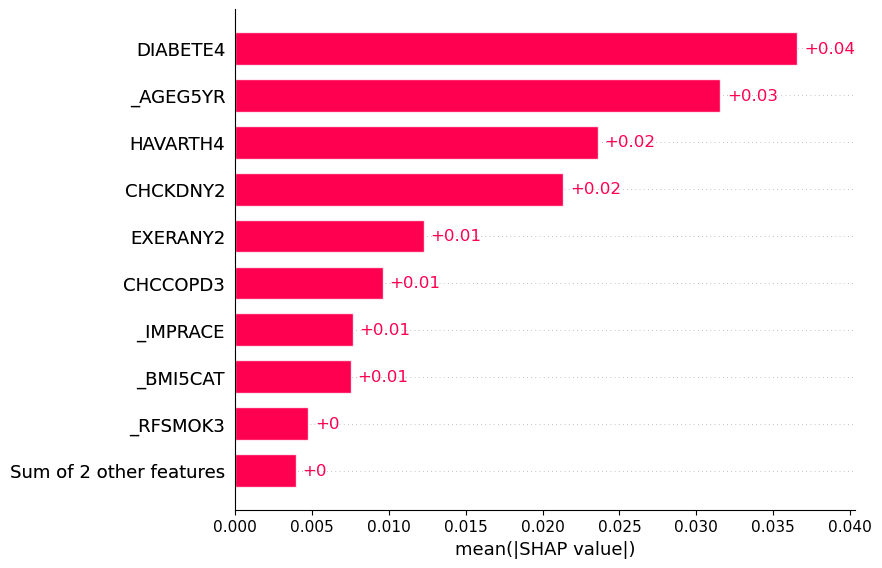

Valores SHAP para Light GBoost:


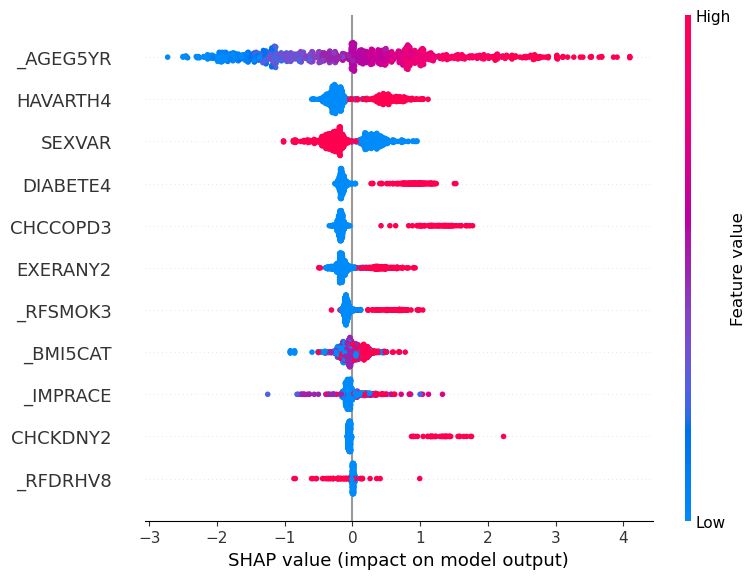

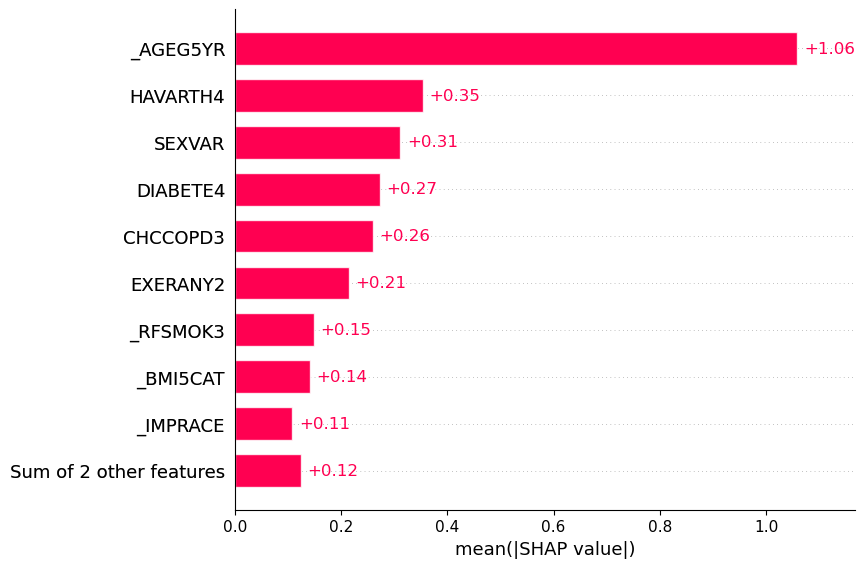

Valores SHAP para Random Forest:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [03:15<00:00,  2.61s/it]


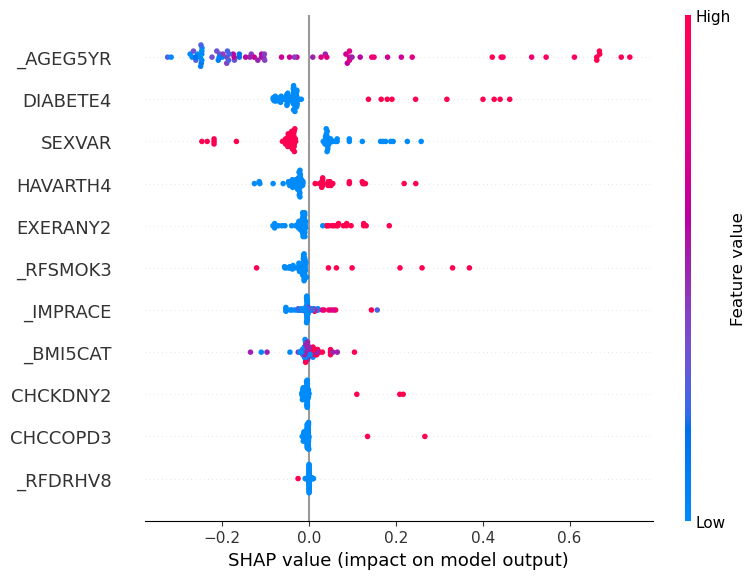

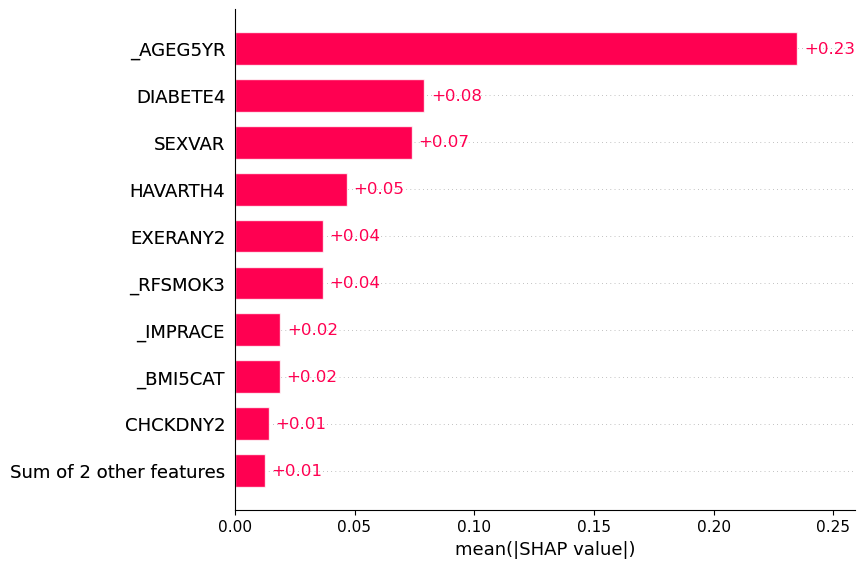

Valores SHAP para Neural Network:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [01:55<00:00,  1.54s/it]


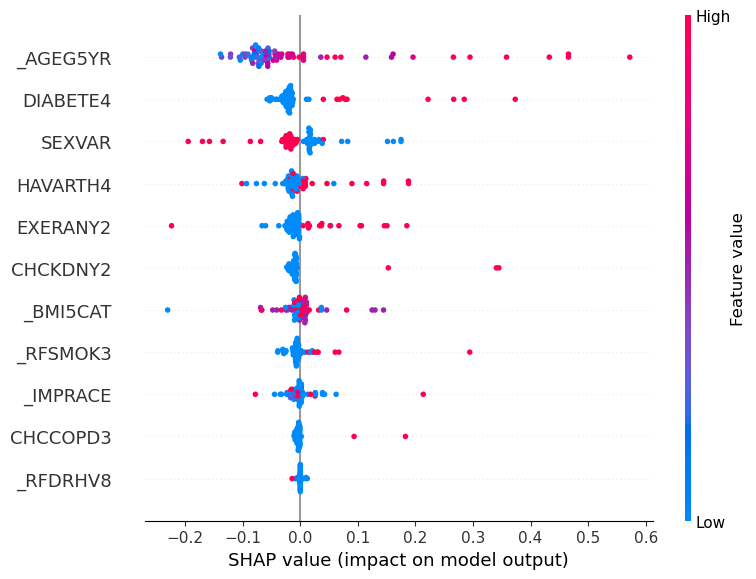

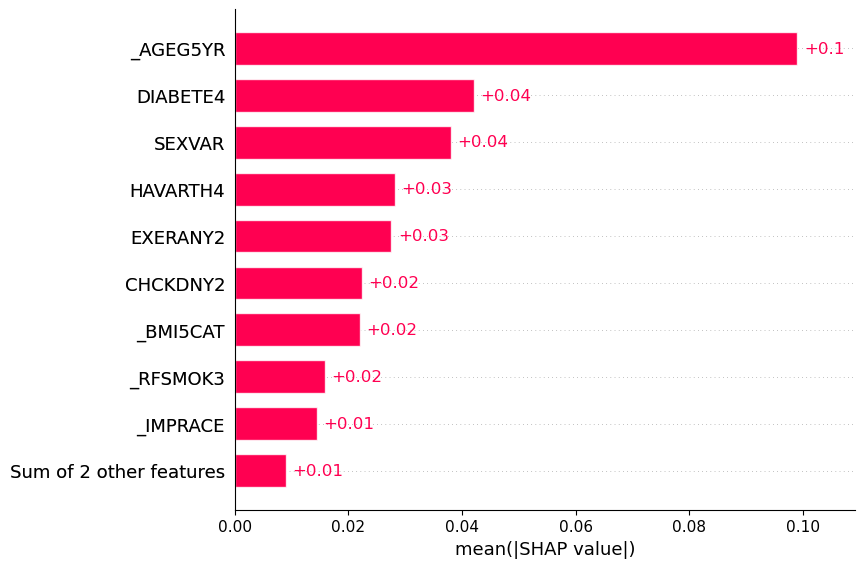

Valores SHAP para Easy Ensemble:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [04:53<00:00,  5.87s/it]


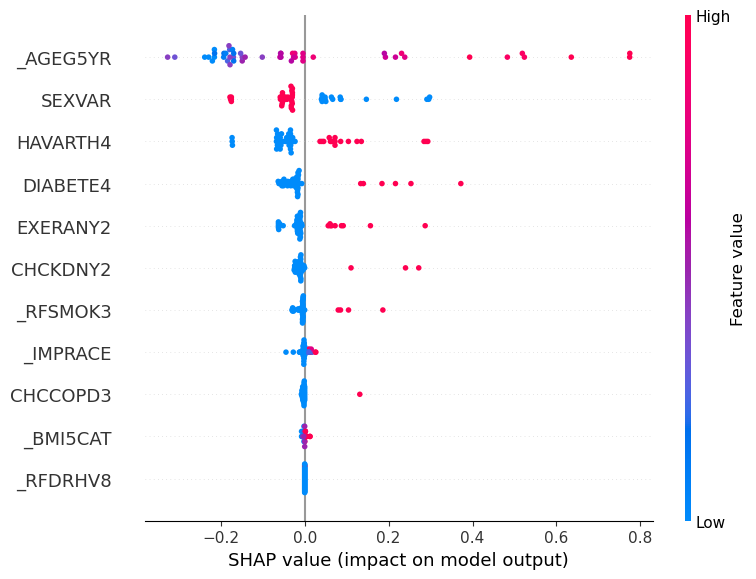

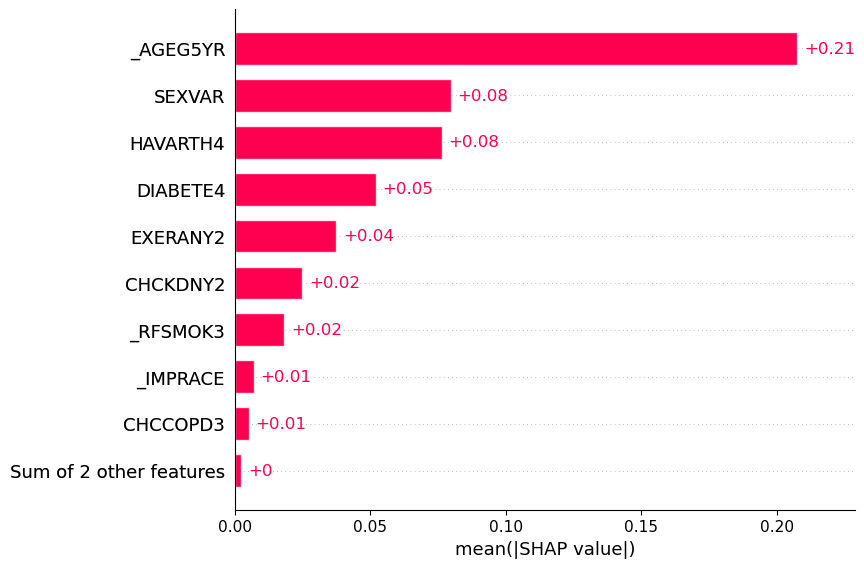

Valores SHAP para Voting:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [06:45<00:00,  8.11s/it]


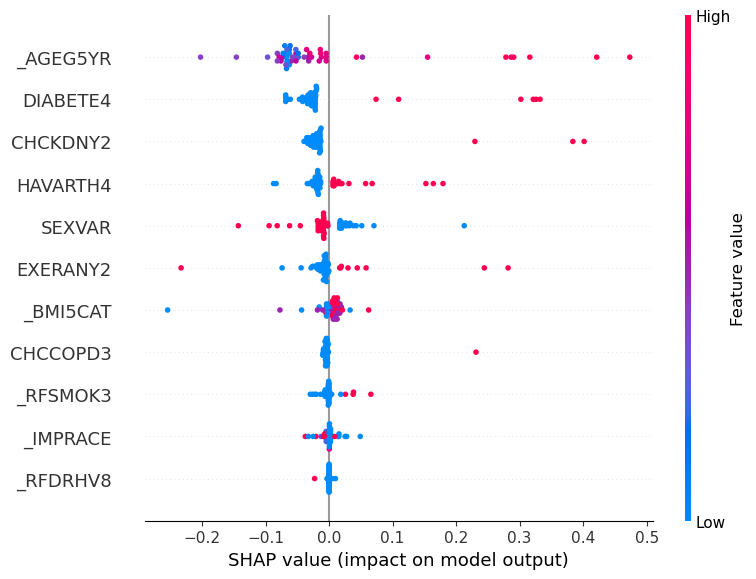

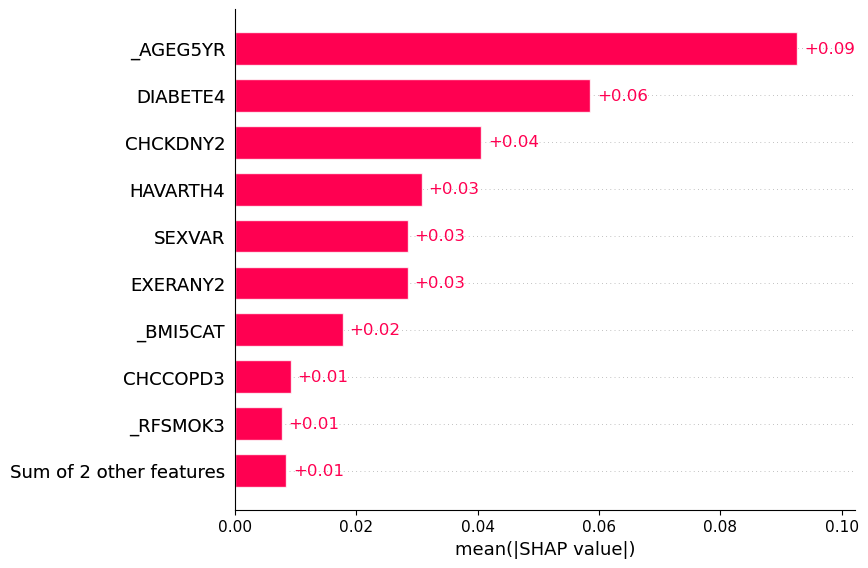

Valores SHAP para SVM:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:06<00:00,  1.27s/it]


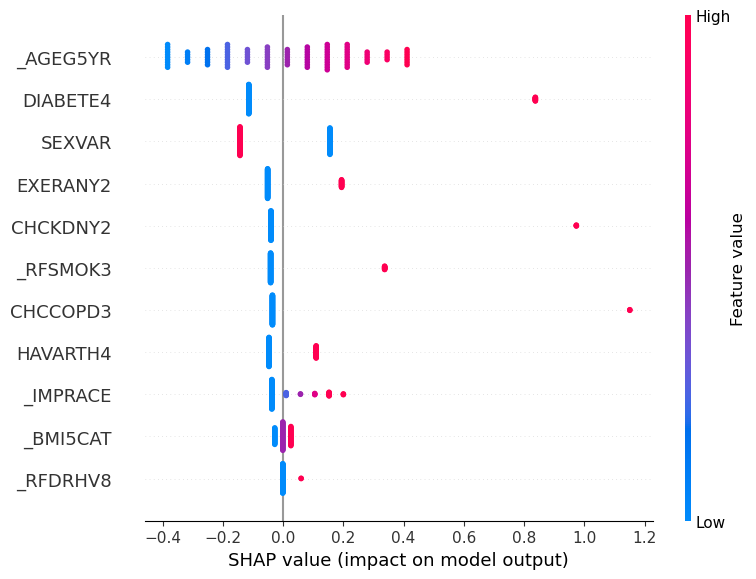

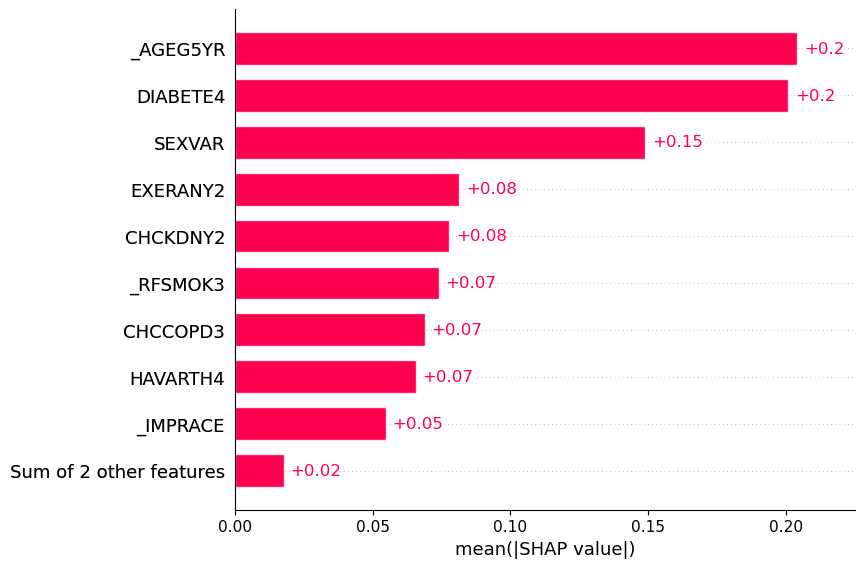

In [204]:
# Diccionario para mapear los tipos de modelo a sus correspondientes objetos explainer de SHAP
explainer_dict = {
    LogisticRegression: shap.LinearExplainer,
    GaussianNB: shap.KernelExplainer,
    LGBMClassifier: shap.TreeExplainer,
    RandomForestClassifier: shap.KernelExplainer,
    MLPClassifier: shap.KernelExplainer,
    EasyEnsembleClassifier: shap.KernelExplainer,
    VotingClassifier: shap.KernelExplainer,
    LinearSVC: shap.KernelExplainer    
    
}

# Diccionario para mapear los nombres de los modelos a sus correspondientes tamaños de muestra
sample_sizes = {
    'Logistic Regression': 1000,
    'Gaussian Naive Bayes': 100,
    'Light GBoost': 1000,
    'Random Forest': 75,
    'Neural Network': 75,
    'Easy Ensemble': 50,
    'SVM': 100,
    'Voting': 50
}

# Iterar sobre los modelos optimizados para graficar la importancia de las variables creadas por SHAP
for nombre, modelo in modelos_optimizados:
    print(f"Valores SHAP para {nombre}:")
    
    # Obtener el tamaño de muestra específico para el modelo actual
    sample_size = sample_sizes.get(nombre, 50)  # Valor predeterminado de 50 si no se encuentra el nombre del modelo
    
    # Tomar una muestra aleatoria de los datos de prueba para el cálculo de SHAP
    X_test_sample = shap.utils.sample(X_test, nsamples=sample_size, random_state=42)
    
    explainer_class = explainer_dict.get(type(modelo))
    if explainer_class is None:
        print(f"No se puede calcular los valores SHAP para {nombre}")
        continue
    
    if explainer_class == shap.KernelExplainer:
        if isinstance(modelo, LinearSVC):
            explainer = explainer_class(modelo.decision_function, X_test_sample)
        else:
            explainer = explainer_class(modelo.predict, X_test_sample)
    else:
        explainer = explainer_class(modelo, X_test_sample)
    
    shap_values = explainer(X_test_sample)
    
    # Graficar el Summary Plot de SHAP
    shap.summary_plot(shap_values, X_test_sample)
    plt.show()
    
    # Graficar el Bar Plot de SHAP
    shap.plots.bar(shap_values)
    plt.show()


#### Importancia y permutación de características

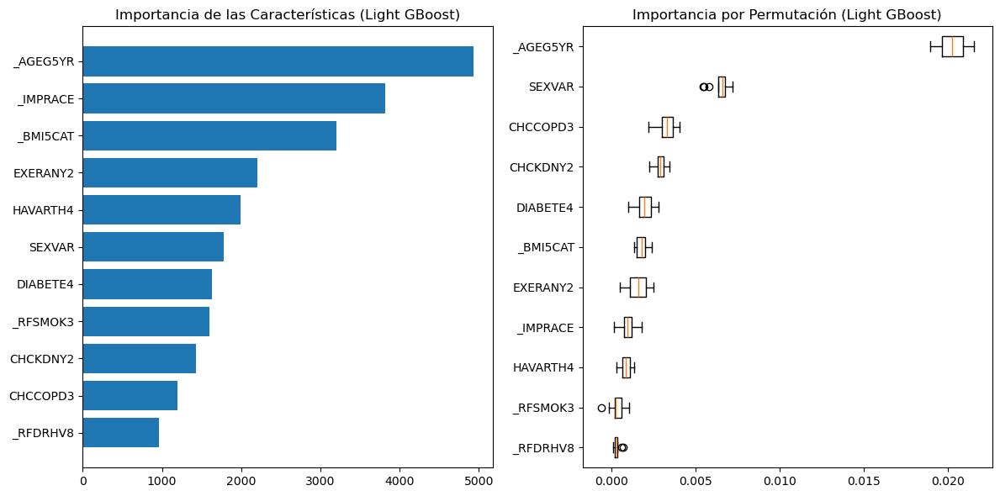

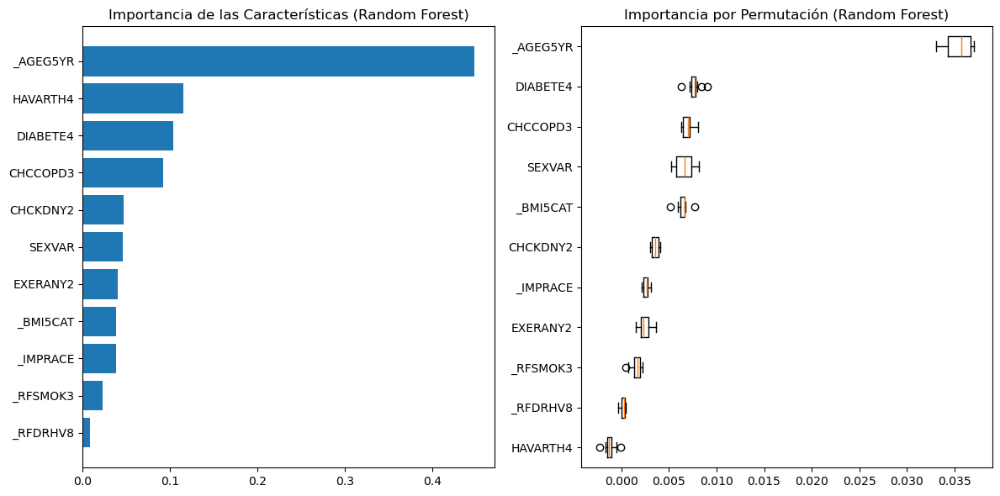

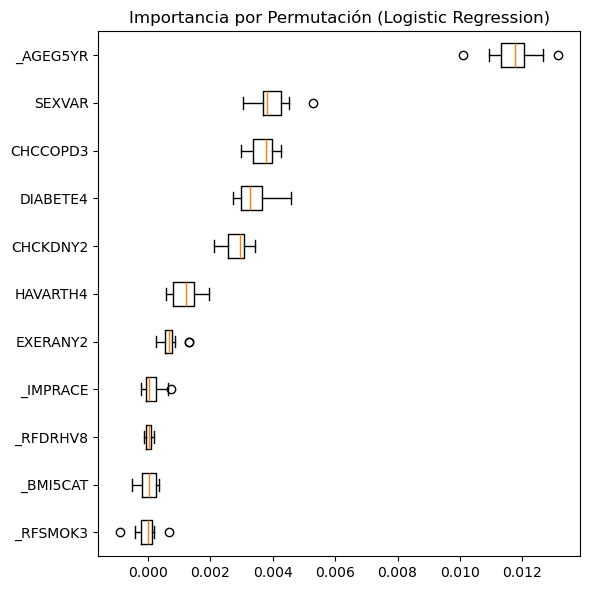

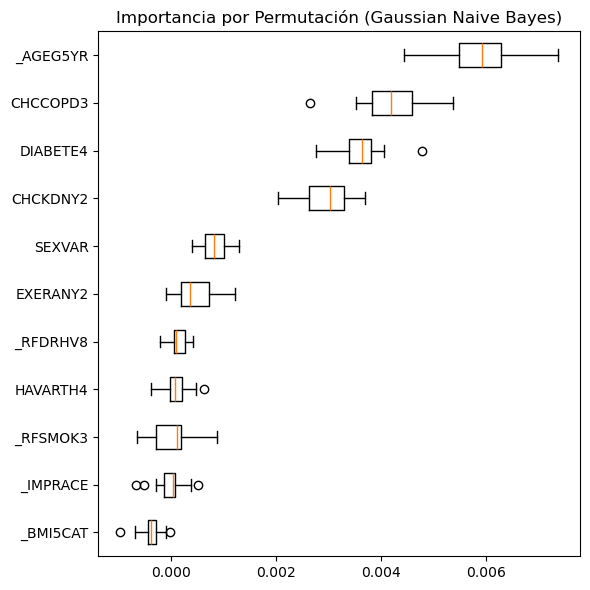

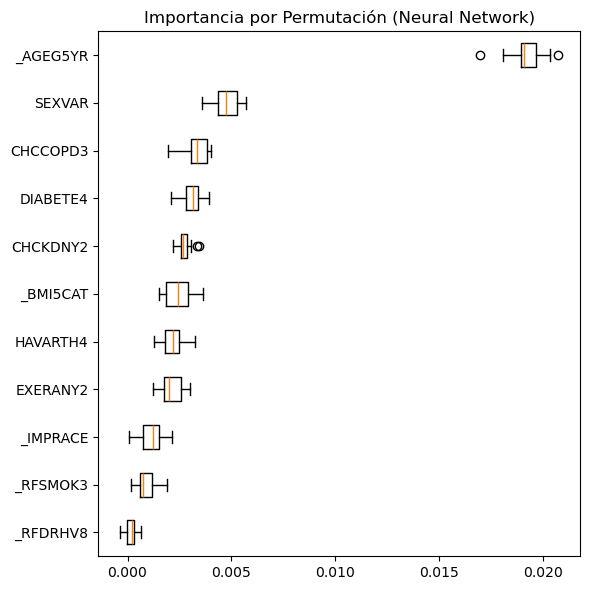

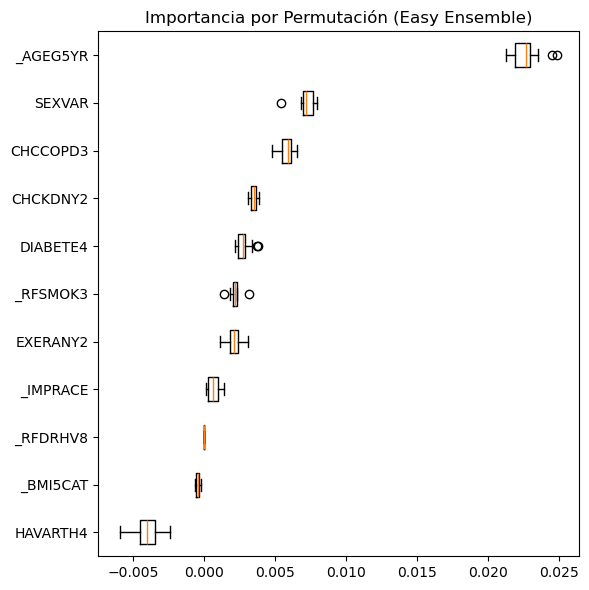

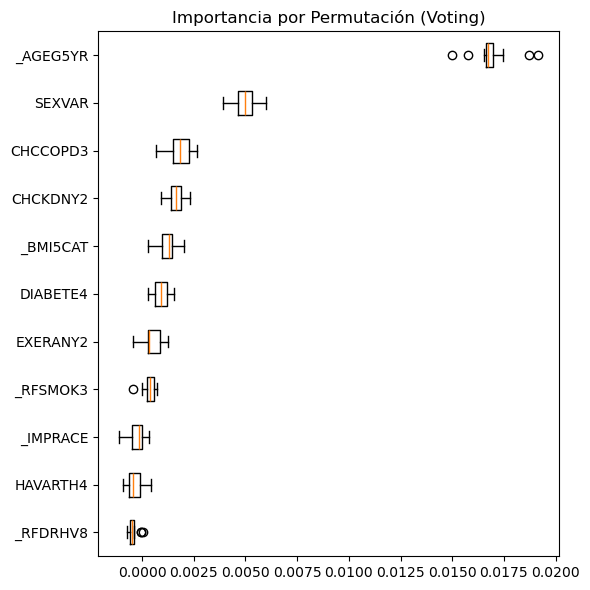

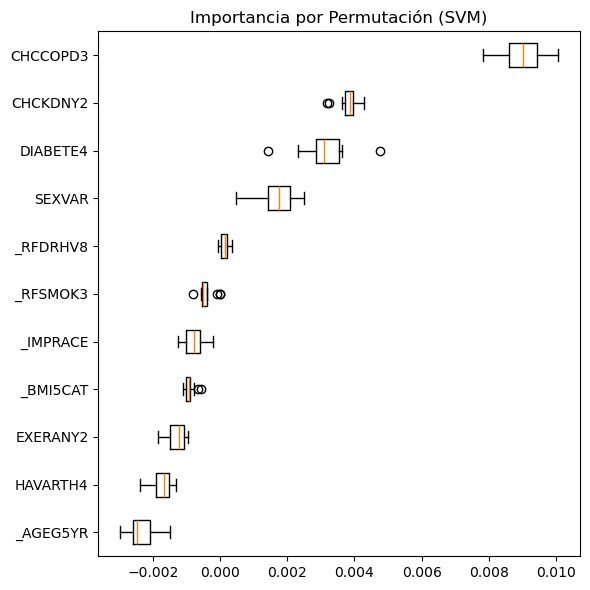

In [205]:
# Graficar importancia y permutación para los modelos con 11 variables
graficar_importancia_permutacion(modelos_optimizados, X_test, y_test, X)
graficar_permutacion_importancia(modelos_optimizados, X_test, y_test, X)

## MODELOS CON TODAS(29) LAS VARIABLES

In [206]:

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/NeighbourhoodCleaningRule/modelos_iniciales_all"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los modelos base
modelos_base = [
    ('Logistic Regression', LogisticRegression(class_weight='balanced', max_iter=200, random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),
    ('Light GBoost', LGBMClassifier(class_weight='balanced', verbose=-1)),
    ('Random Forest', RandomForestClassifier(class_weight='balanced', n_estimators=500, min_samples_split=2,
                                             max_depth=5, min_samples_leaf=1, random_state=42)),
    ('Neural Network', MLPClassifier(early_stopping=True, random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble = [   
    ('Voting', VotingClassifier(estimators=modelos_base, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(class_weight='balanced', C=100.0, random_state=42, dual=False))
]

# Combinar todos los modelos
modelos = modelos_base + modelos_ensamble

# Crear el objeto de la técnica de muestreo NeighbourhoodCleaningRule
tecnica_muestreo = NeighbourhoodCleaningRule()

# Entrenar y evaluar modelos con todas las variables
resultados_allvars, X, X_train, y_train, X_val, y_val, X_test, y_test = entrenar_evaluar_modelos_base(
    df, modelos, carpeta_modelos, tecnica_muestreo)


Dimensiones del conjunto de entrenamiento:
X_train: (205167, 29), y_train: (205167,)

Dimensiones del conjunto de validación:
X_val: (53095, 29), y_val: (53095,)

Dimensiones del conjunto de prueba:
X_test: (53096, 29), y_test: (53096,)

Tiempo de muestreo: 19.99 minutos

Modelo Logistic Regression cargado desde archivo.
Entrenamiento Logistic Regression:
Tiempo de ejecución: 0.04 minutos
Accuracy: 0.7740182388005868
F1-score: 0.4921573781983877
Precision: 0.3552329902123555
Recall: 0.8008412647488682
AUC-ROC: 0.8626250354014193
Matthews Corr Coef: 0.4245434077085248

MATRIZ DE CONFUSIÓN:
[[136337  40777]
 [  5587  22466]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.96      0.77      0.85    177114
           1       0.36      0.80      0.49     28053

    accuracy                           0.77    205167
   macro avg       0.66      0.79      0.67    205167
weighted avg       0.88      0.77      0.81    205167



Test Logistic

### Tabla de métricas de rendimiento modelos base

In [207]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_allvars_inicial = pd.DataFrame.from_dict(resultados_allvars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_allvars_inicial

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.709149,0.387207,0.254260,0.811544,0.828457,0.334821,0.038587
Gaussian Naive Bayes,0.790493,0.390065,0.290937,0.591650,0.795850,0.306735,0.002166
Light GBoost,0.701729,0.383510,0.250343,0.819361,0.830430,0.332033,0.016944
Random Forest,0.699130,0.375660,0.245517,0.799401,0.818346,0.319029,0.584042
Neural Network,0.879558,0.374694,0.454567,0.318696,0.828685,0.316322,0.417947
Easy Ensemble,0.709771,0.382859,0.252136,0.795077,0.824192,0.326677,0.313198
Voting,0.793563,0.421919,0.308904,0.665336,0.828100,0.350706,1.184690
SVM,0.704912,0.384942,0.251927,0.815536,0.828097,0.332959,0.016111


### BÚSQUEDA DE HIPERPARÁMETROS

In [208]:

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/NeighbourhoodCleaningRule/modelos_entrenados_all"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)


In [209]:

# Definir los espacios de búsqueda de hiperparámetros para cada modelo
param_dist_lr = {
    'class_weight': ['balanced', None],
    'solver': ['newton-cg', 'newton-cholesky', 'sag', 'saga'],
    'penalty': ['l2'],
    'C': loguniform(1e-4, 1e1)
}

param_dist_gnb = {
    'var_smoothing': loguniform(1e-9, 1e-1)
}

param_dist_lgbm = {
    'class_weight': ['balanced', None],
    'n_estimators': randint(50, 251),
    'max_depth': randint(3, 31),
    'subsample': uniform(0.7, 0.3),
    'colsample_bytree': uniform(0.7, 0.3),
    'learning_rate': loguniform(1e-5, 1e-1),
    'num_leaves': randint(10, 101),
    'verbose': [-1]
}

param_dist_rf = {
    'class_weight': ['balanced_subsample', 'balanced'],
    'n_estimators': randint(50, 251),
    'criterion': ['gini', 'entropy'],
    'max_depth': randint(3, 16),
    'min_samples_leaf': randint(3, 16),
    'min_samples_split': randint(3, 16),
    'max_features': [None, 'sqrt', 'log2']
}

param_dist_ann = {
    'hidden_layer_sizes': [(100,), (50,50), (100,100), (50, 50, 50),
                           (100, 100, 100), (50, 50, 50, 50), (100, 100, 100, 100),
                           (50, 50, 50, 50, 50), (100, 100, 100, 100, 100)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': loguniform(1e-5, 1e3),
    'batch_size': [64, 128, 256, 512],
    'learning_rate': ['constant', 'adaptive'],
    'learning_rate_init': loguniform(1e-5, 1e-1),
    'early_stopping': [True],
    'max_iter': [100]
}

param_dist_eec = {
    'n_estimators': randint(2, 20),
    'sampling_strategy': ['auto']
}

param_dist_svm = {
    'dual': ['auto'],
    'tol': loguniform(1e-5, 1e-3),
    'class_weight': [None, 'balanced'],
    'penalty': ['l2'],
    'loss': ['hinge', 'squared_hinge'],
    'C': loguniform(1e-4, 1e4),
    'max_iter': randint(1000, 2001)
}

# Definir los modelos con búsqueda de hiperparámetros
modelos = [
    ('Logistic Regression', RandomizedSearchCV(LogisticRegression(), param_dist_lr,
                                               cv=30, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Gaussian Naive Bayes', RandomizedSearchCV(GaussianNB(), param_dist_gnb, cv=30,
                                                n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('Light GBoost', RandomizedSearchCV(LGBMClassifier(), param_dist_lgbm, cv=5, n_jobs=6,
                                        scoring='f1_weighted', n_iter=50)),
    ('Random Forest', RandomizedSearchCV(RandomForestClassifier(), param_dist_rf,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Neural Network', RandomizedSearchCV(MLPClassifier(), param_dist_ann, cv=5, n_jobs=6,
                                          scoring='f1_weighted', error_score=0, n_iter=50)),
    ('Easy Ensemble', RandomizedSearchCV(EasyEnsembleClassifier(), param_dist_eec,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('SVM', RandomizedSearchCV(LinearSVC(), param_dist_svm, cv=5, n_jobs=6,
                               scoring='f1_weighted', n_iter=50))
]

# Crear un diccionario para almacenar los mejores hiperparámetros de cada modelo
best_params_all = {}

# Entrenar y evaluar cada modelo con búsqueda de hiperparámetros
for nombre, modelo in modelos:
    nombre_archivo = f"{carpeta_modelos}/{nombre}_optimizado.pkl"
    
    # Hash del conjunto de datos actual
    hash_actual = hash_de_datos(X_train)
    
    # Cargar o entrenar modelo
    modelo_cargado, tiempo_ejecucion, mejores_parametros_cargados = cargar_modelo(nombre_archivo, hash_actual)
    
    if modelo_cargado is not None:
        print(f"Modelo {nombre} cargado desde archivo.")
        modelo_best_all = modelo_cargado
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros_cargados}")
        # Agregar los mejores hiperparámetros cargados al diccionario
        best_params_all[nombre] = mejores_parametros_cargados
    else:
        print(f"Entrenando nuevo modelo {nombre}.")
        inicio = time.time()  # Tiempo de inicio
        modelo.fit(X_train, y_train)
        
        mejores_parametros = modelo.best_params_
        
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros}")
        
        # Agregar los mejores hiperparámetros al diccionario
        best_params_all[nombre] = modelo.best_params_
        
        # Entrenar el modelo con los mejores hiperparámetros en el conjunto de entrenamiento completo
        modelo_best_all = modelo.best_estimator_
        modelo_best_all.fit(X_train, y_train)
        
        fin = time.time()  # Tiempo de fin
        tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos
        
        # Guardar el modelo entrenado junto con el tiempo de ejecución y los mejores parámetros
        guardar_modelo(modelo_best_all, nombre_archivo, hash_actual, tiempo_ejecucion, mejores_parametros)

    # Métricas predicción entrenamiento
    y_pred_train = modelo_best_all.predict(X_train)

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_all, "predict_proba"):
        y_scores = modelo_best_all.predict_proba(X_train)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_all.decision_function(X_train)  # Puntuaciones de decisión
    
    print(f"Entrenamiento {nombre}:")
    print(f"Tiempo de búsqueda de hiperparámetros de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_train, y_pred_train)}")
    print(f"F1-score: {f1_score(y_train, y_pred_train)}")
    print(f"Precision: {precision_score(y_train, y_pred_train)}")
    print(f"Recall: {recall_score(y_train, y_pred_train)}")
    print(f"AUC-ROC: {roc_auc_score(y_train, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_train, y_pred_train)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_train, y_pred_train))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_train, y_pred_train))
    print("\n")

    # Métricas predicción validación
    inicio = time.time()  # Tiempo de inicio
    y_pred_val = modelo_best_all.predict(X_val)
    fin = time.time()  # Tiempo de fin
    tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_all, "predict_proba"):
        y_scores = modelo_best_all.predict_proba(X_val)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_all.decision_function(X_val)  # Puntuaciones de decisión

    
    print(f"Validación {nombre}:")
    print(f"Tiempo de ejecución de predicción de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_val, y_pred_val)}")
    print(f"F1-score: {f1_score(y_val, y_pred_val)}")
    print(f"Precision: {precision_score(y_val, y_pred_val)}")
    print(f"Recall: {recall_score(y_val, y_pred_val)}")
    print(f"AUC-ROC: {roc_auc_score(y_val, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_val, y_pred_val)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_val, y_pred_val))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_val, y_pred_val))
    print("\n")

Modelo Logistic Regression cargado desde archivo.
Mejores hiperparámetros para Logistic Regression: {'solver': 'newton-cg', 'penalty': 'l2', 'class_weight': None, 'C': 1}
Entrenamiento Logistic Regression:
Tiempo de búsqueda de hiperparámetros de Logistic Regression: 17.18 minutos
Accuracy: 0.8798880911647584
F1-score: 0.40356269816298374
Precision: 0.6285434258142341
Recall: 0.29718746658111433
AUC-ROC: 0.8624489534688176
Matthews Corr Coef: 0.3763448176320676

MATRIZ DE CONFUSIÓN:
[[172187   4927]
 [ 19716   8337]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.90      0.97      0.93    177114
           1       0.63      0.30      0.40     28053

    accuracy                           0.88    205167
   macro avg       0.76      0.63      0.67    205167
weighted avg       0.86      0.88      0.86    205167



Validación Logistic Regression:
Tiempo de ejecución de predicción de Logistic Regression: 0.00 minutos
Accuracy: 0.877389

### Entrenar modelos con los mejores parámetros

In [210]:

# Combinar los conjuntos de entrenamiento y validación para todas las variables
X_train_val_allvars = pd.concat([X_train, X_val], ignore_index=True)
y_train_val_allvars = pd.concat([y_train, y_val], ignore_index=True)

# Definir los modelos con los mejores hiperparámetros
modelos_entrenados_all = [
    ('Logistic Regression', LogisticRegression(random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),    
    ('Light GBoost', LGBMClassifier(verbosity=-1, random_state=42)),
    ('Random Forest', RandomForestClassifier(random_state=42)),   
    ('Neural Network', MLPClassifier(random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble_all = [   
    ('Voting', VotingClassifier(estimators=modelos_entrenados_all, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(random_state=42)) 
]

# Combinar todos los modelos
modelos_optimizados_all = modelos_entrenados_all + modelos_ensamble_all

# Crear el objeto de la técnica de muestreo NeighbourhoodCleaningRule
tecnica_muestreo = NeighbourhoodCleaningRule()

# Entrenar y evaluar modelos con todas las variables
resultados_optimizados_allvars, roc_data, pr_data, modelos_optimizados_all = entrenar_evaluar_modelos(
    X_train_val_allvars, y_train_val_allvars, X_test, y_test, modelos_optimizados_all, best_params_all, carpeta_modelos, 
    tecnica_muestreo
)



Tiempo de muestreo: 21.56 minutos

Modelo Logistic Regression cargado desde archivo.
Test Logistic Regression:
Mejores hiperparámetros para Logistic Regression: {'solver': 'newton-cg', 'penalty': 'l2', 'class_weight': None, 'C': 1}
Tiempo de ejecución de entrenamiento: 0.03 minutos
Tiempo de ejecución de predicción: 0.00 minutos
Accuracy: 0.8673911405755612
F1-score: 0.4130054189245519
Precision: 0.41400635132876484
Recall: 0.4120093147039255
AUC-ROC: 0.8272062337534315
Matthews Corr Coef: 0.33825956443621835

MATRIZ DE CONFUSIÓN:
[[43578  3506]
 [ 3535  2477]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.92      0.93      0.93     47084
           1       0.41      0.41      0.41      6012

    accuracy                           0.87     53096
   macro avg       0.67      0.67      0.67     53096
weighted avg       0.87      0.87      0.87     53096



Modelo Gaussian Naive Bayes cargado desde archivo.
Test Gaussian Naive Baye

### Tabla de métricas de rendimiento con los mejores parámetros

In [211]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_allvars_opt = pd.DataFrame.from_dict(resultados_optimizados_allvars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_allvars_opt

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.867391,0.413005,0.414006,0.412009,0.827206,0.338260,0.030207
Gaussian Naive Bayes,0.847616,0.400711,0.361196,0.449933,0.813977,0.317108,0.002233
Light GBoost,0.856317,0.413379,0.384384,0.447106,0.827137,0.333274,0.041803
Random Forest,0.719226,0.384018,0.255470,0.772954,0.819103,0.324046,3.230731
Neural Network,0.855808,0.413603,0.383305,0.449102,0.826618,0.333340,2.310084
Easy Ensemble,0.691050,0.374705,0.243052,0.817532,0.823739,0.321332,0.311531
Voting,0.844941,0.429650,0.368159,0.515802,0.829158,0.349339,3.737936
SVM,0.872721,0.396284,0.428020,0.368929,0.828525,0.326705,0.023759


### Visualizar comparación de rendimiento de curvas ROC-AUC Y PR-AUC

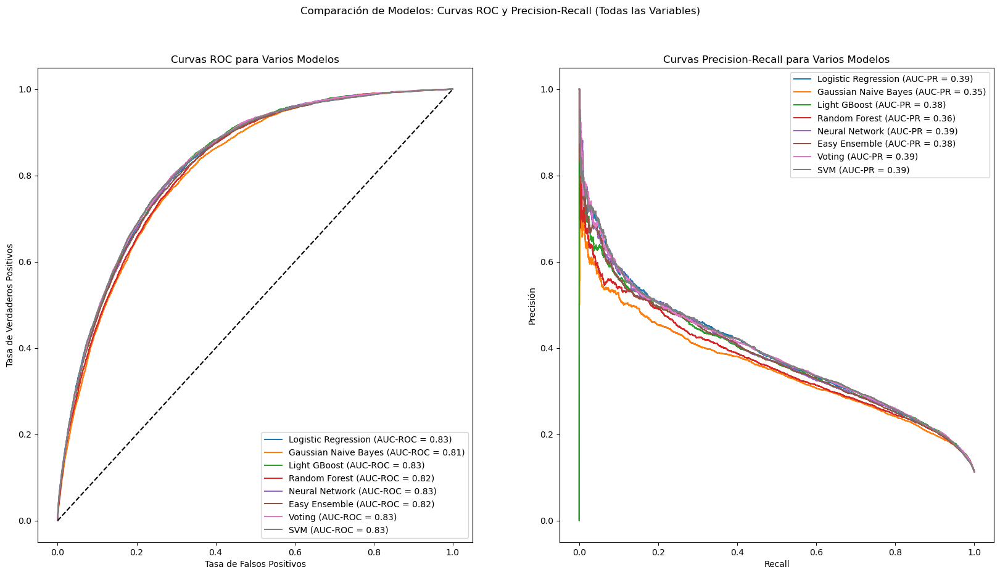

In [212]:
# Graficar curvas de rendimiento para los modelos con todas las variables
graficar_curvas_rendimiento(roc_data, pr_data, 
                            'Comparación de Modelos: Curvas ROC y Precision-Recall (Todas las Variables)')

### EXPLICABILIDAD

#### SHAP values

Valores SHAP para Logistic Regression:


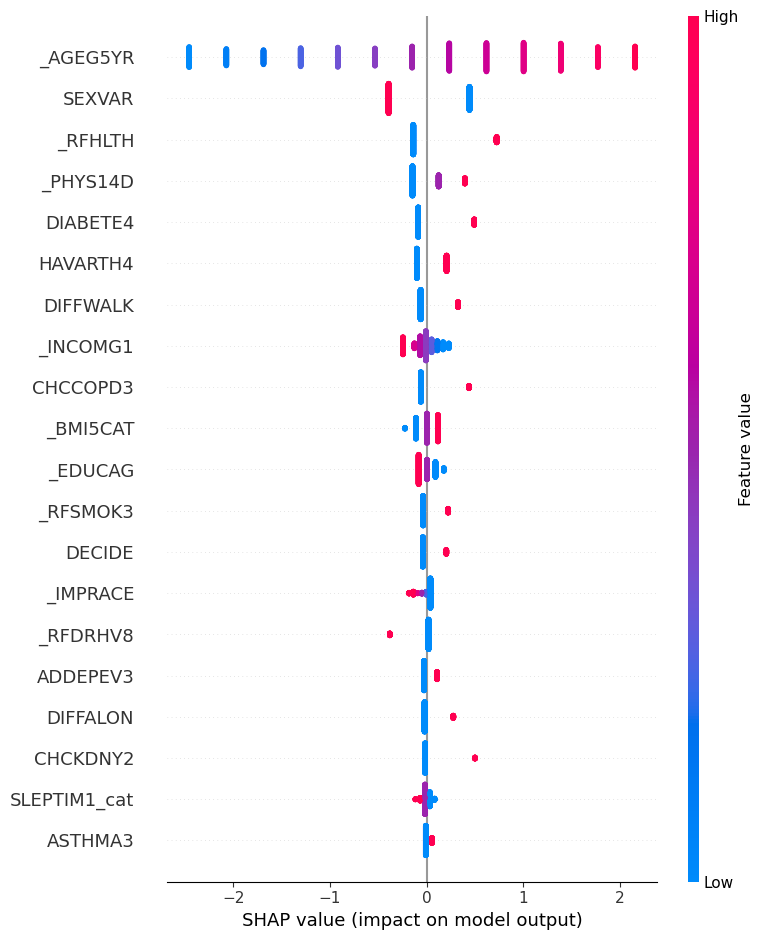

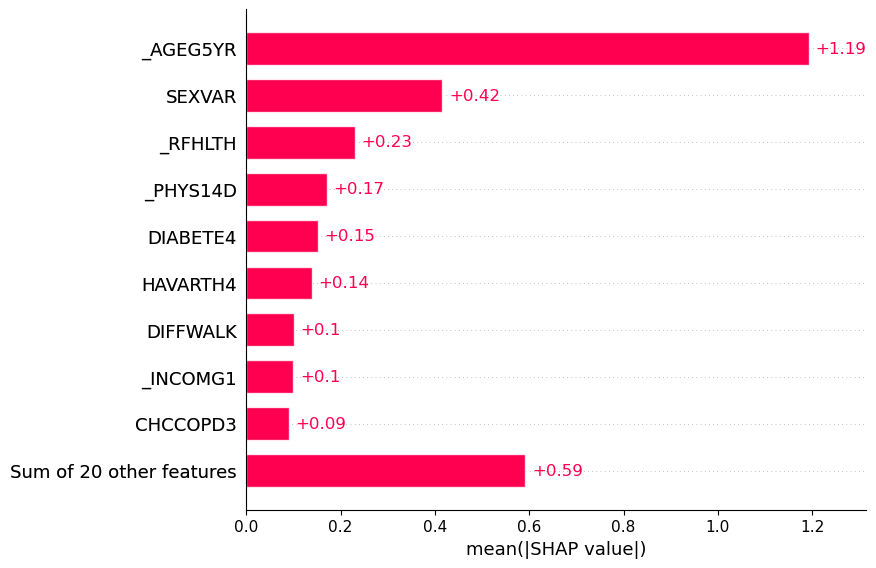

Valores SHAP para Gaussian Naive Bayes:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:36<00:00,  1.56s/it]


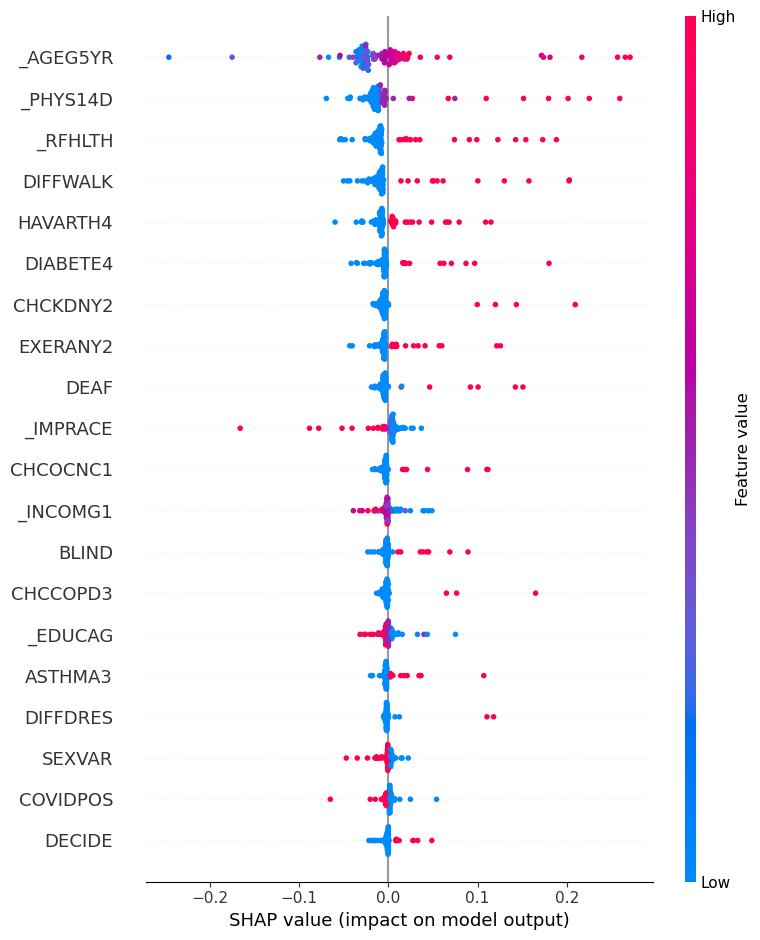

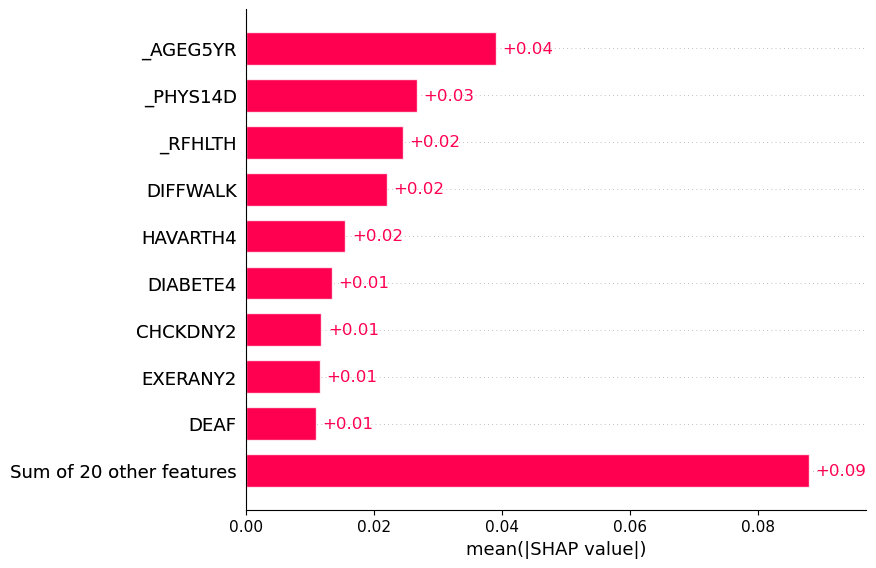

Valores SHAP para Light GBoost:


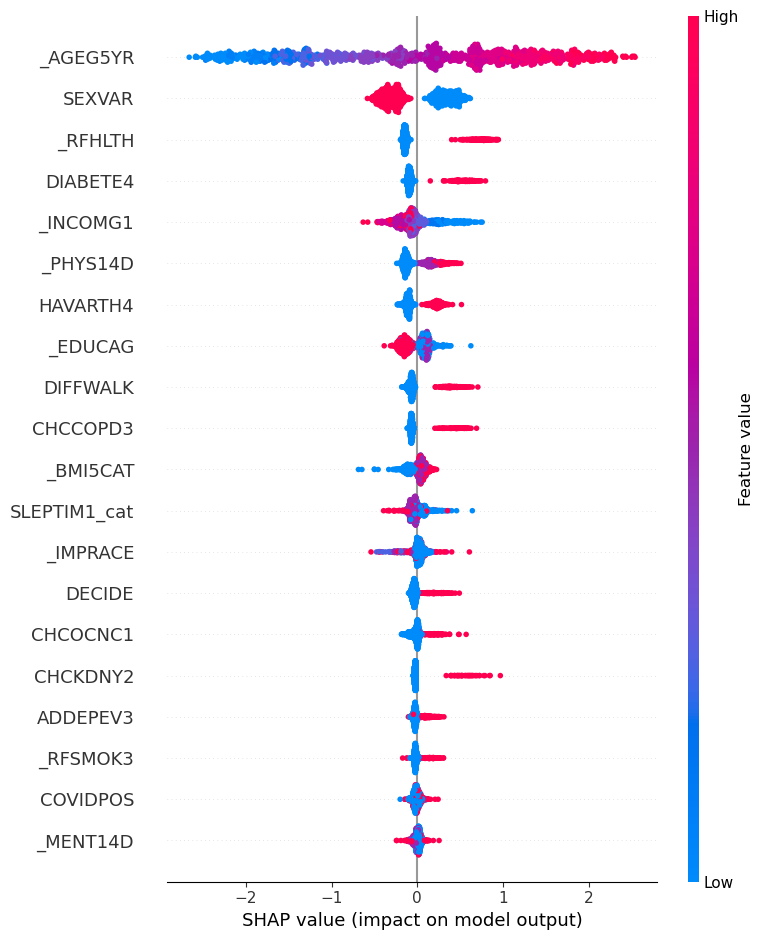

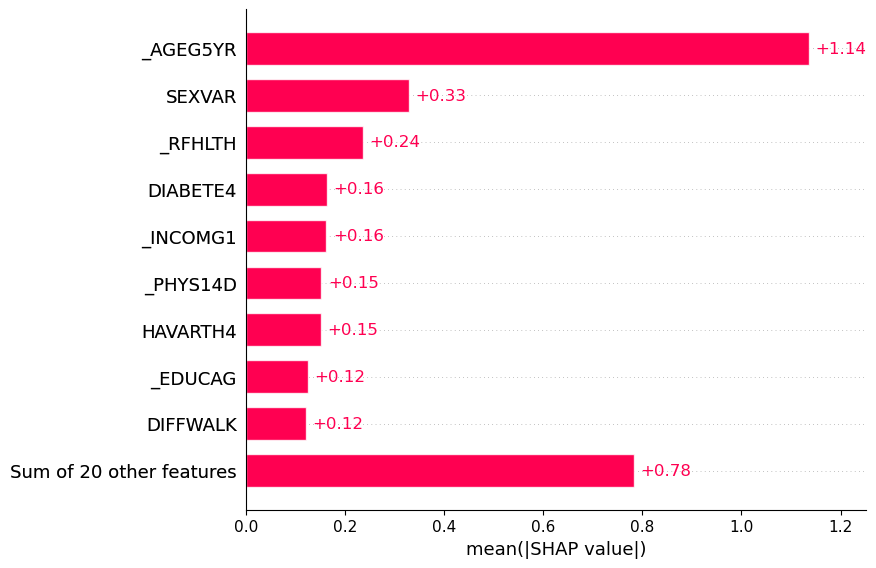

Valores SHAP para Random Forest:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [05:03<00:00,  4.05s/it]


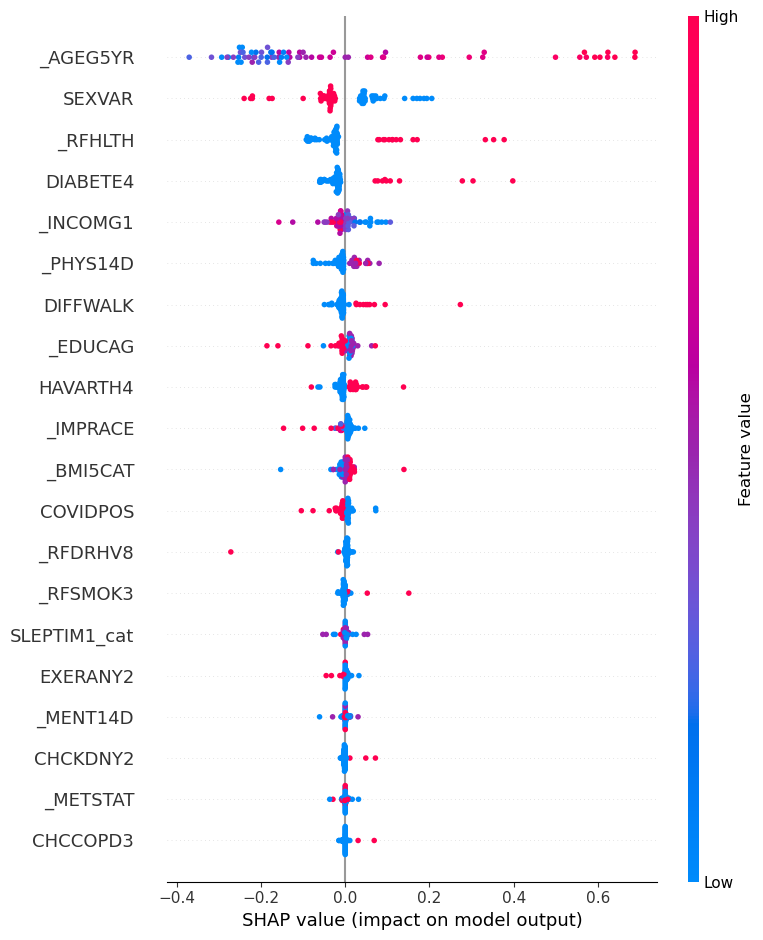

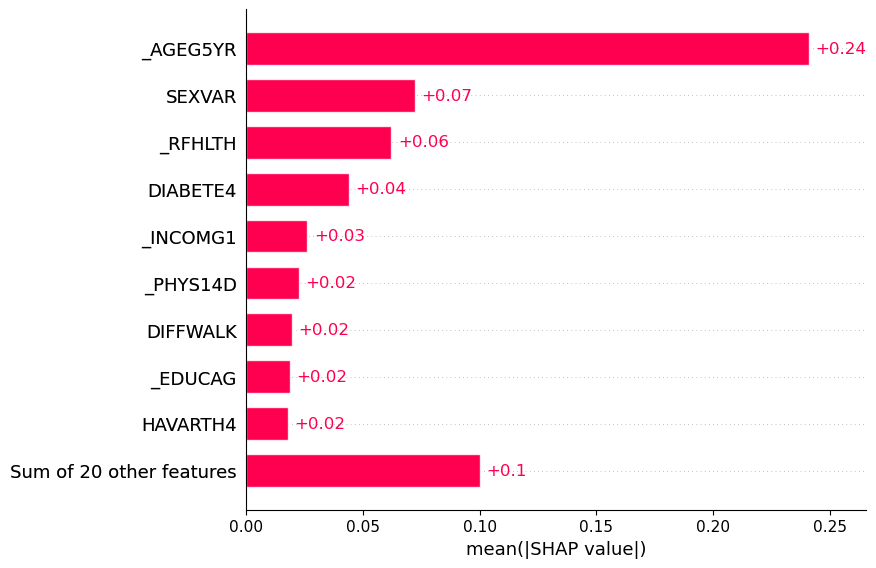

Valores SHAP para Neural Network:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [02:48<00:00,  2.25s/it]


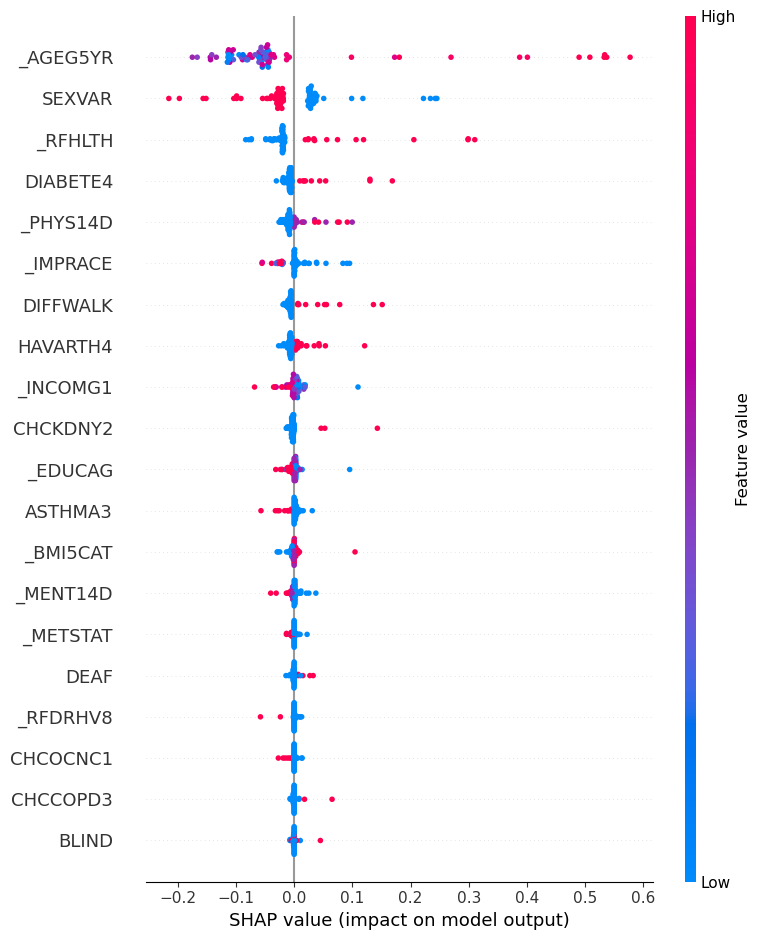

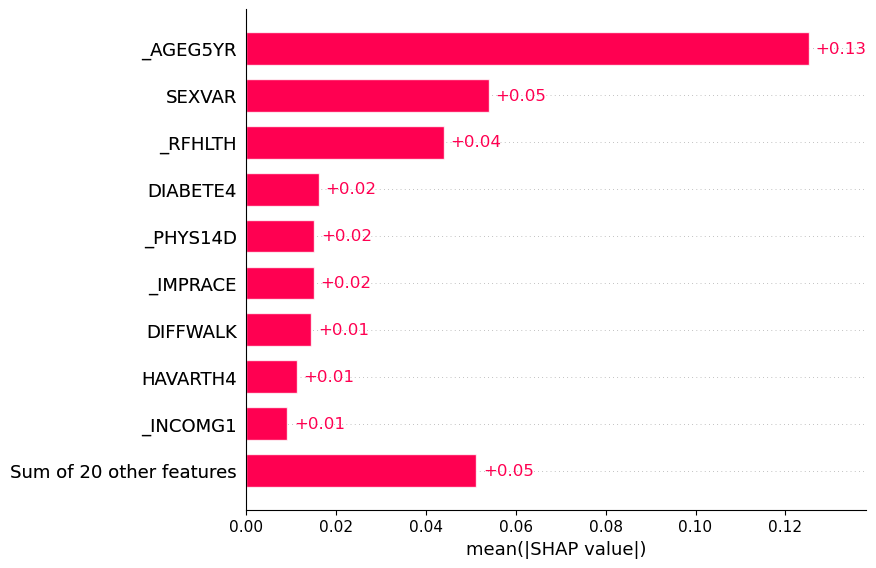

Valores SHAP para Easy Ensemble:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [04:48<00:00,  5.78s/it]


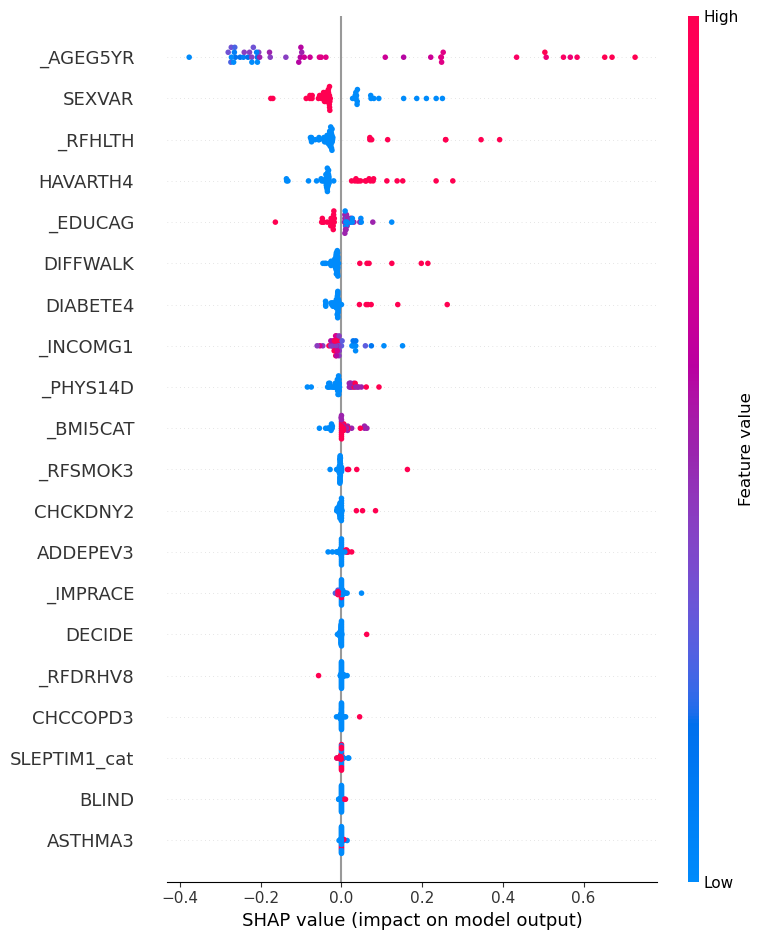

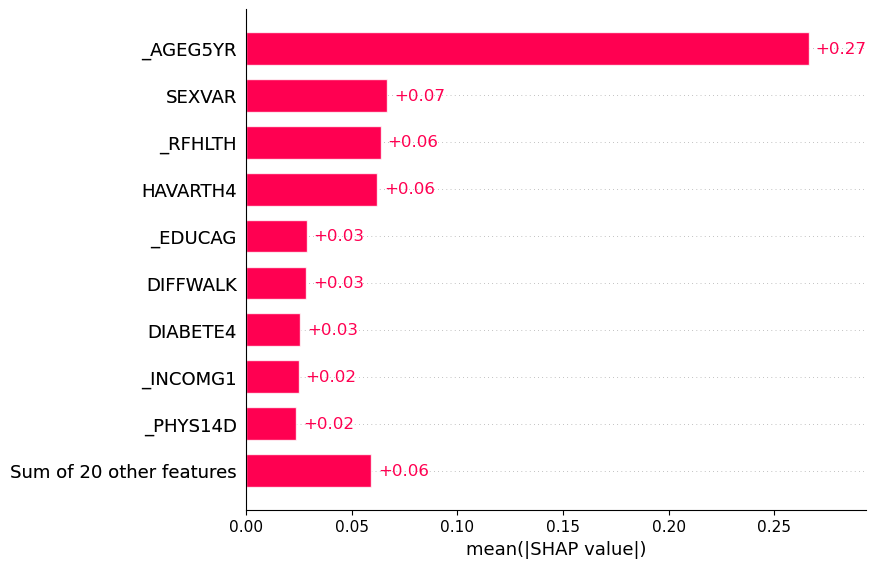

Valores SHAP para Voting:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [07:35<00:00,  9.10s/it]


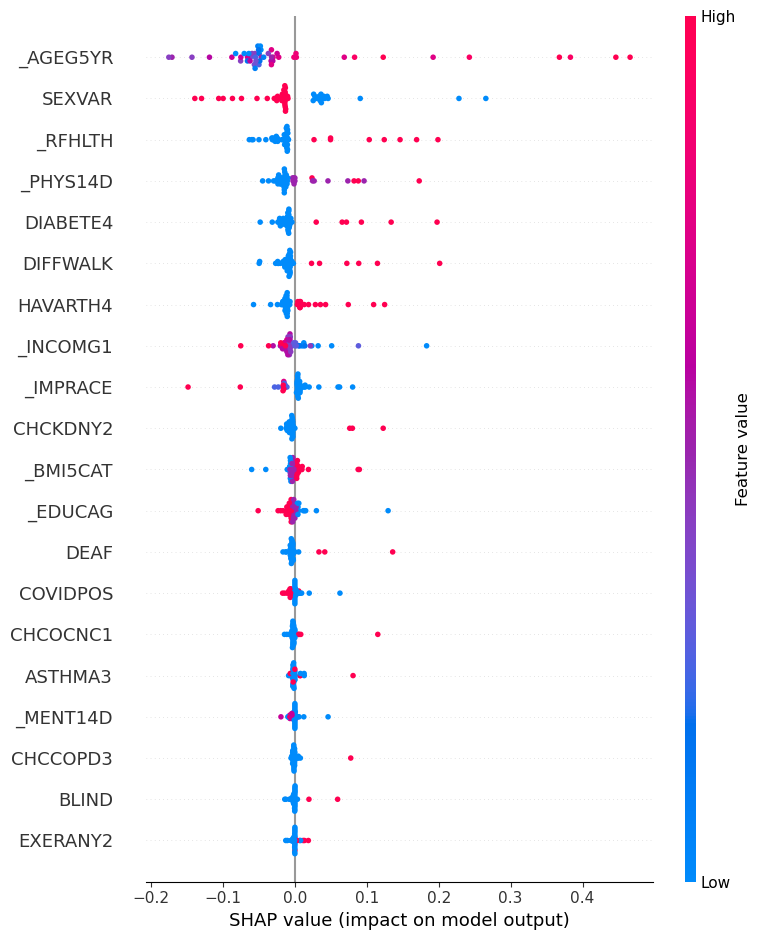

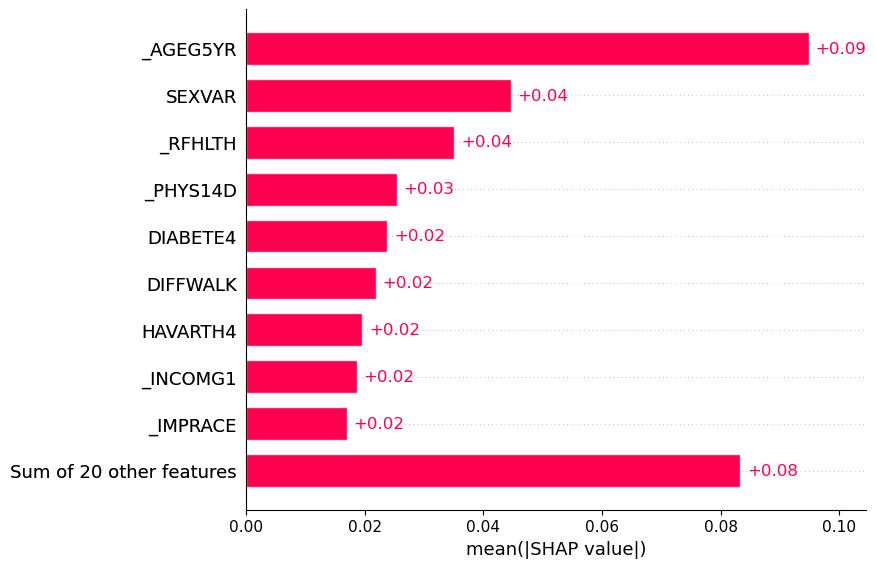

Valores SHAP para SVM:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:26<00:00,  1.46s/it]


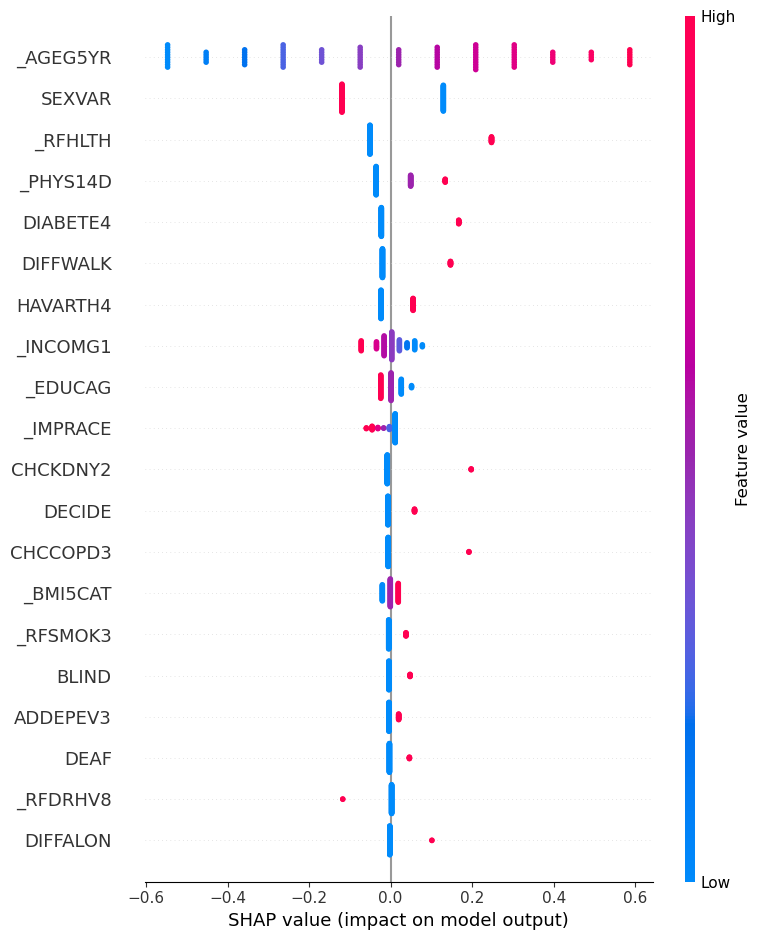

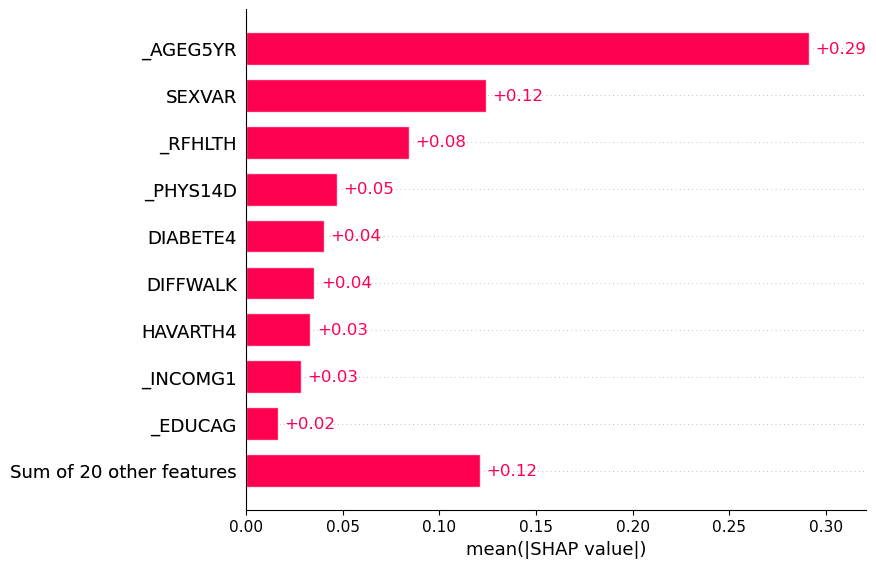

In [213]:
# Iterar sobre los modelos optimizados para graficar la importancia de las variables creadas por SHAP
for nombre, modelo in modelos_optimizados_all:
    print(f"Valores SHAP para {nombre}:")
    
    # Obtener el tamaño de muestra específico para el modelo actual
    sample_size = sample_sizes.get(nombre, 50)  # Valor predeterminado de 50 si no se encuentra el nombre del modelo
    
    # Tomar una muestra aleatoria de los datos de prueba para el cálculo de SHAP
    X_test_sample = shap.utils.sample(X_test, nsamples=sample_size, random_state=42)
    
    explainer_class = explainer_dict.get(type(modelo))
    if explainer_class is None:
        print(f"No se puede calcular los valores SHAP para {nombre}")
        continue
    
    if explainer_class == shap.KernelExplainer:
        if isinstance(modelo, LinearSVC):
            explainer = explainer_class(modelo.decision_function, X_test_sample)
        else:
            explainer = explainer_class(modelo.predict, X_test_sample)
    else:
        explainer = explainer_class(modelo, X_test_sample)
    
    shap_values = explainer(X_test_sample)
    
    # Graficar el Summary Plot de SHAP
    shap.summary_plot(shap_values, X_test_sample)
    plt.show()
    
    # Graficar el Bar Plot de SHAP
    shap.plots.bar(shap_values)
    plt.show()

#### Importancia y permutación de características

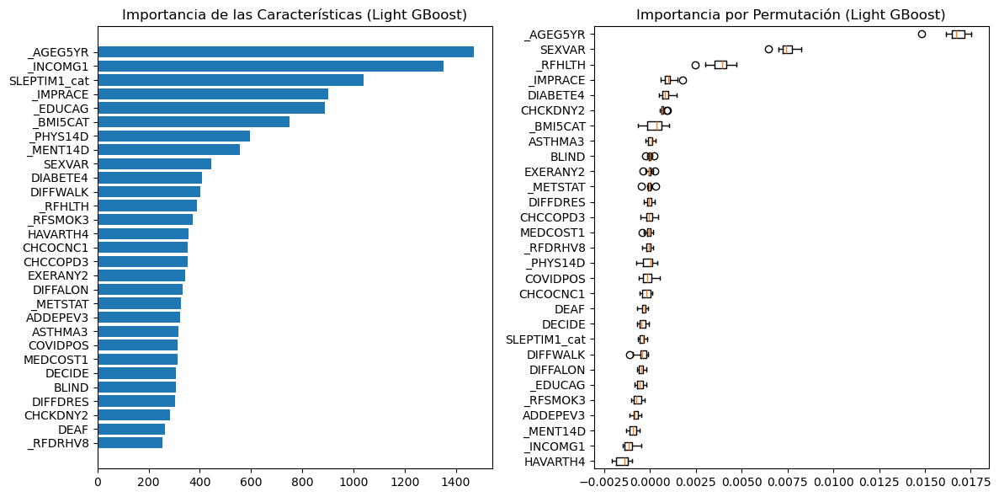

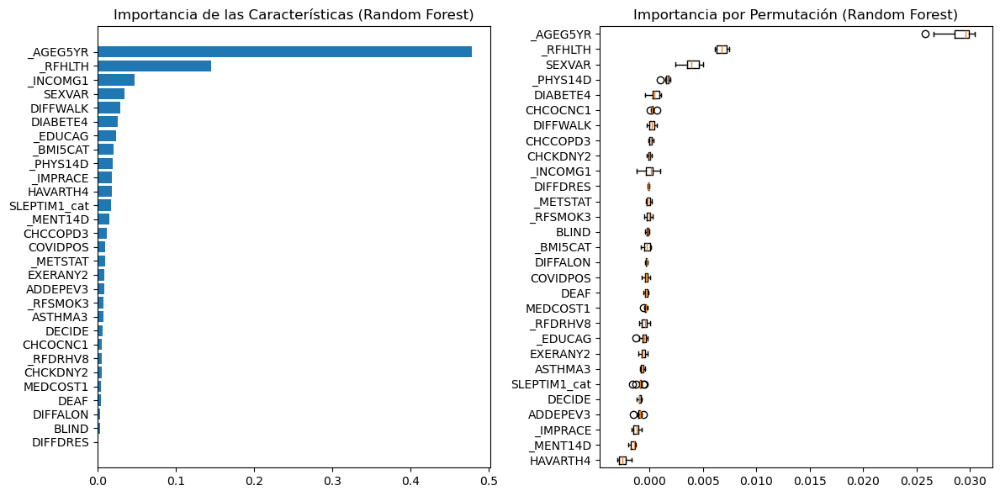

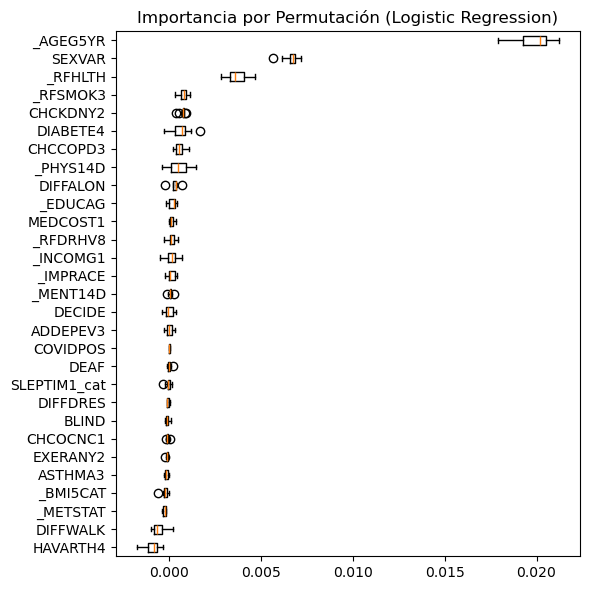

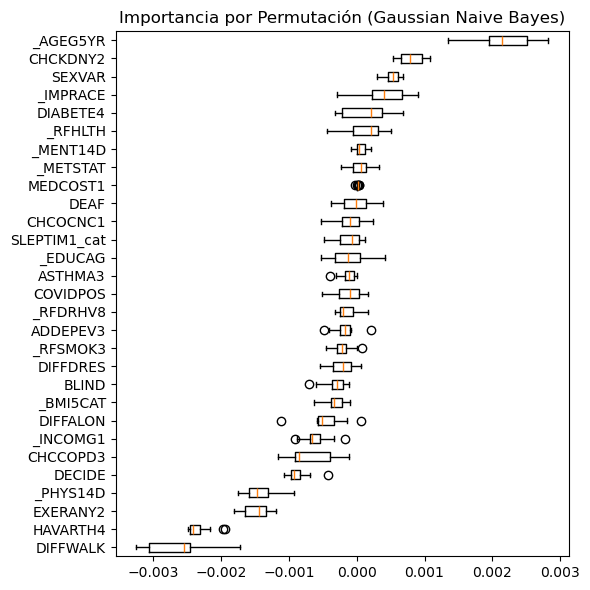

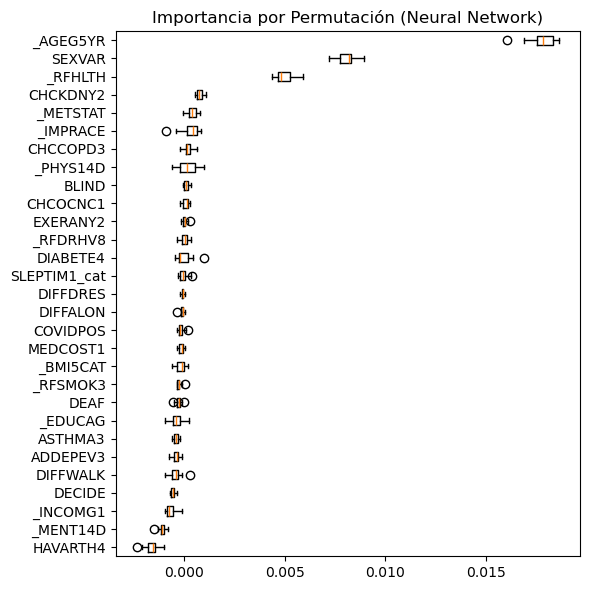

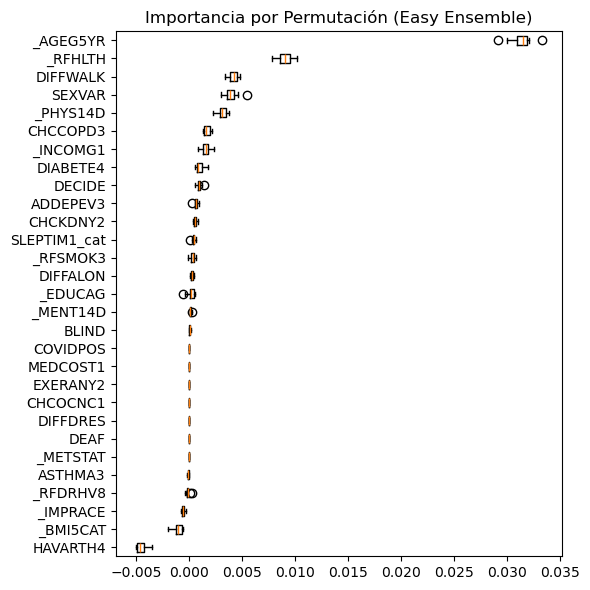

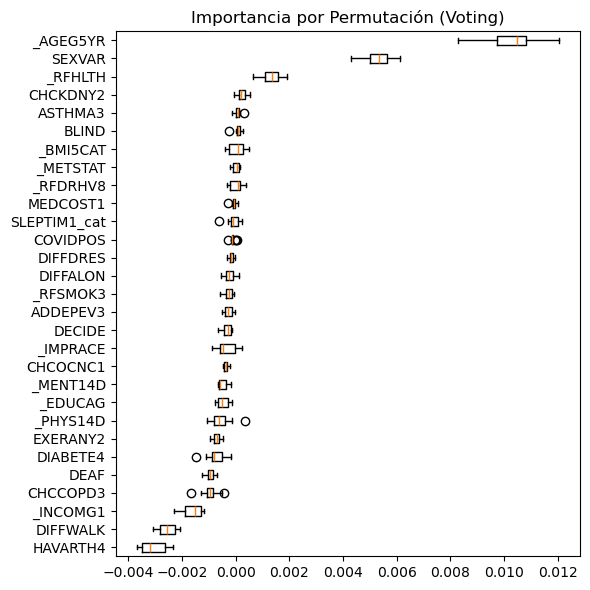

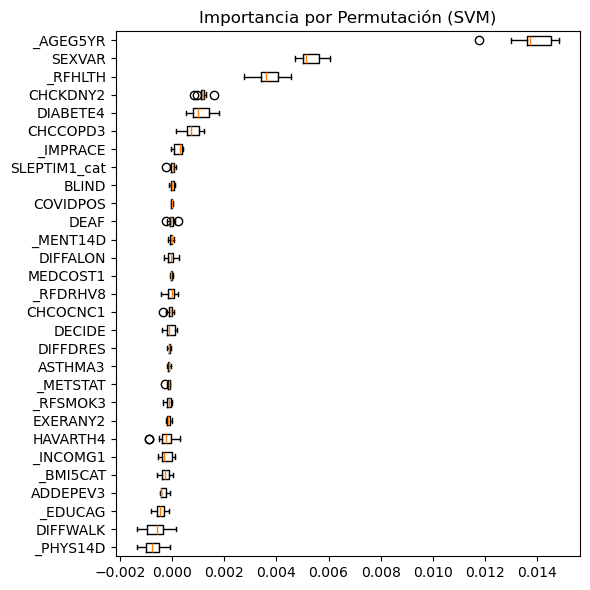

In [214]:
# Graficar importancia y permutación para los modelos con todas las variables
graficar_importancia_permutacion(modelos_optimizados_all, X_test, y_test, X)
graficar_permutacion_importancia(modelos_optimizados_all, X_test, y_test, X)

# ENTRENAMIENTO CON SOBREMUESTREO RandomOverSampler()

El capítulo 9 utiliza la técnica de sobremuestreo RandomOverSampler. A diferencia de las técnicas de submuestreo que se enfocan en reducir el número de instancias de la clase mayoritaria, RandomOverSampler se enfoca en aumentar el número de instancias de la clase minoritaria mediante la duplicación aleatoria de instancias existentes.

Una de las características clave de RandomOverSampler es su simplicidad. Es un método de sobremuestreo fácil de entender e implementar, ya que solo implica la duplicación aleatoria de instancias existentes.

## MODELO CON 11 VARIABLES

In [215]:
# Seleccionar las columnas deseadas para crear el nuevo dataset
columnas_seleccionadas = ['SEXVAR', 'EXERANY2', 'CHCCOPD3', 'CHCKDNY2', 
                          'HAVARTH4', 'DIABETE4', '_IMPRACE', '_AGEG5YR',
                          '_BMI5CAT', '_RFSMOK3', '_RFDRHV8', 'CARDIO']

# Dataset base con 11 variables
df_11vars = df.loc[:, columnas_seleccionadas]

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/RandomOverSampler/modelos_iniciales_11vars"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los modelos base
modelos_base = [
    ('Logistic Regression', LogisticRegression(class_weight='balanced', random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),
    ('Gradient Boosting', GradientBoostingClassifier(learning_rate=0.1, n_estimators=500, max_depth=3, random_state=42,
                                                     min_samples_split=5, min_samples_leaf=3, max_features='sqrt')),
    ('Xtra GBoost', XGBClassifier(learning_rate=0.1, n_estimators=500, max_depth=3, random_state=42, scale_pos_weight=1,
                                  subsample=0.8, colsample_bytree=0.8)),
    ('Light GBoost', LGBMClassifier(class_weight='balanced', verbose=-1)),
    ('Decision Tree',
     DecisionTreeClassifier(class_weight='balanced', criterion='gini', max_depth=5, min_samples_split=20,
                            min_samples_leaf=10, random_state=42)),
    ('Random Forest', RandomForestClassifier(class_weight='balanced', n_estimators=500, min_samples_split=2,
                                             max_depth=5, min_samples_leaf=1, random_state=42)),
    ('Neural Network', MLPClassifier(early_stopping=True, random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble = [
    ('Voting', VotingClassifier(estimators=modelos_base, voting='soft', n_jobs=-1)),
    ('Stacking',
     StackingClassifier(estimators=modelos_base, final_estimator=LogisticRegression(random_state=42), n_jobs=-1)),
    ('SVM', LinearSVC(class_weight='balanced', C=100.0, random_state=42, dual=False))
]

# Combinar todos los modelos
modelos = modelos_base + modelos_ensamble

# Crear el objeto de la técnica de muestreo RandomOverSampler
tecnica_muestreo = RandomOverSampler(random_state=42)

# Entrenar y evaluar modelos con 11 variables
resultados_11vars, X, X_train, y_train, X_val, y_val, X_test, y_test = entrenar_evaluar_modelos_base(
    df_11vars, modelos, carpeta_modelos, tecnica_muestreo)


Dimensiones del conjunto de entrenamiento:
X_train: (439448, 11), y_train: (439448,)

Dimensiones del conjunto de validación:
X_val: (53095, 11), y_val: (53095,)

Dimensiones del conjunto de prueba:
X_test: (53096, 11), y_test: (53096,)

Tiempo de muestreo: 0.00 minutos

Modelo Logistic Regression cargado desde archivo.
Entrenamiento Logistic Regression:
Tiempo de ejecución: 0.04 minutos
Accuracy: 0.7306302452167265
F1-score: 0.739925387890692
Precision: 0.7152444463322432
Recall: 0.7663705375835138
AUC-ROC: 0.8027825119419338
Matthews Corr Coef: 0.4624434247377376

MATRIZ DE CONFUSIÓN:
[[152684  67040]
 [ 51334 168390]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.75      0.69      0.72    219724
           1       0.72      0.77      0.74    219724

    accuracy                           0.73    439448
   macro avg       0.73      0.73      0.73    439448
weighted avg       0.73      0.73      0.73    439448



Test Logistic R

### Tabla de métricas de rendimiento modelos base

In [216]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_11vars_inicial = pd.DataFrame.from_dict(resultados_11vars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_11vars_inicial

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.704177,0.369981,0.243776,0.767132,0.803587,0.306525,0.036671
Gaussian Naive Bayes,0.773071,0.364135,0.266677,0.573852,0.780465,0.274854,0.002183
Gradient Boosting,0.693009,0.368217,0.240044,0.790086,0.807399,0.308471,1.099141
Xtra GBoost,0.692199,0.367800,0.239629,0.790752,0.807337,0.308093,0.164546
Light GBoost,0.687302,0.365353,0.237183,0.794910,0.806353,0.305911,0.025858
Decision Tree,0.623851,0.333645,0.208681,0.831670,0.785127,0.273168,0.012413
Random Forest,0.686718,0.360772,0.234583,0.780772,0.798698,0.297831,1.275849
Neural Network,0.676209,0.360892,0.232382,0.807385,0.806342,0.302823,0.866017
Easy Ensemble,0.710053,0.370734,0.245759,0.754325,0.800754,0.305251,1.848329
Voting,0.708961,0.373332,0.246849,0.765635,0.805434,0.310245,2.730387


### BÚSQUEDA DE HIPERPARÁMETROS

In [217]:

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/RandomOverSampler/modelos_entrenados_11vars"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los espacios de búsqueda de hiperparámetros para cada modelo
param_dist_lr = {
    'class_weight': ['balanced', None],
    'solver': ['newton-cg', 'newton-cholesky', 'sag', 'saga'],
    'penalty': ['l2'],
    'C': loguniform(1e-4, 1e1)
}

param_dist_gnb = {
    'var_smoothing': loguniform(1e-9, 1e-1)
}

param_dist_lgbm = {
    'class_weight': ['balanced', None],
    'n_estimators': randint(50, 251),
    'max_depth': randint(3, 31),
    'subsample': uniform(0.7, 0.3),
    'colsample_bytree': uniform(0.7, 0.3),
    'learning_rate': loguniform(1e-5, 1e-1),
    'num_leaves': randint(10, 101),
    'verbose': [-1]
}

param_dist_rf = {
    'class_weight': ['balanced_subsample', 'balanced'],
    'n_estimators': randint(50, 251),
    'criterion': ['gini', 'entropy'],
    'max_depth': randint(3, 16),
    'min_samples_leaf': randint(3, 16),
    'min_samples_split': randint(3, 16),
    'max_features': [None, 'sqrt', 'log2']
}

param_dist_ann = {
    'hidden_layer_sizes': [(100,), (50,50), (100,100), (50, 50, 50),
                           (100, 100, 100), (50, 50, 50, 50), (100, 100, 100, 100),
                           (50, 50, 50, 50, 50), (100, 100, 100, 100, 100)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': loguniform(1e-5, 1e3),
    'batch_size': [64, 128, 256, 512],
    'learning_rate': ['constant', 'adaptive'],
    'learning_rate_init': loguniform(1e-5, 1e-1),
    'early_stopping': [True],
    'max_iter': [100]
}

param_dist_eec = {
    'n_estimators': randint(2, 20),
    'sampling_strategy': ['auto']
}

param_dist_svm = {
    'dual': ['auto'],
    'tol': loguniform(1e-5, 1e-3),
    'class_weight': [None, 'balanced'],
    'penalty': ['l2'],
    'loss': ['hinge', 'squared_hinge'],
    'C': loguniform(1e-4, 1e4),
    'max_iter': randint(1000, 2001)
}

# Definir los modelos con búsqueda de hiperparámetros
modelos = [
    ('Logistic Regression', RandomizedSearchCV(LogisticRegression(), param_dist_lr,
                                               cv=30, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Gaussian Naive Bayes', RandomizedSearchCV(GaussianNB(), param_dist_gnb, cv=30,
                                                n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('Light GBoost', RandomizedSearchCV(LGBMClassifier(), param_dist_lgbm, cv=5, n_jobs=6,
                                        scoring='f1_weighted', n_iter=50)),
    ('Random Forest', RandomizedSearchCV(RandomForestClassifier(), param_dist_rf,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Neural Network', RandomizedSearchCV(MLPClassifier(), param_dist_ann, cv=5, n_jobs=6,
                                          scoring='f1_weighted', error_score=0, n_iter=50)),
    ('Easy Ensemble', RandomizedSearchCV(EasyEnsembleClassifier(), param_dist_eec,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('SVM', RandomizedSearchCV(LinearSVC(), param_dist_svm, cv=5, n_jobs=6,
                               scoring='f1_weighted', n_iter=50))
]

# Crear un diccionario para almacenar los mejores hiperparámetros de cada modelo
best_params_11vars = {}

# Entrenar y evaluar cada modelo con búsqueda de hiperparámetros
for nombre, modelo in modelos:
    nombre_archivo = f"{carpeta_modelos}/{nombre}_optimizado.pkl"
    
    # Hash del conjunto de datos actual
    hash_actual = hash_de_datos(X_train)
    
    # Cargar o entrenar modelo
    modelo_cargado, tiempo_ejecucion, mejores_parametros_cargados = cargar_modelo(nombre_archivo, hash_actual)
    
    if modelo_cargado is not None:
        print(f"Modelo {nombre} cargado desde archivo.")
        modelo_best_11vars = modelo_cargado
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros_cargados}")
        
        # Agregar los mejores hiperparámetros cargados al diccionario
        best_params_11vars[nombre] = mejores_parametros_cargados
    else:
        print(f"Entrenando nuevo modelo {nombre}.")
        inicio = time.time()  # Tiempo de inicio
        modelo.fit(X_train, y_train)

        mejores_parametros = modelo.best_params_
        
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros}")
        
        # Agregar los mejores hiperparámetros al diccionario
        best_params_11vars[nombre] = mejores_parametros
        
        # Entrenar el modelo con los mejores hiperparámetros en el conjunto de entrenamiento completo
        modelo_best_11vars = modelo.best_estimator_
        modelo_best_11vars.fit(X_train, y_train)
        
        fin = time.time()  # Tiempo de fin
        tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos
        
        # Guardar el modelo entrenado junto con el tiempo de ejecución y los mejores parámetros
        guardar_modelo(modelo_best_11vars, nombre_archivo, hash_actual, tiempo_ejecucion, mejores_parametros)

    # Imprimir métricas de la predicción en el conjunto de entrenamiento
    y_pred_train = modelo_best_11vars.predict(X_train)

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_11vars, "predict_proba"):
        y_scores = modelo_best_11vars.predict_proba(X_train)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_11vars.decision_function(X_train)  # Puntuaciones de decisión
    
    print(f"Entrenamiento {nombre}:")
    print(f"Tiempo de búsqueda de hiperparámetros de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_train, y_pred_train)}")
    print(f"F1-score: {f1_score(y_train, y_pred_train)}")
    print(f"Precision: {precision_score(y_train, y_pred_train)}")
    print(f"Recall: {recall_score(y_train, y_pred_train)}")
    print(f"AUC-ROC: {roc_auc_score(y_train, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_train, y_pred_train)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_train, y_pred_train))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_train, y_pred_train))
    print("\n")

    # Predecir en el conjunto de validación
    inicio = time.time()  # Tiempo de inicio
    y_pred_val = modelo_best_11vars.predict(X_val)
    fin = time.time()  # Tiempo de fin
    tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_11vars, "predict_proba"):
        y_scores = modelo_best_11vars.predict_proba(X_val)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_11vars.decision_function(X_val)  # Puntuaciones de decisión
    

    # Imprimir métricas de la predicción en el conjunto de validación
    print(f"Validación {nombre}:")
    print(f"Tiempo de ejecución de predicción de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_val, y_pred_val)}")
    print(f"F1-score: {f1_score(y_val, y_pred_val)}")
    print(f"Precision: {precision_score(y_val, y_pred_val)}")
    print(f"Recall: {recall_score(y_val, y_pred_val)}")
    print(f"AUC-ROC: {roc_auc_score(y_val, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_val, y_pred_val)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_val, y_pred_val))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_val, y_pred_val))
    print("\n")
    
 

Modelo Logistic Regression cargado desde archivo.
Mejores hiperparámetros para Logistic Regression: {'solver': 'newton-cg', 'penalty': 'l2', 'class_weight': 'balanced', 'C': 0.01}
Entrenamiento Logistic Regression:
Tiempo de búsqueda de hiperparámetros de Logistic Regression: 17.34 minutos
Accuracy: 0.7306279696346325
F1-score: 0.7398951890223135
Precision: 0.7152871302271636
Recall: 0.7662567584788189
AUC-ROC: 0.802735004158333
Matthews Corr Coef: 0.4624314641918791

MATRIZ DE CONFUSIÓN:
[[152708  67016]
 [ 51359 168365]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.75      0.69      0.72    219724
           1       0.72      0.77      0.74    219724

    accuracy                           0.73    439448
   macro avg       0.73      0.73      0.73    439448
weighted avg       0.73      0.73      0.73    439448



Validación Logistic Regression:
Tiempo de ejecución de predicción de Logistic Regression: 0.00 minutos
Accuracy: 0.

### Entrenar modelos con los mejores parámetros

In [218]:
# Combinar los conjuntos de entrenamiento y validación para 11 variables
X_train_val_11vars = pd.concat([X_train, X_val], ignore_index=True)
y_train_val_11vars = pd.concat([y_train, y_val], ignore_index=True)

# Definir los modelos base
modelos_entrenados = [
    ('Logistic Regression', LogisticRegression(random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),    
    ('Light GBoost', LGBMClassifier(verbosity=-1, random_state=42)),
    ('Random Forest', RandomForestClassifier(random_state=42)),   
    ('Neural Network', MLPClassifier(random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble = [   
    ('Voting', VotingClassifier(estimators=modelos_entrenados, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(random_state=42)) 
]

# Combinar todos los modelos
modelos_optimizados = modelos_entrenados + modelos_ensamble

# Crear el objeto de la técnica de muestreo RandomOverSampler
tecnica_muestreo = RandomOverSampler(random_state=42)

# Entrenar y evaluar modelos con 11 variables
resultados_optimizados_11vars, roc_data_11vars, pr_data_11vars, modelos_optimizados = entrenar_evaluar_modelos(
    X_train_val_11vars, y_train_val_11vars, X_test, y_test, modelos_optimizados, best_params_11vars, carpeta_modelos,
    tecnica_muestreo
)



Tiempo de muestreo: 0.00 minutos

Modelo Logistic Regression cargado desde archivo.
Test Logistic Regression:
Mejores hiperparámetros para Logistic Regression: {'solver': 'newton-cg', 'penalty': 'l2', 'class_weight': 'balanced', 'C': 0.01}
Tiempo de ejecución de entrenamiento: 0.02 minutos
Tiempo de ejecución de predicción: 0.00 minutos
Accuracy: 0.7043468434533675
F1-score: 0.3700642054574639
Precision: 0.24386503067484663
Recall: 0.7669660678642715
AUC-ROC: 0.8035841599444895
Matthews Corr Coef: 0.3065949559790915

MATRIZ DE CONFUSIÓN:
[[32787 14297]
 [ 1401  4611]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.96      0.70      0.81     47084
           1       0.24      0.77      0.37      6012

    accuracy                           0.70     53096
   macro avg       0.60      0.73      0.59     53096
weighted avg       0.88      0.70      0.76     53096



Modelo Gaussian Naive Bayes cargado desde archivo.
Test Gaussian Nai

### Tabla de métricas de rendimiento con los mejores parámetros

In [219]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_11vars_opt = pd.DataFrame.from_dict(resultados_optimizados_11vars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_11vars_opt

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.704347,0.370064,0.243865,0.766966,0.803584,0.306595,0.021095
Gaussian Naive Bayes,0.738756,0.369643,0.254299,0.676480,0.790146,0.292288,0.002649
Light GBoost,0.692651,0.366228,0.238891,0.784265,0.804813,0.305039,0.054366
Random Forest,0.698433,0.362630,0.238357,0.757651,0.792563,0.296108,0.721281
Neural Network,0.697717,0.367961,0.241048,0.777112,0.801154,0.305849,2.470475
Easy Ensemble,0.711353,0.371060,0.246295,0.751996,0.800954,0.305252,0.479243
Voting,0.714536,0.374789,0.249191,0.755655,0.804188,0.310273,2.228501
SVM,0.700637,0.369121,0.242402,0.773453,0.803548,0.306594,0.013912


### Visualizar comparación de rendimiento de curvas ROC-AUC Y PR-AUC

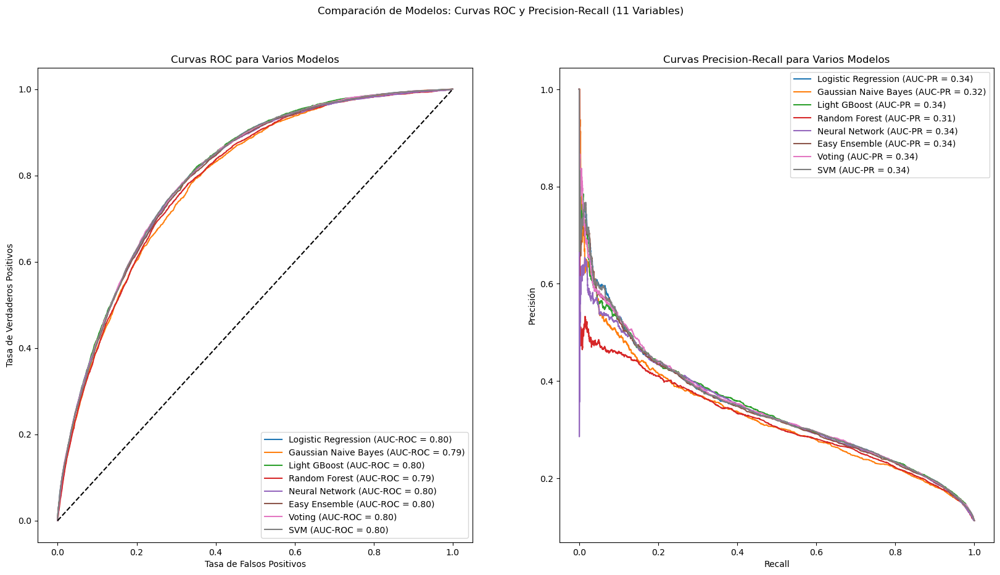

In [220]:
# Graficar curvas de rendimiento para los modelos con 11 variables
graficar_curvas_rendimiento(roc_data_11vars, pr_data_11vars, 
                            'Comparación de Modelos: Curvas ROC y Precision-Recall (11 Variables)')

### EXPLICABILIDAD

#### SHAP values

Valores SHAP para Logistic Regression:


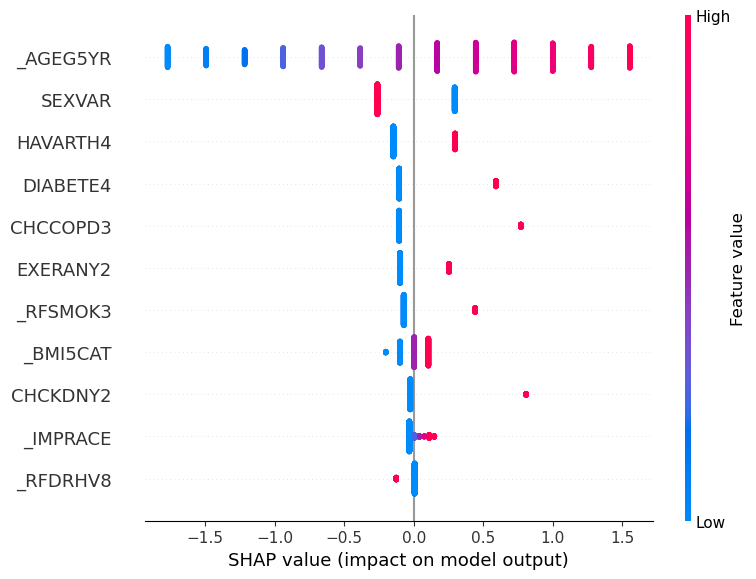

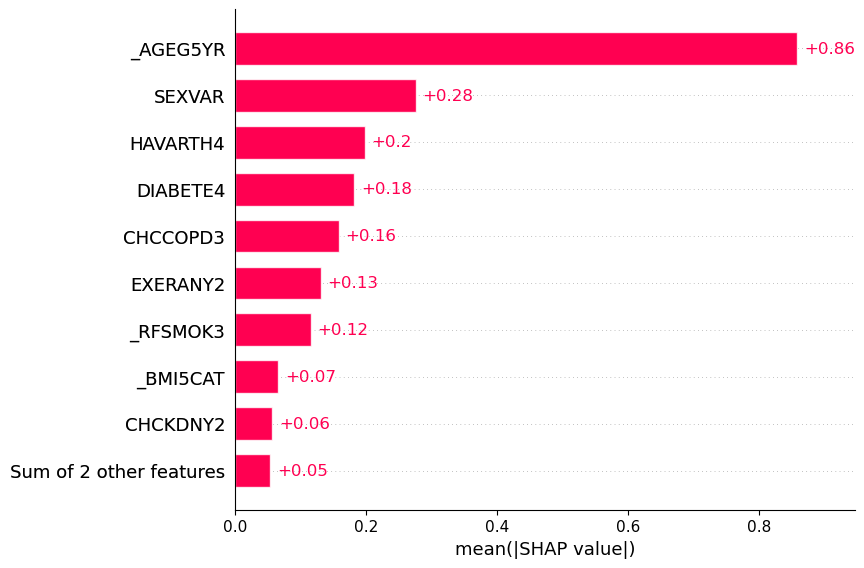

Valores SHAP para Gaussian Naive Bayes:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:24<00:00,  1.44s/it]


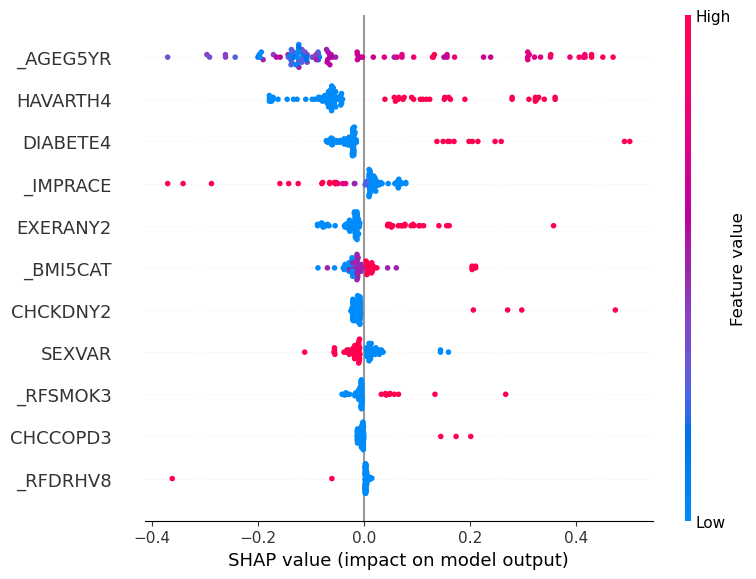

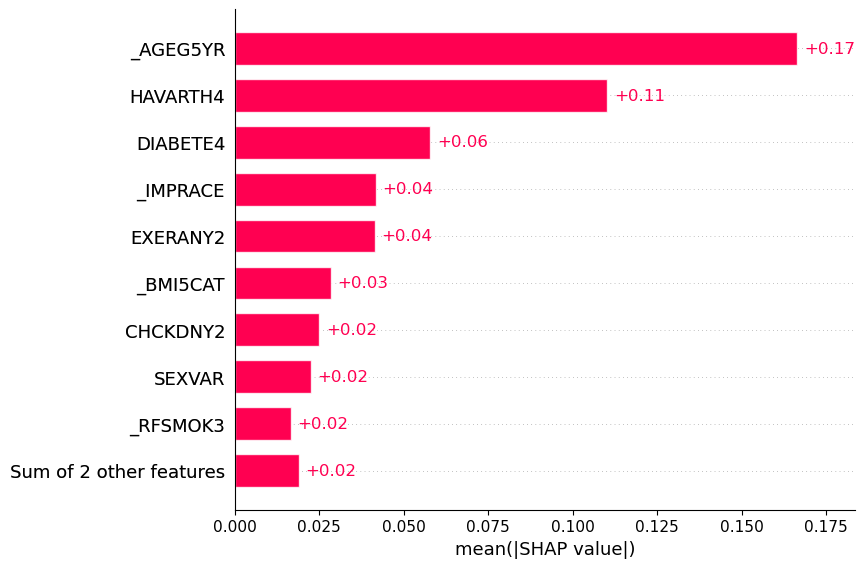

Valores SHAP para Light GBoost:


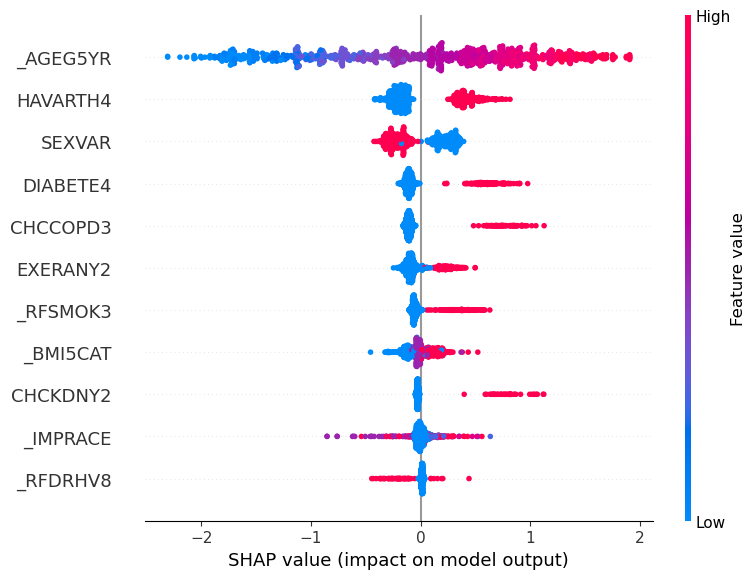

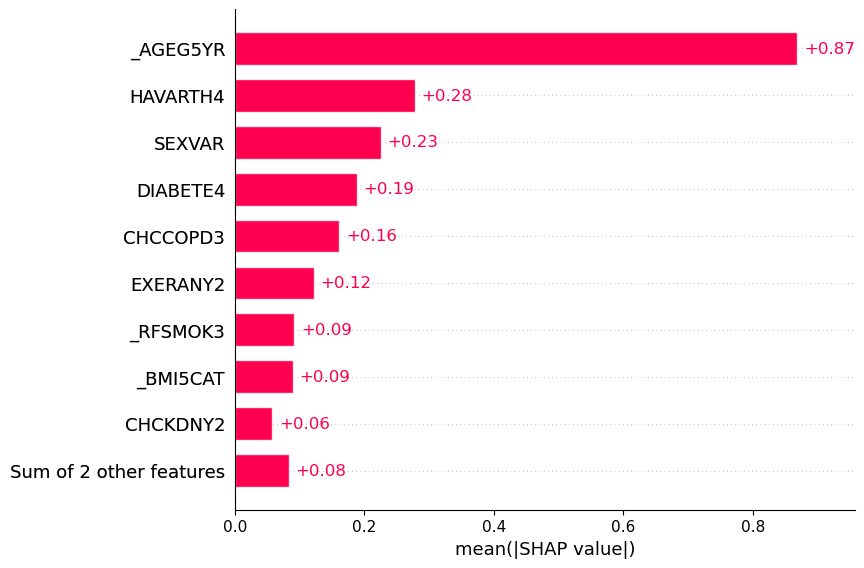

Valores SHAP para Random Forest:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [02:45<00:00,  2.21s/it]


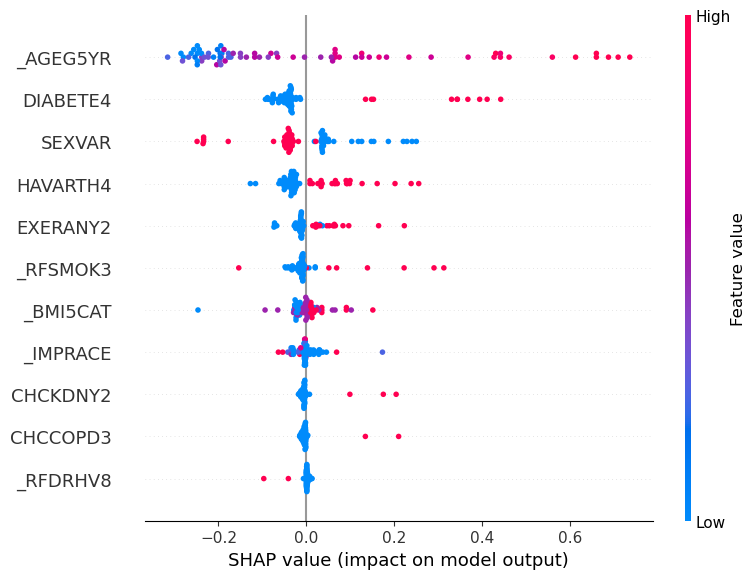

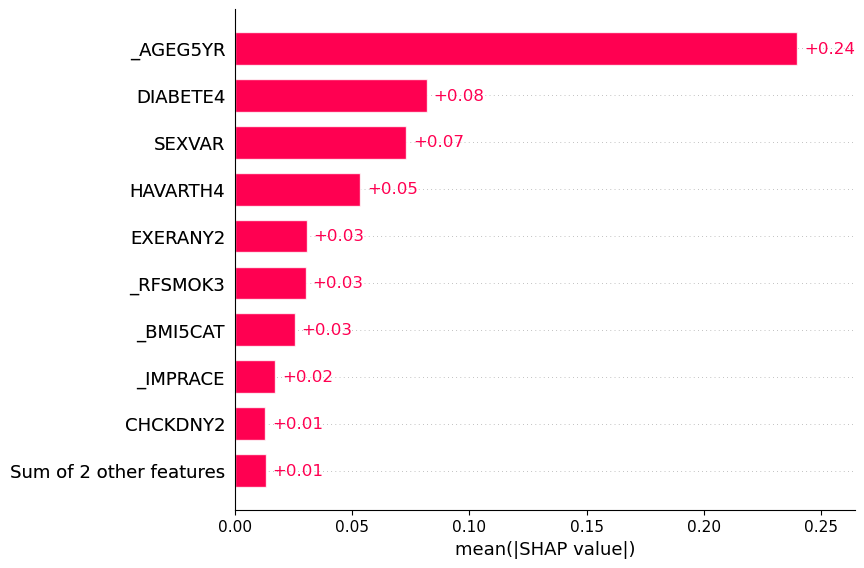

Valores SHAP para Neural Network:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [01:25<00:00,  1.14s/it]


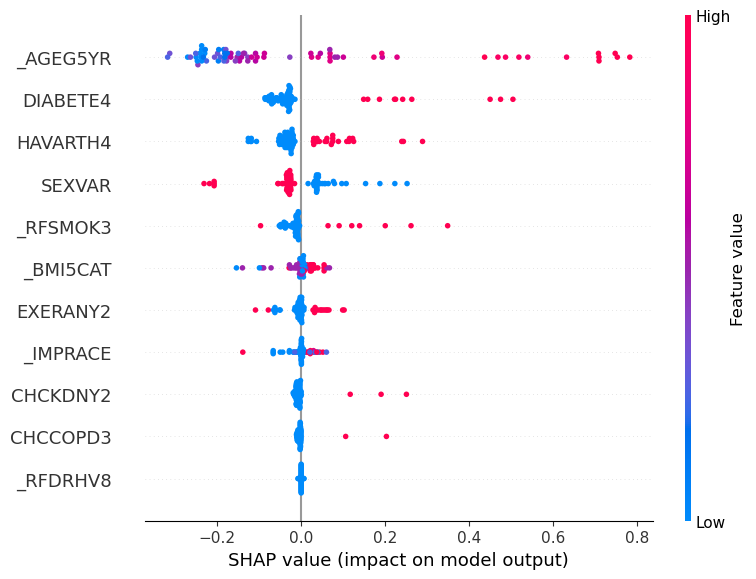

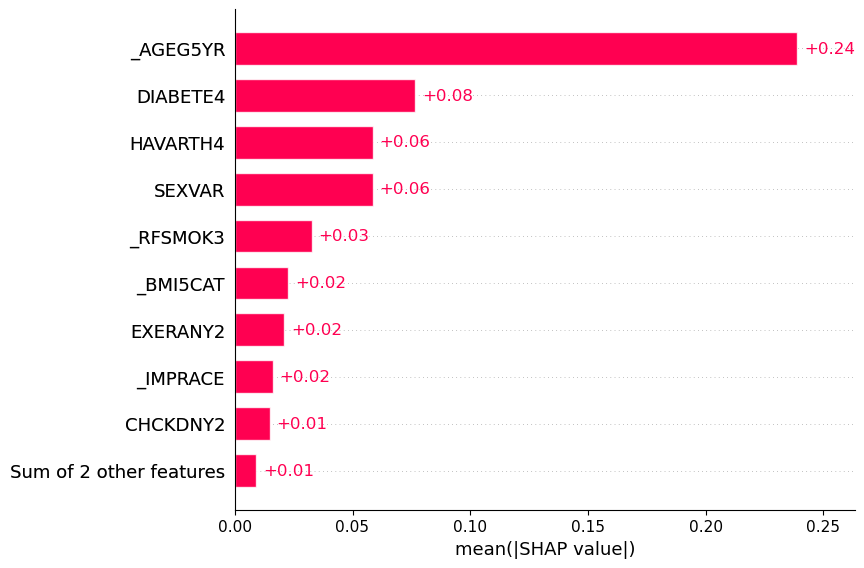

Valores SHAP para Easy Ensemble:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [01:12<00:00,  1.44s/it]


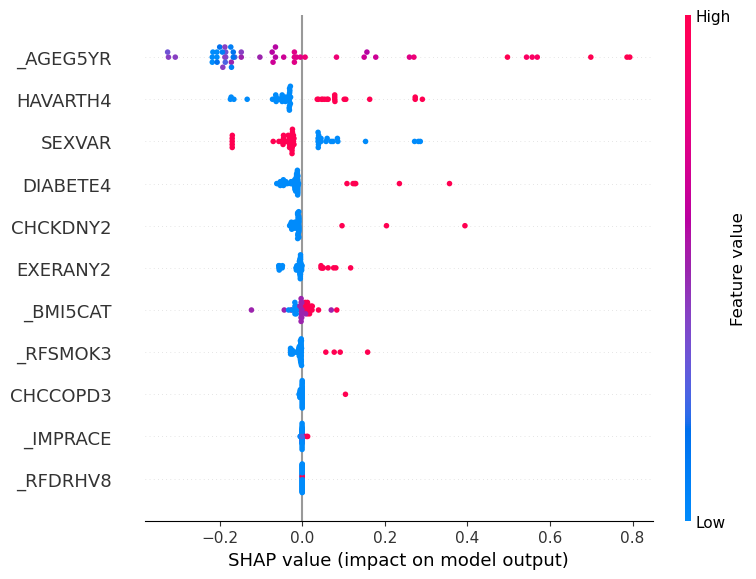

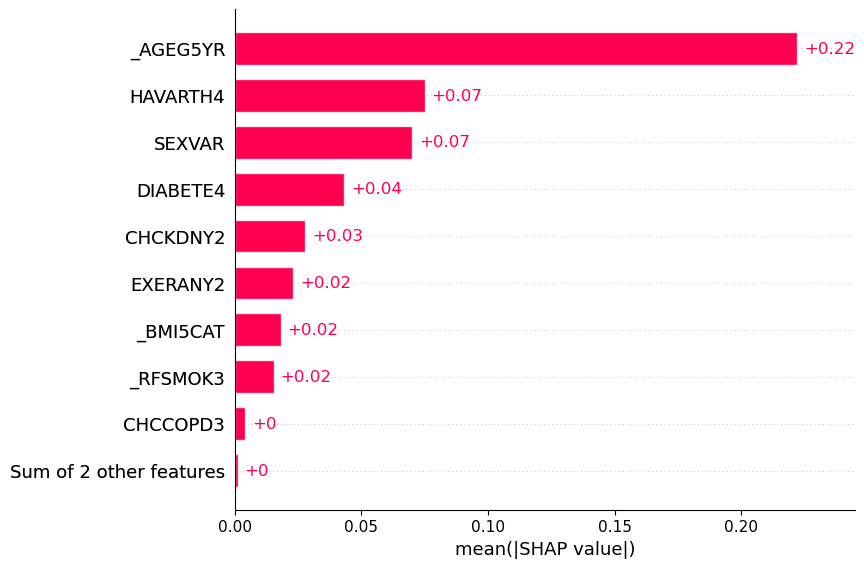

Valores SHAP para Voting:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [02:13<00:00,  2.68s/it]


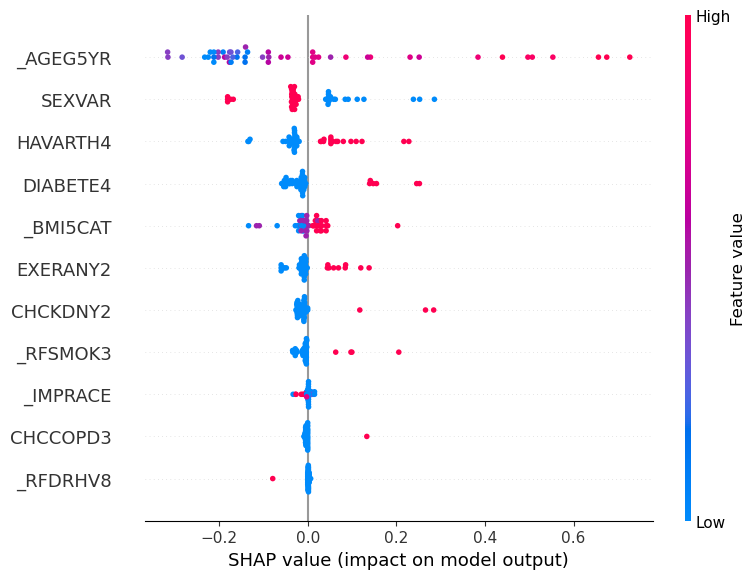

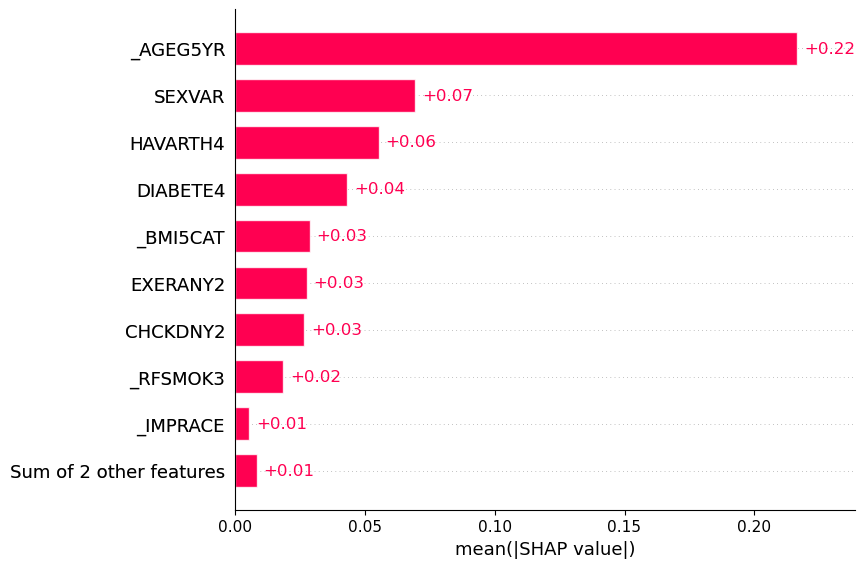

Valores SHAP para SVM:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:08<00:00,  1.28s/it]


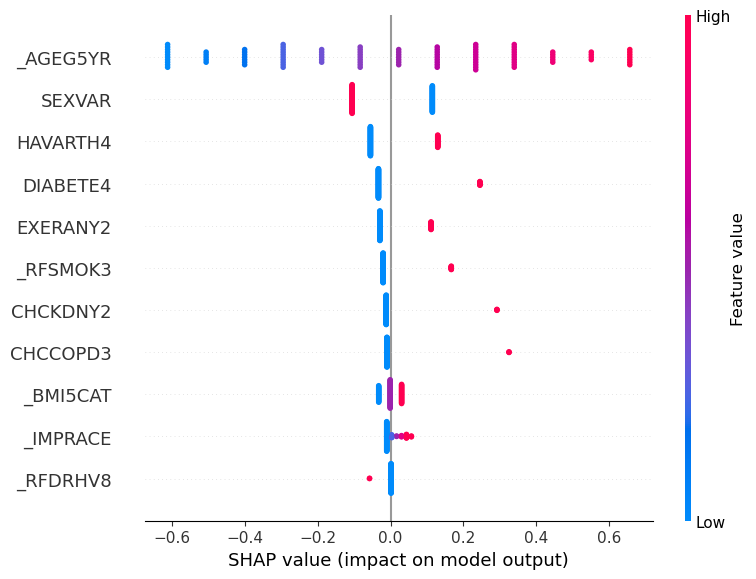

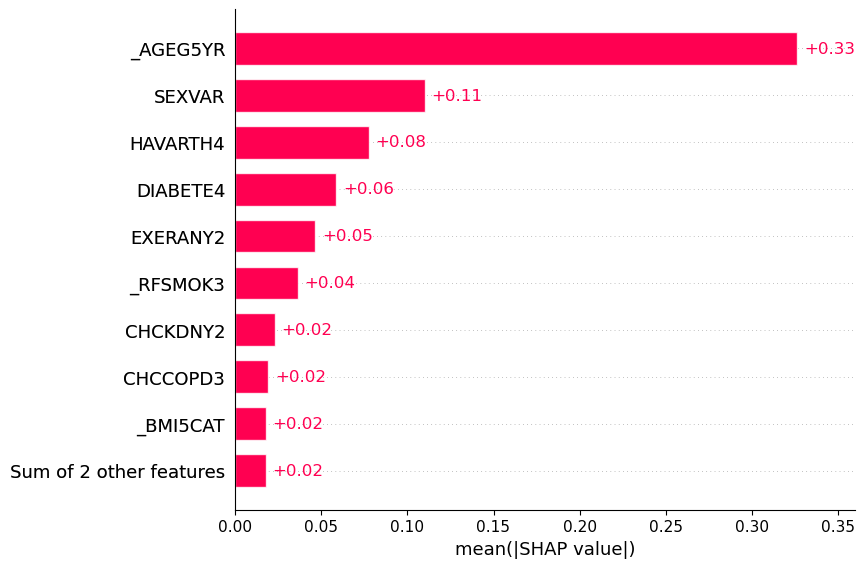

In [221]:
# Diccionario para mapear los tipos de modelo a sus correspondientes objetos explainer de SHAP
explainer_dict = {
    LogisticRegression: shap.LinearExplainer,
    GaussianNB: shap.KernelExplainer,
    LGBMClassifier: shap.TreeExplainer,
    RandomForestClassifier: shap.KernelExplainer,
    MLPClassifier: shap.KernelExplainer,
    EasyEnsembleClassifier: shap.KernelExplainer,
    VotingClassifier: shap.KernelExplainer,
    LinearSVC: shap.KernelExplainer    
    
}

# Diccionario para mapear los nombres de los modelos a sus correspondientes tamaños de muestra
sample_sizes = {
    'Logistic Regression': 1000,
    'Gaussian Naive Bayes': 100,
    'Light GBoost': 1000,
    'Random Forest': 75,
    'Neural Network': 75,
    'Easy Ensemble': 50,
    'SVM': 100,
    'Voting': 50
}

# Iterar sobre los modelos optimizados para graficar la importancia de las variables creadas por SHAP
for nombre, modelo in modelos_optimizados:
    print(f"Valores SHAP para {nombre}:")
    
    # Obtener el tamaño de muestra específico para el modelo actual
    sample_size = sample_sizes.get(nombre, 50)  # Valor predeterminado de 50 si no se encuentra el nombre del modelo
    
    # Tomar una muestra aleatoria de los datos de prueba para el cálculo de SHAP
    X_test_sample = shap.utils.sample(X_test, nsamples=sample_size, random_state=42)
    
    explainer_class = explainer_dict.get(type(modelo))
    if explainer_class is None:
        print(f"No se puede calcular los valores SHAP para {nombre}")
        continue
    
    if explainer_class == shap.KernelExplainer:
        if isinstance(modelo, LinearSVC):
            explainer = explainer_class(modelo.decision_function, X_test_sample)
        else:
            explainer = explainer_class(modelo.predict, X_test_sample)
    else:
        explainer = explainer_class(modelo, X_test_sample)
    
    shap_values = explainer(X_test_sample)
    
    # Graficar el Summary Plot de SHAP
    shap.summary_plot(shap_values, X_test_sample)
    plt.show()
    
    # Graficar el Bar Plot de SHAP
    shap.plots.bar(shap_values)
    plt.show()

#### Importancia y permutación de características

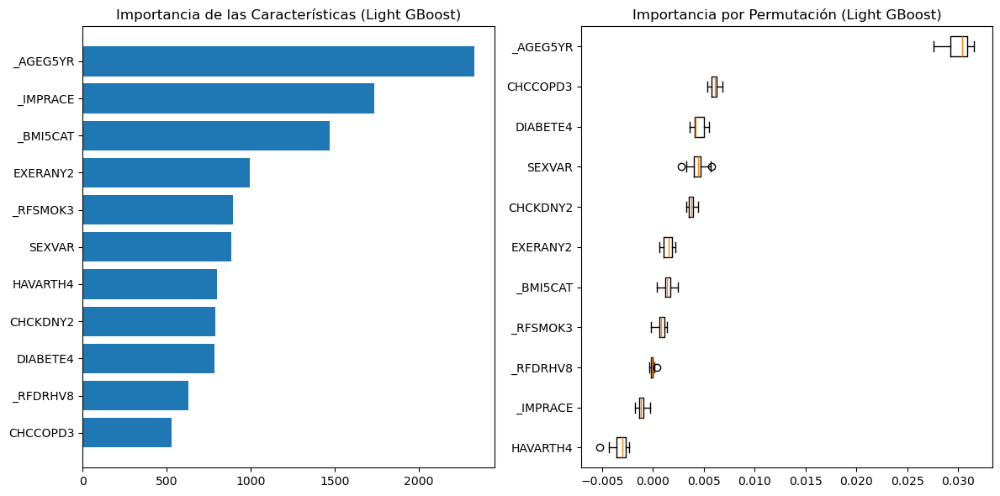

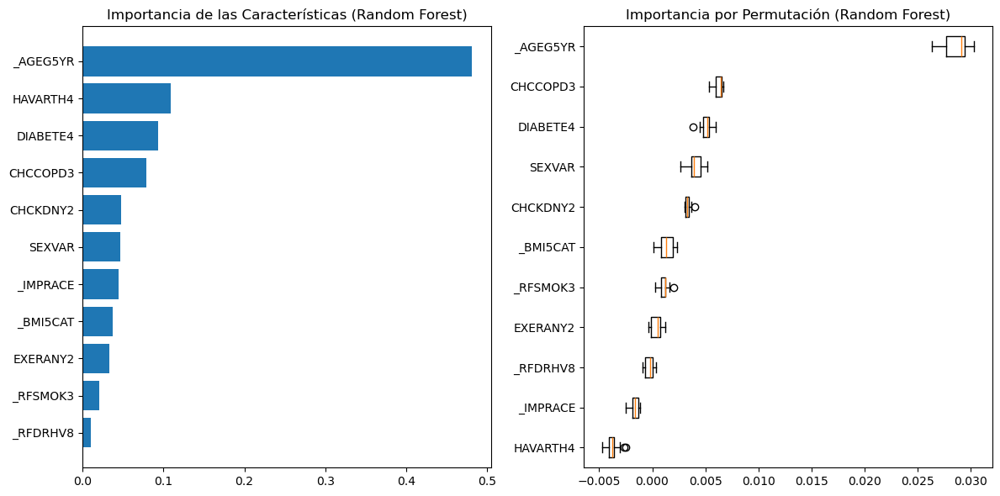

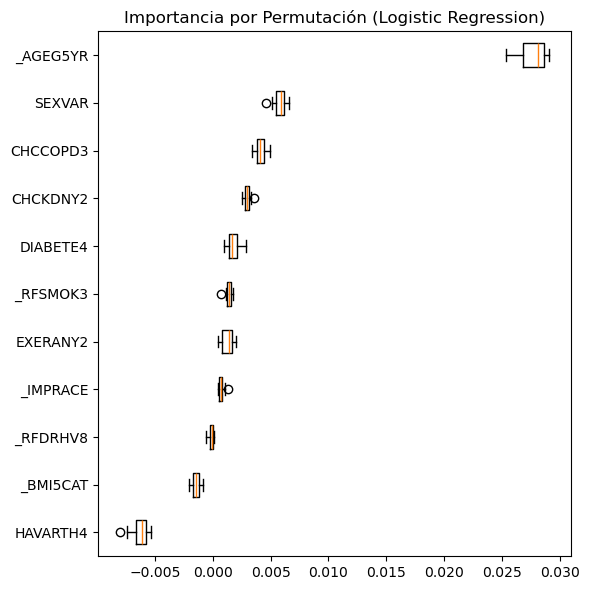

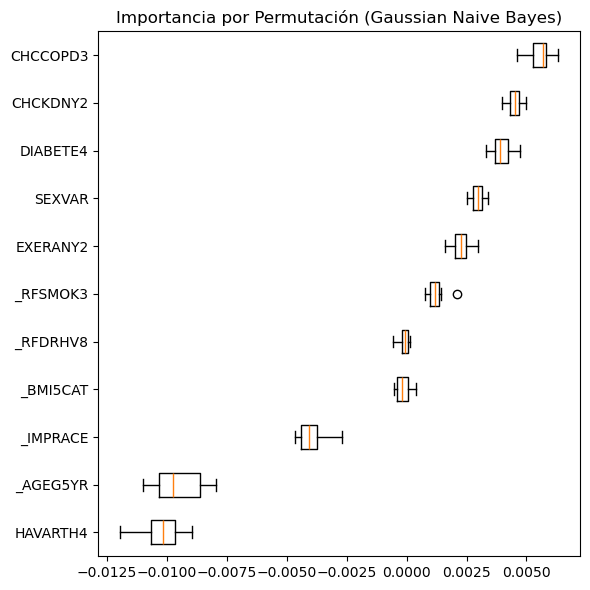

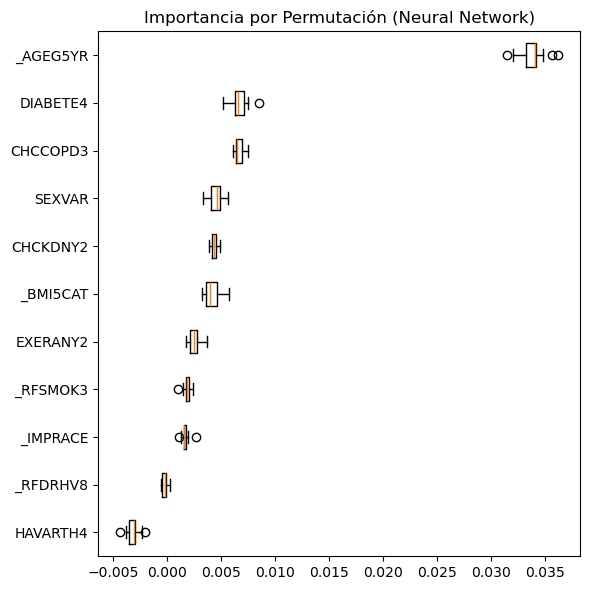

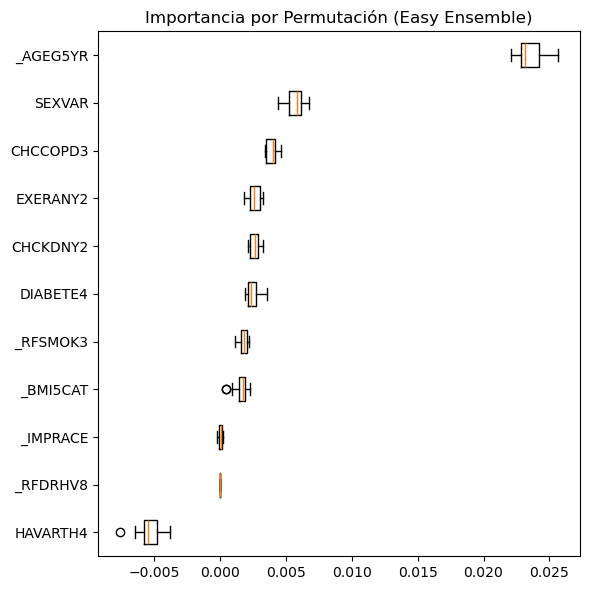

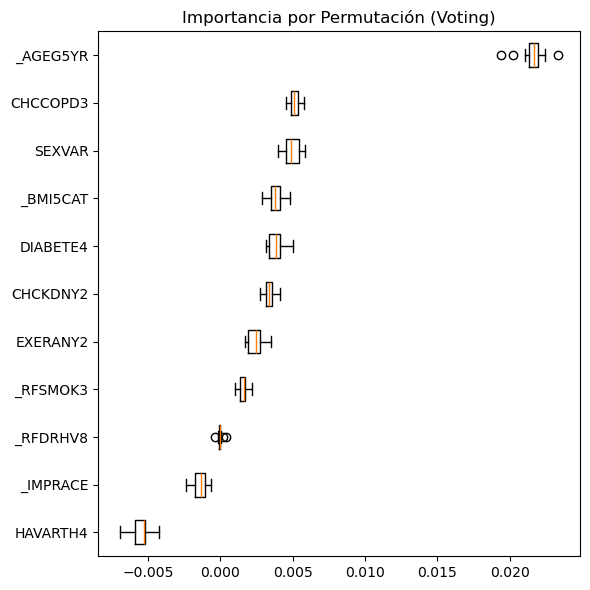

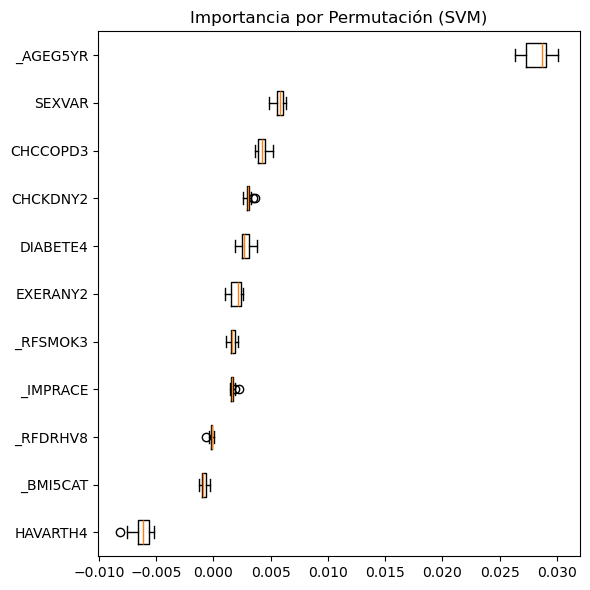

In [222]:
# Graficar importancia y permutación para los modelos con 11 variables
graficar_importancia_permutacion(modelos_optimizados, X_test, y_test, X)
graficar_permutacion_importancia(modelos_optimizados, X_test, y_test, X)

## MODELOS CON TODAS(29) LAS VARIABLES

In [223]:

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/RandomOverSampler/modelos_iniciales_all"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los modelos base
modelos_base = [
    ('Logistic Regression', LogisticRegression(class_weight='balanced', max_iter=200, random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),
    ('Light GBoost', LGBMClassifier(class_weight='balanced', verbose=-1)),
    ('Random Forest', RandomForestClassifier(class_weight='balanced', n_estimators=500, min_samples_split=2,
                                             max_depth=5, min_samples_leaf=1, random_state=42)),
    ('Neural Network', MLPClassifier(early_stopping=True, random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble = [   
    ('Voting', VotingClassifier(estimators=modelos_base, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(class_weight='balanced', C=100.0, random_state=42, dual=False))
]

# Combinar todos los modelos
modelos = modelos_base + modelos_ensamble

# Crear el objeto de la técnica de muestreo RandomOverSampler
tecnica_muestreo = RandomOverSampler(random_state=42)

# Entrenar y evaluar modelos con todas las variables
resultados_allvars, X, X_train, y_train, X_val, y_val, X_test, y_test = entrenar_evaluar_modelos_base(
    df, modelos, carpeta_modelos, tecnica_muestreo)


Dimensiones del conjunto de entrenamiento:
X_train: (439448, 29), y_train: (439448,)

Dimensiones del conjunto de validación:
X_val: (53095, 29), y_val: (53095,)

Dimensiones del conjunto de prueba:
X_test: (53096, 29), y_test: (53096,)

Tiempo de muestreo: 0.00 minutos

Modelo Logistic Regression cargado desde archivo.
Entrenamiento Logistic Regression:
Tiempo de ejecución: 0.07 minutos
Accuracy: 0.7490351531921866
F1-score: 0.7534472582895161
Precision: 0.740430075399406
Recall: 0.7669303307786132
AUC-ROC: 0.8244195317552501
Matthews Corr Coef: 0.49838961464125053

MATRIZ DE CONFUSIÓN:
[[160649  59075]
 [ 51211 168513]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.76      0.73      0.74    219724
           1       0.74      0.77      0.75    219724

    accuracy                           0.75    439448
   macro avg       0.75      0.75      0.75    439448
weighted avg       0.75      0.75      0.75    439448



Test Logistic 

### Tabla de métricas de rendimiento modelos base

In [224]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_allvars_inicial = pd.DataFrame.from_dict(resultados_allvars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_allvars_inicial

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.735479,0.399761,0.268994,0.777944,0.828789,0.343012,0.065379
Gaussian Naive Bayes,0.777027,0.382839,0.278794,0.610778,0.795775,0.300104,0.004915
Light GBoost,0.721938,0.393924,0.261500,0.798071,0.831528,0.340018,0.038521
Random Forest,0.724800,0.387748,0.259158,0.769627,0.819319,0.327789,2.184152
Neural Network,0.713745,0.384930,0.254345,0.791084,0.822752,0.328354,2.665695
Easy Ensemble,0.732353,0.394013,0.264923,0.768463,0.824227,0.334791,4.684425
Voting,0.765331,0.410819,0.286998,0.722555,0.827883,0.346282,5.356071
SVM,0.732880,0.398235,0.267301,0.780605,0.828751,0.341752,0.034006


### BÚSQUEDA DE HIPERPARÁMETROS

In [225]:

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/RandomOverSampler/modelos_entrenados_all"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)


In [226]:

# Definir los espacios de búsqueda de hiperparámetros para cada modelo
param_dist_lr = {
    'class_weight': ['balanced', None],
    'solver': ['newton-cg', 'newton-cholesky', 'sag', 'saga'],
    'penalty': ['l2'],
    'C': loguniform(1e-4, 1e1)
}

param_dist_gnb = {
    'var_smoothing': loguniform(1e-9, 1e-1)
}

param_dist_lgbm = {
    'class_weight': ['balanced', None],
    'n_estimators': randint(50, 251),
    'max_depth': randint(3, 31),
    'subsample': uniform(0.7, 0.3),
    'colsample_bytree': uniform(0.7, 0.3),
    'learning_rate': loguniform(1e-5, 1e-1),
    'num_leaves': randint(10, 101),
    'verbose': [-1]
}

param_dist_rf = {
    'class_weight': ['balanced_subsample', 'balanced'],
    'n_estimators': randint(50, 251),
    'criterion': ['gini', 'entropy'],
    'max_depth': randint(3, 16),
    'min_samples_leaf': randint(3, 16),
    'min_samples_split': randint(3, 16),
    'max_features': [None, 'sqrt', 'log2']
}

param_dist_ann = {
    'hidden_layer_sizes': [(100,), (50,50), (100,100), (50, 50, 50),
                           (100, 100, 100), (50, 50, 50, 50), (100, 100, 100, 100),
                           (50, 50, 50, 50, 50), (100, 100, 100, 100, 100)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': loguniform(1e-5, 1e3),
    'batch_size': [64, 128, 256, 512],
    'learning_rate': ['constant', 'adaptive'],
    'learning_rate_init': loguniform(1e-5, 1e-1),
    'early_stopping': [True],
    'max_iter': [100]
}

param_dist_eec = {
    'n_estimators': randint(2, 20),
    'sampling_strategy': ['auto']
}

param_dist_svm = {
    'dual': ['auto'],
    'tol': loguniform(1e-5, 1e-3),
    'class_weight': [None, 'balanced'],
    'penalty': ['l2'],
    'loss': ['hinge', 'squared_hinge'],
    'C': loguniform(1e-4, 1e4),
    'max_iter': randint(1000, 2001)
}

# Definir los modelos con búsqueda de hiperparámetros
modelos = [
    ('Logistic Regression', RandomizedSearchCV(LogisticRegression(), param_dist_lr,
                                               cv=30, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Gaussian Naive Bayes', RandomizedSearchCV(GaussianNB(), param_dist_gnb, cv=30,
                                                n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('Light GBoost', RandomizedSearchCV(LGBMClassifier(), param_dist_lgbm, cv=5, n_jobs=6,
                                        scoring='f1_weighted', n_iter=50)),
    ('Random Forest', RandomizedSearchCV(RandomForestClassifier(), param_dist_rf,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Neural Network', RandomizedSearchCV(MLPClassifier(), param_dist_ann, cv=5, n_jobs=6,
                                          scoring='f1_weighted', error_score=0, n_iter=50)),
    ('Easy Ensemble', RandomizedSearchCV(EasyEnsembleClassifier(), param_dist_eec,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('SVM', RandomizedSearchCV(LinearSVC(), param_dist_svm, cv=5, n_jobs=6,
                               scoring='f1_weighted', n_iter=50))
]

# Crear un diccionario para almacenar los mejores hiperparámetros de cada modelo
best_params_all = {}

# Entrenar y evaluar cada modelo con búsqueda de hiperparámetros
for nombre, modelo in modelos:
    nombre_archivo = f"{carpeta_modelos}/{nombre}_optimizado.pkl"
    
    # Hash del conjunto de datos actual
    hash_actual = hash_de_datos(X_train)
    
    # Cargar o entrenar modelo
    modelo_cargado, tiempo_ejecucion, mejores_parametros_cargados = cargar_modelo(nombre_archivo, hash_actual)
    
    if modelo_cargado is not None:
        print(f"Modelo {nombre} cargado desde archivo.")
        modelo_best_all = modelo_cargado
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros_cargados}")
        # Agregar los mejores hiperparámetros cargados al diccionario
        best_params_all[nombre] = mejores_parametros_cargados
    else:
        print(f"Entrenando nuevo modelo {nombre}.")
        inicio = time.time()  # Tiempo de inicio
        modelo.fit(X_train, y_train)
        
        mejores_parametros = modelo.best_params_
        
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros}")
        
        # Agregar los mejores hiperparámetros al diccionario
        best_params_all[nombre] = modelo.best_params_
        
        # Entrenar el modelo con los mejores hiperparámetros en el conjunto de entrenamiento completo
        modelo_best_all = modelo.best_estimator_
        modelo_best_all.fit(X_train, y_train)
        
        fin = time.time()  # Tiempo de fin
        tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos
        
        # Guardar el modelo entrenado junto con el tiempo de ejecución y los mejores parámetros
        guardar_modelo(modelo_best_all, nombre_archivo, hash_actual, tiempo_ejecucion, mejores_parametros)

    # Métricas predicción entrenamiento
    y_pred_train = modelo_best_all.predict(X_train)

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_all, "predict_proba"):
        y_scores = modelo_best_all.predict_proba(X_train)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_all.decision_function(X_train)  # Puntuaciones de decisión
    
    print(f"Entrenamiento {nombre}:")
    print(f"Tiempo de búsqueda de hiperparámetros de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_train, y_pred_train)}")
    print(f"F1-score: {f1_score(y_train, y_pred_train)}")
    print(f"Precision: {precision_score(y_train, y_pred_train)}")
    print(f"Recall: {recall_score(y_train, y_pred_train)}")
    print(f"AUC-ROC: {roc_auc_score(y_train, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_train, y_pred_train)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_train, y_pred_train))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_train, y_pred_train))
    print("\n")

    # Métricas predicción validación
    inicio = time.time()  # Tiempo de inicio
    y_pred_val = modelo_best_all.predict(X_val)
    fin = time.time()  # Tiempo de fin
    tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_all, "predict_proba"):
        y_scores = modelo_best_all.predict_proba(X_val)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_all.decision_function(X_val)  # Puntuaciones de decisión

    
    print(f"Validación {nombre}:")
    print(f"Tiempo de ejecución de predicción de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_val, y_pred_val)}")
    print(f"F1-score: {f1_score(y_val, y_pred_val)}")
    print(f"Precision: {precision_score(y_val, y_pred_val)}")
    print(f"Recall: {recall_score(y_val, y_pred_val)}")
    print(f"AUC-ROC: {roc_auc_score(y_val, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_val, y_pred_val)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_val, y_pred_val))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_val, y_pred_val))
    print("\n")

Modelo Logistic Regression cargado desde archivo.
Mejores hiperparámetros para Logistic Regression: {'solver': 'sag', 'penalty': 'l2', 'class_weight': None, 'C': 1}
Entrenamiento Logistic Regression:
Tiempo de búsqueda de hiperparámetros de Logistic Regression: 29.88 minutos
Accuracy: 0.7489919171324024
F1-score: 0.7533623262937829
Precision: 0.7404696915753524
Recall: 0.7667118748975988
AUC-ROC: 0.8244221790752684
Matthews Corr Coef: 0.498296859926558

MATRIZ DE CONFUSIÓN:
[[160678  59046]
 [ 51259 168465]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.76      0.73      0.74    219724
           1       0.74      0.77      0.75    219724

    accuracy                           0.75    439448
   macro avg       0.75      0.75      0.75    439448
weighted avg       0.75      0.75      0.75    439448



Validación Logistic Regression:
Tiempo de ejecución de predicción de Logistic Regression: 0.00 minutos
Accuracy: 0.733609567755909

### Entrenar modelos con los mejores parámetros

In [227]:

# Combinar los conjuntos de entrenamiento y validación para todas las variables
X_train_val_allvars = pd.concat([X_train, X_val], ignore_index=True)
y_train_val_allvars = pd.concat([y_train, y_val], ignore_index=True)

# Definir los modelos con los mejores hiperparámetros
modelos_entrenados_all = [
    ('Logistic Regression', LogisticRegression(random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),    
    ('Light GBoost', LGBMClassifier(verbosity=-1, random_state=42)),
    ('Random Forest', RandomForestClassifier(random_state=42)),   
    ('Neural Network', MLPClassifier(random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble_all = [   
    ('Voting', VotingClassifier(estimators=modelos_entrenados_all, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(random_state=42)) 
]

# Combinar todos los modelos
modelos_optimizados_all = modelos_entrenados_all + modelos_ensamble_all

# Crear el objeto de la técnica de muestreo RandomOverSampler
tecnica_muestreo = RandomOverSampler(random_state=42)

# Entrenar y evaluar modelos con todas las variables
resultados_optimizados_allvars, roc_data, pr_data, modelos_optimizados_all = entrenar_evaluar_modelos(
    X_train_val_allvars, y_train_val_allvars, X_test, y_test, modelos_optimizados_all, best_params_all, carpeta_modelos,
    tecnica_muestreo
)



Tiempo de muestreo: 0.00 minutos

Modelo Logistic Regression cargado desde archivo.
Test Logistic Regression:
Mejores hiperparámetros para Logistic Regression: {'solver': 'sag', 'penalty': 'l2', 'class_weight': None, 'C': 1}
Tiempo de ejecución de entrenamiento: 0.16 minutos
Tiempo de ejecución de predicción: 0.00 minutos
Accuracy: 0.7357239716739491
F1-score: 0.39946931438842764
Precision: 0.26892935346317853
Recall: 0.7762807717897539
AUC-ROC: 0.8288137640274629
Matthews Corr Coef: 0.34238598547616156

MATRIZ DE CONFUSIÓN:
[[34397 12687]
 [ 1345  4667]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.96      0.73      0.83     47084
           1       0.27      0.78      0.40      6012

    accuracy                           0.74     53096
   macro avg       0.62      0.75      0.62     53096
weighted avg       0.88      0.74      0.78     53096



Modelo Gaussian Naive Bayes cargado desde archivo.
Test Gaussian Naive Bayes:
Mej

### Tabla de métricas de rendimiento con los mejores parámetros

In [228]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_allvars_opt = pd.DataFrame.from_dict(resultados_optimizados_allvars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_allvars_opt

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.735724,0.399469,0.268929,0.776281,0.828814,0.342386,0.164179
Gaussian Naive Bayes,0.773222,0.394712,0.282833,0.653027,0.804786,0.318446,0.005298
Light GBoost,0.743352,0.400879,0.272456,0.758317,0.825954,0.340870,0.099701
Random Forest,0.766480,0.391221,0.277534,0.662675,0.807948,0.315633,2.531772
Neural Network,0.724989,0.363303,0.246188,0.692947,0.779466,0.286987,9.531316
Easy Ensemble,0.733445,0.394886,0.265754,0.768130,0.824540,0.335733,4.594530
Voting,0.755029,0.404141,0.278877,0.733699,0.825635,0.340512,8.779670
SVM,0.733012,0.398660,0.267566,0.781603,0.828776,0.342414,0.030240


### Visualizar comparación de rendimiento de curvas ROC-AUC Y PR-AUC

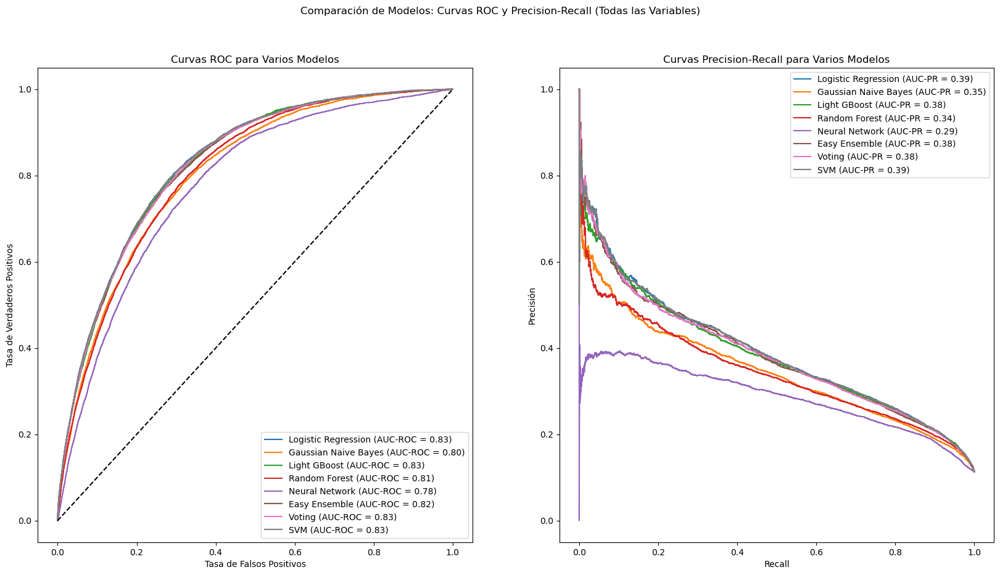

In [229]:
# Graficar curvas de rendimiento para los modelos con todas las variables
graficar_curvas_rendimiento(roc_data, pr_data, 
                            'Comparación de Modelos: Curvas ROC y Precision-Recall (Todas las Variables)')

### EXPLICABILIDAD

#### SHAP values

Valores SHAP para Logistic Regression:


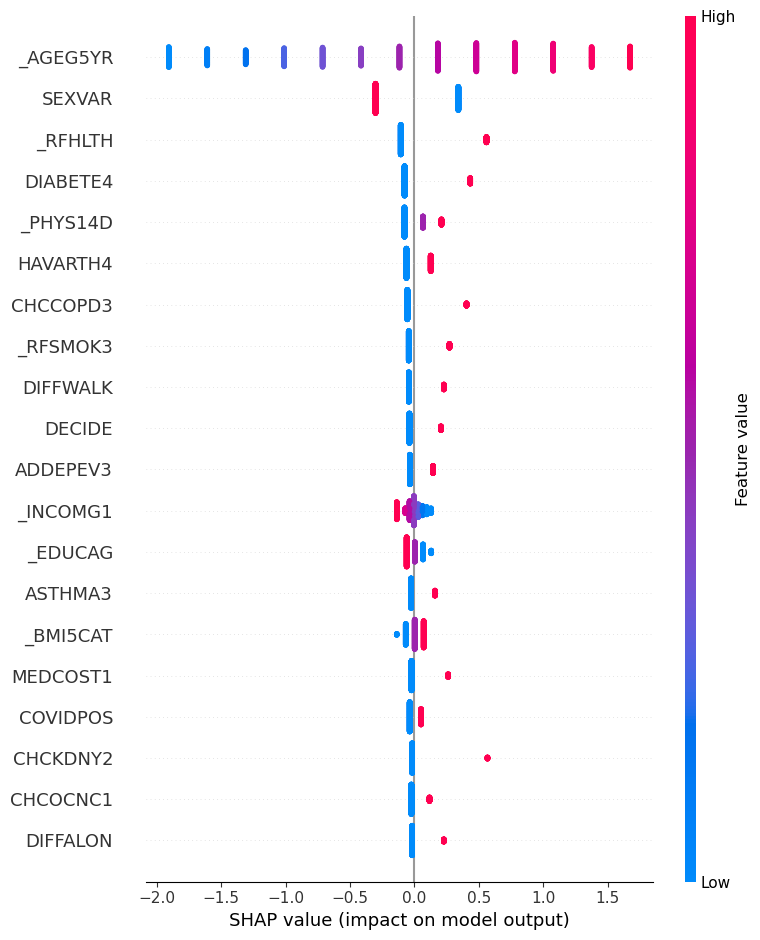

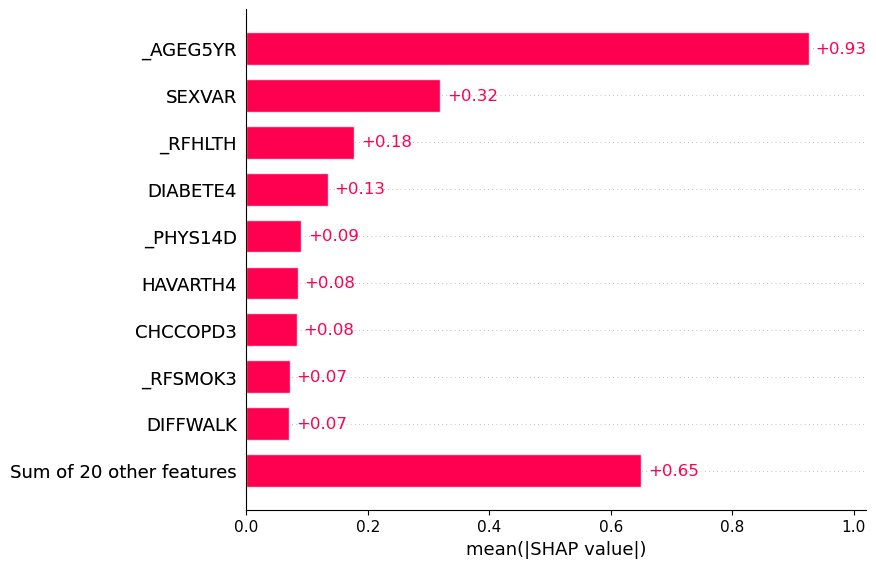

Valores SHAP para Gaussian Naive Bayes:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:35<00:00,  1.56s/it]


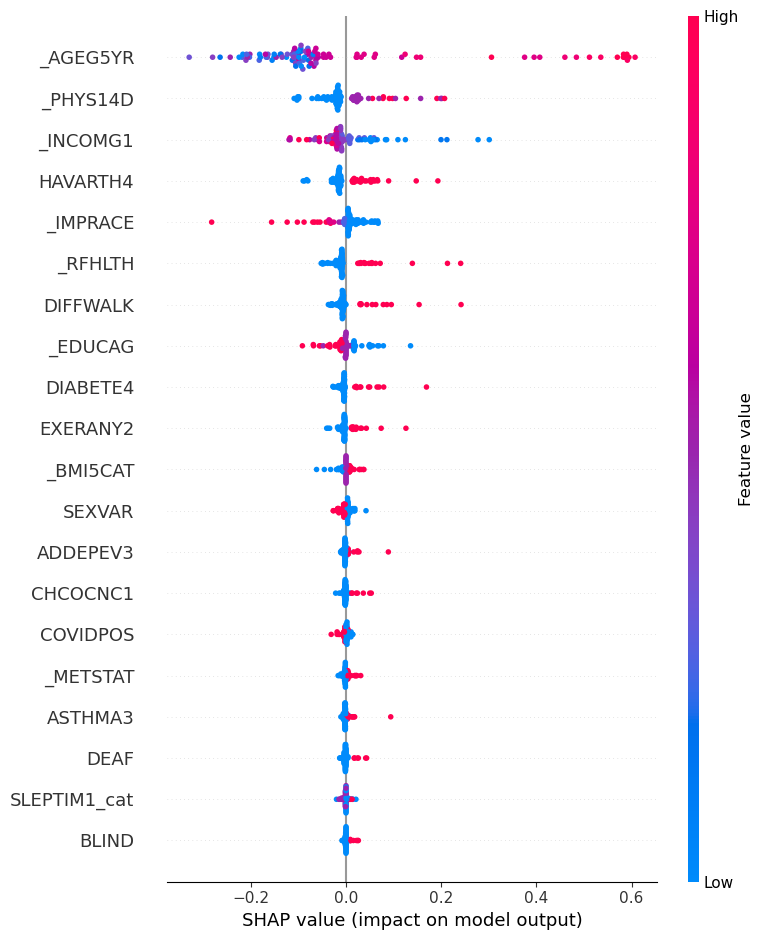

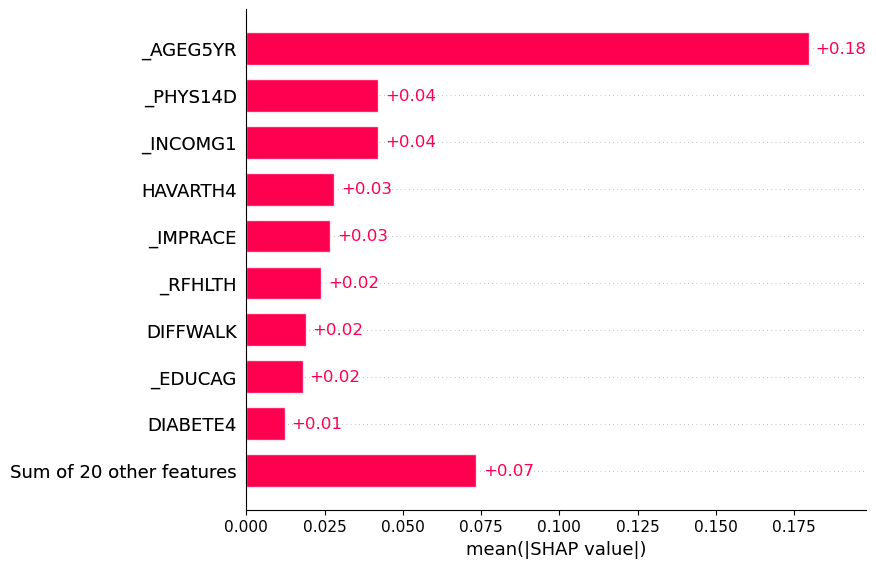

Valores SHAP para Light GBoost:


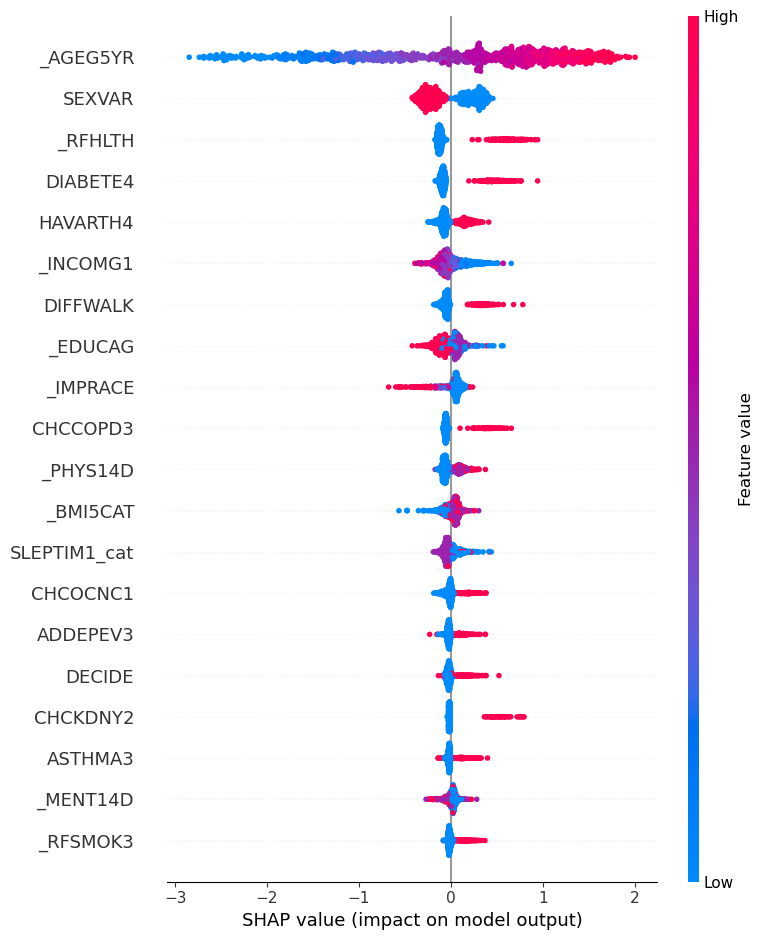

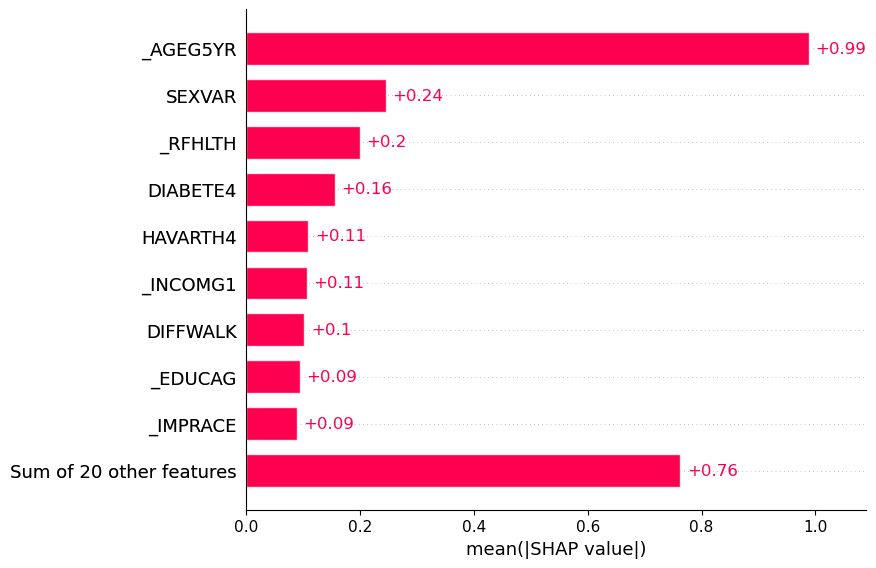

Valores SHAP para Random Forest:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [02:06<00:00,  1.69s/it]


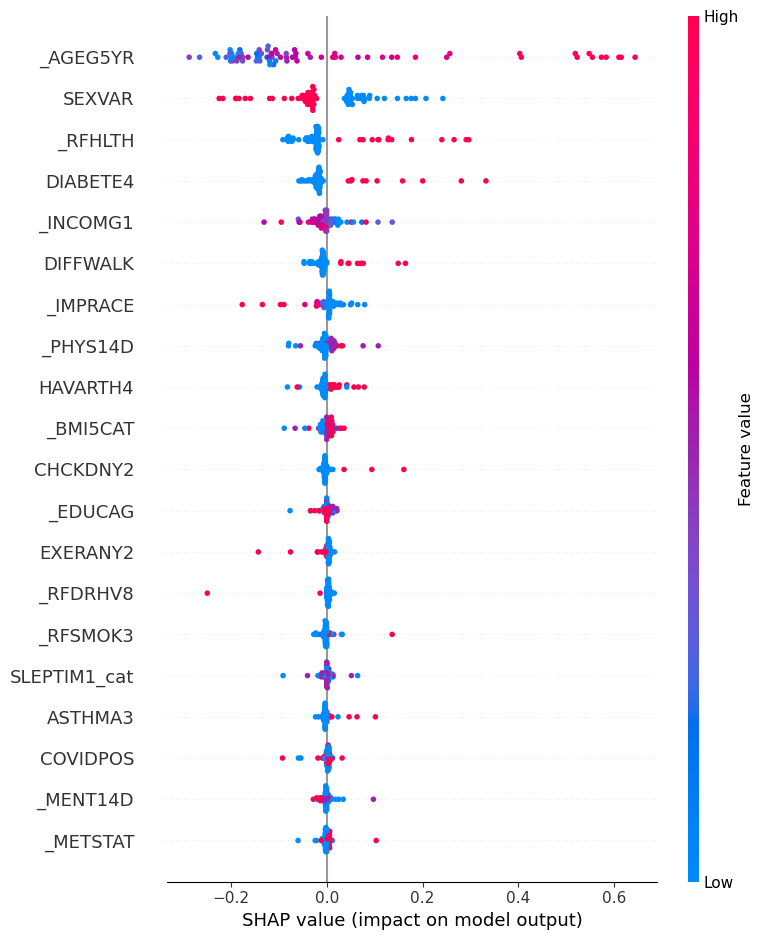

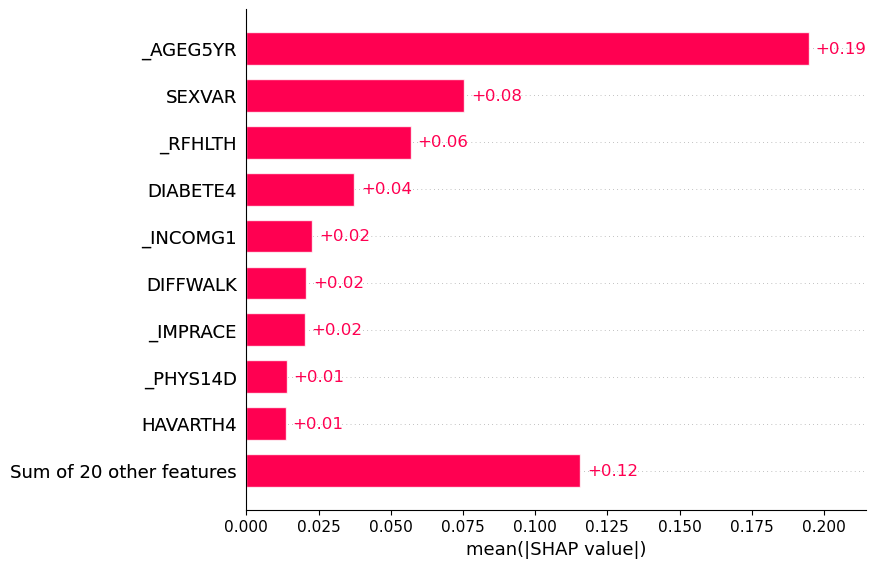

Valores SHAP para Neural Network:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [02:29<00:00,  2.00s/it]


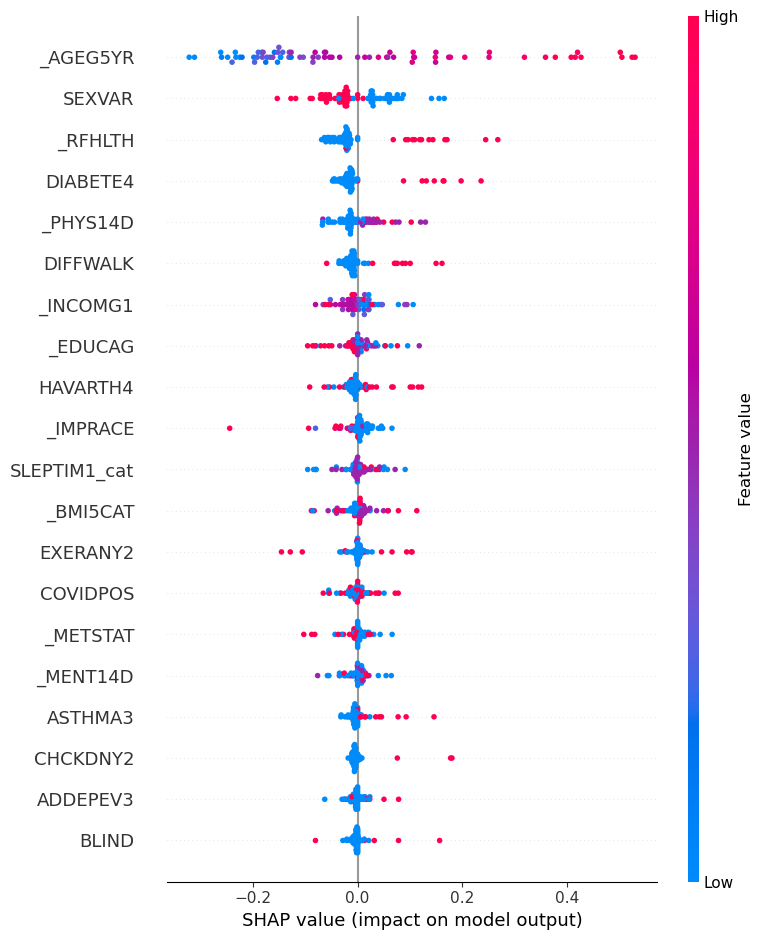

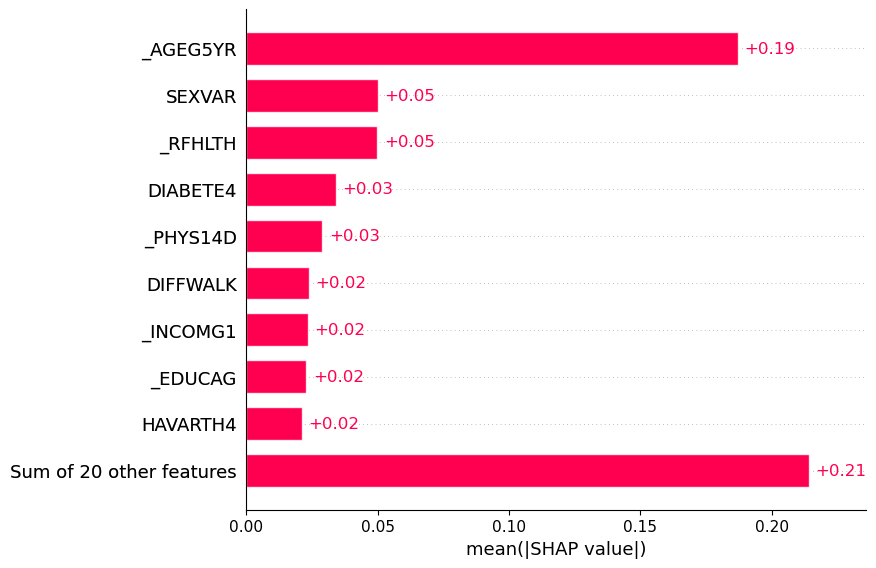

Valores SHAP para Easy Ensemble:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [04:41<00:00,  5.63s/it]


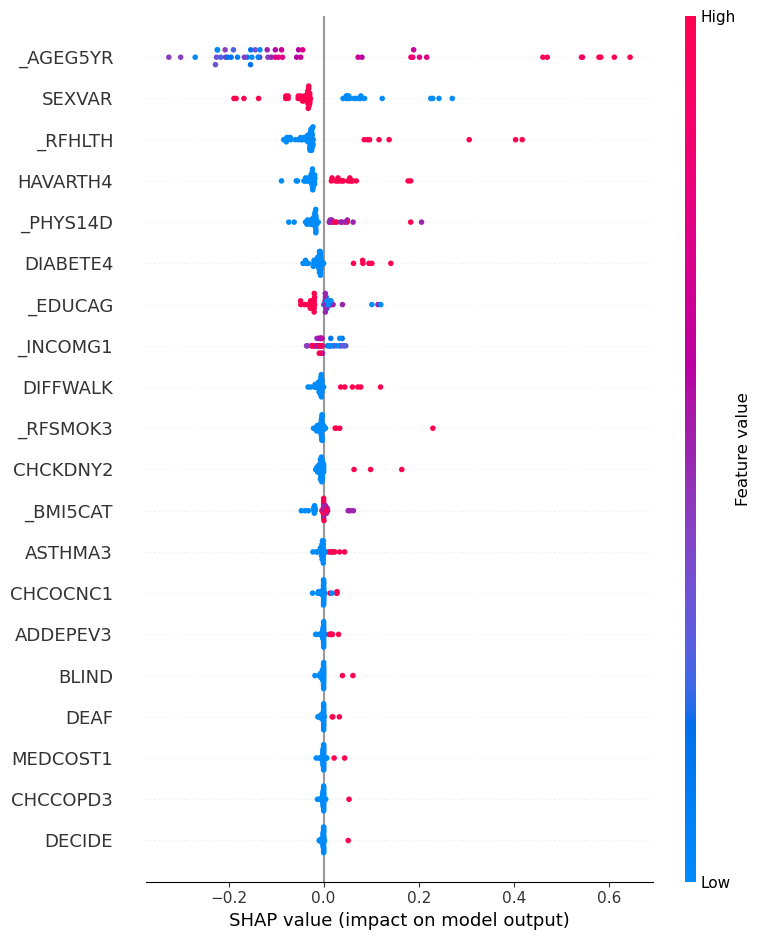

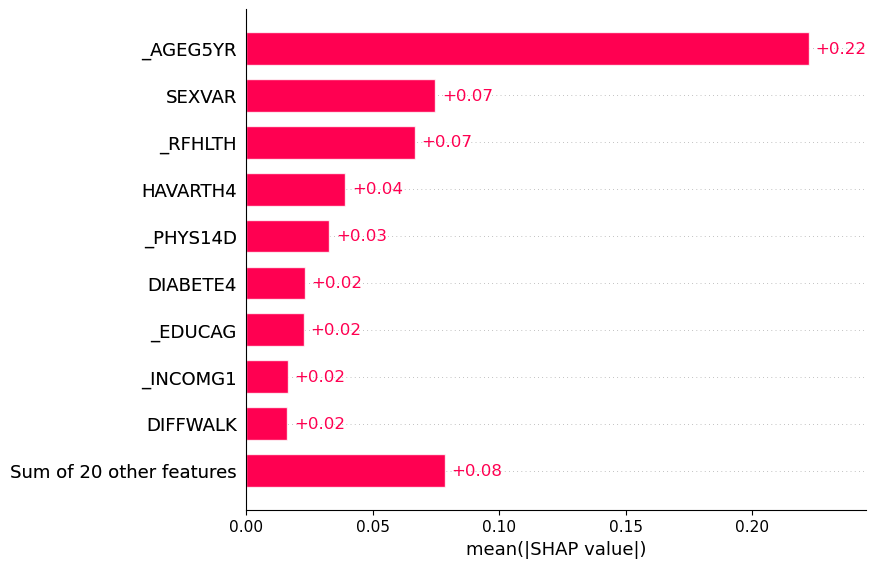

Valores SHAP para Voting:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [05:59<00:00,  7.20s/it]


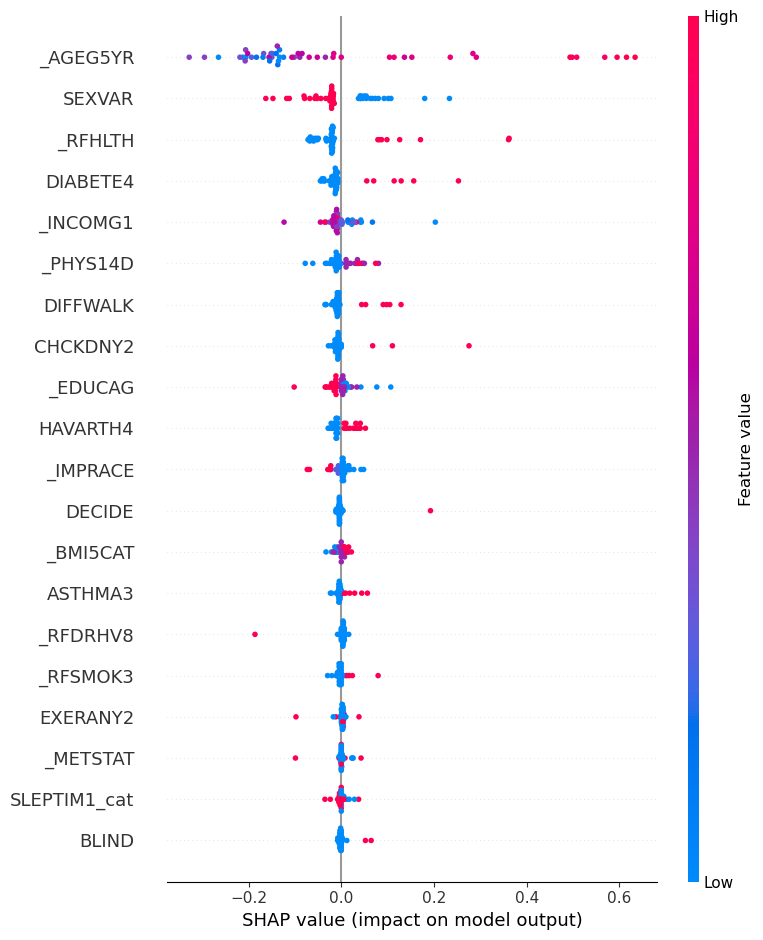

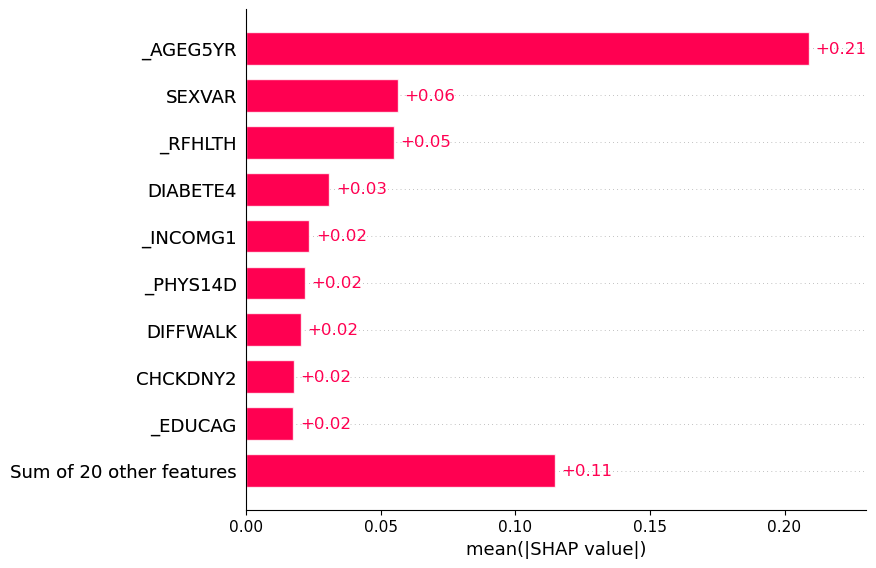

Valores SHAP para SVM:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:41<00:00,  1.62s/it]


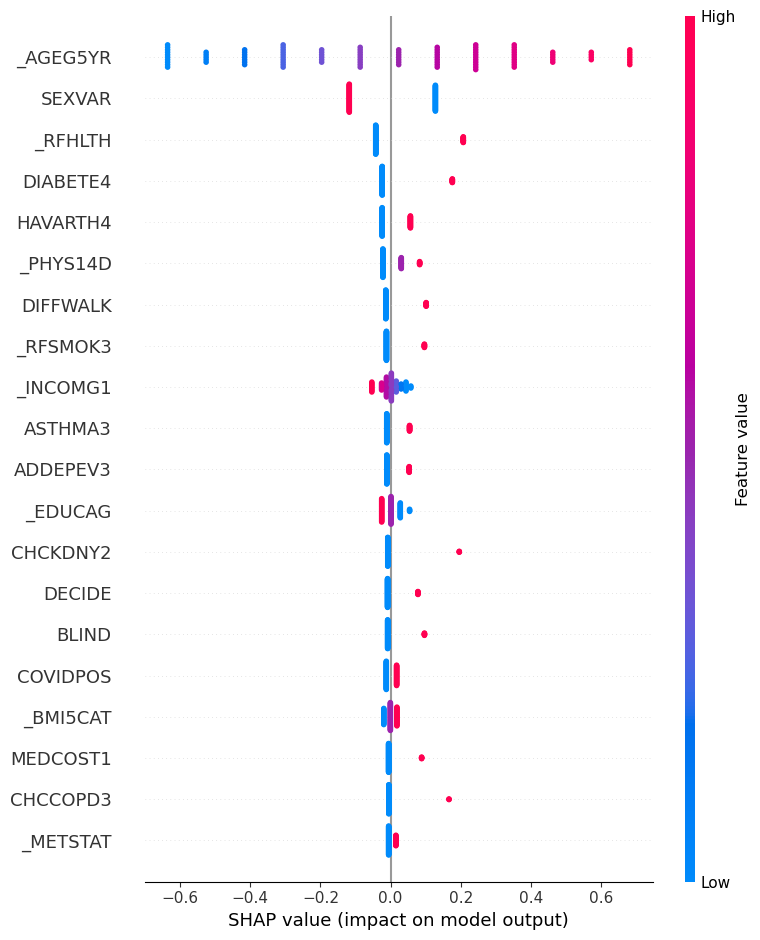

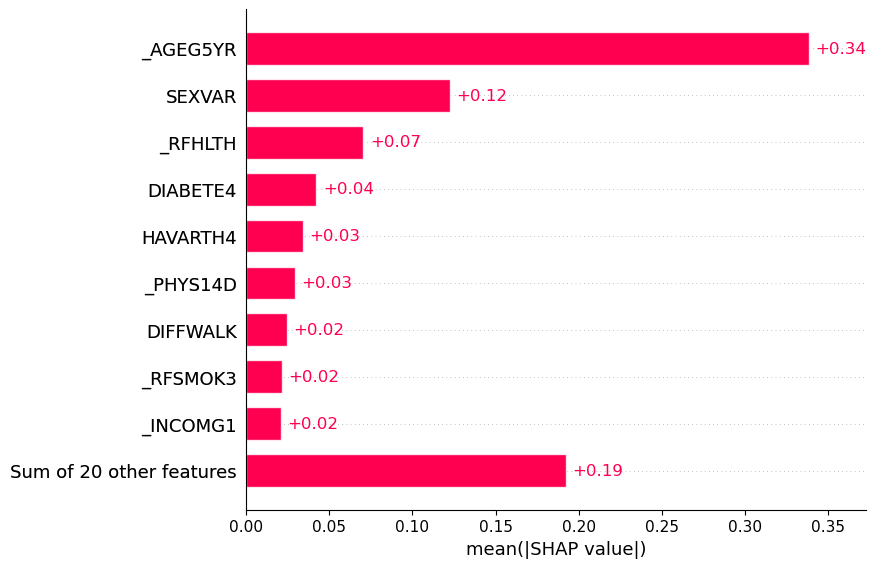

In [230]:
# Iterar sobre los modelos optimizados para graficar la importancia de las variables creadas por SHAP
for nombre, modelo in modelos_optimizados_all:
    print(f"Valores SHAP para {nombre}:")
    
    # Obtener el tamaño de muestra específico para el modelo actual
    sample_size = sample_sizes.get(nombre, 50)  # Valor predeterminado de 50 si no se encuentra el nombre del modelo
    
    # Tomar una muestra aleatoria de los datos de prueba para el cálculo de SHAP
    X_test_sample = shap.utils.sample(X_test, nsamples=sample_size, random_state=42)
    
    explainer_class = explainer_dict.get(type(modelo))
    if explainer_class is None:
        print(f"No se puede calcular los valores SHAP para {nombre}")
        continue
    
    if explainer_class == shap.KernelExplainer:
        if isinstance(modelo, LinearSVC):
            explainer = explainer_class(modelo.decision_function, X_test_sample)
        else:
            explainer = explainer_class(modelo.predict, X_test_sample)
    else:
        explainer = explainer_class(modelo, X_test_sample)
    
    shap_values = explainer(X_test_sample)
    
    # Graficar el Summary Plot de SHAP
    shap.summary_plot(shap_values, X_test_sample)
    plt.show()
    
    # Graficar el Bar Plot de SHAP
    shap.plots.bar(shap_values)
    plt.show()

#### Importancia y permutación de características

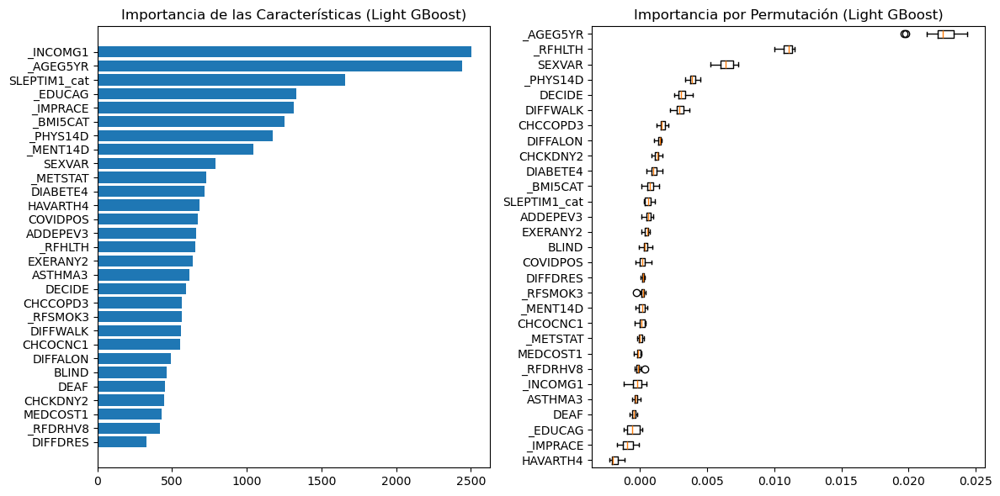

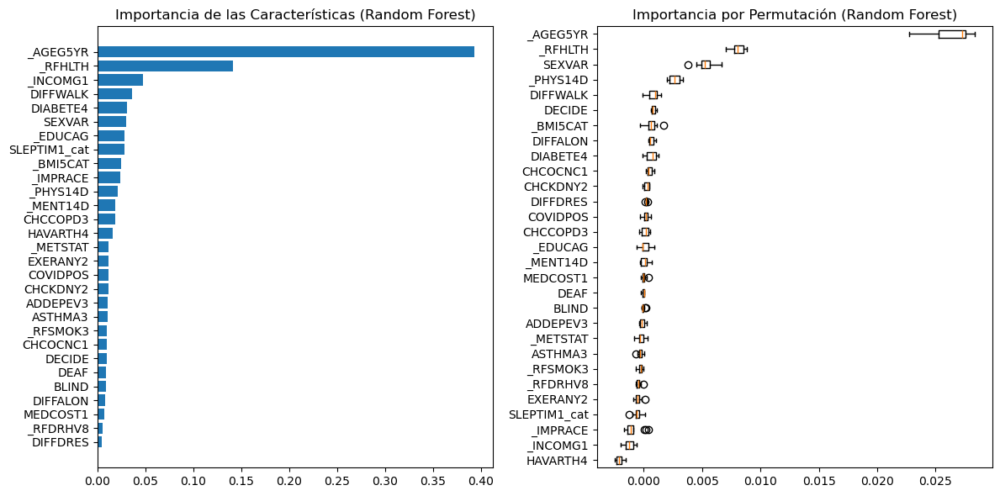

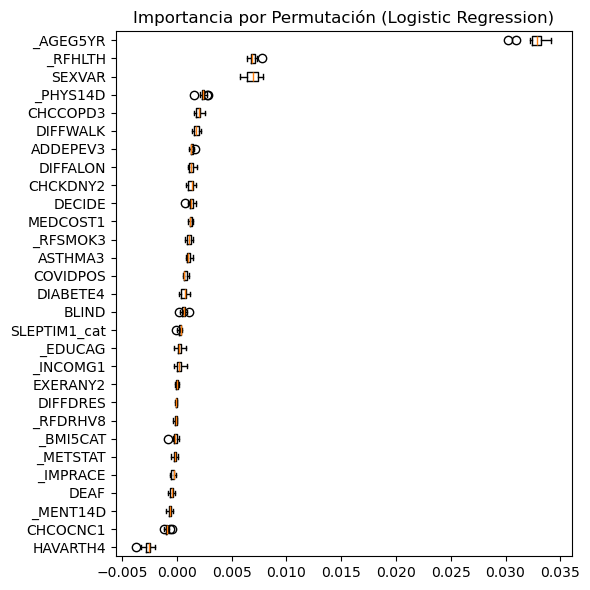

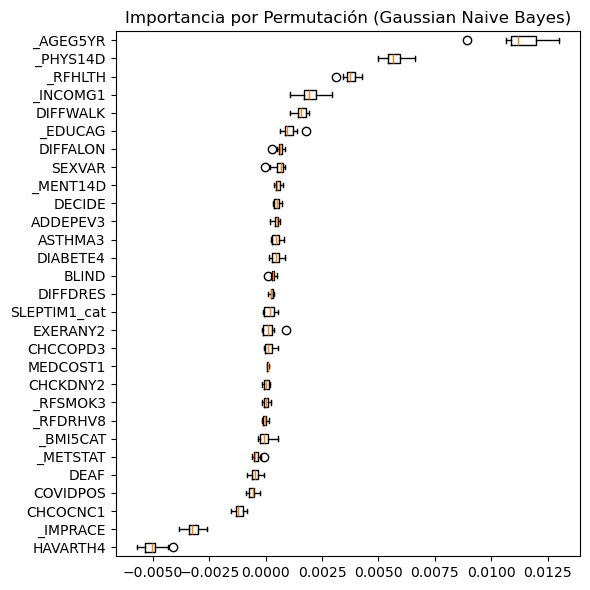

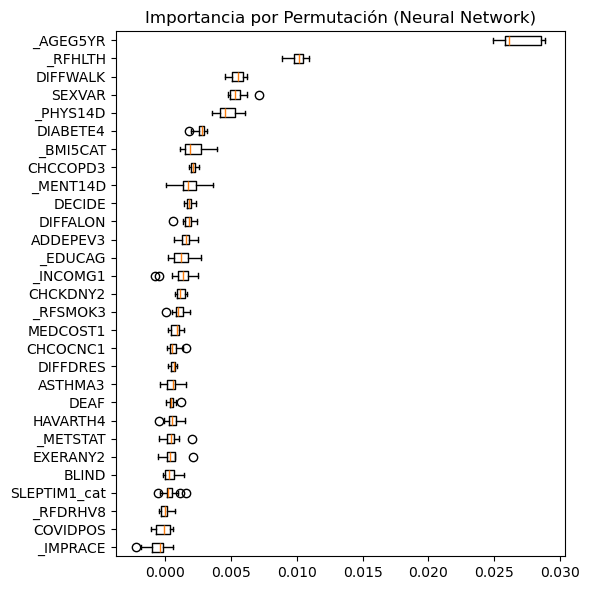

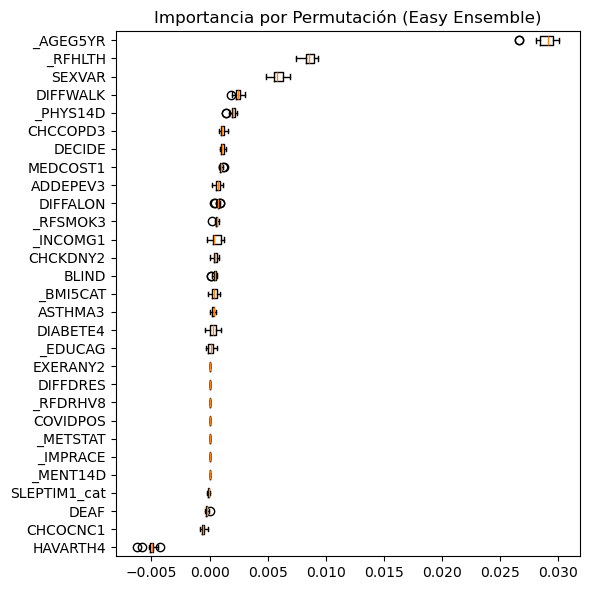

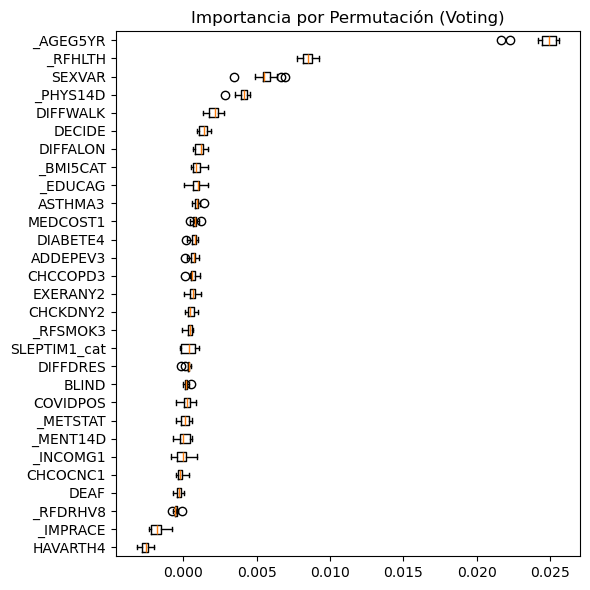

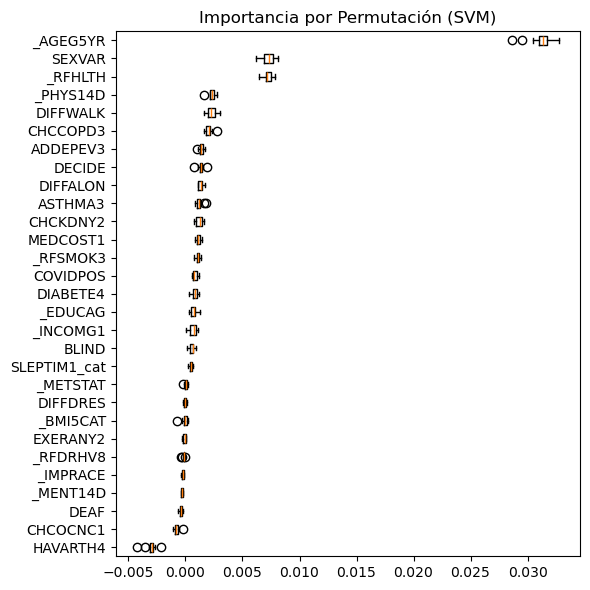

In [231]:
# Graficar importancia y permutación para los modelos con todas las variables
graficar_importancia_permutacion(modelos_optimizados_all, X_test, y_test, X)
graficar_permutacion_importancia(modelos_optimizados_all, X_test, y_test, X)

# ENTRENAMIENTO CON SOBREMUESTREO SMOTEN()

El capítulo 10 utiliza la técnica de sobremuestreo SMOTEN (Synthetic Minority Over-sampling Technique for Nominal) es una técnica de sobremuestreo específicamente diseñada para manejar características nominales o categóricas en conjuntos de datos con desequilibrio de clases. A diferencia de SMOTE, que se enfoca principalmente en características continuas, SMOTEN se centra en la generación de instancias sintéticas para características nominales. Al utilizar una medida de distancia adecuada para este tipo de características, SMOTEN puede identificar los vecinos más cercanos de manera más precisa y generar instancias sintéticas que sean representativas de la clase minoritaria en términos de sus características nominales. 


## MODELO CON 11 VARIABLES

In [232]:
# Seleccionar las columnas deseadas para crear el nuevo dataset
columnas_seleccionadas = ['SEXVAR', 'EXERANY2', 'CHCCOPD3', 'CHCKDNY2', 
                          'HAVARTH4', 'DIABETE4', '_IMPRACE', '_AGEG5YR',
                          '_BMI5CAT', '_RFSMOK3', '_RFDRHV8', 'CARDIO']

# Dataset base con 11 variables
df_11vars = df.loc[:, columnas_seleccionadas]

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/SMOTEN/modelos_iniciales_11vars"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los modelos base
modelos_base = [
    ('Logistic Regression', LogisticRegression(class_weight='balanced', random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),
    ('Gradient Boosting', GradientBoostingClassifier(learning_rate=0.1, n_estimators=500, max_depth=3, random_state=42,
                                                     min_samples_split=5, min_samples_leaf=3, max_features='sqrt')),
    ('Xtra GBoost', XGBClassifier(learning_rate=0.1, n_estimators=500, max_depth=3, random_state=42, scale_pos_weight=1,
                                  subsample=0.8, colsample_bytree=0.8)),
    ('Light GBoost', LGBMClassifier(class_weight='balanced', verbose=-1)),
    ('Decision Tree',
     DecisionTreeClassifier(class_weight='balanced', criterion='gini', max_depth=5, min_samples_split=20,
                            min_samples_leaf=10, random_state=42)),
    ('Random Forest', RandomForestClassifier(class_weight='balanced', n_estimators=500, min_samples_split=2,
                                             max_depth=5, min_samples_leaf=1, random_state=42)),
    ('Neural Network', MLPClassifier(early_stopping=True, random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble = [
    ('Voting', VotingClassifier(estimators=modelos_base, voting='soft', n_jobs=-1)),
    ('Stacking',
     StackingClassifier(estimators=modelos_base, final_estimator=LogisticRegression(random_state=42), n_jobs=-1)),
    ('SVM', LinearSVC(class_weight='balanced', C=100.0, random_state=42, dual=False))
]

# Combinar todos los modelos
modelos = modelos_base + modelos_ensamble

# Crear el objeto de la técnica de muestreo SMOTEN
tecnica_muestreo = SMOTEN(random_state=42)

# Entrenar y evaluar modelos con 11 variables
resultados_11vars, X, X_train, y_train, X_val, y_val, X_test, y_test = entrenar_evaluar_modelos_base(
    df_11vars, modelos, carpeta_modelos, tecnica_muestreo)


Dimensiones del conjunto de entrenamiento:
X_train: (439448, 11), y_train: (439448,)

Dimensiones del conjunto de validación:
X_val: (53095, 11), y_val: (53095,)

Dimensiones del conjunto de prueba:
X_test: (53096, 11), y_test: (53096,)

Tiempo de muestreo: 15.56 minutos

Modelo Logistic Regression cargado desde archivo.
Entrenamiento Logistic Regression:
Tiempo de ejecución: 0.04 minutos
Accuracy: 0.7313288489195536
F1-score: 0.7403471655623022
Precision: 0.7163034550847494
Recall: 0.7660610584187435
AUC-ROC: 0.8042100839377282
Matthews Corr Coef: 0.46377798614187865

MATRIZ DE CONFUSIÓN:
[[153059  66665]
 [ 51402 168322]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.75      0.70      0.72    219724
           1       0.72      0.77      0.74    219724

    accuracy                           0.73    439448
   macro avg       0.73      0.73      0.73    439448
weighted avg       0.73      0.73      0.73    439448



Test Logisti

### Tabla de métricas de rendimiento modelos base

In [233]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_11vars_inicial = pd.DataFrame.from_dict(resultados_11vars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_11vars_inicial

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.704554,0.369012,0.243355,0.762974,0.801657,0.304659,0.043219
Gaussian Naive Bayes,0.760151,0.367645,0.262051,0.615768,0.766504,0.282781,0.002333
Gradient Boosting,0.695721,0.362532,0.237637,0.764138,0.795581,0.297082,1.237844
Xtra GBoost,0.700976,0.364182,0.239833,0.756321,0.794851,0.297755,0.163261
Light GBoost,0.694440,0.359545,0.235714,0.757485,0.793865,0.292348,0.026847
Decision Tree,0.623908,0.333945,0.208853,0.832668,0.783941,0.273754,0.012756
Random Forest,0.683893,0.359634,0.233340,0.783932,0.796802,0.297008,1.271128
Neural Network,0.709507,0.368128,0.244211,0.747339,0.795284,0.300997,2.094182
Easy Ensemble,0.708999,0.364235,0.241977,0.736194,0.794212,0.294547,1.815683
Voting,0.712332,0.370715,0.246386,0.748337,0.800185,0.304239,3.204855


### BÚSQUEDA DE HIPERPARÁMETROS

In [234]:

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/SMOTEN/modelos_entrenados_11vars"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los espacios de búsqueda de hiperparámetros para cada modelo
param_dist_lr = {
    'class_weight': ['balanced', None],
    'solver': ['newton-cg', 'newton-cholesky', 'sag', 'saga'],
    'penalty': ['l2'],
    'C': loguniform(1e-4, 1e1)
}

param_dist_gnb = {
    'var_smoothing': loguniform(1e-9, 1e-1)
}

param_dist_lgbm = {
    'class_weight': ['balanced', None],
    'n_estimators': randint(50, 251),
    'max_depth': randint(3, 31),
    'subsample': uniform(0.7, 0.3),
    'colsample_bytree': uniform(0.7, 0.3),
    'learning_rate': loguniform(1e-5, 1e-1),
    'num_leaves': randint(10, 101),
    'verbose': [-1]
}

param_dist_rf = {
    'class_weight': ['balanced_subsample', 'balanced'],
    'n_estimators': randint(50, 251),
    'criterion': ['gini', 'entropy'],
    'max_depth': randint(3, 16),
    'min_samples_leaf': randint(3, 16),
    'min_samples_split': randint(3, 16),
    'max_features': [None, 'sqrt', 'log2']
}

param_dist_ann = {
    'hidden_layer_sizes': [(100,), (50,50), (100,100), (50, 50, 50),
                           (100, 100, 100), (50, 50, 50, 50), (100, 100, 100, 100),
                           (50, 50, 50, 50, 50), (100, 100, 100, 100, 100)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': loguniform(1e-5, 1e3),
    'batch_size': [64, 128, 256, 512],
    'learning_rate': ['constant', 'adaptive'],
    'learning_rate_init': loguniform(1e-5, 1e-1),
    'early_stopping': [True],
    'max_iter': [100]
}

param_dist_eec = {
    'n_estimators': randint(2, 20),
    'sampling_strategy': ['auto']
}

param_dist_svm = {
    'dual': ['auto'],
    'tol': loguniform(1e-5, 1e-3),
    'class_weight': [None, 'balanced'],
    'penalty': ['l2'],
    'loss': ['hinge', 'squared_hinge'],
    'C': loguniform(1e-4, 1e4),
    'max_iter': randint(1000, 2001)
}

# Definir los modelos con búsqueda de hiperparámetros
modelos = [
    ('Logistic Regression', RandomizedSearchCV(LogisticRegression(), param_dist_lr,
                                               cv=30, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Gaussian Naive Bayes', RandomizedSearchCV(GaussianNB(), param_dist_gnb, cv=30,
                                                n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('Light GBoost', RandomizedSearchCV(LGBMClassifier(), param_dist_lgbm, cv=5, n_jobs=6,
                                        scoring='f1_weighted', n_iter=50)),
    ('Random Forest', RandomizedSearchCV(RandomForestClassifier(), param_dist_rf,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Neural Network', RandomizedSearchCV(MLPClassifier(), param_dist_ann, cv=5, n_jobs=6,
                                          scoring='f1_weighted', error_score=0, n_iter=50)),
    ('Easy Ensemble', RandomizedSearchCV(EasyEnsembleClassifier(), param_dist_eec,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('SVM', RandomizedSearchCV(LinearSVC(), param_dist_svm, cv=5, n_jobs=6,
                               scoring='f1_weighted', n_iter=50))
]

# Crear un diccionario para almacenar los mejores hiperparámetros de cada modelo
best_params_11vars = {}

# Entrenar y evaluar cada modelo con búsqueda de hiperparámetros
for nombre, modelo in modelos:
    nombre_archivo = f"{carpeta_modelos}/{nombre}_optimizado.pkl"
    
    # Hash del conjunto de datos actual
    hash_actual = hash_de_datos(X_train)
    
    # Cargar o entrenar modelo
    modelo_cargado, tiempo_ejecucion, mejores_parametros_cargados = cargar_modelo(nombre_archivo, hash_actual)
    
    if modelo_cargado is not None:
        print(f"Modelo {nombre} cargado desde archivo.")
        modelo_best_11vars = modelo_cargado
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros_cargados}")
        
        # Agregar los mejores hiperparámetros cargados al diccionario
        best_params_11vars[nombre] = mejores_parametros_cargados
    else:
        print(f"Entrenando nuevo modelo {nombre}.")
        inicio = time.time()  # Tiempo de inicio
        modelo.fit(X_train, y_train)

        mejores_parametros = modelo.best_params_
        
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros}")
        
        # Agregar los mejores hiperparámetros al diccionario
        best_params_11vars[nombre] = mejores_parametros
        
        # Entrenar el modelo con los mejores hiperparámetros en el conjunto de entrenamiento completo
        modelo_best_11vars = modelo.best_estimator_
        modelo_best_11vars.fit(X_train, y_train)
        
        fin = time.time()  # Tiempo de fin
        tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos
        
        # Guardar el modelo entrenado junto con el tiempo de ejecución y los mejores parámetros
        guardar_modelo(modelo_best_11vars, nombre_archivo, hash_actual, tiempo_ejecucion, mejores_parametros)

    # Imprimir metricas de la prediccion en el conjunto de entrenamiento
    y_pred_train = modelo_best_11vars.predict(X_train)

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_11vars, "predict_proba"):
        y_scores = modelo_best_11vars.predict_proba(X_train)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_11vars.decision_function(X_train)  # Puntuaciones de decisión
    
    print(f"Entrenamiento {nombre}:")
    print(f"Tiempo de búsqueda de hiperparámetros de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_train, y_pred_train)}")
    print(f"F1-score: {f1_score(y_train, y_pred_train)}")
    print(f"Precision: {precision_score(y_train, y_pred_train)}")
    print(f"Recall: {recall_score(y_train, y_pred_train)}")
    print(f"AUC-ROC: {roc_auc_score(y_train, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_train, y_pred_train)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_train, y_pred_train))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_train, y_pred_train))
    print("\n")

    # Predecir en el conjunto de validación
    inicio = time.time()  # Tiempo de inicio
    y_pred_val = modelo_best_11vars.predict(X_val)
    fin = time.time()  # Tiempo de fin
    tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_11vars, "predict_proba"):
        y_scores = modelo_best_11vars.predict_proba(X_val)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_11vars.decision_function(X_val)  # Puntuaciones de decisión
    

    # Imprimir métricas de la predicción en el conjunto de validación
    print(f"Validación {nombre}:")
    print(f"Tiempo de ejecución de predicción de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_val, y_pred_val)}")
    print(f"F1-score: {f1_score(y_val, y_pred_val)}")
    print(f"Precision: {precision_score(y_val, y_pred_val)}")
    print(f"Recall: {recall_score(y_val, y_pred_val)}")
    print(f"AUC-ROC: {roc_auc_score(y_val, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_val, y_pred_val)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_val, y_pred_val))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_val, y_pred_val))
    print("\n")
    
 

Modelo Logistic Regression cargado desde archivo.
Mejores hiperparámetros para Logistic Regression: {'solver': 'saga', 'penalty': 'l2', 'class_weight': 'balanced', 'C': 0.01}
Entrenamiento Logistic Regression:
Tiempo de búsqueda de hiperparámetros de Logistic Regression: 15.21 minutos
Accuracy: 0.7312492035462671
F1-score: 0.7401198817026371
Precision: 0.7164712598626471
Recall: 0.7653829349547614
AUC-ROC: 0.8041664949475105
Matthews Corr Coef: 0.46357991332708365

MATRIZ DE CONFUSIÓN:
[[153173  66551]
 [ 51551 168173]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.75      0.70      0.72    219724
           1       0.72      0.77      0.74    219724

    accuracy                           0.73    439448
   macro avg       0.73      0.73      0.73    439448
weighted avg       0.73      0.73      0.73    439448



Validación Logistic Regression:
Tiempo de ejecución de predicción de Logistic Regression: 0.00 minutos
Accuracy: 0.703

### Entrenar modelos con los mejores parámetros

Durante el proceso de sobremuestreo, SMOTEN utiliza una métrica de distancia especializada para datos categóricos conocida como la métrica de diferencia de valor (Value Difference Metric, VDM). El cálculo de esta métrica implica comparar cada muestra con cada otra muestra. Para conjuntos de datos grandes, esto puede resultar en una matriz extremadamente grande que puede no caber en la memoria disponible, esto provocó un error, donde el sistema intentó asignar 380 GB de memoria al realizar la concatenación. Por lo tanto, en este caso no se va a concatenar los conjuntos de entrenamiento y validación para hacer el entrenamiento con los mejores parámetros para hacer viable la ejecución del código. Es decir, se hace únicamente con el conjunto de entrenamiento con el que se hizo la búsqueda de hiperparámetros.

In [235]:
# Combinar los conjuntos de entrenamiento y validación para 11 variables
X_train_val_11vars = X_train
y_train_val_11vars = y_train

# Definir los modelos base
modelos_entrenados = [
    ('Logistic Regression', LogisticRegression(random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),    
    ('Light GBoost', LGBMClassifier(verbosity=-1, random_state=42)),
    ('Random Forest', RandomForestClassifier(random_state=42)),   
    ('Neural Network', MLPClassifier(random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble = [   
    ('Voting', VotingClassifier(estimators=modelos_entrenados, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(random_state=42)) 
]

# Combinar todos los modelos
modelos_optimizados = modelos_entrenados + modelos_ensamble

# Crear el objeto de la técnica de muestreo SMOTEN
tecnica_muestreo = SMOTEN(random_state=42)

# Entrenar y evaluar modelos con 11 variables
resultados_optimizados_11vars, roc_data_11vars, pr_data_11vars, modelos_optimizados = entrenar_evaluar_modelos(
    X_train_val_11vars, y_train_val_11vars, X_test, y_test, modelos_optimizados, best_params_11vars, carpeta_modelos,
    tecnica_muestreo
)



Tiempo de muestreo: 0.01 minutos

Modelo Logistic Regression cargado desde archivo.
Test Logistic Regression:
Mejores hiperparámetros para Logistic Regression: {'solver': 'saga', 'penalty': 'l2', 'class_weight': 'balanced', 'C': 0.01}
Tiempo de ejecución de entrenamiento: 0.05 minutos
Tiempo de ejecución de predicción: 0.00 minutos
Accuracy: 0.7047423534729547
F1-score: 0.36900784866170255
Precision: 0.24340253809801943
Recall: 0.7624750499001997
AUC-ROC: 0.8016205292244497
Matthews Corr Coef: 0.30456910783593655

MATRIZ DE CONFUSIÓN:
[[32835 14249]
 [ 1428  4584]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.96      0.70      0.81     47084
           1       0.24      0.76      0.37      6012

    accuracy                           0.70     53096
   macro avg       0.60      0.73      0.59     53096
weighted avg       0.88      0.70      0.76     53096



Modelo Gaussian Naive Bayes cargado desde archivo.
Test Gaussian Naive 

### Tabla de métricas de rendimiento con los mejores parámetros

In [236]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_11vars_opt = pd.DataFrame.from_dict(resultados_optimizados_11vars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_11vars_opt

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.704742,0.369008,0.243403,0.762475,0.801621,0.304569,0.051383
Gaussian Naive Bayes,0.713123,0.355505,0.238395,0.698769,0.773150,0.278404,0.002183
Light GBoost,0.698678,0.355269,0.234431,0.733200,0.785422,0.283228,0.041884
Random Forest,0.700298,0.346140,0.229850,0.700599,0.765908,0.267181,3.199537
Neural Network,0.695118,0.344297,0.227565,0.706919,0.756452,0.265788,12.088196
Easy Ensemble,0.708999,0.364235,0.241977,0.736194,0.794212,0.294547,1.141260
Voting,0.712201,0.362893,0.242141,0.723886,0.790021,0.291021,8.246353
SVM,0.699281,0.366816,0.240823,0.769295,0.801759,0.303117,0.010816


### Visualizar comparación de rendimiento de curvas ROC-AUC Y PR-AUC

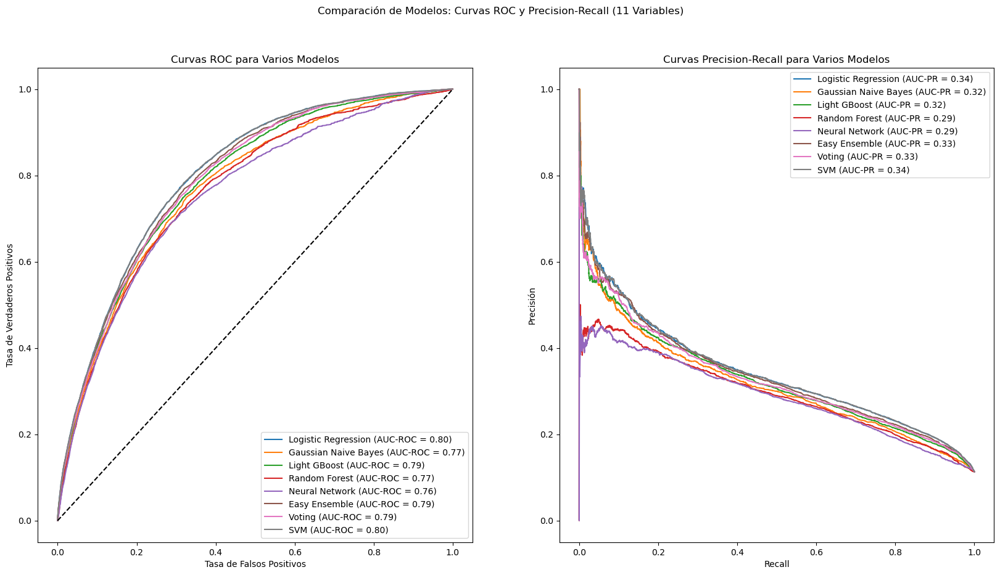

In [237]:
# Graficar curvas de rendimiento para los modelos con 11 variables
graficar_curvas_rendimiento(roc_data_11vars, pr_data_11vars, 
                            'Comparación de Modelos: Curvas ROC y Precision-Recall (11 Variables)')

### EXPLICABILIDAD

#### SHAP values

Valores SHAP para Logistic Regression:


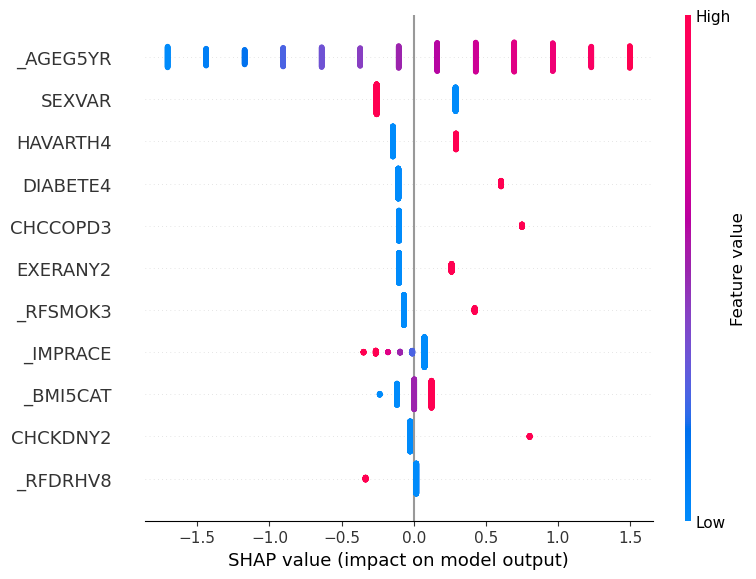

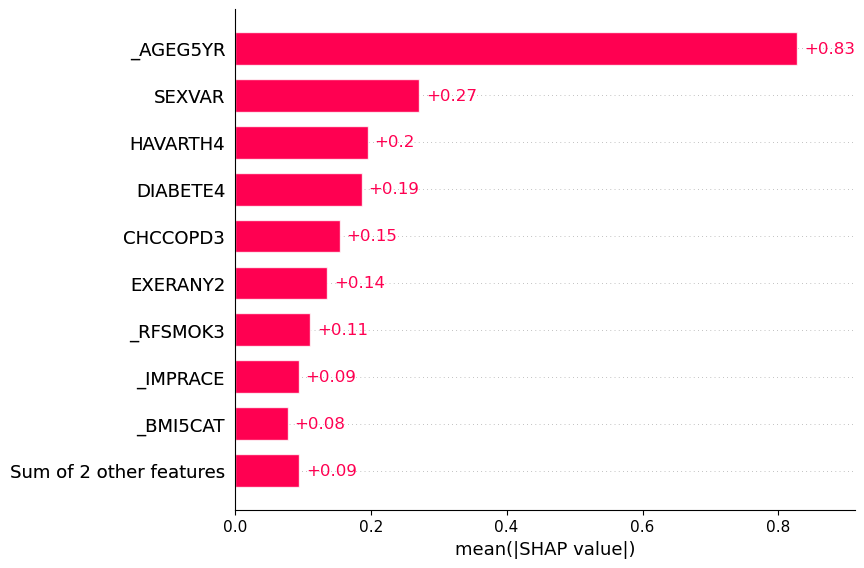

Valores SHAP para Gaussian Naive Bayes:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:10<00:00,  1.30s/it]


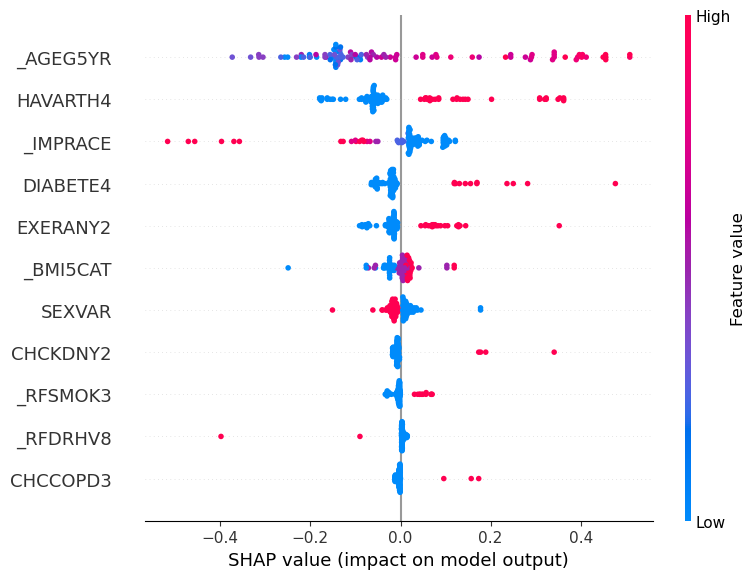

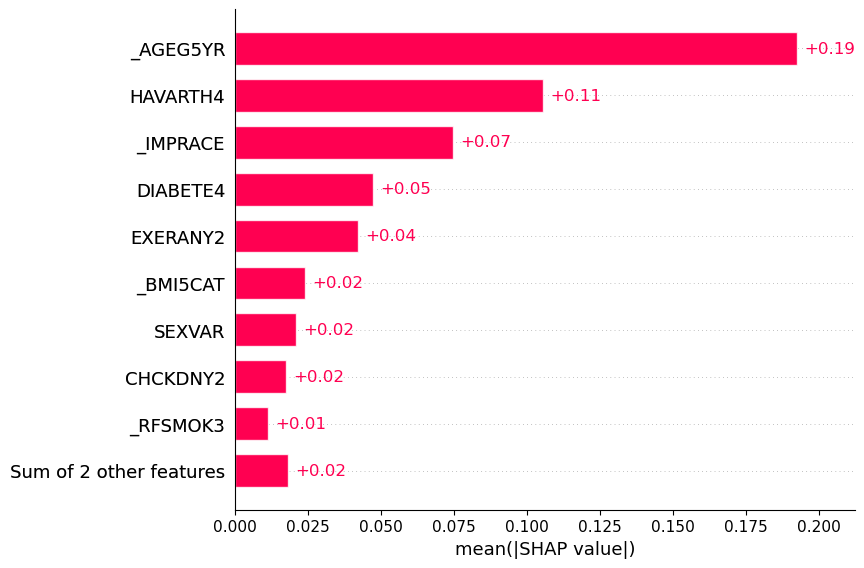

Valores SHAP para Light GBoost:


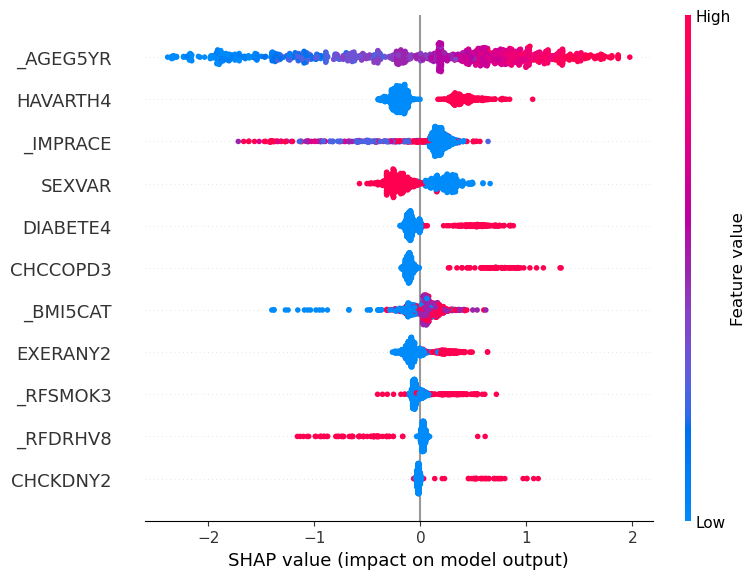

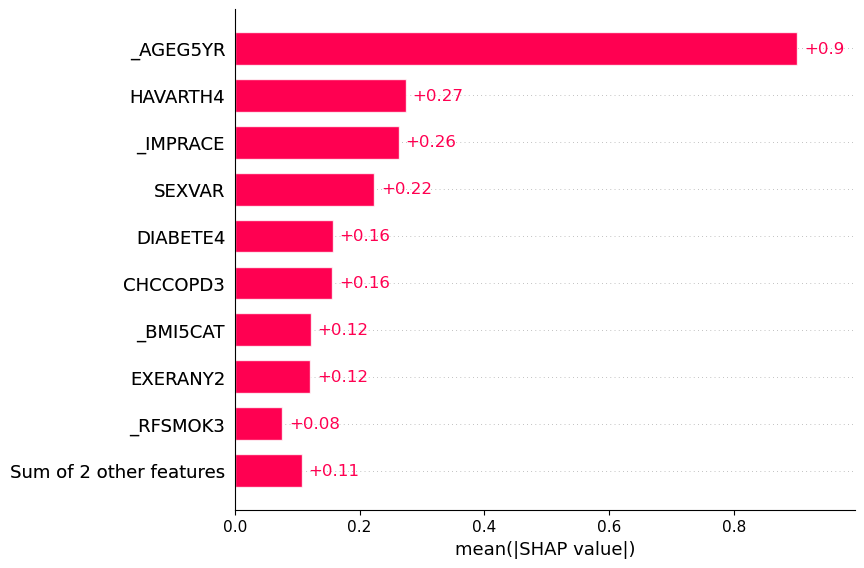

Valores SHAP para Random Forest:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [04:36<00:00,  3.68s/it]


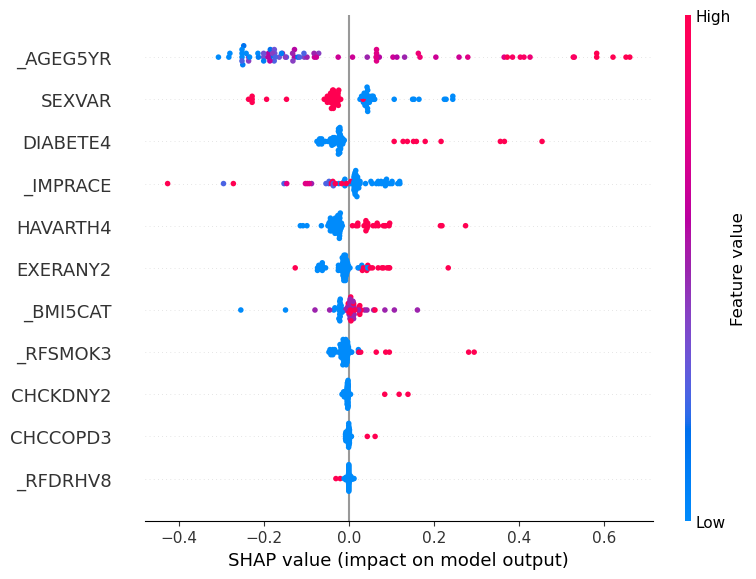

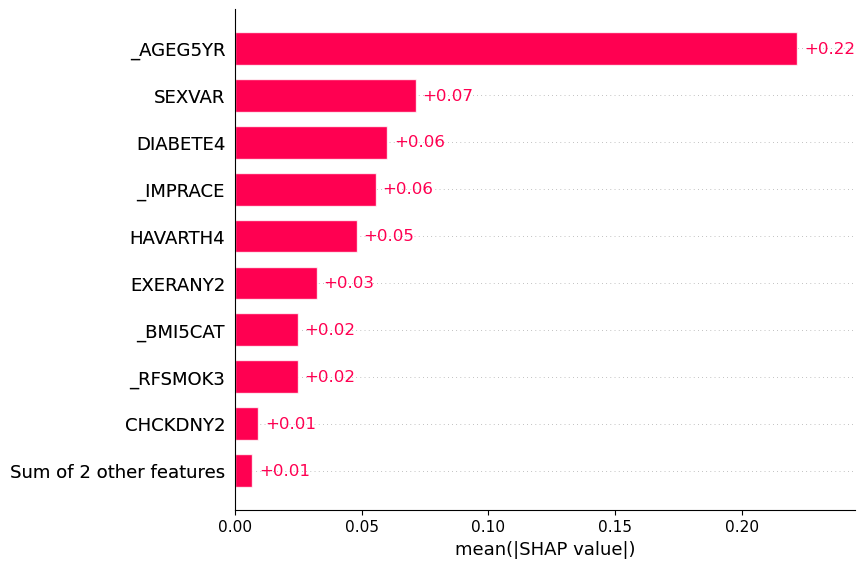

Valores SHAP para Neural Network:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [03:04<00:00,  2.46s/it]


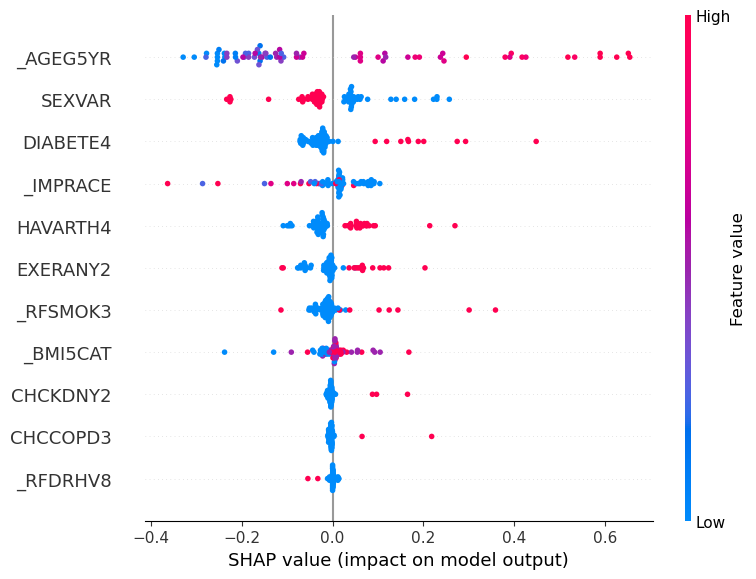

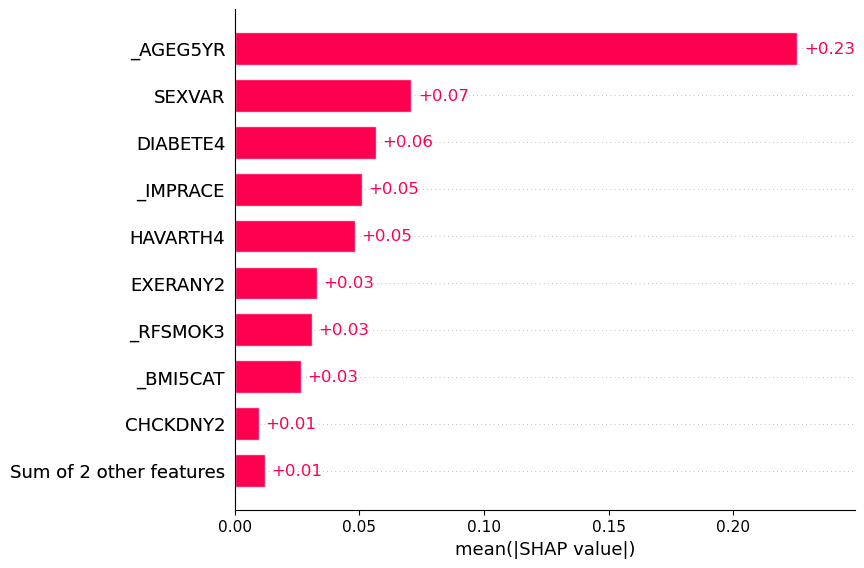

Valores SHAP para Easy Ensemble:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [02:25<00:00,  2.91s/it]


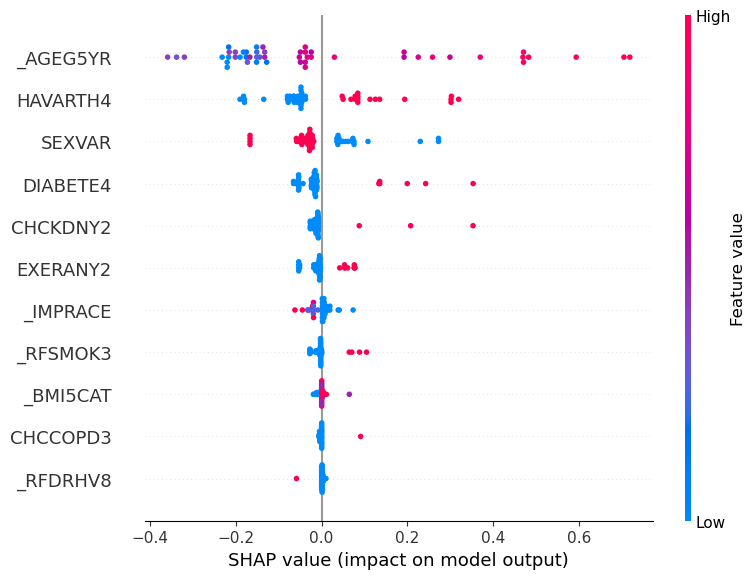

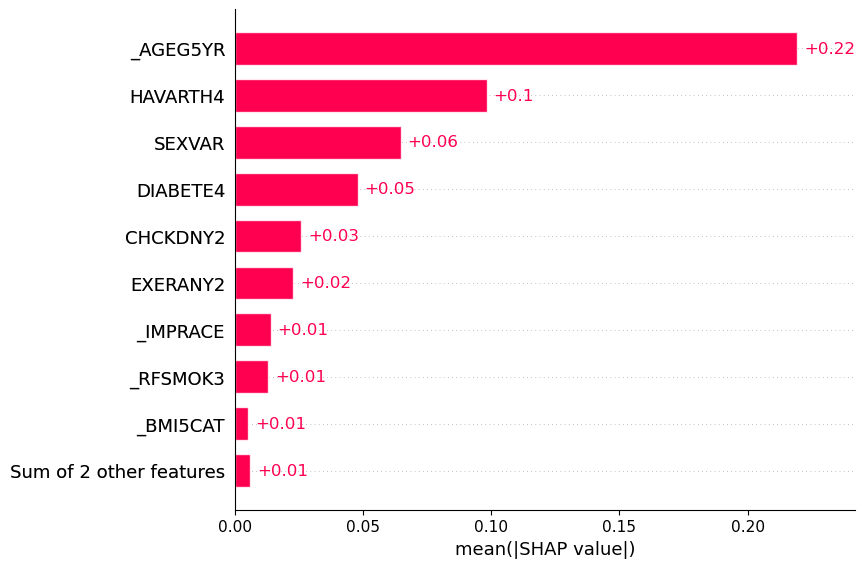

Valores SHAP para Voting:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [05:05<00:00,  6.11s/it]


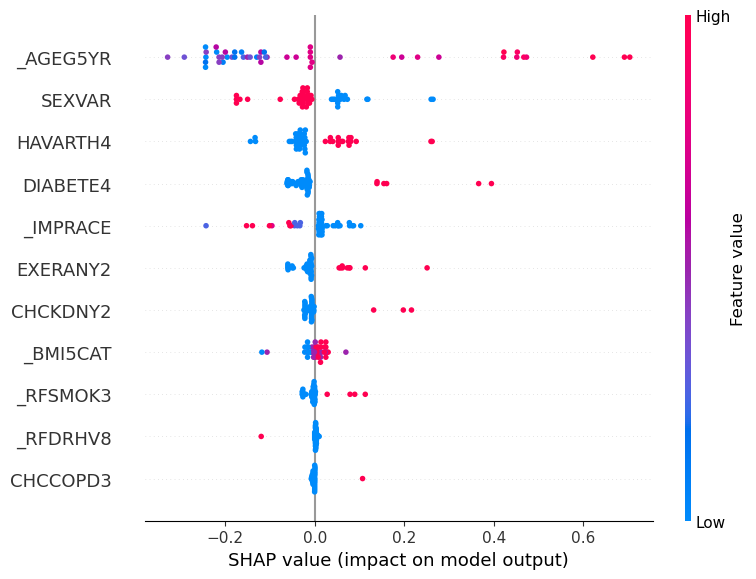

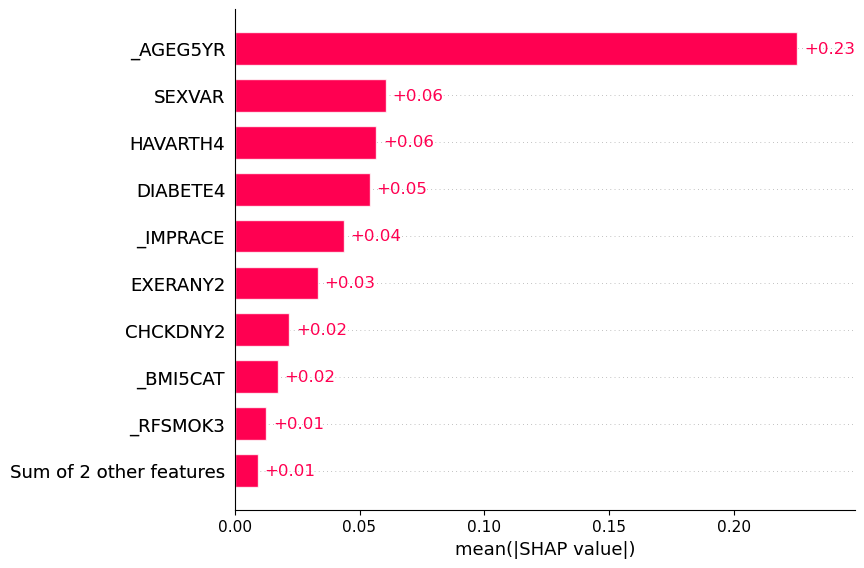

Valores SHAP para SVM:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:18<00:00,  1.39s/it]


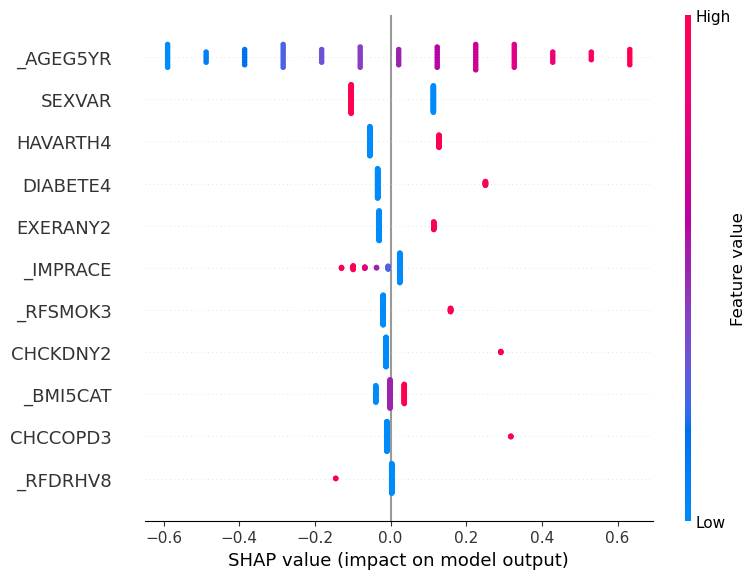

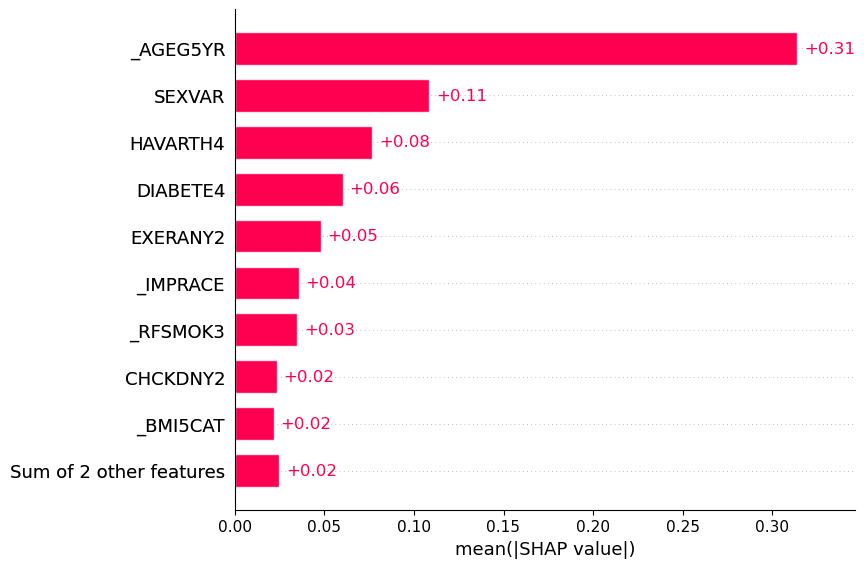

In [238]:
# Diccionario para mapear los tipos de modelo a sus correspondientes objetos explainer de SHAP
explainer_dict = {
    LogisticRegression: shap.LinearExplainer,
    GaussianNB: shap.KernelExplainer,
    LGBMClassifier: shap.TreeExplainer,
    RandomForestClassifier: shap.KernelExplainer,
    MLPClassifier: shap.KernelExplainer,
    EasyEnsembleClassifier: shap.KernelExplainer,
    VotingClassifier: shap.KernelExplainer,
    LinearSVC: shap.KernelExplainer    
    
}

# Diccionario para mapear los nombres de los modelos a sus correspondientes tamaños de muestra
sample_sizes = {
    'Logistic Regression': 1000,
    'Gaussian Naive Bayes': 100,
    'Light GBoost': 1000,
    'Random Forest': 75,
    'Neural Network': 75,
    'Easy Ensemble': 50,
    'SVM': 100,
    'Voting': 50
}

# Iterar sobre los modelos optimizados para graficar la importancia de las variables creadas por SHAP
for nombre, modelo in modelos_optimizados:
    print(f"Valores SHAP para {nombre}:")
    
    # Obtener el tamaño de muestra específico para el modelo actual
    sample_size = sample_sizes.get(nombre, 50)  # Valor predeterminado de 50 si no se encuentra el nombre del modelo
    
    # Tomar una muestra aleatoria de los datos de prueba para el cálculo de SHAP
    X_test_sample = shap.utils.sample(X_test, nsamples=sample_size, random_state=42)
    
    explainer_class = explainer_dict.get(type(modelo))
    if explainer_class is None:
        print(f"No se puede calcular los valores SHAP para {nombre}")
        continue
    
    if explainer_class == shap.KernelExplainer:
        if isinstance(modelo, LinearSVC):
            explainer = explainer_class(modelo.decision_function, X_test_sample)
        else:
            explainer = explainer_class(modelo.predict, X_test_sample)
    else:
        explainer = explainer_class(modelo, X_test_sample)
    
    shap_values = explainer(X_test_sample)
    
    # Graficar el Summary Plot de SHAP
    shap.summary_plot(shap_values, X_test_sample)
    plt.show()
    
    # Graficar el Bar Plot de SHAP
    shap.plots.bar(shap_values)
    plt.show()

#### Importancia y permutación de características

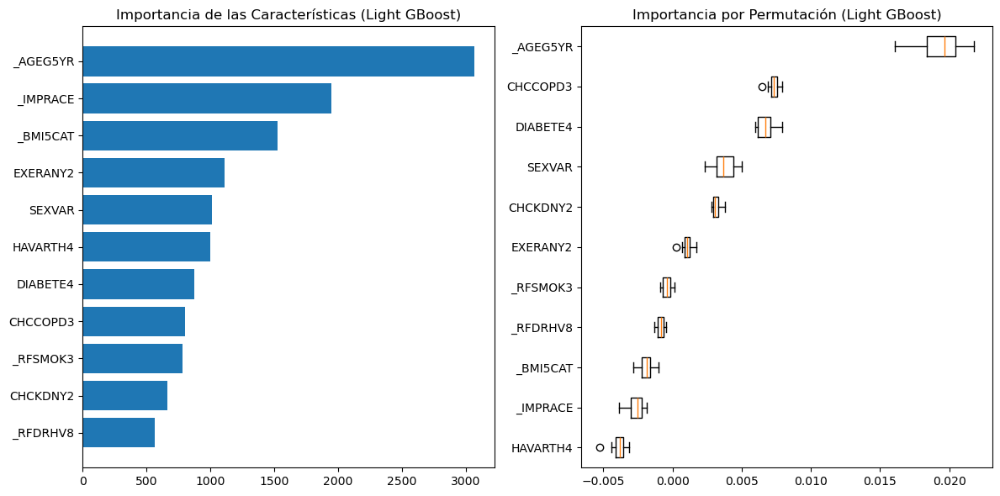

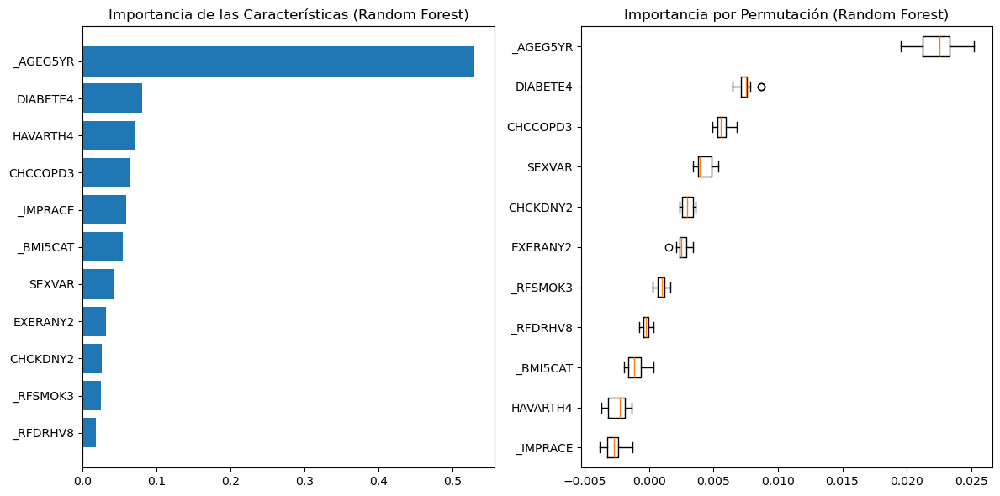

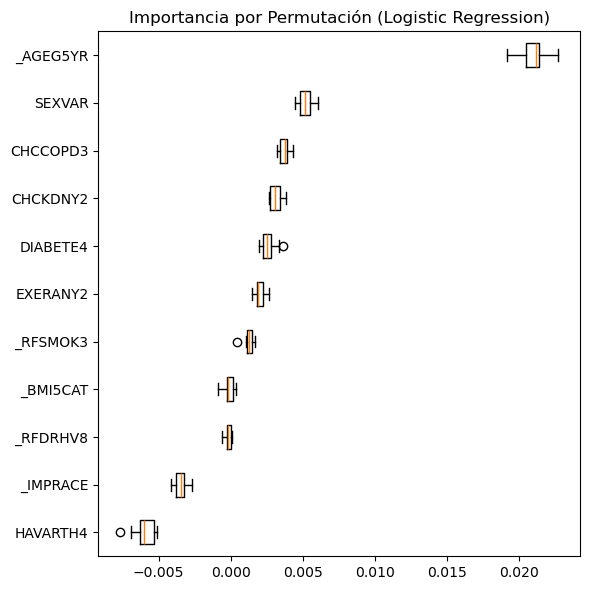

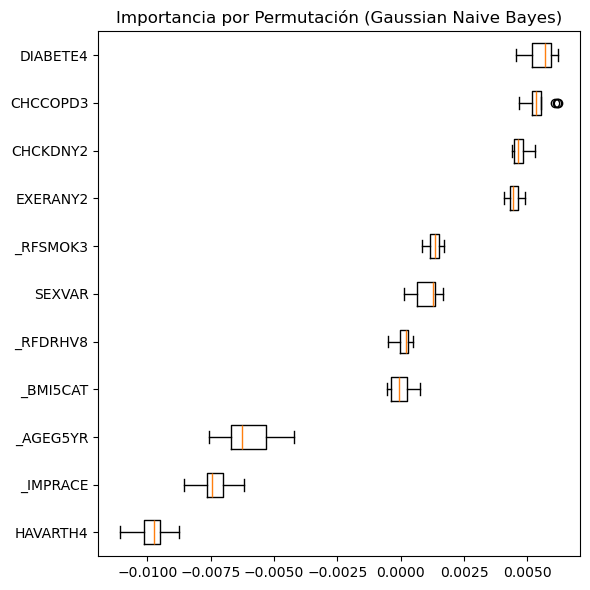

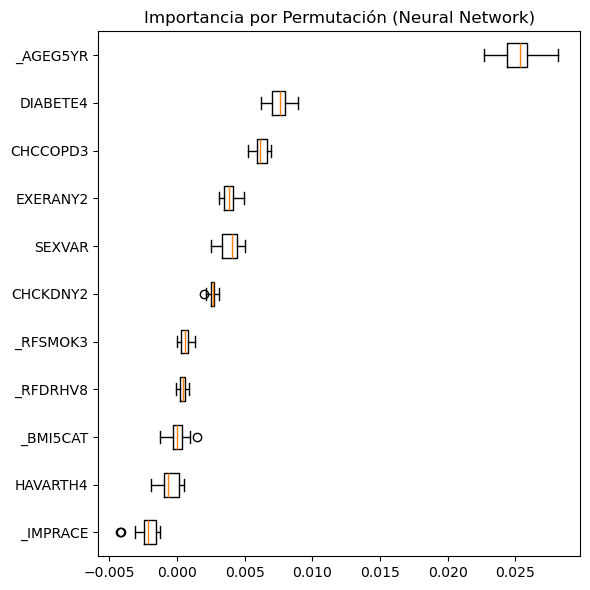

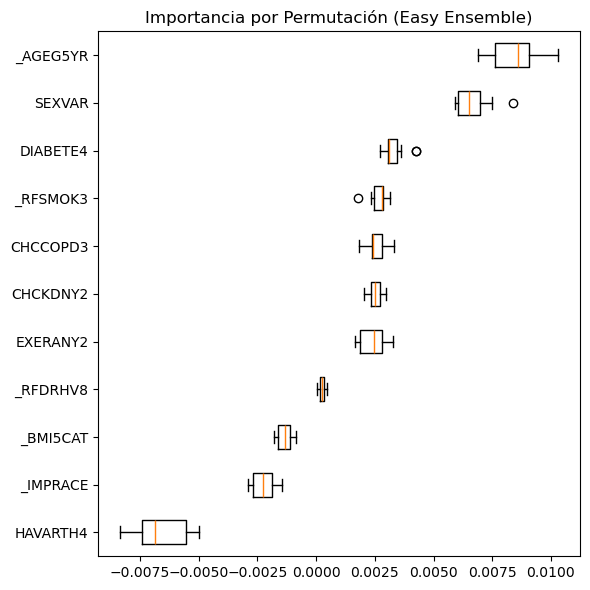

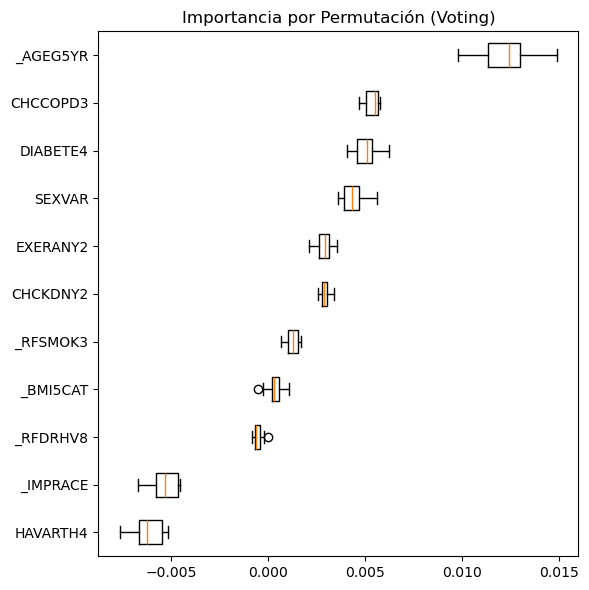

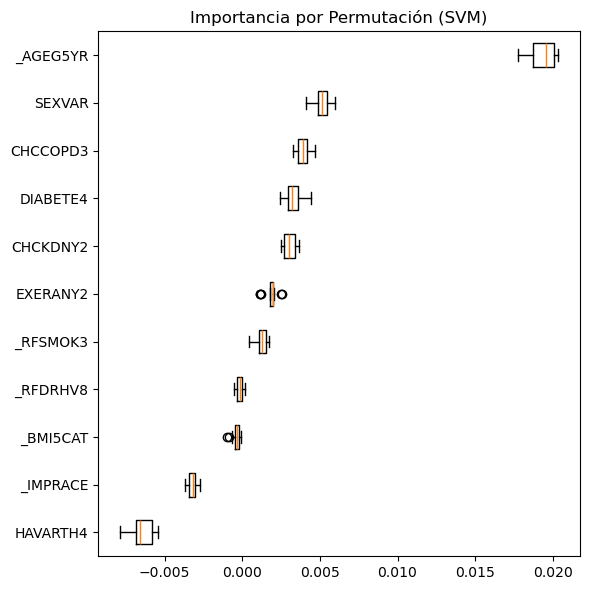

In [239]:
# Graficar importancia y permutación para los modelos con 11 variables
graficar_importancia_permutacion(modelos_optimizados, X_test, y_test, X)
graficar_permutacion_importancia(modelos_optimizados, X_test, y_test, X)

## MODELOS CON TODAS(29) LAS VARIABLES

In [240]:

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/SMOTEN/modelos_iniciales_all"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los modelos base
modelos_base = [
    ('Logistic Regression', LogisticRegression(class_weight='balanced', max_iter=200, random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),
    ('Light GBoost', LGBMClassifier(class_weight='balanced', verbose=-1)),
    ('Random Forest', RandomForestClassifier(class_weight='balanced', n_estimators=500, min_samples_split=2,
                                             max_depth=5, min_samples_leaf=1, random_state=42)),
    ('Neural Network', MLPClassifier(early_stopping=True, random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble = [   
    ('Voting', VotingClassifier(estimators=modelos_base, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(class_weight='balanced', C=100.0, random_state=42, dual=False))
]

# Combinar todos los modelos
modelos = modelos_base + modelos_ensamble

# Crear el objeto de la técnica de muestreo SMOTEN
tecnica_muestreo = SMOTEN(random_state=42)

# Entrenar y evaluar modelos con todas las variables
resultados_allvars, X, X_train, y_train, X_val, y_val, X_test, y_test = entrenar_evaluar_modelos_base(
    df, modelos, carpeta_modelos, tecnica_muestreo)


Dimensiones del conjunto de entrenamiento:
X_train: (439448, 29), y_train: (439448,)

Dimensiones del conjunto de validación:
X_val: (53095, 29), y_val: (53095,)

Dimensiones del conjunto de prueba:
X_test: (53096, 29), y_test: (53096,)

Tiempo de muestreo: 45.03 minutos

Modelo Logistic Regression cargado desde archivo.
Entrenamiento Logistic Regression:
Tiempo de ejecución: 0.10 minutos
Accuracy: 0.7934636179934828
F1-score: 0.796033115797422
Precision: 0.7862514427772352
Recall: 0.806061240465311
AUC-ROC: 0.872509194148285
Matthews Corr Coef: 0.5871136155396471

MATRIZ DE CONFUSIÓN:
[[171575  48149]
 [ 42613 177111]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.80      0.78      0.79    219724
           1       0.79      0.81      0.80    219724

    accuracy                           0.79    439448
   macro avg       0.79      0.79      0.79    439448
weighted avg       0.79      0.79      0.79    439448



Test Logistic Re

### Tabla de métricas de rendimiento modelos base

In [241]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_allvars_inicial = pd.DataFrame.from_dict(resultados_allvars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_allvars_inicial

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.760585,0.367310,0.262074,0.613772,0.766893,0.282182,0.095345
Gaussian Naive Bayes,0.767158,0.370231,0.266833,0.604458,0.735692,0.284721,0.004774
Light GBoost,0.777949,0.352127,0.262925,0.532934,0.769181,0.257835,0.045874
Random Forest,0.732334,0.364059,0.249021,0.676647,0.790691,0.285676,2.047875
Neural Network,0.773749,0.326437,0.246215,0.484198,0.740984,0.224622,3.125269
Easy Ensemble,0.755895,0.374137,0.263591,0.644378,0.781237,0.293568,4.675302
Voting,0.777799,0.377480,0.276430,0.594977,0.783731,0.292368,5.255601
SVM,0.757251,0.367473,0.260633,0.622754,0.768869,0.283302,0.032489


### BÚSQUEDA DE HIPERPARÁMETROS

In [242]:

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/SMOTEN/modelos_entrenados_all"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)


In [243]:

# Definir los espacios de búsqueda de hiperparámetros para cada modelo
param_dist_lr = {
    'class_weight': ['balanced', None],
    'solver': ['newton-cg', 'newton-cholesky', 'sag', 'saga'],
    'penalty': ['l2'],
    'C': loguniform(1e-4, 1e1)
}

param_dist_gnb = {
    'var_smoothing': loguniform(1e-9, 1e-1)
}

param_dist_lgbm = {
    'class_weight': ['balanced', None],
    'n_estimators': randint(50, 251),
    'max_depth': randint(3, 31),
    'subsample': uniform(0.7, 0.3),
    'colsample_bytree': uniform(0.7, 0.3),
    'learning_rate': loguniform(1e-5, 1e-1),
    'num_leaves': randint(10, 101),
    'verbose': [-1]
}

param_dist_rf = {
    'class_weight': ['balanced_subsample', 'balanced'],
    'n_estimators': randint(50, 251),
    'criterion': ['gini', 'entropy'],
    'max_depth': randint(3, 16),
    'min_samples_leaf': randint(3, 16),
    'min_samples_split': randint(3, 16),
    'max_features': [None, 'sqrt', 'log2']
}

param_dist_ann = {
    'hidden_layer_sizes': [(100,), (50,50), (100,100), (50, 50, 50),
                           (100, 100, 100), (50, 50, 50, 50), (100, 100, 100, 100),
                           (50, 50, 50, 50, 50), (100, 100, 100, 100, 100)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': loguniform(1e-5, 1e3),
    'batch_size': [64, 128, 256, 512],
    'learning_rate': ['constant', 'adaptive'],
    'learning_rate_init': loguniform(1e-5, 1e-1),
    'early_stopping': [True],
    'max_iter': [100]
}

param_dist_eec = {
    'n_estimators': randint(2, 20),
    'sampling_strategy': ['auto']
}

param_dist_svm = {
    'dual': ['auto'],
    'tol': loguniform(1e-5, 1e-3),
    'class_weight': [None, 'balanced'],
    'penalty': ['l2'],
    'loss': ['hinge', 'squared_hinge'],
    'C': loguniform(1e-4, 1e4),
    'max_iter': randint(1000, 2001)
}

# Definir los modelos con búsqueda de hiperparámetros
modelos = [
    ('Logistic Regression', RandomizedSearchCV(LogisticRegression(), param_dist_lr,
                                               cv=30, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Gaussian Naive Bayes', RandomizedSearchCV(GaussianNB(), param_dist_gnb, cv=30,
                                                n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('Light GBoost', RandomizedSearchCV(LGBMClassifier(), param_dist_lgbm, cv=5, n_jobs=6,
                                        scoring='f1_weighted', n_iter=50)),
    ('Random Forest', RandomizedSearchCV(RandomForestClassifier(), param_dist_rf,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Neural Network', RandomizedSearchCV(MLPClassifier(), param_dist_ann, cv=5, n_jobs=6,
                                          scoring='f1_weighted', error_score=0, n_iter=50)),
    ('Easy Ensemble', RandomizedSearchCV(EasyEnsembleClassifier(), param_dist_eec,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('SVM', RandomizedSearchCV(LinearSVC(), param_dist_svm, cv=5, n_jobs=6,
                               scoring='f1_weighted', n_iter=50))
]

# Crear un diccionario para almacenar los mejores hiperparámetros de cada modelo
best_params_all = {}

# Entrenar y evaluar cada modelo con búsqueda de hiperparámetros
for nombre, modelo in modelos:
    nombre_archivo = f"{carpeta_modelos}/{nombre}_optimizado.pkl"
    
    # Hash del conjunto de datos actual
    hash_actual = hash_de_datos(X_train)
    
    # Cargar o entrenar modelo
    modelo_cargado, tiempo_ejecucion, mejores_parametros_cargados = cargar_modelo(nombre_archivo, hash_actual)
    
    if modelo_cargado is not None:
        print(f"Modelo {nombre} cargado desde archivo.")
        modelo_best_all = modelo_cargado
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros_cargados}")
        # Agregar los mejores hiperparámetros cargados al diccionario
        best_params_all[nombre] = mejores_parametros_cargados
    else:
        print(f"Entrenando nuevo modelo {nombre}.")
        inicio = time.time()  # Tiempo de inicio
        modelo.fit(X_train, y_train)
        
        mejores_parametros = modelo.best_params_
        
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros}")
        
        # Agregar los mejores hiperparámetros al diccionario
        best_params_all[nombre] = modelo.best_params_
        
        # Entrenar el modelo con los mejores hiperparámetros en el conjunto de entrenamiento completo
        modelo_best_all = modelo.best_estimator_
        modelo_best_all.fit(X_train, y_train)
        
        fin = time.time()  # Tiempo de fin
        tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos
        
        # Guardar el modelo entrenado junto con el tiempo de ejecución y los mejores parámetros
        guardar_modelo(modelo_best_all, nombre_archivo, hash_actual, tiempo_ejecucion, mejores_parametros)

    # Métricas predicción entrenamiento
    y_pred_train = modelo_best_all.predict(X_train)

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_all, "predict_proba"):
        y_scores = modelo_best_all.predict_proba(X_train)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_all.decision_function(X_train)  # Puntuaciones de decisión
    
    print(f"Entrenamiento {nombre}:")
    print(f"Tiempo de búsqueda de hiperparámetros de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_train, y_pred_train)}")
    print(f"F1-score: {f1_score(y_train, y_pred_train)}")
    print(f"Precision: {precision_score(y_train, y_pred_train)}")
    print(f"Recall: {recall_score(y_train, y_pred_train)}")
    print(f"AUC-ROC: {roc_auc_score(y_train, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_train, y_pred_train)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_train, y_pred_train))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_train, y_pred_train))
    print("\n")

    # Métricas predicción validación
    inicio = time.time()  # Tiempo de inicio
    y_pred_val = modelo_best_all.predict(X_val)
    fin = time.time()  # Tiempo de fin
    tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_all, "predict_proba"):
        y_scores = modelo_best_all.predict_proba(X_val)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_all.decision_function(X_val)  # Puntuaciones de decisión

    
    print(f"Validación {nombre}:")
    print(f"Tiempo de ejecución de predicción de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_val, y_pred_val)}")
    print(f"F1-score: {f1_score(y_val, y_pred_val)}")
    print(f"Precision: {precision_score(y_val, y_pred_val)}")
    print(f"Recall: {recall_score(y_val, y_pred_val)}")
    print(f"AUC-ROC: {roc_auc_score(y_val, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_val, y_pred_val)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_val, y_pred_val))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_val, y_pred_val))
    print("\n")

Modelo Logistic Regression cargado desde archivo.
Mejores hiperparámetros para Logistic Regression: {'solver': 'newton-cg', 'penalty': 'l2', 'class_weight': None, 'C': 1}
Entrenamiento Logistic Regression:
Tiempo de búsqueda de hiperparámetros de Logistic Regression: 27.95 minutos
Accuracy: 0.7935409877846753
F1-score: 0.7961315141383092
Precision: 0.7862659115521864
Recall: 0.8062478381970108
AUC-ROC: 0.8725064426413965
Matthews Corr Coef: 0.5872716527162806

MATRIZ DE CONFUSIÓN:
[[171568  48156]
 [ 42572 177152]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.80      0.78      0.79    219724
           1       0.79      0.81      0.80    219724

    accuracy                           0.79    439448
   macro avg       0.79      0.79      0.79    439448
weighted avg       0.79      0.79      0.79    439448



Validación Logistic Regression:
Tiempo de ejecución de predicción de Logistic Regression: 0.00 minutos
Accuracy: 0.75884734

### Entrenar modelos con los mejores parámetros

In [244]:

# Combinar los conjuntos de entrenamiento y validación para todas las variables
X_train_val_allvars = X_train
y_train_val_allvars = y_train

# Definir los modelos con los mejores hiperparámetros
modelos_entrenados_all = [
    ('Logistic Regression', LogisticRegression(random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),    
    ('Light GBoost', LGBMClassifier(verbosity=-1, random_state=42)),
    ('Random Forest', RandomForestClassifier(random_state=42)),   
    ('Neural Network', MLPClassifier(random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble_all = [   
    ('Voting', VotingClassifier(estimators=modelos_entrenados_all, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(random_state=42)) 
]

# Combinar todos los modelos
modelos_optimizados_all = modelos_entrenados_all + modelos_ensamble_all

# Crear el objeto de la técnica de muestreo SMOTEN
tecnica_muestreo = SMOTEN(random_state=42)

# Entrenar y evaluar modelos con todas las variables
resultados_optimizados_allvars, roc_data, pr_data, modelos_optimizados_all = entrenar_evaluar_modelos(
    X_train_val_allvars, y_train_val_allvars, X_test, y_test, modelos_optimizados_all, best_params_all, carpeta_modelos, 
    tecnica_muestreo
)



Tiempo de muestreo: 0.02 minutos

Modelo Logistic Regression cargado desde archivo.
Test Logistic Regression:
Mejores hiperparámetros para Logistic Regression: {'solver': 'newton-cg', 'penalty': 'l2', 'class_weight': None, 'C': 1}
Tiempo de ejecución de entrenamiento: 0.03 minutos
Tiempo de ejecución de predicción: 0.00 minutos
Accuracy: 0.760490432424288
F1-score: 0.36747077841333003
Precision: 0.2621159440857163
Recall: 0.6144377910844977
AUC-ROC: 0.7669869602962682
Matthews Corr Coef: 0.2824394534298687

MATRIZ DE CONFUSIÓN:
[[36685 10399]
 [ 2318  3694]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.94      0.78      0.85     47084
           1       0.26      0.61      0.37      6012

    accuracy                           0.76     53096
   macro avg       0.60      0.70      0.61     53096
weighted avg       0.86      0.76      0.80     53096



Modelo Gaussian Naive Bayes cargado desde archivo.
Test Gaussian Naive Bayes:


### Tabla de métricas de rendimiento con los mejores parámetros

In [245]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_allvars_opt = pd.DataFrame.from_dict(resultados_optimizados_allvars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_allvars_opt

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.760490,0.367471,0.262116,0.614438,0.766987,0.282439,0.032689
Gaussian Naive Bayes,0.784692,0.391980,0.288116,0.612941,0.768927,0.310902,0.005098
Light GBoost,0.787027,0.339872,0.261828,0.484198,0.762426,0.241342,0.072774
Random Forest,0.789796,0.334109,0.260489,0.465735,0.762172,0.234139,5.198413
Neural Network,0.803036,0.302242,0.252340,0.376747,0.737523,0.198016,9.189702
Easy Ensemble,0.755895,0.374137,0.263591,0.644378,0.781237,0.293568,1.753077
Voting,0.799345,0.374692,0.289498,0.530938,0.784157,0.284783,9.719564
SVM,0.760622,0.365642,0.261195,0.609281,0.764034,0.279757,0.928180


### Visualizar comparación de rendimiento de curvas ROC-AUC Y PR-AUC

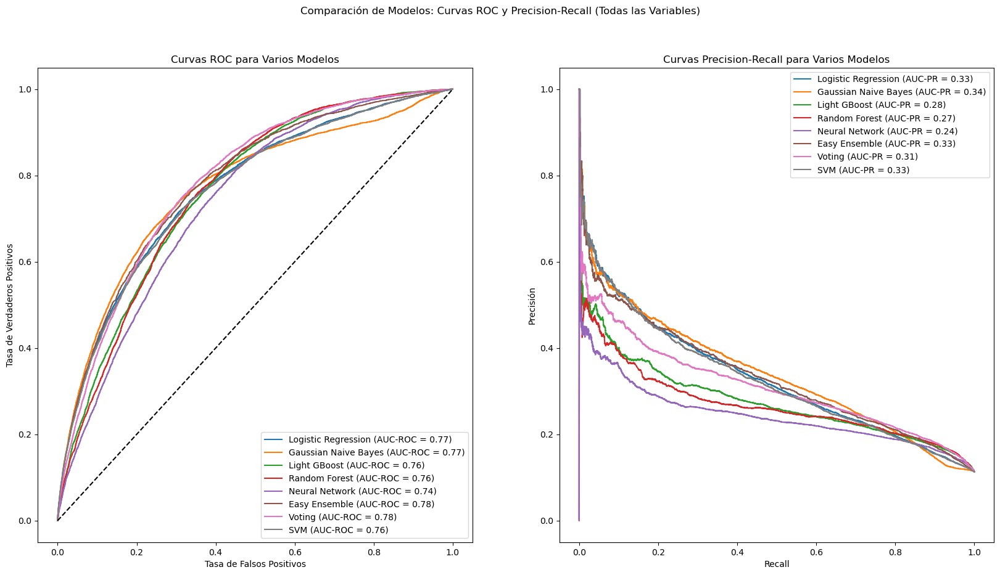

In [246]:
# Graficar curvas de rendimiento para los modelos con todas las variables
graficar_curvas_rendimiento(roc_data, pr_data, 
                            'Comparación de Modelos: Curvas ROC y Precision-Recall (Todas las Variables)')

### EXPLICABILIDAD

#### SHAP values

Valores SHAP para Logistic Regression:


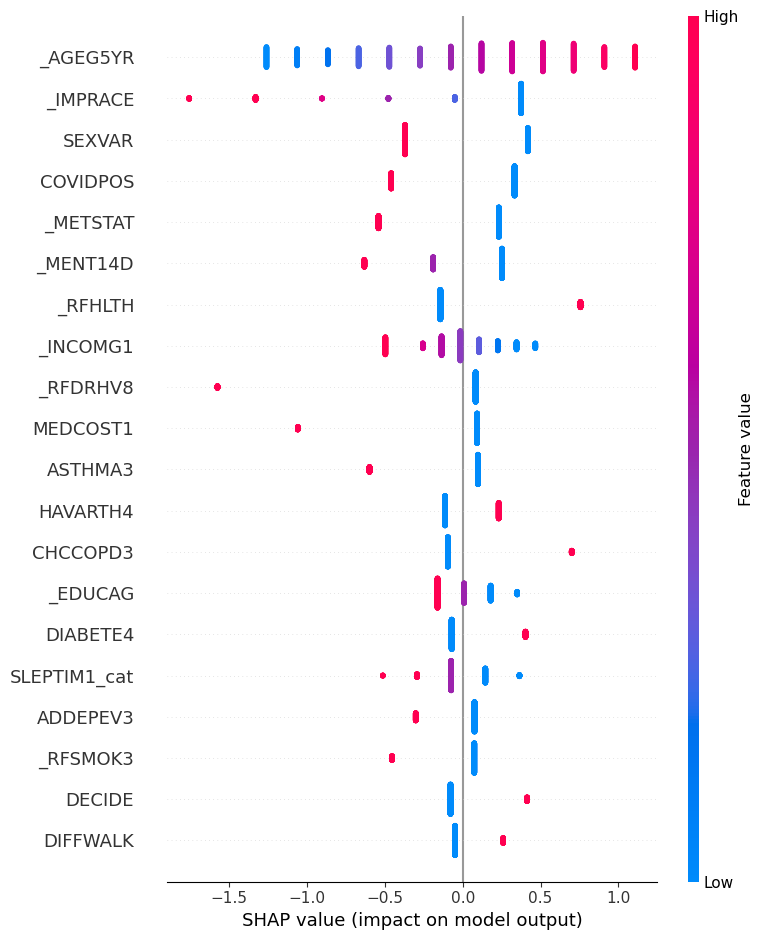

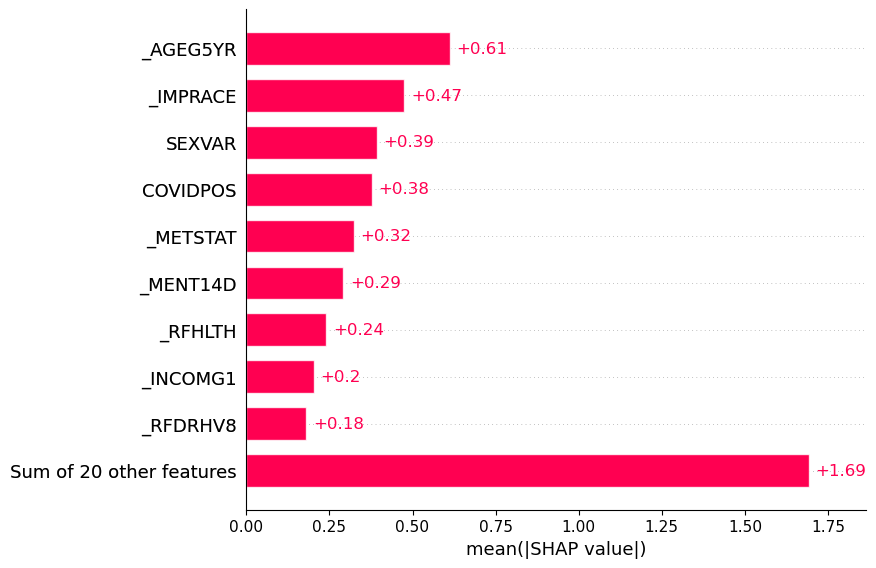

Valores SHAP para Gaussian Naive Bayes:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:43<00:00,  1.63s/it]


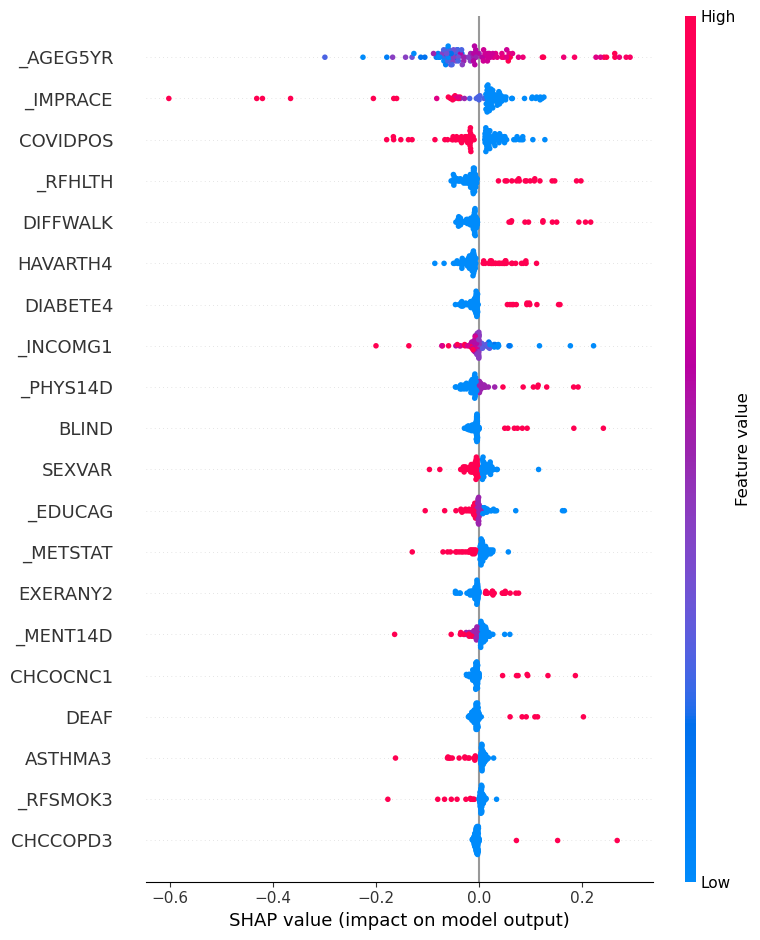

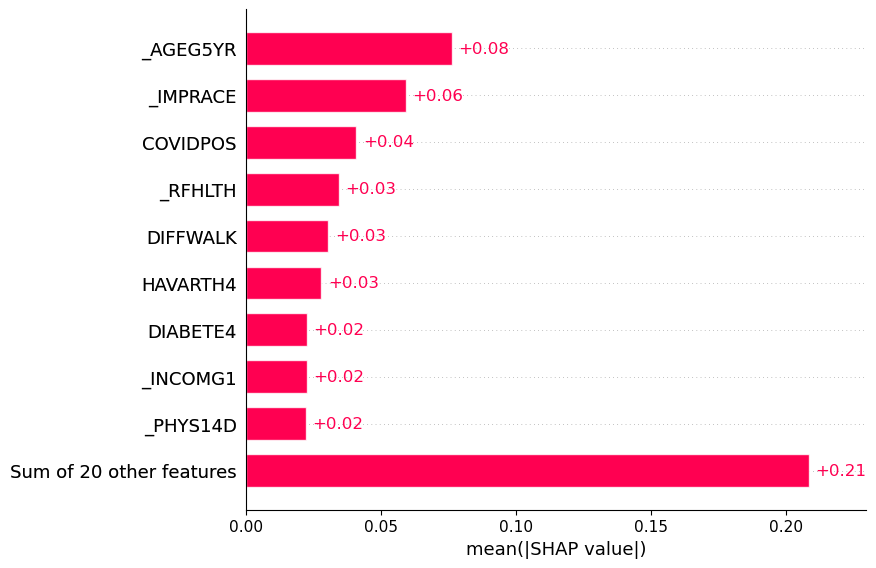

Valores SHAP para Light GBoost:


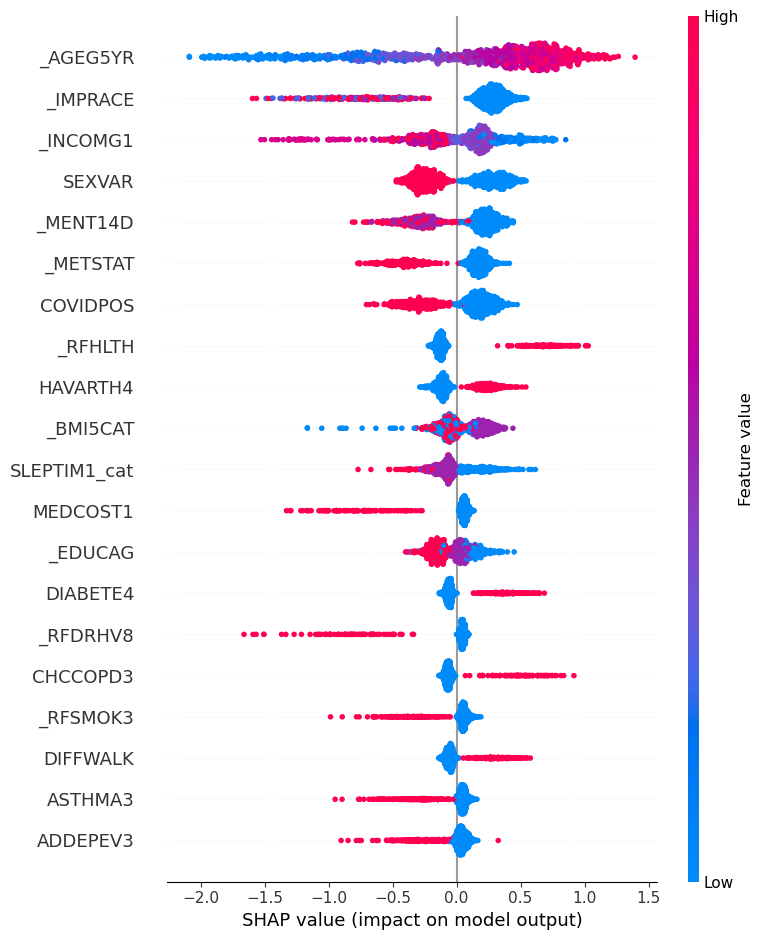

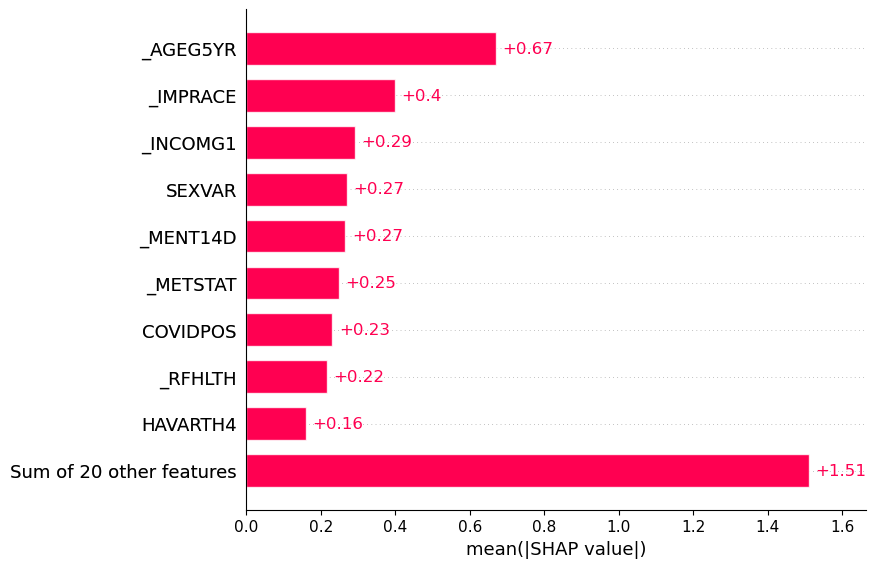

Valores SHAP para Random Forest:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [03:41<00:00,  2.95s/it]


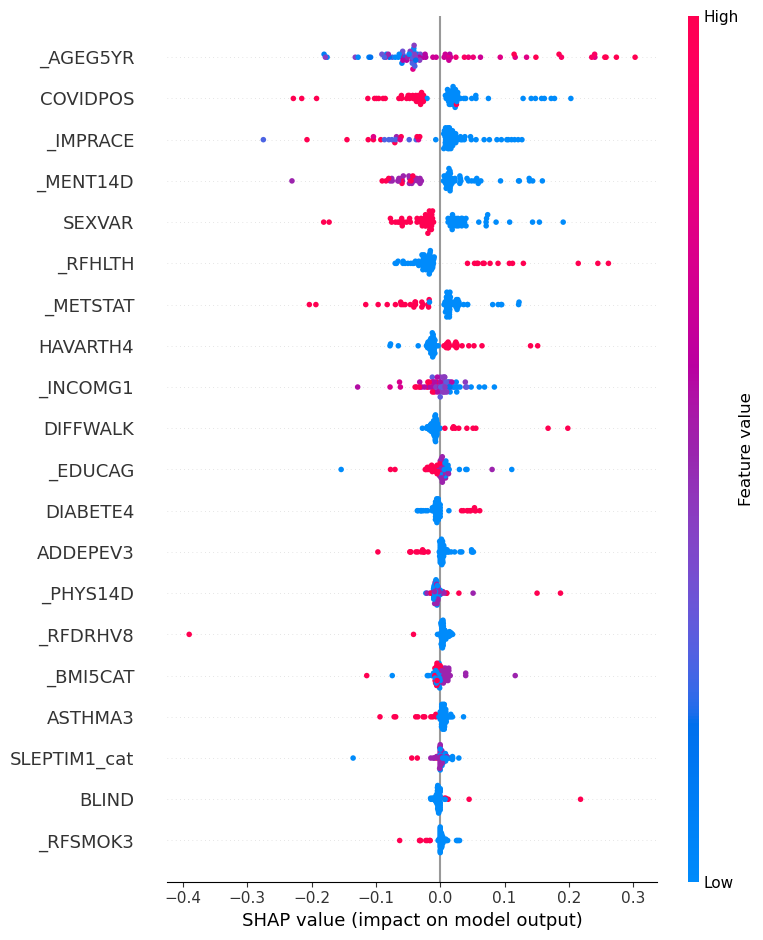

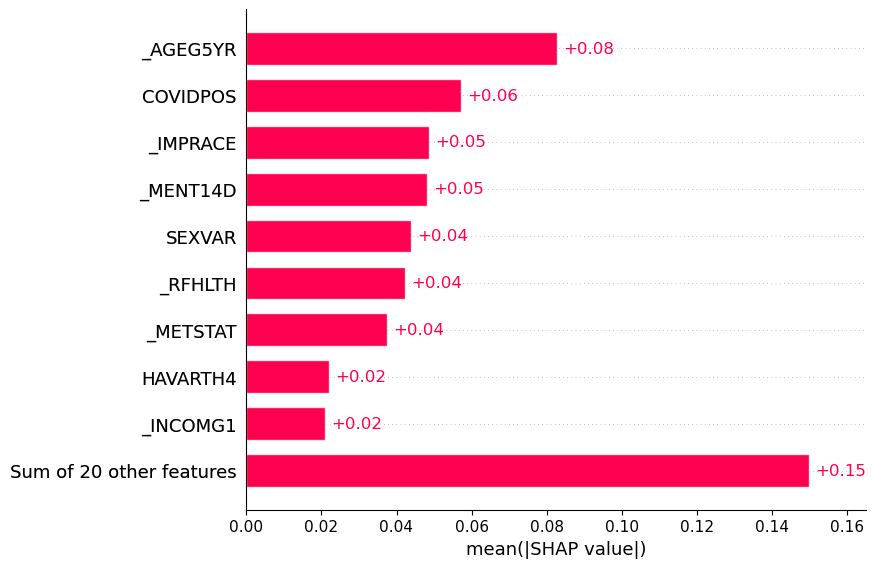

Valores SHAP para Neural Network:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [03:24<00:00,  2.72s/it]


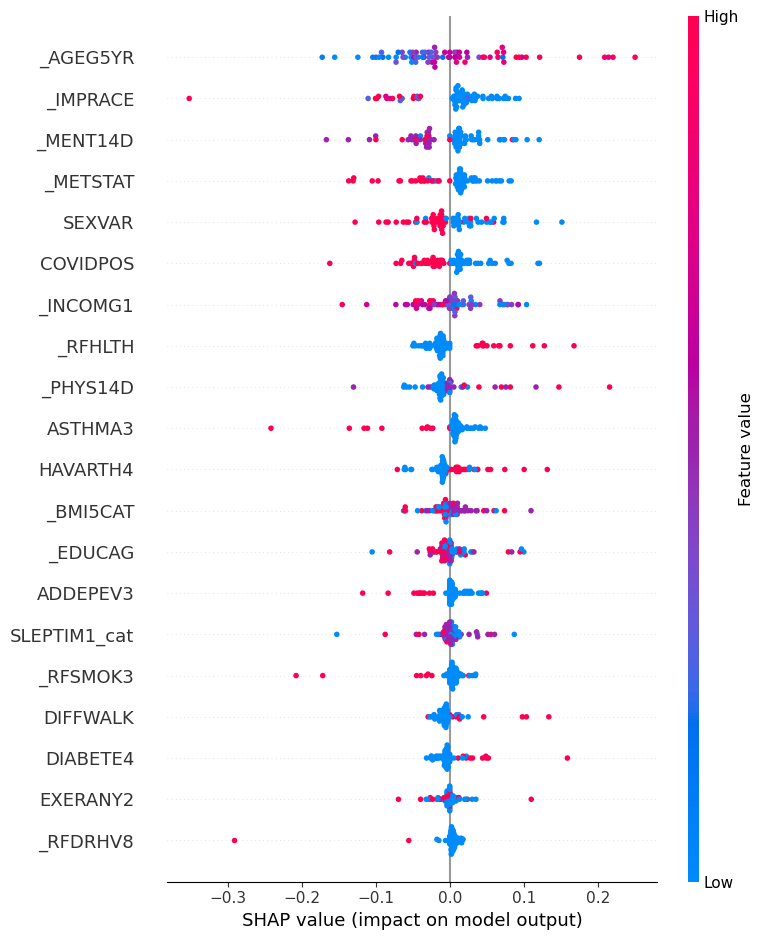

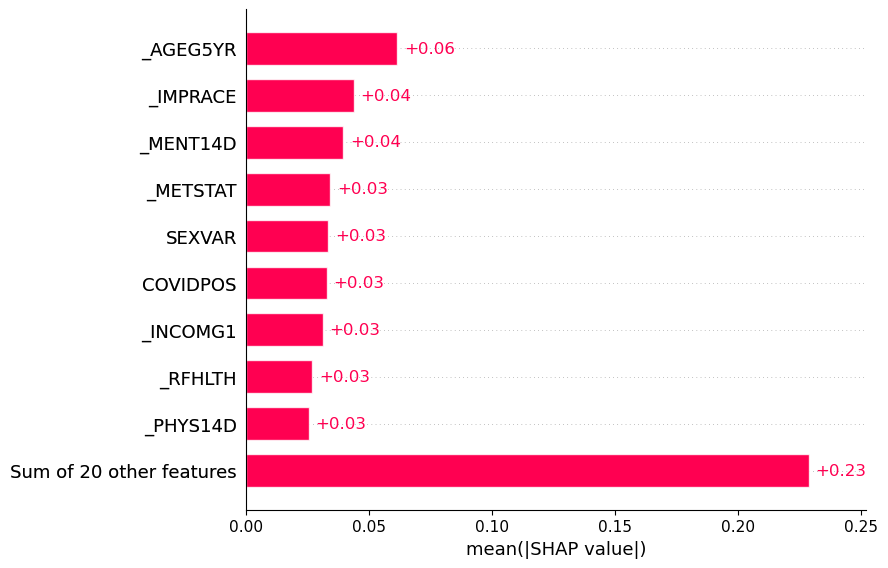

Valores SHAP para Easy Ensemble:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [02:42<00:00,  3.25s/it]


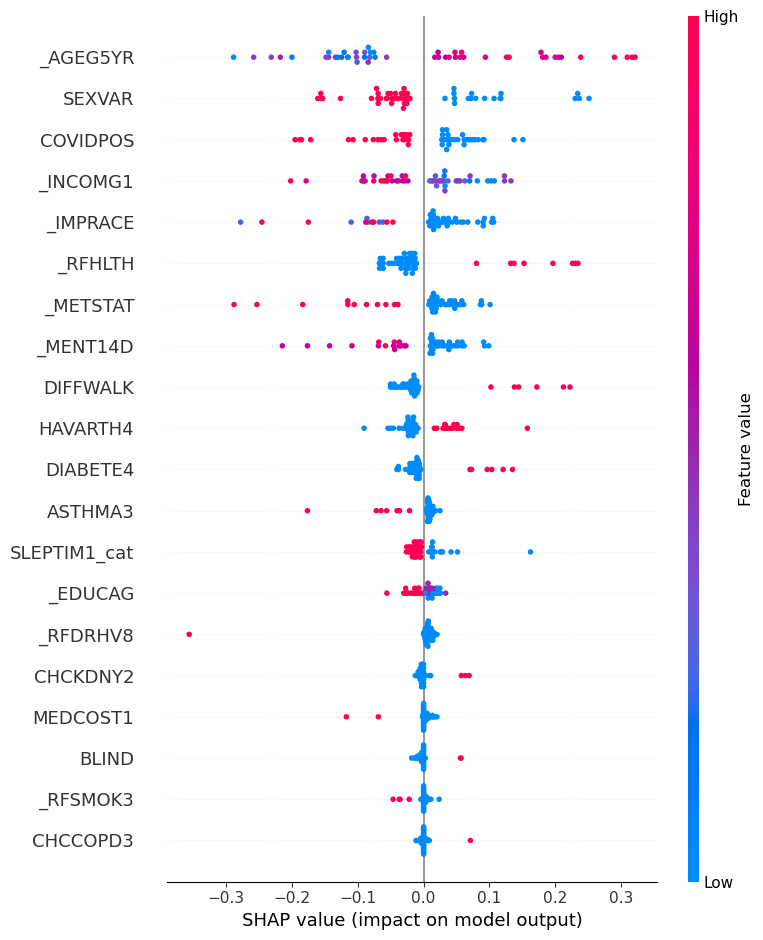

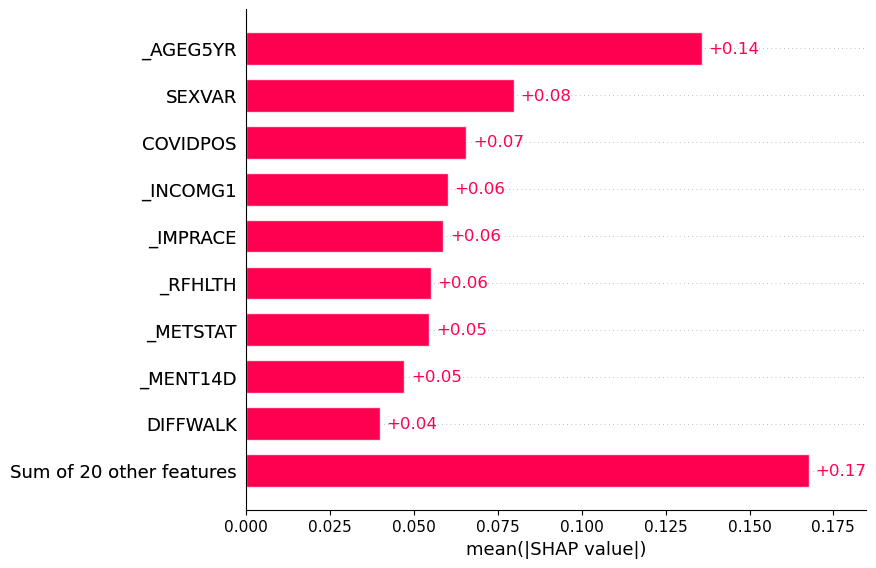

Valores SHAP para Voting:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [05:07<00:00,  6.16s/it]


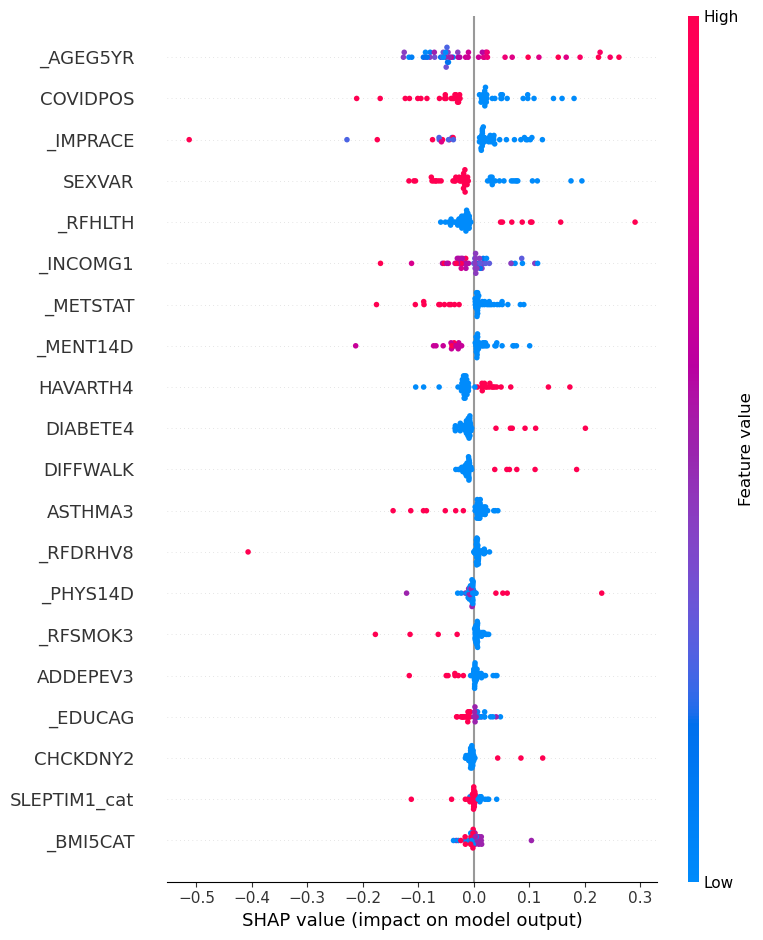

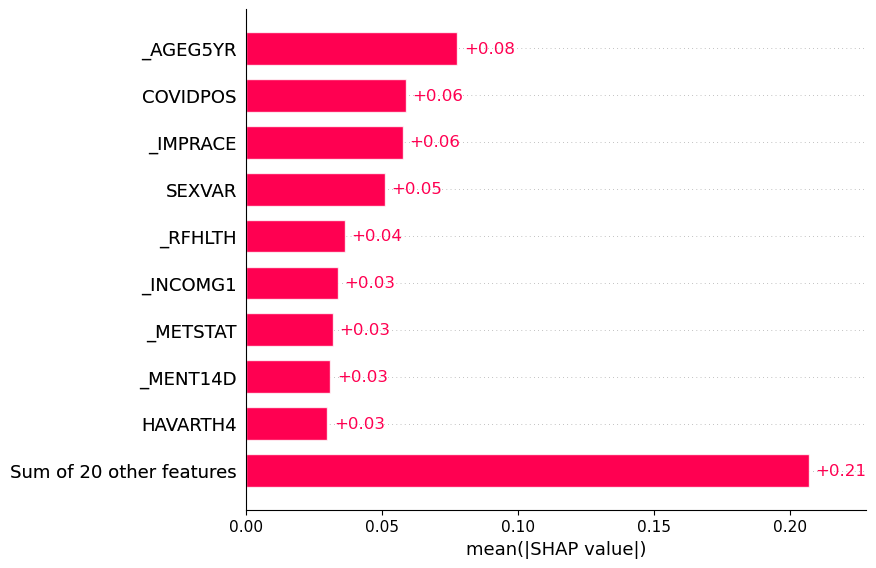

Valores SHAP para SVM:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:36<00:00,  1.56s/it]


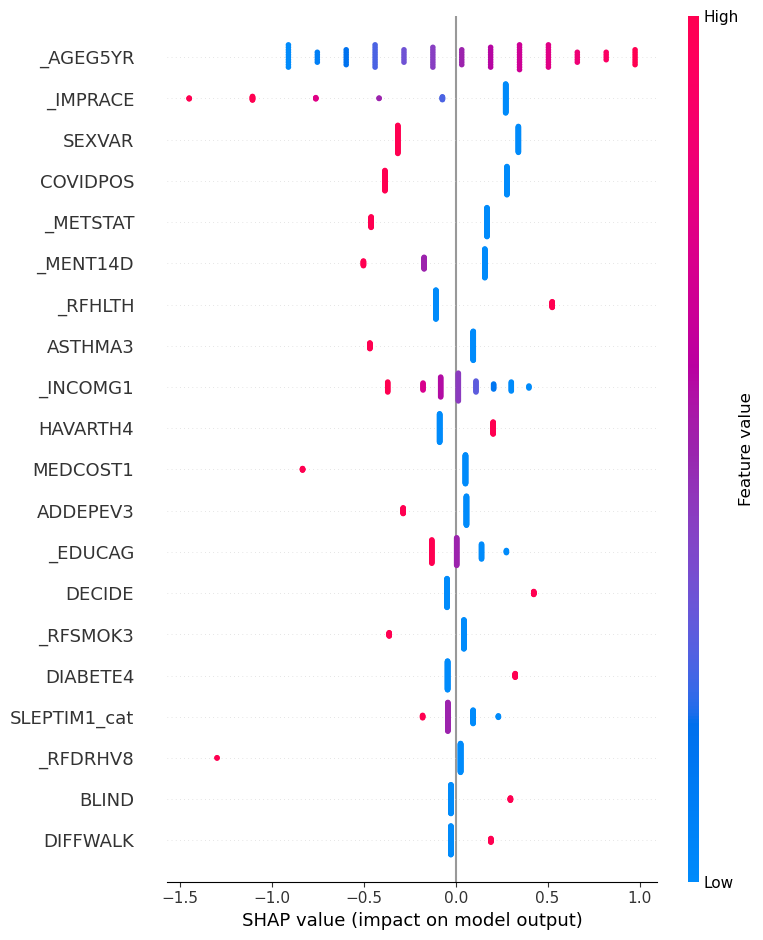

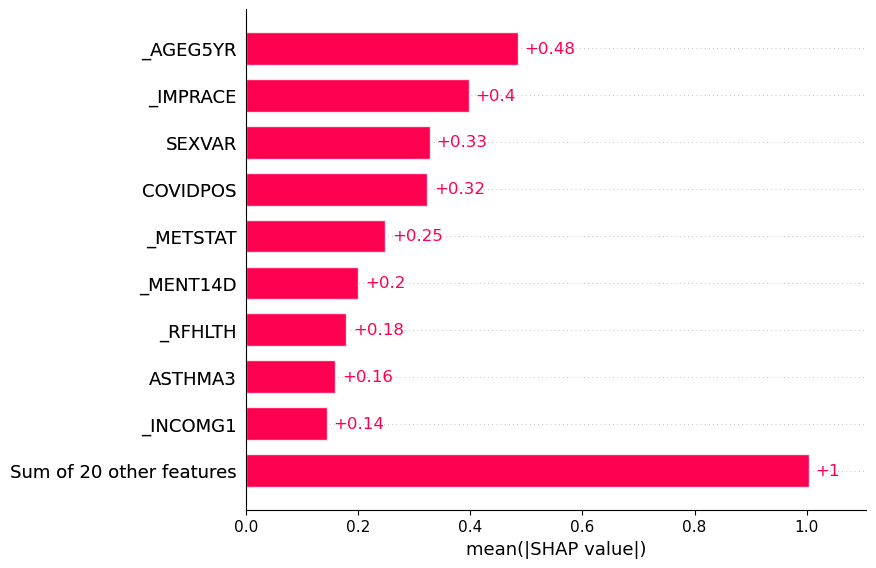

In [247]:
# Iterar sobre los modelos optimizados para graficar la importancia de las variables creadas por SHAP
for nombre, modelo in modelos_optimizados_all:
    print(f"Valores SHAP para {nombre}:")
    
    # Obtener el tamaño de muestra específico para el modelo actual
    sample_size = sample_sizes.get(nombre, 50)  # Valor predeterminado de 50 si no se encuentra el nombre del modelo
    
    # Tomar una muestra aleatoria de los datos de prueba para el cálculo de SHAP
    X_test_sample = shap.utils.sample(X_test, nsamples=sample_size, random_state=42)
    
    explainer_class = explainer_dict.get(type(modelo))
    if explainer_class is None:
        print(f"No se puede calcular los valores SHAP para {nombre}")
        continue
    
    if explainer_class == shap.KernelExplainer:
        if isinstance(modelo, LinearSVC):
            explainer = explainer_class(modelo.decision_function, X_test_sample)
        else:
            explainer = explainer_class(modelo.predict, X_test_sample)
    else:
        explainer = explainer_class(modelo, X_test_sample)
    
    shap_values = explainer(X_test_sample)
    
    # Graficar el Summary Plot de SHAP
    shap.summary_plot(shap_values, X_test_sample)
    plt.show()
    
    # Graficar el Bar Plot de SHAP
    shap.plots.bar(shap_values)
    plt.show()

#### Importancia y permutación de características

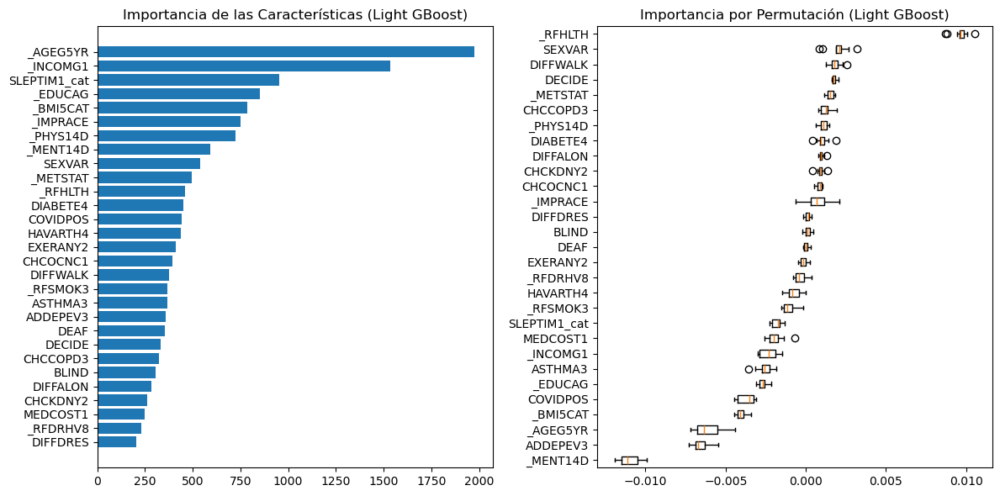

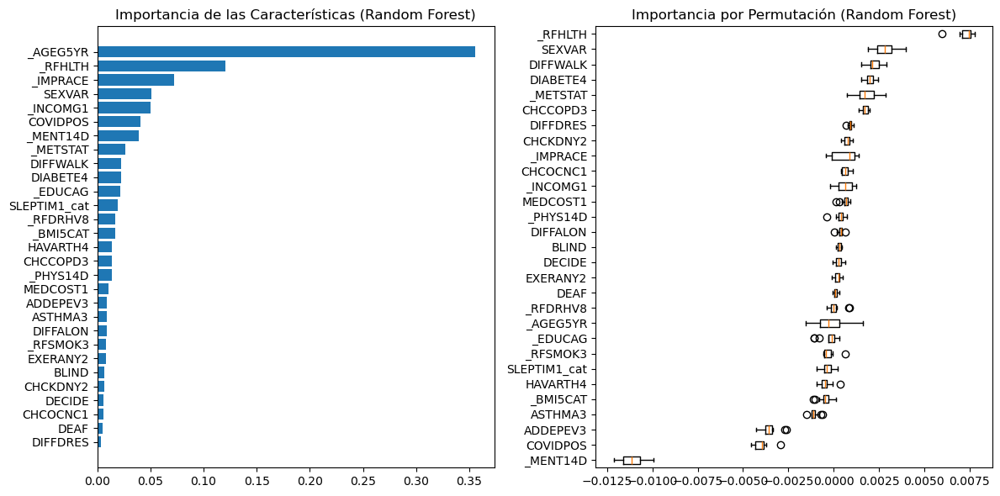

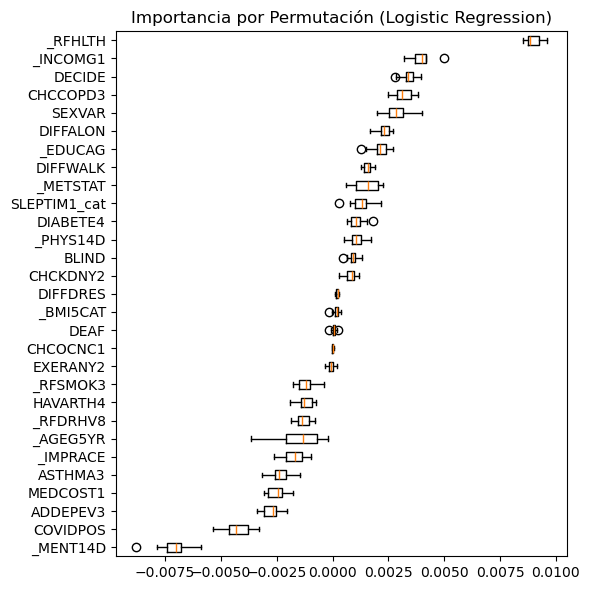

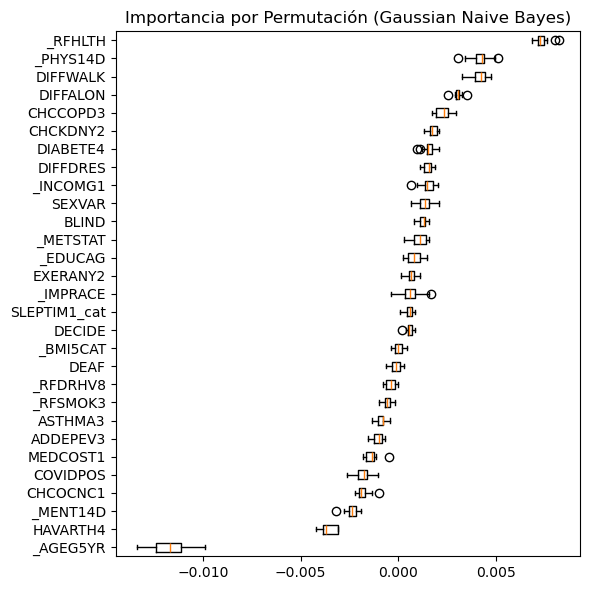

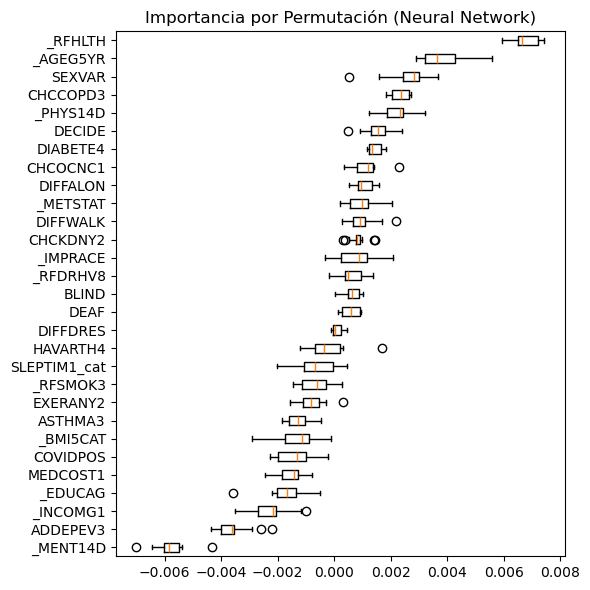

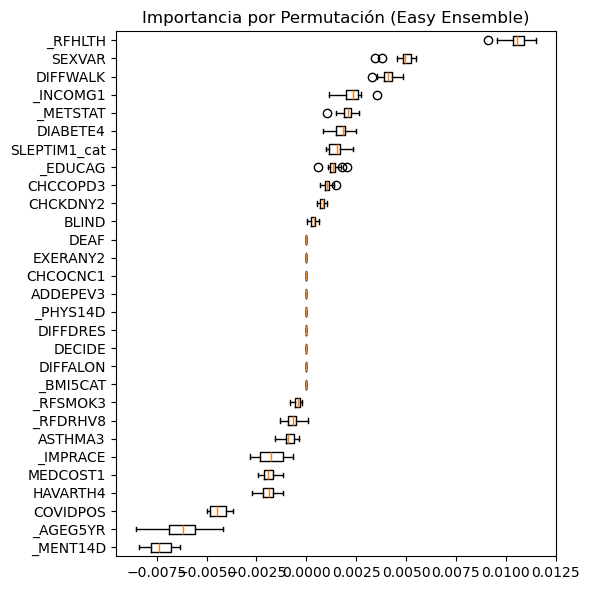

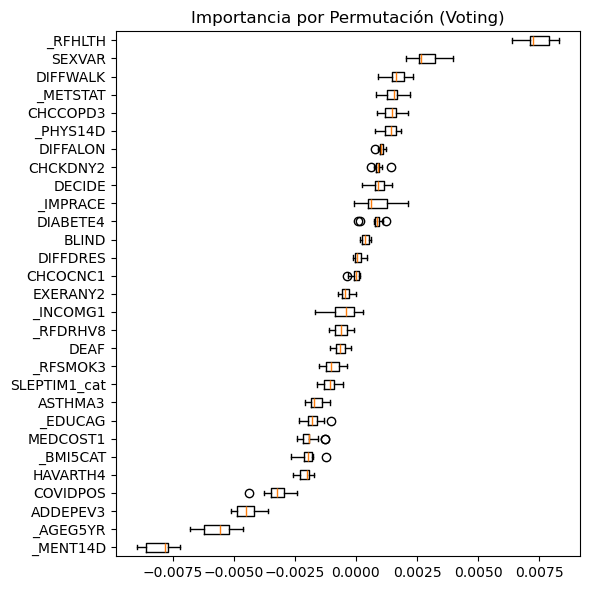

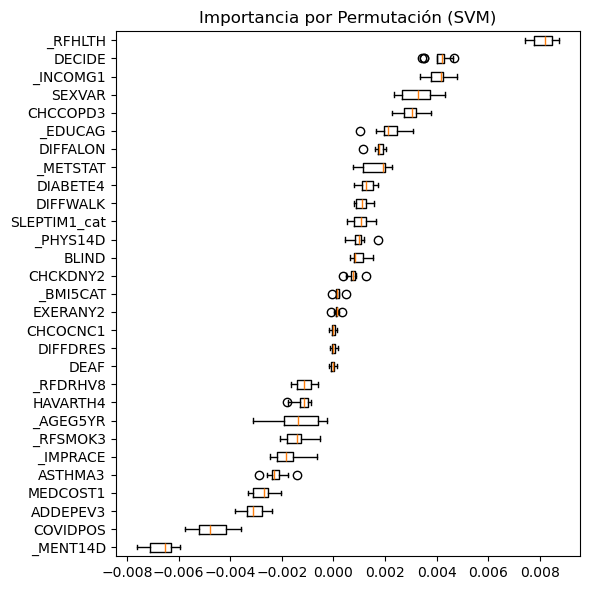

In [248]:
# Graficar importancia y permutación para los modelos con todas las variables
graficar_importancia_permutacion(modelos_optimizados_all, X_test, y_test, X)
graficar_permutacion_importancia(modelos_optimizados_all, X_test, y_test, X)

# ENTRENAMIENTO CON SOBREMUESTREO BorderlineSMOTE()

El capítulo 11 utiliza la técnica de sobremuestreo BorderlineSMOTE, que es una extensión de la técnica SMOTE (Synthetic Minority Over-sampling Technique). BorderlineSMOTE aborda el desequilibrio de clases en conjuntos de datos mediante la generación de instancias sintéticas de la clase minoritaria, con un enfoque particular en las instancias cercanas a la frontera de decisión entre las clases.

El funcionamiento de BorderlineSMOTE se puede describir de la siguiente manera: En primer lugar, se identifican las instancias de la clase minoritaria que se encuentran cerca de la frontera de decisión. Estas instancias se consideran "borderline" y son las que se utilizarán para generar nuevas instancias sintéticas. Para determinar si una instancia es "borderline", se examinan sus k vecinos más cercanos. Si la mayoría de los vecinos pertenecen a la clase mayoritaria, se considera que la instancia está en la frontera de decisión. Luego, se seleccionan aleatoriamente instancias "borderline" y se generan nuevas instancias sintéticas interpolando entre la instancia seleccionada y uno de sus vecinos de la clase minoritaria. Este proceso se repite hasta que se alcanza el número deseado de instancias sintéticas.

Una de sus características es su enfoque en las instancias cercanas a la frontera de decisión. Al centrarse en estas instancias, busca mejorar la capacidad del modelo para discriminar entre las clases en las regiones más críticas del espacio de características. La generación de instancias sintéticas en estas regiones puede ayudar a fortalecer la frontera de decisión y mejorar la capacidad de generalización del modelo.

## MODELO CON 11 VARIABLES

In [249]:
# Seleccionar las columnas deseadas para crear el nuevo dataset
columnas_seleccionadas = ['SEXVAR', 'EXERANY2', 'CHCCOPD3', 'CHCKDNY2', 
                          'HAVARTH4', 'DIABETE4', '_IMPRACE', '_AGEG5YR',
                          '_BMI5CAT', '_RFSMOK3', '_RFDRHV8', 'CARDIO']

# Dataset base con 11 variables
df_11vars = df.loc[:, columnas_seleccionadas]

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/BorderlineSMOTE/modelos_iniciales_11vars"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los modelos base
modelos_base = [
    ('Logistic Regression', LogisticRegression(class_weight='balanced', random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),
    ('Gradient Boosting', GradientBoostingClassifier(learning_rate=0.1, n_estimators=500, max_depth=3, random_state=42,
                                                     min_samples_split=5, min_samples_leaf=3, max_features='sqrt')),
    ('Xtra GBoost', XGBClassifier(learning_rate=0.1, n_estimators=500, max_depth=3, random_state=42, scale_pos_weight=1,
                                  subsample=0.8, colsample_bytree=0.8)),
    ('Light GBoost', LGBMClassifier(class_weight='balanced', verbose=-1)),
    ('Decision Tree',
     DecisionTreeClassifier(class_weight='balanced', criterion='gini', max_depth=5, min_samples_split=20,
                            min_samples_leaf=10, random_state=42)),
    ('Random Forest', RandomForestClassifier(class_weight='balanced', n_estimators=500, min_samples_split=2,
                                             max_depth=5, min_samples_leaf=1, random_state=42)),
    ('Neural Network', MLPClassifier(early_stopping=True, random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble = [
    ('Voting', VotingClassifier(estimators=modelos_base, voting='soft', n_jobs=-1)),
    ('Stacking',
     StackingClassifier(estimators=modelos_base, final_estimator=LogisticRegression(random_state=42), n_jobs=-1)),
    ('SVM', LinearSVC(class_weight='balanced', C=100.0, random_state=42, dual=False))
]

# Combinar todos los modelos
modelos = modelos_base + modelos_ensamble

# Crear el objeto de la técnica de muestreo BorderlineSMOTE
tecnica_muestreo = BorderlineSMOTE(random_state=42)

# Entrenar y evaluar modelos con 11 variables
resultados_11vars, X, X_train, y_train, X_val, y_val, X_test, y_test = entrenar_evaluar_modelos_base(
    df_11vars, modelos, carpeta_modelos, tecnica_muestreo)


Dimensiones del conjunto de entrenamiento:
X_train: (439448, 11), y_train: (439448,)

Dimensiones del conjunto de validación:
X_val: (53095, 11), y_val: (53095,)

Dimensiones del conjunto de prueba:
X_test: (53096, 11), y_test: (53096,)

Tiempo de muestreo: 0.17 minutos

Modelo Logistic Regression cargado desde archivo.
Entrenamiento Logistic Regression:
Tiempo de ejecución: 0.05 minutos
Accuracy: 0.7476333946223443
F1-score: 0.7588720022612137
Precision: 0.7265180719882102
Recall: 0.7942418670695964
AUC-ROC: 0.8170830354588599
Matthews Corr Coef: 0.4974327001843628

MATRIZ DE CONFUSIÓN:
[[154032  65692]
 [ 45210 174514]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.77      0.70      0.74    219724
           1       0.73      0.79      0.76    219724

    accuracy                           0.75    439448
   macro avg       0.75      0.75      0.75    439448
weighted avg       0.75      0.75      0.75    439448



Test Logistic 

### Tabla de métricas de rendimiento modelos base

In [250]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_11vars_inicial = pd.DataFrame.from_dict(resultados_11vars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_11vars_inicial

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.708603,0.370135,0.245041,0.756154,0.801867,0.304846,0.049254
Gaussian Naive Bayes,0.741016,0.366809,0.253613,0.662508,0.772402,0.287125,0.001866
Gradient Boosting,0.695683,0.366651,0.239846,0.777944,0.803138,0.304426,1.082000
Xtra GBoost,0.691182,0.364088,0.237394,0.780772,0.803144,0.301843,0.139384
Light GBoost,0.693743,0.365573,0.238799,0.779275,0.802576,0.303366,0.025390
Decision Tree,0.654852,0.342353,0.218267,0.793413,0.781255,0.277241,0.014295
Random Forest,0.666095,0.352223,0.225687,0.801730,0.798338,0.291126,1.282059
Neural Network,0.671557,0.357656,0.229692,0.807552,0.801914,0.298902,1.250707
Easy Ensemble,0.701089,0.364117,0.239827,0.755822,0.798413,0.297594,1.828524
Voting,0.695721,0.364937,0.238933,0.772122,0.804589,0.301351,2.681125


### BÚSQUEDA DE HIPERPARÁMETROS

In [251]:

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/BorderlineSMOTE/modelos_entrenados_11vars"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los espacios de búsqueda de hiperparámetros para cada modelo
param_dist_lr = {
    'class_weight': ['balanced', None],
    'solver': ['newton-cg', 'newton-cholesky', 'sag', 'saga'],
    'penalty': ['l2'],
    'C': loguniform(1e-4, 1e1)
}

param_dist_gnb = {
    'var_smoothing': loguniform(1e-9, 1e-1)
}

param_dist_lgbm = {
    'class_weight': ['balanced', None],
    'n_estimators': randint(50, 251),
    'max_depth': randint(3, 31),
    'subsample': uniform(0.7, 0.3),
    'colsample_bytree': uniform(0.7, 0.3),
    'learning_rate': loguniform(1e-5, 1e-1),
    'num_leaves': randint(10, 101),
    'verbose': [-1]
}

param_dist_rf = {
    'class_weight': ['balanced_subsample', 'balanced'],
    'n_estimators': randint(50, 251),
    'criterion': ['gini', 'entropy'],
    'max_depth': randint(3, 16),
    'min_samples_leaf': randint(3, 16),
    'min_samples_split': randint(3, 16),
    'max_features': [None, 'sqrt', 'log2']
}

param_dist_ann = {
    'hidden_layer_sizes': [(100,), (50,50), (100,100), (50, 50, 50),
                           (100, 100, 100), (50, 50, 50, 50), (100, 100, 100, 100),
                           (50, 50, 50, 50, 50), (100, 100, 100, 100, 100)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': loguniform(1e-5, 1e3),
    'batch_size': [64, 128, 256, 512],
    'learning_rate': ['constant', 'adaptive'],
    'learning_rate_init': loguniform(1e-5, 1e-1),
    'early_stopping': [True],
    'max_iter': [100]
}

param_dist_eec = {
    'n_estimators': randint(2, 20),
    'sampling_strategy': ['auto']
}

param_dist_svm = {
    'dual': ['auto'],
    'tol': loguniform(1e-5, 1e-3),
    'class_weight': [None, 'balanced'],
    'penalty': ['l2'],
    'loss': ['hinge', 'squared_hinge'],
    'C': loguniform(1e-4, 1e4),
    'max_iter': randint(1000, 2001)
}

# Definir los modelos con búsqueda de hiperparámetros
modelos = [
    ('Logistic Regression', RandomizedSearchCV(LogisticRegression(), param_dist_lr,
                                               cv=30, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Gaussian Naive Bayes', RandomizedSearchCV(GaussianNB(), param_dist_gnb, cv=30,
                                                n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('Light GBoost', RandomizedSearchCV(LGBMClassifier(), param_dist_lgbm, cv=5, n_jobs=6,
                                        scoring='f1_weighted', n_iter=50)),
    ('Random Forest', RandomizedSearchCV(RandomForestClassifier(), param_dist_rf,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Neural Network', RandomizedSearchCV(MLPClassifier(), param_dist_ann, cv=5, n_jobs=6,
                                          scoring='f1_weighted', error_score=0, n_iter=50)),
    ('Easy Ensemble', RandomizedSearchCV(EasyEnsembleClassifier(), param_dist_eec,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('SVM', RandomizedSearchCV(LinearSVC(), param_dist_svm, cv=5, n_jobs=6,
                               scoring='f1_weighted', n_iter=50))
]

# Crear un diccionario para almacenar los mejores hiperparámetros de cada modelo
best_params_11vars = {}

# Entrenar y evaluar cada modelo con búsqueda de hiperparámetros
for nombre, modelo in modelos:
    nombre_archivo = f"{carpeta_modelos}/{nombre}_optimizado.pkl"
    
    # Hash del conjunto de datos actual
    hash_actual = hash_de_datos(X_train)
    
    # Cargar o entrenar modelo
    modelo_cargado, tiempo_ejecucion, mejores_parametros_cargados = cargar_modelo(nombre_archivo, hash_actual)
    
    if modelo_cargado is not None:
        print(f"Modelo {nombre} cargado desde archivo.")
        modelo_best_11vars = modelo_cargado
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros_cargados}")
        
        # Agregar los mejores hiperparámetros cargados al diccionario
        best_params_11vars[nombre] = mejores_parametros_cargados
    else:
        print(f"Entrenando nuevo modelo {nombre}.")
        inicio = time.time()  # Tiempo de inicio
        modelo.fit(X_train, y_train)

        mejores_parametros = modelo.best_params_
        
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros}")
        
        # Agregar los mejores hiperparámetros al diccionario
        best_params_11vars[nombre] = mejores_parametros
        
        # Entrenar el modelo con los mejores hiperparámetros en el conjunto de entrenamiento completo
        modelo_best_11vars = modelo.best_estimator_
        modelo_best_11vars.fit(X_train, y_train)
        
        fin = time.time()  # Tiempo de fin
        tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos
        
        # Guardar el modelo entrenado junto con el tiempo de ejecución y los mejores parámetros
        guardar_modelo(modelo_best_11vars, nombre_archivo, hash_actual, tiempo_ejecucion, mejores_parametros)

    # Imprimir métricas de la predicción en el conjunto de entrenamiento
    y_pred_train = modelo_best_11vars.predict(X_train)

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_11vars, "predict_proba"):
        y_scores = modelo_best_11vars.predict_proba(X_train)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_11vars.decision_function(X_train)  # Puntuaciones de decisión
    
    print(f"Entrenamiento {nombre}:")
    print(f"Tiempo de búsqueda de hiperparámetros de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_train, y_pred_train)}")
    print(f"F1-score: {f1_score(y_train, y_pred_train)}")
    print(f"Precision: {precision_score(y_train, y_pred_train)}")
    print(f"Recall: {recall_score(y_train, y_pred_train)}")
    print(f"AUC-ROC: {roc_auc_score(y_train, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_train, y_pred_train)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_train, y_pred_train))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_train, y_pred_train))
    print("\n")

    # Predecir en el conjunto de validación
    inicio = time.time()  # Tiempo de inicio
    y_pred_val = modelo_best_11vars.predict(X_val)
    fin = time.time()  # Tiempo de fin
    tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_11vars, "predict_proba"):
        y_scores = modelo_best_11vars.predict_proba(X_val)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_11vars.decision_function(X_val)  # Puntuaciones de decisión
    

    # Imprimir métricas de la predicción en el conjunto de validación
    print(f"Validación {nombre}:")
    print(f"Tiempo de ejecución de predicción de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_val, y_pred_val)}")
    print(f"F1-score: {f1_score(y_val, y_pred_val)}")
    print(f"Precision: {precision_score(y_val, y_pred_val)}")
    print(f"Recall: {recall_score(y_val, y_pred_val)}")
    print(f"AUC-ROC: {roc_auc_score(y_val, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_val, y_pred_val)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_val, y_pred_val))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_val, y_pred_val))
    print("\n")
    
 

Modelo Logistic Regression cargado desde archivo.
Mejores hiperparámetros para Logistic Regression: {'C': 2.60168359439905, 'class_weight': 'balanced', 'penalty': 'l2', 'solver': 'newton-cg'}
Entrenamiento Logistic Regression:
Tiempo de búsqueda de hiperparámetros de Logistic Regression: 15.02 minutos
Accuracy: 0.7476151899655932
F1-score: 0.7588608998525901
Precision: 0.7264901048214538
Recall: 0.794250969397972
AUC-ROC: 0.8170754511518246
Matthews Corr Coef: 0.497398686826771

MATRIZ DE CONFUSIÓN:
[[154022  65702]
 [ 45208 174516]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.77      0.70      0.74    219724
           1       0.73      0.79      0.76    219724

    accuracy                           0.75    439448
   macro avg       0.75      0.75      0.75    439448
weighted avg       0.75      0.75      0.75    439448



Validación Logistic Regression:
Tiempo de ejecución de predicción de Logistic Regression: 0.00 minutos
A

### Entrenar modelos con los mejores parámetros

In [252]:
# Combinar los conjuntos de entrenamiento y validación para 11 variables
X_train_val_11vars = pd.concat([X_train, X_val], ignore_index=True)
y_train_val_11vars = pd.concat([y_train, y_val], ignore_index=True)

# Definir los modelos base
modelos_entrenados = [
    ('Logistic Regression', LogisticRegression(random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),    
    ('Light GBoost', LGBMClassifier(verbosity=-1, random_state=42)),
    ('Random Forest', RandomForestClassifier(random_state=42)),   
    ('Neural Network', MLPClassifier(random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble = [   
    ('Voting', VotingClassifier(estimators=modelos_entrenados, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(random_state=42)) 
]

# Combinar todos los modelos
modelos_optimizados = modelos_entrenados + modelos_ensamble

# Crear el objeto de la técnica de muestreo BorderlineSMOTE
tecnica_muestreo = BorderlineSMOTE(random_state=42)

# Entrenar y evaluar modelos con 11 variables
resultados_optimizados_11vars, roc_data_11vars, pr_data_11vars, modelos_optimizados = entrenar_evaluar_modelos(
    X_train_val_11vars, y_train_val_11vars, X_test, y_test, modelos_optimizados, best_params_11vars, carpeta_modelos, 
    tecnica_muestreo
)



Tiempo de muestreo: 2.34 minutos

Modelo Logistic Regression cargado desde archivo.
Test Logistic Regression:
Mejores hiperparámetros para Logistic Regression: {'C': 2.60168359439905, 'class_weight': 'balanced', 'penalty': 'l2', 'solver': 'newton-cg'}
Tiempo de ejecución de entrenamiento: 0.02 minutos
Tiempo de ejecución de predicción: 0.00 minutos
Accuracy: 0.7063808949826729
F1-score: 0.3687747995789133
Precision: 0.24371186984908488
Recall: 0.7574850299401198
AUC-ROC: 0.8014616386404265
Matthews Corr Coef: 0.30344879479299725

MATRIZ DE CONFUSIÓN:
[[32952 14132]
 [ 1458  4554]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.96      0.70      0.81     47084
           1       0.24      0.76      0.37      6012

    accuracy                           0.71     53096
   macro avg       0.60      0.73      0.59     53096
weighted avg       0.88      0.71      0.76     53096



Modelo Gaussian Naive Bayes cargado desde archivo.
Test

### Tabla de métricas de rendimiento con los mejores parámetros

In [253]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_11vars_opt = pd.DataFrame.from_dict(resultados_optimizados_11vars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_11vars_opt

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.706381,0.368775,0.243712,0.757485,0.801462,0.303449,0.020910
Gaussian Naive Bayes,0.688300,0.353314,0.230899,0.751996,0.784363,0.283832,0.002866
Light GBoost,0.695589,0.364487,0.238659,0.770958,0.801698,0.300608,0.107548
Random Forest,0.698979,0.344771,0.228769,0.699434,0.767407,0.265322,2.011092
Neural Network,0.688602,0.349772,0.229038,0.739687,0.783246,0.277493,32.061386
Easy Ensemble,0.702294,0.364951,0.240585,0.755489,0.799102,0.298541,2.296332
Voting,0.705138,0.363629,0.240613,0.744012,0.798849,0.295069,25.747675
SVM,0.698132,0.366081,0.240141,0.769794,0.801466,0.302322,0.017194


### Visualizar comparación de rendimiento de curvas ROC-AUC Y PR-AUC


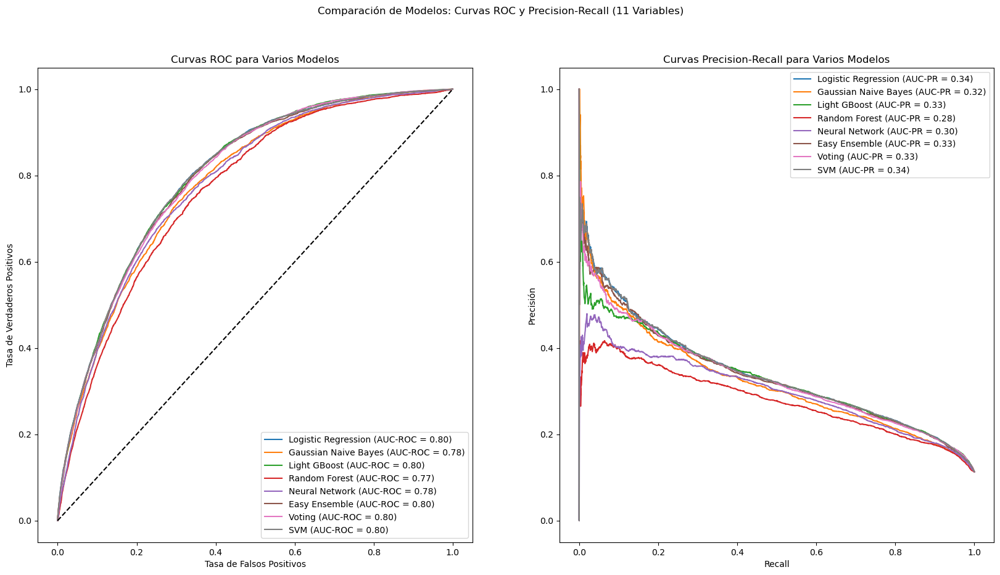

In [254]:
# Graficar curvas de rendimiento para los modelos con 11 variables
graficar_curvas_rendimiento(roc_data_11vars, pr_data_11vars, 
                            'Comparación de Modelos: Curvas ROC y Precision-Recall (11 Variables)')

### EXPLICABILIDAD

#### SHAP values

Valores SHAP para Logistic Regression:


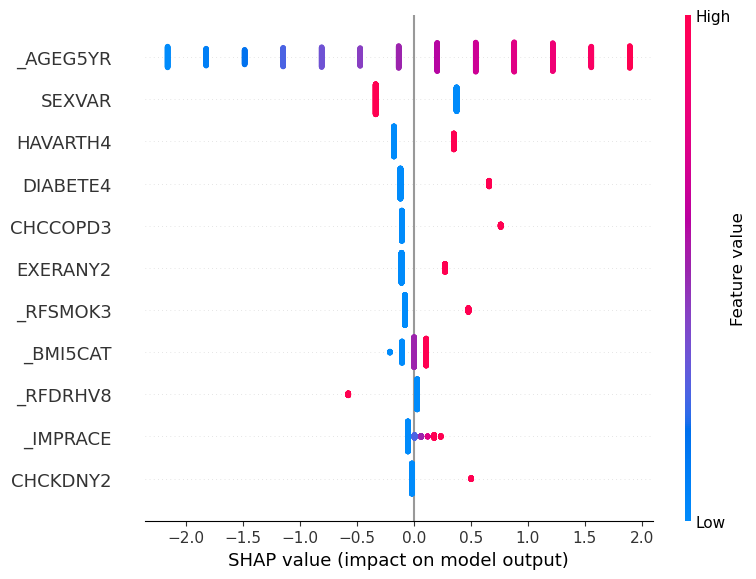

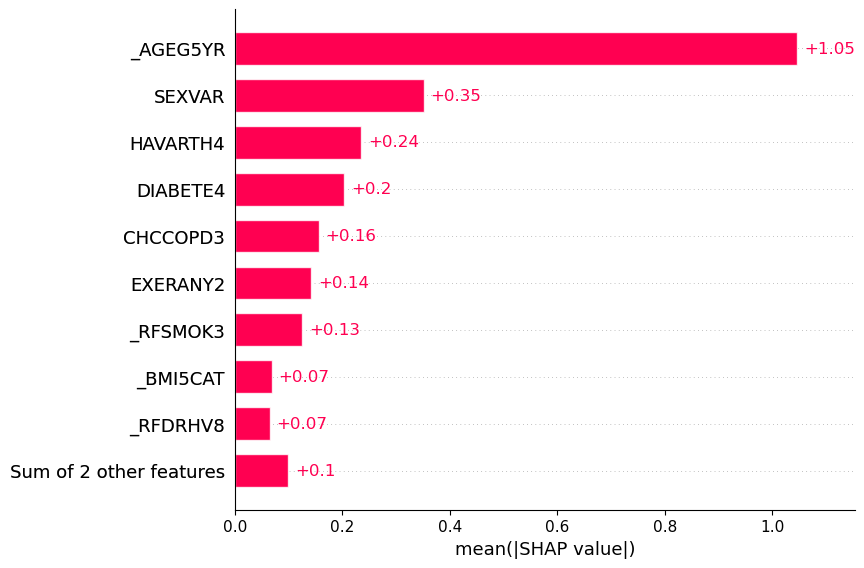

Valores SHAP para Gaussian Naive Bayes:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:11<00:00,  1.31s/it]


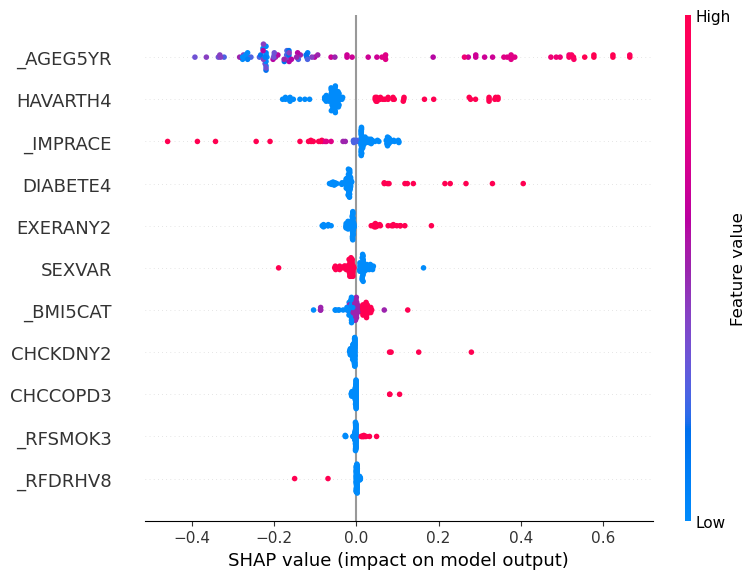

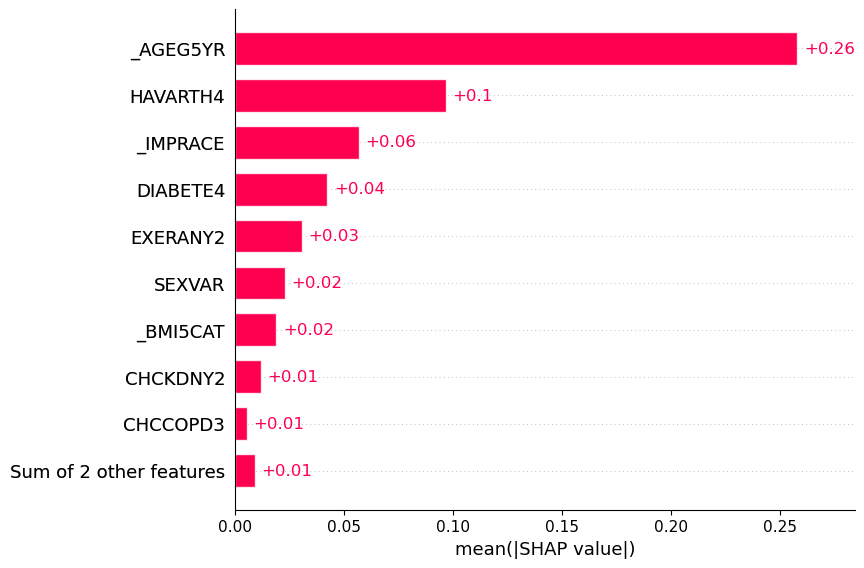

Valores SHAP para Light GBoost:


 99%|===================| 989/1000 [00:11<00:00]       

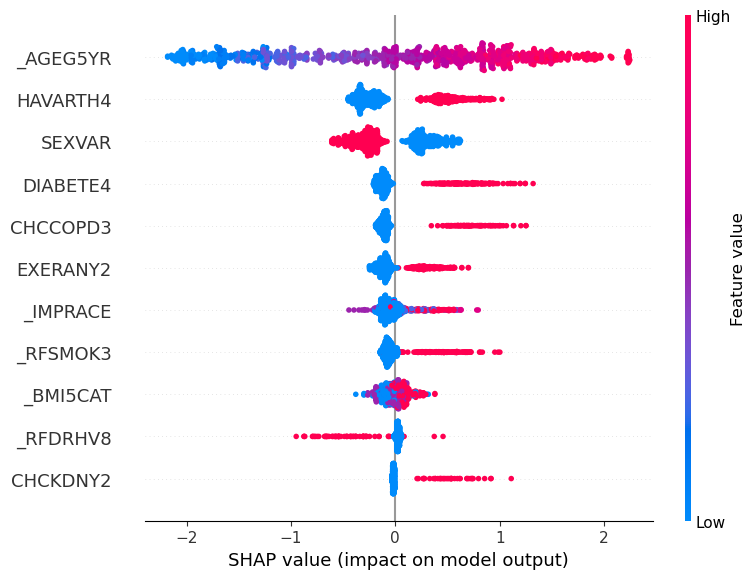

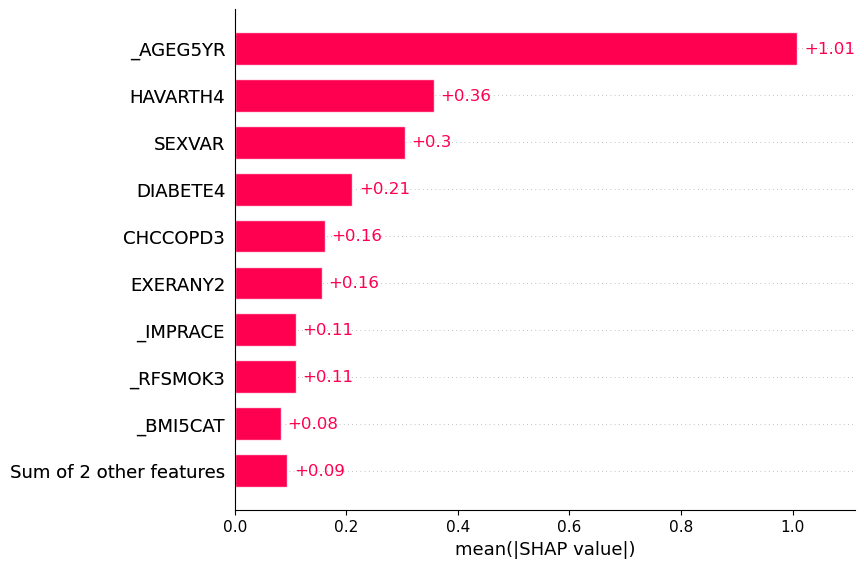

Valores SHAP para Random Forest:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [02:50<00:00,  2.27s/it]


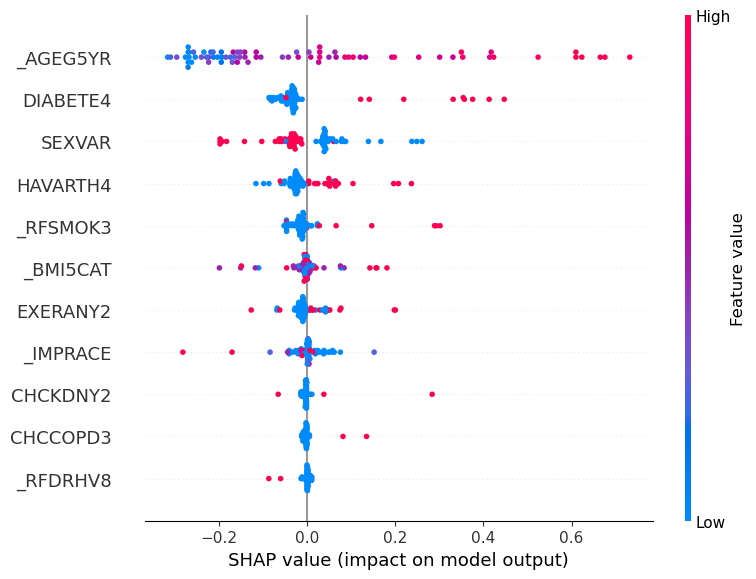

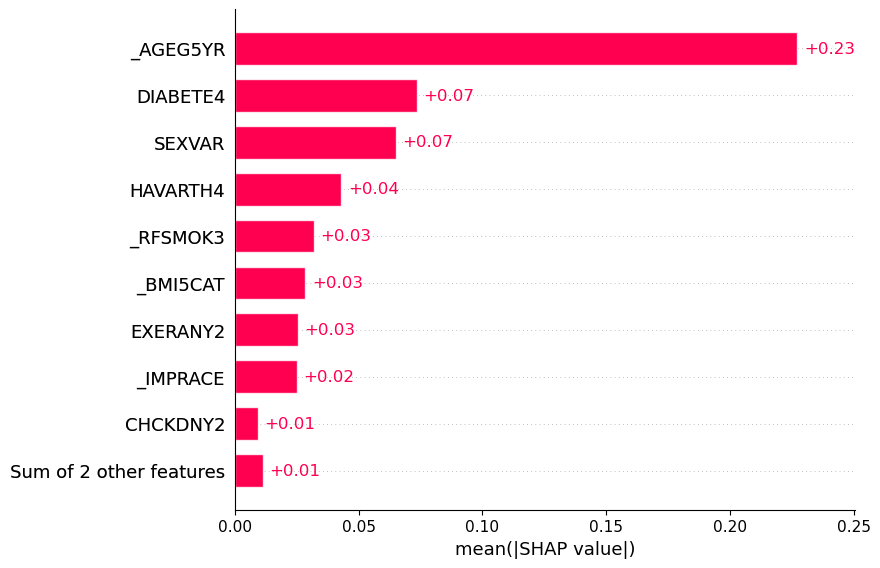

Valores SHAP para Neural Network:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [03:10<00:00,  2.54s/it]


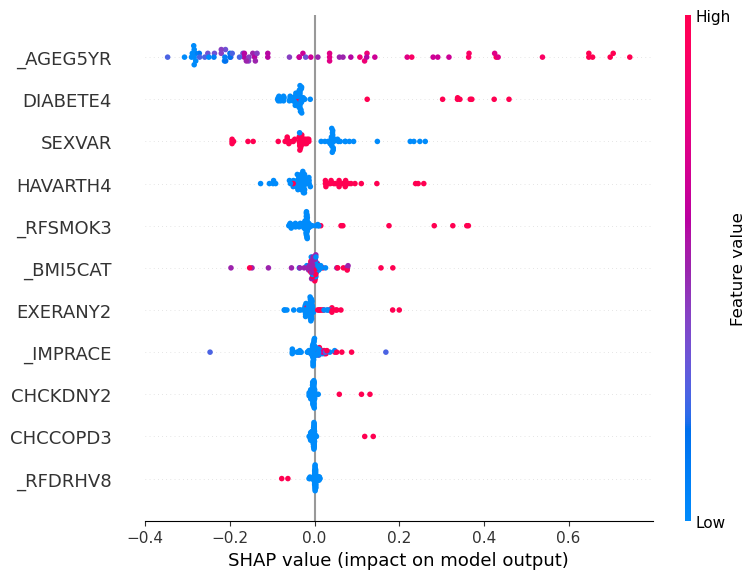

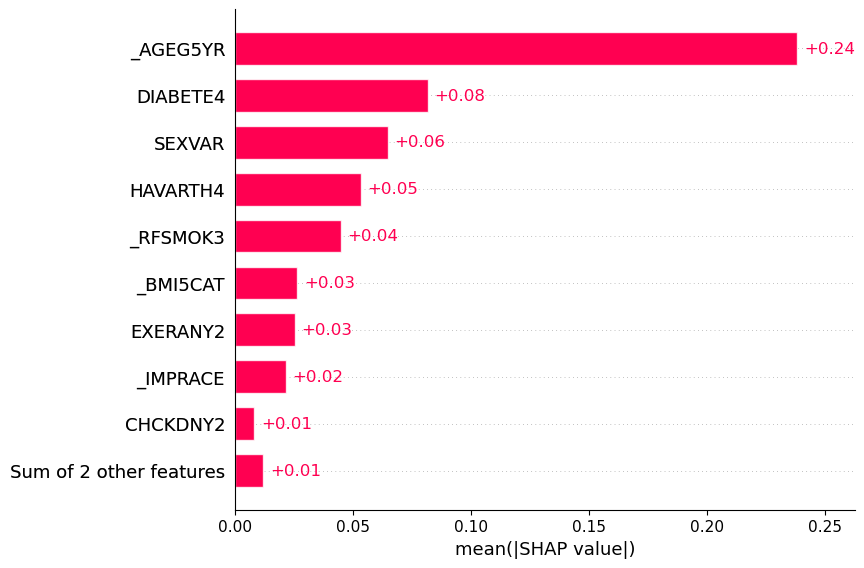

Valores SHAP para Easy Ensemble:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [03:42<00:00,  4.44s/it]


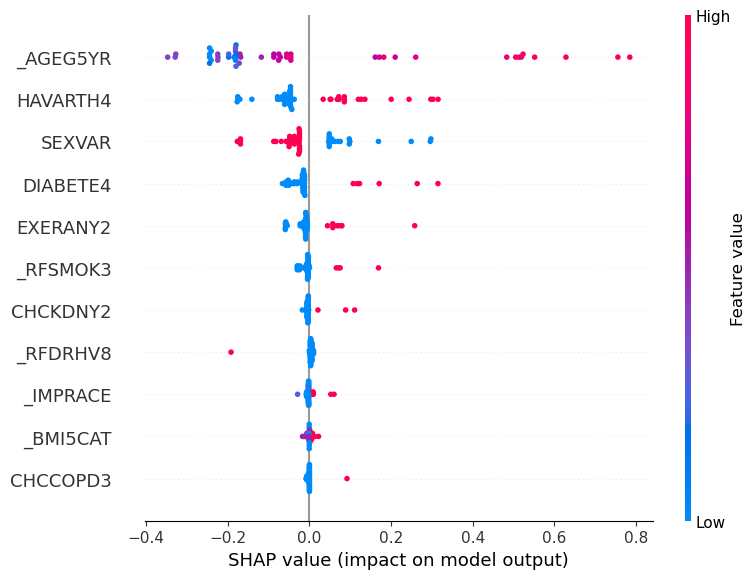

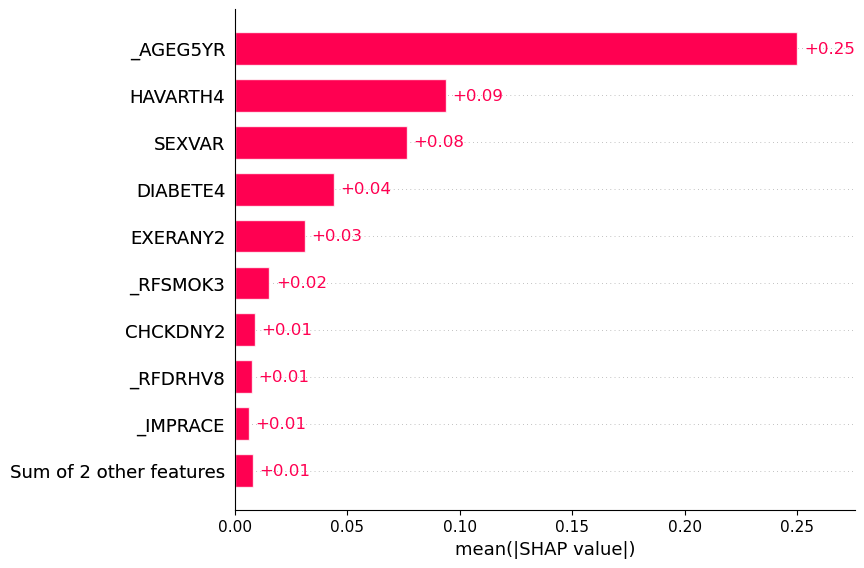

Valores SHAP para Voting:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [05:48<00:00,  6.96s/it]


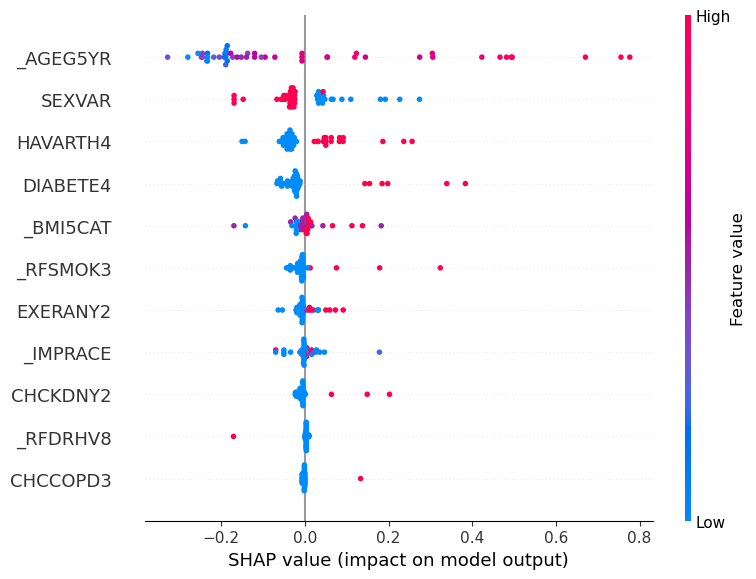

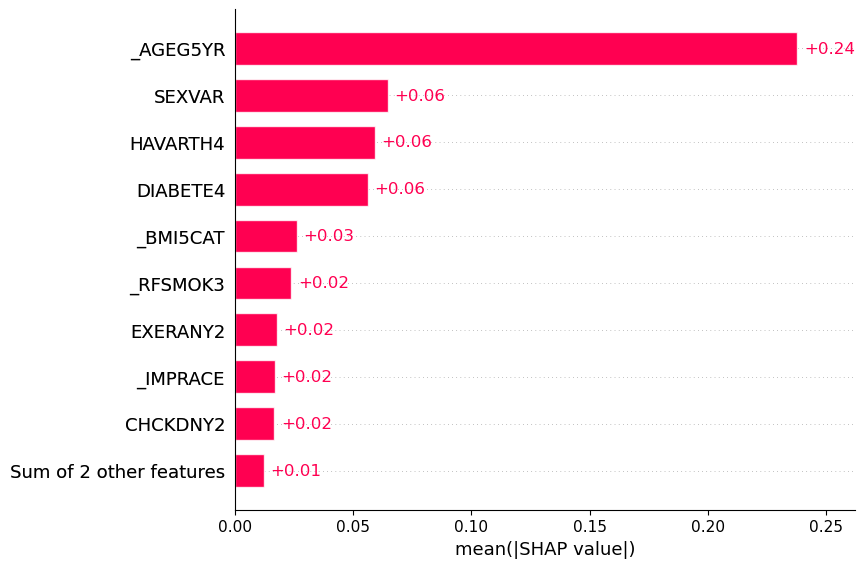

Valores SHAP para SVM:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:10<00:00,  1.30s/it]


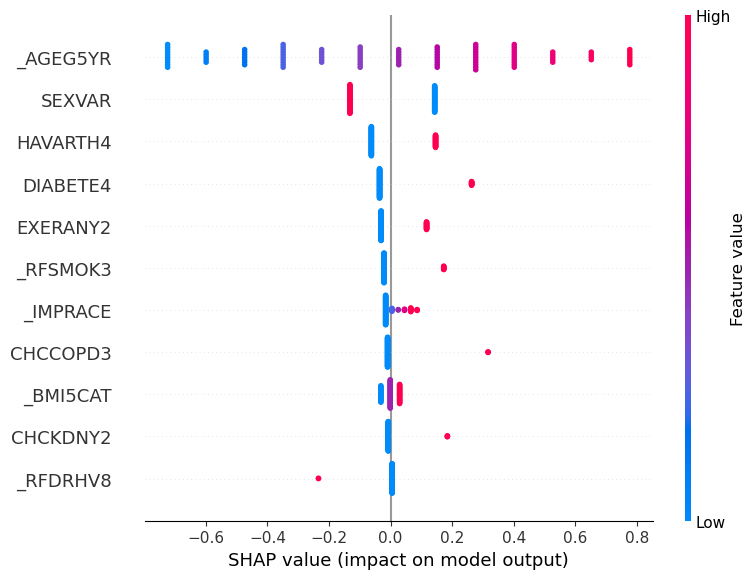

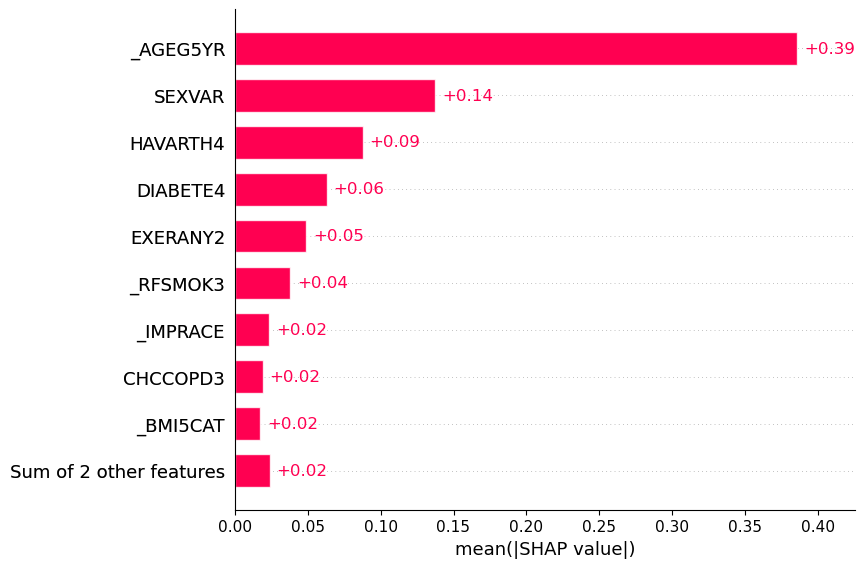

In [255]:
# Diccionario para mapear los tipos de modelo a sus correspondientes objetos explainer de SHAP
explainer_dict = {
    LogisticRegression: shap.LinearExplainer,
    GaussianNB: shap.KernelExplainer,
    LGBMClassifier: shap.TreeExplainer,
    RandomForestClassifier: shap.KernelExplainer,
    MLPClassifier: shap.KernelExplainer,
    EasyEnsembleClassifier: shap.KernelExplainer,
    VotingClassifier: shap.KernelExplainer,
    LinearSVC: shap.KernelExplainer    
    
}

# Diccionario para mapear los nombres de los modelos a sus correspondientes tamaños de muestra
sample_sizes = {
    'Logistic Regression': 1000,
    'Gaussian Naive Bayes': 100,
    'Light GBoost': 1000,
    'Random Forest': 75,
    'Neural Network': 75,
    'Easy Ensemble': 50,
    'SVM': 100,
    'Voting': 50
}

# Iterar sobre los modelos optimizados para graficar la importancia de las variables creadas por SHAP
for nombre, modelo in modelos_optimizados:
    print(f"Valores SHAP para {nombre}:")
    
    # Obtener el tamaño de muestra específico para el modelo actual
    sample_size = sample_sizes.get(nombre, 50)  # Valor predeterminado de 50 si no se encuentra el nombre del modelo
    
    # Tomar una muestra aleatoria de los datos de prueba para el cálculo de SHAP
    X_test_sample = shap.utils.sample(X_test, nsamples=sample_size, random_state=42)
    
    explainer_class = explainer_dict.get(type(modelo))
    if explainer_class is None:
        print(f"No se puede calcular los valores SHAP para {nombre}")
        continue
    
    if explainer_class == shap.KernelExplainer:
        if isinstance(modelo, LinearSVC):
            explainer = explainer_class(modelo.decision_function, X_test_sample)
        else:
            explainer = explainer_class(modelo.predict, X_test_sample)
    else:
        explainer = explainer_class(modelo, X_test_sample)
    
    shap_values = explainer(X_test_sample)
    
    # Graficar el Summary Plot de SHAP
    shap.summary_plot(shap_values, X_test_sample)
    plt.show()
    
    # Graficar el Bar Plot de SHAP
    shap.plots.bar(shap_values)
    plt.show()

#### Importancia y permutación de características

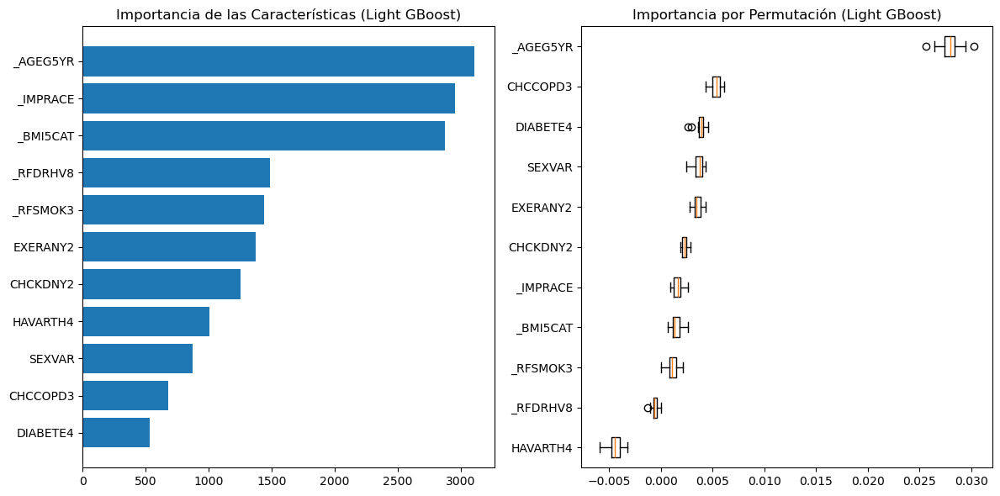

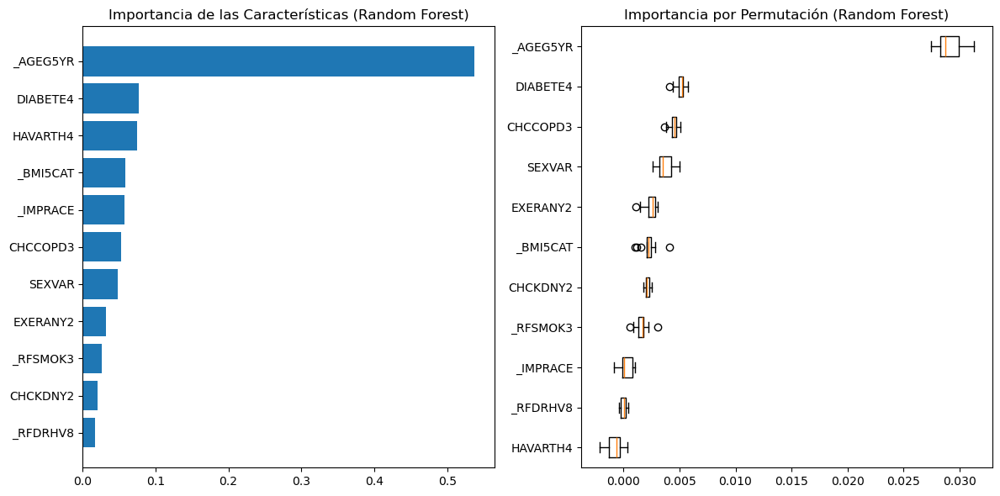

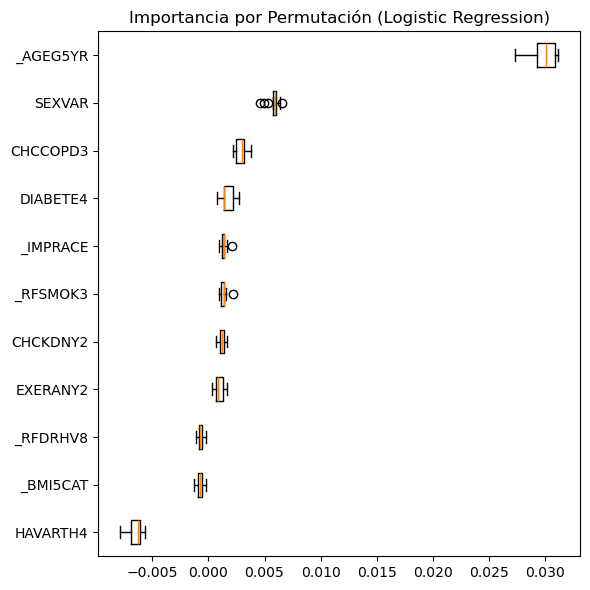

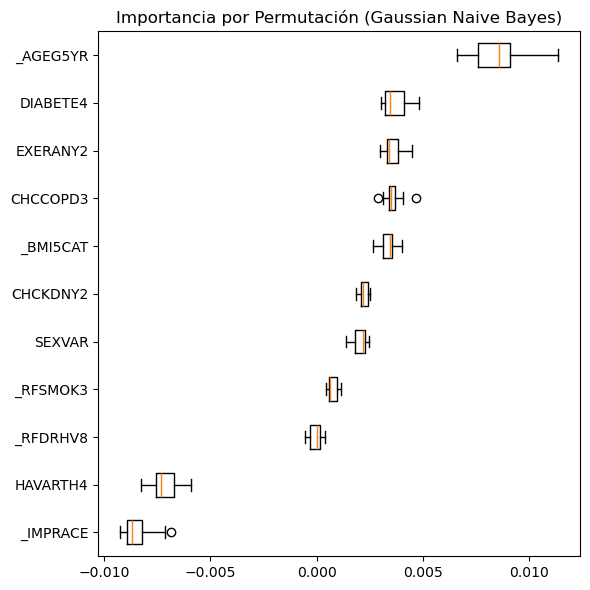

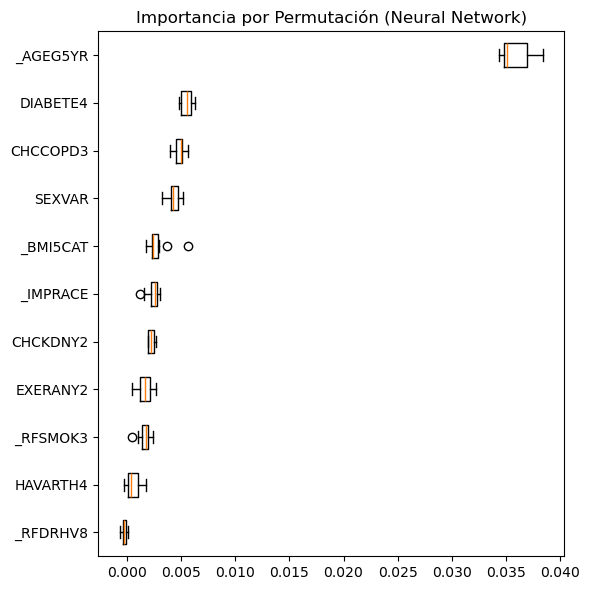

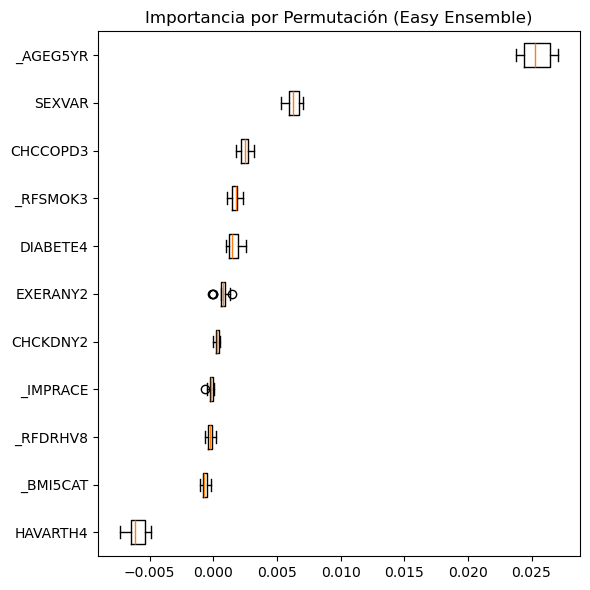

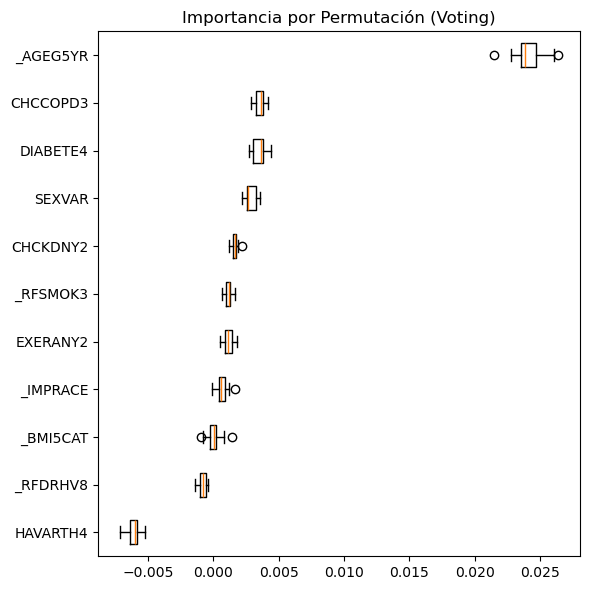

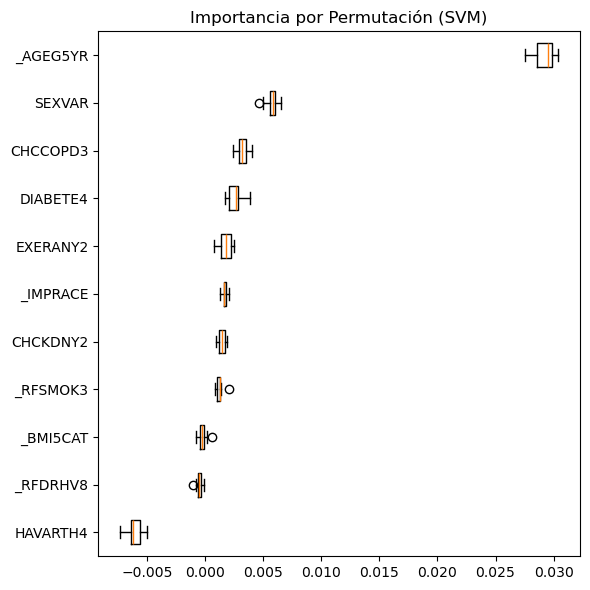

In [256]:
# Graficar importancia y permutación para los modelos con 11 variables
graficar_importancia_permutacion(modelos_optimizados, X_test, y_test, X)
graficar_permutacion_importancia(modelos_optimizados, X_test, y_test, X)

## MODELOS CON TODAS(29) LAS VARIABLES

In [257]:

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/BorderlineSMOTE/modelos_iniciales_all"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los modelos base
modelos_base = [
    ('Logistic Regression', LogisticRegression(class_weight='balanced', max_iter=200, random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),
    ('Light GBoost', LGBMClassifier(class_weight='balanced', verbose=-1)),
    ('Random Forest', RandomForestClassifier(class_weight='balanced', n_estimators=500, min_samples_split=2,
                                             max_depth=5, min_samples_leaf=1, random_state=42)),
    ('Neural Network', MLPClassifier(early_stopping=True, random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble = [   
    ('Voting', VotingClassifier(estimators=modelos_base, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(class_weight='balanced', C=100.0, random_state=42, dual=False))
]

# Combinar todos los modelos
modelos = modelos_base + modelos_ensamble

# Crear el objeto de la técnica de muestreo BorderlineSMOTE
tecnica_muestreo = BorderlineSMOTE(random_state=42)

# Entrenar y evaluar modelos con todas las variables
resultados_allvars, X, X_train, y_train, X_val, y_val, X_test, y_test = entrenar_evaluar_modelos_base(
    df, modelos, carpeta_modelos, tecnica_muestreo)


Dimensiones del conjunto de entrenamiento:
X_train: (439448, 29), y_train: (439448,)

Dimensiones del conjunto de validación:
X_val: (53095, 29), y_val: (53095,)

Dimensiones del conjunto de prueba:
X_test: (53096, 29), y_test: (53096,)

Tiempo de muestreo: 2.00 minutos

Modelo Logistic Regression cargado desde archivo.
Entrenamiento Logistic Regression:
Tiempo de ejecución: 0.10 minutos
Accuracy: 0.7711811181300177
F1-score: 0.779321333105092
Precision: 0.7525494417930438
Recall: 0.8080683038721305
AUC-ROC: 0.8462487979271041
Matthews Corr Coef: 0.5438442345702935

MATRIZ DE CONFUSIÓN:
[[161342  58382]
 [ 42172 177552]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.79      0.73      0.76    219724
           1       0.75      0.81      0.78    219724

    accuracy                           0.77    439448
   macro avg       0.77      0.77      0.77    439448
weighted avg       0.77      0.77      0.77    439448



Test Logistic R

### Tabla de métricas de rendimiento modelos base

In [258]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_allvars_inicial = pd.DataFrame.from_dict(resultados_allvars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_allvars_inicial

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.730865,0.370706,0.252096,0.700100,0.791813,0.296805,0.097405
Gaussian Naive Bayes,0.740583,0.379550,0.260255,0.700765,0.780254,0.307288,0.004726
Light GBoost,0.728548,0.366935,0.249299,0.694777,0.789574,0.291576,0.039369
Random Forest,0.684948,0.366604,0.237327,0.805223,0.810608,0.309325,1.994564
Neural Network,0.722051,0.355095,0.240813,0.675815,0.778254,0.274788,2.631990
Easy Ensemble,0.716306,0.367393,0.245744,0.727545,0.795224,0.296969,4.356097
Voting,0.729622,0.382856,0.258145,0.740685,0.808770,0.317253,5.103244
SVM,0.722220,0.367077,0.247354,0.711411,0.791549,0.294147,0.028557


### BÚSQUEDA DE HIPERPARÁMETROS

In [259]:

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/BorderlineSMOTE/modelos_entrenados_all"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)


In [260]:

# Definir los espacios de búsqueda de hiperparámetros para cada modelo
param_dist_lr = {
    'class_weight': ['balanced', None],
    'solver': ['newton-cg', 'newton-cholesky', 'sag', 'saga'],
    'penalty': ['l2'],
    'C': loguniform(1e-4, 1e1)
}

param_dist_gnb = {
    'var_smoothing': loguniform(1e-9, 1e-1)
}

param_dist_lgbm = {
    'class_weight': ['balanced', None],
    'n_estimators': randint(50, 251),
    'max_depth': randint(3, 31),
    'subsample': uniform(0.7, 0.3),
    'colsample_bytree': uniform(0.7, 0.3),
    'learning_rate': loguniform(1e-5, 1e-1),
    'num_leaves': randint(10, 101),
    'verbose': [-1]
}

param_dist_rf = {
    'class_weight': ['balanced_subsample', 'balanced'],
    'n_estimators': randint(50, 251),
    'criterion': ['gini', 'entropy'],
    'max_depth': randint(3, 16),
    'min_samples_leaf': randint(3, 16),
    'min_samples_split': randint(3, 16),
    'max_features': [None, 'sqrt', 'log2']
}

param_dist_ann = {
    'hidden_layer_sizes': [(100,), (50,50), (100,100), (50, 50, 50),
                           (100, 100, 100), (50, 50, 50, 50), (100, 100, 100, 100),
                           (50, 50, 50, 50, 50), (100, 100, 100, 100, 100)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': loguniform(1e-5, 1e3),
    'batch_size': [64, 128, 256, 512],
    'learning_rate': ['constant', 'adaptive'],
    'learning_rate_init': loguniform(1e-5, 1e-1),
    'early_stopping': [True],
    'max_iter': [100]
}

param_dist_eec = {
    'n_estimators': randint(2, 20),
    'sampling_strategy': ['auto']
}

param_dist_svm = {
    'dual': ['auto'],
    'tol': loguniform(1e-5, 1e-3),
    'class_weight': [None, 'balanced'],
    'penalty': ['l2'],
    'loss': ['hinge', 'squared_hinge'],
    'C': loguniform(1e-4, 1e4),
    'max_iter': randint(1000, 2001)
}

# Definir los modelos con búsqueda de hiperparámetros
modelos = [
    ('Logistic Regression', RandomizedSearchCV(LogisticRegression(), param_dist_lr,
                                               cv=30, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Gaussian Naive Bayes', RandomizedSearchCV(GaussianNB(), param_dist_gnb, cv=30,
                                                n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('Light GBoost', RandomizedSearchCV(LGBMClassifier(), param_dist_lgbm, cv=5, n_jobs=6,
                                        scoring='f1_weighted', n_iter=50)),
    ('Random Forest', RandomizedSearchCV(RandomForestClassifier(), param_dist_rf,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Neural Network', RandomizedSearchCV(MLPClassifier(), param_dist_ann, cv=5, n_jobs=6,
                                          scoring='f1_weighted', error_score=0, n_iter=50)),
    ('Easy Ensemble', RandomizedSearchCV(EasyEnsembleClassifier(), param_dist_eec,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('SVM', RandomizedSearchCV(LinearSVC(), param_dist_svm, cv=5, n_jobs=6,
                               scoring='f1_weighted', n_iter=50))
]

# Crear un diccionario para almacenar los mejores hiperparámetros de cada modelo
best_params_all = {}

# Entrenar y evaluar cada modelo con búsqueda de hiperparámetros
for nombre, modelo in modelos:
    nombre_archivo = f"{carpeta_modelos}/{nombre}_optimizado.pkl"
    
    # Hash del conjunto de datos actual
    hash_actual = hash_de_datos(X_train)
    
    # Cargar o entrenar modelo
    modelo_cargado, tiempo_ejecucion, mejores_parametros_cargados = cargar_modelo(nombre_archivo, hash_actual)
    
    if modelo_cargado is not None:
        print(f"Modelo {nombre} cargado desde archivo.")
        modelo_best_all = modelo_cargado
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros_cargados}")
        # Agregar los mejores hiperparámetros cargados al diccionario
        best_params_all[nombre] = mejores_parametros_cargados
    else:
        print(f"Entrenando nuevo modelo {nombre}.")
        inicio = time.time()  # Tiempo de inicio
        modelo.fit(X_train, y_train)
        
        mejores_parametros = modelo.best_params_
        
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros}")
        
        # Agregar los mejores hiperparámetros al diccionario
        best_params_all[nombre] = modelo.best_params_
        
        # Entrenar el modelo con los mejores hiperparámetros en el conjunto de entrenamiento completo
        modelo_best_all = modelo.best_estimator_
        modelo_best_all.fit(X_train, y_train)
        
        fin = time.time()  # Tiempo de fin
        tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos
        
        # Guardar el modelo entrenado junto con el tiempo de ejecución y los mejores parámetros
        guardar_modelo(modelo_best_all, nombre_archivo, hash_actual, tiempo_ejecucion, mejores_parametros)

    # Métricas predicción entrenamiento
    y_pred_train = modelo_best_all.predict(X_train)

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_all, "predict_proba"):
        y_scores = modelo_best_all.predict_proba(X_train)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_all.decision_function(X_train)  # Puntuaciones de decisión
    
    print(f"Entrenamiento {nombre}:")
    print(f"Tiempo de búsqueda de hiperparámetros de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_train, y_pred_train)}")
    print(f"F1-score: {f1_score(y_train, y_pred_train)}")
    print(f"Precision: {precision_score(y_train, y_pred_train)}")
    print(f"Recall: {recall_score(y_train, y_pred_train)}")
    print(f"AUC-ROC: {roc_auc_score(y_train, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_train, y_pred_train)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_train, y_pred_train))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_train, y_pred_train))
    print("\n")

    # Métricas predicción validación
    inicio = time.time()  # Tiempo de inicio
    y_pred_val = modelo_best_all.predict(X_val)
    fin = time.time()  # Tiempo de fin
    tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_all, "predict_proba"):
        y_scores = modelo_best_all.predict_proba(X_val)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_all.decision_function(X_val)  # Puntuaciones de decisión

    
    print(f"Validación {nombre}:")
    print(f"Tiempo de ejecución de predicción de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_val, y_pred_val)}")
    print(f"F1-score: {f1_score(y_val, y_pred_val)}")
    print(f"Precision: {precision_score(y_val, y_pred_val)}")
    print(f"Recall: {recall_score(y_val, y_pred_val)}")
    print(f"AUC-ROC: {roc_auc_score(y_val, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_val, y_pred_val)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_val, y_pred_val))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_val, y_pred_val))
    print("\n")

Modelo Logistic Regression cargado desde archivo.
Mejores hiperparámetros para Logistic Regression: {'C': 1.8247882039690062, 'class_weight': 'balanced', 'penalty': 'l2', 'solver': 'newton-cg'}
Entrenamiento Logistic Regression:
Tiempo de búsqueda de hiperparámetros de Logistic Regression: 24.16 minutos
Accuracy: 0.7712129762793323
F1-score: 0.7793656157968426
Precision: 0.7525491392681872
Recall: 0.8081638783200743
AUC-ROC: 0.8462507329859085
Matthews Corr Coef: 0.5439132708908997

MATRIZ DE CONFUSIÓN:
[[161335  58389]
 [ 42151 177573]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.79      0.73      0.76    219724
           1       0.75      0.81      0.78    219724

    accuracy                           0.77    439448
   macro avg       0.77      0.77      0.77    439448
weighted avg       0.77      0.77      0.77    439448



Validación Logistic Regression:
Tiempo de ejecución de predicción de Logistic Regression: 0.00 minut

### Entrenar modelos con los mejores parámetros

In [261]:

# Combinar los conjuntos de entrenamiento y validación para todas las variables
X_train_val_allvars = pd.concat([X_train, X_val], ignore_index=True)
y_train_val_allvars = pd.concat([y_train, y_val], ignore_index=True)

# Definir los modelos con los mejores hiperparámetros
modelos_entrenados_all = [
    ('Logistic Regression', LogisticRegression(random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),    
    ('Light GBoost', LGBMClassifier(verbosity=-1, random_state=42)),
    ('Random Forest', RandomForestClassifier(random_state=42)),   
    ('Neural Network', MLPClassifier(random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble_all = [   
    ('Voting', VotingClassifier(estimators=modelos_entrenados_all, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(random_state=42)) 
]

# Combinar todos los modelos
modelos_optimizados_all = modelos_entrenados_all + modelos_ensamble_all

# Crear el objeto de la técnica de muestreo BorderlineSMOTE
tecnica_muestreo = BorderlineSMOTE(random_state=42)

# Entrenar y evaluar modelos con todas las variables
resultados_optimizados_allvars, roc_data, pr_data, modelos_optimizados_all = entrenar_evaluar_modelos(
    X_train_val_allvars, y_train_val_allvars, X_test, y_test, modelos_optimizados_all, best_params_all, carpeta_modelos, 
    tecnica_muestreo
)



Tiempo de muestreo: 31.96 minutos

Modelo Logistic Regression cargado desde archivo.
Test Logistic Regression:
Mejores hiperparámetros para Logistic Regression: {'C': 1.8247882039690062, 'class_weight': 'balanced', 'penalty': 'l2', 'solver': 'newton-cg'}
Tiempo de ejecución de entrenamiento: 0.04 minutos
Tiempo de ejecución de predicción: 0.00 minutos
Accuracy: 0.7077369293355432
F1-score: 0.3542776298268975
Precision: 0.23623751387347391
Recall: 0.7080838323353293
AUC-ROC: 0.7796746862517708
Matthews Corr Coef: 0.27824261210921547

MATRIZ DE CONFUSIÓN:
[[33321 13763]
 [ 1755  4257]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.95      0.71      0.81     47084
           1       0.24      0.71      0.35      6012

    accuracy                           0.71     53096
   macro avg       0.59      0.71      0.58     53096
weighted avg       0.87      0.71      0.76     53096



Modelo Gaussian Naive Bayes cargado desde archivo.
T

### Tabla de métricas de rendimiento con los mejores parámetros

In [262]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_allvars_opt = pd.DataFrame.from_dict(resultados_optimizados_allvars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_allvars_opt

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.707737,0.354278,0.236238,0.708084,0.779675,0.278243,0.035287
Gaussian Naive Bayes,0.717531,0.367920,0.246387,0.726048,0.775659,0.297364,0.005387
Light GBoost,0.714084,0.348762,0.234985,0.676148,0.769213,0.267111,0.078495
Random Forest,0.715798,0.341336,0.231388,0.650366,0.763512,0.254777,3.283555
Neural Network,0.728737,0.322435,0.224795,0.570027,0.742283,0.223446,18.334378
Easy Ensemble,0.688037,0.352918,0.230624,0.751331,0.788735,0.283238,10.565346
Voting,0.722653,0.368254,0.248121,0.713906,0.792984,0.295918,14.786595
SVM,0.699431,0.352234,0.232966,0.721723,0.779196,0.277758,2.255985


### Visualizar comparación de rendimiento de curvas ROC-AUC Y PR-AUC


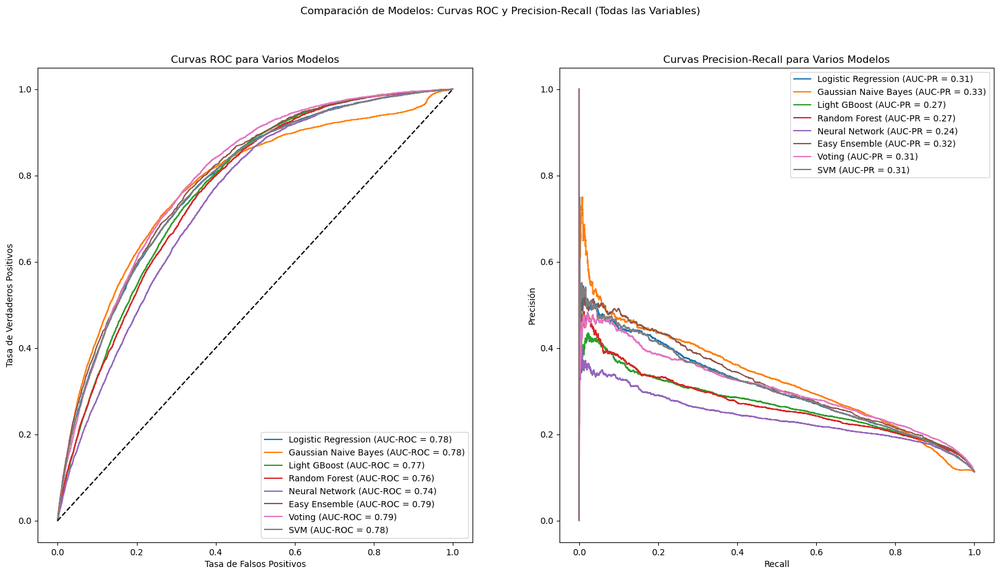

In [263]:
# Graficar curvas de rendimiento para los modelos con todas las variables
graficar_curvas_rendimiento(roc_data, pr_data, 
                            'Comparación de Modelos: Curvas ROC y Precision-Recall (Todas las Variables)')

### EXPLICABILIDAD

#### SHAP values

Valores SHAP para Logistic Regression:


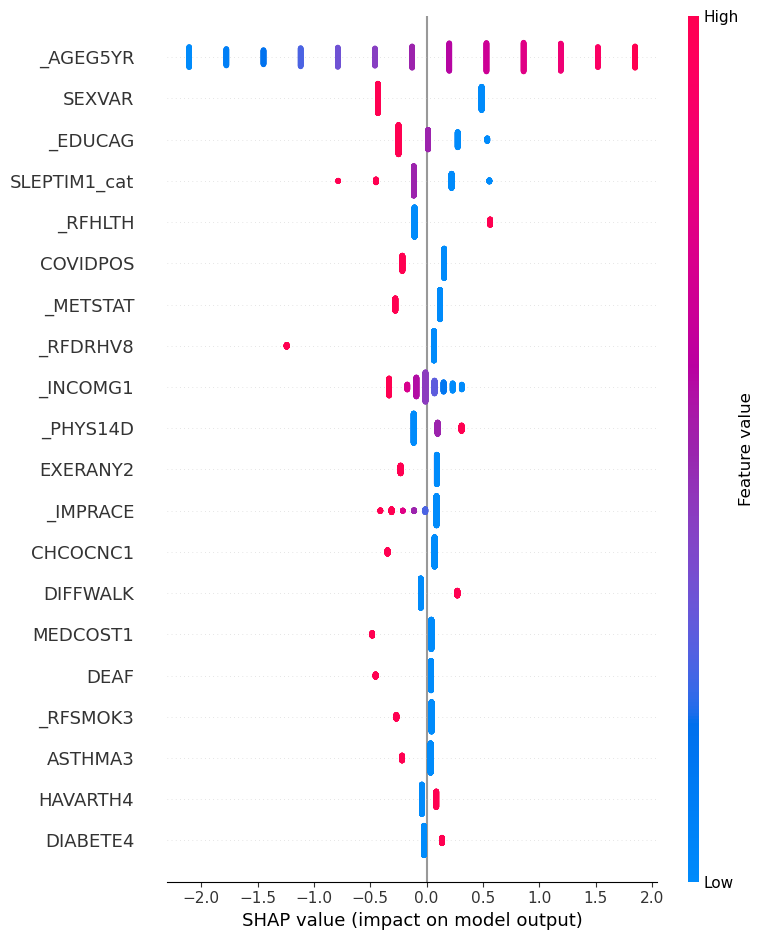

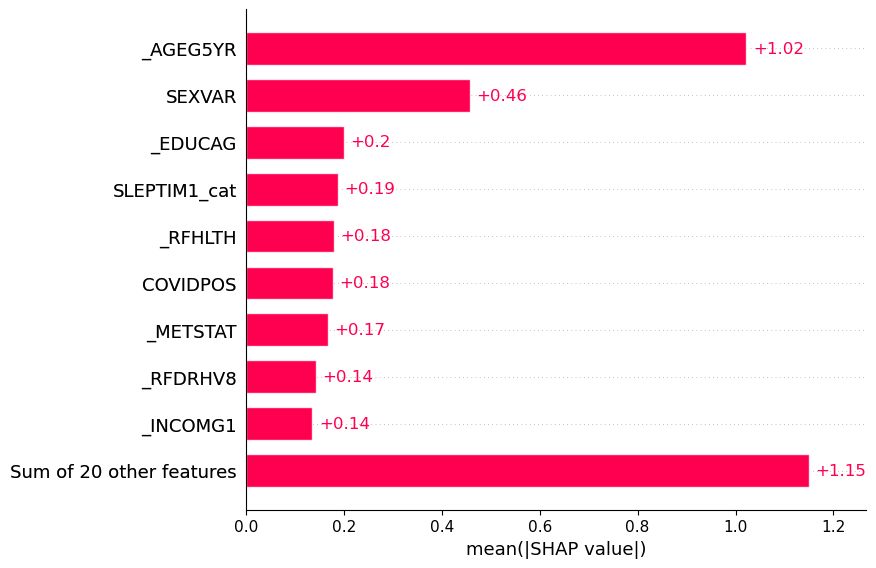

Valores SHAP para Gaussian Naive Bayes:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:36<00:00,  1.57s/it]


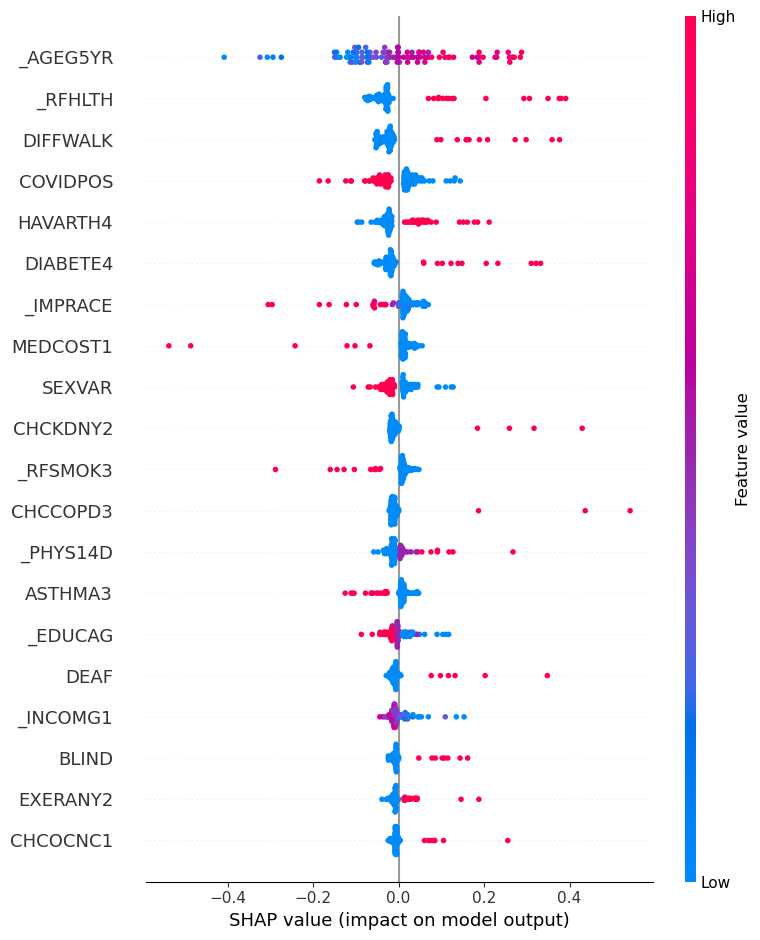

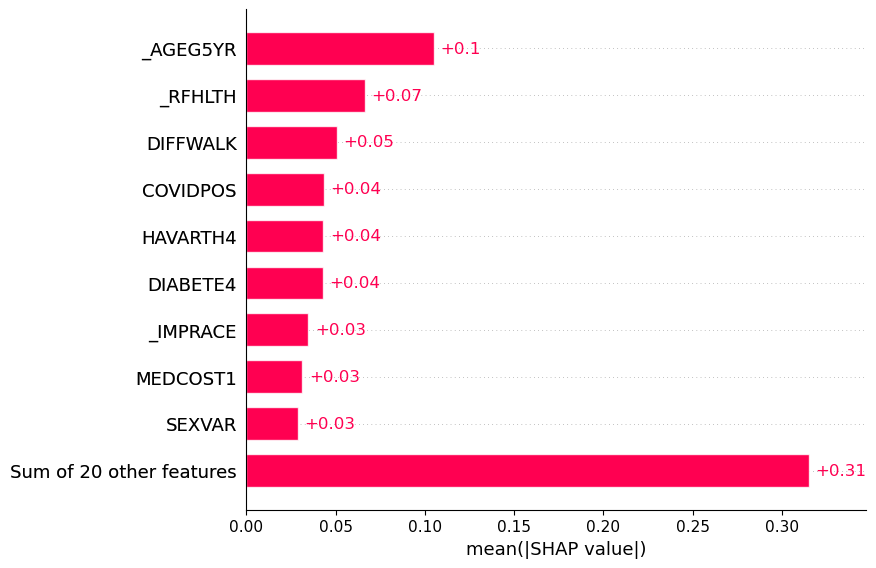

Valores SHAP para Light GBoost:


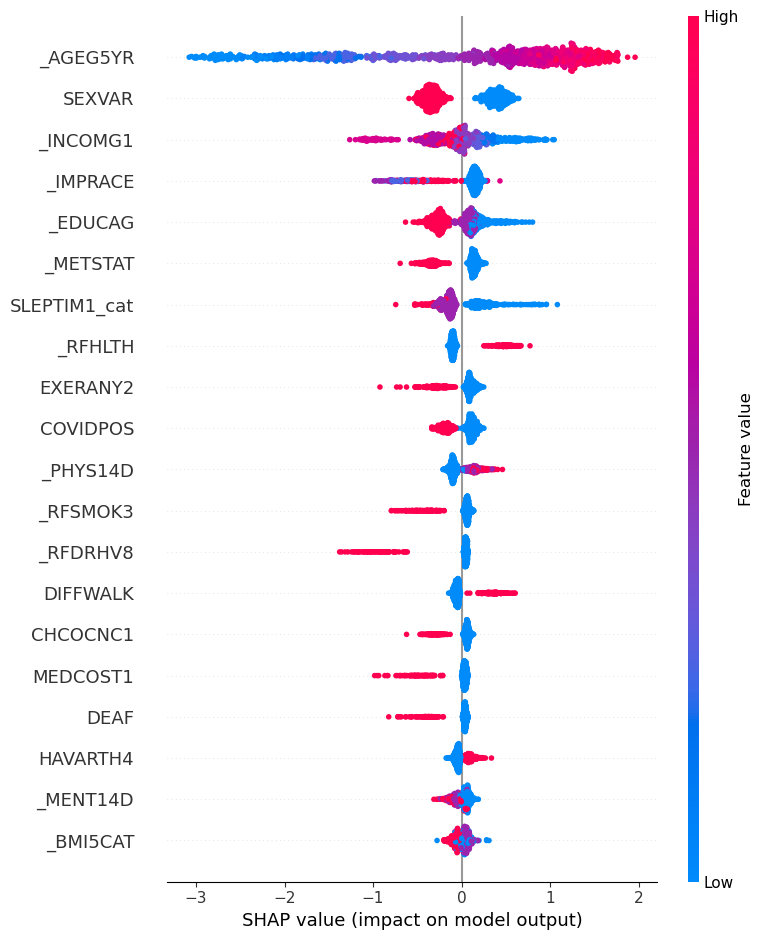

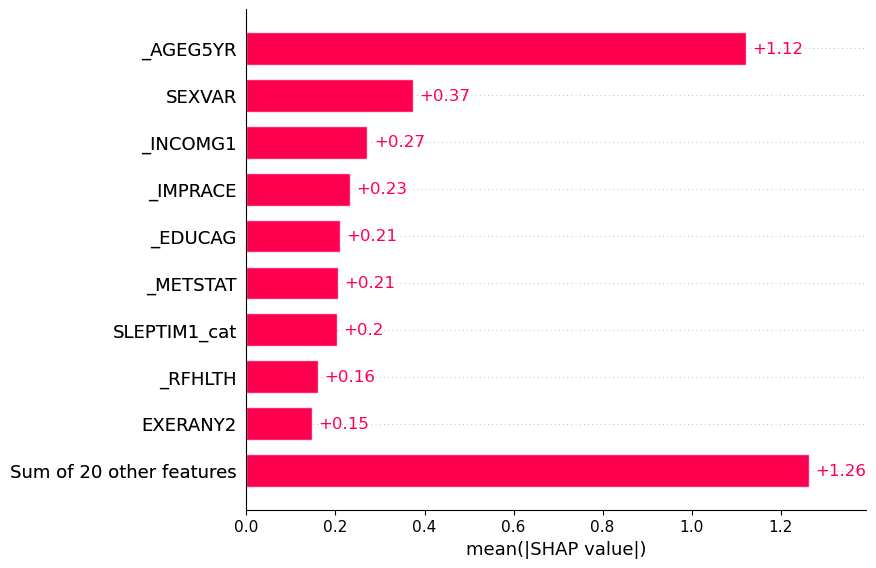

Valores SHAP para Random Forest:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [02:27<00:00,  1.97s/it]


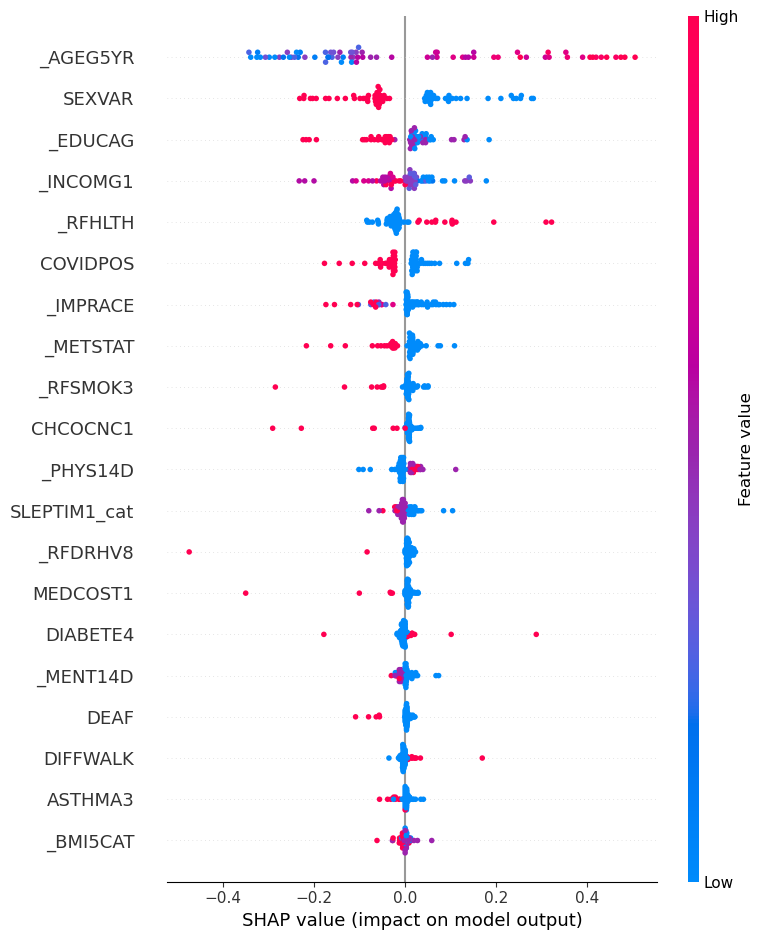

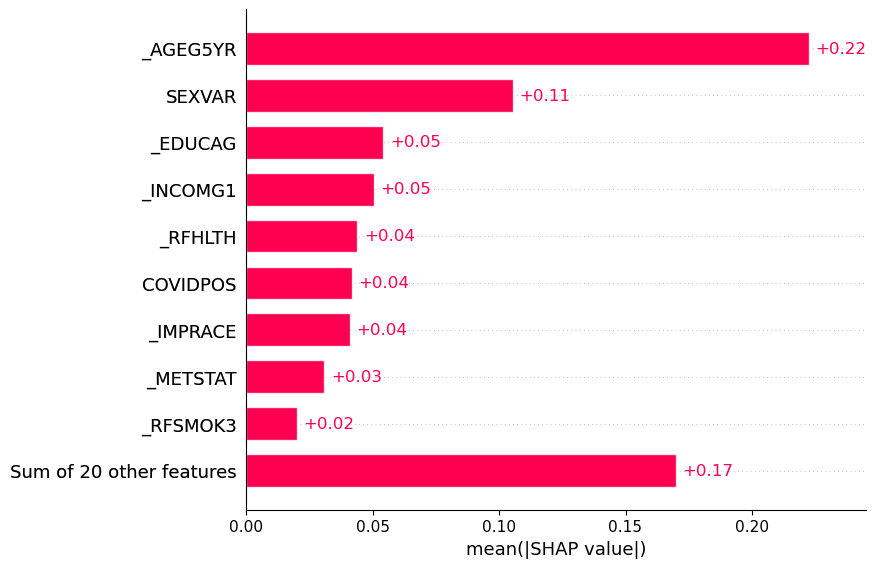

Valores SHAP para Neural Network:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [02:48<00:00,  2.24s/it]


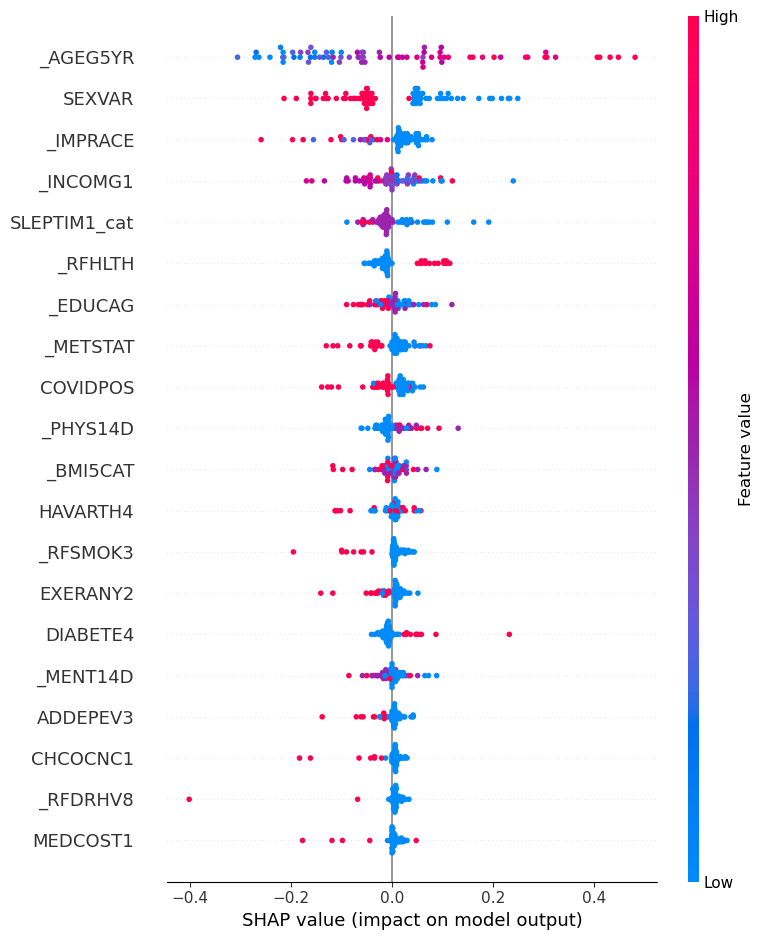

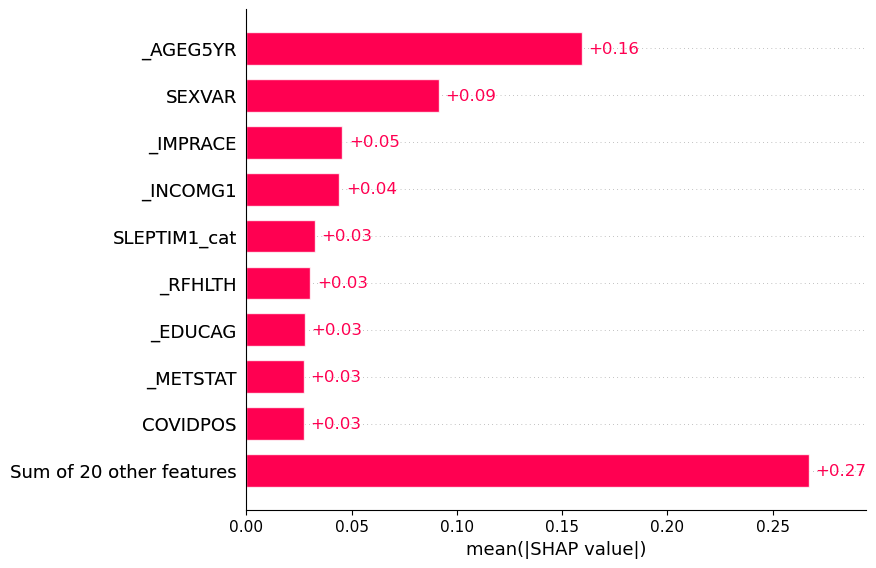

Valores SHAP para Easy Ensemble:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [08:45<00:00, 10.51s/it]


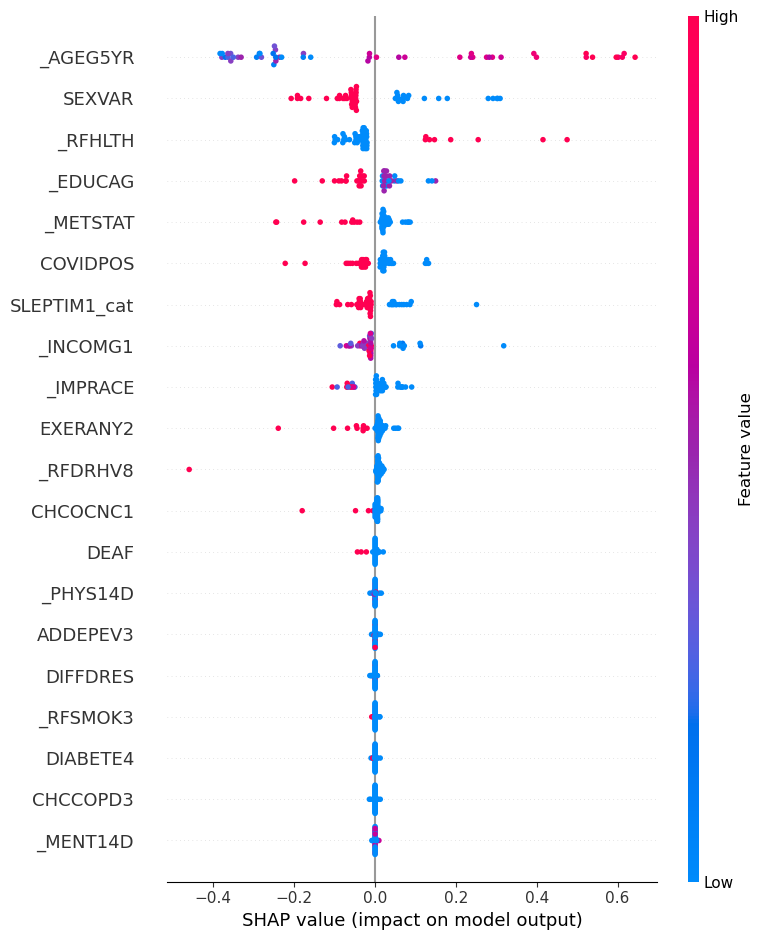

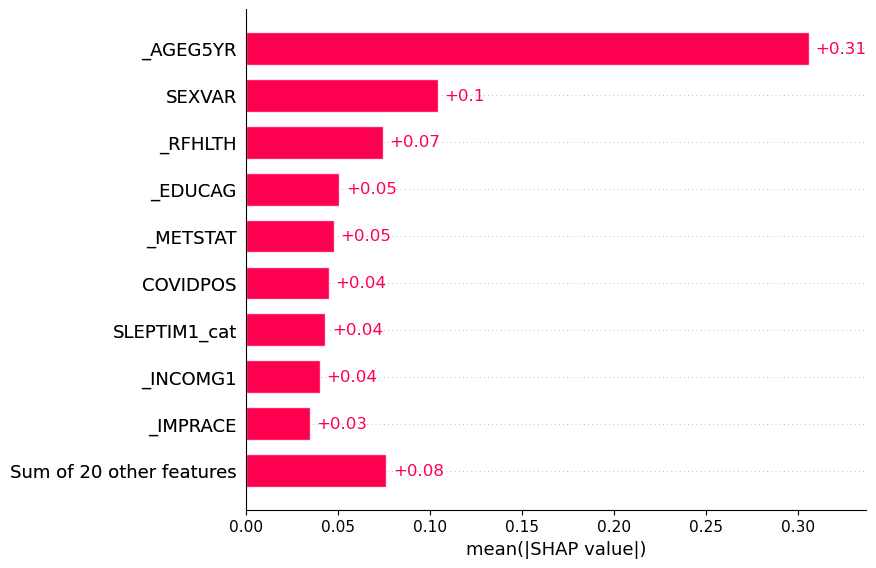

Valores SHAP para Voting:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [10:18<00:00, 12.38s/it]


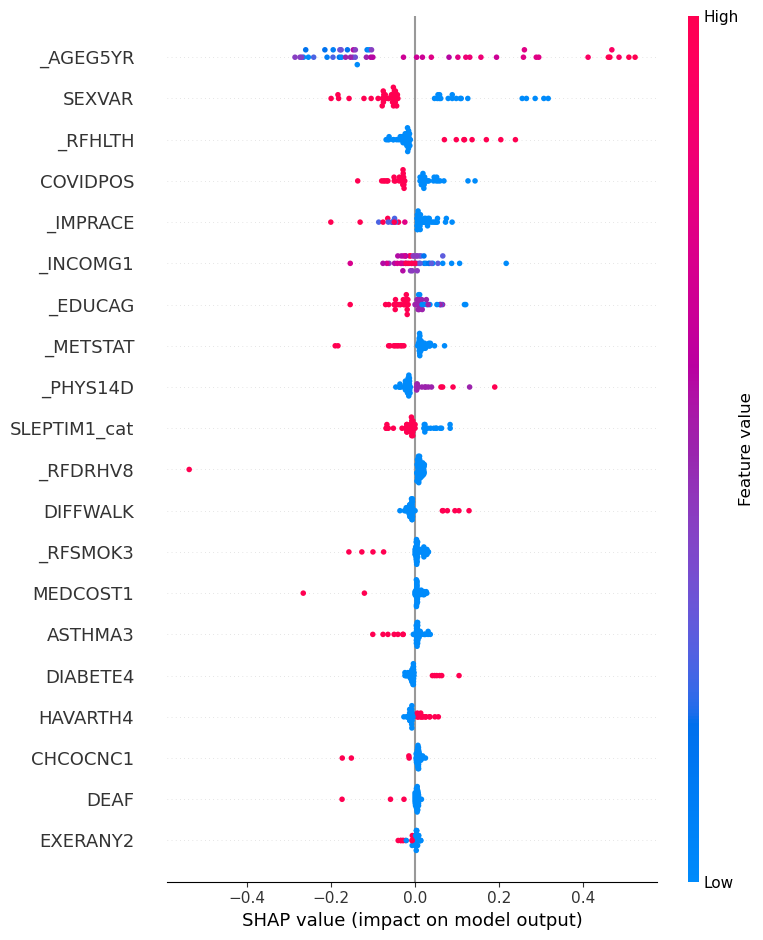

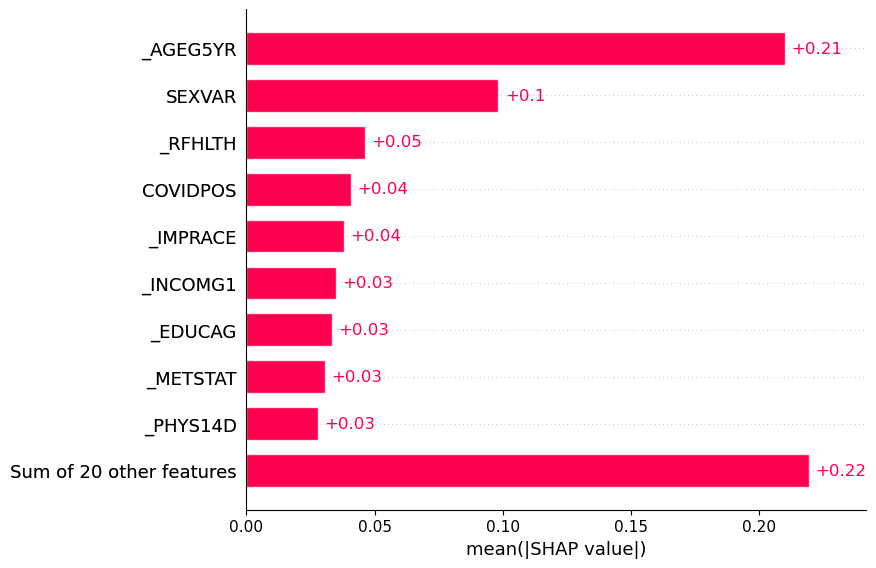

Valores SHAP para SVM:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:27<00:00,  1.47s/it]


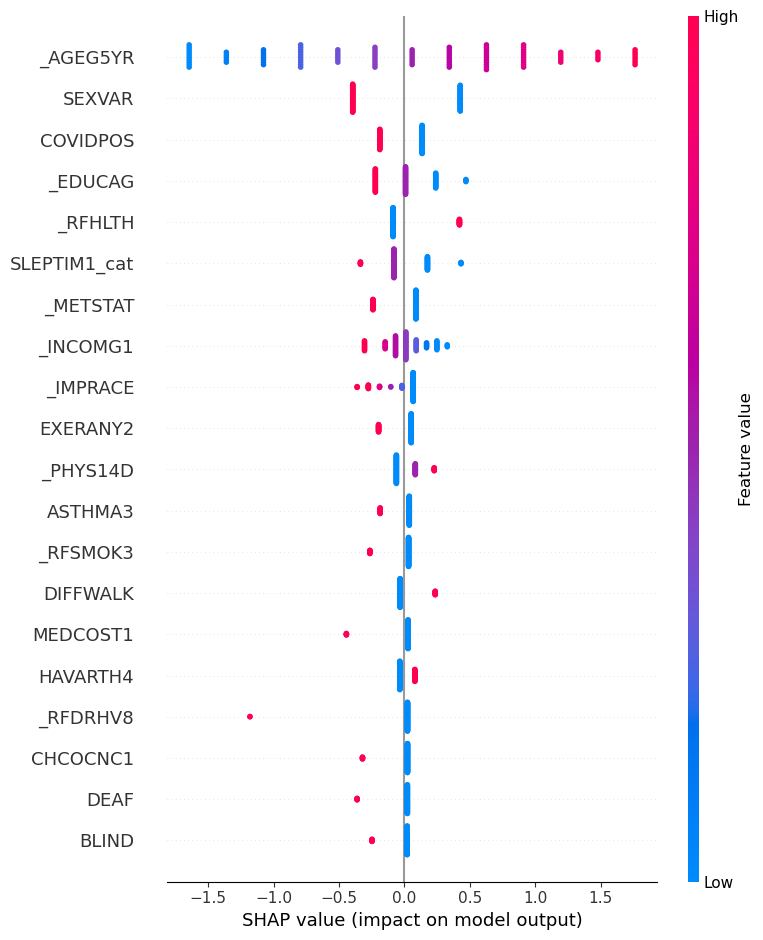

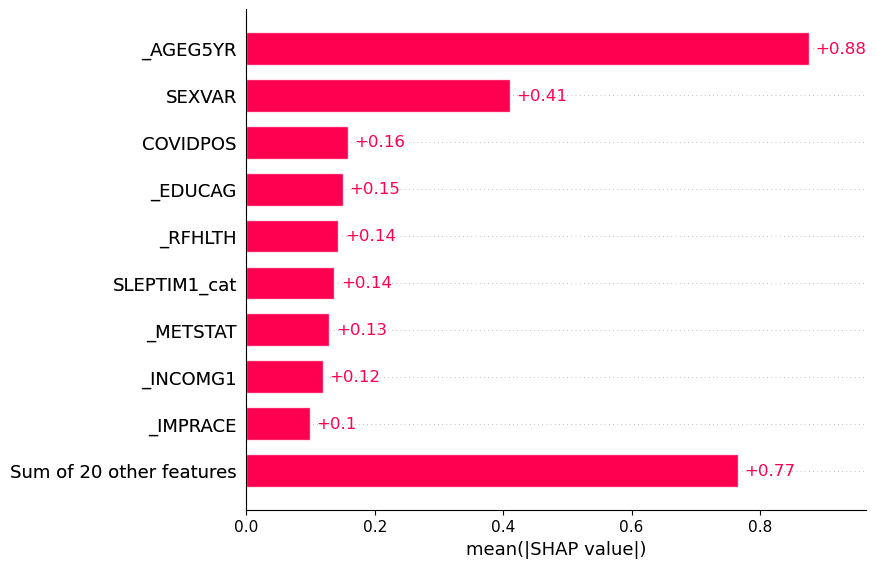

In [264]:
# Iterar sobre los modelos optimizados para graficar la importancia de las variables creadas por SHAP
for nombre, modelo in modelos_optimizados_all:
    print(f"Valores SHAP para {nombre}:")
    
    # Obtener el tamaño de muestra específico para el modelo actual
    sample_size = sample_sizes.get(nombre, 50)  # Valor predeterminado de 50 si no se encuentra el nombre del modelo
    
    # Tomar una muestra aleatoria de los datos de prueba para el cálculo de SHAP
    X_test_sample = shap.utils.sample(X_test, nsamples=sample_size, random_state=42)
    
    explainer_class = explainer_dict.get(type(modelo))
    if explainer_class is None:
        print(f"No se puede calcular los valores SHAP para {nombre}")
        continue
    
    if explainer_class == shap.KernelExplainer:
        if isinstance(modelo, LinearSVC):
            explainer = explainer_class(modelo.decision_function, X_test_sample)
        else:
            explainer = explainer_class(modelo.predict, X_test_sample)
    else:
        explainer = explainer_class(modelo, X_test_sample)
    
    shap_values = explainer(X_test_sample)
    
    # Graficar el Summary Plot de SHAP
    shap.summary_plot(shap_values, X_test_sample)
    plt.show()
    
    # Graficar el Bar Plot de SHAP
    shap.plots.bar(shap_values)
    plt.show()


#### Importancia y permutación de características

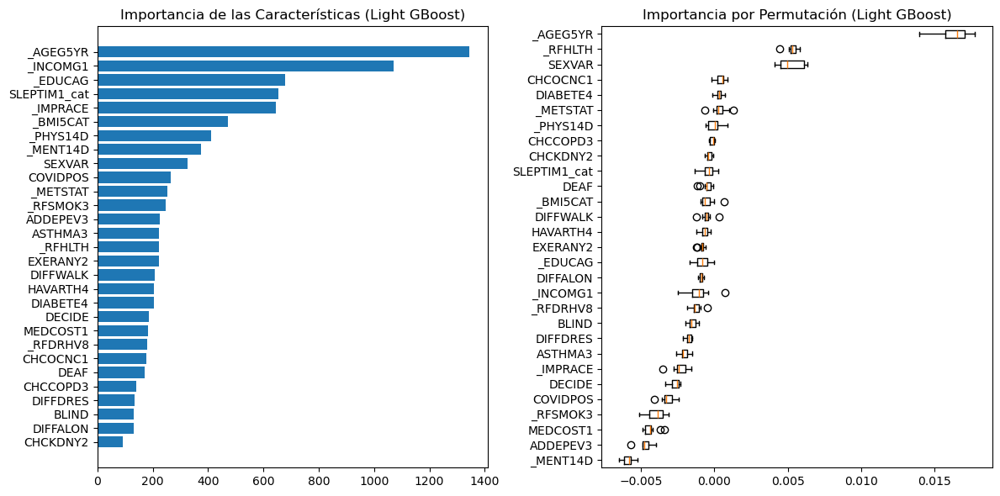

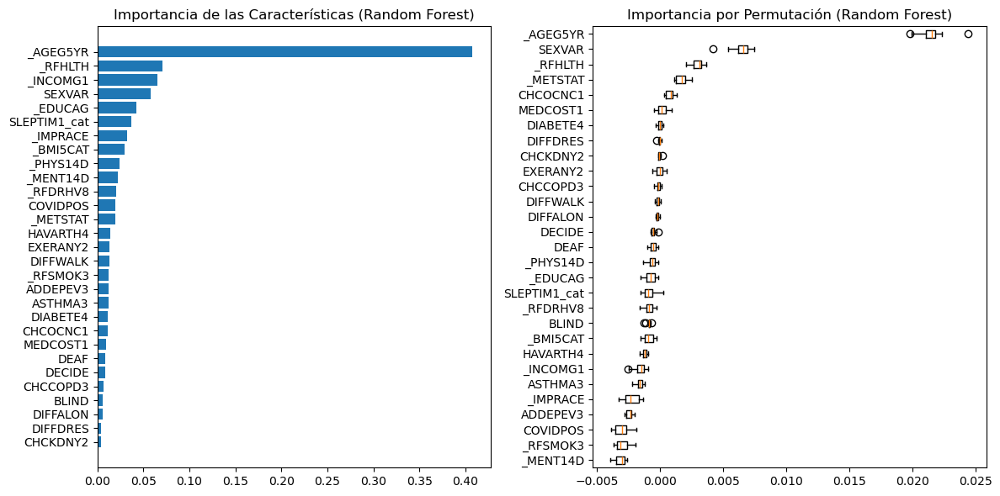

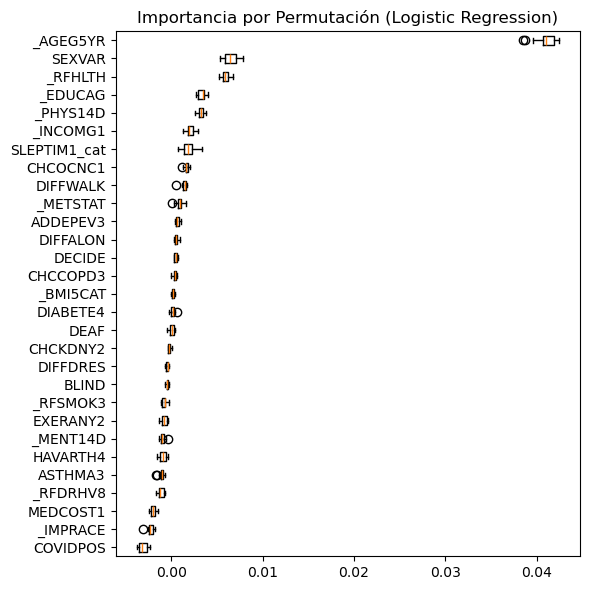

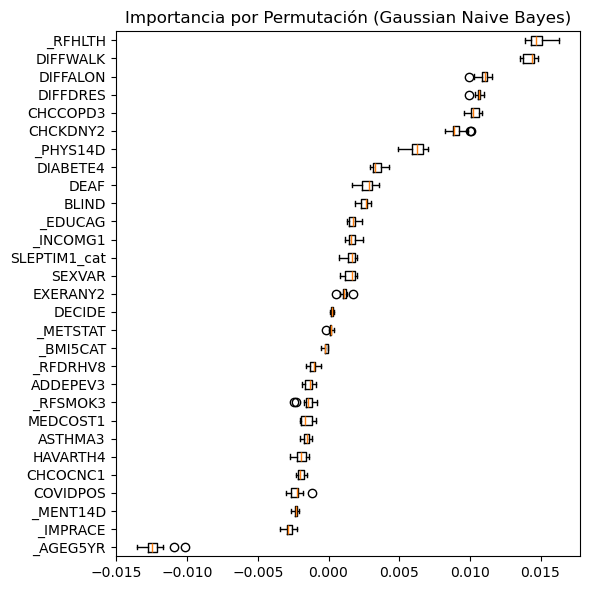

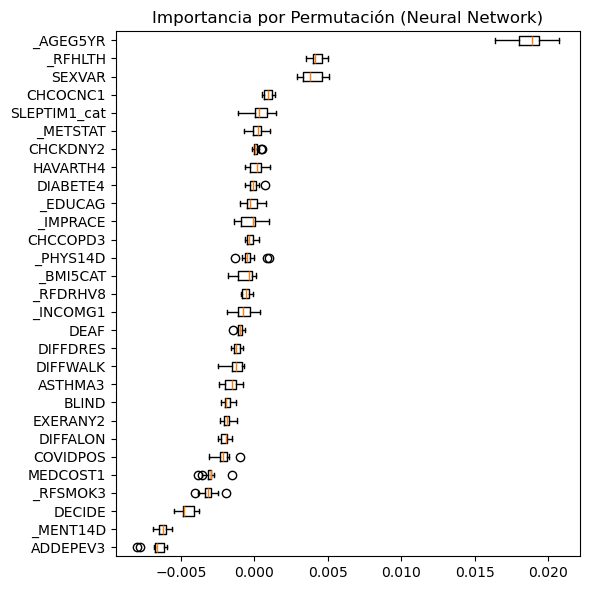

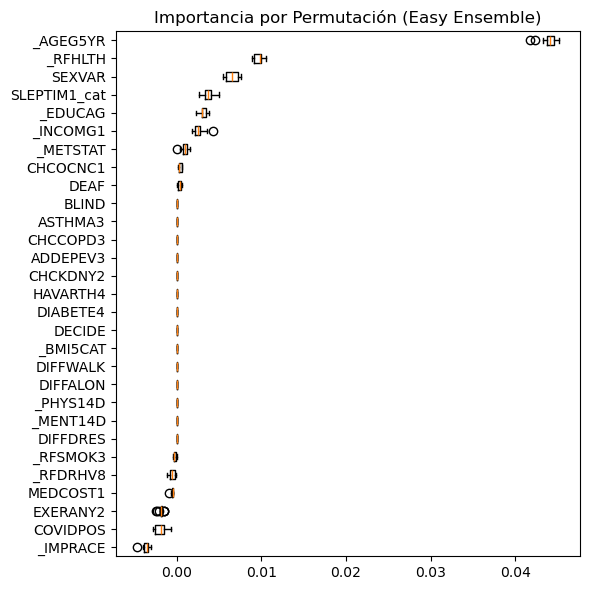

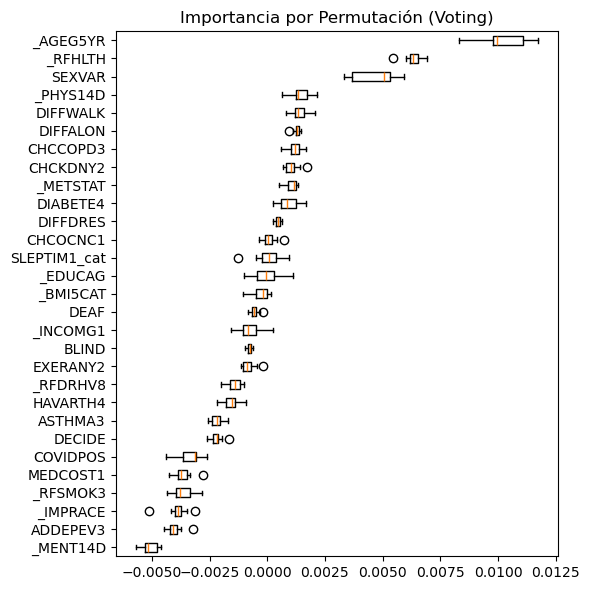

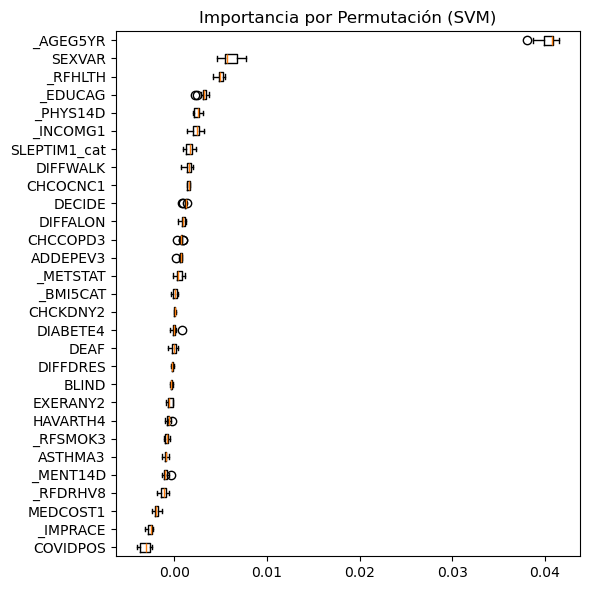

In [265]:
# Graficar importancia y permutación para los modelos con todas las variables
graficar_importancia_permutacion(modelos_optimizados_all, X_test, y_test, X)
graficar_permutacion_importancia(modelos_optimizados_all, X_test, y_test, X)

# ENTRENAMIENTO CON SUB Y SOBREMUESTREO SMOTEENN()

El capítulo 12 utiliza la técnica de muestreo SMOTEENN, que combina la técnica de sobremuestreo SMOTE (Synthetic Minority Over-sampling Technique) con la técnica de submuestreo ENN (Edited Nearest Neighbors). SMOTEENN aborda el desequilibrio de clases en conjuntos de datos mediante la generación de instancias sintéticas de la clase minoritaria y la eliminación de instancias ruidosas o cercanas a la frontera de decisión.

En primer lugar, se aplica la técnica SMOTE para generar instancias sintéticas de la clase minoritaria. SMOTE selecciona aleatoriamente una instancia de la clase minoritaria y crea nuevas instancias sintéticas interpolando entre la instancia seleccionada y sus k vecinos más cercanos de la misma clase. Este proceso se repite hasta que se alcanza el número deseado de instancias sintéticas.

Después de aplicar SMOTE, se utiliza la técnica ENN para eliminar instancias ruidosas o cercanas a la frontera de decisión. ENN examina cada instancia en el conjunto de datos y verifica la clase de sus k vecinos más cercanos. Si la mayoría de los vecinos pertenecen a una clase diferente a la de la instancia examinada, se considera que la instancia es ruidosa o está cerca de la frontera de decisión y se elimina del conjunto de datos. Este proceso se aplica tanto a las instancias originales como a las instancias sintéticas generadas por SMOTE.

Una de las características clave es su enfoque híbrido que combina técnicas de sobremuestreo y submuestreo. Al aplicar SMOTE, se aumenta la representación de la clase minoritaria y se generan nuevas instancias sintéticas para mejorar la capacidad de aprendizaje del modelo. Por otro lado, al aplicar ENN, se eliminan las instancias ruidosas o cercanas a la frontera de decisión, lo que puede mejorar la calidad del conjunto de datos y reducir el impacto negativo de estas instancias en el rendimiento del modelo.

Sin embargo, puede ser computacionalmente costoso, especialmente para conjuntos de datos grandes. La generación de instancias sintéticas y la aplicación de ENN pueden requerir un tiempo de procesamiento significativo, lo que puede limitar su aplicabilidad en escenarios con restricciones de tiempo o recursos computacionales limitados.

## MODELO CON 11 VARIABLES

In [266]:
# Seleccionar las columnas deseadas para crear el nuevo dataset
columnas_seleccionadas = ['SEXVAR', 'EXERANY2', 'CHCCOPD3', 'CHCKDNY2', 
                          'HAVARTH4', 'DIABETE4', '_IMPRACE', '_AGEG5YR',
                          '_BMI5CAT', '_RFSMOK3', '_RFDRHV8', 'CARDIO']

# Dataset base con 11 variables
df_11vars = df.loc[:, columnas_seleccionadas]

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/SMOTEENN/modelos_iniciales_11vars"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los modelos base
modelos_base = [
    ('Logistic Regression', LogisticRegression(class_weight='balanced', random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),
    ('Gradient Boosting', GradientBoostingClassifier(learning_rate=0.1, n_estimators=500, max_depth=3, random_state=42,
                                                     min_samples_split=5, min_samples_leaf=3, max_features='sqrt')),
    ('Xtra GBoost', XGBClassifier(learning_rate=0.1, n_estimators=500, max_depth=3, random_state=42, scale_pos_weight=1,
                                  subsample=0.8, colsample_bytree=0.8)),
    ('Light GBoost', LGBMClassifier(class_weight='balanced', verbose=-1)),
    ('Decision Tree',
     DecisionTreeClassifier(class_weight='balanced', criterion='gini', max_depth=5, min_samples_split=20,
                            min_samples_leaf=10, random_state=42)),
    ('Random Forest', RandomForestClassifier(class_weight='balanced', n_estimators=500, min_samples_split=2,
                                             max_depth=5, min_samples_leaf=1, random_state=42)),
    ('Neural Network', MLPClassifier(early_stopping=True, random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble = [
    ('Voting', VotingClassifier(estimators=modelos_base, voting='soft', n_jobs=-1)),
    ('Stacking',
     StackingClassifier(estimators=modelos_base, final_estimator=LogisticRegression(random_state=42), n_jobs=-1)),
    ('SVM', LinearSVC(class_weight='balanced', C=100.0, random_state=42, dual=False))
]

# Combinar todos los modelos
modelos = modelos_base + modelos_ensamble

# Crear el objeto de la técnica de muestreo SMOTEENN
tecnica_muestreo = SMOTEENN(random_state=42)

# Entrenar y evaluar modelos con 11 variables
resultados_11vars, X, X_train, y_train, X_val, y_val, X_test, y_test = entrenar_evaluar_modelos_base(
    df_11vars, modelos, carpeta_modelos, tecnica_muestreo)


Dimensiones del conjunto de entrenamiento:
X_train: (188060, 11), y_train: (188060,)

Dimensiones del conjunto de validación:
X_val: (53095, 11), y_val: (53095,)

Dimensiones del conjunto de prueba:
X_test: (53096, 11), y_test: (53096,)

Tiempo de muestreo: 2.53 minutos

Modelo Logistic Regression cargado desde archivo.
Entrenamiento Logistic Regression:
Tiempo de ejecución: 0.02 minutos
Accuracy: 0.9122779963841328
F1-score: 0.6520868043106902
Precision: 0.5078343133068357
Recall: 0.9108047602215152
AUC-ROC: 0.9665267340654381
Matthews Corr Coef: 0.6404344749722216

MATRIZ DE CONFUSIÓN:
[[156103  14983]
 [  1514  15460]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.99      0.91      0.95    171086
           1       0.51      0.91      0.65     16974

    accuracy                           0.91    188060
   macro avg       0.75      0.91      0.80    188060
weighted avg       0.95      0.91      0.92    188060



Test Logistic 

### Tabla de métricas de rendimiento modelos base

In [267]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_11vars_inicial = pd.DataFrame.from_dict(resultados_11vars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_11vars_inicial

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.804091,0.373147,0.292572,0.514970,0.789373,0.282370,0.018702
Gaussian Naive Bayes,0.825241,0.346595,0.300525,0.409348,0.774518,0.252408,0.000931
Gradient Boosting,0.870480,0.276942,0.376393,0.219062,0.771677,0.220591,0.405037
Xtra GBoost,0.870781,0.270960,0.375110,0.212076,0.773662,0.216138,0.053066
Light GBoost,0.846316,0.310461,0.315527,0.305556,0.732311,0.224044,0.011824
Decision Tree,0.779739,0.362358,0.269527,0.552728,0.731870,0.271256,0.002829
Random Forest,0.801944,0.361351,0.284580,0.494844,0.785370,0.267747,0.366666
Neural Network,0.868747,0.255369,0.357036,0.198769,0.705652,0.199571,1.246340
Easy Ensemble,0.814129,0.379503,0.305064,0.501996,0.790630,0.289702,0.096085
Voting,0.851816,0.335248,0.340659,0.330007,0.782645,0.251926,1.390331


### BÚSQUEDA DE HIPERPARÁMETROS

In [268]:

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/SMOTEENN/modelos_entrenados_11vars"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los espacios de búsqueda de hiperparámetros para cada modelo
param_dist_lr = {
    'class_weight': ['balanced', None],
    'solver': ['newton-cg', 'newton-cholesky', 'sag', 'saga'],
    'penalty': ['l2'],
    'C': loguniform(1e-4, 1e1)
}

param_dist_gnb = {
    'var_smoothing': loguniform(1e-9, 1e-1)
}

param_dist_lgbm = {
    'class_weight': ['balanced', None],
    'n_estimators': randint(50, 251),
    'max_depth': randint(3, 31),
    'subsample': uniform(0.7, 0.3),
    'colsample_bytree': uniform(0.7, 0.3),
    'learning_rate': loguniform(1e-5, 1e-1),
    'num_leaves': randint(10, 101),
    'verbose': [-1]
}

param_dist_rf = {
    'class_weight': ['balanced_subsample', 'balanced'],
    'n_estimators': randint(50, 251),
    'criterion': ['gini', 'entropy'],
    'max_depth': randint(3, 16),
    'min_samples_leaf': randint(3, 16),
    'min_samples_split': randint(3, 16),
    'max_features': [None, 'sqrt', 'log2']
}

param_dist_ann = {
    'hidden_layer_sizes': [(100,), (50,50), (100,100), (50, 50, 50),
                           (100, 100, 100), (50, 50, 50, 50), (100, 100, 100, 100),
                           (50, 50, 50, 50, 50), (100, 100, 100, 100, 100)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': loguniform(1e-5, 1e3),
    'batch_size': [64, 128, 256, 512],
    'learning_rate': ['constant', 'adaptive'],
    'learning_rate_init': loguniform(1e-5, 1e-1),
    'early_stopping': [True],
    'max_iter': [100]
}

param_dist_eec = {
    'n_estimators': randint(2, 20),
    'sampling_strategy': ['auto']
}

param_dist_svm = {
    'dual': ['auto'],
    'tol': loguniform(1e-5, 1e-3),
    'class_weight': [None, 'balanced'],
    'penalty': ['l2'],
    'loss': ['hinge', 'squared_hinge'],
    'C': loguniform(1e-4, 1e4),
    'max_iter': randint(1000, 2001)
}

# Definir los modelos con búsqueda de hiperparámetros
modelos = [
    ('Logistic Regression', RandomizedSearchCV(LogisticRegression(), param_dist_lr,
                                               cv=30, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Gaussian Naive Bayes', RandomizedSearchCV(GaussianNB(), param_dist_gnb, cv=30,
                                                n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('Light GBoost', RandomizedSearchCV(LGBMClassifier(), param_dist_lgbm, cv=5, n_jobs=6,
                                        scoring='f1_weighted', n_iter=50)),
    ('Random Forest', RandomizedSearchCV(RandomForestClassifier(), param_dist_rf,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Neural Network', RandomizedSearchCV(MLPClassifier(), param_dist_ann, cv=5, n_jobs=6,
                                          scoring='f1_weighted', error_score=0, n_iter=50)),
    ('Easy Ensemble', RandomizedSearchCV(EasyEnsembleClassifier(), param_dist_eec,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('SVM', RandomizedSearchCV(LinearSVC(), param_dist_svm, cv=5, n_jobs=6,
                               scoring='f1_weighted', n_iter=50))
]

# Crear un diccionario para almacenar los mejores hiperparámetros de cada modelo
best_params_11vars = {}

# Entrenar y evaluar cada modelo con búsqueda de hiperparámetros
for nombre, modelo in modelos:
    nombre_archivo = f"{carpeta_modelos}/{nombre}_optimizado.pkl"
    
    # Hash del conjunto de datos actual
    hash_actual = hash_de_datos(X_train)
    
    # Cargar o entrenar modelo
    modelo_cargado, tiempo_ejecucion, mejores_parametros_cargados = cargar_modelo(nombre_archivo, hash_actual)
    
    if modelo_cargado is not None:
        print(f"Modelo {nombre} cargado desde archivo.")
        modelo_best_11vars = modelo_cargado
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros_cargados}")
        
        # Agregar los mejores hiperparámetros cargados al diccionario
        best_params_11vars[nombre] = mejores_parametros_cargados
    else:
        print(f"Entrenando nuevo modelo {nombre}.")
        inicio = time.time()  # Tiempo de inicio
        modelo.fit(X_train, y_train)

        mejores_parametros = modelo.best_params_
        
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros}")
        
        # Agregar los mejores hiperparámetros al diccionario
        best_params_11vars[nombre] = mejores_parametros
        
        # Entrenar el modelo con los mejores hiperparámetros en el conjunto de entrenamiento completo
        modelo_best_11vars = modelo.best_estimator_
        modelo_best_11vars.fit(X_train, y_train)
        
        fin = time.time()  # Tiempo de fin
        tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos
        
        # Guardar el modelo entrenado junto con el tiempo de ejecución y los mejores parámetros
        guardar_modelo(modelo_best_11vars, nombre_archivo, hash_actual, tiempo_ejecucion, mejores_parametros)

    # Imprimir métricas de la predicción en el conjunto de entrenamiento
    y_pred_train = modelo_best_11vars.predict(X_train)

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_11vars, "predict_proba"):
        y_scores = modelo_best_11vars.predict_proba(X_train)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_11vars.decision_function(X_train)  # Puntuaciones de decisión
    
    print(f"Entrenamiento {nombre}:")
    print(f"Tiempo de búsqueda de hiperparámetros de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_train, y_pred_train)}")
    print(f"F1-score: {f1_score(y_train, y_pred_train)}")
    print(f"Precision: {precision_score(y_train, y_pred_train)}")
    print(f"Recall: {recall_score(y_train, y_pred_train)}")
    print(f"AUC-ROC: {roc_auc_score(y_train, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_train, y_pred_train)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_train, y_pred_train))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_train, y_pred_train))
    print("\n")

    # Predecir en el conjunto de validación
    inicio = time.time()  # Tiempo de inicio
    y_pred_val = modelo_best_11vars.predict(X_val)
    fin = time.time()  # Tiempo de fin
    tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_11vars, "predict_proba"):
        y_scores = modelo_best_11vars.predict_proba(X_val)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_11vars.decision_function(X_val)  # Puntuaciones de decisión
    

    # Imprimir métricas de la predicción en el conjunto de validación
    print(f"Validación {nombre}:")
    print(f"Tiempo de ejecución de predicción de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_val, y_pred_val)}")
    print(f"F1-score: {f1_score(y_val, y_pred_val)}")
    print(f"Precision: {precision_score(y_val, y_pred_val)}")
    print(f"Recall: {recall_score(y_val, y_pred_val)}")
    print(f"AUC-ROC: {roc_auc_score(y_val, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_val, y_pred_val)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_val, y_pred_val))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_val, y_pred_val))
    print("\n")
    
 

Modelo Logistic Regression cargado desde archivo.
Mejores hiperparámetros para Logistic Regression: {'C': 0.07896059046604188, 'class_weight': None, 'penalty': 'l2', 'solver': 'newton-cg'}
Entrenamiento Logistic Regression:
Tiempo de búsqueda de hiperparámetros de Logistic Regression: 8.15 minutos
Accuracy: 0.9497553972136552
F1-score: 0.693184401078027
Precision: 0.7721912754105477
Recall: 0.6288441145281018
AUC-ROC: 0.9650390603313959
Matthews Corr Coef: 0.6703006926036634

MATRIZ DE CONFUSIÓN:
[[167937   3149]
 [  6300  10674]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.96      0.98      0.97    171086
           1       0.77      0.63      0.69     16974

    accuracy                           0.95    188060
   macro avg       0.87      0.81      0.83    188060
weighted avg       0.95      0.95      0.95    188060



Validación Logistic Regression:
Tiempo de ejecución de predicción de Logistic Regression: 0.00 minutos
Accu

### Entrenar modelos con los mejores parámetros

In [269]:
# Combinar los conjuntos de entrenamiento y validación para 11 variables
X_train_val_11vars = pd.concat([X_train, X_val], ignore_index=True)
y_train_val_11vars = pd.concat([y_train, y_val], ignore_index=True)

# Definir los modelos base
modelos_entrenados = [
    ('Logistic Regression', LogisticRegression(random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),    
    ('Light GBoost', LGBMClassifier(verbosity=-1, random_state=42)),
    ('Random Forest', RandomForestClassifier(random_state=42)),   
    ('Neural Network', MLPClassifier(random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble = [   
    ('Voting', VotingClassifier(estimators=modelos_entrenados, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(random_state=42)) 
]

# Combinar todos los modelos
modelos_optimizados = modelos_entrenados + modelos_ensamble

# Crear el objeto de la técnica de muestreo SMOTEENN
tecnica_muestreo = SMOTEENN(random_state=42)

# Entrenar y evaluar modelos con 11 variables
resultados_optimizados_11vars, roc_data_11vars, pr_data_11vars, modelos_optimizados = entrenar_evaluar_modelos(
    X_train_val_11vars, y_train_val_11vars, X_test, y_test, modelos_optimizados, best_params_11vars, carpeta_modelos,
    tecnica_muestreo
)



Tiempo de muestreo: 1.97 minutos

Modelo Logistic Regression cargado desde archivo.
Test Logistic Regression:
Mejores hiperparámetros para Logistic Regression: {'C': 0.07896059046604188, 'class_weight': None, 'penalty': 'l2', 'solver': 'newton-cg'}
Tiempo de ejecución de entrenamiento: 0.02 minutos
Tiempo de ejecución de predicción: 0.00 minutos
Accuracy: 0.8154851589573603
F1-score: 0.36617713657242673
Precision: 0.2996294335627316
Recall: 0.4707252162341983
AUC-ROC: 0.7892489593915558
Matthews Corr Coef: 0.2736319152424694

MATRIZ DE CONFUSIÓN:
[[40469  6615]
 [ 3182  2830]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.93      0.86      0.89     47084
           1       0.30      0.47      0.37      6012

    accuracy                           0.82     53096
   macro avg       0.61      0.67      0.63     53096
weighted avg       0.86      0.82      0.83     53096



Modelo Gaussian Naive Bayes cargado desde archivo.
Test Gau

### Tabla de métricas de rendimiento con los mejores parámetros

In [270]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_11vars_opt = pd.DataFrame.from_dict(resultados_optimizados_11vars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_11vars_opt

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.815485,0.366177,0.299629,0.470725,0.789249,0.273632,0.017635
Gaussian Naive Bayes,0.816107,0.369576,0.302026,0.476048,0.791132,0.277703,0.001948
Light GBoost,0.854132,0.290296,0.323199,0.263473,0.737872,0.211308,0.040551
Random Forest,0.866186,0.244229,0.338743,0.190951,0.612683,0.185830,2.047005
Neural Network,0.866694,0.245255,0.341652,0.191284,0.653063,0.187544,9.180264
Easy Ensemble,0.816107,0.379827,0.307234,0.497339,0.788094,0.290045,1.145153
Voting,0.858803,0.301370,0.342657,0.268962,0.787463,0.226135,8.005138
SVM,0.813865,0.364642,0.297181,0.471723,0.786909,0.271740,0.501896


### Visualizar comparación de rendimiento de curvas ROC-AUC Y PR-AUC

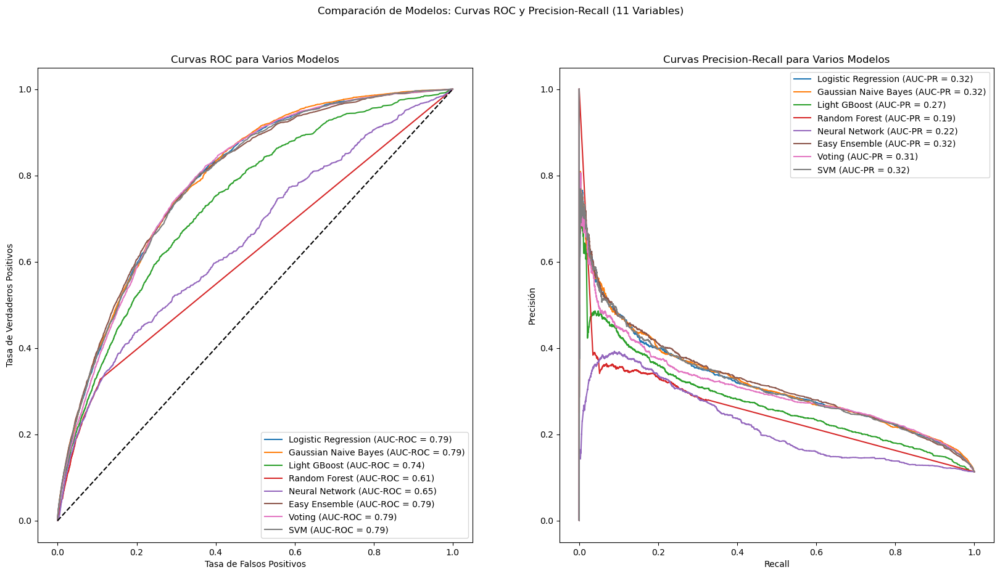

In [271]:
# Graficar curvas de rendimiento para los modelos con 11 variables
graficar_curvas_rendimiento(roc_data_11vars, pr_data_11vars, 
                            'Comparación de Modelos: Curvas ROC y Precision-Recall (11 Variables)')

### EXPLICABILIDAD

#### SHAP values

Valores SHAP para Logistic Regression:


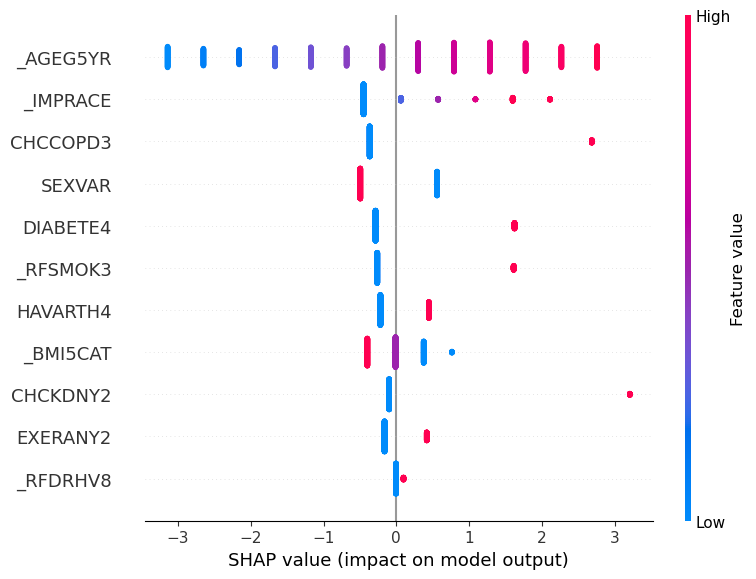

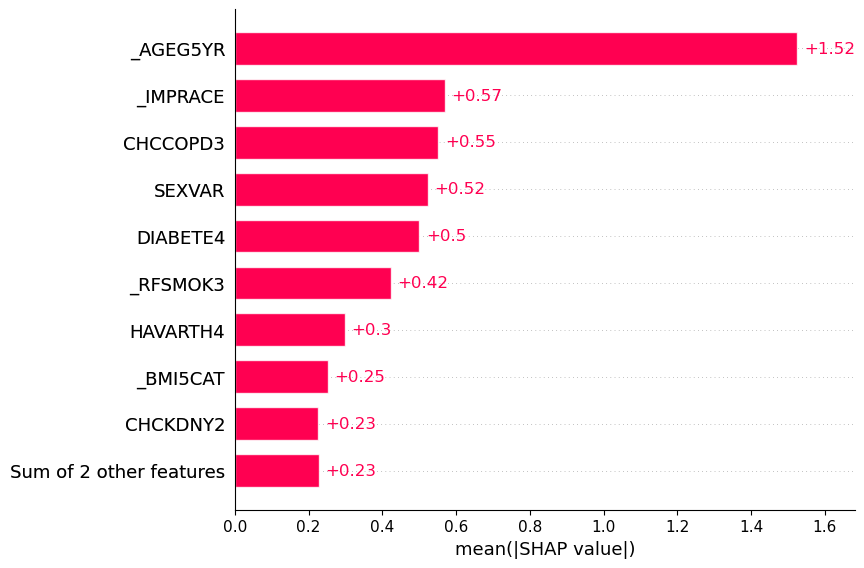

Valores SHAP para Gaussian Naive Bayes:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:10<00:00,  1.30s/it]


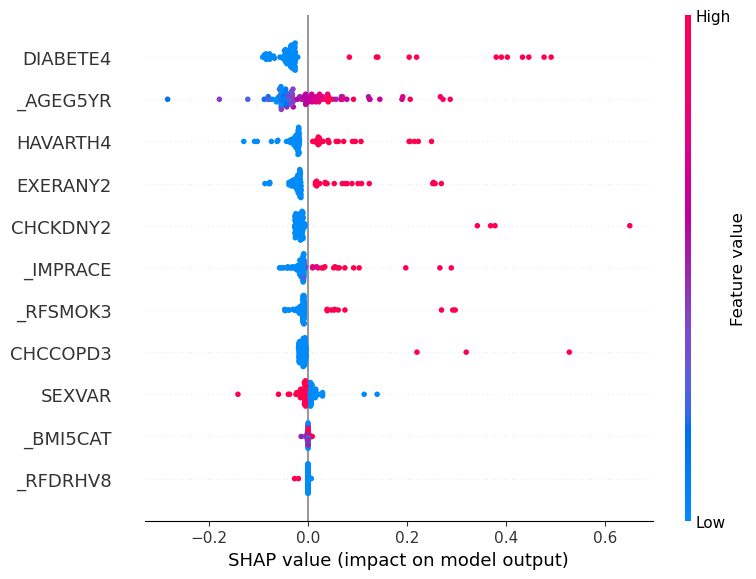

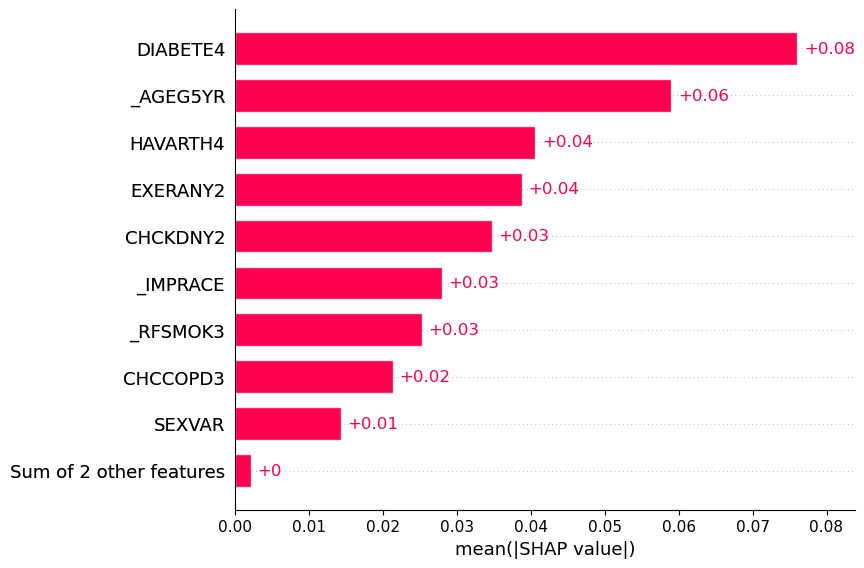

Valores SHAP para Light GBoost:


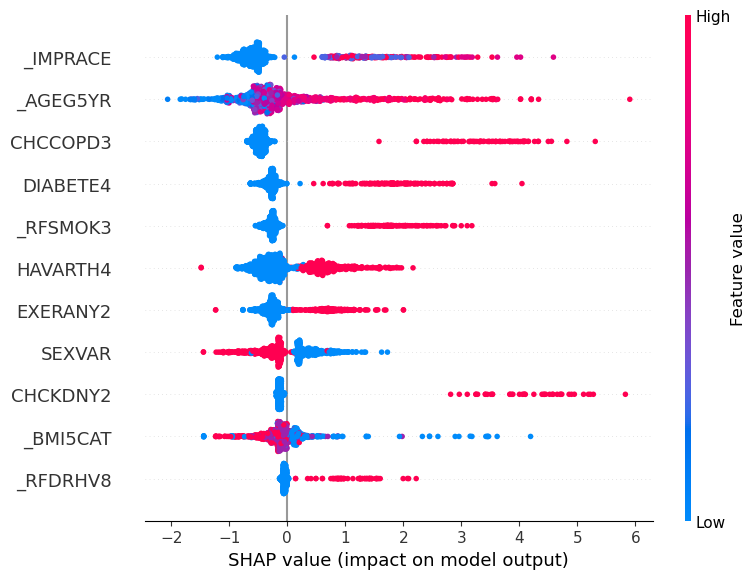

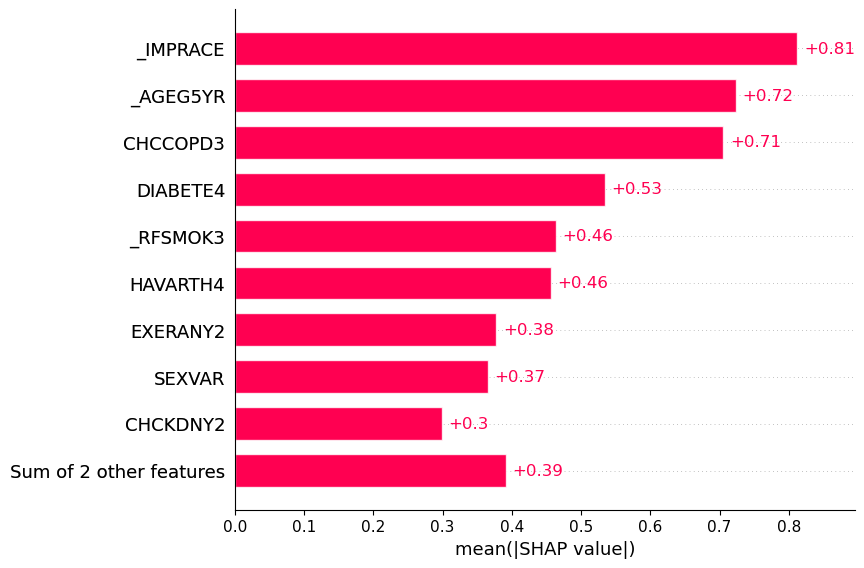

Valores SHAP para Random Forest:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [02:56<00:00,  2.36s/it]


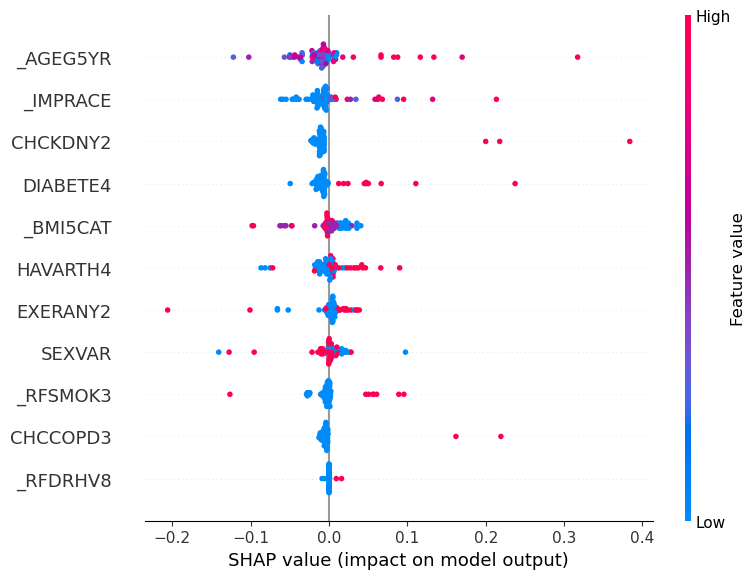

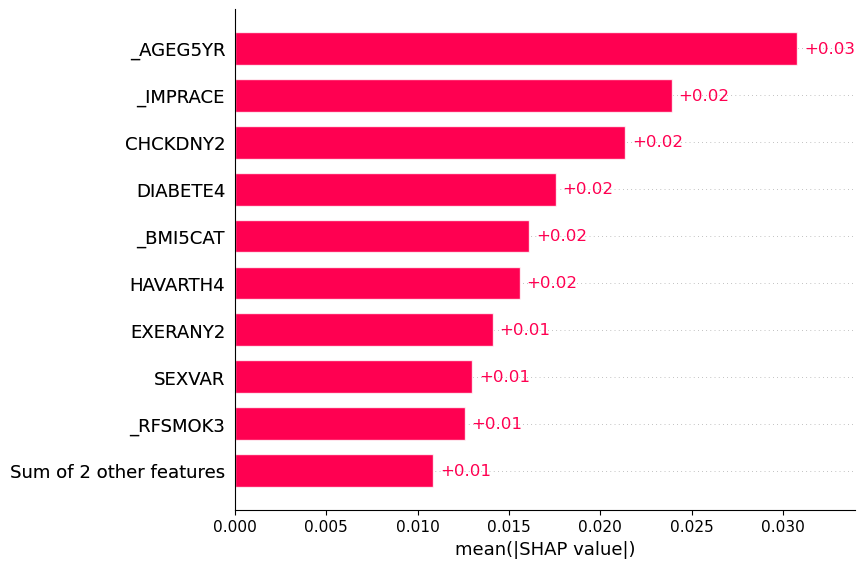

Valores SHAP para Neural Network:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [02:25<00:00,  1.94s/it]


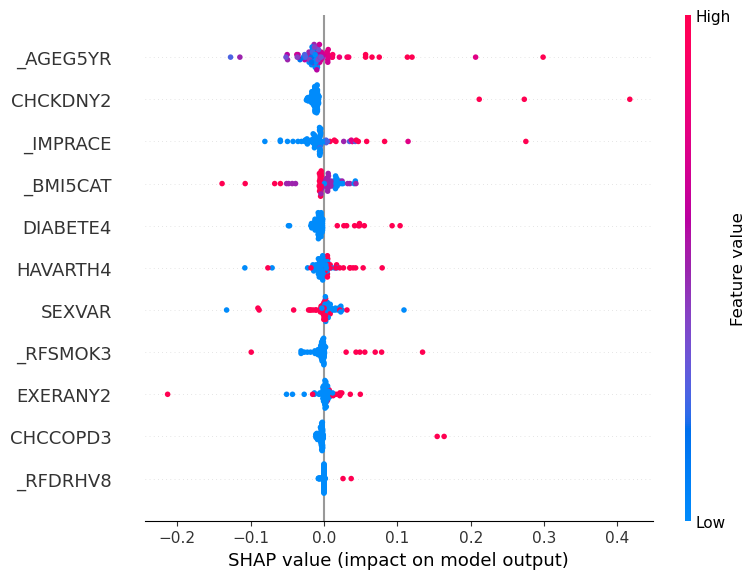

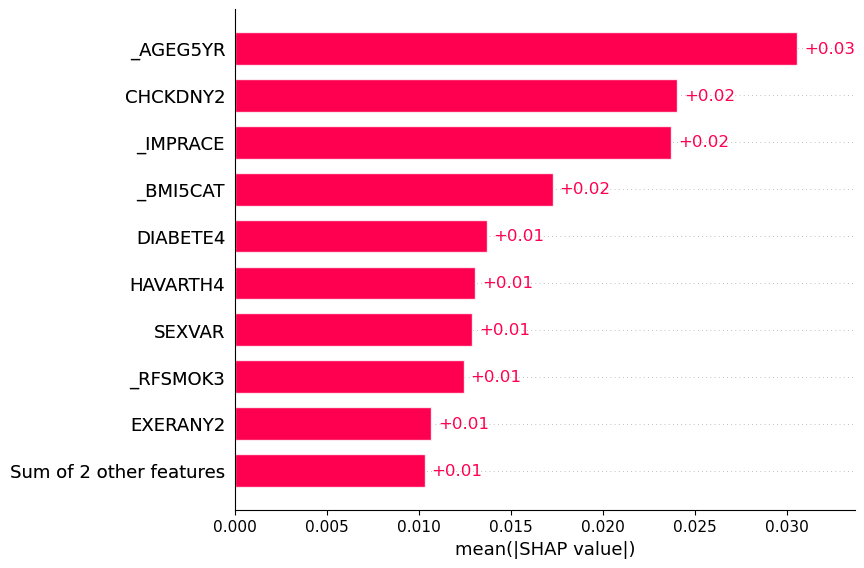

Valores SHAP para Easy Ensemble:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [03:01<00:00,  3.64s/it]


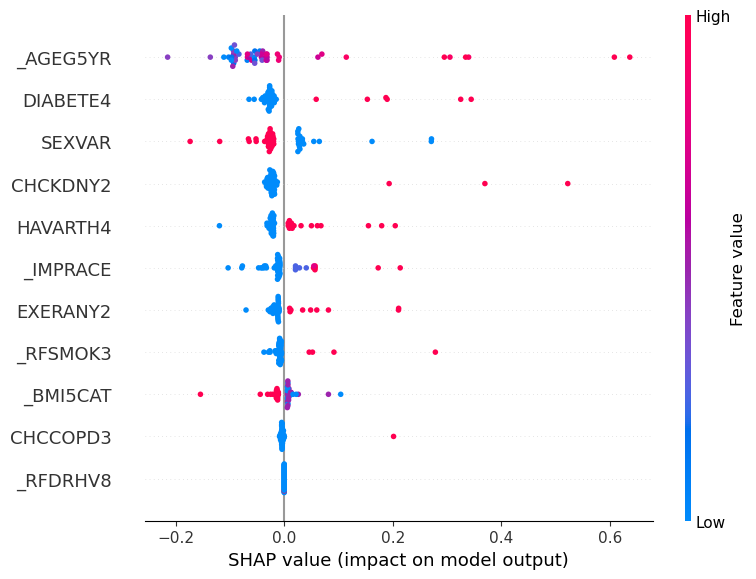

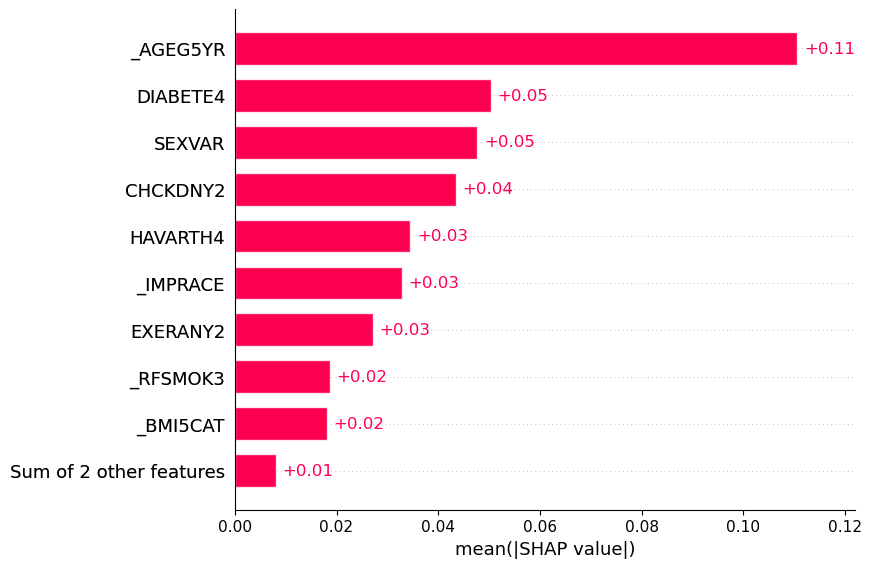

Valores SHAP para Voting:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [04:38<00:00,  5.56s/it]


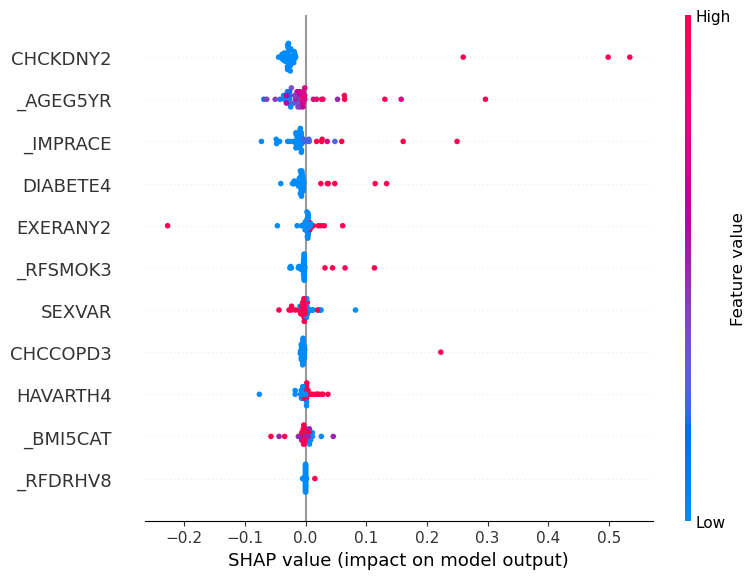

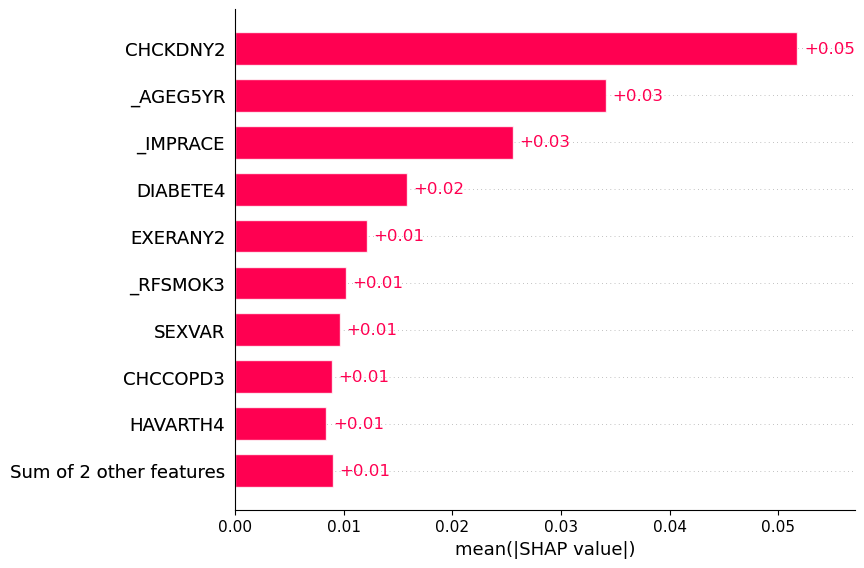

Valores SHAP para SVM:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:07<00:00,  1.28s/it]


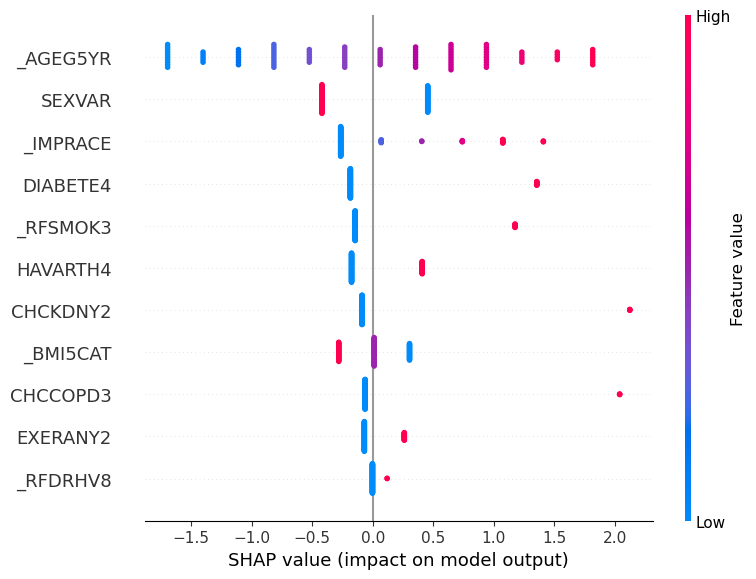

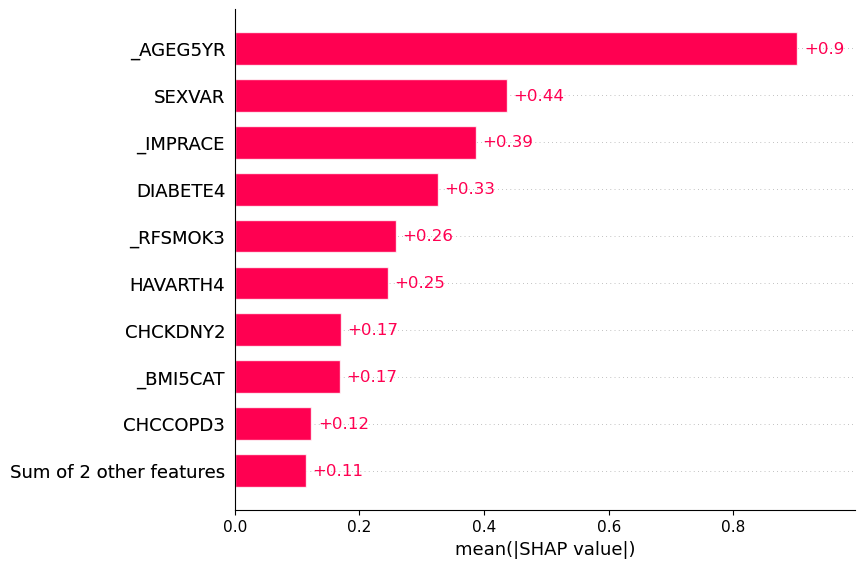

In [272]:
# Diccionario para mapear los tipos de modelo a sus correspondientes objetos explainer de SHAP
explainer_dict = {
    LogisticRegression: shap.LinearExplainer,
    GaussianNB: shap.KernelExplainer,
    LGBMClassifier: shap.TreeExplainer,
    RandomForestClassifier: shap.KernelExplainer,
    MLPClassifier: shap.KernelExplainer,
    EasyEnsembleClassifier: shap.KernelExplainer,
    VotingClassifier: shap.KernelExplainer,
    LinearSVC: shap.KernelExplainer    
    
}

# Diccionario para mapear los nombres de los modelos a sus correspondientes tamaños de muestra
sample_sizes = {
    'Logistic Regression': 1000,
    'Gaussian Naive Bayes': 100,
    'Light GBoost': 1000,
    'Random Forest': 75,
    'Neural Network': 75,
    'Easy Ensemble': 50,
    'SVM': 100,
    'Voting': 50
}

# Iterar sobre los modelos optimizados para graficar la importancia de las variables creadas por SHAP
for nombre, modelo in modelos_optimizados:
    print(f"Valores SHAP para {nombre}:")
    
    # Obtener el tamaño de muestra específico para el modelo actual
    sample_size = sample_sizes.get(nombre, 50)  # Valor predeterminado de 50 si no se encuentra el nombre del modelo
    
    # Tomar una muestra aleatoria de los datos de prueba para el cálculo de SHAP
    X_test_sample = shap.utils.sample(X_test, nsamples=sample_size, random_state=42)
    
    explainer_class = explainer_dict.get(type(modelo))
    if explainer_class is None:
        print(f"No se puede calcular los valores SHAP para {nombre}")
        continue
    
    if explainer_class == shap.KernelExplainer:
        if isinstance(modelo, LinearSVC):
            explainer = explainer_class(modelo.decision_function, X_test_sample)
        else:
            explainer = explainer_class(modelo.predict, X_test_sample)
    else:
        explainer = explainer_class(modelo, X_test_sample)
    
    shap_values = explainer(X_test_sample)
    
    # Graficar el Summary Plot de SHAP
    shap.summary_plot(shap_values, X_test_sample)
    plt.show()
    
    # Graficar el Bar Plot de SHAP
    shap.plots.bar(shap_values)
    plt.show()

#### Importancia y permutación de características

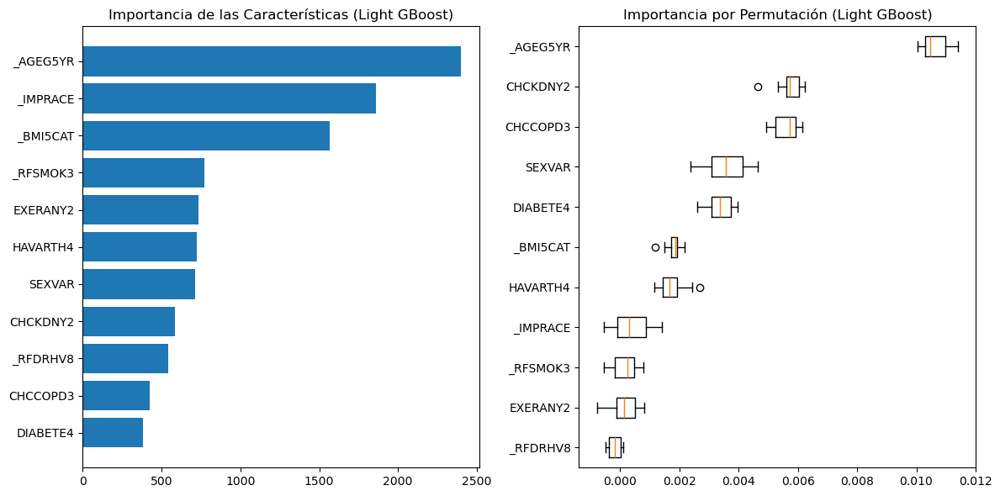

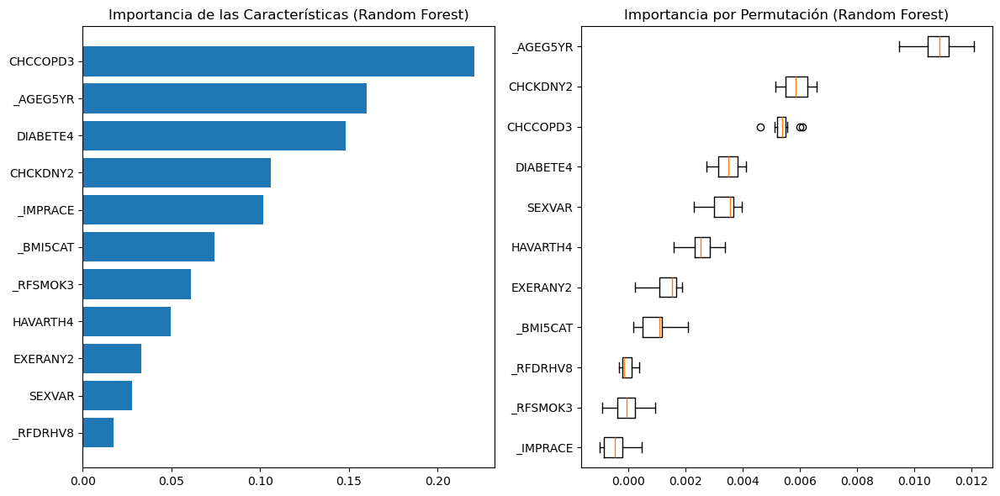

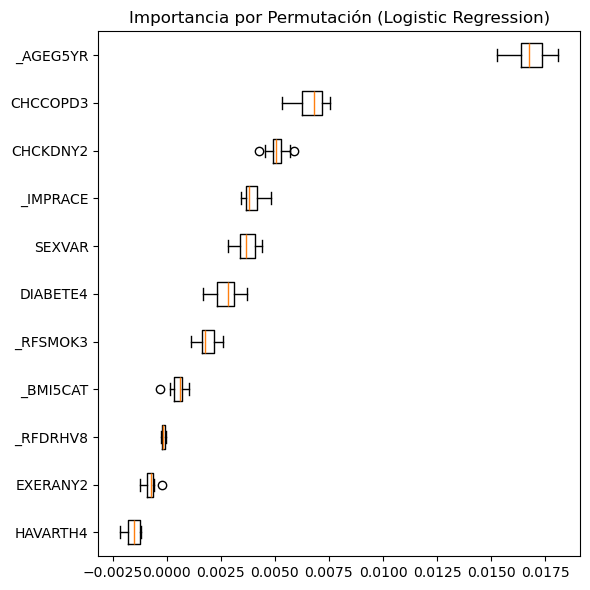

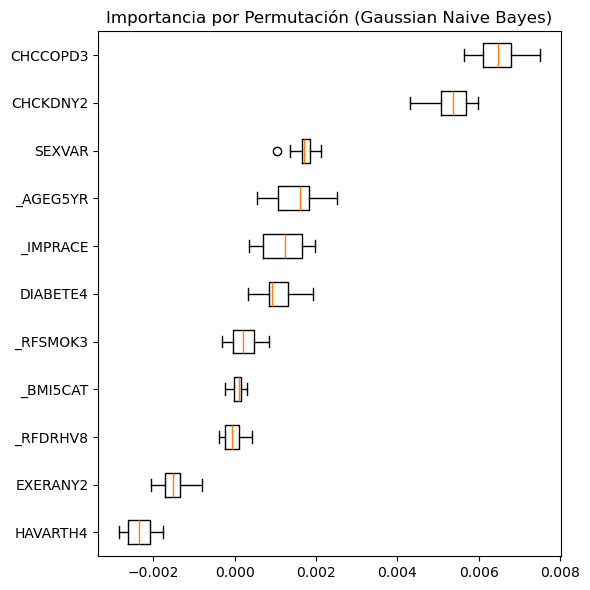

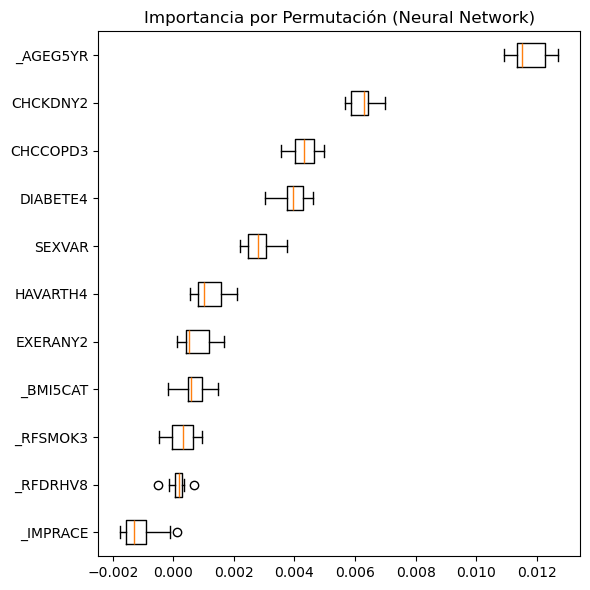

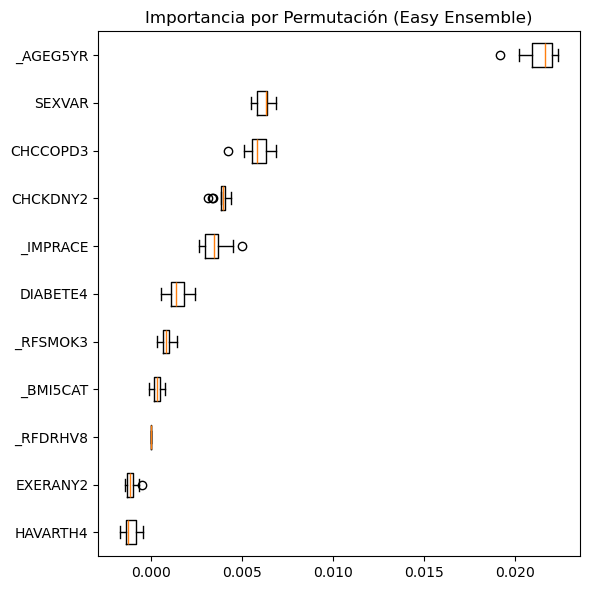

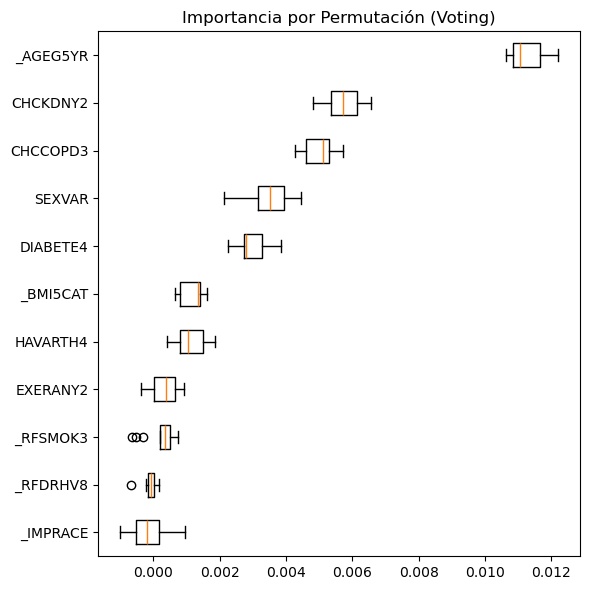

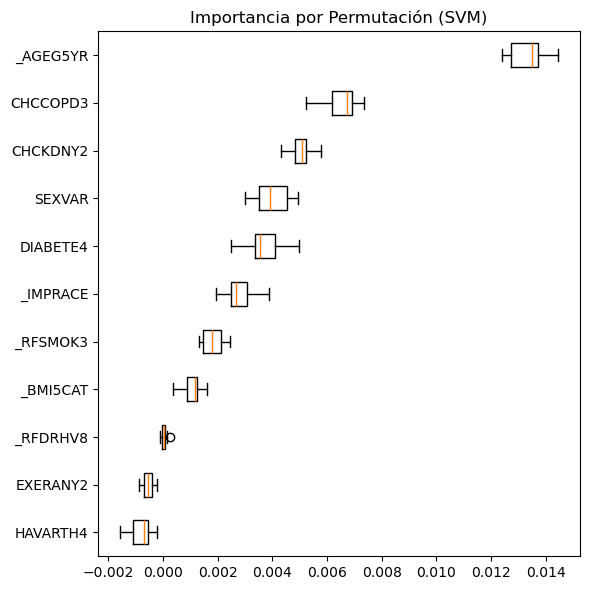

In [273]:
# Graficar importancia y permutación para los modelos con 11 variables
graficar_importancia_permutacion(modelos_optimizados, X_test, y_test, X)
graficar_permutacion_importancia(modelos_optimizados, X_test, y_test, X)

## MODELOS CON TODAS(29) LAS VARIABLES

In [274]:

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/SMOTEENN/modelos_iniciales_all"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los modelos base
modelos_base = [
    ('Logistic Regression', LogisticRegression(class_weight='balanced', max_iter=200, random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),
    ('Light GBoost', LGBMClassifier(class_weight='balanced', verbose=-1)),
    ('Random Forest', RandomForestClassifier(class_weight='balanced', n_estimators=500, min_samples_split=2,
                                             max_depth=5, min_samples_leaf=1, random_state=42)),
    ('Neural Network', MLPClassifier(early_stopping=True, random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble = [   
    ('Voting', VotingClassifier(estimators=modelos_base, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(class_weight='balanced', C=100.0, random_state=42, dual=False))
]

# Combinar todos los modelos
modelos = modelos_base + modelos_ensamble

# Crear el objeto de la técnica de muestreo SMOTEENN
tecnica_muestreo = SMOTEENN(random_state=42)

# Entrenar y evaluar modelos con todas las variables
resultados_allvars, X, X_train, y_train, X_val, y_val, X_test, y_test = entrenar_evaluar_modelos_base(
    df, modelos, carpeta_modelos, tecnica_muestreo)


Dimensiones del conjunto de entrenamiento:
X_train: (293352, 29), y_train: (293352,)

Dimensiones del conjunto de validación:
X_val: (53095, 29), y_val: (53095,)

Dimensiones del conjunto de prueba:
X_test: (53096, 29), y_test: (53096,)

Tiempo de muestreo: 53.67 minutos

Modelo Logistic Regression cargado desde archivo.
Entrenamiento Logistic Regression:
Tiempo de ejecución: 0.07 minutos
Accuracy: 0.8794656249147782
F1-score: 0.899107751745548
Precision: 0.9147077094569881
Recall: 0.884030972954775
AUC-ROC: 0.9462033476162435
Matthews Corr Coef: 0.750215038952962

MATRIZ DE CONFUSIÓN:
[[100441  14691]
 [ 20668 157552]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.83      0.87      0.85    115132
           1       0.91      0.88      0.90    178220

    accuracy                           0.88    293352
   macro avg       0.87      0.88      0.87    293352
weighted avg       0.88      0.88      0.88    293352



Test Logistic Re

### Tabla de métricas de rendimiento modelos base

In [275]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_allvars_inicial = pd.DataFrame.from_dict(resultados_allvars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_allvars_inicial

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.664570,0.353116,0.225883,0.808550,0.800339,0.293498,0.073585
Gaussian Naive Bayes,0.707869,0.363703,0.241383,0.737359,0.783279,0.294093,0.002996
Light GBoost,0.677057,0.361687,0.232986,0.808051,0.799936,0.303914,0.026411
Random Forest,0.638918,0.350410,0.220024,0.860113,0.813335,0.300343,1.020903
Neural Network,0.636451,0.342742,0.215481,0.837159,0.797069,0.285980,0.968252
Easy Ensemble,0.660182,0.353645,0.225357,0.821025,0.802778,0.296520,1.835478
Voting,0.675060,0.366374,0.235094,0.829674,0.815190,0.313752,2.302677
SVM,0.661274,0.352429,0.224898,0.814039,0.800278,0.293679,0.020154


### BÚSQUEDA DE HIPERPARÁMETROS

In [276]:

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/SMOTEENN/modelos_entrenados_all"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)


In [277]:

# Definir los espacios de búsqueda de hiperparámetros para cada modelo
param_dist_lr = {
    'class_weight': ['balanced', None],
    'solver': ['newton-cg', 'newton-cholesky', 'sag', 'saga'],
    'penalty': ['l2'],
    'C': loguniform(1e-4, 1e1)
}

param_dist_gnb = {
    'var_smoothing': loguniform(1e-9, 1e-1)
}

param_dist_lgbm = {
    'class_weight': ['balanced', None],
    'n_estimators': randint(50, 251),
    'max_depth': randint(3, 31),
    'subsample': uniform(0.7, 0.3),
    'colsample_bytree': uniform(0.7, 0.3),
    'learning_rate': loguniform(1e-5, 1e-1),
    'num_leaves': randint(10, 101),
    'verbose': [-1]
}

param_dist_rf = {
    'class_weight': ['balanced_subsample', 'balanced'],
    'n_estimators': randint(50, 251),
    'criterion': ['gini', 'entropy'],
    'max_depth': randint(3, 16),
    'min_samples_leaf': randint(3, 16),
    'min_samples_split': randint(3, 16),
    'max_features': [None, 'sqrt', 'log2']
}

param_dist_ann = {
    'hidden_layer_sizes': [(100,), (50,50), (100,100), (50, 50, 50),
                           (100, 100, 100), (50, 50, 50, 50), (100, 100, 100, 100),
                           (50, 50, 50, 50, 50), (100, 100, 100, 100, 100)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': loguniform(1e-5, 1e3),
    'batch_size': [64, 128, 256, 512],
    'learning_rate': ['constant', 'adaptive'],
    'learning_rate_init': loguniform(1e-5, 1e-1),
    'early_stopping': [True],
    'max_iter': [100]
}

param_dist_eec = {
    'n_estimators': randint(2, 20),
    'sampling_strategy': ['auto']
}

param_dist_svm = {
    'dual': ['auto'],
    'tol': loguniform(1e-5, 1e-3),
    'class_weight': [None, 'balanced'],
    'penalty': ['l2'],
    'loss': ['hinge', 'squared_hinge'],
    'C': loguniform(1e-4, 1e4),
    'max_iter': randint(1000, 2001)
}

# Definir los modelos con búsqueda de hiperparámetros
modelos = [
    ('Logistic Regression', RandomizedSearchCV(LogisticRegression(), param_dist_lr,
                                               cv=30, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Gaussian Naive Bayes', RandomizedSearchCV(GaussianNB(), param_dist_gnb, cv=30,
                                                n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('Light GBoost', RandomizedSearchCV(LGBMClassifier(), param_dist_lgbm, cv=5, n_jobs=6,
                                        scoring='f1_weighted', n_iter=50)),
    ('Random Forest', RandomizedSearchCV(RandomForestClassifier(), param_dist_rf,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Neural Network', RandomizedSearchCV(MLPClassifier(), param_dist_ann, cv=5, n_jobs=6,
                                          scoring='f1_weighted', error_score=0, n_iter=50)),
    ('Easy Ensemble', RandomizedSearchCV(EasyEnsembleClassifier(), param_dist_eec,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('SVM', RandomizedSearchCV(LinearSVC(), param_dist_svm, cv=5, n_jobs=6,
                               scoring='f1_weighted', n_iter=50))
]

# Crear un diccionario para almacenar los mejores hiperparámetros de cada modelo
best_params_all = {}

# Entrenar y evaluar cada modelo con búsqueda de hiperparámetros
for nombre, modelo in modelos:
    nombre_archivo = f"{carpeta_modelos}/{nombre}_optimizado.pkl"
    
    # Hash del conjunto de datos actual
    hash_actual = hash_de_datos(X_train)
    
    # Cargar o entrenar modelo
    modelo_cargado, tiempo_ejecucion, mejores_parametros_cargados = cargar_modelo(nombre_archivo, hash_actual)
    
    if modelo_cargado is not None:
        print(f"Modelo {nombre} cargado desde archivo.")
        modelo_best_all = modelo_cargado
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros_cargados}")
        # Agregar los mejores hiperparámetros cargados al diccionario
        best_params_all[nombre] = mejores_parametros_cargados
    else:
        print(f"Entrenando nuevo modelo {nombre}.")
        inicio = time.time()  # Tiempo de inicio
        modelo.fit(X_train, y_train)
        
        mejores_parametros = modelo.best_params_
        
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros}")
        
        # Agregar los mejores hiperparámetros al diccionario
        best_params_all[nombre] = modelo.best_params_
        
        # Entrenar el modelo con los mejores hiperparámetros en el conjunto de entrenamiento completo
        modelo_best_all = modelo.best_estimator_
        modelo_best_all.fit(X_train, y_train)
        
        fin = time.time()  # Tiempo de fin
        tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos
        
        # Guardar el modelo entrenado junto con el tiempo de ejecución y los mejores parámetros
        guardar_modelo(modelo_best_all, nombre_archivo, hash_actual, tiempo_ejecucion, mejores_parametros)

    # Métricas predicción entrenamiento
    y_pred_train = modelo_best_all.predict(X_train)

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_all, "predict_proba"):
        y_scores = modelo_best_all.predict_proba(X_train)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_all.decision_function(X_train)  # Puntuaciones de decisión
    
    print(f"Entrenamiento {nombre}:")
    print(f"Tiempo de búsqueda de hiperparámetros de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_train, y_pred_train)}")
    print(f"F1-score: {f1_score(y_train, y_pred_train)}")
    print(f"Precision: {precision_score(y_train, y_pred_train)}")
    print(f"Recall: {recall_score(y_train, y_pred_train)}")
    print(f"AUC-ROC: {roc_auc_score(y_train, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_train, y_pred_train)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_train, y_pred_train))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_train, y_pred_train))
    print("\n")

    # Métricas predicción validación
    inicio = time.time()  # Tiempo de inicio
    y_pred_val = modelo_best_all.predict(X_val)
    fin = time.time()  # Tiempo de fin
    tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_all, "predict_proba"):
        y_scores = modelo_best_all.predict_proba(X_val)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_all.decision_function(X_val)  # Puntuaciones de decisión

    
    print(f"Validación {nombre}:")
    print(f"Tiempo de ejecución de predicción de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_val, y_pred_val)}")
    print(f"F1-score: {f1_score(y_val, y_pred_val)}")
    print(f"Precision: {precision_score(y_val, y_pred_val)}")
    print(f"Recall: {recall_score(y_val, y_pred_val)}")
    print(f"AUC-ROC: {roc_auc_score(y_val, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_val, y_pred_val)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_val, y_pred_val))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_val, y_pred_val))
    print("\n")

Modelo Logistic Regression cargado desde archivo.
Mejores hiperparámetros para Logistic Regression: {'C': 0.009615386890361068, 'class_weight': None, 'penalty': 'l2', 'solver': 'newton-cholesky'}
Entrenamiento Logistic Regression:
Tiempo de búsqueda de hiperparámetros de Logistic Regression: 17.88 minutos
Accuracy: 0.8819779650385885
F1-score: 0.9042575549754436
Precision: 0.8914970882680102
Recall: 0.9173886208057457
AUC-ROC: 0.9461182968398663
Matthews Corr Coef: 0.7510468235906321

MATRIZ DE CONFUSIÓN:
[[ 95233  19899]
 [ 14723 163497]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.87      0.83      0.85    115132
           1       0.89      0.92      0.90    178220

    accuracy                           0.88    293352
   macro avg       0.88      0.87      0.88    293352
weighted avg       0.88      0.88      0.88    293352



Validación Logistic Regression:
Tiempo de ejecución de predicción de Logistic Regression: 0.00 min

### Entrenar modelos con los mejores parámetros

In [278]:

# Combinar los conjuntos de entrenamiento y validación para todas las variables
X_train_val_allvars = pd.concat([X_train, X_val], ignore_index=True)
y_train_val_allvars = pd.concat([y_train, y_val], ignore_index=True)

# Definir los modelos con los mejores hiperparámetros
modelos_entrenados_all = [
    ('Logistic Regression', LogisticRegression(random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),    
    ('Light GBoost', LGBMClassifier(verbosity=-1, random_state=42)),
    ('Random Forest', RandomForestClassifier(random_state=42)),   
    ('Neural Network', MLPClassifier(random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble_all = [   
    ('Voting', VotingClassifier(estimators=modelos_entrenados_all, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(random_state=42)) 
]

# Combinar todos los modelos
modelos_optimizados_all = modelos_entrenados_all + modelos_ensamble_all

# Crear el objeto de la técnica de muestreo SMOTEENN
tecnica_muestreo = SMOTEENN(random_state=42)

# Entrenar y evaluar modelos con todas las variables
resultados_optimizados_allvars, roc_data, pr_data, modelos_optimizados_all = entrenar_evaluar_modelos(
    X_train_val_allvars, y_train_val_allvars, X_test, y_test, modelos_optimizados_all, best_params_all, carpeta_modelos,
    tecnica_muestreo
)



Tiempo de muestreo: 44.82 minutos

Modelo Logistic Regression cargado desde archivo.
Test Logistic Regression:
Mejores hiperparámetros para Logistic Regression: {'C': 0.009615386890361068, 'class_weight': None, 'penalty': 'l2', 'solver': 'newton-cholesky'}
Tiempo de ejecución de entrenamiento: 0.01 minutos
Tiempo de ejecución de predicción: 0.00 minutos
Accuracy: 0.6428167846918789
F1-score: 0.35058041981988153
Precision: 0.2207321805872968
Recall: 0.8514637391882901
AUC-ROC: 0.8107670374144245
Matthews Corr Coef: 0.2987619755895068

MATRIZ DE CONFUSIÓN:
[[29012 18072]
 [  893  5119]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.97      0.62      0.75     47084
           1       0.22      0.85      0.35      6012

    accuracy                           0.64     53096
   macro avg       0.60      0.73      0.55     53096
weighted avg       0.89      0.64      0.71     53096



Modelo Gaussian Naive Bayes cargado desde archivo.


### Tabla de métricas de rendimiento con los mejores parámetros

In [279]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_allvars_opt = pd.DataFrame.from_dict(resultados_optimizados_allvars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_allvars_opt

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.642817,0.350580,0.220732,0.851464,0.810767,0.298762,0.013749
Gaussian Naive Bayes,0.671708,0.357998,0.229907,0.808383,0.804622,0.299477,0.003250
Light GBoost,0.659730,0.359939,0.228674,0.844977,0.813887,0.309008,0.029502
Random Forest,0.679298,0.363392,0.234375,0.808383,0.803435,0.306044,1.712419
Neural Network,0.694591,0.362177,0.237173,0.765802,0.789695,0.296937,14.734287
Easy Ensemble,0.654343,0.355334,0.225230,0.841317,0.811202,0.302607,3.115265
Voting,0.677716,0.365658,0.235260,0.820359,0.814726,0.311069,12.720279
SVM,0.643099,0.350226,0.220586,0.849468,0.811532,0.297910,0.020831


### Visualizar comparación de rendimiento de curvas ROC-AUC Y PR-AUC

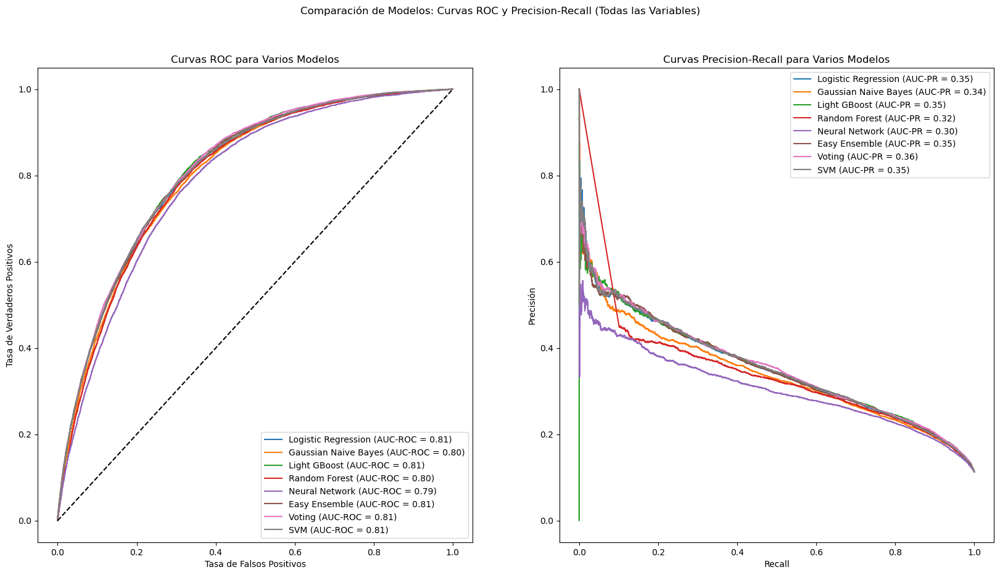

In [280]:
# Graficar curvas de rendimiento para los modelos con todas las variables
graficar_curvas_rendimiento(roc_data, pr_data, 
                            'Comparación de Modelos: Curvas ROC y Precision-Recall (Todas las Variables)')

### EXPLICABILIDAD

#### SHAP values

Valores SHAP para Logistic Regression:


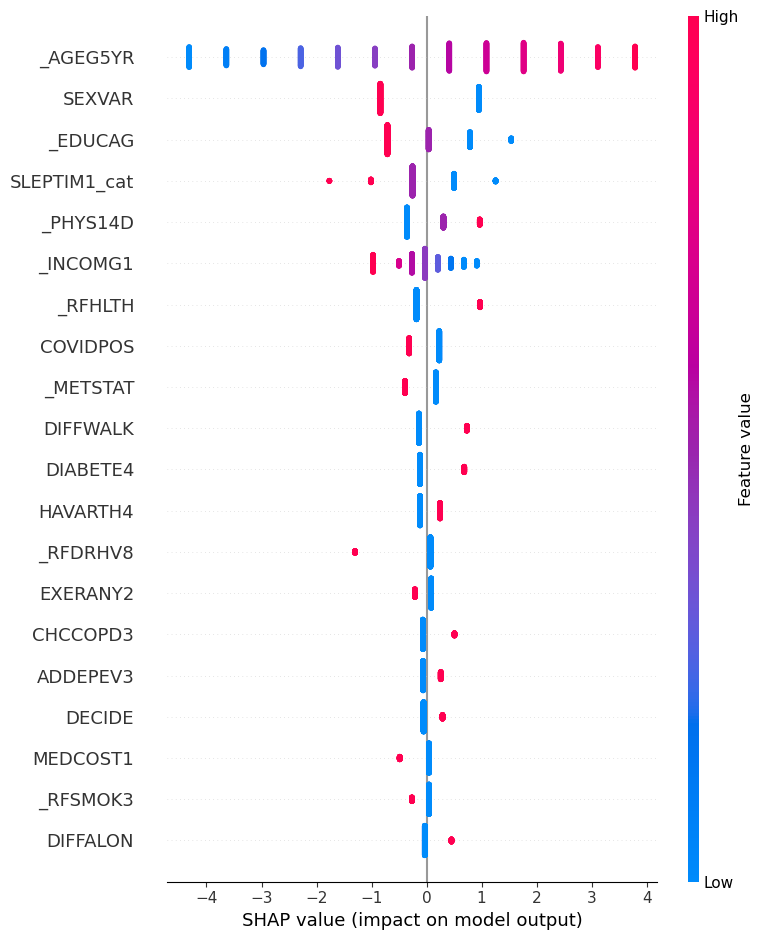

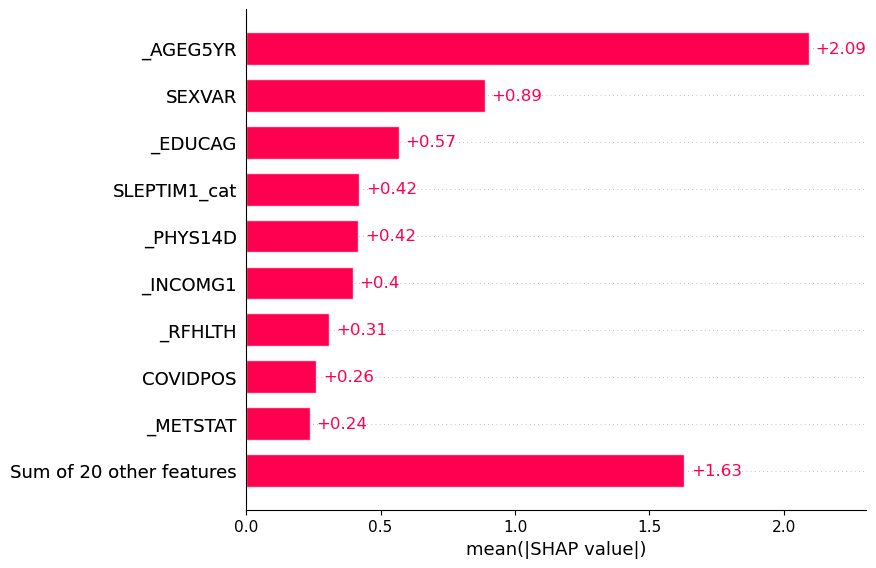

Valores SHAP para Gaussian Naive Bayes:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:35<00:00,  1.56s/it]


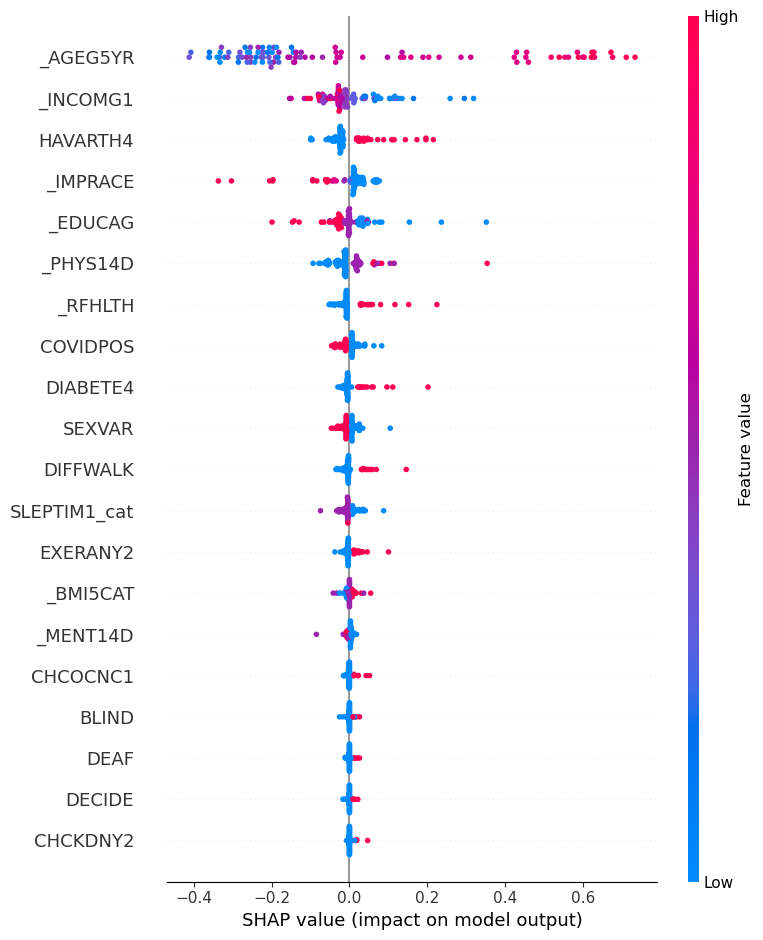

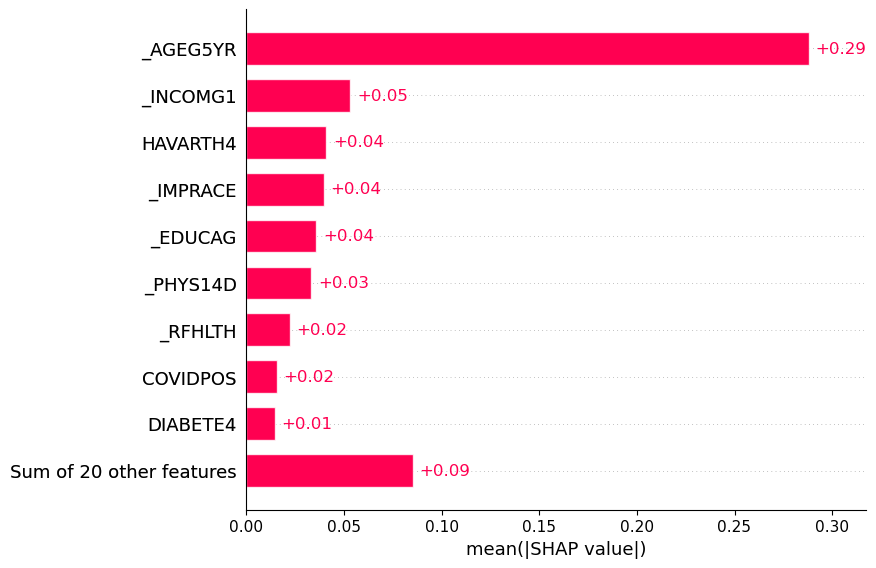

Valores SHAP para Light GBoost:


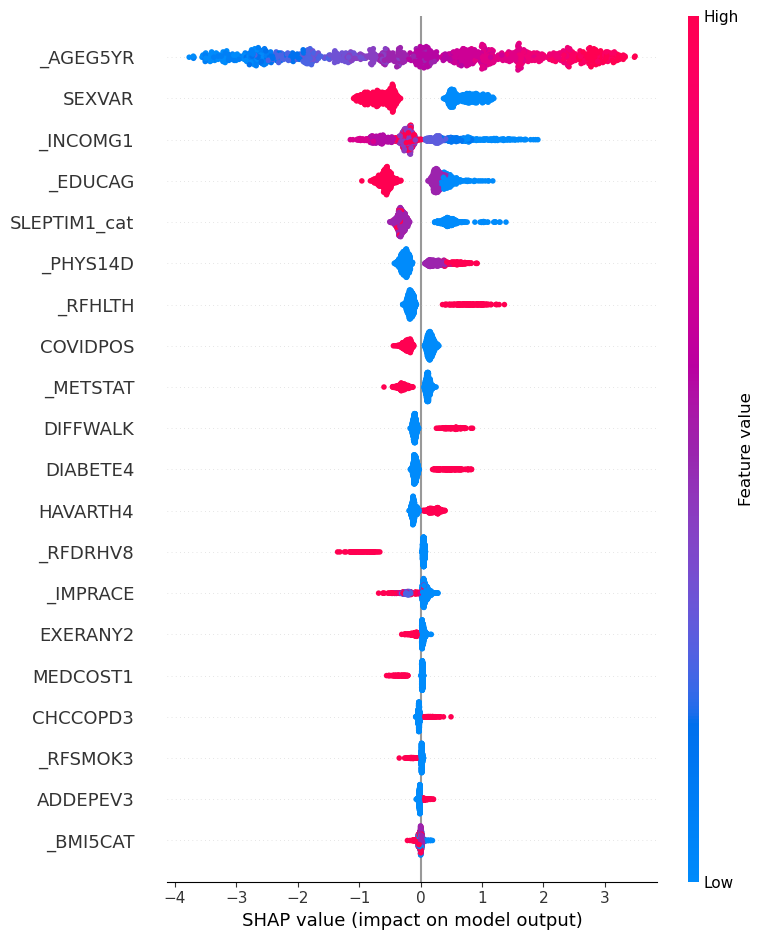

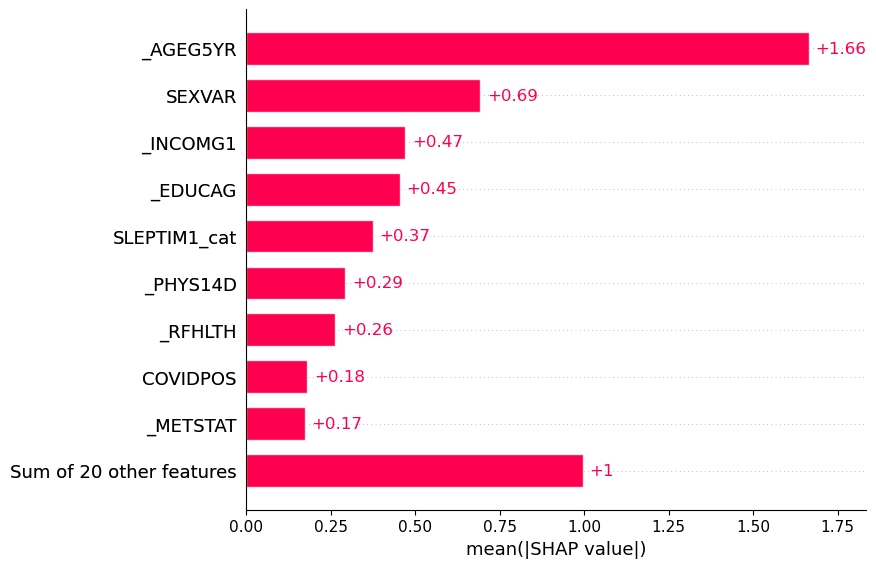

Valores SHAP para Random Forest:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [02:45<00:00,  2.21s/it]


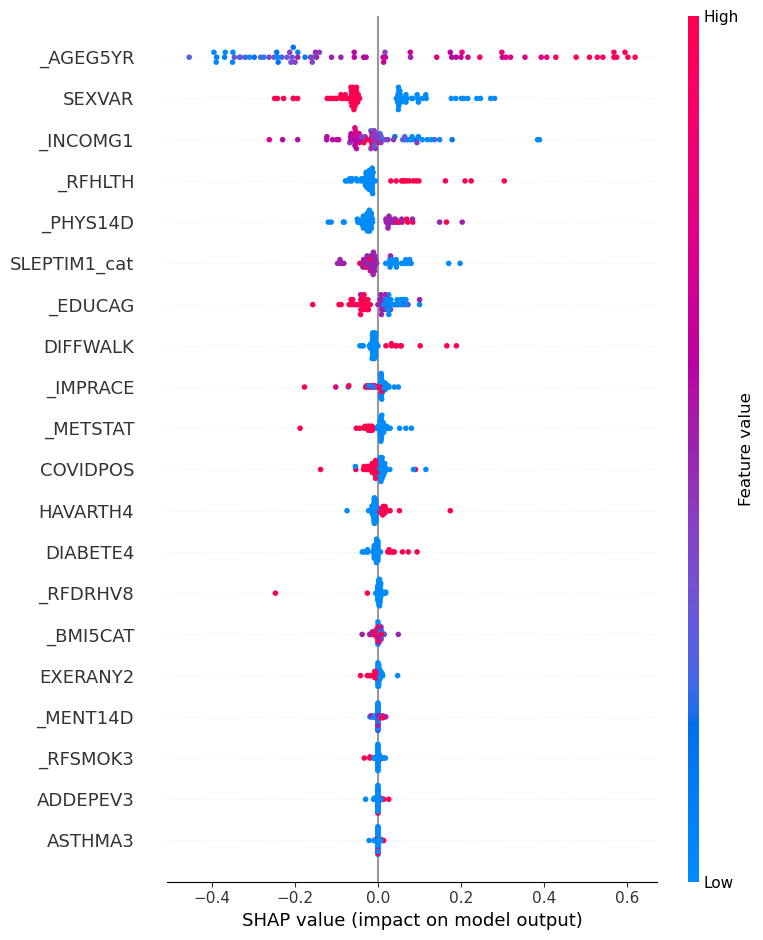

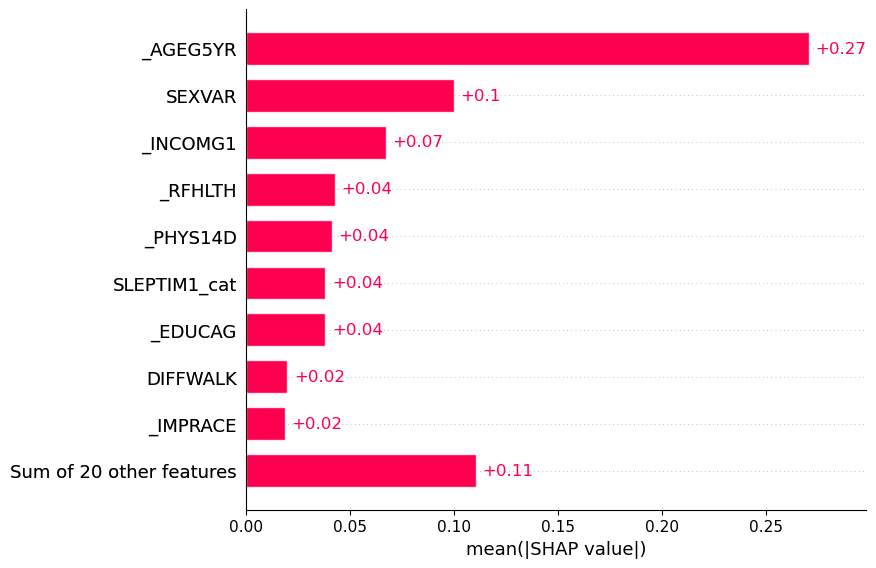

Valores SHAP para Neural Network:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [01:54<00:00,  1.52s/it]


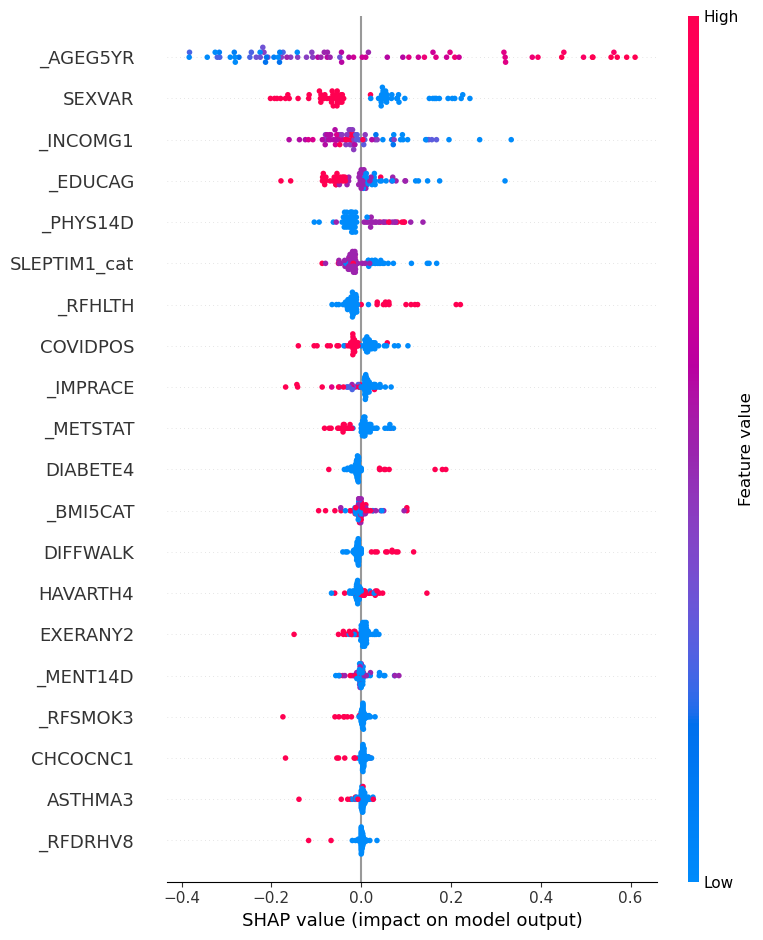

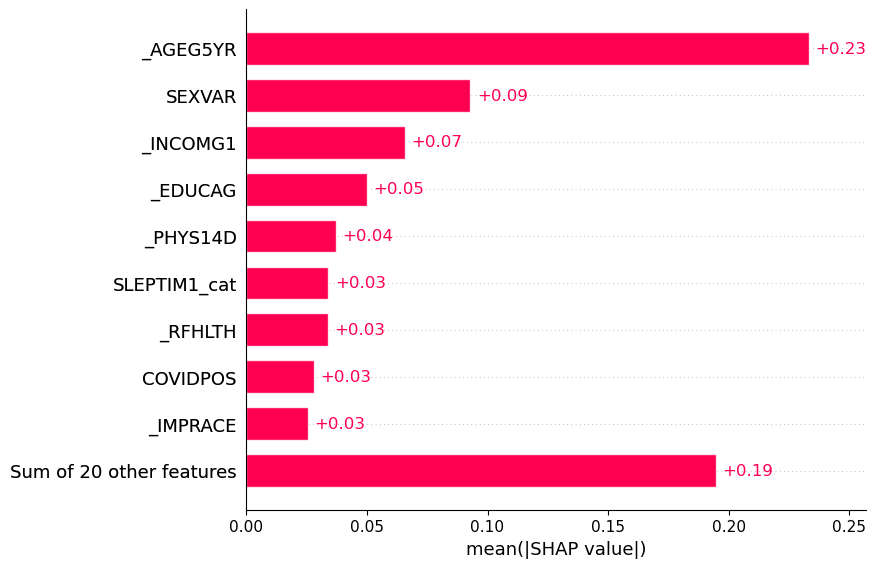

Valores SHAP para Easy Ensemble:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [06:45<00:00,  8.12s/it]


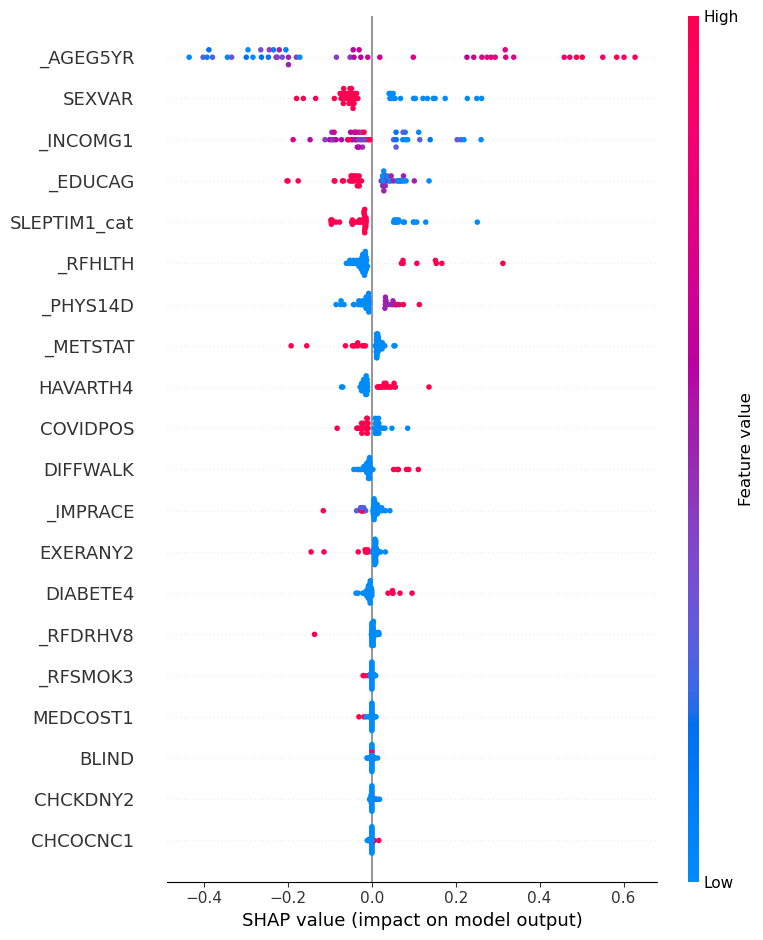

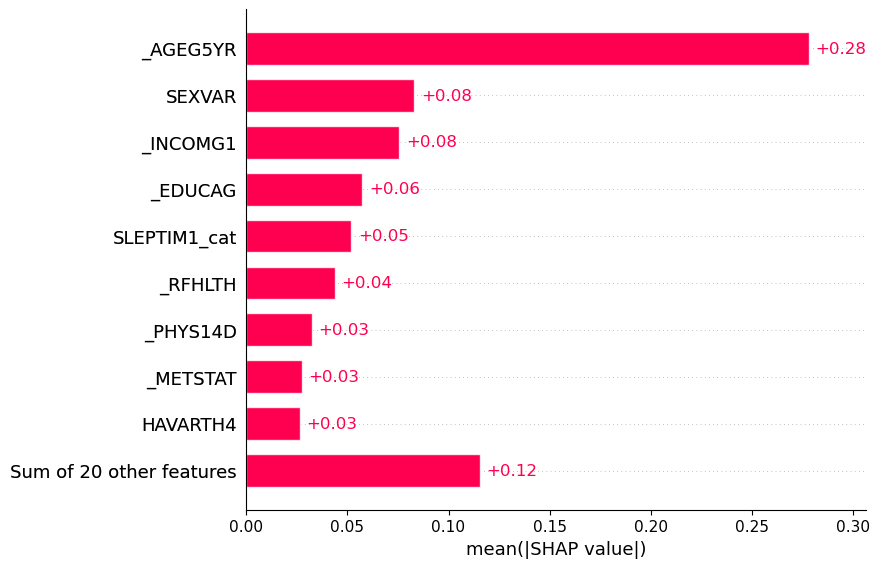

Valores SHAP para Voting:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [07:54<00:00,  9.49s/it]


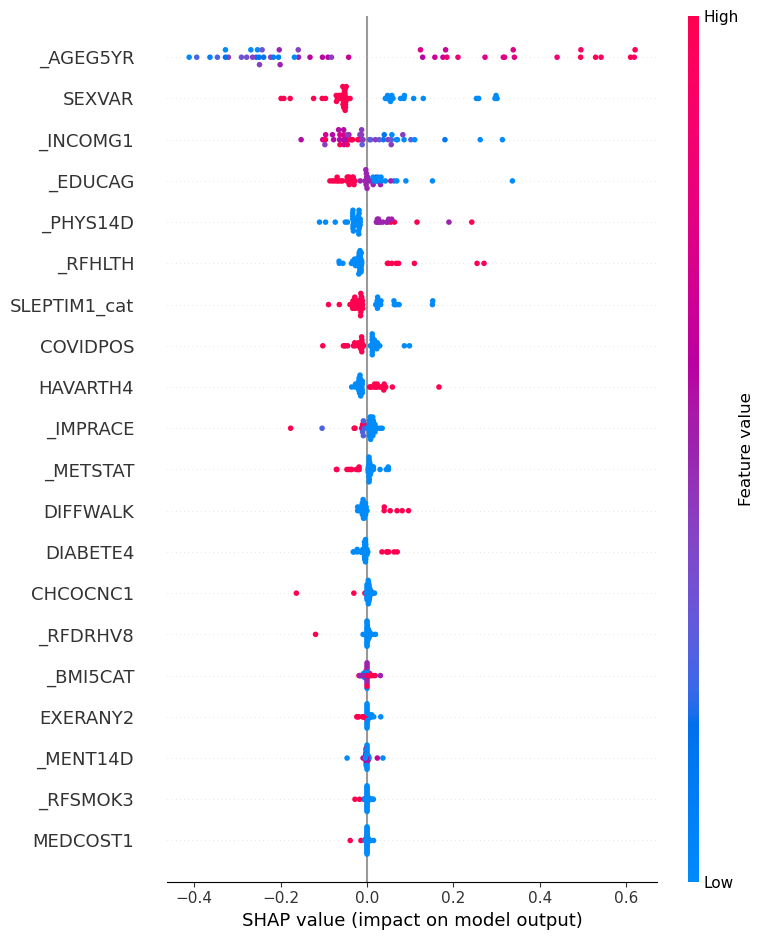

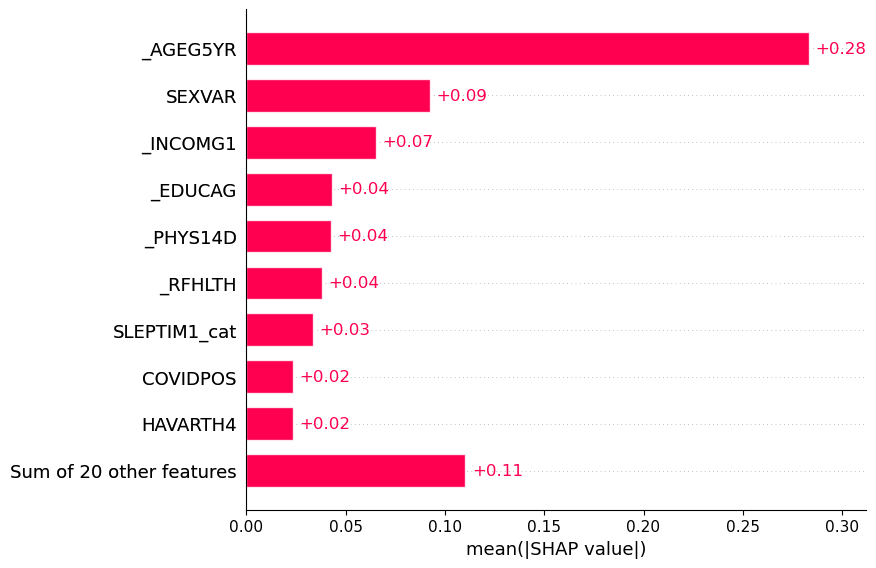

Valores SHAP para SVM:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:26<00:00,  1.46s/it]


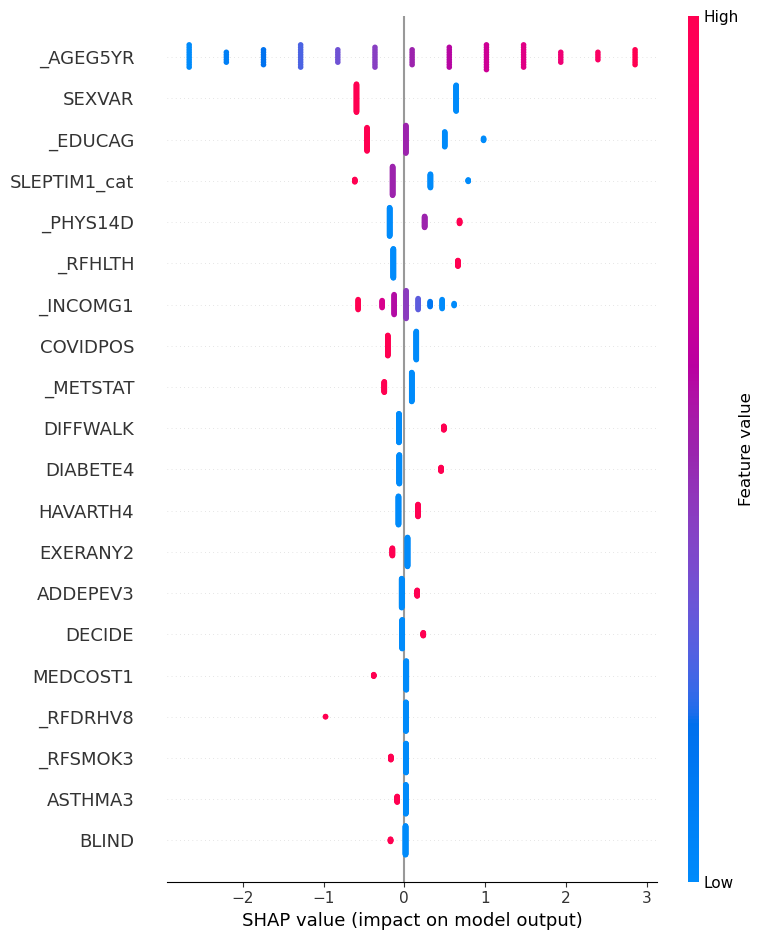

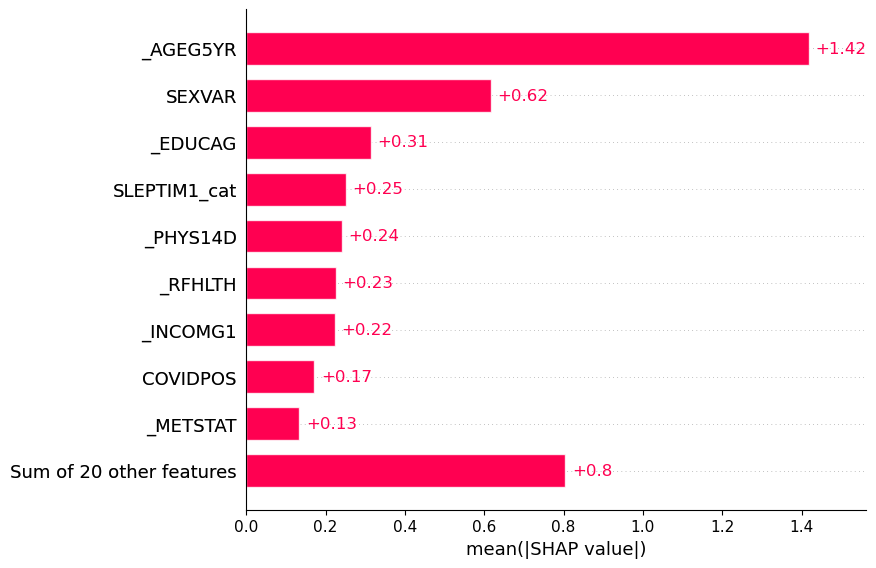

In [281]:
# Iterar sobre los modelos optimizados para graficar la importancia de las variables creadas por SHAP
for nombre, modelo in modelos_optimizados_all:
    print(f"Valores SHAP para {nombre}:")
    
    # Obtener el tamaño de muestra específico para el modelo actual
    sample_size = sample_sizes.get(nombre, 50)  # Valor predeterminado de 50 si no se encuentra el nombre del modelo
    
    # Tomar una muestra aleatoria de los datos de prueba para el cálculo de SHAP
    X_test_sample = shap.utils.sample(X_test, nsamples=sample_size, random_state=42)
    
    explainer_class = explainer_dict.get(type(modelo))
    if explainer_class is None:
        print(f"No se puede calcular los valores SHAP para {nombre}")
        continue
    
    if explainer_class == shap.KernelExplainer:
        if isinstance(modelo, LinearSVC):
            explainer = explainer_class(modelo.decision_function, X_test_sample)
        else:
            explainer = explainer_class(modelo.predict, X_test_sample)
    else:
        explainer = explainer_class(modelo, X_test_sample)
    
    shap_values = explainer(X_test_sample)
    
    # Graficar el Summary Plot de SHAP
    shap.summary_plot(shap_values, X_test_sample)
    plt.show()
    
    # Graficar el Bar Plot de SHAP
    shap.plots.bar(shap_values)
    plt.show()


#### Importancia y permutación de características

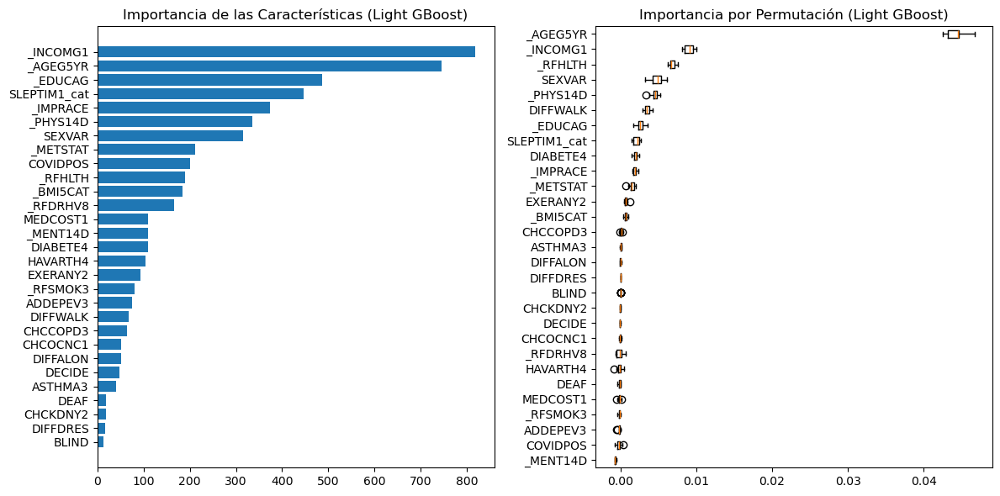

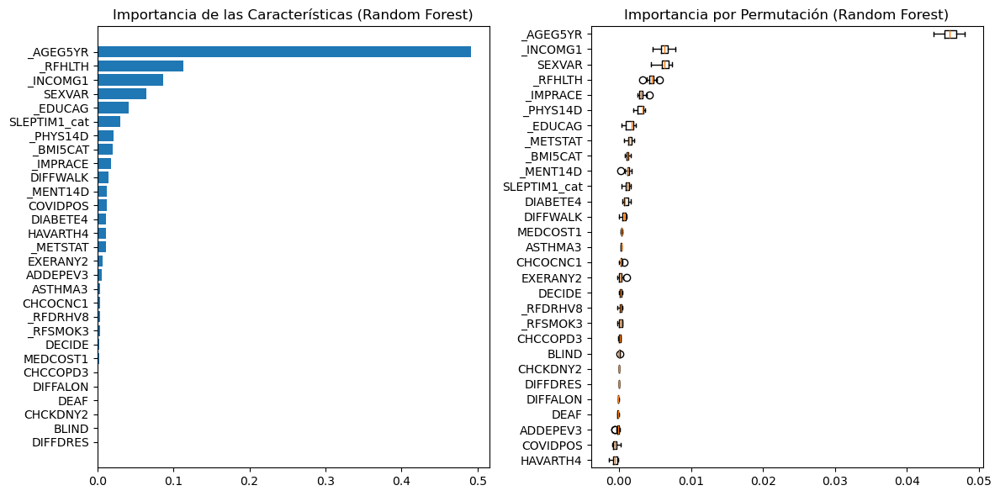

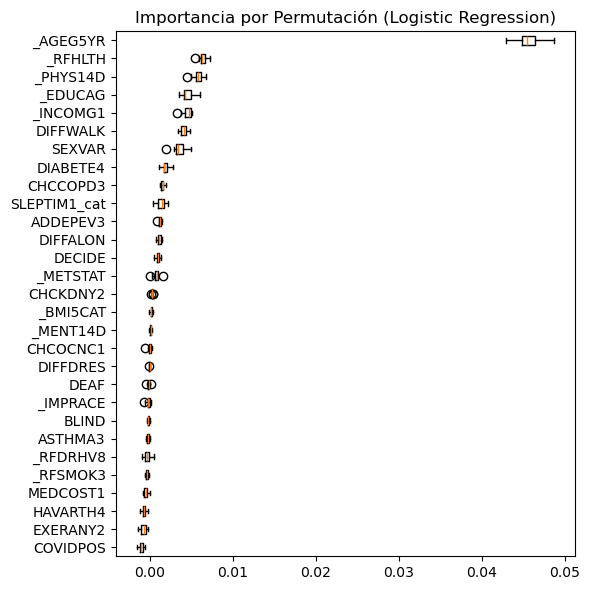

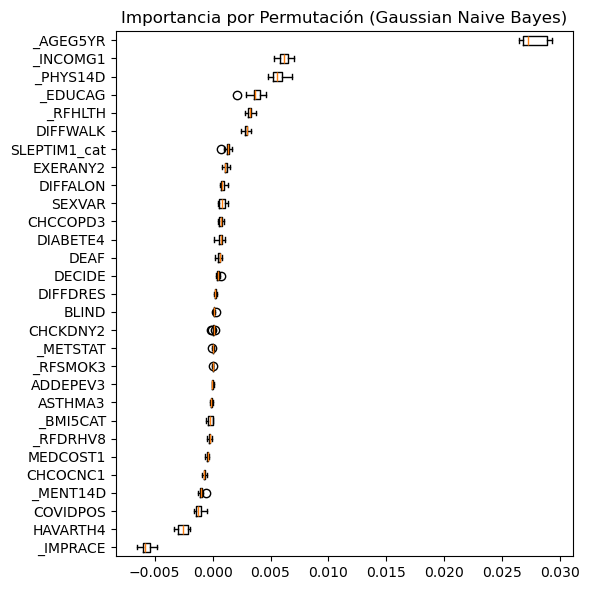

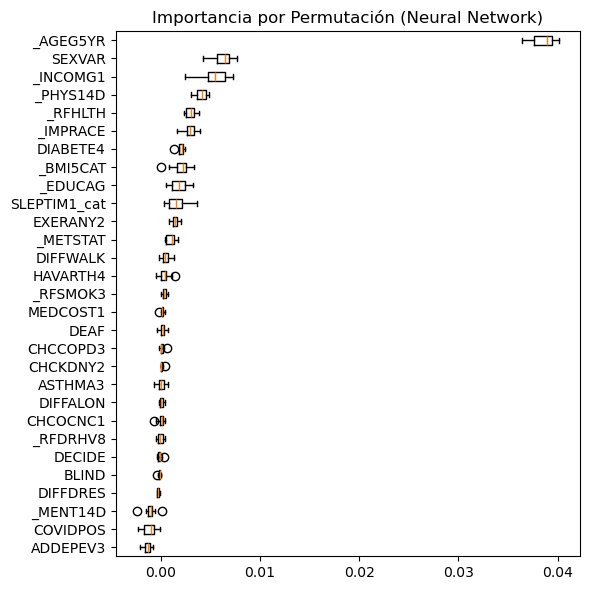

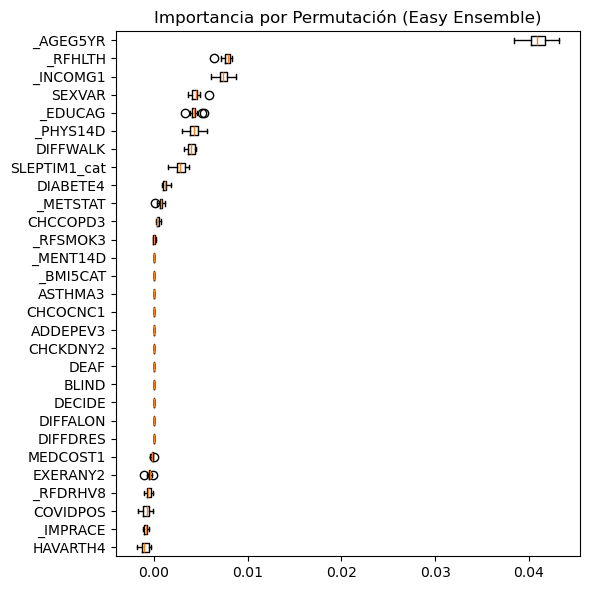

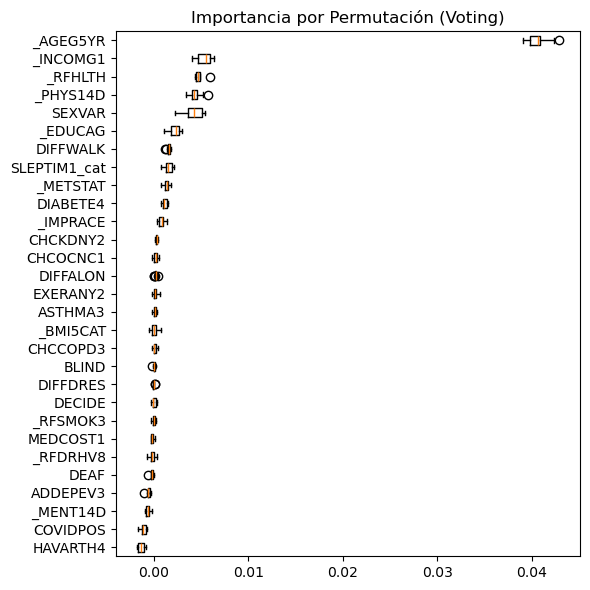

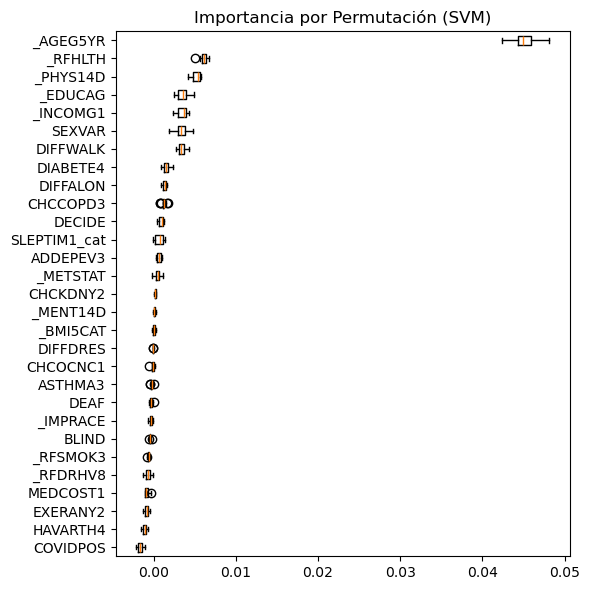

In [282]:
# Graficar importancia y permutación para los modelos con todas las variables
graficar_importancia_permutacion(modelos_optimizados_all, X_test, y_test, X)
graficar_permutacion_importancia(modelos_optimizados_all, X_test, y_test, X)

# ENTRENAMIENTO CON SUB Y SOBREMUESTREO SMOTETomek()

El capítulo 13 utiliza la técnica de muestreo SMOTETomek, que combina la técnica de sobremuestreo SMOTE (Synthetic Minority Over-sampling Technique) con la técnica de submuestreo Tomek Links. SMOTETomek aborda el desequilibrio de clases en conjuntos de datos mediante la generación de instancias sintéticas de la clase minoritaria y la eliminación de instancias ruidosas o cercanas a la frontera de decisión utilizando Tomek Links.

En primer lugar, se aplica la técnica SMOTE para generar instancias sintéticas de la clase minoritaria. Después, se utiliza la técnica Tomek Links para identificar y eliminar instancias ruidosas o cercanas a la frontera de decisión. Tomek Links se basa en el concepto de par Tomek, que se define como un par de instancias de diferentes clases que son los vecinos más cercanos entre sí. Si dos instancias forman un par Tomek, se considera que una de ellas es ruidosa o está cerca de la frontera de decisión y se elimina del conjunto de datos. Este proceso se aplica iterativamente hasta que no se encuentren más pares Tomek.

Al aplicar SMOTE, se aumenta la representación de la clase minoritaria y se generan nuevas instancias sintéticas para mejorar la capacidad de aprendizaje del modelo. Por otro lado, al aplicar Tomek Links, se eliminan las instancias ruidosas o cercanas a la frontera de decisión, lo que puede mejorar la calidad del conjunto de datos y reducir la superposición entre las clases.

## MODELO CON 11 VARIABLES

In [283]:
# Seleccionar las columnas deseadas para crear el nuevo dataset
columnas_seleccionadas = ['SEXVAR', 'EXERANY2', 'CHCCOPD3', 'CHCKDNY2', 
                          'HAVARTH4', 'DIABETE4', '_IMPRACE', '_AGEG5YR',
                          '_BMI5CAT', '_RFSMOK3', '_RFDRHV8', 'CARDIO']

# Dataset base con 11 variables
df_11vars = df.loc[:, columnas_seleccionadas]

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/SMOTETomek/modelos_iniciales_11vars"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los modelos base
modelos_base = [
    ('Logistic Regression', LogisticRegression(class_weight='balanced', random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),
    ('Gradient Boosting', GradientBoostingClassifier(learning_rate=0.1, n_estimators=500, max_depth=3, random_state=42,
                                                     min_samples_split=5, min_samples_leaf=3, max_features='sqrt')),
    ('Xtra GBoost', XGBClassifier(learning_rate=0.1, n_estimators=500, max_depth=3, random_state=42, scale_pos_weight=1,
                                  subsample=0.8, colsample_bytree=0.8)),
    ('Light GBoost', LGBMClassifier(class_weight='balanced', verbose=-1)),
    ('Decision Tree',
     DecisionTreeClassifier(class_weight='balanced', criterion='gini', max_depth=5, min_samples_split=20,
                            min_samples_leaf=10, random_state=42)),
    ('Random Forest', RandomForestClassifier(class_weight='balanced', n_estimators=500, min_samples_split=2,
                                             max_depth=5, min_samples_leaf=1, random_state=42)),
    ('Neural Network', MLPClassifier(early_stopping=True, random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble = [
    ('Voting', VotingClassifier(estimators=modelos_base, voting='soft', n_jobs=-1)),
    ('Stacking',
     StackingClassifier(estimators=modelos_base, final_estimator=LogisticRegression(random_state=42), n_jobs=-1)),
    ('SVM', LinearSVC(class_weight='balanced', C=100.0, random_state=42, dual=False))
]

# Combinar todos los modelos
modelos = modelos_base + modelos_ensamble

# Crear el objeto de la técnica de muestreo SMOTETomek
tecnica_muestreo = SMOTETomek(random_state=42)

# Entrenar y evaluar modelos con 11 variables
resultados_11vars, X, X_train, y_train, X_val, y_val, X_test, y_test = entrenar_evaluar_modelos_base(
    df_11vars, modelos, carpeta_modelos, tecnica_muestreo)


Dimensiones del conjunto de entrenamiento:
X_train: (439398, 11), y_train: (439398,)

Dimensiones del conjunto de validación:
X_val: (53095, 11), y_val: (53095,)

Dimensiones del conjunto de prueba:
X_test: (53096, 11), y_test: (53096,)

Tiempo de muestreo: 2.42 minutos

Modelo Logistic Regression cargado desde archivo.
Entrenamiento Logistic Regression:
Tiempo de ejecución: 0.05 minutos
Accuracy: 0.7229755256054875
F1-score: 0.7329395864780426
Precision: 0.7074923864748214
Recall: 0.7602856635669711
AUC-ROC: 0.7931092997347358
Matthews Corr Coef: 0.44719782945932635

MATRIZ DE CONFUSIÓN:
[[150640  69059]
 [ 52665 167034]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.74      0.69      0.71    219699
           1       0.71      0.76      0.73    219699

    accuracy                           0.72    439398
   macro avg       0.72      0.72      0.72    439398
weighted avg       0.72      0.72      0.72    439398



Test Logistic

### Tabla de métricas de rendimiento modelos base

In [284]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_11vars_inicial = pd.DataFrame.from_dict(resultados_11vars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_11vars_inicial

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.696832,0.366484,0.240037,0.774451,0.801961,0.303614,0.046561
Gaussian Naive Bayes,0.741939,0.365648,0.253336,0.656853,0.769230,0.285042,0.002250
Gradient Boosting,0.690786,0.365267,0.237937,0.785762,0.804158,0.304152,1.063802
Xtra GBoost,0.691615,0.365152,0.238069,0.783267,0.803761,0.303568,0.135089
Light GBoost,0.687717,0.363860,0.236473,0.788756,0.803212,0.302993,0.026081
Decision Tree,0.626544,0.333412,0.208932,0.824850,0.784429,0.271551,0.012286
Random Forest,0.666058,0.353379,0.226307,0.805888,0.797624,0.293326,1.257562
Neural Network,0.684873,0.362639,0.235178,0.791750,0.803403,0.302059,1.714469
Easy Ensemble,0.698716,0.366581,0.240555,0.769960,0.800300,0.302950,1.825074
Voting,0.698847,0.368084,0.241395,0.774617,0.803649,0.305559,2.725886


### BÚSQUEDA DE HIPERPARÁMETROS

In [285]:

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/SMOTETomek/modelos_entrenados_11vars"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los espacios de búsqueda de hiperparámetros para cada modelo
param_dist_lr = {
    'class_weight': ['balanced', None],
    'solver': ['newton-cg', 'newton-cholesky', 'sag', 'saga'],
    'penalty': ['l2'],
    'C': loguniform(1e-4, 1e1)
}

param_dist_gnb = {
    'var_smoothing': loguniform(1e-9, 1e-1)
}

param_dist_lgbm = {
    'class_weight': ['balanced', None],
    'n_estimators': randint(50, 251),
    'max_depth': randint(3, 31),
    'subsample': uniform(0.7, 0.3),
    'colsample_bytree': uniform(0.7, 0.3),
    'learning_rate': loguniform(1e-5, 1e-1),
    'num_leaves': randint(10, 101),
    'verbose': [-1]
}

param_dist_rf = {
    'class_weight': ['balanced_subsample', 'balanced'],
    'n_estimators': randint(50, 251),
    'criterion': ['gini', 'entropy'],
    'max_depth': randint(3, 16),
    'min_samples_leaf': randint(3, 16),
    'min_samples_split': randint(3, 16),
    'max_features': [None, 'sqrt', 'log2']
}

param_dist_ann = {
    'hidden_layer_sizes': [(100,), (50,50), (100,100), (50, 50, 50),
                           (100, 100, 100), (50, 50, 50, 50), (100, 100, 100, 100),
                           (50, 50, 50, 50, 50), (100, 100, 100, 100, 100)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': loguniform(1e-5, 1e3),
    'batch_size': [64, 128, 256, 512],
    'learning_rate': ['constant', 'adaptive'],
    'learning_rate_init': loguniform(1e-5, 1e-1),
    'early_stopping': [True],
    'max_iter': [100]
}

param_dist_eec = {
    'n_estimators': randint(2, 20),
    'sampling_strategy': ['auto']
}

param_dist_svm = {
    'dual': ['auto'],
    'tol': loguniform(1e-5, 1e-3),
    'class_weight': [None, 'balanced'],
    'penalty': ['l2'],
    'loss': ['hinge', 'squared_hinge'],
    'C': loguniform(1e-4, 1e4),
    'max_iter': randint(1000, 2001)
}

# Definir los modelos con búsqueda de hiperparámetros
modelos = [
    ('Logistic Regression', RandomizedSearchCV(LogisticRegression(), param_dist_lr,
                                               cv=30, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Gaussian Naive Bayes', RandomizedSearchCV(GaussianNB(), param_dist_gnb, cv=30,
                                                n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('Light GBoost', RandomizedSearchCV(LGBMClassifier(), param_dist_lgbm, cv=5, n_jobs=6,
                                        scoring='f1_weighted', n_iter=50)),
    ('Random Forest', RandomizedSearchCV(RandomForestClassifier(), param_dist_rf,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Neural Network', RandomizedSearchCV(MLPClassifier(), param_dist_ann, cv=5, n_jobs=6,
                                          scoring='f1_weighted', error_score=0, n_iter=50)),
    ('Easy Ensemble', RandomizedSearchCV(EasyEnsembleClassifier(), param_dist_eec,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('SVM', RandomizedSearchCV(LinearSVC(), param_dist_svm, cv=5, n_jobs=6,
                               scoring='f1_weighted', n_iter=50))
]

# Crear un diccionario para almacenar los mejores hiperparámetros de cada modelo
best_params_11vars = {}

# Entrenar y evaluar cada modelo con búsqueda de hiperparámetros
for nombre, modelo in modelos:
    nombre_archivo = f"{carpeta_modelos}/{nombre}_optimizado.pkl"
    
    # Hash del conjunto de datos actual
    hash_actual = hash_de_datos(X_train)
    
    # Cargar o entrenar modelo
    modelo_cargado, tiempo_ejecucion, mejores_parametros_cargados = cargar_modelo(nombre_archivo, hash_actual)
    
    if modelo_cargado is not None:
        print(f"Modelo {nombre} cargado desde archivo.")
        modelo_best_11vars = modelo_cargado
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros_cargados}")
        
        # Agregar los mejores hiperparámetros cargados al diccionario
        best_params_11vars[nombre] = mejores_parametros_cargados
    else:
        print(f"Entrenando nuevo modelo {nombre}.")
        inicio = time.time()  # Tiempo de inicio
        modelo.fit(X_train, y_train)

        mejores_parametros = modelo.best_params_
        
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros}")
        
        # Agregar los mejores hiperparámetros al diccionario
        best_params_11vars[nombre] = mejores_parametros
        
        # Entrenar el modelo con los mejores hiperparámetros en el conjunto de entrenamiento completo
        modelo_best_11vars = modelo.best_estimator_
        modelo_best_11vars.fit(X_train, y_train)
        
        fin = time.time()  # Tiempo de fin
        tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos
        
        # Guardar el modelo entrenado junto con el tiempo de ejecución y los mejores parámetros
        guardar_modelo(modelo_best_11vars, nombre_archivo, hash_actual, tiempo_ejecucion, mejores_parametros)

    # Imprimir métricas de la predicción en el conjunto de entrenamiento
    y_pred_train = modelo_best_11vars.predict(X_train)

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_11vars, "predict_proba"):
        y_scores = modelo_best_11vars.predict_proba(X_train)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_11vars.decision_function(X_train)  # Puntuaciones de decisión
    
    print(f"Entrenamiento {nombre}:")
    print(f"Tiempo de búsqueda de hiperparámetros de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_train, y_pred_train)}")
    print(f"F1-score: {f1_score(y_train, y_pred_train)}")
    print(f"Precision: {precision_score(y_train, y_pred_train)}")
    print(f"Recall: {recall_score(y_train, y_pred_train)}")
    print(f"AUC-ROC: {roc_auc_score(y_train, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_train, y_pred_train)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_train, y_pred_train))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_train, y_pred_train))
    print("\n")

    # Predecir en el conjunto de validación
    inicio = time.time()  # Tiempo de inicio
    y_pred_val = modelo_best_11vars.predict(X_val)
    fin = time.time()  # Tiempo de fin
    tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_11vars, "predict_proba"):
        y_scores = modelo_best_11vars.predict_proba(X_val)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_11vars.decision_function(X_val)  # Puntuaciones de decisión
    

    # Imprimir métricas de la predicción en el conjunto de validación
    print(f"Validación {nombre}:")
    print(f"Tiempo de ejecución de predicción de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_val, y_pred_val)}")
    print(f"F1-score: {f1_score(y_val, y_pred_val)}")
    print(f"Precision: {precision_score(y_val, y_pred_val)}")
    print(f"Recall: {recall_score(y_val, y_pred_val)}")
    print(f"AUC-ROC: {roc_auc_score(y_val, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_val, y_pred_val)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_val, y_pred_val))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_val, y_pred_val))
    print("\n")
    
 

Modelo Logistic Regression cargado desde archivo.
Mejores hiperparámetros para Logistic Regression: {'C': 0.30292963582407906, 'class_weight': None, 'penalty': 'l2', 'solver': 'newton-cg'}
Entrenamiento Logistic Regression:
Tiempo de búsqueda de hiperparámetros de Logistic Regression: 13.84 minutos
Accuracy: 0.7230255941083027
F1-score: 0.7329691065473056
Precision: 0.7075671118905706
Recall: 0.7602629051566007
AUC-ROC: 0.7931068682511531
Matthews Corr Coef: 0.4472933624916963

MATRIZ DE CONFUSIÓN:
[[150667  69032]
 [ 52670 167029]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.74      0.69      0.71    219699
           1       0.71      0.76      0.73    219699

    accuracy                           0.72    439398
   macro avg       0.72      0.72      0.72    439398
weighted avg       0.72      0.72      0.72    439398



Validación Logistic Regression:
Tiempo de ejecución de predicción de Logistic Regression: 0.00 minutos
Ac

### Entrenar modelos con los mejores parámetros

In [286]:
# Combinar los conjuntos de entrenamiento y validación para 11 variables
X_train_val_11vars = pd.concat([X_train, X_val], ignore_index=True)
y_train_val_11vars = pd.concat([y_train, y_val], ignore_index=True)

# Definir los modelos base
modelos_entrenados = [
    ('Logistic Regression', LogisticRegression(random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),    
    ('Light GBoost', LGBMClassifier(verbosity=-1, random_state=42)),
    ('Random Forest', RandomForestClassifier(random_state=42)),   
    ('Neural Network', MLPClassifier(random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble = [   
    ('Voting', VotingClassifier(estimators=modelos_entrenados, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(random_state=42)) 
]

# Combinar todos los modelos
modelos_optimizados = modelos_entrenados + modelos_ensamble

# Crear el objeto de la técnica de muestreo SMOTETomek
tecnica_muestreo = SMOTETomek(random_state=42)

# Entrenar y evaluar modelos con 11 variables
resultados_optimizados_11vars, roc_data_11vars, pr_data_11vars, modelos_optimizados = entrenar_evaluar_modelos(
    X_train_val_11vars, y_train_val_11vars, X_test, y_test, modelos_optimizados, best_params_11vars, carpeta_modelos,
    tecnica_muestreo
)



Tiempo de muestreo: 4.12 minutos

Modelo Logistic Regression cargado desde archivo.
Test Logistic Regression:
Mejores hiperparámetros para Logistic Regression: {'C': 0.30292963582407906, 'class_weight': None, 'penalty': 'l2', 'solver': 'newton-cg'}
Tiempo de ejecución de entrenamiento: 0.02 minutos
Tiempo de ejecución de predicción: 0.00 minutos
Accuracy: 0.6968321530812114
F1-score: 0.366384569966542
Precision: 0.23998349920074252
Recall: 0.7741184298070526
AUC-ROC: 0.8019796677988852
Matthews Corr Coef: 0.3034364132015548

MATRIZ DE CONFUSIÓN:
[[32345 14739]
 [ 1358  4654]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.96      0.69      0.80     47084
           1       0.24      0.77      0.37      6012

    accuracy                           0.70     53096
   macro avg       0.60      0.73      0.58     53096
weighted avg       0.88      0.70      0.75     53096



Modelo Gaussian Naive Bayes cargado desde archivo.
Test Gaus

### Tabla de métricas de rendimiento con los mejores parámetros

In [287]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_11vars_opt = pd.DataFrame.from_dict(resultados_optimizados_11vars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_11vars_opt

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.696832,0.366385,0.239983,0.774118,0.801980,0.303436,0.022898
Gaussian Naive Bayes,0.737024,0.364770,0.251049,0.666833,0.778048,0.285248,0.003054
Light GBoost,0.687340,0.363434,0.236159,0.788257,0.802373,0.302390,0.097873
Random Forest,0.696060,0.356180,0.234282,0.742515,0.788251,0.285809,0.918514
Neural Network,0.695156,0.359173,0.235685,0.754491,0.787602,0.291399,16.178827
Easy Ensemble,0.694440,0.364164,0.238208,0.772788,0.800071,0.300535,4.150731
Voting,0.712860,0.371040,0.246708,0.748004,0.801294,0.304569,15.381680
SVM,0.693593,0.365459,0.238702,0.779275,0.801839,0.303229,0.012529


### Visualizar comparación de rendimiento de curvas ROC-AUC Y PR-AUC

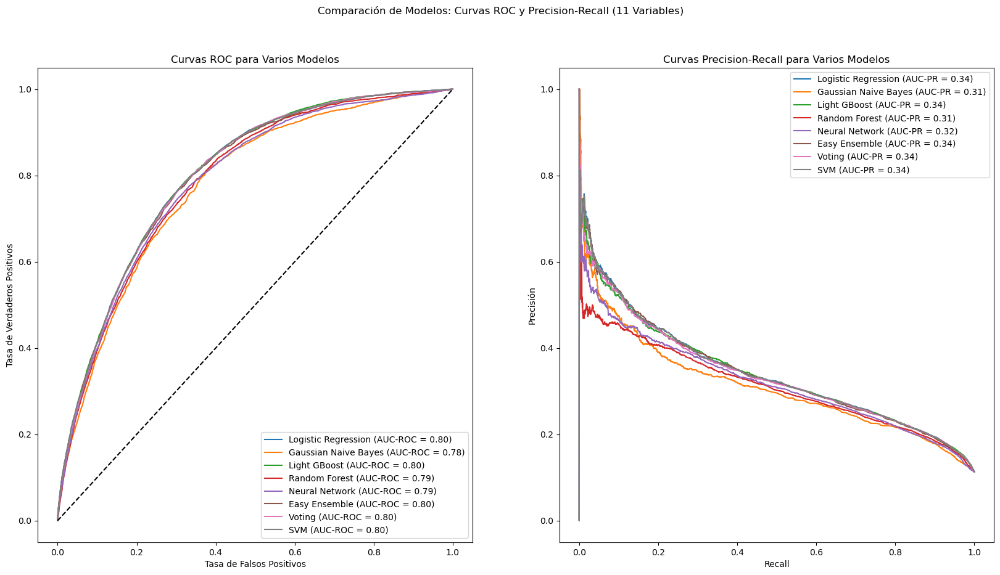

In [288]:
# Graficar curvas de rendimiento para los modelos con 11 variables
graficar_curvas_rendimiento(roc_data_11vars, pr_data_11vars,
                            'Comparación de Modelos: Curvas ROC y Precision-Recall (11 Variables)')

### EXPLICABILIDAD

#### SHAP values

Valores SHAP para Logistic Regression:


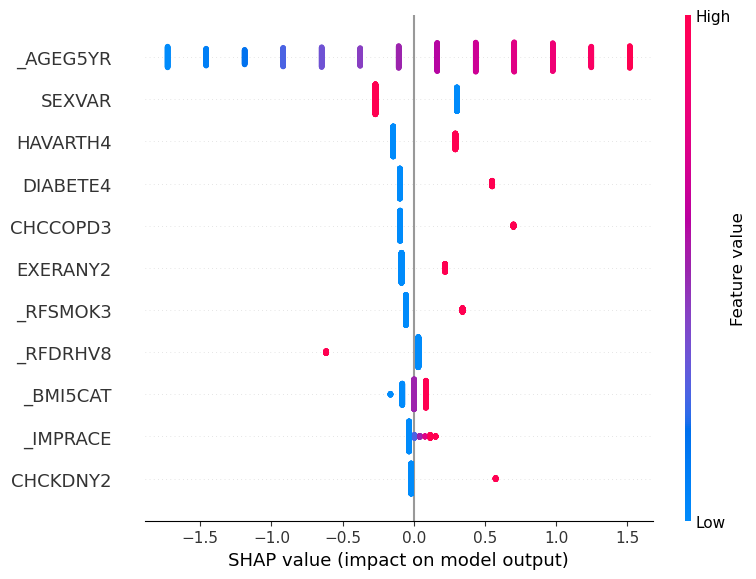

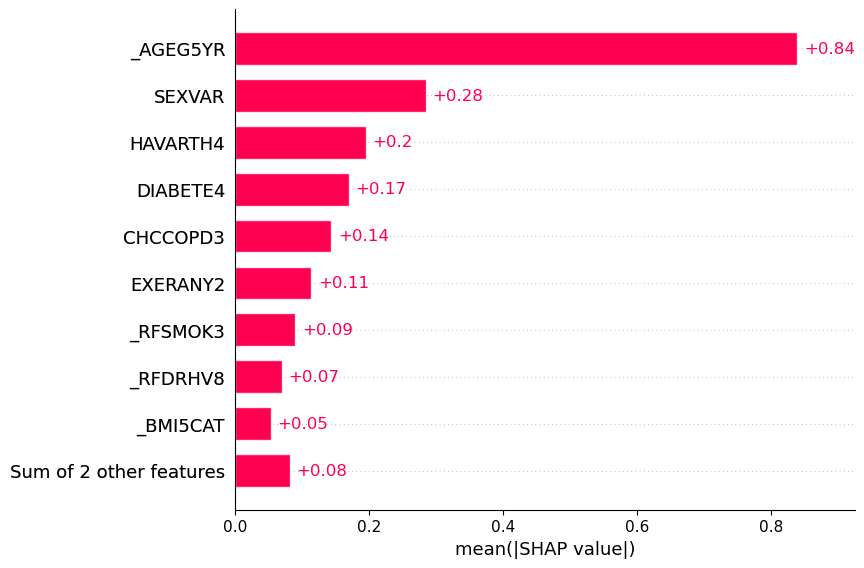

Valores SHAP para Gaussian Naive Bayes:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:23<00:00,  1.43s/it]


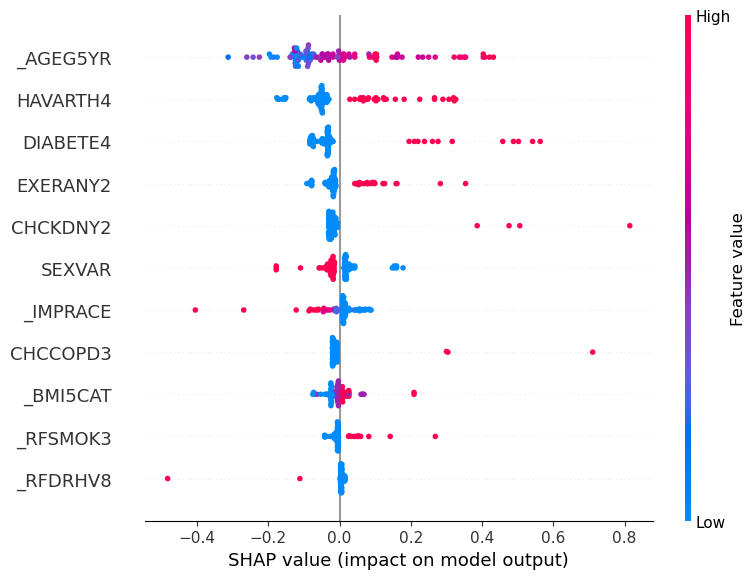

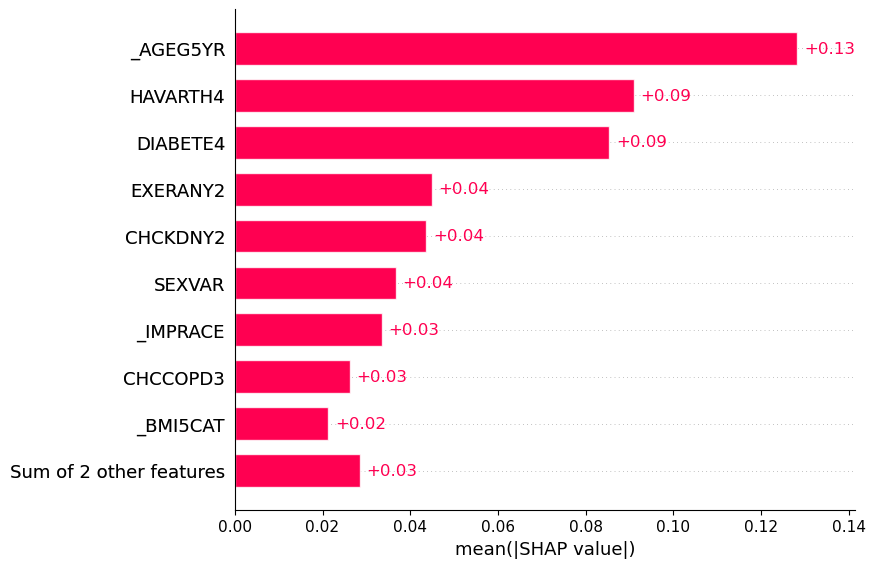

Valores SHAP para Light GBoost:


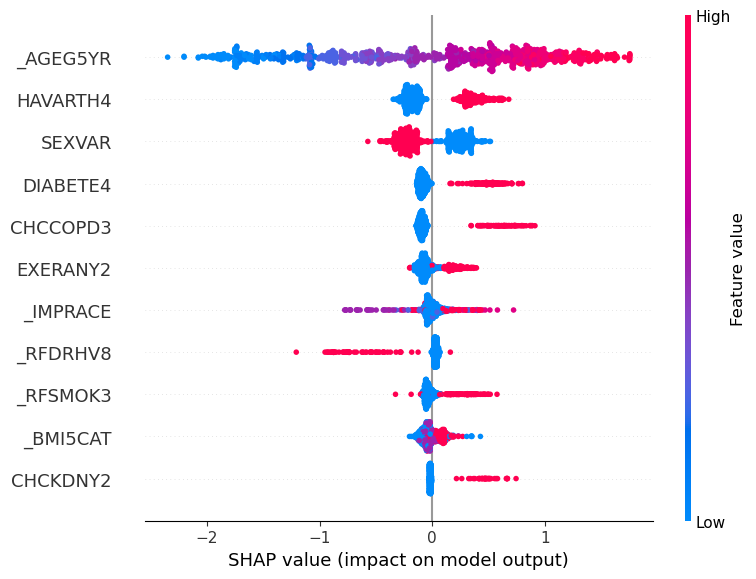

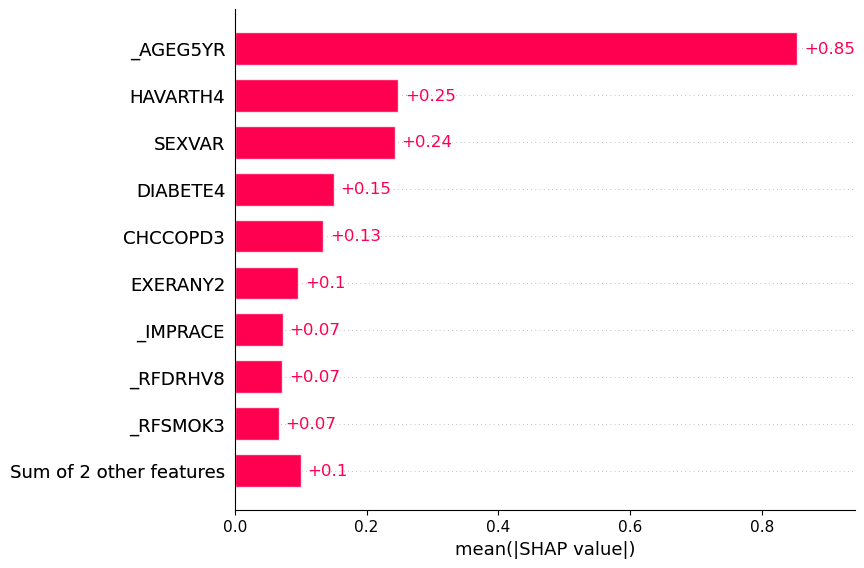

Valores SHAP para Random Forest:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [02:48<00:00,  2.24s/it]


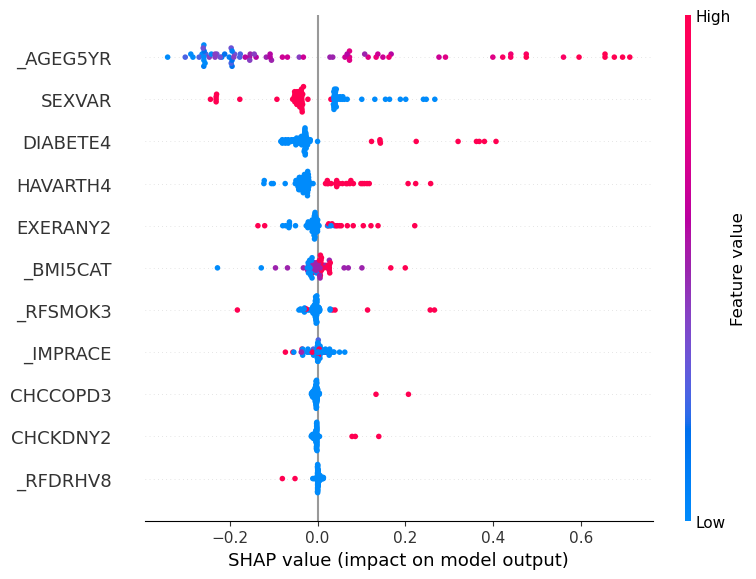

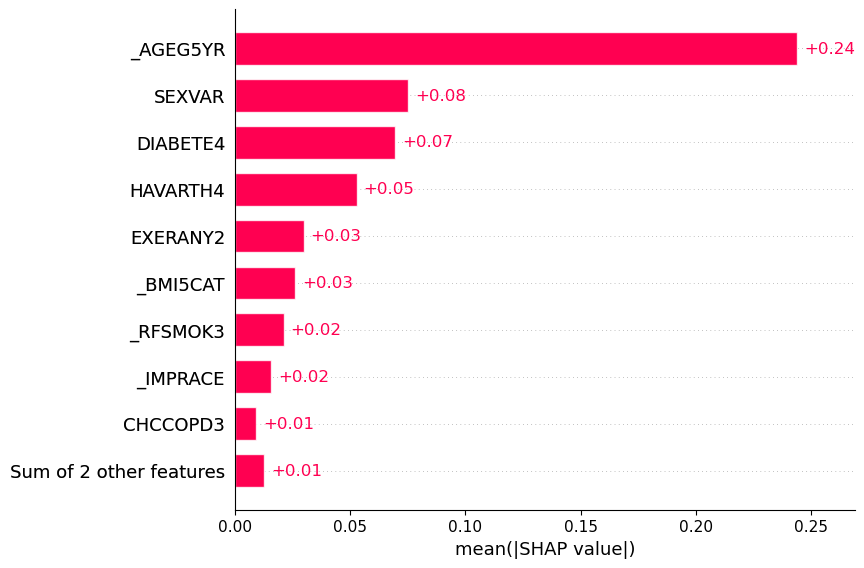

Valores SHAP para Neural Network:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [01:50<00:00,  1.47s/it]


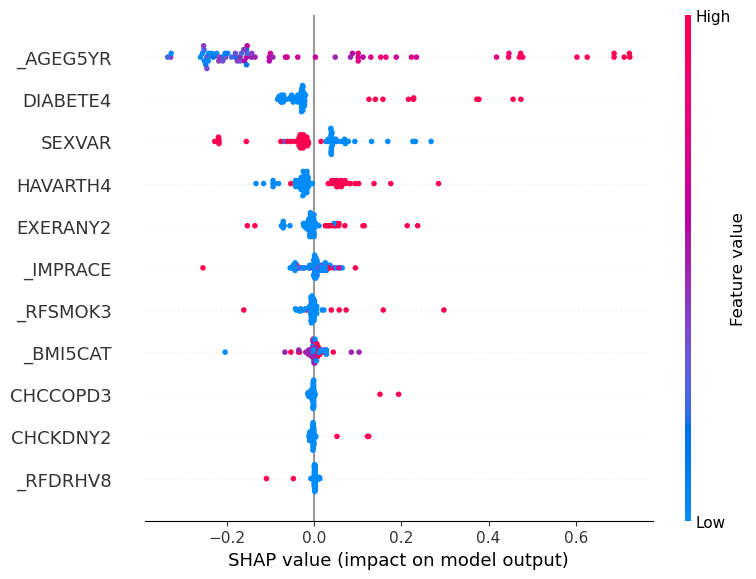

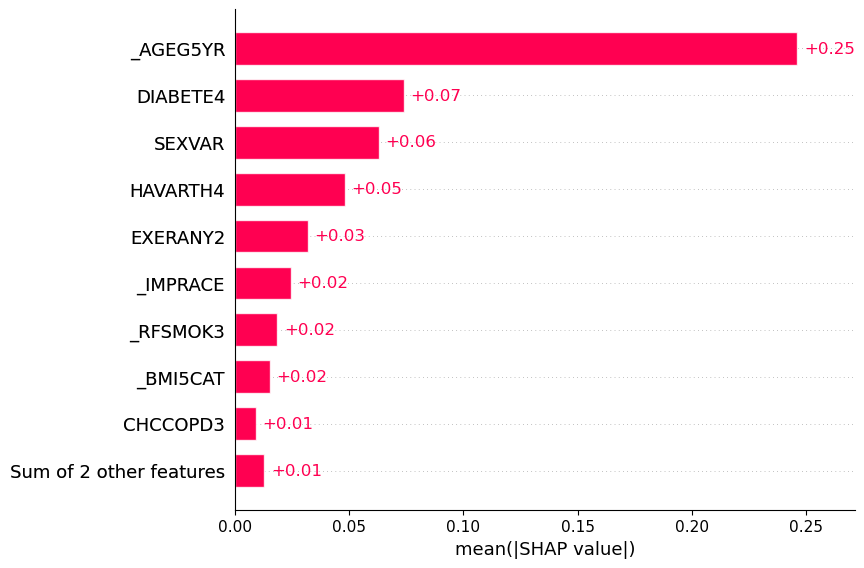

Valores SHAP para Easy Ensemble:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [05:42<00:00,  6.85s/it]


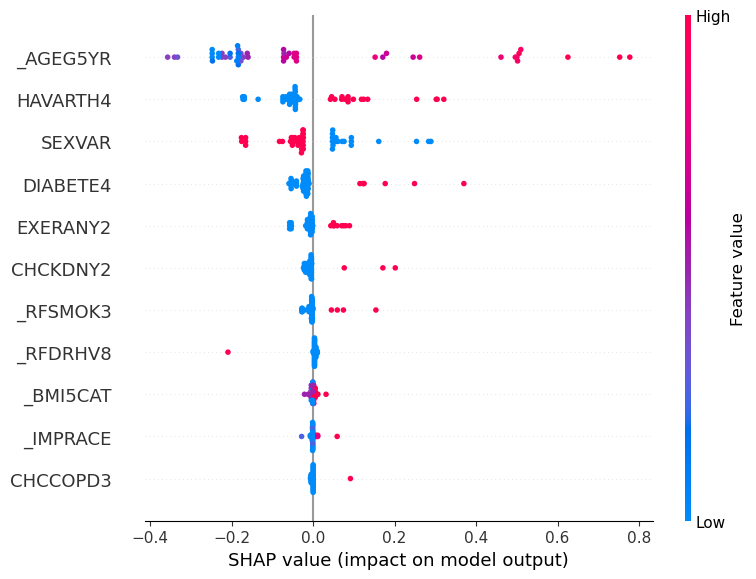

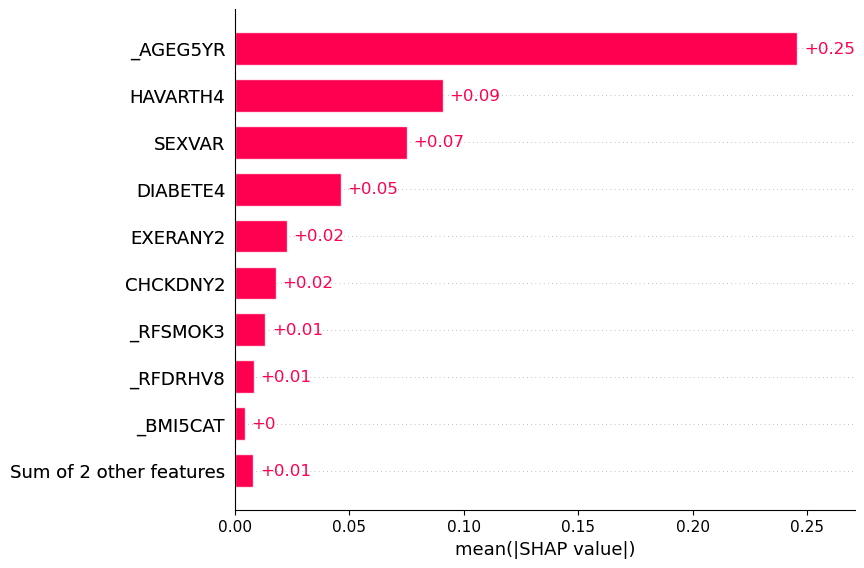

Valores SHAP para Voting:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [07:05<00:00,  8.51s/it]


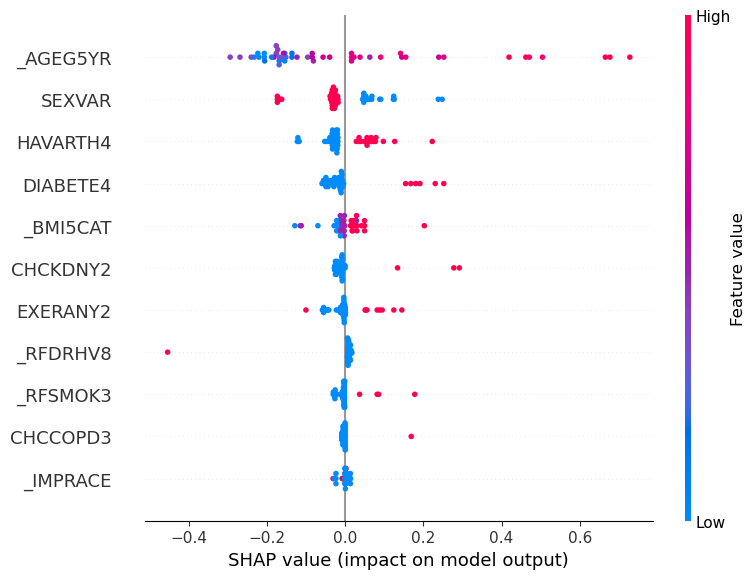

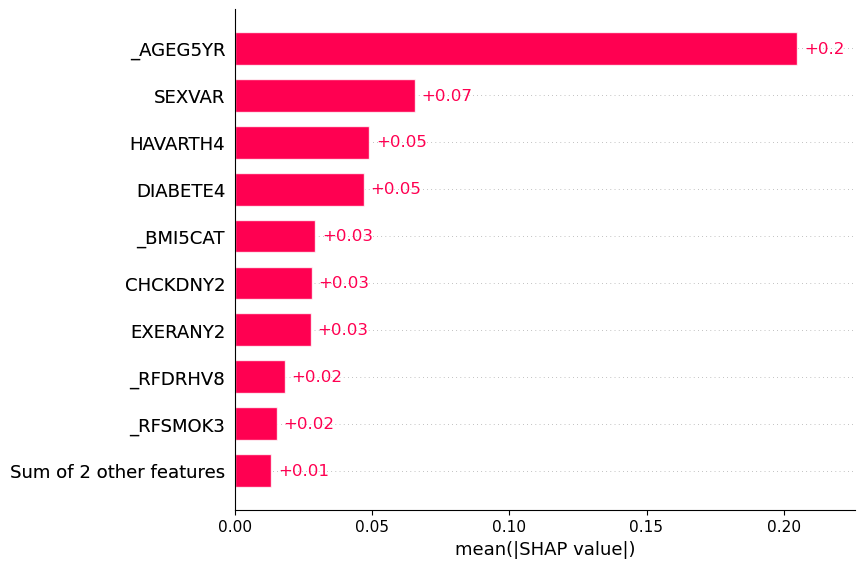

Valores SHAP para SVM:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:18<00:00,  1.38s/it]


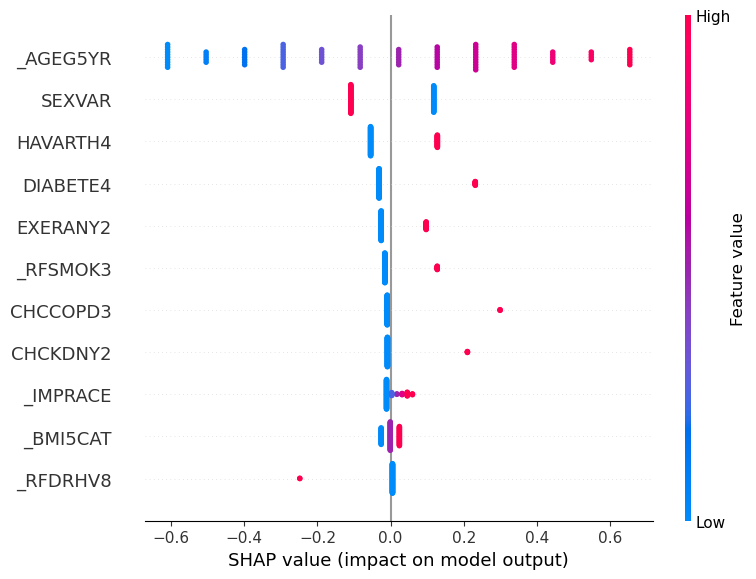

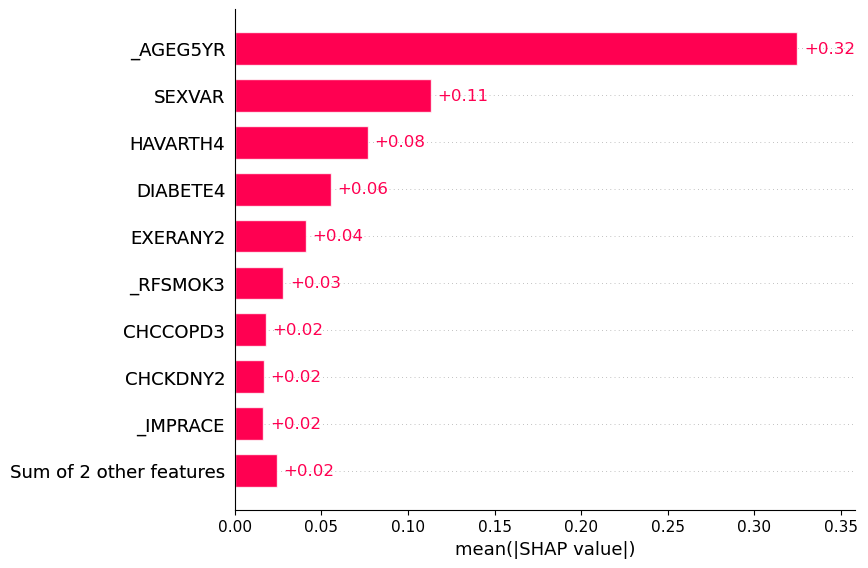

In [289]:
# Diccionario para mapear los tipos de modelo a sus correspondientes objetos explainer de SHAP
explainer_dict = {
    LogisticRegression: shap.LinearExplainer,
    GaussianNB: shap.KernelExplainer,
    LGBMClassifier: shap.TreeExplainer,
    RandomForestClassifier: shap.KernelExplainer,
    MLPClassifier: shap.KernelExplainer,
    EasyEnsembleClassifier: shap.KernelExplainer,
    VotingClassifier: shap.KernelExplainer,
    LinearSVC: shap.KernelExplainer    
    
}

# Diccionario para mapear los nombres de los modelos a sus correspondientes tamaños de muestra
sample_sizes = {
    'Logistic Regression': 1000,
    'Gaussian Naive Bayes': 100,
    'Light GBoost': 1000,
    'Random Forest': 75,
    'Neural Network': 75,
    'Easy Ensemble': 50,
    'SVM': 100,
    'Voting': 50
}

# Iterar sobre los modelos optimizados para graficar la importancia de las variables creadas por SHAP
for nombre, modelo in modelos_optimizados:
    print(f"Valores SHAP para {nombre}:")
    
    # Obtener el tamaño de muestra específico para el modelo actual
    sample_size = sample_sizes.get(nombre, 50)  # Valor predeterminado de 50 si no se encuentra el nombre del modelo
    
    # Tomar una muestra aleatoria de los datos de prueba para el cálculo de SHAP
    X_test_sample = shap.utils.sample(X_test, nsamples=sample_size, random_state=42)
    
    explainer_class = explainer_dict.get(type(modelo))
    if explainer_class is None:
        print(f"No se puede calcular los valores SHAP para {nombre}")
        continue
    
    if explainer_class == shap.KernelExplainer:
        if isinstance(modelo, LinearSVC):
            explainer = explainer_class(modelo.decision_function, X_test_sample)
        else:
            explainer = explainer_class(modelo.predict, X_test_sample)
    else:
        explainer = explainer_class(modelo, X_test_sample)
    
    shap_values = explainer(X_test_sample)
    
    # Graficar el Summary Plot de SHAP
    shap.summary_plot(shap_values, X_test_sample)
    plt.show()
    
    # Graficar el Bar Plot de SHAP
    shap.plots.bar(shap_values)
    plt.show()

#### Importancia y permutación de características

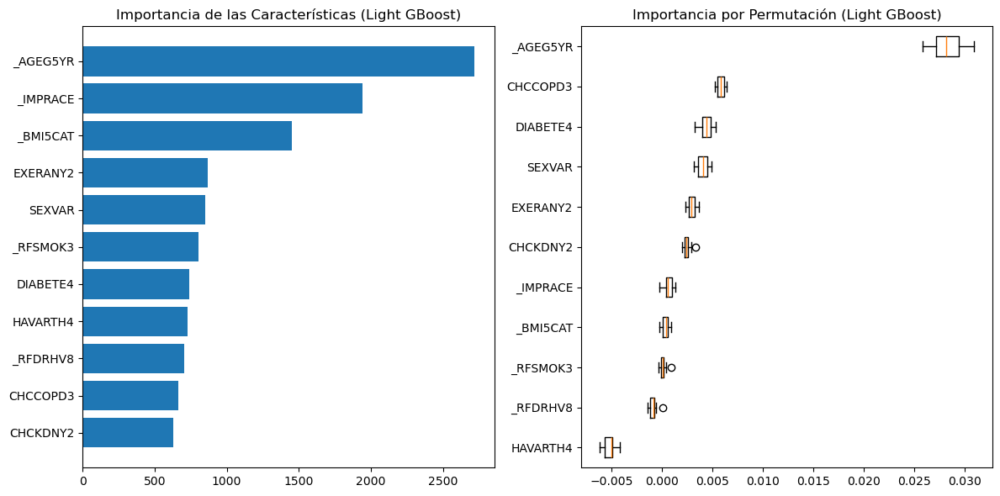

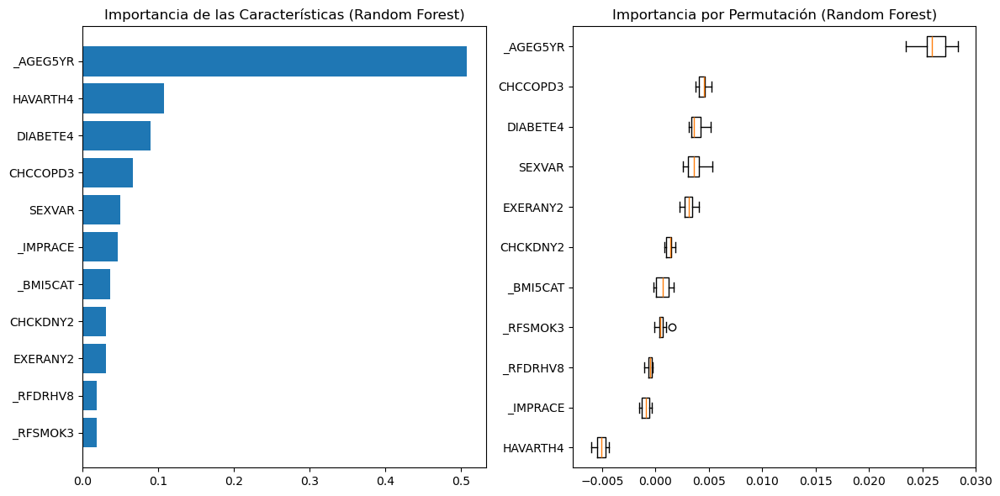

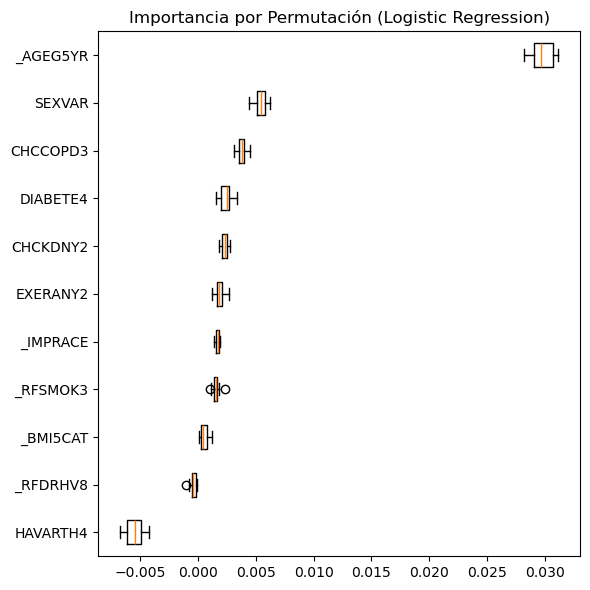

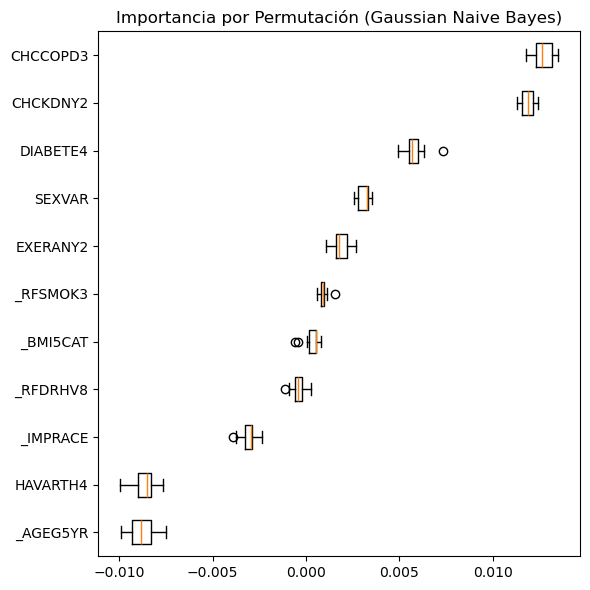

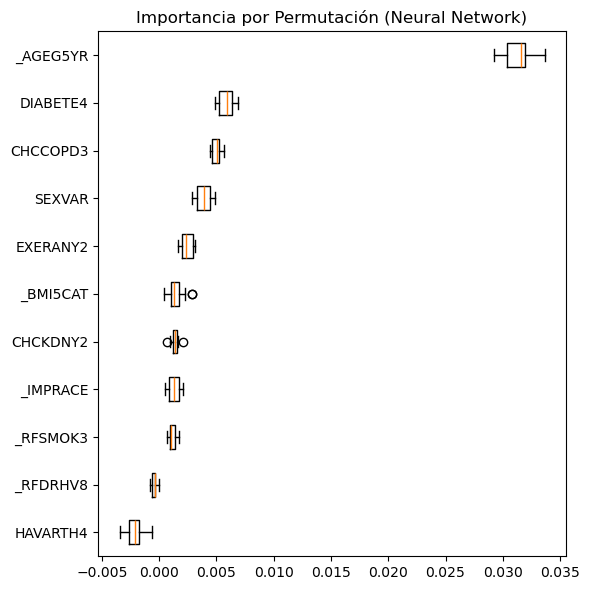

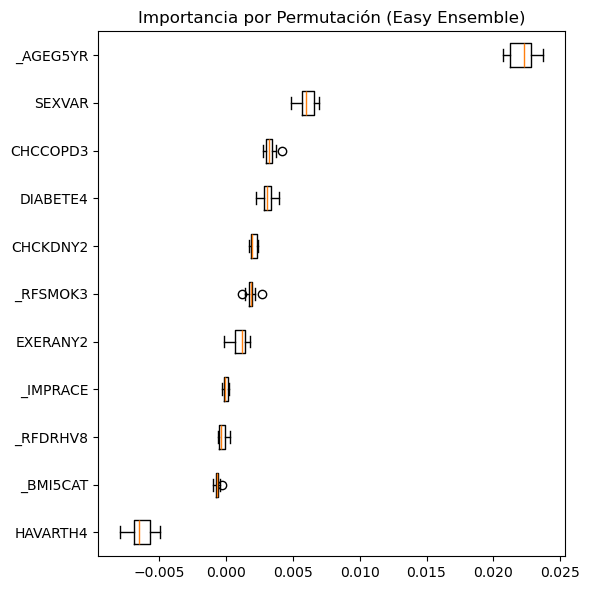

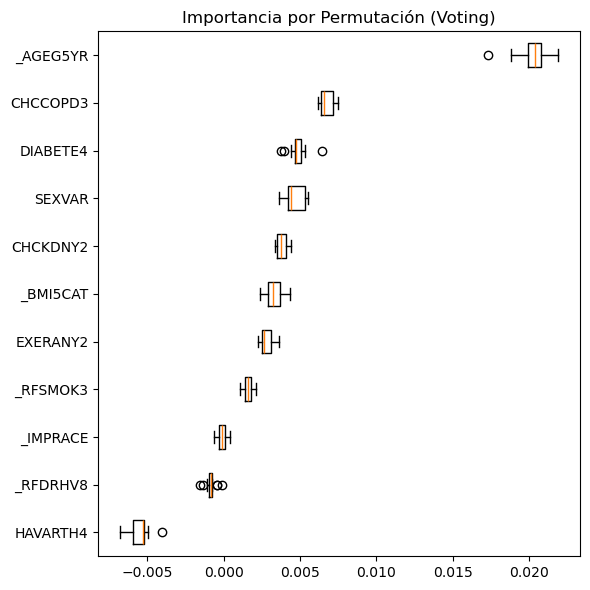

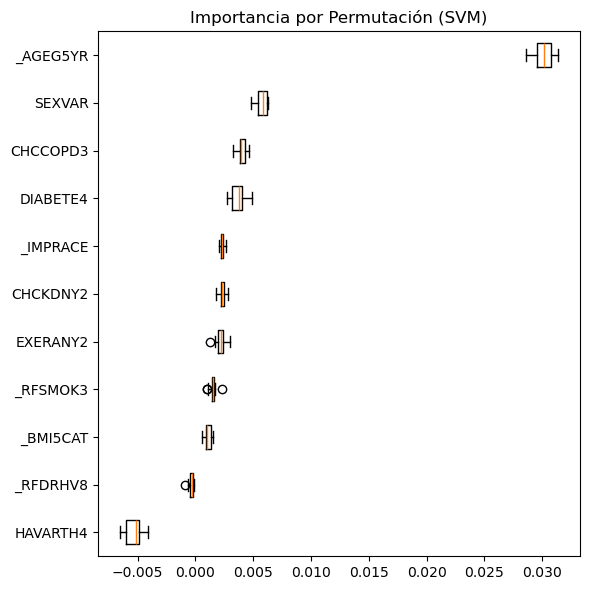

In [290]:
# Graficar importancia y permutación para los modelos con 11 variables
graficar_importancia_permutacion(modelos_optimizados, X_test, y_test, X)
graficar_permutacion_importancia(modelos_optimizados, X_test, y_test, X)

## MODELOS CON TODAS(29) LAS VARIABLES

In [291]:

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/SMOTETomek/modelos_iniciales_all"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los modelos base
modelos_base = [
    ('Logistic Regression', LogisticRegression(class_weight='balanced', max_iter=200, random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),
    ('Light GBoost', LGBMClassifier(class_weight='balanced', verbose=-1)),
    ('Random Forest', RandomForestClassifier(class_weight='balanced', n_estimators=500, min_samples_split=2,
                                             max_depth=5, min_samples_leaf=1, random_state=42)),
    ('Neural Network', MLPClassifier(early_stopping=True, random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble = [   
    ('Voting', VotingClassifier(estimators=modelos_base, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(class_weight='balanced', C=100.0, random_state=42, dual=False))
]

# Combinar todos los modelos
modelos = modelos_base + modelos_ensamble

# Crear el objeto de la técnica de muestreo SMOTETomek
tecnica_muestreo = SMOTETomek(random_state=42)

# Entrenar y evaluar modelos con todas las variables
resultados_allvars, X, X_train, y_train, X_val, y_val, X_test, y_test = entrenar_evaluar_modelos_base(
    df, modelos, carpeta_modelos, tecnica_muestreo)


Dimensiones del conjunto de entrenamiento:
X_train: (436306, 29), y_train: (436306,)

Dimensiones del conjunto de validación:
X_val: (53095, 29), y_val: (53095,)

Dimensiones del conjunto de prueba:
X_test: (53096, 29), y_test: (53096,)

Tiempo de muestreo: 44.00 minutos

Modelo Logistic Regression cargado desde archivo.
Entrenamiento Logistic Regression:
Tiempo de ejecución: 0.07 minutos
Accuracy: 0.7478214830875578
F1-score: 0.7548095672113758
Precision: 0.7344571269970683
Recall: 0.7763221225470197
AUC-ROC: 0.8220022150700121
Matthews Corr Coef: 0.4964501418125883

MATRIZ DE CONFUSIÓN:
[[156922  61231]
 [ 48796 169357]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.76      0.72      0.74    218153
           1       0.73      0.78      0.75    218153

    accuracy                           0.75    436306
   macro avg       0.75      0.75      0.75    436306
weighted avg       0.75      0.75      0.75    436306



Test Logistic

### Tabla de métricas de rendimiento modelos base

In [292]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_allvars_inicial = pd.DataFrame.from_dict(resultados_allvars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_allvars_inicial

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.714536,0.357291,0.239770,0.700765,0.778630,0.280853,0.072652
Gaussian Naive Bayes,0.734500,0.374884,0.255578,0.703094,0.777205,0.302161,0.004930
Light GBoost,0.719018,0.356302,0.240548,0.686793,0.778180,0.277712,0.040562
Random Forest,0.679825,0.362053,0.233766,0.802395,0.808238,0.303302,2.089385
Neural Network,0.705967,0.348033,0.232352,0.693114,0.770323,0.268481,1.555697
Easy Ensemble,0.703932,0.362944,0.239927,0.744844,0.792332,0.294379,4.531697
Voting,0.721354,0.376974,0.252382,0.744511,0.803354,0.311002,5.186002
SVM,0.709149,0.356193,0.237663,0.710579,0.779291,0.280936,0.031504


### BÚSQUEDA DE HIPERPARAMETROS

In [293]:

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelos/SMOTETomek/modelos_entrenados_all"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)


In [294]:

# Definir los espacios de búsqueda de hiperparámetros para cada modelo
param_dist_lr = {
    'class_weight': ['balanced', None],
    'solver': ['newton-cg', 'newton-cholesky', 'sag', 'saga'],
    'penalty': ['l2'],
    'C': loguniform(1e-4, 1e1)
}

param_dist_gnb = {
    'var_smoothing': loguniform(1e-9, 1e-1)
}

param_dist_lgbm = {
    'class_weight': ['balanced', None],
    'n_estimators': randint(50, 251),
    'max_depth': randint(3, 31),
    'subsample': uniform(0.7, 0.3),
    'colsample_bytree': uniform(0.7, 0.3),
    'learning_rate': loguniform(1e-5, 1e-1),
    'num_leaves': randint(10, 101),
    'verbose': [-1]
}

param_dist_rf = {
    'class_weight': ['balanced_subsample', 'balanced'],
    'n_estimators': randint(50, 251),
    'criterion': ['gini', 'entropy'],
    'max_depth': randint(3, 16),
    'min_samples_leaf': randint(3, 16),
    'min_samples_split': randint(3, 16),
    'max_features': [None, 'sqrt', 'log2']
}

param_dist_ann = {
    'hidden_layer_sizes': [(100,), (50,50), (100,100), (50, 50, 50),
                           (100, 100, 100), (50, 50, 50, 50), (100, 100, 100, 100),
                           (50, 50, 50, 50, 50), (100, 100, 100, 100, 100)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': loguniform(1e-5, 1e3),
    'batch_size': [64, 128, 256, 512],
    'learning_rate': ['constant', 'adaptive'],
    'learning_rate_init': loguniform(1e-5, 1e-1),
    'early_stopping': [True],
    'max_iter': [100]
}

param_dist_eec = {
    'n_estimators': randint(2, 20),
    'sampling_strategy': ['auto']
}

param_dist_svm = {
    'dual': ['auto'],
    'tol': loguniform(1e-5, 1e-3),
    'class_weight': [None, 'balanced'],
    'penalty': ['l2'],
    'loss': ['hinge', 'squared_hinge'],
    'C': loguniform(1e-4, 1e4),
    'max_iter': randint(1000, 2001)
}

# Definir los modelos con búsqueda de hiperparámetros
modelos = [
    ('Logistic Regression', RandomizedSearchCV(LogisticRegression(), param_dist_lr,
                                               cv=30, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Gaussian Naive Bayes', RandomizedSearchCV(GaussianNB(), param_dist_gnb, cv=30,
                                                n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('Light GBoost', RandomizedSearchCV(LGBMClassifier(), param_dist_lgbm, cv=5, n_jobs=6,
                                        scoring='f1_weighted', n_iter=50)),
    ('Random Forest', RandomizedSearchCV(RandomForestClassifier(), param_dist_rf,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Neural Network', RandomizedSearchCV(MLPClassifier(), param_dist_ann, cv=5, n_jobs=6,
                                          scoring='f1_weighted', error_score=0, n_iter=50)),
    ('Easy Ensemble', RandomizedSearchCV(EasyEnsembleClassifier(), param_dist_eec,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('SVM', RandomizedSearchCV(LinearSVC(), param_dist_svm, cv=5, n_jobs=6,
                               scoring='f1_weighted', n_iter=50))
]

# Crear un diccionario para almacenar los mejores hiperparámetros de cada modelo
best_params_all = {}

# Entrenar y evaluar cada modelo con búsqueda de hiperparámetros
for nombre, modelo in modelos:
    nombre_archivo = f"{carpeta_modelos}/{nombre}_optimizado.pkl"
    
    # Hash del conjunto de datos actual
    hash_actual = hash_de_datos(X_train)
    
    # Cargar o entrenar modelo
    modelo_cargado, tiempo_ejecucion, mejores_parametros_cargados = cargar_modelo(nombre_archivo, hash_actual)
    
    if modelo_cargado is not None:
        print(f"Modelo {nombre} cargado desde archivo.")
        modelo_best_all = modelo_cargado
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros_cargados}")
        # Agregar los mejores hiperparámetros cargados al diccionario
        best_params_all[nombre] = mejores_parametros_cargados
    else:
        print(f"Entrenando nuevo modelo {nombre}.")
        inicio = time.time()  # Tiempo de inicio
        modelo.fit(X_train, y_train)
        
        mejores_parametros = modelo.best_params_
        
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros}")
        
        # Agregar los mejores hiperparámetros al diccionario
        best_params_all[nombre] = modelo.best_params_
        
        # Entrenar el modelo con los mejores hiperparámetros en el conjunto de entrenamiento completo
        modelo_best_all = modelo.best_estimator_
        modelo_best_all.fit(X_train, y_train)
        
        fin = time.time()  # Tiempo de fin
        tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos
        
        # Guardar el modelo entrenado junto con el tiempo de ejecución y los mejores parámetros
        guardar_modelo(modelo_best_all, nombre_archivo, hash_actual, tiempo_ejecucion, mejores_parametros)

    # Métricas predicción entrenamiento
    y_pred_train = modelo_best_all.predict(X_train)

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_all, "predict_proba"):
        y_scores = modelo_best_all.predict_proba(X_train)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_all.decision_function(X_train)  # Puntuaciones de decisión
    
    print(f"Entrenamiento {nombre}:")
    print(f"Tiempo de búsqueda de hiperparámetros de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_train, y_pred_train)}")
    print(f"F1-score: {f1_score(y_train, y_pred_train)}")
    print(f"Precision: {precision_score(y_train, y_pred_train)}")
    print(f"Recall: {recall_score(y_train, y_pred_train)}")
    print(f"AUC-ROC: {roc_auc_score(y_train, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_train, y_pred_train)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_train, y_pred_train))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_train, y_pred_train))
    print("\n")

    # Métricas predicción validación
    inicio = time.time()  # Tiempo de inicio
    y_pred_val = modelo_best_all.predict(X_val)
    fin = time.time()  # Tiempo de fin
    tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_all, "predict_proba"):
        y_scores = modelo_best_all.predict_proba(X_val)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_all.decision_function(X_val)  # Puntuaciones de decisión

    
    print(f"Validación {nombre}:")
    print(f"Tiempo de ejecución de predicción de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_val, y_pred_val)}")
    print(f"F1-score: {f1_score(y_val, y_pred_val)}")
    print(f"Precision: {precision_score(y_val, y_pred_val)}")
    print(f"Recall: {recall_score(y_val, y_pred_val)}")
    print(f"AUC-ROC: {roc_auc_score(y_val, y_scores)}")
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_val, y_pred_val)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_val, y_pred_val))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_val, y_pred_val))
    print("\n")

Modelo Logistic Regression cargado desde archivo.
Mejores hiperparámetros para Logistic Regression: {'C': 9.68212621196132, 'class_weight': None, 'penalty': 'l2', 'solver': 'newton-cg'}
Entrenamiento Logistic Regression:
Tiempo de búsqueda de hiperparámetros de Logistic Regression: 26.02 minutos
Accuracy: 0.747869614444908
F1-score: 0.7548470774908407
Precision: 0.7345199526393171
Recall: 0.7763312904246102
AUC-ROC: 0.8220040094320124
Matthews Corr Coef: 0.4965443500045735

MATRIZ DE CONFUSIÓN:
[[156941  61212]
 [ 48794 169359]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.76      0.72      0.74    218153
           1       0.73      0.78      0.75    218153

    accuracy                           0.75    436306
   macro avg       0.75      0.75      0.75    436306
weighted avg       0.75      0.75      0.75    436306



Validación Logistic Regression:
Tiempo de ejecución de predicción de Logistic Regression: 0.00 minutos
Accura

### Entrenar modelos con los mejores parámetros

In [295]:

# Combinar los conjuntos de entrenamiento y validación para todas las variables
X_train_val_allvars = pd.concat([X_train, X_val], ignore_index=True)
y_train_val_allvars = pd.concat([y_train, y_val], ignore_index=True)

# Definir los modelos con los mejores hiperparámetros
modelos_entrenados_all = [
    ('Logistic Regression', LogisticRegression(random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),    
    ('Light GBoost', LGBMClassifier(verbosity=-1, random_state=42)),
    ('Random Forest', RandomForestClassifier(random_state=42)),   
    ('Neural Network', MLPClassifier(random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble_all = [   
    ('Voting', VotingClassifier(estimators=modelos_entrenados_all, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(random_state=42)) 
]

# Combinar todos los modelos
modelos_optimizados_all = modelos_entrenados_all + modelos_ensamble_all

# Crear el objeto de la técnica de muestreo SMOTETomek
tecnica_muestreo = SMOTETomek(random_state=42)

# Entrenar y evaluar modelos con todas las variables
resultados_optimizados_allvars, roc_data, pr_data, modelos_optimizados_all = entrenar_evaluar_modelos(
    X_train_val_allvars, y_train_val_allvars, X_test, y_test, modelos_optimizados_all, best_params_all, carpeta_modelos,
    tecnica_muestreo
)



Tiempo de muestreo: 87.23 minutos

Modelo Logistic Regression cargado desde archivo.
Test Logistic Regression:
Mejores hiperparámetros para Logistic Regression: {'C': 9.68212621196132, 'class_weight': None, 'penalty': 'l2', 'solver': 'newton-cg'}
Tiempo de ejecución de entrenamiento: 0.03 minutos
Tiempo de ejecución de predicción: 0.00 minutos
Accuracy: 0.7148937773090251
F1-score: 0.356596395783747
Precision: 0.23949531856588263
Recall: 0.697771124417831
AUC-ROC: 0.7774144140852044
Matthews Corr Coef: 0.279587731452787

MATRIZ DE CONFUSIÓN:
[[33763 13321]
 [ 1817  4195]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.95      0.72      0.82     47084
           1       0.24      0.70      0.36      6012

    accuracy                           0.71     53096
   macro avg       0.59      0.71      0.59     53096
weighted avg       0.87      0.71      0.76     53096



Modelo Gaussian Naive Bayes cargado desde archivo.
Test Gaussian

### Tabla de métricas de rendimiento con los mejores parámetros

In [296]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_allvars_opt = pd.DataFrame.from_dict(resultados_optimizados_allvars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_allvars_opt

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.714894,0.356596,0.239495,0.697771,0.777414,0.279588,0.034511
Gaussian Naive Bayes,0.657922,0.345171,0.220345,0.796241,0.792666,0.281311,0.005304
Light GBoost,0.728059,0.349331,0.239570,0.644711,0.769113,0.263950,0.099317
Random Forest,0.724989,0.345026,0.236212,0.639721,0.769115,0.258112,9.829344
Neural Network,0.710976,0.335038,0.226532,0.643047,0.754377,0.246089,13.516018
Easy Ensemble,0.696248,0.356887,0.234711,0.744345,0.786325,0.286964,1.112912
Voting,0.719828,0.359676,0.242625,0.694943,0.787469,0.282912,13.330832
SVM,0.697435,0.351197,0.231906,0.723220,0.778055,0.276711,0.902508


### Visualizar comparación de rendimiento de curvas ROC-AUC Y PR-AUC

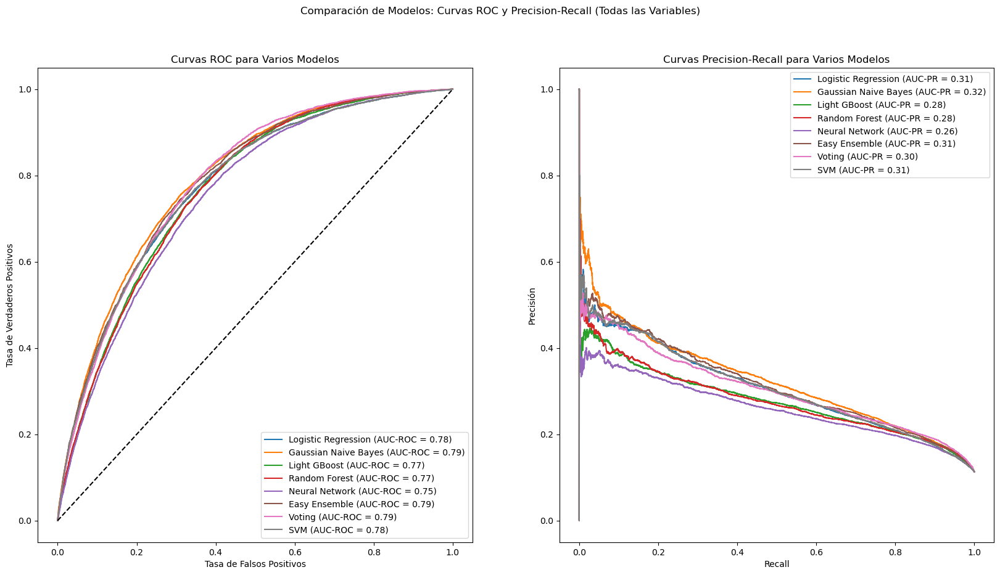

In [297]:
# Graficar curvas de rendimiento para los modelos con todas las variables
graficar_curvas_rendimiento(roc_data, pr_data, 
                            'Comparación de Modelos: Curvas ROC y Precision-Recall (Todas las Variables)')

### EXPLICABILIDAD

#### SHAP values

Valores SHAP para Logistic Regression:


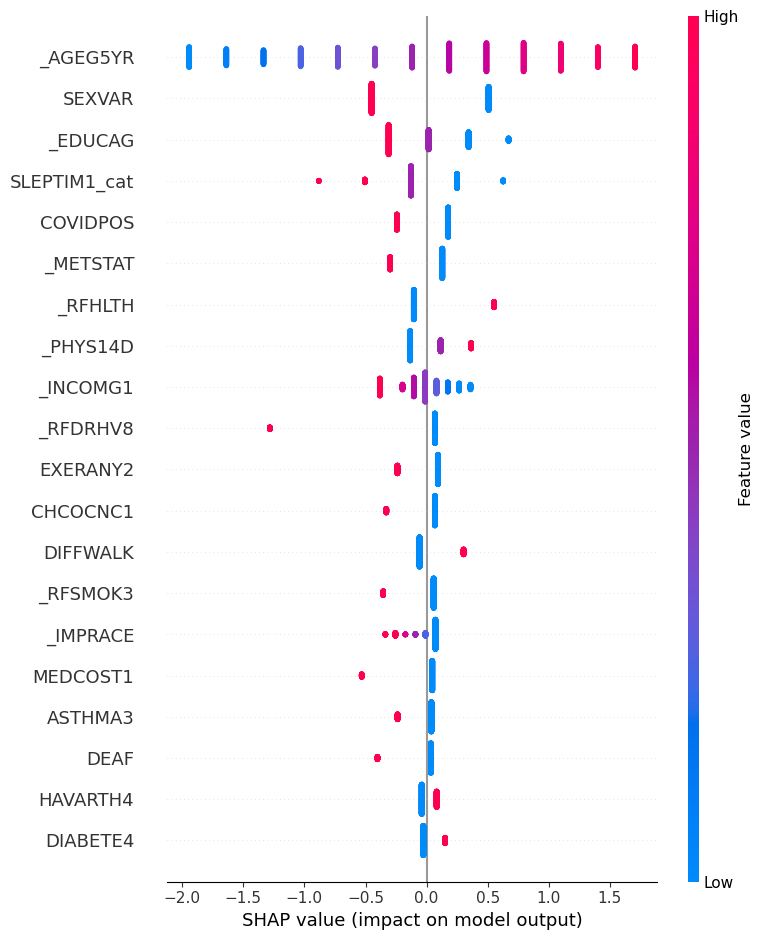

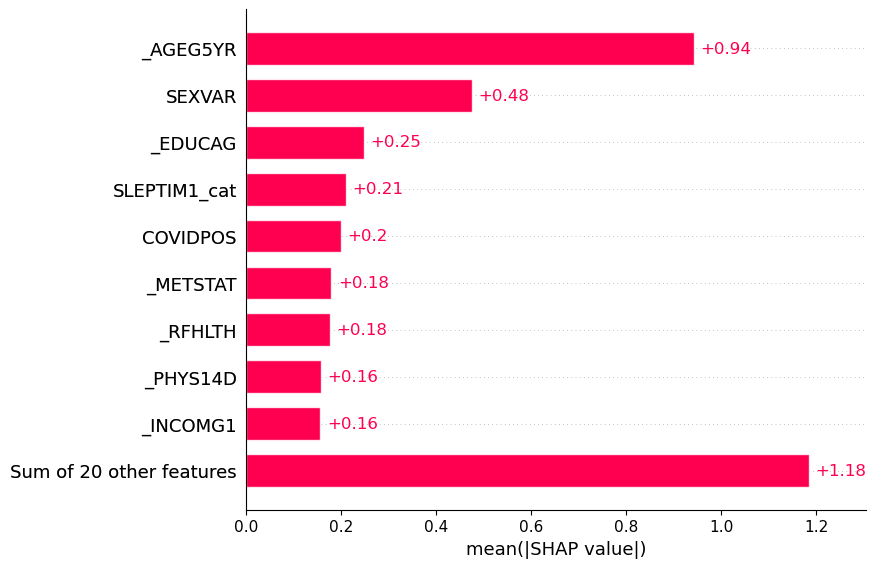

Valores SHAP para Gaussian Naive Bayes:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [03:02<00:00,  1.82s/it]


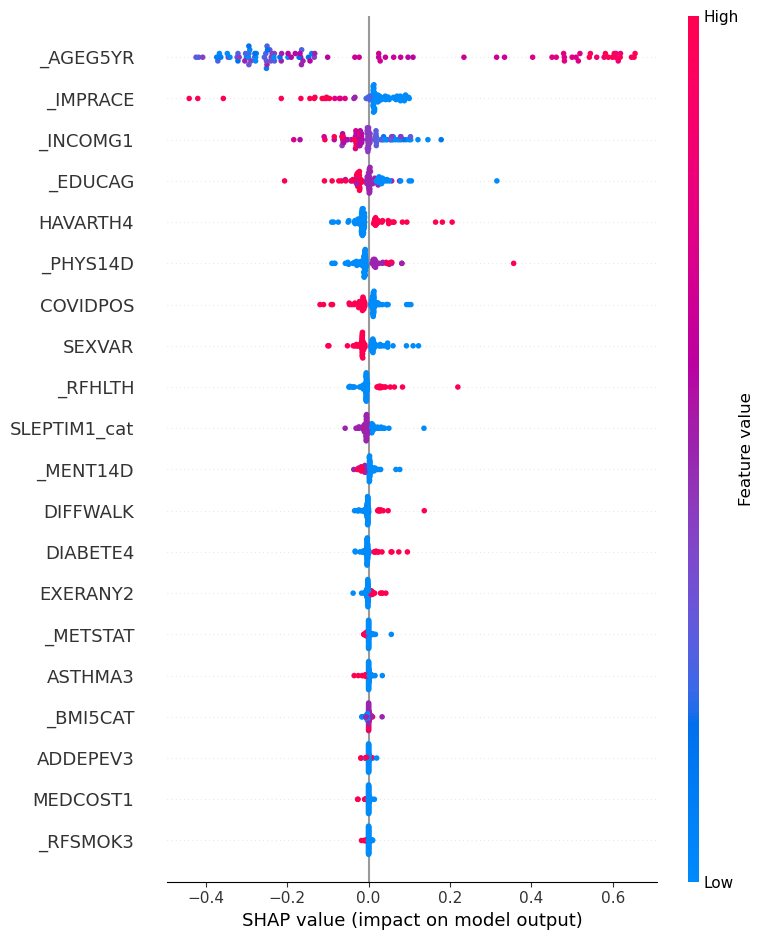

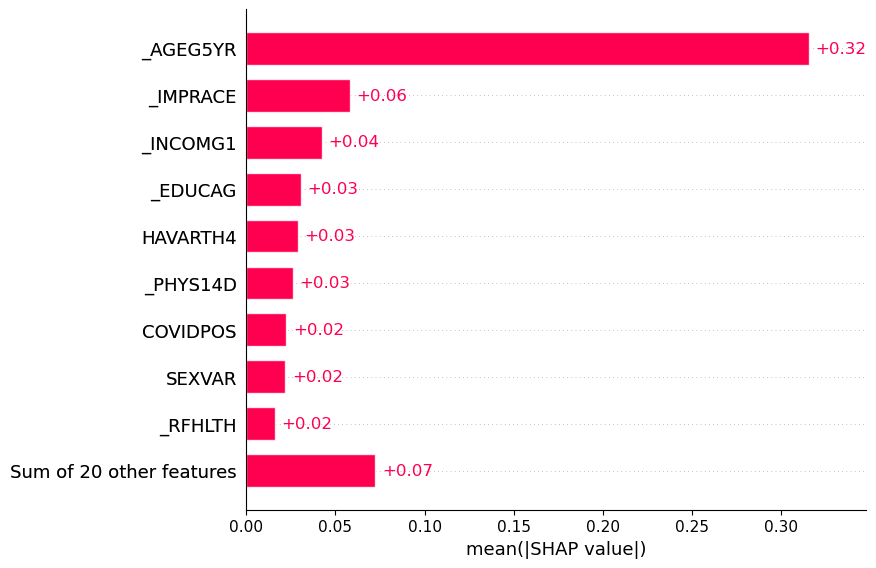

Valores SHAP para Light GBoost:


 98%|===================| 982/1000 [00:11<00:00]       

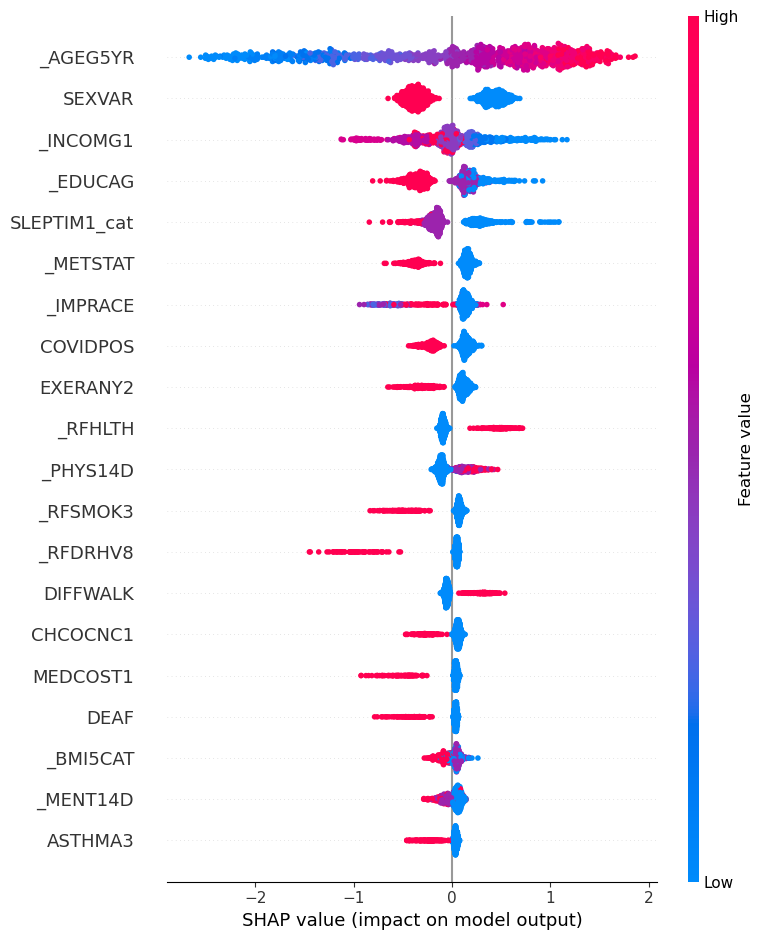

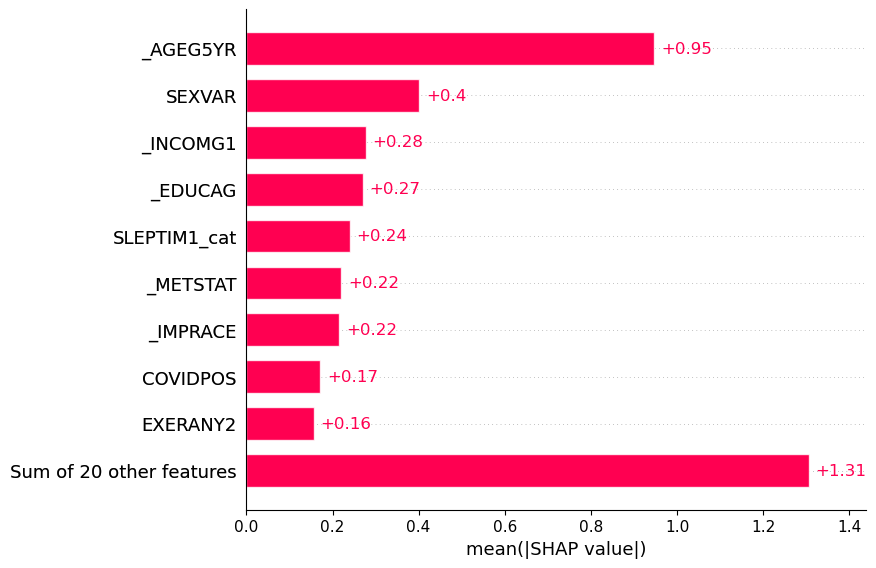

Valores SHAP para Random Forest:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [05:15<00:00,  4.20s/it]


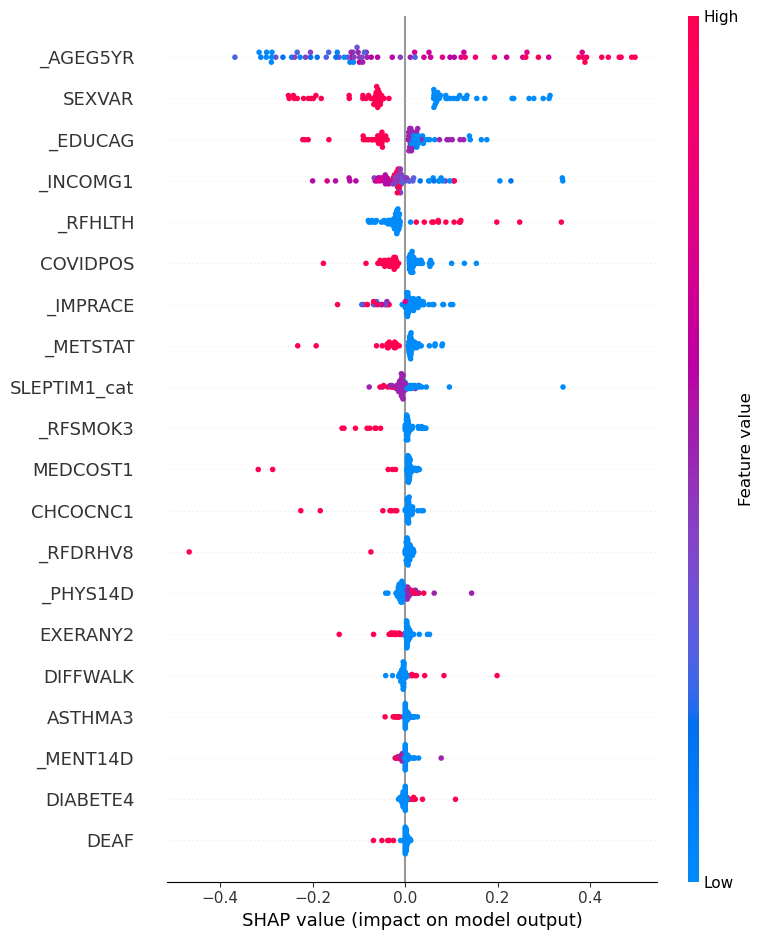

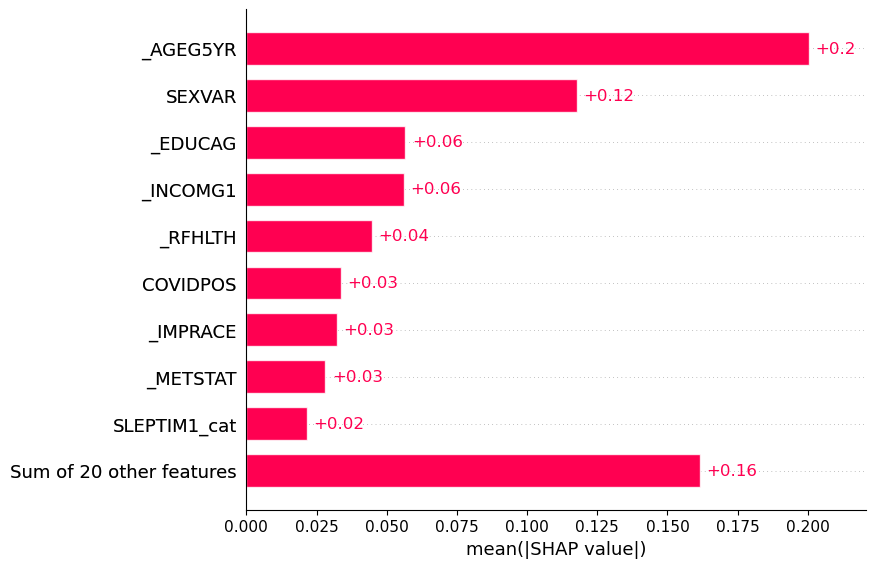

Valores SHAP para Neural Network:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [02:11<00:00,  1.75s/it]


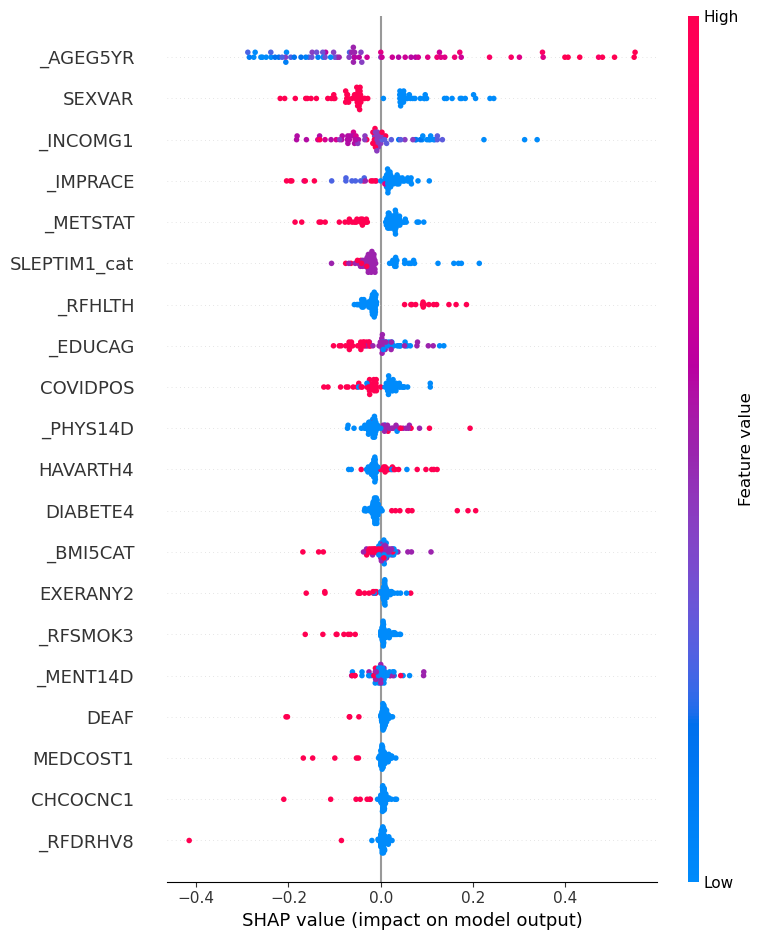

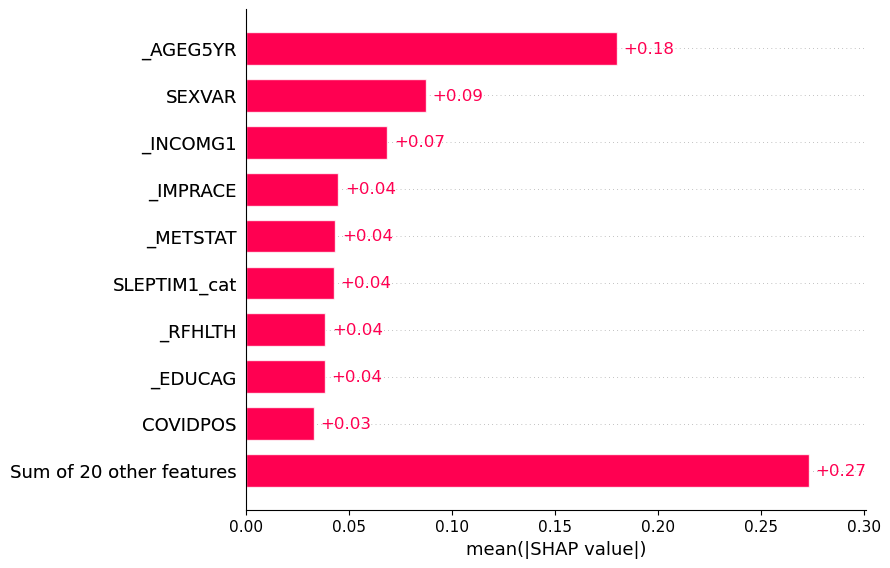

Valores SHAP para Easy Ensemble:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [01:58<00:00,  2.37s/it]


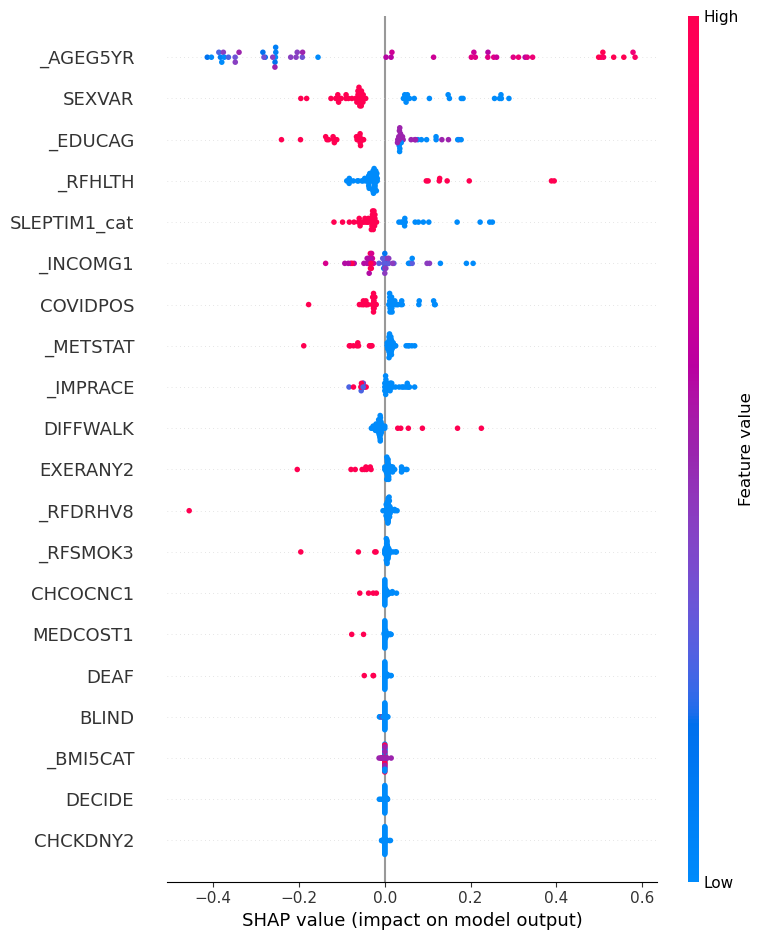

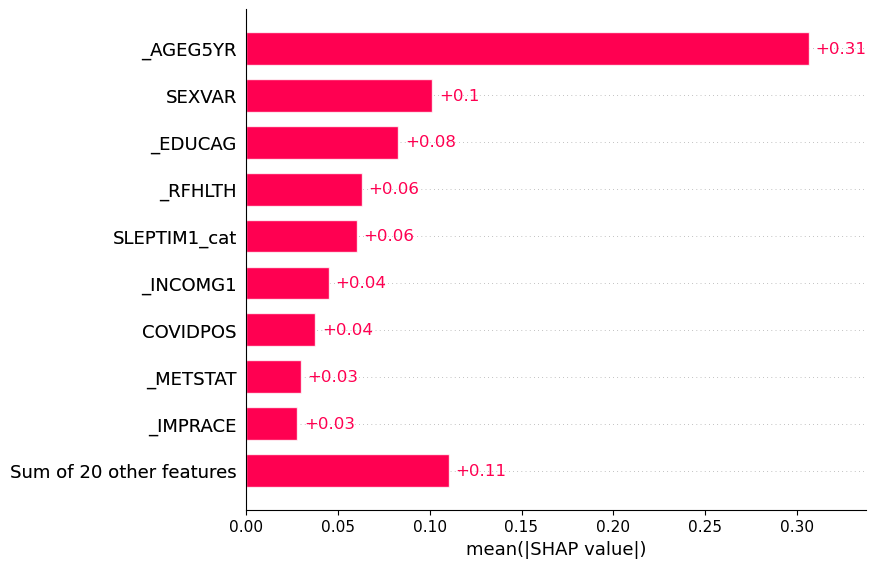

Valores SHAP para Voting:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [04:25<00:00,  5.31s/it]


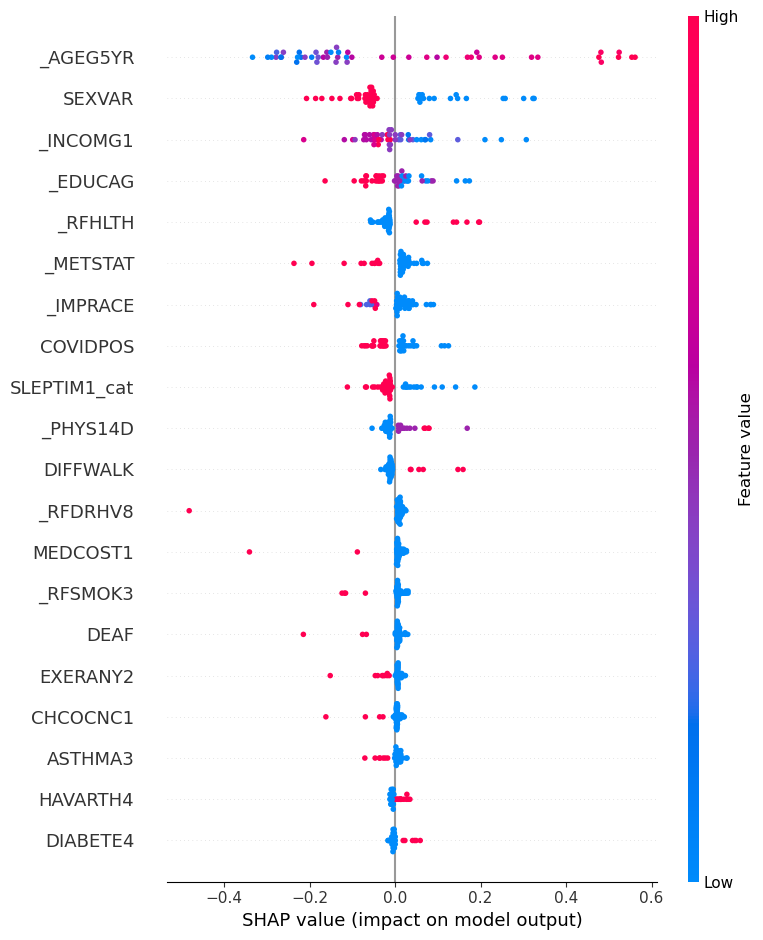

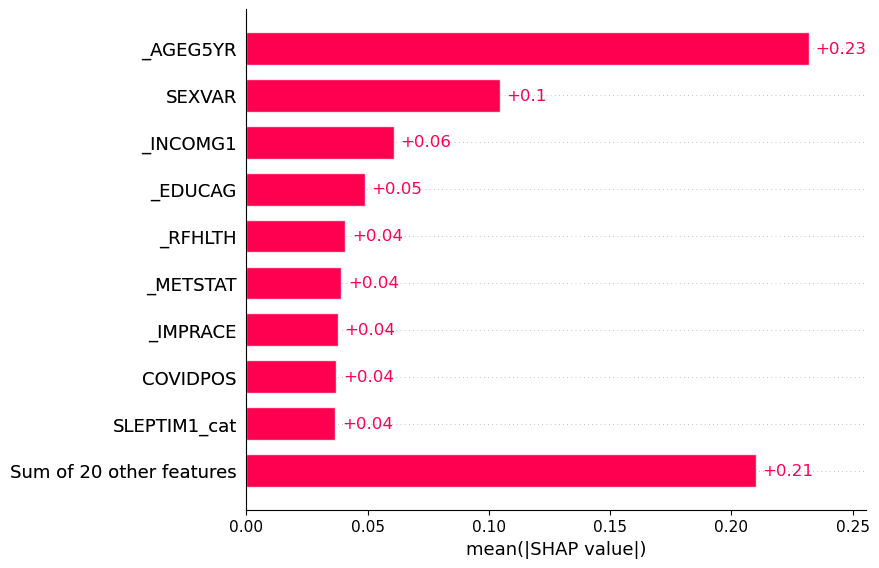

Valores SHAP para SVM:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:52<00:00,  1.73s/it]


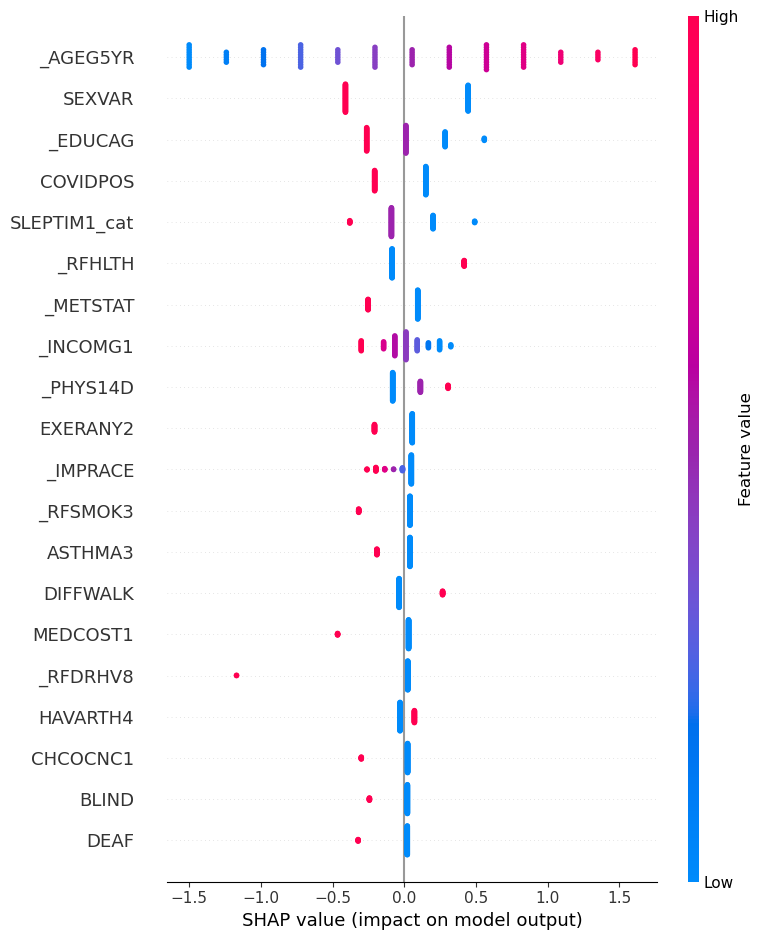

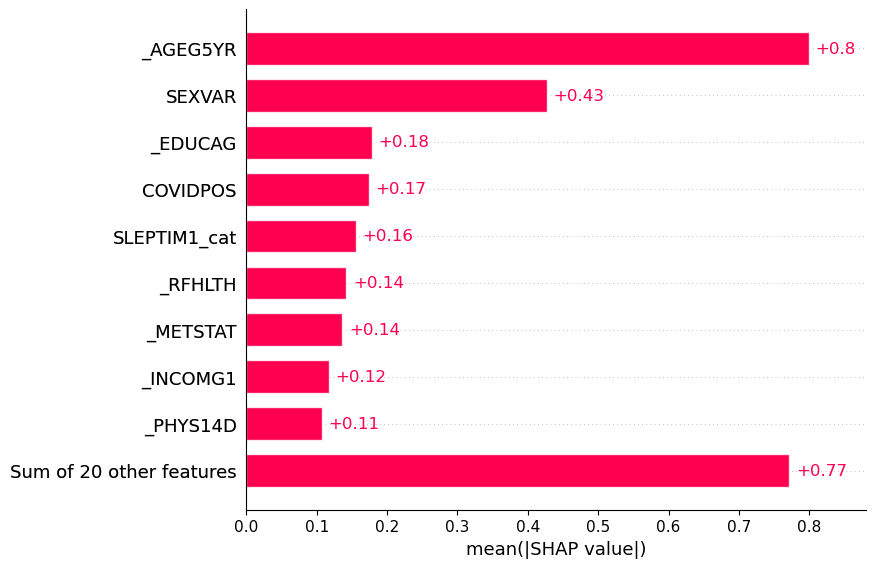

In [298]:
# Iterar sobre los modelos optimizados para graficar la importancia de las variables creadas por SHAP
for nombre, modelo in modelos_optimizados_all:
    print(f"Valores SHAP para {nombre}:")
    
    # Obtener el tamaño de muestra específico para el modelo actual
    sample_size = sample_sizes.get(nombre, 50)  # Valor predeterminado de 50 si no se encuentra el nombre del modelo
    
    # Tomar una muestra aleatoria de los datos de prueba para el cálculo de SHAP
    X_test_sample = shap.utils.sample(X_test, nsamples=sample_size, random_state=42)
    
    explainer_class = explainer_dict.get(type(modelo))
    if explainer_class is None:
        print(f"No se puede calcular los valores SHAP para {nombre}")
        continue
    
    if explainer_class == shap.KernelExplainer:
        if isinstance(modelo, LinearSVC):
            explainer = explainer_class(modelo.decision_function, X_test_sample)
        else:
            explainer = explainer_class(modelo.predict, X_test_sample)
    else:
        explainer = explainer_class(modelo, X_test_sample)
    
    shap_values = explainer(X_test_sample)
    
    # Graficar el Summary Plot de SHAP
    shap.summary_plot(shap_values, X_test_sample)
    plt.show()
    
    # Graficar el Bar Plot de SHAP
    shap.plots.bar(shap_values)
    plt.show()

#### Importancia y permutación de características

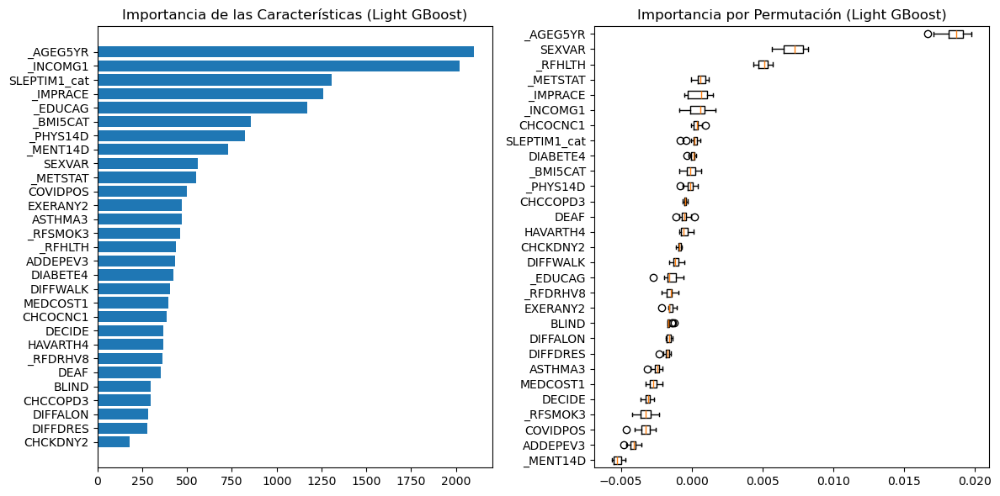

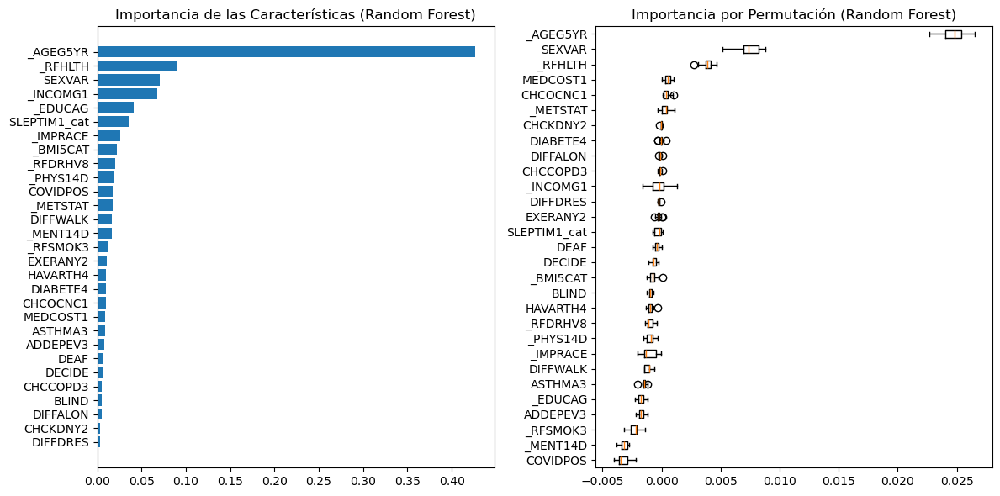

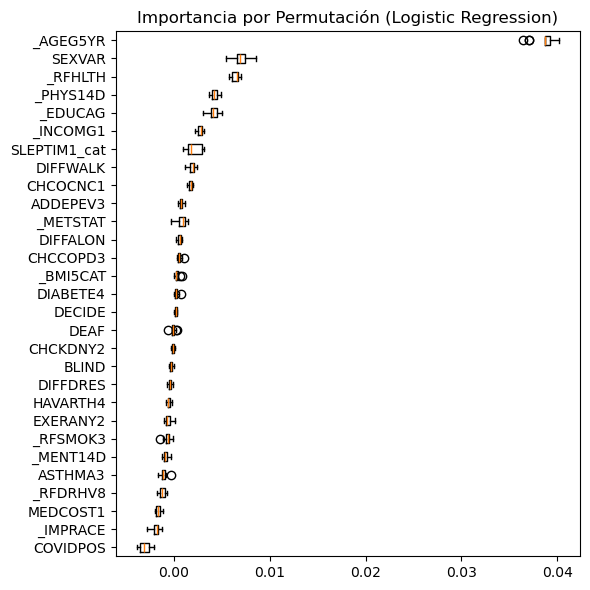

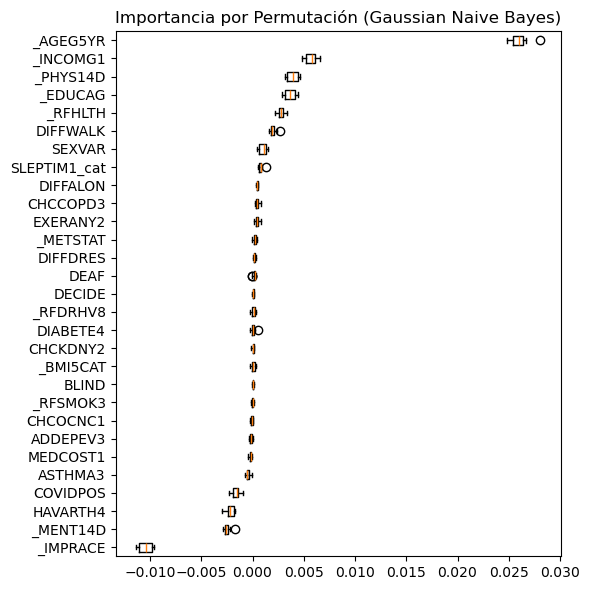

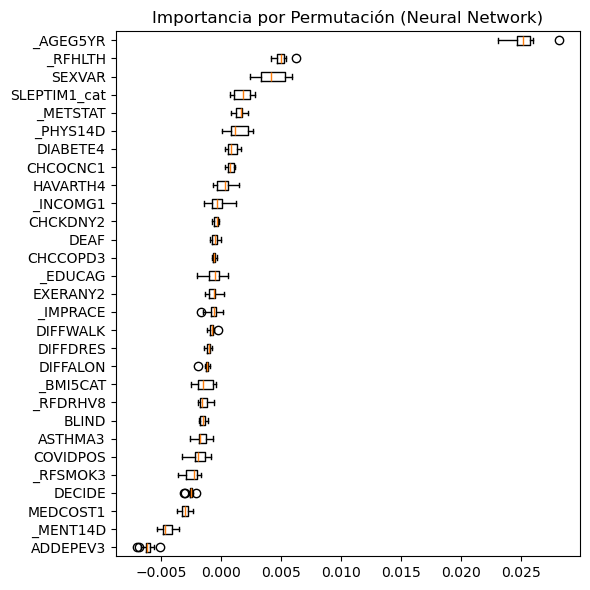

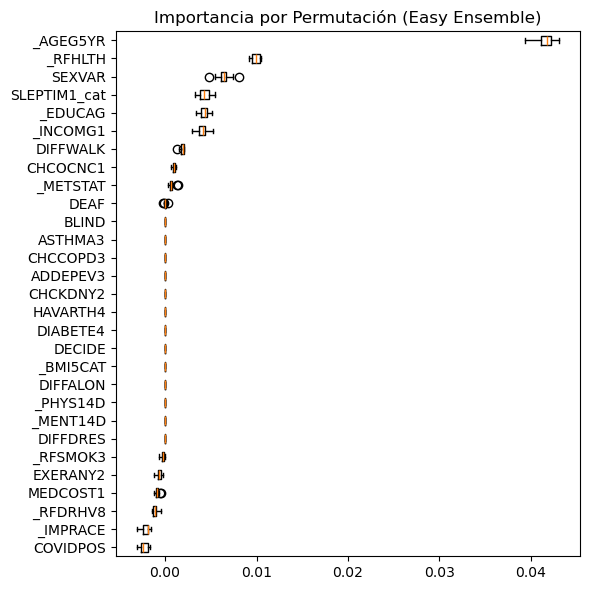

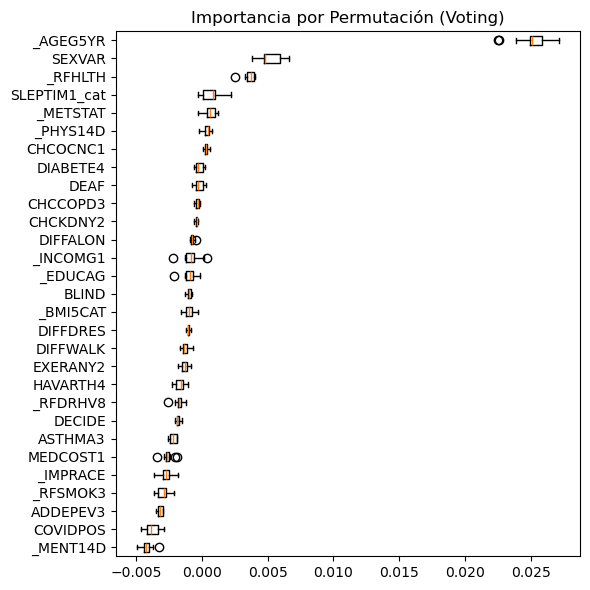

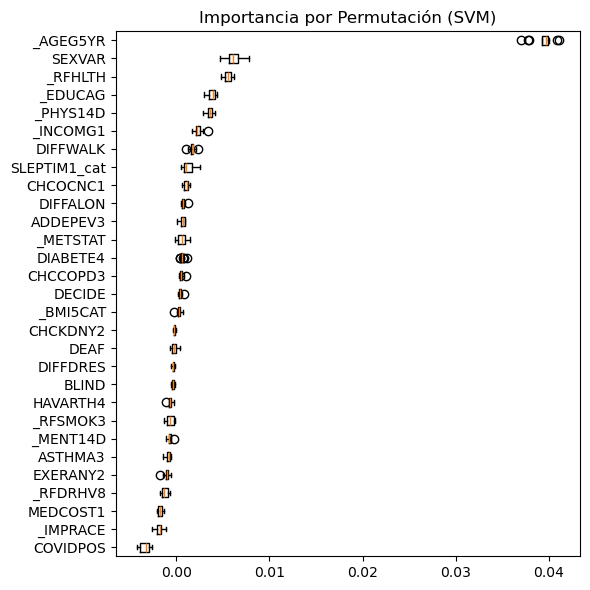

In [299]:
# Graficar importancia y permutación para los modelos con todas las variables
graficar_importancia_permutacion(modelos_optimizados_all, X_test, y_test, X)
graficar_permutacion_importancia(modelos_optimizados_all, X_test, y_test, X)

In [300]:
#Información de sesión
import session_info
session_info.show()

# ANEXO I

## Preprocesado

In [301]:
# Crear un nuevo DataFrame eliminando las filas con valores nulos
df_noNA_noimputed = datos.dropna()

# Identificar valores nulos por columna
df_noNA_noimputed.isnull().sum()

SEXVAR      0
MEDCOST1    0
EXERANY2    0
SLEPTIM1    0
CVDINFR4    0
CVDCRHD4    0
CVDSTRK3    0
ASTHMA3     0
CHCOCNC1    0
CHCCOPD3    0
ADDEPEV3    0
CHCKDNY2    0
HAVARTH4    0
DIABETE4    0
DEAF        0
BLIND       0
DECIDE      0
DIFFWALK    0
DIFFDRES    0
DIFFALON    0
COVIDPOS    0
_METSTAT    0
_IMPRACE    0
_RFHLTH     0
_PHYS14D    0
_MENT14D    0
_AGEG5YR    0
_BMI5CAT    0
_EDUCAG     0
_INCOMG1    0
_RFSMOK3    0
_RFDRHV8    0
dtype: int64

In [302]:
# Cambiar el tipo de datos de todas las columnas a entero
df_noNA_noimputed = df_noNA_noimputed.astype(int)

df_noNA_noimputed.head()

,SEXVAR,MEDCOST1,EXERANY2,SLEPTIM1,CVDINFR4,CVDCRHD4,CVDSTRK3,ASTHMA3,CHCOCNC1,CHCCOPD3,...,_IMPRACE,_RFHLTH,_PHYS14D,_MENT14D,_AGEG5YR,_BMI5CAT,_EDUCAG,_INCOMG1,_RFSMOK3,_RFDRHV8
1,2,2,2,6,2,2,2,2,1,2,...,1,1,1,1,13,3,2,3,1,1
2,2,2,1,5,2,2,2,2,2,2,...,1,1,2,2,8,3,4,6,1,1
3,2,2,1,7,2,2,2,1,2,2,...,1,1,1,1,14,2,2,9,2,1
4,2,2,1,9,2,2,2,2,2,2,...,1,2,2,1,5,2,3,3,1,1
5,1,2,2,7,1,2,1,2,2,2,...,1,2,2,1,13,3,2,9,1,1


In [303]:
import numpy as np

# Asignar 1 a los valores de 'CARDIO' que cumplen las condiciones, 0 a los que no cumplen, y 0 para los faltantes
df_noNA_noimputed['CARDIO'] = np.where((df_noNA_noimputed['CVDINFR4'] == 1) | 
                                       (df_noNA_noimputed['CVDCRHD4'] == 1) | 
                                       (df_noNA_noimputed['CVDSTRK3'] == 1), 1,
                              np.where((df_noNA_noimputed['CVDINFR4'] == 2) & 
                                       (df_noNA_noimputed['CVDCRHD4'] == 2) & 
                                       (df_noNA_noimputed['CVDSTRK3'] == 2), 0, 0))

In [304]:
# Función para categorizar las horas de sueño de la variable SLEPTIM1 en el dataset 
def categorizar_horas_sueño(horas):
    """
    Función para categorizar las horas de sueño con base en los siguientes rangos:
    - 1: Menos de 5 horas (sueño muy corto)
    - 2: 5-6 horas (sueño corto)
    - 3: 7-8 horas (sueño normal)
    - 4: 9-10 horas (sueño largo)
    - 5: Más de 10 horas (sueño muy largo)
    
    Parámetros:
    - horas: Número de horas de sueño (float o int)
    
    Retorna:
    - Categoría de horas de sueño (int)
    """
    
    # Comprobar en qué rango de horas se encuentra el valor
    if horas < 5:
        return 1
    elif horas < 7:
        return 2
    elif horas < 9:
        return 3
    elif horas < 11:
        return 4
    else:
        return 5

In [305]:
# Una vez creada la variable objetivo, se eliminan las 3 variables utilizadas para ello.
df_noNA_noimputed.drop(['CVDINFR4', 'CVDSTRK3', 'CVDCRHD4'], axis=1, inplace=True)

# Eliminar filas con valores 77 o 99 en la columna SLEPTIM1
df_noNA_noimputed = df_noNA_noimputed[(df_noNA_noimputed['SLEPTIM1'] != 77) & (df_noNA_noimputed['SLEPTIM1'] != 99)].copy()

# Obtener la posición de la última columna 'CARDIO'
last_column_pos = df_noNA_noimputed.columns.get_loc('CARDIO')

# Aplicar la función de categorización a la columna 'SLEPTIM1'
# e insertar la nueva columna 'SLEPTIM1_cat' antes de 'CARDIO'
df_noNA_noimputed.insert(last_column_pos, 'SLEPTIM1_cat', df_noNA_noimputed['SLEPTIM1'].apply(categorizar_horas_sueño))

In [306]:
# Eliminar columna después de crear la variable categorizada
df_noNA_noimputed.drop(['SLEPTIM1'], axis=1, inplace=True)

In [307]:
# Eliminar las filas que contienen los valores 7 y/o 9

df_noNA_noimputed = df_noNA_noimputed[(df_noNA_noimputed['MEDCOST1'] != 7) & (df_noNA_noimputed['MEDCOST1'] != 9)]
df_noNA_noimputed = df_noNA_noimputed[(df_noNA_noimputed['EXERANY2'] != 7) & (df_noNA_noimputed['EXERANY2'] != 9)]
df_noNA_noimputed = df_noNA_noimputed[(df_noNA_noimputed['ASTHMA3'] != 7) & (df_noNA_noimputed['ASTHMA3'] != 9)]
df_noNA_noimputed = df_noNA_noimputed[(df_noNA_noimputed['CHCOCNC1'] != 7) & (df_noNA_noimputed['CHCOCNC1'] != 9)]
df_noNA_noimputed = df_noNA_noimputed[(df_noNA_noimputed['CHCCOPD3'] != 7) & (df_noNA_noimputed['CHCCOPD3'] != 9)]
df_noNA_noimputed = df_noNA_noimputed[(df_noNA_noimputed['ADDEPEV3'] != 7) & (df_noNA_noimputed['ADDEPEV3'] != 9)]
df_noNA_noimputed = df_noNA_noimputed[(df_noNA_noimputed['CHCKDNY2'] != 7) & (df_noNA_noimputed['CHCKDNY2'] != 9)]
df_noNA_noimputed = df_noNA_noimputed[(df_noNA_noimputed['HAVARTH4'] != 7) & (df_noNA_noimputed['HAVARTH4'] != 9)]
df_noNA_noimputed = df_noNA_noimputed[(df_noNA_noimputed['DIABETE4'] != 7) & (df_noNA_noimputed['DIABETE4'] != 9)]
df_noNA_noimputed = df_noNA_noimputed[(df_noNA_noimputed['DEAF'] != 7) & (df_noNA_noimputed['DEAF'] != 9)]
df_noNA_noimputed = df_noNA_noimputed[(df_noNA_noimputed['BLIND'] != 7) & (df_noNA_noimputed['BLIND'] != 9)]
df_noNA_noimputed = df_noNA_noimputed[(df_noNA_noimputed['DECIDE'] != 7) & (df_noNA_noimputed['DECIDE'] != 9)]
df_noNA_noimputed = df_noNA_noimputed[(df_noNA_noimputed['DIFFWALK'] != 7) & (df_noNA_noimputed['DIFFWALK'] != 9)]
df_noNA_noimputed = df_noNA_noimputed[(df_noNA_noimputed['DIFFDRES'] != 7) & (df_noNA_noimputed['DIFFDRES'] != 9)]
df_noNA_noimputed = df_noNA_noimputed[(df_noNA_noimputed['DIFFALON'] != 7) & (df_noNA_noimputed['DIFFALON'] != 9)]
df_noNA_noimputed = df_noNA_noimputed[(df_noNA_noimputed['COVIDPOS'] != 7) & (df_noNA_noimputed['COVIDPOS'] != 9)]
df_noNA_noimputed = df_noNA_noimputed[(df_noNA_noimputed['_RFHLTH'] != 9)]
df_noNA_noimputed = df_noNA_noimputed[(df_noNA_noimputed['_PHYS14D'] != 9)]
df_noNA_noimputed = df_noNA_noimputed[(df_noNA_noimputed['_MENT14D'] != 9)]
df_noNA_noimputed = df_noNA_noimputed[(df_noNA_noimputed['_EDUCAG'] != 9)]
df_noNA_noimputed = df_noNA_noimputed[(df_noNA_noimputed['_RFSMOK3'] != 9)]
df_noNA_noimputed = df_noNA_noimputed[(df_noNA_noimputed['_RFDRHV8'] != 9)]
df_noNA_noimputed = df_noNA_noimputed[(df_noNA_noimputed['_AGEG5YR'] != 14)]

In [308]:
columnas_a_reemplazar = [
    'MEDCOST1', 'ASTHMA3', 'CHCOCNC1', 'CHCCOPD3', 'ADDEPEV3', 'CHCKDNY2',     
    'HAVARTH4', 'DEAF', 'BLIND', 'DECIDE', 'DIFFWALK', 'DIFFDRES', 'DIFFALON'
]

# Reemplazar los valores 2 por 0 en las columnas especificadas
df_noNA_noimputed[columnas_a_reemplazar] = df_noNA_noimputed[columnas_a_reemplazar].replace(2, 0)

In [309]:
# Este código reemplaza los valores 4 por 1, y los valores 2 y 3 por 0 en la columna 'DIABETE4'.
df_noNA_noimputed['DIABETE4'] = df_noNA_noimputed['DIABETE4'].replace({4: 1, 2: 0, 3: 0})

In [310]:
# Recodificar la variable COVIDPOS
df_noNA_noimputed['COVIDPOS'] = df_noNA_noimputed['COVIDPOS'].replace({3: 1, 2: 0})


In [311]:
# Cambiar los valores de las variables 'EXERANY2', '_RFHLTH', '_RFSMOK3' y '_RFDRHV8'
variables = ['EXERANY2','_RFHLTH', '_RFSMOK3',  '_RFDRHV8']
df_noNA_noimputed[variables] = df_noNA_noimputed[variables].replace({1: 0, 2: 1})

In [312]:
df_noNA_noimputed.info()

<class 'pandas.core.frame.DataFrame'>
Index: 320437 entries, 1 to 435824
Data columns (total 30 columns):
 #   Column        Non-Null Count   Dtype
---  ------        --------------   -----
 0   SEXVAR        320437 non-null  int32
 1   MEDCOST1      320437 non-null  int32
 2   EXERANY2      320437 non-null  int32
 3   ASTHMA3       320437 non-null  int32
 4   CHCOCNC1      320437 non-null  int32
 5   CHCCOPD3      320437 non-null  int32
 6   ADDEPEV3      320437 non-null  int32
 7   CHCKDNY2      320437 non-null  int32
 8   HAVARTH4      320437 non-null  int32
 9   DIABETE4      320437 non-null  int32
 10  DEAF          320437 non-null  int32
 11  BLIND         320437 non-null  int32
 12  DECIDE        320437 non-null  int32
 13  DIFFWALK      320437 non-null  int32
 14  DIFFDRES      320437 non-null  int32
 15  DIFFALON      320437 non-null  int32
 16  COVIDPOS      320437 non-null  int32
 17  _METSTAT      320437 non-null  int32
 18  _IMPRACE      320437 non-null  int32
 19  _RFHLTH

## MODELO CON 11 VARIABLES

In [313]:
# Seleccionar las columnas deseadas para crear el nuevo dataset
columnas_seleccionadas = ['SEXVAR', 'EXERANY2', 'CHCCOPD3', 'CHCKDNY2', 
                          'HAVARTH4', 'DIABETE4', '_IMPRACE', '_AGEG5YR',
                          '_BMI5CAT', '_RFSMOK3', '_RFDRHV8', 'CARDIO']

# Dataset base con 11 variables
df_11vars = df_noNA_noimputed.loc[:, columnas_seleccionadas]

# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelosnoNAnoIM/RandomUnderSampler/modelos_iniciales_11vars"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los modelos base
modelos_base = [
    ('Logistic Regression', LogisticRegression(class_weight='balanced', random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),
    ('Gradient Boosting', GradientBoostingClassifier(learning_rate=0.1, n_estimators=500, max_depth=3, random_state=42,
                                                     min_samples_split=5, min_samples_leaf=3, max_features='sqrt')),
    ('Xtra GBoost', XGBClassifier(learning_rate=0.1, n_estimators=500, max_depth=3, random_state=42, scale_pos_weight=1,                       
                                  subsample=0.8, colsample_bytree=0.8)),
    ('Light GBoost', LGBMClassifier(class_weight='balanced', verbose=-1)),
    ('Decision Tree',
     DecisionTreeClassifier(class_weight='balanced', criterion='gini', max_depth=5, min_samples_split=20,
                            min_samples_leaf=10, random_state=42)),
    ('Random Forest', RandomForestClassifier(class_weight='balanced', n_estimators=500, min_samples_split=2,
                                             max_depth=5, min_samples_leaf=1, random_state=42)),
    ('Neural Network', MLPClassifier(early_stopping=True, random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble = [
    ('Voting', VotingClassifier(estimators=modelos_base, voting='soft', n_jobs=-1)),
    ('Stacking',
     StackingClassifier(estimators=modelos_base, final_estimator=LogisticRegression(random_state=42), n_jobs=-1)),
    ('SVM', LinearSVC(class_weight='balanced', C=100.0, random_state=42, dual=False))
]

# Combinar todos los modelos
modelos = modelos_base + modelos_ensamble

# Crear el objeto de la técnica de muestreo RandomUnderSampler
tecnica_muestreo = RandomUnderSampler(random_state=42)

# Entrenar y evaluar modelos con 11 variables
resultados_11vars, X, X_train, y_train, X_val, y_val, X_test, y_test = entrenar_evaluar_modelos_base(
    df_11vars, modelos, carpeta_modelos, tecnica_muestreo)

Dimensiones del conjunto de entrenamiento:
X_train: (51900, 11), y_train: (51900,)

Dimensiones del conjunto de validación:
X_val: (48066, 11), y_val: (48066,)

Dimensiones del conjunto de prueba:
X_test: (48066, 11), y_test: (48066,)

Tiempo de muestreo: 0.00 minutos

Modelo Logistic Regression cargado desde archivo.
Entrenamiento Logistic Regression:
Tiempo de ejecución: 0.00 minutos
Accuracy: 0.7313872832369942
F1-score: 0.7407145646958171
Precision: 0.7158572096200165
Recall: 0.7673603082851638
AUC-ROC: 0.8042777699815489
Matthews Corr Coef: 0.46397695111247067

MATRIZ DE CONFUSIÓN:
[[18046  7904]
 [ 6037 19913]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.75      0.70      0.72     25950
           1       0.72      0.77      0.74     25950

    accuracy                           0.73     51900
   macro avg       0.73      0.73      0.73     51900
weighted avg       0.73      0.73      0.73     51900



Test Logistic Regre

In [314]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_11vars_inicial = pd.DataFrame.from_dict(resultados_11vars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_11vars_inicial

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.705467,0.373390,0.247637,0.758633,0.798402,0.305675,0.004402
Gaussian Naive Bayes,0.770004,0.363448,0.267299,0.567626,0.776643,0.270525,0.000250
Gradient Boosting,0.693505,0.369997,0.242706,0.778058,0.800715,0.304920,0.099441
Xtra GBoost,0.698748,0.372182,0.245201,0.771942,0.800409,0.306488,0.030373
Light GBoost,0.695086,0.370393,0.243312,0.775360,0.799631,0.304927,0.003583
Decision Tree,0.617942,0.337422,0.211049,0.841007,0.781282,0.275753,0.000525
Random Forest,0.685266,0.364957,0.238035,0.781835,0.794343,0.299471,0.082469
Neural Network,0.700703,0.372393,0.245824,0.767626,0.800006,0.306000,0.081998
Easy Ensemble,0.708089,0.371343,0.247270,0.745324,0.796310,0.301038,0.127580
Voting,0.713228,0.377416,0.251990,0.751439,0.800051,0.309283,0.482742


In [315]:
# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelosnoNAnoIM/RandomUnderSampler/modelos_entrenados_11vars"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los espacios de búsqueda de hiperparámetros para cada modelo
param_dist_lr = {
    'class_weight': ['balanced', None],
    'solver': ['newton-cg', 'newton-cholesky', 'sag', 'saga'],
    'penalty': ['l2'],
    'C': loguniform(1e-4, 1e1)
}

param_dist_gnb = {
    'var_smoothing': loguniform(1e-9, 1e-1)
}

param_dist_lgbm = {
    'class_weight': ['balanced', None],
    'n_estimators': randint(50, 251),
    'max_depth': randint(3, 31),
    'subsample': uniform(0.7, 0.3),
    'colsample_bytree': uniform(0.7, 0.3),
    'learning_rate': loguniform(1e-5, 1e-1),
    'num_leaves': randint(10, 101),
    'verbose': [-1]
}

param_dist_rf = {
    'class_weight': ['balanced_subsample', 'balanced'],
    'n_estimators': randint(50, 251),
    'criterion': ['gini', 'entropy'],
    'max_depth': randint(3, 16),
    'min_samples_leaf': randint(3, 16),
    'min_samples_split': randint(3, 16),
    'max_features': [None, 'sqrt', 'log2']
}

param_dist_ann = {
    'hidden_layer_sizes': [(100,), (50,50), (100,100), (50, 50, 50),
                           (100, 100, 100), (50, 50, 50, 50), (100, 100, 100, 100),
                           (50, 50, 50, 50, 50), (100, 100, 100, 100, 100)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': loguniform(1e-5, 1e3),
    'batch_size': [64, 128, 256, 512],
    'learning_rate': ['constant', 'adaptive'],
    'learning_rate_init': loguniform(1e-5, 1e-1),
    'early_stopping': [True],
    'max_iter': [100]
}

param_dist_eec = {
    'n_estimators': randint(2, 20),
    'sampling_strategy': ['auto']
}

param_dist_svm = {
    'dual': ['auto'],
    'tol': loguniform(1e-5, 1e-3),
    'class_weight': [None, 'balanced'],
    'penalty': ['l2'],
    'loss': ['hinge', 'squared_hinge'],
    'C': loguniform(1e-4, 1e4),
    'max_iter': randint(1000, 2001)
}

# Definir los modelos con búsqueda de hiperparámetros
modelos = [
    ('Logistic Regression', RandomizedSearchCV(LogisticRegression(), param_dist_lr,
                                               cv=30, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Gaussian Naive Bayes', RandomizedSearchCV(GaussianNB(), param_dist_gnb, cv=30,
                                                n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('Light GBoost', RandomizedSearchCV(LGBMClassifier(), param_dist_lgbm, cv=5, n_jobs=6,
                                        scoring='f1_weighted', n_iter=50)),
    ('Random Forest', RandomizedSearchCV(RandomForestClassifier(), param_dist_rf,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Neural Network', RandomizedSearchCV(MLPClassifier(), param_dist_ann, cv=5, n_jobs=6,
                                          scoring='f1_weighted', error_score=0, n_iter=50)),
    ('Easy Ensemble', RandomizedSearchCV(EasyEnsembleClassifier(), param_dist_eec,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('SVM', RandomizedSearchCV(LinearSVC(), param_dist_svm, cv=5, n_jobs=6,
                               scoring='f1_weighted', n_iter=50))
]

# Crear un diccionario para almacenar los mejores hiperparámetros de cada modelo
best_params_11vars = {}

# Entrenar y evaluar cada modelo con búsqueda de hiperparámetros
for nombre, modelo in modelos:
    nombre_archivo = f"{carpeta_modelos}/{nombre}_optimizado.pkl"
    
    # Hash del conjunto de datos actual
    hash_actual = hash_de_datos(X_train)
    
    # Cargar o entrenar modelo
    modelo_cargado, tiempo_ejecucion, mejores_parametros_cargados = cargar_modelo(nombre_archivo, hash_actual)
    
    if modelo_cargado is not None:
        print(f"Modelo {nombre} cargado desde archivo.")
        modelo_best_11vars = modelo_cargado
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros_cargados}")
        
        # Agregar los mejores hiperparámetros cargados al diccionario
        best_params_11vars[nombre] = mejores_parametros_cargados
    else:
        print(f"Entrenando nuevo modelo {nombre}.")
        inicio = time.time()  # Tiempo de inicio
        modelo.fit(X_train, y_train)

        mejores_parametros = modelo.best_params_
        
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros}")
        
        # Agregar los mejores hiperparámetros al diccionario
        best_params_11vars[nombre] = mejores_parametros
        
        # Entrenar el modelo con los mejores hiperparámetros en el conjunto de entrenamiento completo
        modelo_best_11vars = modelo.best_estimator_
        modelo_best_11vars.fit(X_train, y_train)
        
        fin = time.time()  # Tiempo de fin
        tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos
        
        # Guardar el modelo entrenado junto con el tiempo de ejecución y los mejores parámetros
        guardar_modelo(modelo_best_11vars, nombre_archivo, hash_actual, tiempo_ejecucion, mejores_parametros)

    # Imprimir métricas de la predicción en el conjunto de entrenamiento
    y_pred_train = modelo_best_11vars.predict(X_train)

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_11vars, "predict_proba"):
        y_scores = modelo_best_11vars.predict_proba(X_train)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_11vars.decision_function(X_train)  # Puntuaciones de decisión
        
    print(f"Entrenamiento {nombre}:")
    print(f"Tiempo de búsqueda de hiperparámetros de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_train, y_pred_train)}")
    print(f"F1-score: {f1_score(y_train, y_pred_train)}")
    print(f"Precision: {precision_score(y_train, y_pred_train)}")
    print(f"Recall: {recall_score(y_train, y_pred_train)}")
    print(f"AUC-ROC: {roc_auc_score(y_train, y_scores)}") # Usar y_scores en lugar de y_pred
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_train, y_pred_train)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_train, y_pred_train))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_train, y_pred_train))
    print("\n")

    # Predecir en el conjunto de validación
    inicio = time.time()  # Tiempo de inicio
    y_pred_val = modelo_best_11vars.predict(X_val)
    fin = time.time()  # Tiempo de fin
    tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_11vars, "predict_proba"):
        y_scores = modelo_best_11vars.predict_proba(X_val)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_11vars.decision_function(X_val)  # Puntuaciones de decisión

    # Imprimir métricas de la predicción en el conjunto de validación
    print(f"Validación {nombre}:")
    print(f"Tiempo de ejecución de predicción de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_val, y_pred_val)}")
    print(f"F1-score: {f1_score(y_val, y_pred_val)}")
    print(f"Precision: {precision_score(y_val, y_pred_val)}")
    print(f"Recall: {recall_score(y_val, y_pred_val)}")
    print(f"AUC-ROC: {roc_auc_score(y_val, y_scores)}") # Usar y_scores en lugar de y_pred
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_val, y_pred_val)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_val, y_pred_val))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_val, y_pred_val))
    print("\n")    

Modelo Logistic Regression cargado desde archivo.
Mejores hiperparámetros para Logistic Regression: {'C': 0.051665310259261105, 'class_weight': 'balanced', 'penalty': 'l2', 'solver': 'newton-cholesky'}
Entrenamiento Logistic Regression:
Tiempo de búsqueda de hiperparámetros de Logistic Regression: 1.45 minutos
Accuracy: 0.7314643545279383
F1-score: 0.7408660729226707
Precision: 0.7158049797003557
Recall: 0.7677456647398844
AUC-ROC: 0.8042071821830183
Matthews Corr Coef: 0.46415228017299764

MATRIZ DE CONFUSIÓN:
[[18040  7910]
 [ 6027 19923]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.75      0.70      0.72     25950
           1       0.72      0.77      0.74     25950

    accuracy                           0.73     51900
   macro avg       0.73      0.73      0.73     51900
weighted avg       0.73      0.73      0.73     51900



Validación Logistic Regression:
Tiempo de ejecución de predicción de Logistic Regression: 0.00 m

In [316]:
# Combinar los conjuntos de entrenamiento y validación para 11 variables
X_train_val_11vars = pd.concat([X_train, X_val], ignore_index=True)
y_train_val_11vars = pd.concat([y_train, y_val], ignore_index=True)

# Definir los modelos base
modelos_entrenados = [
    ('Logistic Regression', LogisticRegression(random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),    
    ('Light GBoost', LGBMClassifier(verbosity=-1, random_state=42)),
    ('Random Forest', RandomForestClassifier(random_state=42)),   
    ('Neural Network', MLPClassifier(random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble = [   
    ('Voting', VotingClassifier(estimators=modelos_entrenados, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(random_state=42))
]

# Combinar todos los modelos
modelos_optimizados = modelos_entrenados + modelos_ensamble

# Crear el objeto de la técnica de muestreo RandomUnderSampler
tecnica_muestreo = RandomUnderSampler(random_state=42)

# Entrenar y evaluar modelos con 11 variables
resultados_optimizados_11vars, roc_data_11vars, pr_data_11vars, modelos_optimizados = entrenar_evaluar_modelos(
    X_train_val_11vars, y_train_val_11vars, X_test, y_test, modelos_optimizados, best_params_11vars, carpeta_modelos, 
    tecnica_muestreo
)



Tiempo de muestreo: 0.00 minutos

Modelo Logistic Regression cargado desde archivo.
Test Logistic Regression:
Mejores hiperparámetros para Logistic Regression: {'C': 0.051665310259261105, 'class_weight': 'balanced', 'penalty': 'l2', 'solver': 'newton-cholesky'}
Tiempo de ejecución de entrenamiento: 0.00 minutos
Tiempo de ejecución de predicción: 0.00 minutos
Accuracy: 0.70172263138185
F1-score: 0.3716527150808608
Precision: 0.24569739815726951
Recall: 0.762589928057554
AUC-ROC: 0.7983393817106481
Matthews Corr Coef: 0.3042565165734561

MATRIZ DE CONFUSIÓN:
[[29489 13017]
 [ 1320  4240]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.96      0.69      0.80     42506
           1       0.25      0.76      0.37      5560

    accuracy                           0.70     48066
   macro avg       0.60      0.73      0.59     48066
weighted avg       0.87      0.70      0.75     48066



Modelo Gaussian Naive Bayes cargado desde archivo

In [317]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_11vars_opt = pd.DataFrame.from_dict(resultados_optimizados_11vars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_11vars_opt

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.701723,0.371653,0.245697,0.762590,0.798339,0.304257,0.001387
Gaussian Naive Bayes,0.761640,0.373832,0.268509,0.615108,0.783656,0.286923,0.000286
Light GBoost,0.699143,0.372815,0.245642,0.773022,0.800123,0.307434,0.007501
Random Forest,0.696813,0.371393,0.244283,0.774281,0.799268,0.305944,0.098193
Neural Network,0.717513,0.377670,0.253414,0.741007,0.800734,0.307892,0.960050
Easy Ensemble,0.705696,0.372460,0.247203,0.755036,0.796289,0.303964,0.055305
Voting,0.722423,0.380019,0.256203,0.735432,0.799947,0.309788,0.810262
SVM,0.698269,0.370994,0.244442,0.769245,0.798166,0.304595,0.001625


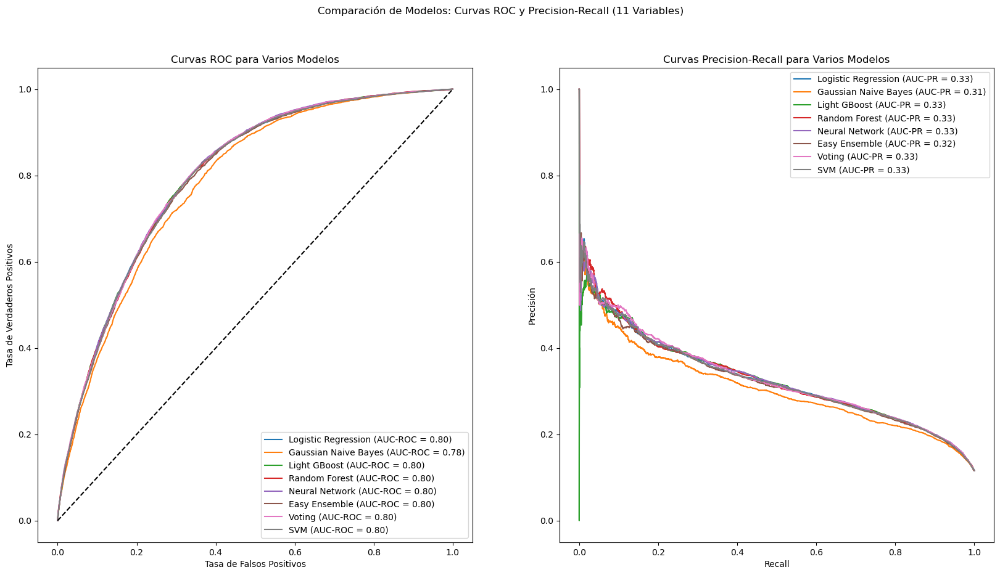

In [318]:
# Graficar curvas de rendimiento para los modelos con 11 variables
graficar_curvas_rendimiento(roc_data_11vars, pr_data_11vars, 
                            'Comparación de Modelos: Curvas ROC y Precision-Recall (11 Variables)')

Valores SHAP para Logistic Regression:


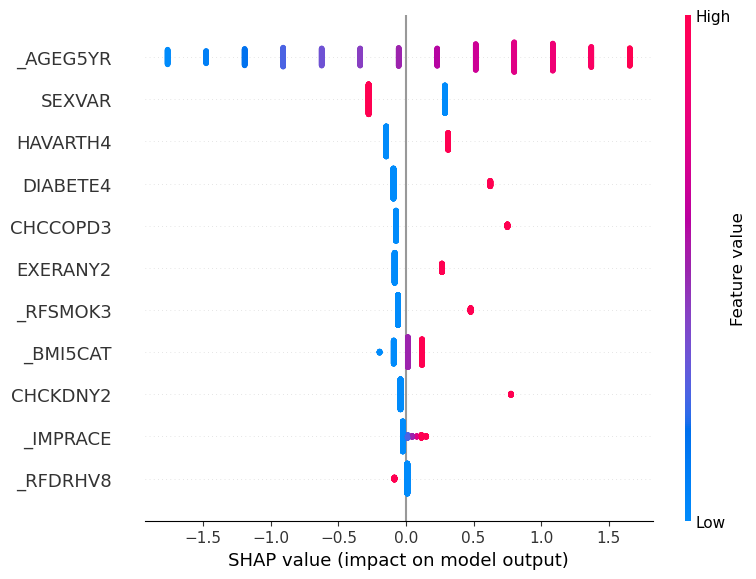

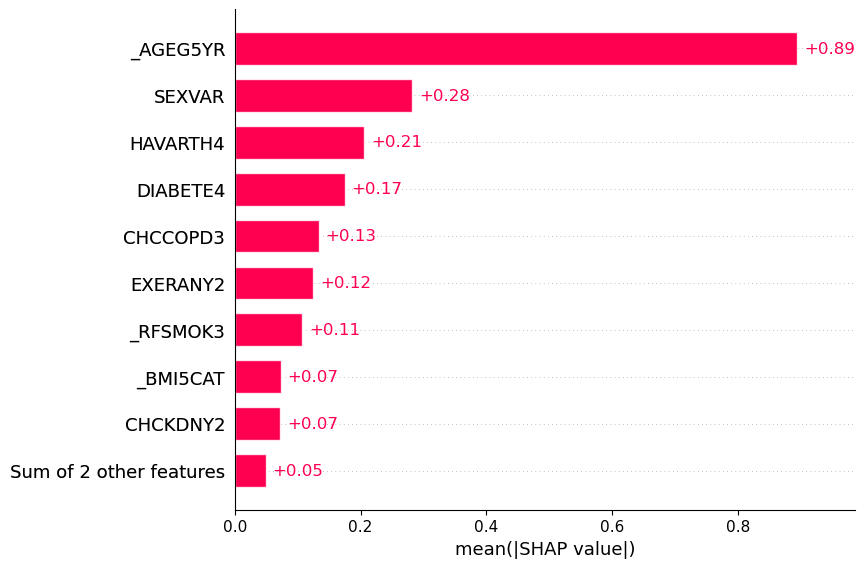

Valores SHAP para Gaussian Naive Bayes:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:34<00:00,  1.54s/it]


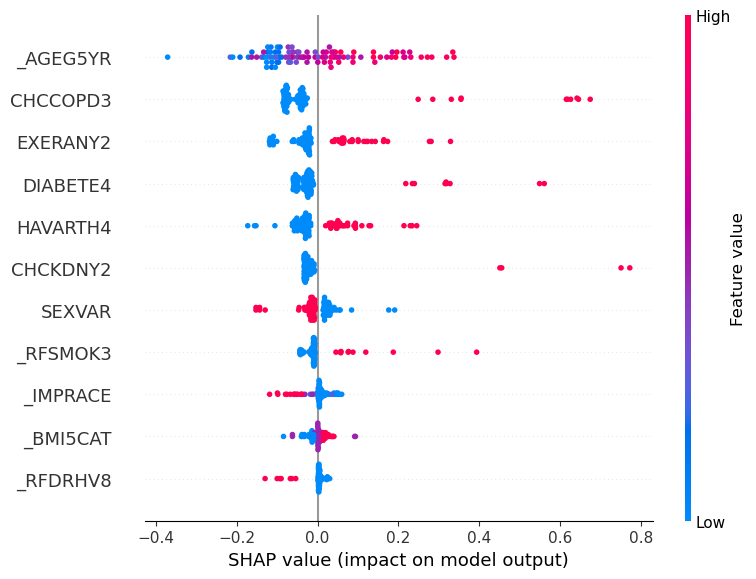

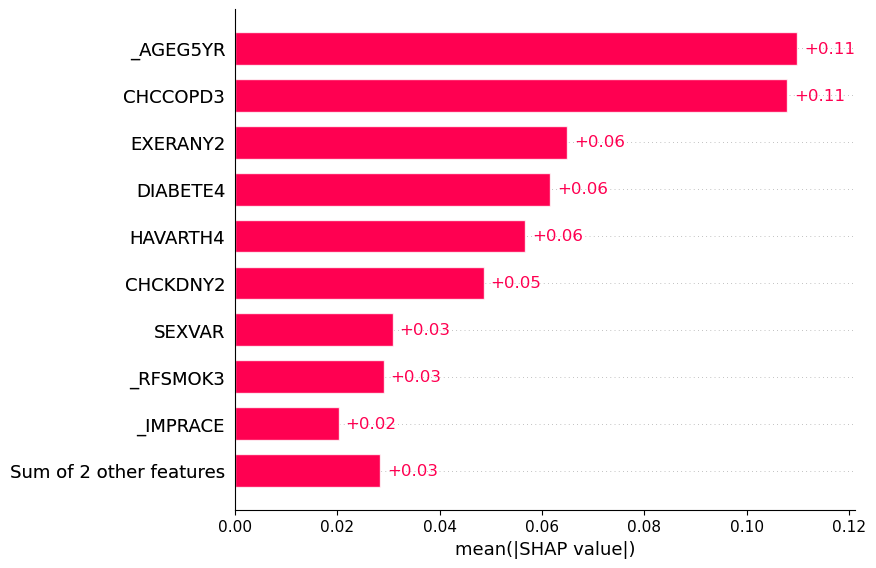

Valores SHAP para Light GBoost:


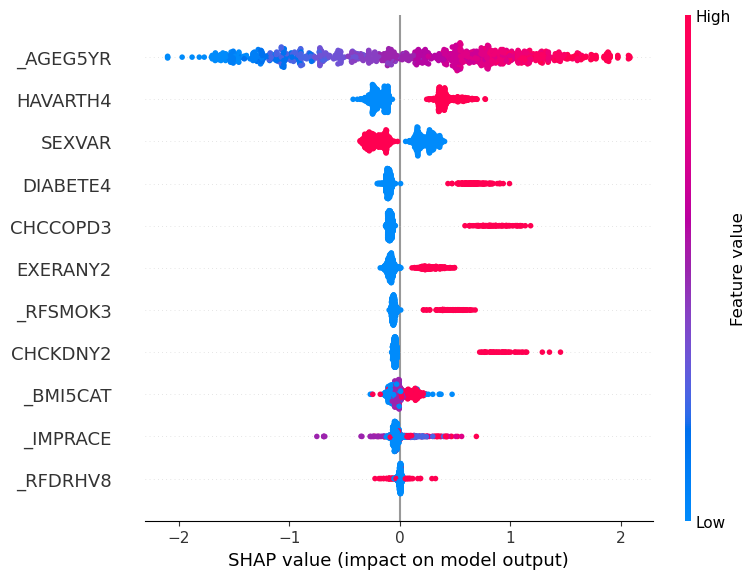

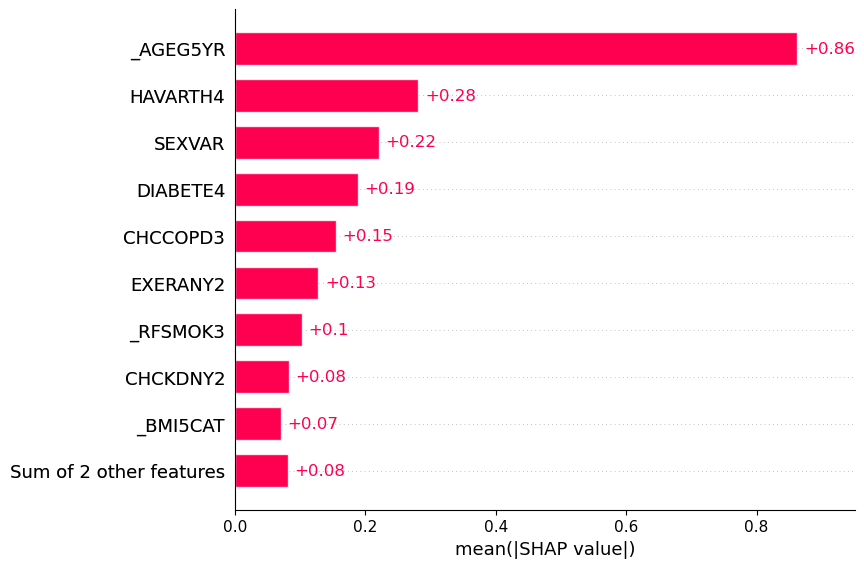

Valores SHAP para Random Forest:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [03:40<00:00,  2.94s/it]


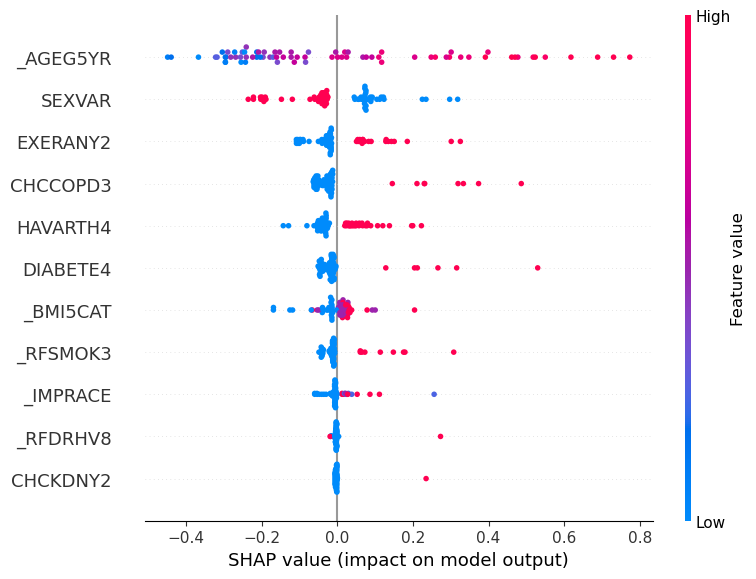

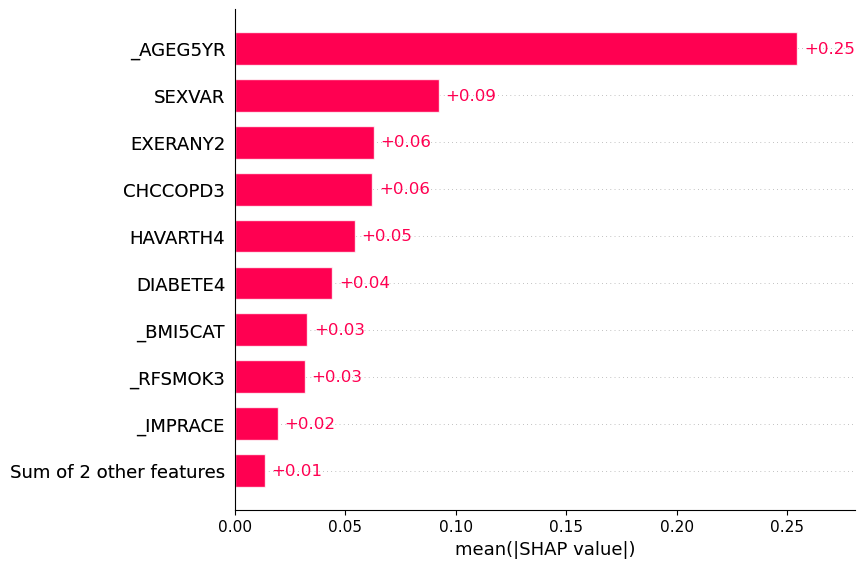

Valores SHAP para Neural Network:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [01:33<00:00,  1.25s/it]


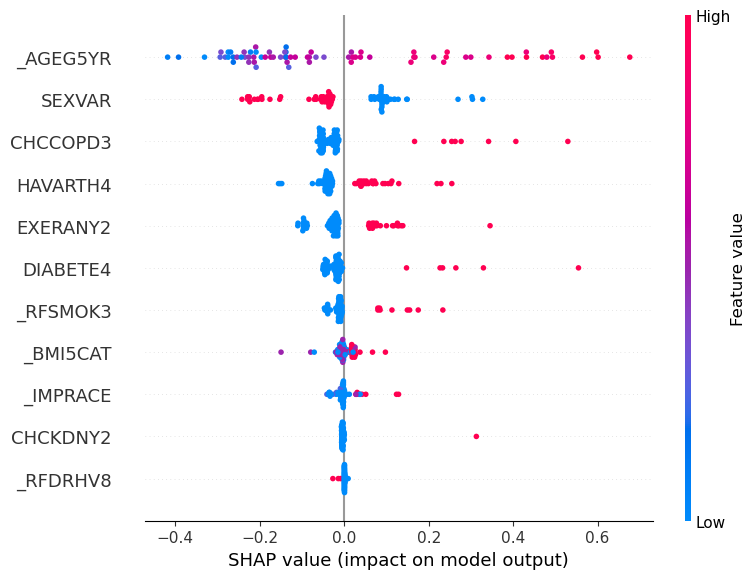

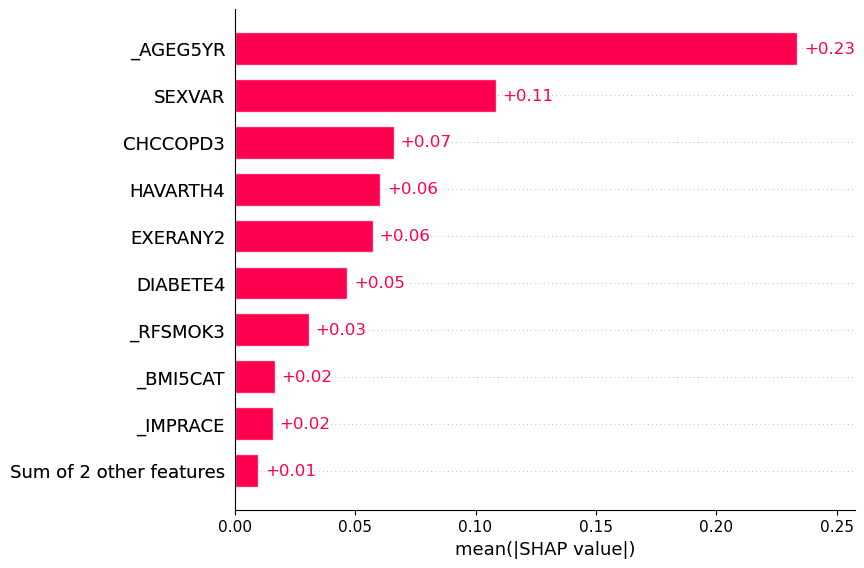

Valores SHAP para Easy Ensemble:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [01:59<00:00,  2.39s/it]


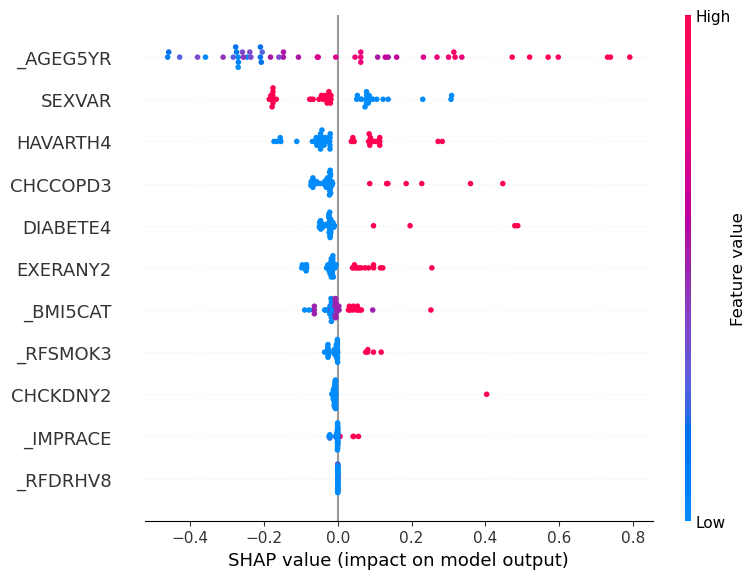

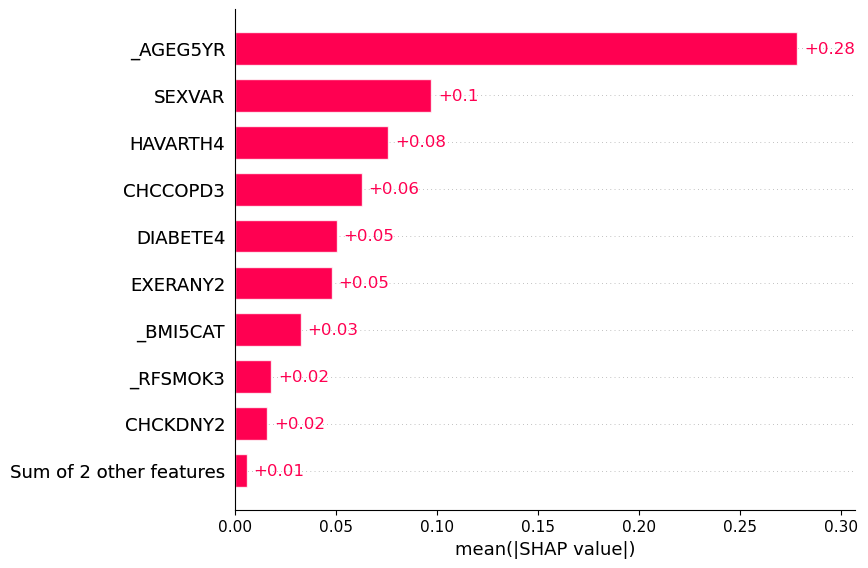

Valores SHAP para Voting:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [03:32<00:00,  4.24s/it]


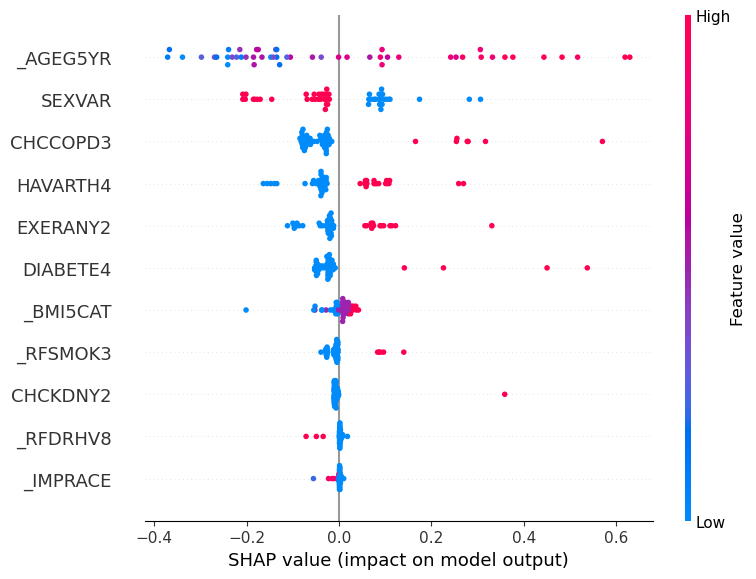

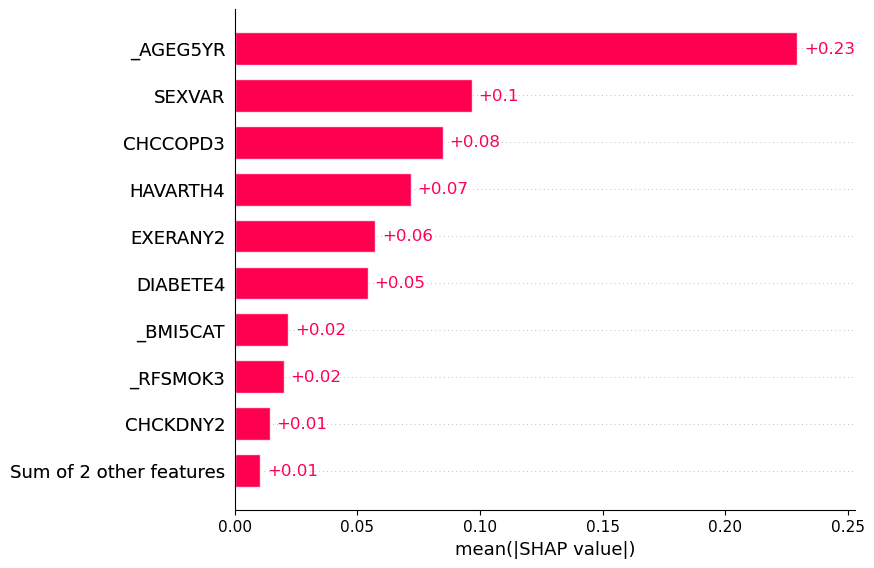

Valores SHAP para SVM:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:45<00:00,  1.66s/it]


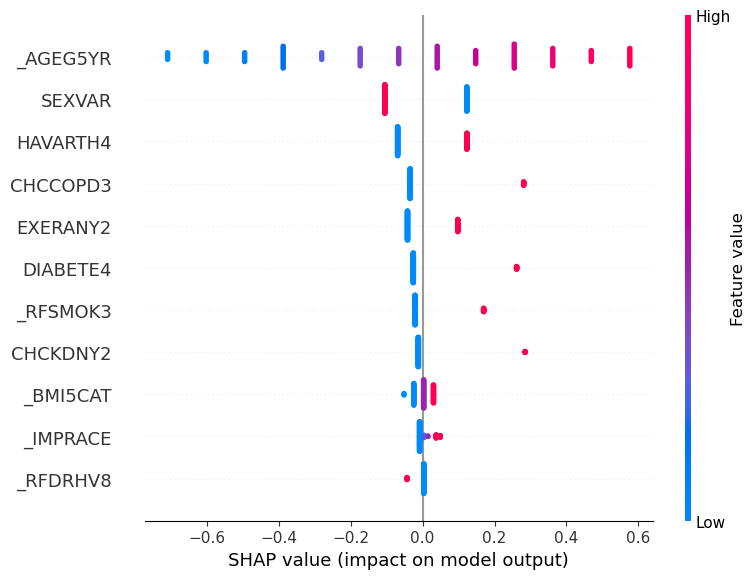

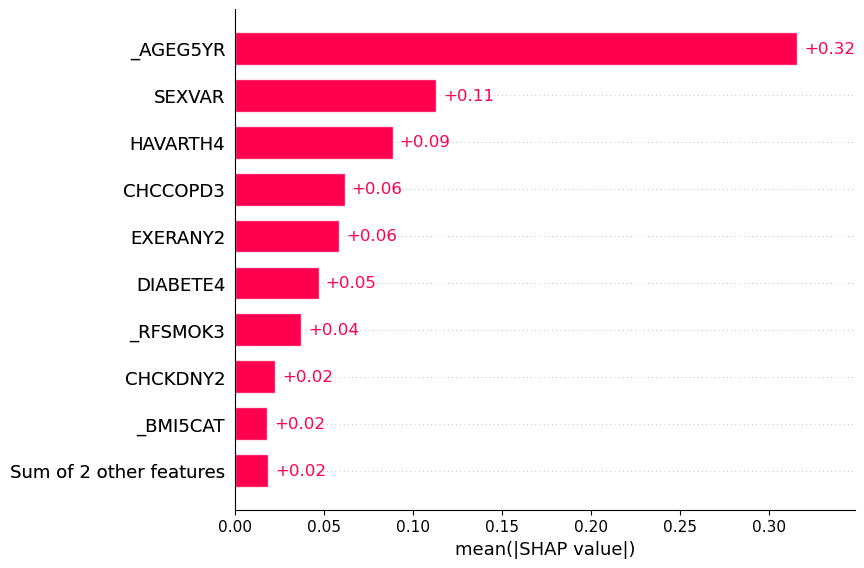

In [319]:
# Diccionario para mapear los tipos de modelo a sus correspondientes objetos explainer de SHAP
explainer_dict = {
    LogisticRegression: shap.LinearExplainer,
    GaussianNB: shap.KernelExplainer,
    LGBMClassifier: shap.TreeExplainer,
    RandomForestClassifier: shap.KernelExplainer,
    MLPClassifier: shap.KernelExplainer,
    EasyEnsembleClassifier: shap.KernelExplainer,
    VotingClassifier: shap.KernelExplainer,
    LinearSVC: shap.KernelExplainer    
    
}

# Diccionario para mapear los nombres de los modelos a sus correspondientes tamaños de muestra
sample_sizes = {
    'Logistic Regression': 1000,
    'Gaussian Naive Bayes': 100,
    'Light GBoost': 1000,
    'Random Forest': 75,
    'Neural Network': 75,
    'Easy Ensemble': 50,
    'SVM': 100,
    'Voting': 50
}

# Iterar sobre los modelos optimizados para graficar la importancia de las variables creadas por SHAP
for nombre, modelo in modelos_optimizados:
    print(f"Valores SHAP para {nombre}:")
    
    # Obtener el tamaño de muestra específico para el modelo actual
    sample_size = sample_sizes.get(nombre, 50)  # Valor predeterminado de 50 si no se encuentra el nombre del modelo
    
    # Tomar una muestra aleatoria de los datos de prueba para el cálculo de SHAP
    X_test_sample = shap.utils.sample(X_test, nsamples=sample_size, random_state=42)
    
    explainer_class = explainer_dict.get(type(modelo))
    if explainer_class is None:
        print(f"No se puede calcular los valores SHAP para {nombre}")
        continue
    
    if explainer_class == shap.KernelExplainer:
        if isinstance(modelo, LinearSVC):
            explainer = explainer_class(modelo.decision_function, X_test_sample)
        else:
            explainer = explainer_class(modelo.predict, X_test_sample)
    else:
        explainer = explainer_class(modelo, X_test_sample)
    
    shap_values = explainer(X_test_sample)
    
    # Graficar el Summary Plot de SHAP
    shap.summary_plot(shap_values, X_test_sample)
    plt.show()
    
    # Graficar el Bar Plot de SHAP
    shap.plots.bar(shap_values)
    plt.show()

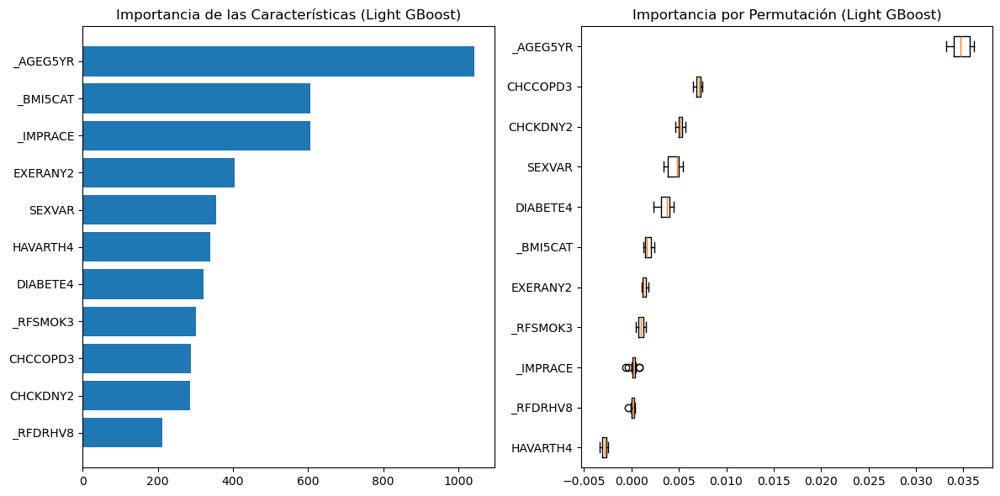

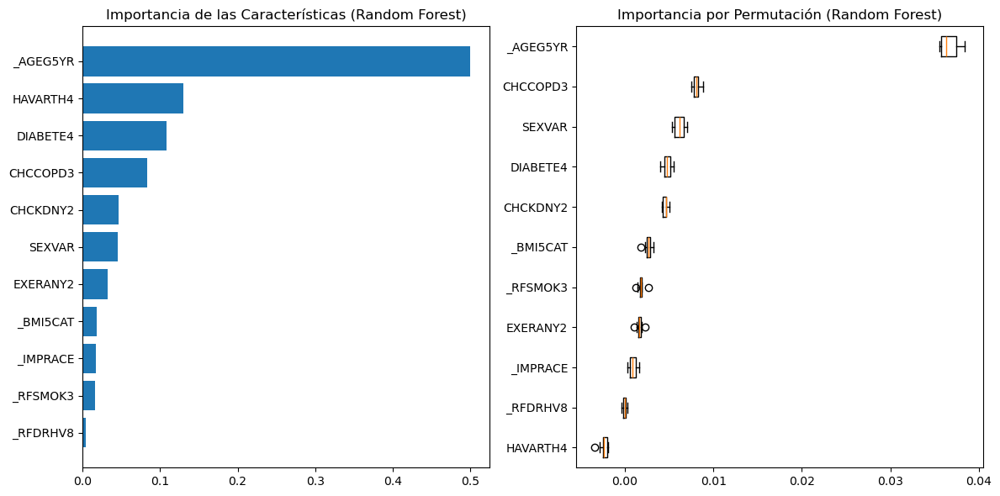

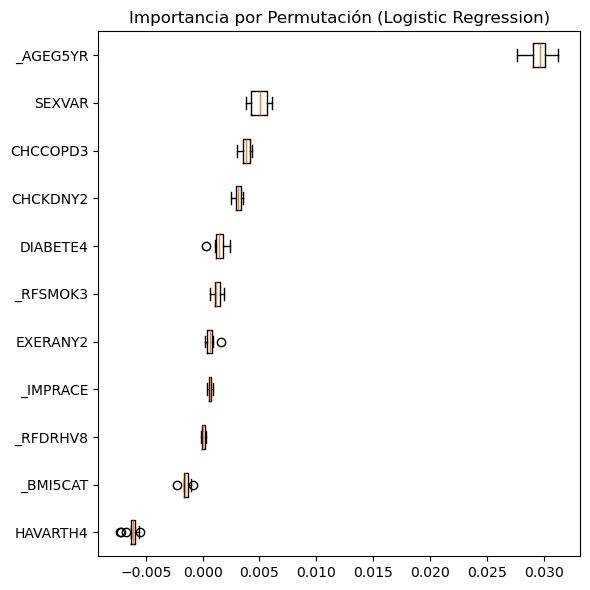

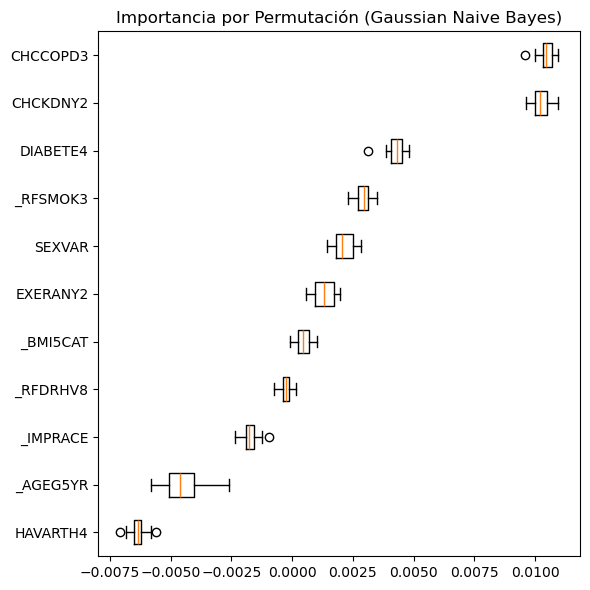

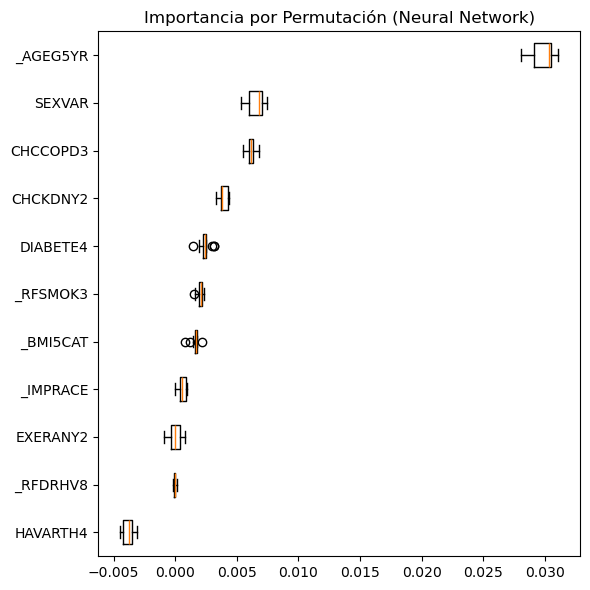

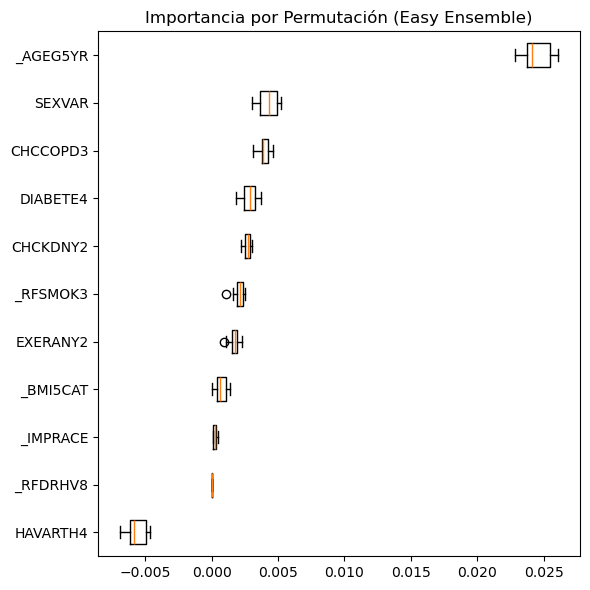

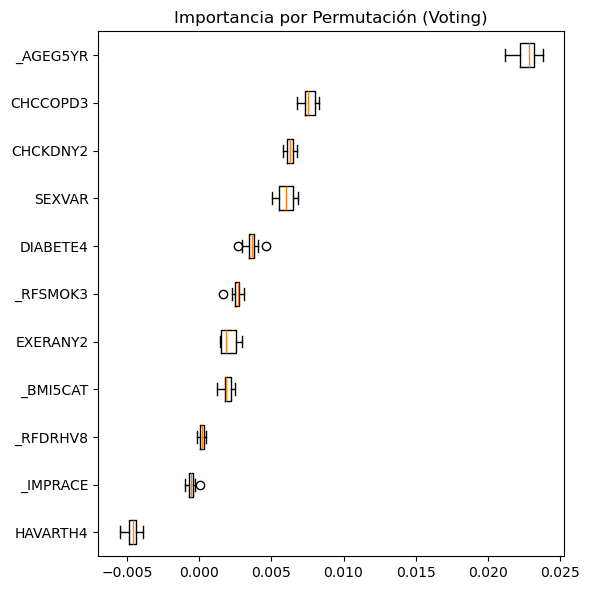

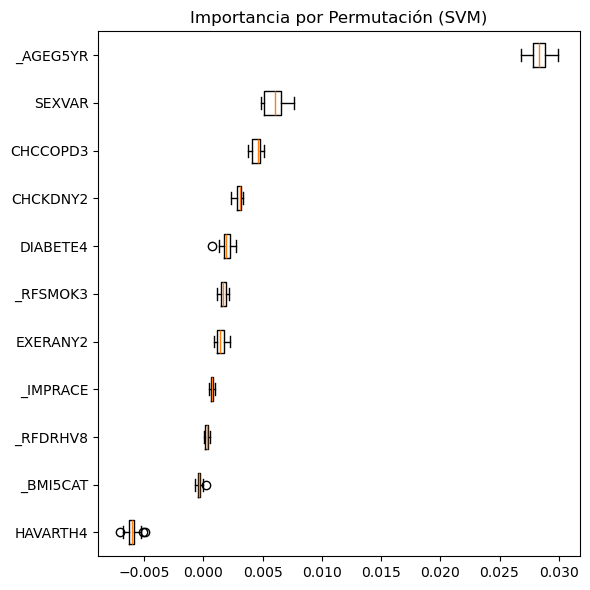

In [320]:
# Graficar importancia y permutación para los modelos con 11 variables
graficar_importancia_permutacion(modelos_optimizados, X_test, y_test, X)
graficar_permutacion_importancia(modelos_optimizados, X_test, y_test, X)


## MODELO CON TODAS(29) LAS VARIABLES

In [321]:
# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelosnoNAnoIM/RandomUnderSampler/modelos_iniciales_all"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

# Definir los modelos base
modelos_base = [
    ('Logistic Regression', LogisticRegression(class_weight='balanced', max_iter=200, random_state=42)),    
    ('Gaussian Naive Bayes', GaussianNB()),    
    ('Light GBoost', LGBMClassifier(class_weight='balanced', verbose=-1)),   
    ('Random Forest', RandomForestClassifier(class_weight='balanced', n_estimators=500, min_samples_split=2,
                                             max_depth=5, min_samples_leaf=1, random_state=42)),    
    ('Neural Network', MLPClassifier(early_stopping=True, random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))    
]

# Definir los modelos de ensamble
modelos_ensamble = [   
    ('Voting', VotingClassifier(estimators=modelos_base, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(class_weight='balanced', C=100.0, random_state=42, dual=False))
]

# Combinar todos los modelos
modelos = modelos_base + modelos_ensamble

# Crear el objeto de la técnica de muestreo RandomUnderSampler
tecnica_muestreo = RandomUnderSampler(random_state=42)

# Entrenar y evaluar modelos con todas las variables
resultados_allvars, X, X_train, y_train, X_val, y_val, X_test, y_test = entrenar_evaluar_modelos_base(
    df_noNA_noimputed, modelos, carpeta_modelos, tecnica_muestreo)


Dimensiones del conjunto de entrenamiento:
X_train: (51900, 29), y_train: (51900,)

Dimensiones del conjunto de validación:
X_val: (48066, 29), y_val: (48066,)

Dimensiones del conjunto de prueba:
X_test: (48066, 29), y_test: (48066,)

Tiempo de muestreo: 0.00 minutos

Modelo Logistic Regression cargado desde archivo.
Entrenamiento Logistic Regression:
Tiempo de ejecución: 0.01 minutos
Accuracy: 0.7510019267822736
F1-score: 0.7558888532084097
Precision: 0.7413390640631369
Recall: 0.7710211946050096
AUC-ROC: 0.8275385486391869
Matthews Corr Coef: 0.5024067152525418

MATRIZ DE CONFUSIÓN:
[[18969  6981]
 [ 5942 20008]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.76      0.73      0.75     25950
           1       0.74      0.77      0.76     25950

    accuracy                           0.75     51900
   macro avg       0.75      0.75      0.75     51900
weighted avg       0.75      0.75      0.75     51900



Test Logistic Regres

In [322]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_allvars_inicial = pd.DataFrame.from_dict(resultados_allvars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_allvars_inicial

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.736508,0.399735,0.271382,0.758453,0.821250,0.336492,0.007768
Gaussian Naive Bayes,0.775018,0.378077,0.277900,0.591187,0.786988,0.289780,0.000591
Light GBoost,0.719386,0.392487,0.261807,0.783633,0.822626,0.332504,0.005816
Random Forest,0.727666,0.387459,0.261860,0.744604,0.812396,0.319993,0.115746
Neural Network,0.704823,0.384255,0.253232,0.796223,0.821382,0.325169,0.069499
Easy Ensemble,0.738360,0.396371,0.270329,0.742626,0.816100,0.330012,0.287088
Voting,0.761994,0.403608,0.284173,0.696223,0.819157,0.331310,0.397453
SVM,0.733096,0.398123,0.269311,0.763129,0.821131,0.335433,0.003331


In [323]:
# Crear carpeta para guardar los modelos entrenados
carpeta_modelos = "modelosnoNAnoIM/RandomUnderSampler/modelos_entrenados_all"

# Crear la carpeta si no existe
if not os.path.exists(carpeta_modelos):
    os.makedirs(carpeta_modelos)

In [324]:
# Definir los espacios de búsqueda de hiperparámetros para cada modelo
param_dist_lr = {
    'class_weight': ['balanced', None],
    'solver': ['newton-cg', 'newton-cholesky', 'sag', 'saga'],
    'penalty': ['l2'],
    'C': loguniform(1e-4, 1e1)
}

param_dist_gnb = {
    'var_smoothing': loguniform(1e-9, 1e-1)
}

param_dist_lgbm = {
    'class_weight': ['balanced', None],
    'n_estimators': randint(50, 251),
    'max_depth': randint(3, 31),
    'subsample': uniform(0.7, 0.3),
    'colsample_bytree': uniform(0.7, 0.3),
    'learning_rate': loguniform(1e-5, 1e-1),
    'num_leaves': randint(10, 101),
    'verbose': [-1]
}

param_dist_rf = {
    'class_weight': ['balanced_subsample', 'balanced'],
    'n_estimators': randint(50, 251),
    'criterion': ['gini', 'entropy'],
    'max_depth': randint(3, 16),
    'min_samples_leaf': randint(3, 16),
    'min_samples_split': randint(3, 16),
    'max_features': [None, 'sqrt', 'log2']
}

param_dist_ann = {
    'hidden_layer_sizes': [(100,), (50,50), (100,100), (50, 50, 50),
                           (100, 100, 100), (50, 50, 50, 50), (100, 100, 100, 100),
                           (50, 50, 50, 50, 50), (100, 100, 100, 100, 100)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': loguniform(1e-5, 1e3),
    'batch_size': [64, 128, 256, 512],
    'learning_rate': ['constant', 'adaptive'],
    'learning_rate_init': loguniform(1e-5, 1e-1),
    'early_stopping': [True],
    'max_iter': [100]
}

param_dist_eec = {
    'n_estimators': randint(2, 20),
    'sampling_strategy': ['auto']
}

param_dist_svm = {
    'dual': ['auto'],
    'tol': loguniform(1e-5, 1e-3),
    'class_weight': [None, 'balanced'],
    'penalty': ['l2'],
    'loss': ['hinge', 'squared_hinge'],
    'C': loguniform(1e-4, 1e4),
    'max_iter': randint(1000, 2001)
}

# Definir los modelos con búsqueda de hiperparámetros
modelos = [
    ('Logistic Regression', RandomizedSearchCV(LogisticRegression(), param_dist_lr,
                                               cv=30, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Gaussian Naive Bayes', RandomizedSearchCV(GaussianNB(), param_dist_gnb, cv=30,
                                                n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('Light GBoost', RandomizedSearchCV(LGBMClassifier(), param_dist_lgbm, cv=5, n_jobs=6,
                                        scoring='f1_weighted', n_iter=50)),
    ('Random Forest', RandomizedSearchCV(RandomForestClassifier(), param_dist_rf,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=50)),
    ('Neural Network', RandomizedSearchCV(MLPClassifier(), param_dist_ann, cv=5, n_jobs=6,
                                          scoring='f1_weighted', error_score=0, n_iter=50)),
    ('Easy Ensemble', RandomizedSearchCV(EasyEnsembleClassifier(), param_dist_eec,
                                         cv=5, n_jobs=6, scoring='f1_weighted', n_iter=9)),
    ('SVM', RandomizedSearchCV(LinearSVC(), param_dist_svm, cv=5, n_jobs=6,
                               scoring='f1_weighted', n_iter=50))
]

# Crear un diccionario para almacenar los mejores hiperparámetros de cada modelo
best_params_all = {}

# Entrenar y evaluar cada modelo con búsqueda de hiperparámetros
for nombre, modelo in modelos:
    nombre_archivo = f"{carpeta_modelos}/{nombre}_optimizado.pkl"
    
    # Hash del conjunto de datos actual
    hash_actual = hash_de_datos(X_train)
    
    # Cargar o entrenar modelo
    modelo_cargado, tiempo_ejecucion, mejores_parametros_cargados = cargar_modelo(nombre_archivo, hash_actual)
    
    if modelo_cargado is not None:
        print(f"Modelo {nombre} cargado desde archivo.")
        modelo_best_all = modelo_cargado
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros_cargados}")
        # Agregar los mejores hiperparámetros cargados al diccionario
        best_params_all[nombre] = mejores_parametros_cargados
    else:
        print(f"Entrenando nuevo modelo {nombre}.")
        inicio = time.time()  # Tiempo de inicio
        modelo.fit(X_train, y_train)
        
        mejores_parametros = modelo.best_params_
        
        print(f"Mejores hiperparámetros para {nombre}: {mejores_parametros}")
        
        # Agregar los mejores hiperparámetros al diccionario
        best_params_all[nombre] = modelo.best_params_
        
        # Entrenar el modelo con los mejores hiperparámetros en el conjunto de entrenamiento completo
        modelo_best_all = modelo.best_estimator_
        modelo_best_all.fit(X_train, y_train)
        
        fin = time.time()  # Tiempo de fin
        tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos
        
        # Guardar el modelo entrenado junto con el tiempo de ejecución y los mejores parámetros
        guardar_modelo(modelo_best_all, nombre_archivo, hash_actual, tiempo_ejecucion, mejores_parametros)

    # Métricas de predicción entrenamiento
    y_pred_train = modelo_best_all.predict(X_train)

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_all, "predict_proba"):
        y_scores = modelo_best_all.predict_proba(X_train)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_all.decision_function(X_train)  # Puntuaciones de decisión
    
    print(f"Entrenamiento {nombre}:")
    print(f"Tiempo de búsqueda de hiperparámetros de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_train, y_pred_train)}")
    print(f"F1-score: {f1_score(y_train, y_pred_train)}")
    print(f"Precision: {precision_score(y_train, y_pred_train)}")
    print(f"Recall: {recall_score(y_train, y_pred_train)}")
    print(f"AUC-ROC: {roc_auc_score(y_train, y_scores)}") # Usar y_scores en lugar de y_pred
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_train, y_pred_train)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_train, y_pred_train))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_train, y_pred_train))
    print("\n")

    # Métricas predicción validación
    inicio = time.time()  # Tiempo de inicio
    y_pred_val = modelo_best_all.predict(X_val)
    fin = time.time()  # Tiempo de fin
    tiempo_ejecucion = (fin - inicio) / 60  # Tiempo de ejecución en minutos

    # Obtener las probabilidades de la clase positiva (o puntuaciones de decisión)
    if hasattr(modelo_best_all, "predict_proba"):
        y_scores = modelo_best_all.predict_proba(X_val)[:, 1]  # Probabilidades de la clase positiva
    else:
        y_scores = modelo_best_all.decision_function(X_val)  # Puntuaciones de decisión
    
    print(f"Validación {nombre}:")
    print(f"Tiempo de ejecución de predicción de {nombre}: {tiempo_ejecucion:.2f} minutos")
    print(f"Accuracy: {accuracy_score(y_val, y_pred_val)}")
    print(f"F1-score: {f1_score(y_val, y_pred_val)}")
    print(f"Precision: {precision_score(y_val, y_pred_val)}")
    print(f"Recall: {recall_score(y_val, y_pred_val)}")
    print(f"AUC-ROC: {roc_auc_score(y_val, y_scores)}") # Usar y_scores en lugar de y_pred
    print(f"Matthews Corr Coef: {matthews_corrcoef(y_val, y_pred_val)}")
    print("\nMATRIZ DE CONFUSIÓN:")
    print(confusion_matrix(y_val, y_pred_val))
    print("\nREPORTE DE CLASIFICACIÓN:")
    print(classification_report(y_val, y_pred_val))
    print("\n")



Modelo Logistic Regression cargado desde archivo.
Mejores hiperparámetros para Logistic Regression: {'C': 0.019324973486399, 'class_weight': 'balanced', 'penalty': 'l2', 'solver': 'saga'}
Entrenamiento Logistic Regression:
Tiempo de búsqueda de hiperparámetros de Logistic Regression: 3.46 minutos
Accuracy: 0.7508477842003853
F1-score: 0.7560050568900126
Precision: 0.7406736421784301
Recall: 0.7719845857418112
AUC-ROC: 0.8274064211225827
Matthews Corr Coef: 0.5021444495412896

MATRIZ DE CONFUSIÓN:
[[18936  7014]
 [ 5917 20033]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.76      0.73      0.75     25950
           1       0.74      0.77      0.76     25950

    accuracy                           0.75     51900
   macro avg       0.75      0.75      0.75     51900
weighted avg       0.75      0.75      0.75     51900



Validación Logistic Regression:
Tiempo de ejecución de predicción de Logistic Regression: 0.00 minutos
Accuracy

In [325]:
# Combinar los conjuntos de entrenamiento y validación para todas las variables
X_train_val_allvars = pd.concat([X_train, X_val], ignore_index=True)
y_train_val_allvars = pd.concat([y_train, y_val], ignore_index=True)

# Definir los modelos con los mejores hiperparámetros
modelos_entrenados_all = [
    ('Logistic Regression', LogisticRegression(random_state=42)),
    ('Gaussian Naive Bayes', GaussianNB()),    
    ('Light GBoost', LGBMClassifier(verbosity=-1, random_state=42)),
    ('Random Forest', RandomForestClassifier(random_state=42)),   
    ('Neural Network', MLPClassifier(random_state=42)),
    ('Easy Ensemble', EasyEnsembleClassifier(random_state=42))
]

# Definir los modelos de ensamble
modelos_ensamble_all = [   
    ('Voting', VotingClassifier(estimators=modelos_entrenados_all, voting='soft', n_jobs=-1)),
    ('SVM', LinearSVC(random_state=42))    
]

# Combinar todos los modelos
modelos_optimizados_all = modelos_entrenados_all + modelos_ensamble_all

# Crear el objeto de la técnica de muestreo RandomUnderSampler
tecnica_muestreo = RandomUnderSampler(random_state=42)

# Entrenar y evaluar modelos con todas las variables
resultados_optimizados_allvars, roc_data, pr_data, modelos_optimizados_all = entrenar_evaluar_modelos(
    X_train_val_allvars, y_train_val_allvars, X_test, y_test, modelos_optimizados_all, best_params_all, carpeta_modelos, 
    tecnica_muestreo
)



Tiempo de muestreo: 0.00 minutos

Modelo Logistic Regression cargado desde archivo.
Test Logistic Regression:
Mejores hiperparámetros para Logistic Regression: {'C': 0.019324973486399, 'class_weight': 'balanced', 'penalty': 'l2', 'solver': 'saga'}
Tiempo de ejecución de entrenamiento: 0.01 minutos
Tiempo de ejecución de predicción: 0.00 minutos
Accuracy: 0.7349477801356468
F1-score: 0.3987730061349693
Precision: 0.2703134996801024
Recall: 0.7598920863309353
AUC-ROC: 0.8208920399557642
Matthews Corr Coef: 0.33563014202615316

MATRIZ DE CONFUSIÓN:
[[31101 11405]
 [ 1335  4225]]

REPORTE DE CLASIFICACIÓN:
              precision    recall  f1-score   support

           0       0.96      0.73      0.83     42506
           1       0.27      0.76      0.40      5560

    accuracy                           0.73     48066
   macro avg       0.61      0.75      0.61     48066
weighted avg       0.88      0.73      0.78     48066



Modelo Gaussian Naive Bayes cargado desde archivo.
Test Gaus

In [326]:
# Convertir el diccionario de resultados a un DataFrame
metricas_modelos_allvars_opt = pd.DataFrame.from_dict(resultados_optimizados_allvars, orient='index')
# Mostrar el DataFrame con las métricas de los modelos
metricas_modelos_allvars_opt

,Accuracy,F1-score,Precision,Recall,AUC-ROC,Matthews Corr Coef,Tiempo de ejecución (min)
Logistic Regression,0.734948,0.398773,0.270313,0.759892,0.820892,0.335630,0.011395
Gaussian Naive Bayes,0.790434,0.393522,0.295773,0.587770,0.800577,0.307644,0.000750
Light GBoost,0.720530,0.393188,0.262532,0.782734,0.822855,0.333156,0.006506
Random Forest,0.715308,0.391010,0.259787,0.790108,0.821359,0.331955,0.147218
Neural Network,0.693318,0.381228,0.248645,0.816727,0.822514,0.325452,0.346354
Easy Ensemble,0.730537,0.392951,0.265720,0.753957,0.816771,0.327917,0.273726
Voting,0.732389,0.398222,0.269112,0.765468,0.821756,0.335946,0.425298
SVM,0.727520,0.394918,0.265713,0.768705,0.820328,0.332694,0.085211


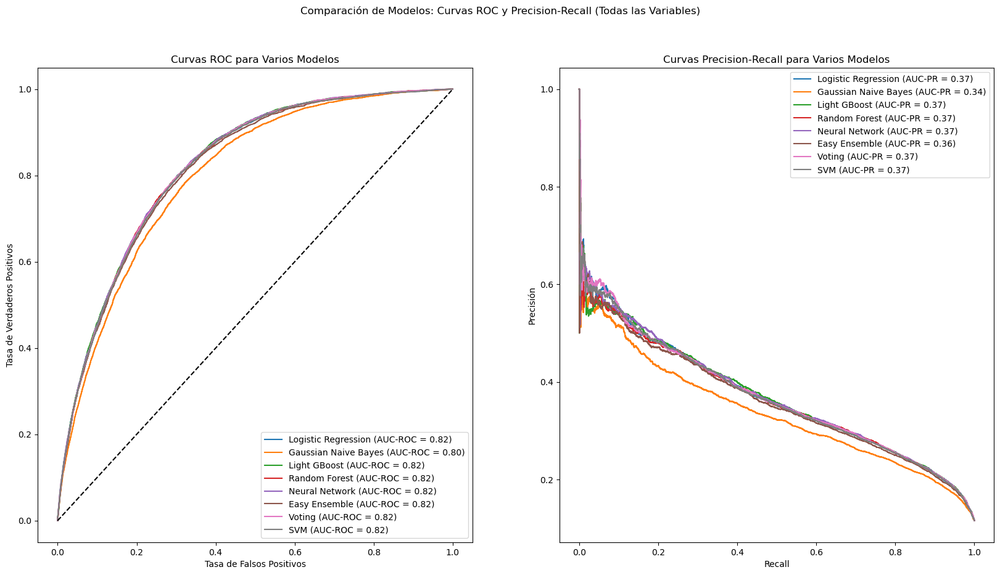

In [327]:
# Graficar curvas de rendimiento para los modelos con todas las variables
graficar_curvas_rendimiento(roc_data, pr_data, 
                            'Comparación de Modelos: Curvas ROC y Precision-Recall (Todas las Variables)')

Valores SHAP para Logistic Regression:


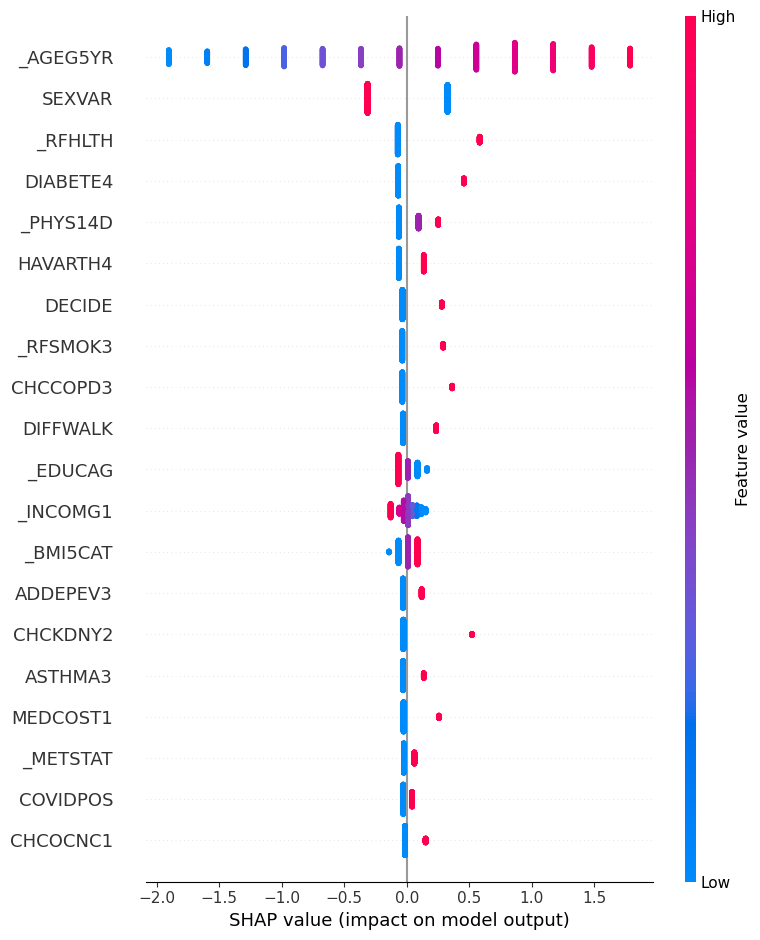

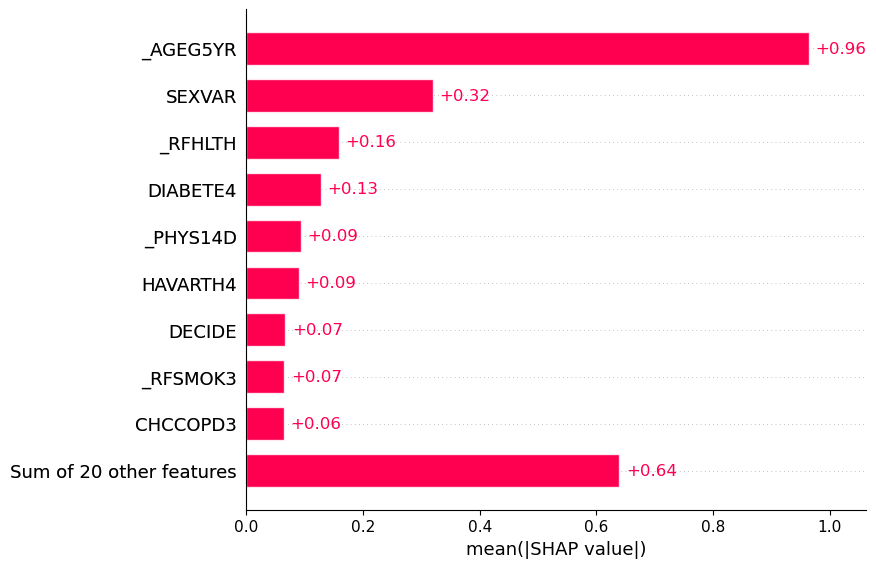

Valores SHAP para Gaussian Naive Bayes:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [03:00<00:00,  1.80s/it]


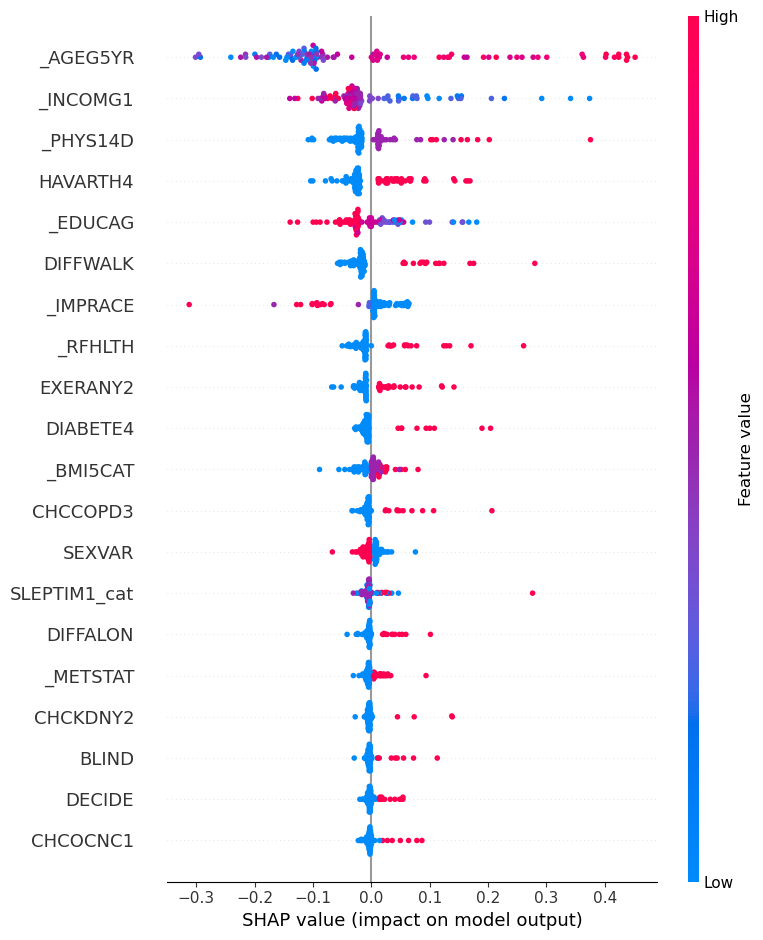

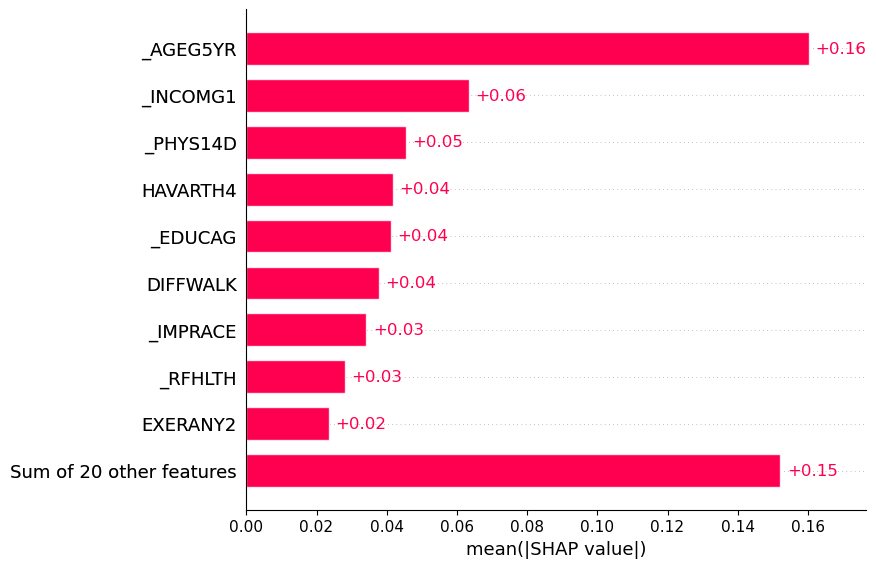

Valores SHAP para Light GBoost:


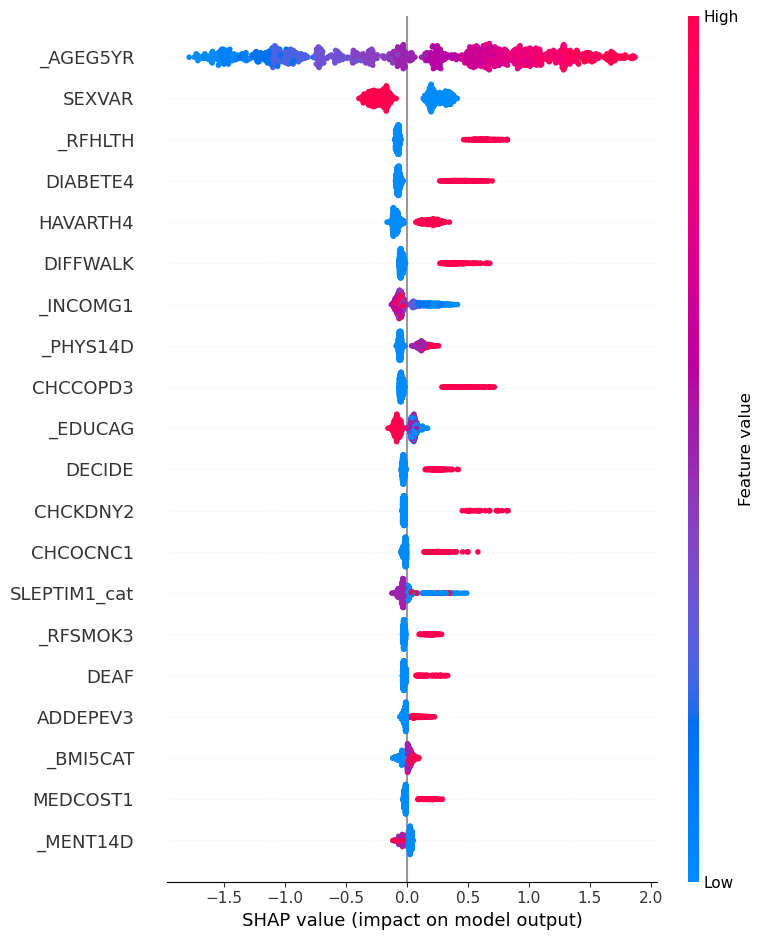

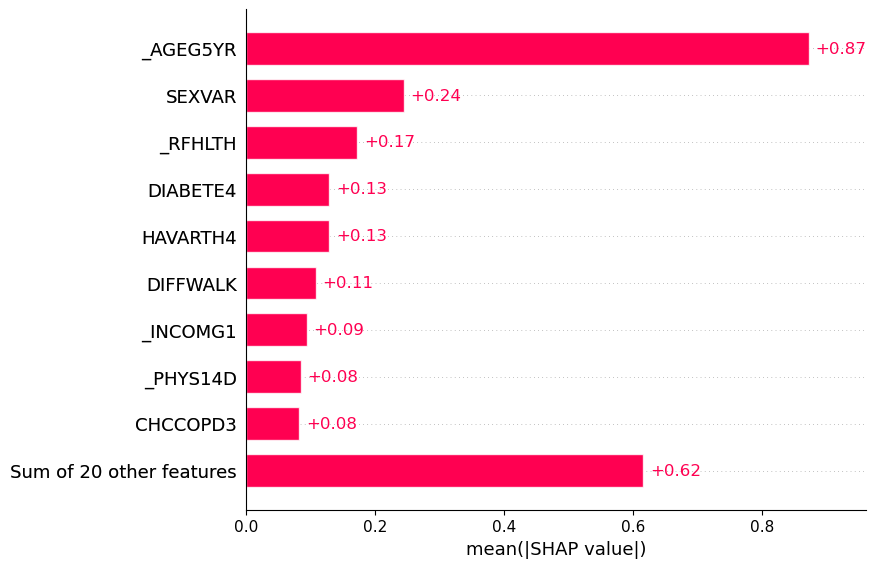

Valores SHAP para Random Forest:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [05:09<00:00,  4.13s/it]


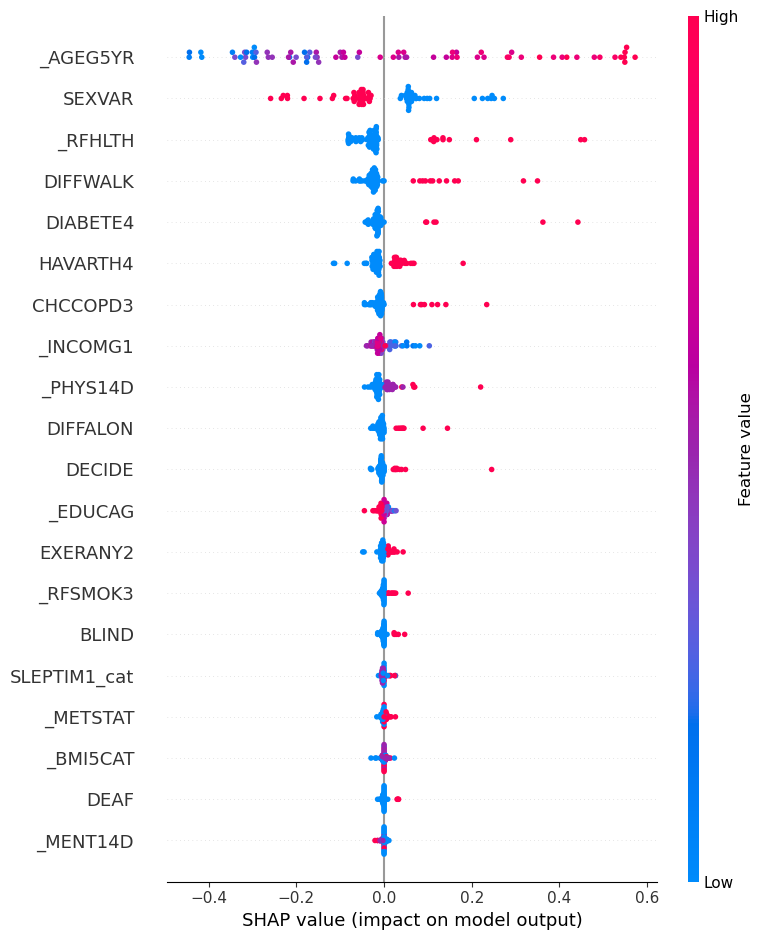

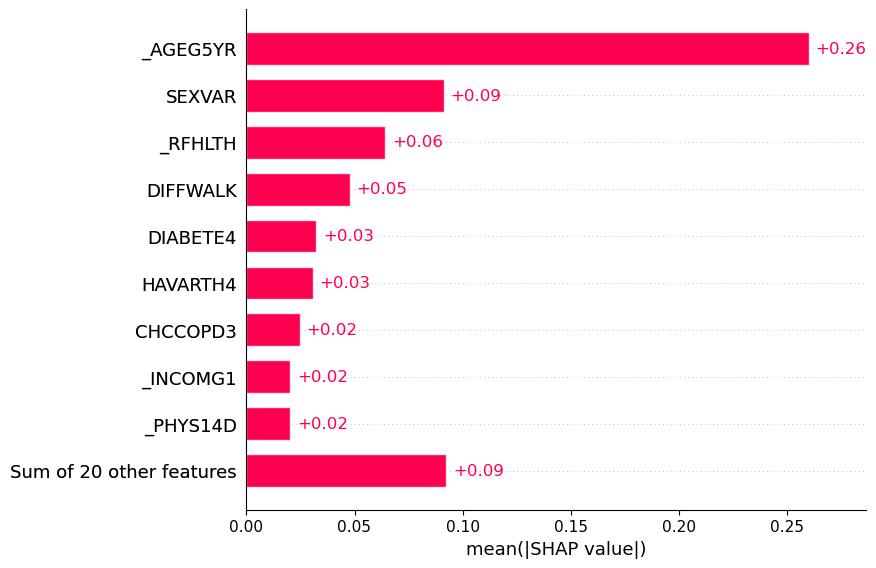

Valores SHAP para Neural Network:


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [02:17<00:00,  1.84s/it]


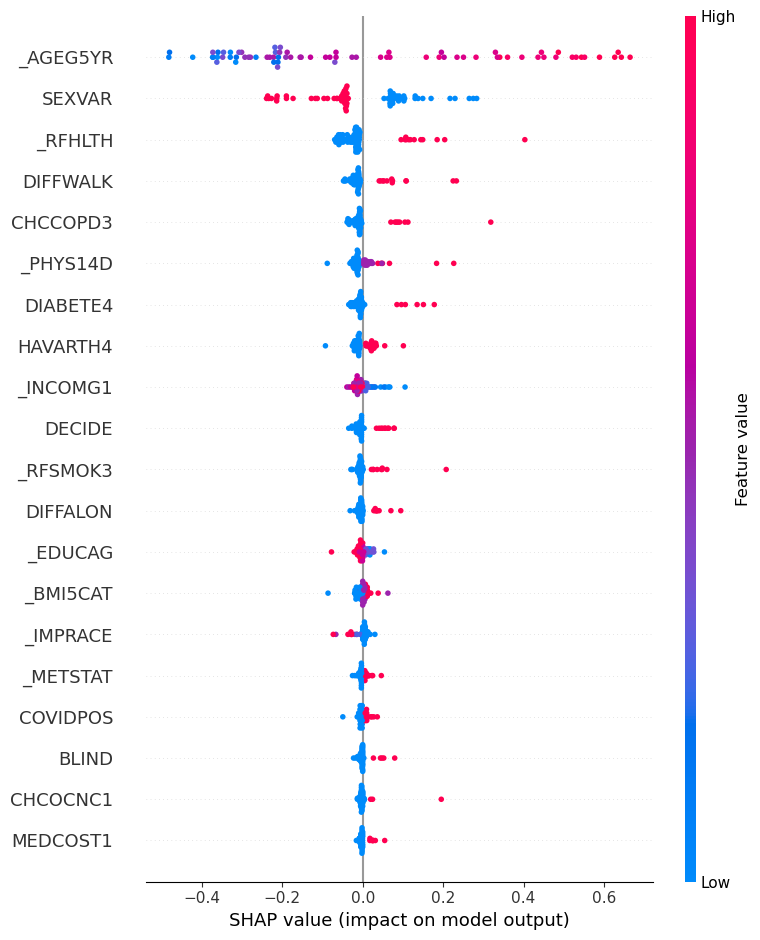

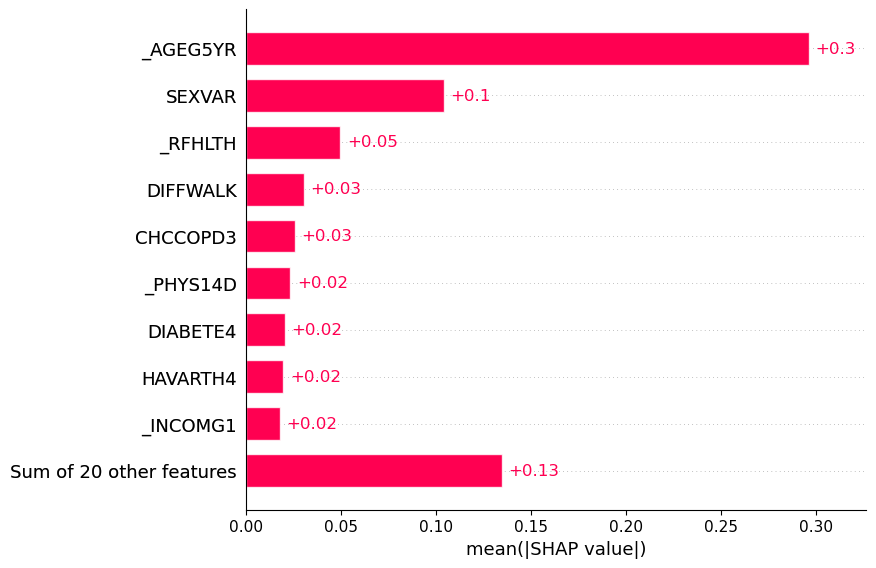

Valores SHAP para Easy Ensemble:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [05:33<00:00,  6.66s/it]


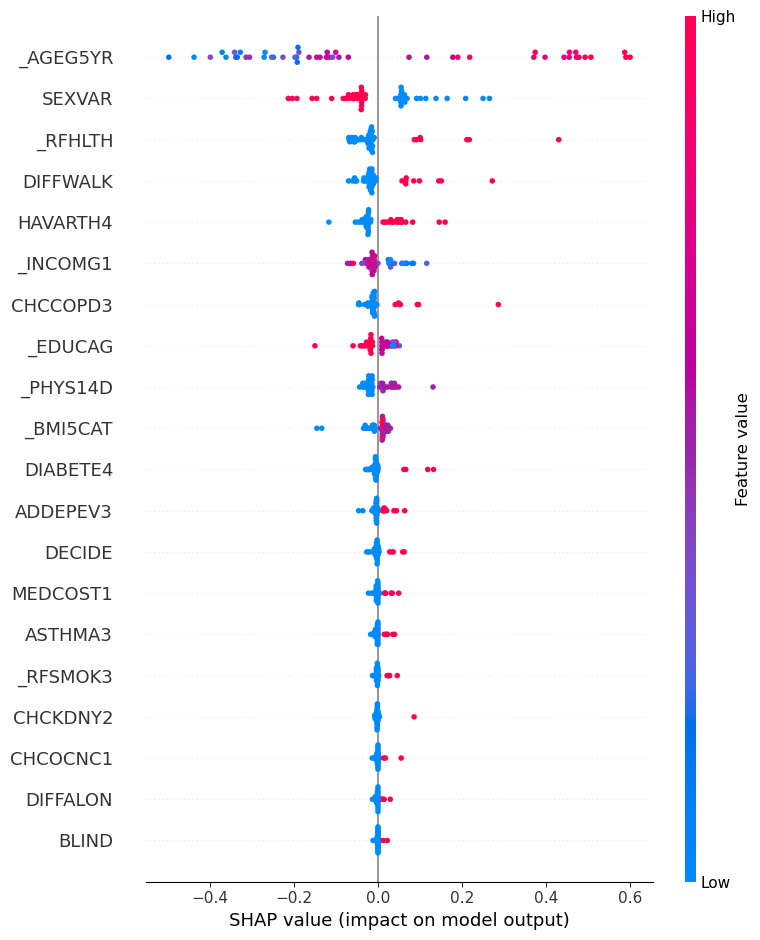

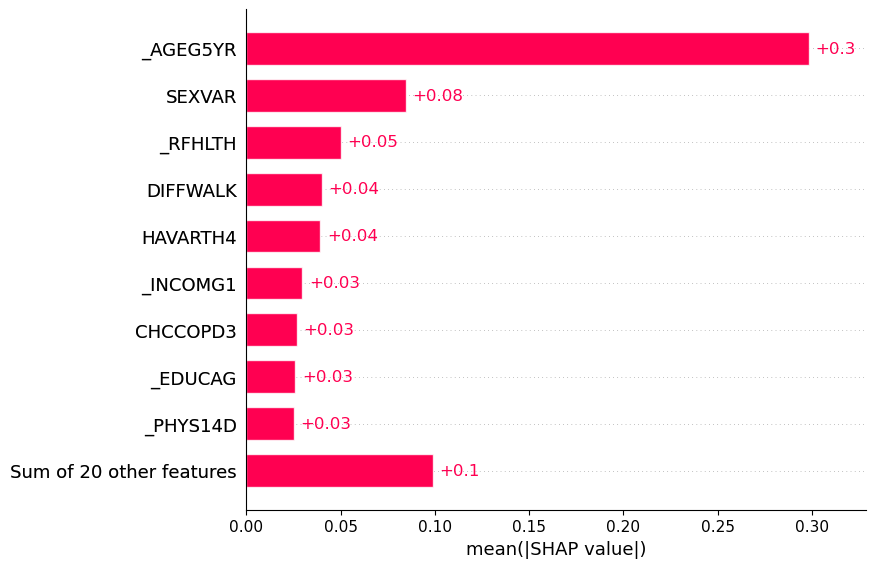

Valores SHAP para Voting:


100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [07:39<00:00,  9.18s/it]


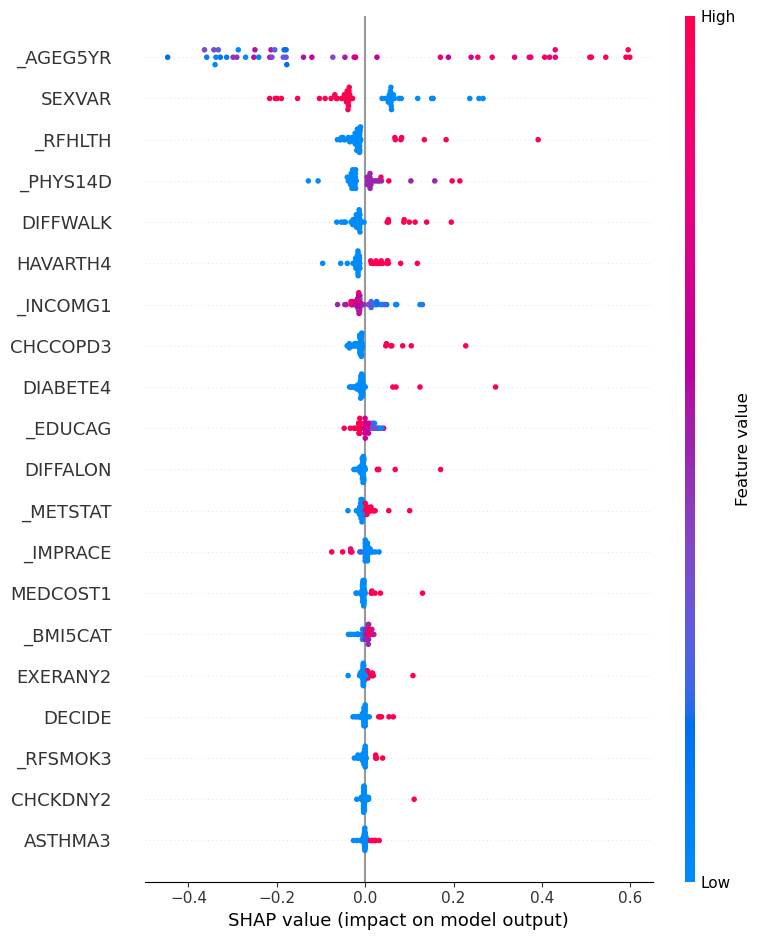

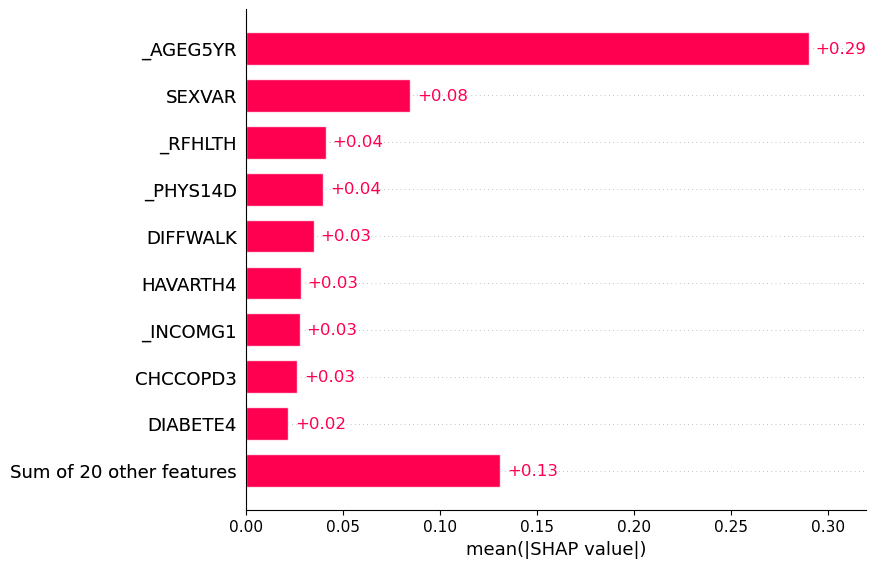

Valores SHAP para SVM:


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [02:57<00:00,  1.78s/it]


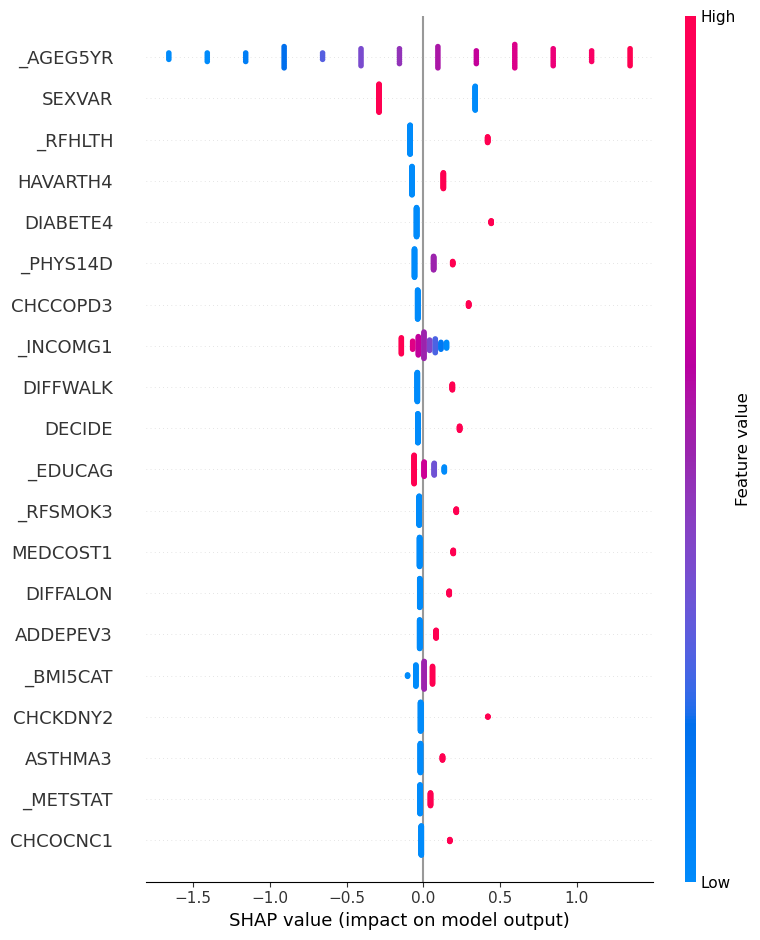

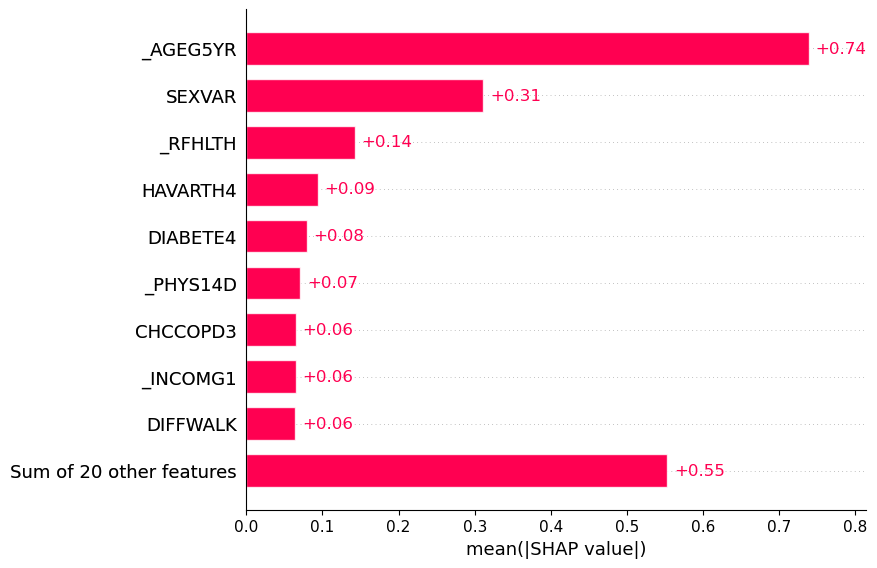

In [328]:
# Iterar sobre los modelos optimizados para graficar la importancia de las variables creadas por SHAP
for nombre, modelo in modelos_optimizados_all:
    print(f"Valores SHAP para {nombre}:")
    
    # Obtener el tamaño de muestra específico para el modelo actual
    sample_size = sample_sizes.get(nombre, 50)  # Valor predeterminado de 50 si no se encuentra el nombre del modelo
    
    # Tomar una muestra aleatoria de los datos de prueba para el cálculo de SHAP
    X_test_sample = shap.utils.sample(X_test, nsamples=sample_size, random_state=42)
    
    explainer_class = explainer_dict.get(type(modelo))
    if explainer_class is None:
        print(f"No se puede calcular los valores SHAP para {nombre}")
        continue
    
    if explainer_class == shap.KernelExplainer:
        if isinstance(modelo, LinearSVC):
            explainer = explainer_class(modelo.decision_function, X_test_sample)
        else:
            explainer = explainer_class(modelo.predict, X_test_sample)
    else:
        explainer = explainer_class(modelo, X_test_sample)
    
    shap_values = explainer(X_test_sample)
    
    # Graficar el Summary Plot de SHAP
    shap.summary_plot(shap_values, X_test_sample)
    plt.show()
    
    # Graficar el Bar Plot de SHAP
    shap.plots.bar(shap_values)
    plt.show()

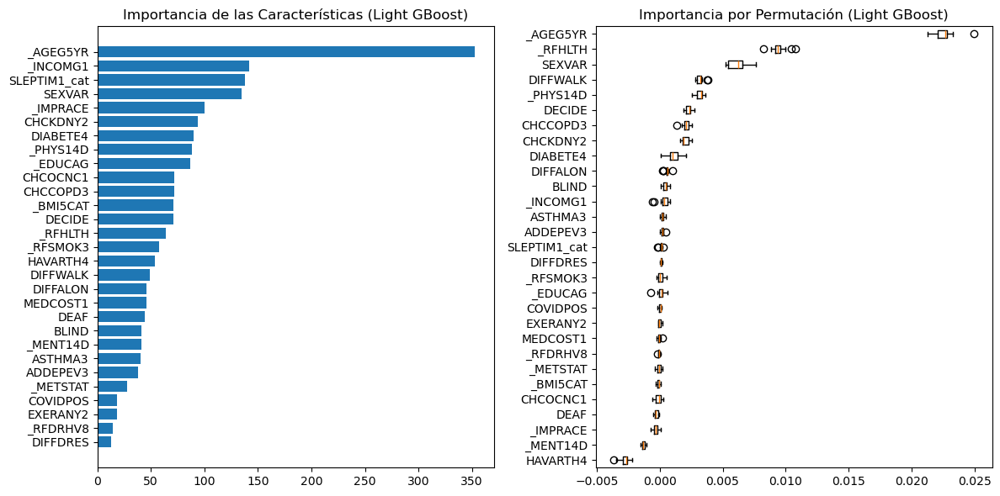

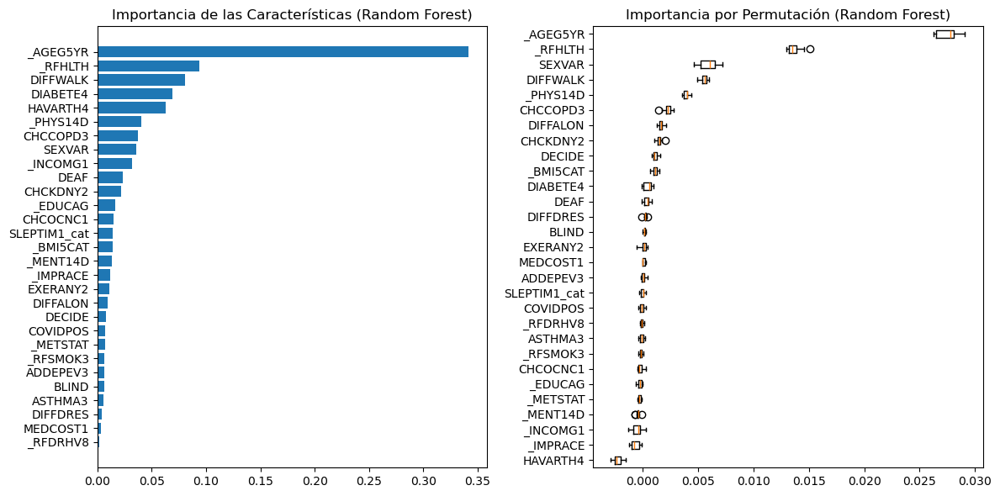

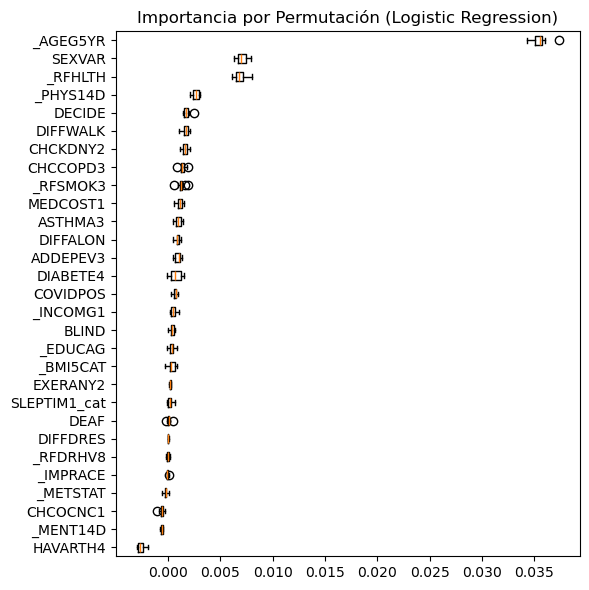

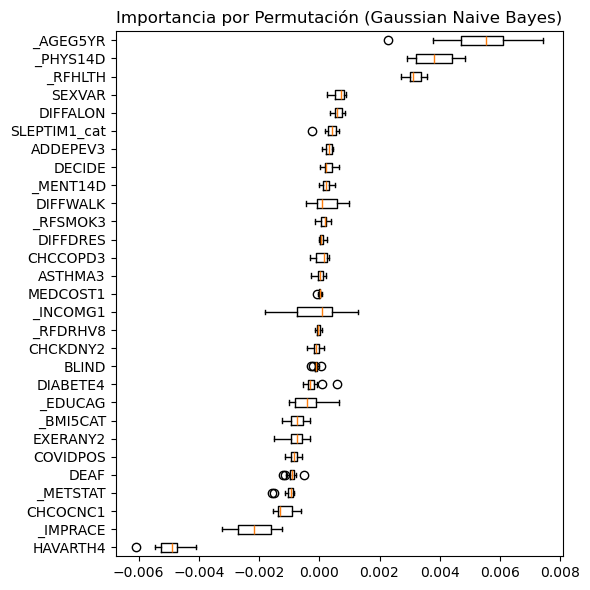

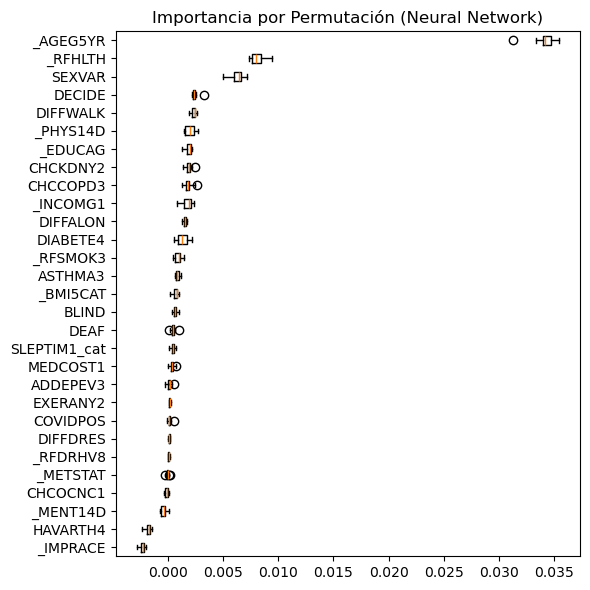

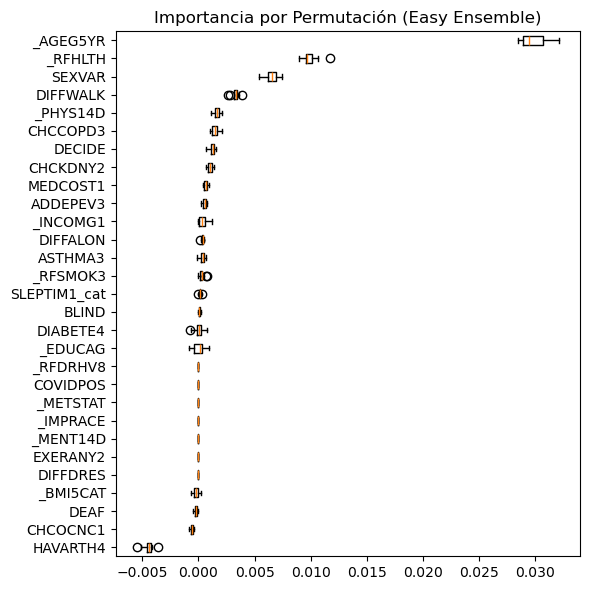

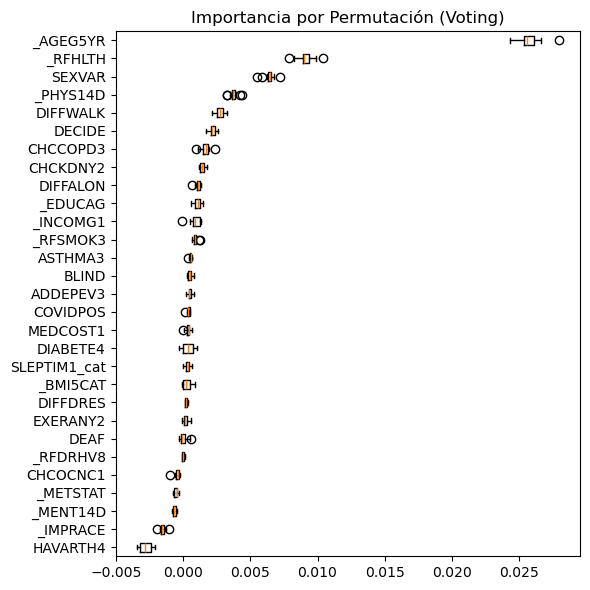

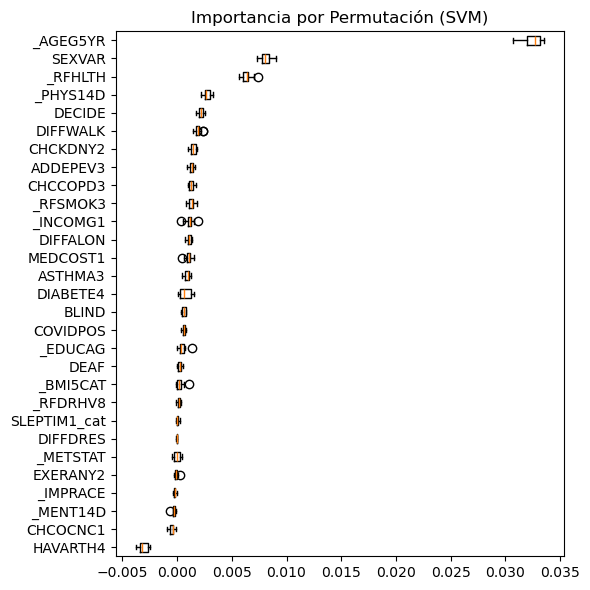

In [329]:
# Graficar importancia y permutación para los modelos con todas las variables
graficar_importancia_permutacion(modelos_optimizados_all, X_test, y_test, X)
graficar_permutacion_importancia(modelos_optimizados_all, X_test, y_test, X)